In [1]:
import pandas as pd 
import pymongo


client = pymongo.MongoClient(host='mongo1', port=27017)#
db = client.taobao
collection = db.manage

In [2]:
#数据存储到mongodb

# df = pd.read_csv('/root/桌面/UserBehavior_new.csv',encoding='GBK')
# df.head(10)nyResult at
# collection.insert_many(df.to_dict('records'))

In [3]:
#统计数据集中用户数量、商品数量、商品类目数量
docs=collection.aggregate([
    {
        '$group': {
            '_id': 'null',
            'userCount': { '$addToSet': "$user_id" },
            'productCount': { '$addToSet': "$item_id" },
            'categoryCount': { '$addToSet': "$category_id" }
        }
    },
    {
        '$project': {
            '_id': 0,
            '用户数量': { '$size': "$userCount" },
            '商品数量': { '$size': "$productCount" },
            '商品类目数量': { '$size': "$categoryCount" }
        }
    }
])
for doc in docs:
    print(doc)


{'用户数量': 527850, '商品数量': 479481, '商品类目数量': 6454}


In [4]:
from collections import defaultdict

category_counts = defaultdict(int)

# 遍历集合并统计每个类目的商品数量
for doc in collection.find():
    category_counts[doc["category_id"]] += 1

print("每个类目的商品数量:", category_counts)


每个类目的商品数量: defaultdict(<class 'int'>, {1859277: 5322, 982926: 30344, 4962280: 1528, 4244487: 2874, 605882: 240, 2103768: 55, 4690421: 3537, 3160926: 1003, 4358294: 1013, 3570656: 190, 3248864: 135, 2355072: 34167, 3738615: 9166, 5053508: 3094, 2254846: 4, 3398567: 528, 3947069: 22, 3673501: 819, 4756105: 48644, 1320293: 19556, 4643350: 5704, 2520377: 21945, 3084958: 38, 941949: 1240, 570735: 6844, 4672807: 2446, 1080785: 10485, 2352811: 39, 119741: 1411, 3776866: 1925, 3818023: 28, 2735466: 12739, 753984: 3226, 1045172: 864, 4801426: 20706, 4718134: 216, 1308457: 183, 965809: 2949, 3002561: 15568, 149192: 10985, 2920476: 6904, 3607361: 32056, 2465336: 16680, 2578647: 3943, 4173315: 2529, 2520771: 7413, 4462359: 1397, 2926020: 3520, 1879194: 8206, 3351726: 387, 4145813: 34910, 4338287: 242, 3004853: 2564, 411153: 4943, 1464116: 8016, 4280793: 21, 3616520: 832, 1575622: 5055, 2667323: 518, 1299190: 5565, 1834026: 1232, 5030562: 284, 2858794: 972, 2208169: 74, 903809: 3802, 940822: 109, 3

In [5]:
from datetime import datetime
from collections import defaultdict

# 创建一个函数来统计各类行为
def get_behavior_counts():
    # 使用 defaultdict 嵌套字典结构，以确保每个行为类型对应的字典始终存在
    behavior_stats = defaultdict(lambda: defaultdict(lambda: defaultdict(int)))

    for doc in collection.find():
        # 将时间戳转换为日期
        timestamp = datetime.utcfromtimestamp(doc["time_stamp"])  # 注意字段是 time_stamp
        year_month = timestamp.strftime('%Y-%m')  # 按年和月分组

        behavior_type = doc["behavior_type"]  # 获取行为类型
        item_id = doc["item_id"]  # 获取商品 ID

        # 根据行为类型统计
        if behavior_type == "like":
            behavior_stats[year_month]["like"][item_id] += 1
        elif behavior_type == "buy":
            behavior_stats[year_month]["buy"][item_id] += 1
        elif behavior_type == "add_to_cart":
            behavior_stats[year_month]["add_to_cart"][item_id] += 1
        elif behavior_type == "click":
            behavior_stats[year_month]["click"][item_id] += 1
        elif behavior_type == "pv":  # 页面浏览行为
            behavior_stats[year_month]["pv"][item_id] += 1

    return behavior_stats

behavior_stats = get_behavior_counts()
print("每年每月的行为统计:", behavior_stats)


每年每月的行为统计: defaultdict(<function get_behavior_counts.<locals>.<lambda> at 0x7f2e9bffcea0>, {'2017-12': defaultdict(<function get_behavior_counts.<locals>.<lambda>.<locals>.<lambda> at 0x7f2e9bffcf28>, {'pv': defaultdict(<class 'int'>, {2542947: 5, 4691710: 8, 2318126: 2, 95392: 1, 2678768: 30, 1467093: 1, 475205: 1, 4348555: 13, 1483859: 1, 3033663: 11, 4935282: 1, 435866: 2, 532129: 1, 4420139: 3, 3473913: 1, 1132649: 1, 3152730: 1, 1206724: 1, 857602: 12, 3562114: 23, 2056860: 11, 1810717: 1, 3598929: 10, 2910136: 4, 869159: 1, 2918574: 1, 231501: 2, 2514523: 1, 814209: 2, 2669571: 1, 3601805: 1, 2862986: 1, 960238: 3, 1433831: 5, 566120: 1, 2971425: 4, 1733975: 1, 2241111: 6, 1136467: 1, 1428677: 1, 1185822: 1, 2763516: 2, 563886: 3, 3948887: 5, 904226: 1, 1554729: 1, 454408: 4, 966319: 1, 2937005: 4, 2741154: 1, 4557370: 3, 4260766: 2, 367824: 9, 2874403: 1, 397620: 1, 3328223: 1, 2569318: 5, 3185018: 2, 1950506: 2, 713445: 2, 689409: 2, 5092647: 1, 3714333: 1, 1353705: 1, 1187874:

In [6]:
import redis

# 连接到 Redis 集群
r = redis.StrictRedis(host='localhost', port=6379, db=0)

# 缓存 MongoDB 中的统计数据到 Redis
def cache_data_to_redis():
    for year_month, stats in behavior_stats.items():
        for behavior_type, item_counts in stats.items():
            for item_id, count in item_counts.items():
                # 使用 Redis 的哈希表来存储
                r.hset(f"{year_month}:{behavior_type}:{item_id}", "count", count)
            
                print(f'{year_month}:{behavior_type}:{item_id}')
cache_data_to_redis()

2017-12:pv:2542947
2017-12:pv:4691710
2017-12:pv:2318126
2017-12:pv:95392
2017-12:pv:2678768
2017-12:pv:1467093
2017-12:pv:475205
2017-12:pv:4348555
2017-12:pv:1483859
2017-12:pv:3033663
2017-12:pv:4935282
2017-12:pv:435866
2017-12:pv:532129
2017-12:pv:4420139
2017-12:pv:3473913
2017-12:pv:1132649
2017-12:pv:3152730
2017-12:pv:1206724
2017-12:pv:857602
2017-12:pv:3562114
2017-12:pv:2056860
2017-12:pv:1810717
2017-12:pv:3598929
2017-12:pv:2910136
2017-12:pv:869159
2017-12:pv:2918574
2017-12:pv:231501
2017-12:pv:2514523
2017-12:pv:814209
2017-12:pv:2669571
2017-12:pv:3601805
2017-12:pv:2862986
2017-12:pv:960238
2017-12:pv:1433831
2017-12:pv:566120
2017-12:pv:2971425
2017-12:pv:1733975
2017-12:pv:2241111
2017-12:pv:1136467
2017-12:pv:1428677
2017-12:pv:1185822
2017-12:pv:2763516
2017-12:pv:563886
2017-12:pv:3948887
2017-12:pv:904226
2017-12:pv:1554729
2017-12:pv:454408
2017-12:pv:966319
2017-12:pv:2937005
2017-12:pv:2741154
2017-12:pv:4557370
2017-12:pv:4260766
2017-12:pv:367824
2017-12:p

2017-12:pv:1345779
2017-12:pv:778584
2017-12:pv:2683053
2017-12:pv:4193365
2017-12:pv:2362288
2017-12:pv:3761770
2017-12:pv:4205758
2017-12:pv:3975906
2017-12:pv:2824767
2017-12:pv:175363
2017-12:pv:903454
2017-12:pv:1749878
2017-12:pv:4649189
2017-12:pv:3784586
2017-12:pv:1219169
2017-12:pv:1662152
2017-12:pv:1745409
2017-12:pv:2769756
2017-12:pv:2489773
2017-12:pv:1892478
2017-12:pv:4941000
2017-12:pv:4620856
2017-12:pv:1505497
2017-12:pv:4618203
2017-12:pv:2377697
2017-12:pv:3965297
2017-12:pv:3234612
2017-12:pv:4003005
2017-12:pv:752987
2017-12:pv:4412879
2017-12:pv:5050945
2017-12:pv:518814
2017-12:pv:703715
2017-12:pv:1383861
2017-12:pv:872807
2017-12:pv:1429538
2017-12:pv:1154789
2017-12:pv:1180975
2017-12:pv:827622
2017-12:pv:3637592
2017-12:pv:1798396
2017-12:pv:3047730
2017-12:pv:3381214
2017-12:pv:1592182
2017-12:pv:1938985
2017-12:pv:3993966
2017-12:pv:278030
2017-12:pv:5138882
2017-12:pv:2861669
2017-12:pv:815860
2017-12:pv:1078997
2017-12:pv:3385460
2017-12:pv:1085856
201

2017-12:pv:2615542
2017-12:pv:128274
2017-12:pv:1174128
2017-12:pv:2595861
2017-12:pv:2217534
2017-12:pv:321012
2017-12:pv:368208
2017-12:pv:2421340
2017-12:pv:3096887
2017-12:pv:135056
2017-12:pv:3152869
2017-12:pv:1052787
2017-12:pv:1700084
2017-12:pv:620232
2017-12:pv:4278840
2017-12:pv:1427653
2017-12:pv:4498154
2017-12:pv:4565610
2017-12:pv:4463878
2017-12:pv:308919
2017-12:pv:960587
2017-12:pv:4601826
2017-12:pv:1921639
2017-12:pv:344978
2017-12:pv:2665183
2017-12:pv:837814
2017-12:pv:1850096
2017-12:pv:4756886
2017-12:pv:767904
2017-12:pv:2541703
2017-12:pv:690941
2017-12:pv:4168448
2017-12:pv:1726563
2017-12:pv:4332878
2017-12:pv:3406546
2017-12:pv:2210975
2017-12:pv:1836642
2017-12:pv:144586
2017-12:pv:2066397
2017-12:pv:3064505
2017-12:pv:2292941
2017-12:pv:1111412
2017-12:pv:4451995
2017-12:pv:1197478
2017-12:pv:899731
2017-12:pv:764793
2017-12:pv:2096150
2017-12:pv:1182310
2017-12:pv:2062743
2017-12:pv:4674562
2017-12:pv:2299292
2017-12:pv:4979655
2017-12:pv:4371199
2017-12

2017-12:pv:653200
2017-12:pv:5033248
2017-12:pv:4014593
2017-12:pv:1151271
2017-12:pv:748883
2017-12:pv:1968878
2017-12:pv:2255894
2017-12:pv:702937
2017-12:pv:1739931
2017-12:pv:3855107
2017-12:pv:3137405
2017-12:pv:5066106
2017-12:pv:1604635
2017-12:pv:2182204
2017-12:pv:1219961
2017-12:pv:874631
2017-12:pv:3399676
2017-12:pv:3551841
2017-12:pv:2314045
2017-12:pv:3284948
2017-12:pv:377838
2017-12:pv:3868165
2017-12:pv:608320
2017-12:pv:1068601
2017-12:pv:3175666
2017-12:pv:4940431
2017-12:pv:1107231
2017-12:pv:2002671
2017-12:pv:2856089
2017-12:pv:2098349
2017-12:pv:1290310
2017-12:pv:1367889
2017-12:pv:4074966
2017-12:pv:3234863
2017-12:pv:126050
2017-12:pv:1783058
2017-12:pv:1809406
2017-12:pv:1895839
2017-12:pv:1932732
2017-12:pv:1842660
2017-12:pv:4993786
2017-12:pv:3112593
2017-12:pv:590391
2017-12:pv:523566
2017-12:pv:1705192
2017-12:pv:2778432
2017-12:pv:654783
2017-12:pv:3547053
2017-12:pv:4344804
2017-12:pv:2888890
2017-12:pv:1454873
2017-12:pv:4296851
2017-12:pv:149172
2017

2017-12:pv:2393911
2017-12:pv:3648207
2017-12:pv:4918959
2017-12:pv:3044930
2017-12:pv:1716863
2017-12:pv:37566
2017-12:pv:395880
2017-12:pv:2137350
2017-12:pv:3367316
2017-12:pv:84883
2017-12:pv:2813721
2017-12:pv:1753429
2017-12:pv:1113818
2017-12:pv:160372
2017-12:pv:3873491
2017-12:pv:885101
2017-12:pv:1107709
2017-12:pv:3788222
2017-12:pv:4689631
2017-12:pv:3559749
2017-12:pv:3178339
2017-12:pv:1072232
2017-12:pv:3178013
2017-12:pv:2228936
2017-12:pv:149862
2017-12:pv:1732399
2017-12:pv:5066294
2017-12:pv:2908238
2017-12:pv:2452694
2017-12:pv:3570251
2017-12:pv:5122568
2017-12:pv:3153981
2017-12:pv:4218767
2017-12:pv:2616459
2017-12:pv:1210874
2017-12:pv:3841515
2017-12:pv:651070
2017-12:pv:2447022
2017-12:pv:5032765
2017-12:pv:4946821
2017-12:pv:3003653
2017-12:pv:2214967
2017-12:pv:3902485
2017-12:pv:1949888
2017-12:pv:3824660
2017-12:pv:773129
2017-12:pv:4598048
2017-12:pv:1717970
2017-12:pv:982055
2017-12:pv:2975950
2017-12:pv:2371929
2017-12:pv:3840775
2017-12:pv:3654350
2017

2017-12:pv:1925190
2017-12:pv:551856
2017-12:pv:1359552
2017-12:pv:4519733
2017-12:pv:248678
2017-12:pv:4301274
2017-12:pv:2149621
2017-12:pv:1628714
2017-12:pv:4721584
2017-12:pv:3370208
2017-12:pv:684697
2017-12:pv:2328327
2017-12:pv:1579899
2017-12:pv:1032178
2017-12:pv:2138905
2017-12:pv:2643831
2017-12:pv:3804590
2017-12:pv:1948851
2017-12:pv:2081436
2017-12:pv:1384854
2017-12:pv:16622
2017-12:pv:3893686
2017-12:pv:1917005
2017-12:pv:77242
2017-12:pv:2737678
2017-12:pv:2366802
2017-12:pv:2877591
2017-12:pv:1614183
2017-12:pv:984751
2017-12:pv:348292
2017-12:pv:4105480
2017-12:pv:4443059
2017-12:pv:5058574
2017-12:pv:149066
2017-12:pv:3274803
2017-12:pv:2372107
2017-12:pv:3742276
2017-12:pv:718743
2017-12:pv:232709
2017-12:pv:545570
2017-12:pv:1632312
2017-12:pv:1476101
2017-12:pv:2536727
2017-12:pv:4696574
2017-12:pv:3483866
2017-12:pv:4719040
2017-12:pv:4519625
2017-12:pv:2950085
2017-12:pv:4581197
2017-12:pv:4603194
2017-12:pv:3479123
2017-12:pv:4402057
2017-12:pv:3915717
2017-1

2017-12:pv:1813223
2017-12:pv:4295425
2017-12:pv:3144549
2017-12:pv:3027867
2017-12:pv:448625
2017-12:pv:363949
2017-12:pv:2786532
2017-12:pv:2944225
2017-12:pv:428911
2017-12:pv:4923582
2017-12:pv:1395920
2017-12:pv:1433345
2017-12:pv:3915224
2017-12:pv:3615405
2017-12:pv:2242724
2017-12:pv:1465776
2017-12:pv:4651506
2017-12:pv:3075115
2017-12:pv:3892575
2017-12:pv:2084151
2017-12:pv:1743303
2017-12:pv:1672617
2017-12:pv:1273996
2017-12:pv:3622735
2017-12:pv:2764829
2017-12:pv:5000411
2017-12:pv:878832
2017-12:pv:4175024
2017-12:pv:4854680
2017-12:pv:1883564
2017-12:pv:5161314
2017-12:pv:1289560
2017-12:pv:4176259
2017-12:pv:2421545
2017-12:pv:1295546
2017-12:pv:99604
2017-12:pv:2236752
2017-12:pv:806518
2017-12:pv:1438562
2017-12:pv:2847565
2017-12:pv:1403563
2017-12:pv:340211
2017-12:pv:4588665
2017-12:pv:4690760
2017-12:pv:2782189
2017-12:pv:3427038
2017-12:pv:4200765
2017-12:pv:363157
2017-12:pv:4305260
2017-12:pv:336304
2017-12:pv:5070222
2017-12:pv:4125469
2017-12:pv:3768957
201

2017-12:pv:5083072
2017-12:pv:5030147
2017-12:pv:4994005
2017-12:pv:3304501
2017-12:pv:5108864
2017-12:pv:677134
2017-12:pv:1096411
2017-12:pv:3561544
2017-12:pv:2358217
2017-12:pv:2921471
2017-12:pv:2933987
2017-12:pv:1390383
2017-12:pv:1986599
2017-12:pv:1336985
2017-12:pv:4600783
2017-12:pv:4386264
2017-12:pv:3348232
2017-12:pv:28590
2017-12:pv:343583
2017-12:pv:2609625
2017-12:pv:2390370
2017-12:pv:4089109
2017-12:pv:361289
2017-12:pv:2623603
2017-12:pv:1449807
2017-12:pv:2186395
2017-12:pv:1780243
2017-12:pv:2931411
2017-12:pv:1454394
2017-12:pv:1622672
2017-12:pv:3402848
2017-12:pv:3997635
2017-12:pv:4062905
2017-12:pv:2554035
2017-12:pv:1228106
2017-12:pv:3902287
2017-12:pv:3226685
2017-12:pv:947775
2017-12:pv:4456588
2017-12:pv:815555
2017-12:pv:1717438
2017-12:pv:2506015
2017-12:pv:851734
2017-12:pv:1143350
2017-12:pv:3101543
2017-12:pv:289041
2017-12:pv:4217200
2017-12:pv:2328109
2017-12:pv:1707441
2017-12:pv:3609589
2017-12:pv:1613839
2017-12:pv:1100464
2017-12:pv:797303
201

2017-12:pv:77376
2017-12:pv:2437086
2017-12:pv:402057
2017-12:pv:3587946
2017-12:pv:3148330
2017-12:pv:3388485
2017-12:pv:4820685
2017-12:pv:2633979
2017-12:pv:2383779
2017-12:pv:375426
2017-12:pv:4199188
2017-12:pv:5016491
2017-12:pv:2688775
2017-12:pv:3588160
2017-12:pv:2950796
2017-12:pv:491499
2017-12:pv:1842107
2017-12:pv:3810248
2017-12:pv:4626102
2017-12:pv:53368
2017-12:pv:2275542
2017-12:pv:4812310
2017-12:pv:2103150
2017-12:pv:1014771
2017-12:pv:2808073
2017-12:pv:1645585
2017-12:pv:2035322
2017-12:pv:2893548
2017-12:pv:3420178
2017-12:pv:1744859
2017-12:pv:358117
2017-12:pv:4817655
2017-12:pv:4216439
2017-12:pv:4403814
2017-12:pv:2971773
2017-12:pv:4116366
2017-12:pv:5080054
2017-12:pv:74220
2017-12:pv:2948508
2017-12:pv:2337184
2017-12:pv:9603
2017-12:pv:170571
2017-12:pv:4663713
2017-12:pv:3200977
2017-12:pv:577781
2017-12:pv:3559114
2017-12:pv:496362
2017-12:pv:3936977
2017-12:pv:3032611
2017-12:pv:3745682
2017-12:pv:959248
2017-12:pv:1871695
2017-12:pv:16802
2017-12:pv:2

2017-12:pv:2021163
2017-12:pv:488458
2017-12:pv:981615
2017-12:pv:163820
2017-12:pv:3366090
2017-12:pv:1001484
2017-12:pv:1298598
2017-12:pv:4595856
2017-12:pv:198942
2017-12:pv:2020248
2017-12:pv:863578
2017-12:pv:3036728
2017-12:pv:3297061
2017-12:pv:1500016
2017-12:pv:907813
2017-12:pv:4679626
2017-12:pv:2634465
2017-12:pv:4228612
2017-12:pv:985357
2017-12:pv:2642728
2017-12:pv:3201062
2017-12:pv:1513148
2017-12:pv:2412477
2017-12:pv:1623412
2017-12:pv:1221769
2017-12:pv:1808993
2017-12:pv:4965941
2017-12:pv:2494944
2017-12:pv:2978955
2017-12:pv:2304426
2017-12:pv:490094
2017-12:pv:4503372
2017-12:pv:2511549
2017-12:pv:2161195
2017-12:pv:1194526
2017-12:pv:361143
2017-12:pv:3501629
2017-12:pv:4953587
2017-12:pv:975925
2017-12:pv:2158704
2017-12:pv:1898553
2017-12:pv:3523958
2017-12:pv:4231880
2017-12:pv:4307795
2017-12:pv:5150014
2017-12:pv:3640248
2017-12:pv:215211
2017-12:pv:4756154
2017-12:pv:3837436
2017-12:pv:5077538
2017-12:pv:1512363
2017-12:pv:4238921
2017-12:pv:3740445
2017

2017-12:pv:1124139
2017-12:pv:4383840
2017-12:pv:2695122
2017-12:pv:2841436
2017-12:pv:2438058
2017-12:pv:2118036
2017-12:pv:2330837
2017-12:pv:1410435
2017-12:pv:4200647
2017-12:pv:184037
2017-12:pv:5128080
2017-12:pv:2308914
2017-12:pv:2078455
2017-12:pv:2507162
2017-12:pv:1114394
2017-12:pv:2132237
2017-12:pv:1106192
2017-12:pv:49235
2017-12:pv:3532887
2017-12:pv:2951393
2017-12:pv:624766
2017-12:pv:3507590
2017-12:pv:1157662
2017-12:pv:2987039
2017-12:pv:5033487
2017-12:pv:1931703
2017-12:pv:662138
2017-12:pv:5034188
2017-12:pv:1450625
2017-12:pv:4097057
2017-12:pv:1514670
2017-12:pv:1651803
2017-12:pv:1108426
2017-12:pv:4921447
2017-12:pv:3939228
2017-12:pv:4637530
2017-12:pv:2119650
2017-12:pv:821365
2017-12:pv:2502829
2017-12:pv:2583697
2017-12:pv:2471875
2017-12:pv:637616
2017-12:pv:4808070
2017-12:pv:5007707
2017-12:pv:4024409
2017-12:pv:3135722
2017-12:pv:205351
2017-12:pv:4153124
2017-12:pv:551803
2017-12:pv:5148327
2017-12:pv:1500790
2017-12:pv:3400547
2017-12:pv:2185325
20

2017-12:pv:2956909
2017-12:pv:133622
2017-12:pv:1976929
2017-12:pv:4534000
2017-12:pv:1387695
2017-12:pv:3496879
2017-12:pv:3685329
2017-12:pv:3171005
2017-12:pv:1696355
2017-12:pv:4946831
2017-12:pv:4978331
2017-12:pv:2900723
2017-12:pv:4466434
2017-12:pv:1106509
2017-12:pv:94787
2017-12:pv:920622
2017-12:pv:4395549
2017-12:pv:970755
2017-12:pv:2412733
2017-12:pv:3360329
2017-12:pv:1088387
2017-12:pv:774661
2017-12:pv:2722085
2017-12:pv:4852928
2017-12:pv:1554443
2017-12:pv:359888
2017-12:pv:579748
2017-12:pv:3921177
2017-12:pv:1448957
2017-12:pv:1953654
2017-12:pv:3159639
2017-12:pv:3125162
2017-12:pv:2033058
2017-12:pv:4832440
2017-12:pv:1355688
2017-12:pv:1452730
2017-12:pv:2292216
2017-12:pv:358833
2017-12:pv:3653525
2017-12:pv:1699547
2017-12:pv:1132159
2017-12:pv:579032
2017-12:pv:3938640
2017-12:pv:4750782
2017-12:pv:1025894
2017-12:pv:158800
2017-12:pv:2580837
2017-12:pv:5005711
2017-12:pv:4959178
2017-12:pv:1499183
2017-12:pv:1756386
2017-12:pv:4183809
2017-12:pv:4891690
2017

2017-12:pv:1457487
2017-12:pv:759579
2017-12:pv:672527
2017-12:pv:2493770
2017-12:pv:4443733
2017-12:pv:2339462
2017-12:pv:3025280
2017-12:pv:2217010
2017-12:pv:2622497
2017-12:pv:4706466
2017-12:pv:1458895
2017-12:pv:4083720
2017-12:pv:2286981
2017-12:pv:1249104
2017-12:pv:2013811
2017-12:pv:2696691
2017-12:pv:2802203
2017-12:pv:745417
2017-12:pv:434610
2017-12:pv:4787189
2017-12:pv:3889469
2017-12:pv:3089876
2017-12:pv:4298799
2017-12:pv:2669049
2017-12:pv:2878661
2017-12:pv:3744056
2017-12:pv:4507420
2017-12:pv:499753
2017-12:pv:2494252
2017-12:pv:4636719
2017-12:pv:1349680
2017-12:pv:854461
2017-12:pv:2843035
2017-12:pv:169619
2017-12:pv:4946273
2017-12:pv:3785484
2017-12:pv:2449150
2017-12:pv:3520130
2017-12:pv:3960598
2017-12:pv:4530073
2017-12:pv:3708981
2017-12:pv:4593519
2017-12:pv:97289
2017-12:pv:3313341
2017-12:pv:2821580
2017-12:pv:145882
2017-12:pv:1654133
2017-12:pv:4835108
2017-12:pv:3398146
2017-12:pv:3632670
2017-12:pv:1084459
2017-12:pv:3308649
2017-12:pv:3978371
201

2017-12:pv:390127
2017-12:pv:2140069
2017-12:pv:2161587
2017-12:pv:4380800
2017-12:pv:220273
2017-12:pv:4366359
2017-12:pv:599079
2017-12:pv:650917
2017-12:pv:1385500
2017-12:pv:2098808
2017-12:pv:4795218
2017-12:pv:3638094
2017-12:pv:2850766
2017-12:pv:392173
2017-12:pv:995603
2017-12:pv:186968
2017-12:pv:336722
2017-12:pv:2436621
2017-12:pv:1441528
2017-12:pv:1330065
2017-12:pv:4701928
2017-12:pv:4732196
2017-12:pv:2931304
2017-12:pv:970289
2017-12:pv:4993045
2017-12:pv:4035042
2017-12:pv:4308658
2017-12:pv:2091216
2017-12:pv:5134840
2017-12:pv:1588613
2017-12:pv:160427
2017-12:pv:2261318
2017-12:pv:1793335
2017-12:pv:3206310
2017-12:pv:4435577
2017-12:pv:4675389
2017-12:pv:2131664
2017-12:pv:5106376
2017-12:pv:47310
2017-12:pv:3028180
2017-12:pv:4043830
2017-12:pv:4498831
2017-12:pv:1979658
2017-12:pv:5163006
2017-12:pv:997851
2017-12:pv:2238221
2017-12:pv:2139532
2017-12:pv:1644213
2017-12:pv:2228120
2017-12:pv:416019
2017-12:pv:3473283
2017-12:pv:1916518
2017-12:pv:1887751
2017-12

2017-12:pv:2079646
2017-12:pv:3028769
2017-12:pv:4671391
2017-12:pv:3803766
2017-12:pv:4310152
2017-12:pv:3697088
2017-12:pv:3364885
2017-12:pv:3213953
2017-12:pv:1477477
2017-12:pv:478232
2017-12:pv:2852206
2017-12:pv:1693114
2017-12:pv:749478
2017-12:pv:2585846
2017-12:pv:335403
2017-12:pv:3390839
2017-12:pv:406546
2017-12:pv:826743
2017-12:pv:1062768
2017-12:pv:4764906
2017-12:pv:488753
2017-12:pv:2237210
2017-12:pv:3142054
2017-12:pv:3491332
2017-12:pv:4447949
2017-12:pv:1961857
2017-12:pv:3703916
2017-12:pv:3639221
2017-12:pv:851543
2017-12:pv:4778064
2017-12:pv:4132679
2017-12:pv:967007
2017-12:pv:4653104
2017-12:pv:3857705
2017-12:pv:5114743
2017-12:pv:432024
2017-12:pv:1232273
2017-12:pv:4753892
2017-12:pv:4432074
2017-12:pv:3202108
2017-12:pv:2615729
2017-12:pv:3385616
2017-12:pv:4883264
2017-12:pv:1310649
2017-12:pv:5134944
2017-12:pv:4939222
2017-12:pv:2329801
2017-12:pv:2168939
2017-12:pv:771422
2017-12:pv:2792067
2017-12:pv:2081685
2017-12:pv:2668852
2017-12:pv:4735822
201

2017-12:pv:4081672
2017-12:pv:3274189
2017-12:pv:5113473
2017-12:pv:4502334
2017-12:pv:480733
2017-12:pv:99901
2017-12:pv:2171512
2017-12:pv:4462153
2017-12:pv:2823559
2017-12:pv:1393372
2017-12:pv:4432030
2017-12:pv:3946824
2017-12:pv:3216949
2017-12:pv:4621952
2017-12:pv:4603894
2017-12:pv:2802001
2017-12:pv:4438550
2017-12:pv:2348484
2017-12:pv:1775254
2017-12:pv:473598
2017-12:pv:1964845
2017-12:pv:3839479
2017-12:pv:2246319
2017-12:pv:5073298
2017-12:pv:4041444
2017-12:pv:4867973
2017-12:pv:1079425
2017-12:pv:1480168
2017-12:pv:4715134
2017-12:pv:4535144
2017-12:pv:3591077
2017-12:pv:4652269
2017-12:pv:3858278
2017-12:pv:4564370
2017-12:pv:1967498
2017-12:pv:1261517
2017-12:pv:1477259
2017-12:pv:866277
2017-12:pv:2313790
2017-12:pv:3876753
2017-12:pv:799453
2017-12:pv:1783161
2017-12:pv:3692322
2017-12:pv:4099167
2017-12:pv:2445476
2017-12:pv:200138
2017-12:pv:4865510
2017-12:pv:1058443
2017-12:pv:3376008
2017-12:pv:2044465
2017-12:pv:4166206
2017-12:pv:3880712
2017-12:pv:1733997


2017-12:pv:4021428
2017-12:pv:1858484
2017-12:pv:4557711
2017-12:pv:3412673
2017-12:pv:3878754
2017-12:pv:1017861
2017-12:pv:1947026
2017-12:pv:2978040
2017-12:pv:2301368
2017-12:pv:2236598
2017-12:pv:3869995
2017-12:pv:3829712
2017-12:pv:5029966
2017-12:pv:2270879
2017-12:pv:3384910
2017-12:pv:2082214
2017-12:pv:1579397
2017-12:pv:2759236
2017-12:pv:1118242
2017-12:pv:3933791
2017-12:pv:698532
2017-12:pv:4742255
2017-12:pv:1441864
2017-12:pv:2183891
2017-12:pv:383259
2017-12:pv:1553697
2017-12:pv:4881841
2017-12:pv:1878380
2017-12:pv:2781428
2017-12:pv:1515743
2017-12:pv:4005170
2017-12:pv:1691993
2017-12:pv:4311655
2017-12:pv:1813918
2017-12:pv:3796533
2017-12:pv:4093127
2017-12:pv:4197163
2017-12:pv:3150739
2017-12:pv:4612724
2017-12:pv:1345569
2017-12:pv:2137884
2017-12:pv:4759898
2017-12:pv:2170404
2017-12:pv:1482021
2017-12:pv:741320
2017-12:pv:2618673
2017-12:pv:2136342
2017-12:pv:3207210
2017-12:pv:1494334
2017-12:pv:1924586
2017-12:pv:1835842
2017-12:pv:563348
2017-12:pv:17707

2017-12:pv:3224207
2017-12:pv:1988946
2017-12:pv:52775
2017-12:pv:1876582
2017-12:pv:2815020
2017-12:pv:145278
2017-12:pv:347390
2017-12:pv:1190538
2017-12:pv:1594141
2017-12:pv:34800
2017-12:pv:4358137
2017-12:pv:2987601
2017-12:pv:4080126
2017-12:pv:2898849
2017-12:pv:1210675
2017-12:pv:46810
2017-12:pv:4707472
2017-12:pv:3112175
2017-12:pv:4085687
2017-12:pv:4473430
2017-12:pv:1822837
2017-12:pv:2689626
2017-12:pv:3172308
2017-12:pv:513418
2017-12:pv:3031656
2017-12:pv:1037004
2017-12:pv:1825796
2017-12:pv:4064758
2017-12:pv:2992346
2017-12:pv:2398900
2017-12:pv:4495285
2017-12:pv:3799459
2017-12:pv:4850517
2017-12:pv:614361
2017-12:pv:2697499
2017-12:pv:1939054
2017-12:pv:2495942
2017-12:pv:4168616
2017-12:pv:4600171
2017-12:pv:4936669
2017-12:pv:4208657
2017-12:pv:4166235
2017-12:pv:4432438
2017-12:pv:3122737
2017-12:pv:4931051
2017-12:pv:1688775
2017-12:pv:2534732
2017-12:pv:922623
2017-12:pv:4469968
2017-12:pv:4661146
2017-12:pv:2705446
2017-12:pv:3014914
2017-12:pv:3756226
2017

2017-12:pv:3007018
2017-12:pv:1845474
2017-12:pv:1975188
2017-12:pv:1873005
2017-12:pv:845701
2017-12:pv:1349127
2017-12:pv:3575186
2017-12:pv:1906628
2017-12:pv:5007117
2017-12:pv:4508580
2017-12:pv:3056562
2017-12:pv:3396605
2017-12:pv:200601
2017-12:pv:4741680
2017-12:pv:4401676
2017-12:pv:1678569
2017-12:pv:3623753
2017-12:pv:1499002
2017-12:pv:2490832
2017-12:pv:3960831
2017-12:pv:5125106
2017-12:pv:1705931
2017-12:pv:4369375
2017-12:pv:4226710
2017-12:pv:5086795
2017-12:pv:3561090
2017-12:pv:3356715
2017-12:pv:575593
2017-12:pv:347224
2017-12:pv:4301407
2017-12:pv:1253842
2017-12:pv:2675253
2017-12:pv:2585197
2017-12:pv:1486756
2017-12:pv:4261931
2017-12:pv:3027067
2017-12:pv:4319325
2017-12:pv:1520986
2017-12:pv:5145429
2017-12:pv:1854958
2017-12:pv:4247178
2017-12:pv:1365484
2017-12:pv:4485819
2017-12:pv:4851411
2017-12:pv:808112
2017-12:pv:3212209
2017-12:pv:280576
2017-12:pv:4167596
2017-12:pv:5086801
2017-12:pv:4556056
2017-12:pv:2151698
2017-12:pv:3395334
2017-12:pv:638410


2017-12:pv:4437403
2017-12:pv:3455754
2017-12:pv:686626
2017-12:pv:4925315
2017-12:pv:4093402
2017-12:pv:3656208
2017-12:pv:2585438
2017-12:pv:4375745
2017-12:pv:4168940
2017-12:pv:2245030
2017-12:pv:4430505
2017-12:pv:4932154
2017-12:pv:1809300
2017-12:pv:2400467
2017-12:pv:3875582
2017-12:pv:4329258
2017-12:pv:741942
2017-12:pv:1708865
2017-12:pv:2083545
2017-12:pv:2679240
2017-12:pv:2206476
2017-12:pv:2899046
2017-12:pv:4269458
2017-12:pv:4409355
2017-12:pv:3814814
2017-12:pv:2218562
2017-12:pv:1056758
2017-12:pv:4834871
2017-12:pv:913550
2017-12:pv:4804351
2017-12:pv:3378948
2017-12:pv:2202827
2017-12:pv:3162909
2017-12:pv:1334594
2017-12:pv:3062
2017-12:pv:4388989
2017-12:pv:5082195
2017-12:pv:4491349
2017-12:pv:4990267
2017-12:pv:848398
2017-12:pv:3537984
2017-12:pv:4432854
2017-12:pv:1665192
2017-12:pv:3033895
2017-12:pv:2678009
2017-12:pv:3131373
2017-12:pv:3548059
2017-12:pv:1532539
2017-12:pv:2286661
2017-12:pv:4100439
2017-12:pv:1018113
2017-12:pv:2378993
2017-12:pv:3174036


2017-12:pv:3144128
2017-12:pv:995850
2017-12:pv:1020479
2017-12:pv:3441702
2017-12:pv:4319606
2017-12:pv:3341013
2017-12:pv:540719
2017-12:pv:4920601
2017-12:pv:1558232
2017-12:pv:2899894
2017-12:pv:246437
2017-12:pv:4524625
2017-12:pv:2321283
2017-12:pv:1253913
2017-12:pv:3676089
2017-12:pv:4096313
2017-12:pv:2829721
2017-12:pv:234585
2017-12:pv:1872453
2017-12:pv:3767180
2017-12:pv:3872043
2017-12:pv:4393659
2017-12:pv:1428049
2017-12:pv:336758
2017-12:pv:1875618
2017-12:pv:194250
2017-12:pv:2887142
2017-12:pv:2266078
2017-12:pv:1510845
2017-12:pv:2274634
2017-12:pv:4940506
2017-12:pv:3319891
2017-12:pv:3063081
2017-12:pv:3511464
2017-12:pv:1681245
2017-12:pv:4413776
2017-12:pv:1781061
2017-12:pv:4185589
2017-12:pv:4211807
2017-12:pv:1606201
2017-12:pv:2811339
2017-12:pv:1382583
2017-12:pv:814120
2017-12:pv:4318852
2017-12:pv:3290953
2017-12:pv:3839844
2017-12:pv:4486922
2017-12:pv:4733361
2017-12:pv:3622258
2017-12:pv:3749096
2017-12:pv:241864
2017-12:pv:2595419
2017-12:pv:1336102
2

2017-12:pv:3881374
2017-12:pv:4677893
2017-12:pv:43554
2017-12:pv:2962891
2017-12:pv:10108
2017-12:pv:1790401
2017-12:pv:5061759
2017-12:pv:584581
2017-12:pv:20250
2017-12:pv:3763668
2017-12:pv:166531
2017-12:pv:2593299
2017-12:pv:3644535
2017-12:pv:2524510
2017-12:pv:4550052
2017-12:pv:132925
2017-12:pv:4921864
2017-12:pv:110692
2017-12:pv:1634771
2017-12:pv:4505889
2017-12:pv:2126048
2017-12:pv:3606279
2017-12:pv:1527967
2017-12:pv:4504384
2017-12:pv:2480382
2017-12:pv:3723397
2017-12:pv:4781057
2017-12:pv:4015822
2017-12:pv:1322273
2017-12:pv:4981772
2017-12:pv:49058
2017-12:pv:3926
2017-12:pv:3836028
2017-12:pv:95089
2017-12:pv:4350511
2017-12:pv:3758238
2017-12:pv:1933994
2017-12:pv:3153829
2017-12:pv:3346196
2017-12:pv:847598
2017-12:pv:219900
2017-12:pv:4010357
2017-12:pv:4792428
2017-12:pv:1244376
2017-12:pv:4446110
2017-12:pv:3669353
2017-12:pv:2887186
2017-12:pv:3642314
2017-12:pv:370186
2017-12:pv:2150628
2017-12:pv:1262232
2017-12:pv:4414904
2017-12:pv:4147585
2017-12:pv:29

2017-12:pv:1888536
2017-12:pv:4957444
2017-12:pv:2790543
2017-12:pv:316313
2017-12:pv:2489159
2017-12:pv:3905307
2017-12:pv:1970889
2017-12:pv:2897344
2017-12:pv:858739
2017-12:pv:1643393
2017-12:pv:3771292
2017-12:pv:2718095
2017-12:pv:2143771
2017-12:pv:1907724
2017-12:pv:909260
2017-12:pv:497640
2017-12:pv:3236613
2017-12:pv:2248117
2017-12:pv:1671924
2017-12:pv:1880952
2017-12:pv:728612
2017-12:pv:786679
2017-12:pv:2317629
2017-12:pv:4602286
2017-12:pv:3409774
2017-12:pv:3851631
2017-12:pv:2137240
2017-12:pv:1160380
2017-12:pv:1663494
2017-12:pv:3475770
2017-12:pv:1379899
2017-12:pv:2797037
2017-12:pv:4048779
2017-12:pv:722639
2017-12:pv:589692
2017-12:pv:2450070
2017-12:pv:76552
2017-12:pv:1730194
2017-12:pv:4213913
2017-12:pv:367770
2017-12:pv:2503836
2017-12:pv:3762471
2017-12:pv:2739959
2017-12:pv:1839224
2017-12:pv:3592312
2017-12:pv:4220452
2017-12:pv:4433549
2017-12:pv:4217901
2017-12:pv:2672834
2017-12:pv:2374079
2017-12:pv:328501
2017-12:pv:1473808
2017-12:pv:1281187
2017-

2017-12:pv:4689105
2017-12:pv:2785805
2017-12:pv:3894170
2017-12:pv:967742
2017-12:pv:2356092
2017-12:pv:1776231
2017-12:pv:1107199
2017-12:pv:1266269
2017-12:pv:2553240
2017-12:pv:1831659
2017-12:pv:2993974
2017-12:pv:268109
2017-12:pv:636483
2017-12:pv:4792545
2017-12:pv:3313468
2017-12:pv:4155966
2017-12:pv:1532423
2017-12:pv:4070888
2017-12:pv:2048117
2017-12:pv:1528705
2017-12:pv:1353186
2017-12:pv:4115538
2017-12:pv:4968199
2017-12:pv:2636868
2017-12:pv:4478188
2017-12:pv:1811685
2017-12:pv:1877162
2017-12:pv:4852608
2017-12:pv:5015597
2017-12:pv:634529
2017-12:pv:3357141
2017-12:pv:3168167
2017-12:pv:1553965
2017-12:pv:4103622
2017-12:pv:755177
2017-12:pv:3917896
2017-12:pv:707476
2017-12:pv:1386574
2017-12:pv:2345870
2017-12:pv:4738105
2017-12:pv:279411
2017-12:pv:4740802
2017-12:pv:581922
2017-12:pv:1953378
2017-12:pv:4642090
2017-12:pv:3429616
2017-12:pv:1983311
2017-12:pv:3934427
2017-12:pv:653812
2017-12:pv:1455665
2017-12:pv:3214578
2017-12:pv:3670979
2017-12:pv:326950
201

2017-12:pv:254906
2017-12:pv:703453
2017-12:pv:2301901
2017-12:pv:961592
2017-12:pv:3596995
2017-12:pv:1496962
2017-12:pv:1520024
2017-12:pv:290071
2017-12:pv:3218737
2017-12:pv:2837752
2017-12:pv:4248902
2017-12:pv:4998060
2017-12:pv:745666
2017-12:pv:111819
2017-12:pv:4565545
2017-12:pv:182104
2017-12:pv:2464139
2017-12:pv:88624
2017-12:pv:1945174
2017-12:pv:3055813
2017-12:pv:1641550
2017-12:pv:1131637
2017-12:pv:3701586
2017-12:pv:4740784
2017-12:pv:1353441
2017-12:pv:125367
2017-12:pv:653229
2017-12:pv:1274817
2017-12:pv:162940
2017-12:pv:3423775
2017-12:pv:3149273
2017-12:pv:2880923
2017-12:pv:1986448
2017-12:pv:3422322
2017-12:pv:3609111
2017-12:pv:2650583
2017-12:pv:2633627
2017-12:pv:926641
2017-12:pv:4816271
2017-12:pv:546991
2017-12:pv:3209538
2017-12:pv:1057196
2017-12:pv:1430928
2017-12:pv:2199697
2017-12:pv:3352449
2017-12:pv:2543297
2017-12:pv:4923506
2017-12:pv:218573
2017-12:pv:2102951
2017-12:pv:492640
2017-12:pv:184504
2017-12:pv:5125917
2017-12:pv:299455
2017-12:pv:

2017-12:pv:860870
2017-12:pv:1536866
2017-12:pv:117028
2017-12:pv:2174778
2017-12:pv:2781245
2017-12:pv:2124478
2017-12:pv:5139192
2017-12:pv:3698167
2017-12:pv:1115442
2017-12:pv:1081393
2017-12:pv:834309
2017-12:pv:692820
2017-12:pv:4829510
2017-12:pv:3534079
2017-12:pv:3937894
2017-12:pv:938071
2017-12:pv:3698796
2017-12:pv:634146
2017-12:pv:523010
2017-12:pv:3733477
2017-12:pv:3412245
2017-12:pv:4064152
2017-12:pv:4890271
2017-12:pv:513033
2017-12:pv:1526013
2017-12:pv:4043331
2017-12:pv:4158795
2017-12:pv:967704
2017-12:pv:4292276
2017-12:pv:1664047
2017-12:pv:1043873
2017-12:pv:3443842
2017-12:pv:5082871
2017-12:pv:3266789
2017-12:pv:3211833
2017-12:pv:4323274
2017-12:pv:3832496
2017-12:pv:2211282
2017-12:pv:3784260
2017-12:pv:2552424
2017-12:pv:803514
2017-12:pv:2919884
2017-12:pv:4466034
2017-12:pv:2502823
2017-12:pv:857070
2017-12:pv:4271978
2017-12:pv:1268725
2017-12:pv:2964284
2017-12:pv:546860
2017-12:pv:3407401
2017-12:pv:2492062
2017-12:pv:2960475
2017-12:pv:1944437
2017-

2017-12:pv:3023773
2017-12:pv:2379015
2017-12:pv:2929705
2017-12:pv:2980886
2017-12:pv:2678560
2017-12:pv:3034935
2017-12:pv:4510649
2017-12:pv:4650609
2017-12:pv:1770487
2017-12:pv:3897552
2017-12:pv:975747
2017-12:pv:2698063
2017-12:pv:3773358
2017-12:pv:941792
2017-12:pv:1855368
2017-12:pv:663592
2017-12:pv:1089842
2017-12:pv:207712
2017-12:pv:3665269
2017-12:pv:3403713
2017-12:pv:342310
2017-12:pv:1092652
2017-12:pv:3070037
2017-12:pv:719704
2017-12:pv:5043013
2017-12:pv:1902927
2017-12:pv:2290339
2017-12:pv:318593
2017-12:pv:3422595
2017-12:pv:3629316
2017-12:pv:4094810
2017-12:pv:884622
2017-12:pv:4659660
2017-12:pv:4792038
2017-12:pv:3302511
2017-12:pv:3883423
2017-12:pv:483284
2017-12:pv:2874839
2017-12:pv:3867443
2017-12:pv:4432481
2017-12:pv:2366583
2017-12:pv:4142304
2017-12:pv:3159204
2017-12:pv:1641867
2017-12:pv:2188911
2017-12:pv:2217880
2017-12:pv:2726719
2017-12:pv:2858048
2017-12:pv:4051495
2017-12:pv:1186606
2017-12:pv:2902854
2017-12:pv:276207
2017-12:pv:3933740
201

2017-12:pv:189770
2017-12:pv:701304
2017-12:pv:3376137
2017-12:pv:253843
2017-12:pv:2048942
2017-12:pv:983742
2017-12:pv:4896224
2017-12:pv:5102959
2017-12:pv:2618139
2017-12:pv:4153158
2017-12:pv:4435310
2017-12:pv:2469622
2017-12:pv:3775210
2017-12:pv:4704239
2017-12:pv:259179
2017-12:pv:3251343
2017-12:pv:3274332
2017-12:pv:487492
2017-12:pv:3706465
2017-12:pv:923212
2017-12:pv:5033143
2017-12:pv:1958397
2017-12:pv:1739578
2017-12:pv:3040752
2017-12:pv:4061183
2017-12:pv:672403
2017-12:pv:4265303
2017-12:pv:1690514
2017-12:pv:2156372
2017-12:pv:549797
2017-12:pv:1947352
2017-12:pv:2205516
2017-12:pv:589231
2017-12:pv:2091811
2017-12:pv:1791882
2017-12:pv:2173034
2017-12:pv:2897218
2017-12:pv:4138231
2017-12:pv:137988
2017-12:pv:779927
2017-12:pv:750568
2017-12:pv:4899070
2017-12:pv:717517
2017-12:pv:3380643
2017-12:pv:4911057
2017-12:pv:4594940
2017-12:pv:5093844
2017-12:pv:3598982
2017-12:pv:5133127
2017-12:pv:812592
2017-12:pv:139736
2017-12:pv:3958790
2017-12:pv:3419389
2017-12:p

2017-12:pv:5010714
2017-12:pv:3250765
2017-12:pv:2826985
2017-12:pv:3731641
2017-12:pv:1172004
2017-12:pv:4968833
2017-12:pv:4540902
2017-12:pv:3374982
2017-12:pv:605605
2017-12:pv:2718440
2017-12:pv:3998340
2017-12:pv:1765261
2017-12:pv:483014
2017-12:pv:3373903
2017-12:pv:4867301
2017-12:pv:2113693
2017-12:pv:3540750
2017-12:pv:3337271
2017-12:pv:460398
2017-12:pv:4566263
2017-12:pv:4984888
2017-12:pv:137033
2017-12:pv:1959646
2017-12:pv:3225615
2017-12:pv:2052815
2017-12:pv:720294
2017-12:pv:4702639
2017-12:pv:3994863
2017-12:pv:4185201
2017-12:pv:1271277
2017-12:pv:173420
2017-12:pv:2138010
2017-12:pv:3209715
2017-12:pv:4834037
2017-12:pv:3185940
2017-12:pv:4055925
2017-12:pv:487470
2017-12:pv:170307
2017-12:pv:2946305
2017-12:pv:169055
2017-12:pv:2296027
2017-12:pv:2614522
2017-12:pv:306576
2017-12:pv:2699620
2017-12:pv:4878382
2017-12:pv:3154282
2017-12:pv:4621111
2017-12:pv:3453862
2017-12:pv:1618162
2017-12:pv:4836334
2017-12:pv:534631
2017-12:pv:1424
2017-12:pv:4796918
2017-12

2017-12:pv:436618
2017-12:pv:1934517
2017-12:pv:334011
2017-12:pv:3235234
2017-12:pv:933764
2017-12:pv:4342035
2017-12:pv:4295457
2017-12:pv:2386842
2017-12:pv:3861098
2017-12:pv:4029840
2017-12:pv:5107728
2017-12:pv:1630115
2017-12:pv:1298280
2017-12:pv:505535
2017-12:pv:1639384
2017-12:pv:3553204
2017-12:pv:751709
2017-12:pv:861894
2017-12:pv:4159540
2017-12:pv:3644934
2017-12:pv:1044647
2017-12:pv:2996979
2017-12:pv:2261264
2017-12:pv:3854225
2017-12:pv:4962380
2017-12:pv:3428099
2017-12:pv:1041186
2017-12:pv:3524876
2017-12:pv:584608
2017-12:pv:3972635
2017-12:pv:2553680
2017-12:pv:4269341
2017-12:pv:4337258
2017-12:pv:2818430
2017-12:pv:4614546
2017-12:pv:3139864
2017-12:pv:3254528
2017-12:pv:1013206
2017-12:pv:867116
2017-12:pv:5155363
2017-12:pv:426930
2017-12:pv:1467178
2017-12:pv:3685112
2017-12:pv:2155306
2017-12:pv:3565466
2017-12:pv:1487735
2017-12:pv:631985
2017-12:pv:3737713
2017-12:pv:4103294
2017-12:pv:3960741
2017-12:pv:1117411
2017-12:pv:2037692
2017-12:pv:4133940
201

2017-12:pv:607853
2017-12:pv:4577122
2017-12:pv:4386028
2017-12:pv:1811582
2017-12:pv:4794031
2017-12:pv:5019489
2017-12:pv:1894197
2017-12:pv:293346
2017-12:pv:3933787
2017-12:pv:4580726
2017-12:pv:2712816
2017-12:pv:1166271
2017-12:pv:1375306
2017-12:pv:839441
2017-12:pv:2311806
2017-12:pv:3074170
2017-12:pv:768187
2017-12:pv:4329766
2017-12:pv:188052
2017-12:pv:4592177
2017-12:pv:2638099
2017-12:pv:2672382
2017-12:pv:3859871
2017-12:pv:3924555
2017-12:pv:5146666
2017-12:pv:1965159
2017-12:pv:1186270
2017-12:pv:1259426
2017-12:pv:3926846
2017-12:pv:1515231
2017-12:pv:4907978
2017-12:pv:332079
2017-12:pv:4047374
2017-12:pv:2574753
2017-12:pv:1831346
2017-12:pv:3326000
2017-12:pv:2257726
2017-12:pv:2827918
2017-12:pv:1276063
2017-12:pv:2009723
2017-12:pv:1306579
2017-12:pv:4156575
2017-12:pv:2840922
2017-12:pv:4614498
2017-12:pv:1840088
2017-12:pv:5159067
2017-12:pv:2478483
2017-12:pv:1541121
2017-12:pv:739518
2017-12:pv:836990
2017-12:pv:2456913
2017-12:pv:2936801
2017-12:pv:4554182
2

2017-12:pv:3122585
2017-12:pv:5007367
2017-12:pv:1850002
2017-12:pv:3292380
2017-12:pv:3408804
2017-12:pv:4389549
2017-12:pv:4981209
2017-12:pv:2981699
2017-12:pv:93443
2017-12:pv:2635056
2017-12:pv:4144476
2017-12:pv:1362755
2017-12:pv:716900
2017-12:pv:4761738
2017-12:pv:227822
2017-12:pv:3572830
2017-12:pv:2601206
2017-12:pv:3235115
2017-12:pv:3861882
2017-12:pv:2160003
2017-12:pv:3438336
2017-12:pv:933294
2017-12:pv:450088
2017-12:pv:5155414
2017-12:pv:3404656
2017-12:pv:707909
2017-12:pv:3869370
2017-12:pv:3122198
2017-12:pv:3492055
2017-12:pv:25956
2017-12:pv:2086139
2017-12:pv:339060
2017-12:pv:3984019
2017-12:pv:1717947
2017-12:pv:1245214
2017-12:pv:3808211
2017-12:pv:3794599
2017-12:pv:5073172
2017-12:pv:3832782
2017-12:pv:3417951
2017-12:pv:4597891
2017-12:pv:1315826
2017-12:pv:4304150
2017-12:pv:1934481
2017-12:pv:23878
2017-12:pv:3288450
2017-12:pv:4752428
2017-12:pv:416355
2017-12:pv:4230355
2017-12:pv:2354062
2017-12:pv:725524
2017-12:pv:5038600
2017-12:pv:3738006
2017-12

2017-12:pv:4306269
2017-12:pv:1947810
2017-12:pv:1744655
2017-12:pv:1868676
2017-12:pv:3596350
2017-12:pv:223751
2017-12:pv:3722102
2017-12:pv:134426
2017-12:pv:3382707
2017-12:pv:4689898
2017-12:pv:1080086
2017-12:pv:1747031
2017-12:pv:746297
2017-12:pv:1415565
2017-12:pv:2978581
2017-12:pv:2037038
2017-12:pv:2895467
2017-12:pv:3229627
2017-12:pv:2706048
2017-12:pv:510075
2017-12:pv:3780835
2017-12:pv:3679473
2017-12:pv:5032794
2017-12:pv:312054
2017-12:pv:447234
2017-12:pv:71782
2017-12:pv:2926373
2017-12:pv:5120582
2017-12:pv:3696211
2017-12:pv:3620166
2017-12:pv:501599
2017-12:pv:444430
2017-12:pv:5012491
2017-12:pv:2815350
2017-12:pv:1584827
2017-12:pv:1178849
2017-12:pv:2622454
2017-12:pv:1662414
2017-12:pv:4845524
2017-12:pv:2447982
2017-12:pv:1723056
2017-12:pv:1774162
2017-12:pv:1498926
2017-12:pv:281123
2017-12:pv:1112384
2017-12:pv:17258
2017-12:pv:3007451
2017-12:pv:1419460
2017-12:pv:5145942
2017-12:pv:3788474
2017-12:pv:4336727
2017-12:pv:2728237
2017-12:pv:443746
2017-12

2017-12:pv:3210448
2017-12:pv:1406177
2017-12:pv:1363649
2017-12:pv:1140435
2017-12:pv:3103407
2017-12:pv:4292394
2017-12:pv:2975611
2017-12:pv:1018084
2017-12:pv:457740
2017-12:pv:2285766
2017-12:pv:1362788
2017-12:pv:618989
2017-12:pv:4630598
2017-12:pv:2599125
2017-12:pv:750283
2017-12:pv:462806
2017-12:pv:1133103
2017-12:pv:210847
2017-12:pv:3131302
2017-12:pv:2706348
2017-12:pv:2206034
2017-12:pv:2355611
2017-12:pv:4707619
2017-12:pv:1329288
2017-12:pv:365627
2017-12:pv:4656942
2017-12:pv:3414943
2017-12:pv:2535046
2017-12:pv:2146455
2017-12:pv:4791601
2017-12:pv:2170893
2017-12:pv:4563140
2017-12:pv:4491202
2017-12:pv:3483728
2017-12:pv:1878817
2017-12:pv:3396066
2017-12:pv:236093
2017-12:pv:907749
2017-12:pv:5115917
2017-12:pv:3701997
2017-12:pv:4360585
2017-12:pv:4261604
2017-12:pv:4261226
2017-12:pv:2546905
2017-12:pv:2315424
2017-12:pv:2463117
2017-12:pv:2681816
2017-12:pv:929135
2017-12:pv:598801
2017-12:pv:3506150
2017-12:pv:2827766
2017-12:pv:2337778
2017-12:pv:3997806
201

2017-12:pv:2589589
2017-12:pv:2490017
2017-12:pv:1149110
2017-12:pv:4485046
2017-12:pv:4013107
2017-12:pv:2072052
2017-12:pv:1719613
2017-12:pv:609500
2017-12:pv:4980581
2017-12:pv:1955023
2017-12:pv:3323943
2017-12:pv:3081621
2017-12:pv:5109246
2017-12:pv:2991340
2017-12:pv:1237062
2017-12:pv:4642144
2017-12:pv:3297754
2017-12:pv:2570913
2017-12:pv:1648847
2017-12:pv:3269795
2017-12:pv:31361
2017-12:pv:462951
2017-12:pv:3659069
2017-12:pv:981929
2017-12:pv:5090970
2017-12:pv:3272730
2017-12:pv:3577946
2017-12:pv:4205563
2017-12:pv:4176152
2017-12:pv:406143
2017-12:pv:178070
2017-12:pv:946814
2017-12:pv:2073631
2017-12:pv:4099029
2017-12:pv:3647373
2017-12:pv:3344609
2017-12:pv:3785936
2017-12:pv:847216
2017-12:pv:5040952
2017-12:pv:3772556
2017-12:pv:753849
2017-12:pv:4419428
2017-12:pv:2214892
2017-12:pv:2341669
2017-12:pv:1070464
2017-12:pv:4680323
2017-12:pv:2283353
2017-12:pv:1828795
2017-12:pv:2038386
2017-12:pv:252186
2017-12:pv:4711553
2017-12:pv:274071
2017-12:pv:2188523
2017-

2017-12:pv:393890
2017-12:pv:2159257
2017-12:pv:4029150
2017-12:pv:1396742
2017-12:pv:4944341
2017-12:pv:4475843
2017-12:pv:3252483
2017-12:pv:3039910
2017-12:pv:3292019
2017-12:pv:2800365
2017-12:pv:1952639
2017-12:pv:3646274
2017-12:pv:1356171
2017-12:pv:4652425
2017-12:pv:2228999
2017-12:pv:4890168
2017-12:pv:1425951
2017-12:pv:807363
2017-12:pv:2901893
2017-12:pv:225633
2017-12:pv:2624292
2017-12:pv:4333811
2017-12:pv:4953175
2017-12:pv:992806
2017-12:pv:2119678
2017-12:pv:1168677
2017-12:pv:1893893
2017-12:pv:3382927
2017-12:pv:1092203
2017-12:pv:4975909
2017-12:pv:1739073
2017-12:pv:413096
2017-12:pv:3540424
2017-12:pv:2279379
2017-12:pv:3337941
2017-12:pv:4554663
2017-12:pv:4465318
2017-12:pv:1900535
2017-12:pv:3008682
2017-12:pv:1853289
2017-12:pv:1728468
2017-12:pv:3519302
2017-12:pv:1997790
2017-12:pv:4785135
2017-12:pv:405596
2017-12:pv:1132774
2017-12:pv:2591423
2017-12:pv:4185519
2017-12:pv:2132499
2017-12:pv:2363160
2017-12:pv:1629791
2017-12:pv:1118534
2017-12:pv:4407338

2017-12:pv:3955843
2017-12:pv:777600
2017-12:pv:5028976
2017-12:pv:3968567
2017-12:pv:1661359
2017-12:pv:2881605
2017-12:pv:370752
2017-12:pv:3891126
2017-12:pv:1375561
2017-12:pv:4604337
2017-12:pv:529438
2017-12:pv:5056732
2017-12:pv:2281175
2017-12:pv:5021318
2017-12:pv:3713676
2017-12:pv:287217
2017-12:pv:3032620
2017-12:pv:4472318
2017-12:pv:116546
2017-12:pv:664140
2017-12:pv:4589811
2017-12:pv:1082578
2017-12:pv:3024138
2017-12:pv:2533652
2017-12:pv:517316
2017-12:pv:1024863
2017-12:pv:1139775
2017-12:pv:1736432
2017-12:pv:1295069
2017-12:pv:35726
2017-12:pv:2469175
2017-12:pv:2252481
2017-12:pv:4353211
2017-12:pv:3615290
2017-12:pv:1624843
2017-12:pv:3148190
2017-12:pv:1458710
2017-12:pv:1207765
2017-12:pv:3339953
2017-12:pv:2852748
2017-12:pv:2366528
2017-12:pv:4054372
2017-12:pv:3974497
2017-12:pv:596176
2017-12:pv:2464229
2017-12:pv:4193639
2017-12:pv:1870330
2017-12:pv:3767319
2017-12:pv:2265813
2017-12:pv:2705419
2017-12:pv:3817416
2017-12:pv:4015213
2017-12:pv:21557
2017-

2017-12:pv:2563625
2017-12:pv:1027519
2017-12:pv:3141884
2017-12:pv:2279477
2017-12:pv:3003382
2017-12:pv:418909
2017-12:pv:2477022
2017-12:pv:518937
2017-12:pv:952124
2017-12:pv:3474337
2017-12:pv:770658
2017-12:pv:3495361
2017-12:pv:2245999
2017-12:pv:2863486
2017-12:pv:3345366
2017-12:pv:623963
2017-12:pv:4762825
2017-12:pv:3124170
2017-12:pv:293939
2017-12:pv:2134248
2017-12:pv:3434172
2017-12:pv:2620242
2017-12:pv:4927587
2017-12:pv:3438584
2017-12:pv:4191516
2017-12:pv:2693147
2017-12:pv:1211575
2017-12:pv:1590353
2017-12:pv:1949551
2017-12:pv:4460093
2017-12:pv:1207572
2017-12:pv:2662872
2017-12:pv:3237287
2017-12:pv:4496552
2017-12:pv:3472107
2017-12:pv:4887848
2017-12:pv:1632464
2017-12:pv:216569
2017-12:pv:537206
2017-12:pv:4245029
2017-12:pv:3789668
2017-12:pv:4773732
2017-12:pv:2432292
2017-12:pv:1276012
2017-12:pv:3985761
2017-12:pv:295420
2017-12:pv:1030669
2017-12:pv:3551277
2017-12:pv:3203405
2017-12:pv:3462391
2017-12:pv:5059418
2017-12:pv:200307
2017-12:pv:921057
2017

2017-12:pv:3063355
2017-12:pv:609499
2017-12:pv:4215302
2017-12:pv:5154760
2017-12:pv:2649412
2017-12:pv:2978964
2017-12:pv:4571635
2017-12:pv:790681
2017-12:pv:3439113
2017-12:pv:2931064
2017-12:pv:711400
2017-12:pv:2710371
2017-12:pv:2656325
2017-12:pv:1612130
2017-12:pv:4606047
2017-12:pv:1684572
2017-12:pv:71887
2017-12:pv:2883710
2017-12:pv:510416
2017-12:pv:817764
2017-12:pv:595783
2017-12:pv:3387047
2017-12:pv:5029669
2017-12:pv:4254526
2017-12:pv:241298
2017-12:pv:3001905
2017-12:pv:2955846
2017-12:pv:2475883
2017-12:pv:145644
2017-12:pv:81811
2017-12:pv:643355
2017-12:pv:4162987
2017-12:pv:80612
2017-12:pv:4535177
2017-12:pv:2943915
2017-12:pv:5125742
2017-12:pv:3895511
2017-12:pv:3205475
2017-12:pv:231459
2017-12:pv:2720691
2017-12:pv:2523495
2017-12:pv:2489233
2017-12:pv:3632298
2017-12:pv:1524036
2017-12:pv:264558
2017-12:pv:2964633
2017-12:pv:1296829
2017-12:pv:4573495
2017-12:pv:2185553
2017-12:pv:2947488
2017-12:pv:557207
2017-12:pv:987916
2017-12:pv:1120981
2017-12:pv:1

2017-12:pv:2455388
2017-12:pv:3362509
2017-12:pv:3338654
2017-12:pv:4828469
2017-12:pv:1989428
2017-12:pv:1040456
2017-12:pv:4896941
2017-12:pv:3156578
2017-12:pv:622474
2017-12:pv:413006
2017-12:pv:3445281
2017-12:pv:1191310
2017-12:pv:1129802
2017-12:pv:4619265
2017-12:pv:528093
2017-12:pv:1325442
2017-12:pv:2585214
2017-12:pv:4409867
2017-12:pv:1686762
2017-12:pv:3133778
2017-12:pv:3809316
2017-12:pv:1423738
2017-12:pv:556928
2017-12:pv:2871938
2017-12:pv:3598555
2017-12:pv:4585705
2017-12:pv:3392383
2017-12:pv:227712
2017-12:pv:2010734
2017-12:pv:605714
2017-12:pv:4497544
2017-12:pv:1829626
2017-12:pv:1546296
2017-12:pv:1079299
2017-12:pv:1427309
2017-12:pv:551079
2017-12:pv:2111074
2017-12:pv:2633111
2017-12:pv:679784
2017-12:pv:4137462
2017-12:pv:1432364
2017-12:pv:2527102
2017-12:pv:15818
2017-12:pv:940490
2017-12:pv:4988616
2017-12:pv:2138470
2017-12:pv:3161903
2017-12:pv:3137453
2017-12:pv:2360140
2017-12:pv:2457605
2017-12:pv:4690446
2017-12:pv:2426674
2017-12:pv:947681
2017-

2017-12:pv:1837426
2017-12:pv:805712
2017-12:pv:2179297
2017-12:pv:2865516
2017-12:pv:2467144
2017-12:pv:1102381
2017-12:pv:4803687
2017-12:pv:5123466
2017-12:pv:4374469
2017-12:pv:4853422
2017-12:pv:529967
2017-12:pv:2734659
2017-12:pv:4139176
2017-12:pv:3444123
2017-12:pv:3835746
2017-12:pv:225527
2017-12:pv:4568709
2017-12:pv:2492527
2017-12:pv:3922284
2017-12:pv:2001628
2017-12:pv:3423603
2017-12:pv:3028698
2017-12:pv:3921482
2017-12:pv:3930370
2017-12:pv:44126
2017-12:pv:649134
2017-12:pv:3426085
2017-12:pv:1466259
2017-12:pv:3857999
2017-12:pv:2756258
2017-12:pv:3513767
2017-12:pv:3910795
2017-12:pv:2180216
2017-12:pv:2938715
2017-12:pv:399861
2017-12:pv:2965328
2017-12:pv:2984507
2017-12:pv:980340
2017-12:pv:4328303
2017-12:pv:4361137
2017-12:pv:1691980
2017-12:pv:437905
2017-12:pv:1860500
2017-12:pv:4916052
2017-12:pv:4837335
2017-12:pv:1033774
2017-12:pv:3757624
2017-12:pv:2508030
2017-12:pv:965973
2017-12:pv:2522510
2017-12:pv:2325932
2017-12:pv:3205320
2017-12:pv:4520240
201

2017-12:pv:3170304
2017-12:pv:3925507
2017-12:pv:5074681
2017-12:pv:3765292
2017-12:pv:3113799
2017-12:pv:2768320
2017-12:pv:12689
2017-12:pv:2375417
2017-12:pv:3546055
2017-12:pv:1454838
2017-12:pv:5082428
2017-12:pv:1468428
2017-12:pv:4506555
2017-12:pv:4294207
2017-12:pv:4035250
2017-12:pv:1385467
2017-12:pv:1135367
2017-12:pv:3434612
2017-12:pv:1182732
2017-12:pv:3885152
2017-12:pv:4304736
2017-12:pv:4304887
2017-12:pv:566570
2017-12:pv:2130414
2017-12:pv:2753726
2017-12:pv:4058320
2017-12:pv:668362
2017-12:pv:3976367
2017-12:pv:3099957
2017-12:pv:2288930
2017-12:pv:2632773
2017-12:pv:3921690
2017-12:pv:4742596
2017-12:pv:3273915
2017-12:pv:397246
2017-12:pv:184941
2017-12:pv:2499875
2017-12:pv:10353
2017-12:pv:919042
2017-12:pv:4102136
2017-12:pv:1755746
2017-12:pv:3631545
2017-12:pv:2352484
2017-12:pv:1446748
2017-12:pv:1996192
2017-12:pv:1677130
2017-12:pv:3937280
2017-12:pv:1704759
2017-12:pv:4444700
2017-12:pv:4050312
2017-12:pv:4949161
2017-12:pv:311671
2017-12:pv:1394776
201

2017-12:pv:5051193
2017-12:pv:1539172
2017-12:pv:192582
2017-12:pv:3215156
2017-12:pv:3958261
2017-12:pv:5005022
2017-12:pv:1972703
2017-12:pv:4920450
2017-12:pv:3051979
2017-12:pv:1800962
2017-12:pv:2158507
2017-12:pv:4632000
2017-12:pv:4910859
2017-12:pv:1044821
2017-12:pv:2518046
2017-12:pv:2618906
2017-12:pv:171239
2017-12:pv:970573
2017-12:pv:2534421
2017-12:pv:4948904
2017-12:pv:1172951
2017-12:pv:2429840
2017-12:pv:3674345
2017-12:pv:3881761
2017-12:pv:2811242
2017-12:pv:5141283
2017-12:pv:1974671
2017-12:pv:3619823
2017-12:pv:4588704
2017-12:pv:3778766
2017-12:pv:1049418
2017-12:pv:3436671
2017-12:pv:836268
2017-12:pv:2680814
2017-12:pv:2188732
2017-12:pv:2396663
2017-12:pv:3676262
2017-12:pv:1642663
2017-12:pv:3262533
2017-12:pv:3834745
2017-12:pv:4409126
2017-12:pv:5039501
2017-12:pv:2393900
2017-12:pv:2129671
2017-12:pv:5007577
2017-12:pv:850567
2017-12:pv:4275852
2017-12:pv:4410003
2017-12:pv:886817
2017-12:pv:3378874
2017-12:pv:725090
2017-12:pv:999902
2017-12:pv:1265267
2

2017-12:pv:4231156
2017-12:pv:3676139
2017-12:pv:4229248
2017-12:pv:4899657
2017-12:pv:3024670
2017-12:pv:2143800
2017-12:pv:2390494
2017-12:pv:3290658
2017-12:pv:1762257
2017-12:pv:4584708
2017-12:pv:3830125
2017-12:pv:288332
2017-12:pv:526787
2017-12:pv:1003959
2017-12:pv:359229
2017-12:pv:5107602
2017-12:pv:4956885
2017-12:pv:2641334
2017-12:pv:2993840
2017-12:pv:3542224
2017-12:pv:3213854
2017-12:pv:175741
2017-12:pv:101263
2017-12:pv:4211760
2017-12:pv:217500
2017-12:pv:872814
2017-12:pv:2412699
2017-12:pv:4391829
2017-12:pv:404359
2017-12:pv:2368002
2017-12:pv:4260931
2017-12:pv:753600
2017-12:pv:5103977
2017-12:pv:3904448
2017-12:pv:5084269
2017-12:pv:3448438
2017-12:pv:158617
2017-12:pv:2867257
2017-12:pv:5123162
2017-12:pv:2611466
2017-12:pv:2441976
2017-12:pv:436682
2017-12:pv:2193971
2017-12:pv:1725521
2017-12:pv:1712709
2017-12:pv:329983
2017-12:pv:4172270
2017-12:pv:1512514
2017-12:pv:1594481
2017-12:pv:314275
2017-12:pv:1328841
2017-12:pv:398531
2017-12:pv:1701252
2017-12

2017-12:pv:1789083
2017-12:pv:1057829
2017-12:pv:4001391
2017-12:pv:1136262
2017-12:pv:2249352
2017-12:pv:4967509
2017-12:pv:1414868
2017-12:pv:618538
2017-12:pv:73597
2017-12:pv:2454836
2017-12:pv:2273601
2017-12:pv:2780411
2017-12:pv:3437366
2017-12:pv:4021449
2017-12:pv:3433221
2017-12:pv:1468410
2017-12:pv:3000628
2017-12:pv:4594771
2017-12:pv:4971109
2017-12:pv:4772402
2017-12:pv:4071352
2017-12:pv:2423256
2017-12:pv:2971354
2017-12:pv:2582841
2017-12:pv:66809
2017-12:pv:4135750
2017-12:pv:1718755
2017-12:pv:5020303
2017-12:pv:4314740
2017-12:pv:79359
2017-12:pv:3708596
2017-12:pv:2431253
2017-12:pv:3308862
2017-12:pv:1916809
2017-12:pv:847229
2017-12:pv:3073524
2017-12:pv:458874
2017-12:pv:2577710
2017-12:pv:4096164
2017-12:pv:5114964
2017-12:pv:3702460
2017-12:pv:1765666
2017-12:pv:1950711
2017-12:pv:2655624
2017-12:pv:1509676
2017-12:pv:2895989
2017-12:pv:655142
2017-12:pv:3290117
2017-12:pv:1422186
2017-12:pv:966681
2017-12:pv:5068061
2017-12:pv:1753586
2017-12:pv:2265856
2017

2017-12:pv:1472343
2017-12:pv:4848071
2017-12:pv:2794909
2017-12:pv:3531013
2017-12:pv:3763943
2017-12:pv:4812852
2017-12:pv:4778883
2017-12:pv:2619628
2017-12:pv:5033475
2017-12:pv:2086448
2017-12:pv:1608136
2017-12:pv:2652272
2017-12:pv:2730745
2017-12:pv:3888172
2017-12:pv:5141005
2017-12:pv:3942242
2017-12:pv:2918319
2017-12:pv:4692118
2017-12:pv:3565506
2017-12:pv:1585915
2017-12:pv:4277943
2017-12:pv:1304860
2017-12:pv:3863067
2017-12:pv:667412
2017-12:pv:341363
2017-12:pv:1927639
2017-12:pv:56515
2017-12:pv:1057717
2017-12:pv:2377771
2017-12:pv:100475
2017-12:pv:3249716
2017-12:pv:361881
2017-12:pv:3209751
2017-12:pv:1400637
2017-12:pv:2684865
2017-12:pv:867364
2017-12:pv:3662968
2017-12:pv:3385037
2017-12:pv:3209697
2017-12:pv:5099574
2017-12:pv:1303636
2017-12:pv:2520003
2017-12:pv:3230684
2017-12:pv:3262854
2017-12:pv:2948587
2017-12:pv:1337257
2017-12:pv:946812
2017-12:pv:1204631
2017-12:pv:1498542
2017-12:pv:2518913
2017-12:pv:2412145
2017-12:pv:3617316
2017-12:pv:4129430
2

2017-12:pv:2442520
2017-12:pv:2690576
2017-12:pv:3109776
2017-12:pv:4771938
2017-12:pv:1701879
2017-12:pv:647741
2017-12:pv:4934474
2017-12:pv:4758946
2017-12:pv:2523693
2017-12:pv:2420577
2017-12:pv:2448608
2017-12:pv:2691176
2017-12:pv:2877837
2017-12:pv:2923320
2017-12:pv:4208681
2017-12:pv:3678916
2017-12:pv:2081039
2017-12:pv:3731487
2017-12:pv:2824977
2017-12:pv:1005957
2017-12:pv:2871048
2017-12:pv:1806002
2017-12:pv:1722180
2017-12:pv:1381431
2017-12:pv:390142
2017-12:pv:5079505
2017-12:pv:1098779
2017-12:pv:1644002
2017-12:pv:3855618
2017-12:pv:4908104
2017-12:pv:3524619
2017-12:pv:3572275
2017-12:pv:268343
2017-12:pv:1588023
2017-12:pv:205904
2017-12:pv:139792
2017-12:pv:673200
2017-12:pv:4922688
2017-12:pv:2391720
2017-12:pv:3339400
2017-12:pv:4507657
2017-12:pv:2829184
2017-12:pv:2040790
2017-12:pv:480675
2017-12:pv:4514437
2017-12:pv:2427063
2017-12:pv:4381583
2017-12:pv:2034343
2017-12:pv:2148913
2017-12:pv:3137696
2017-12:pv:1803082
2017-12:pv:440293
2017-12:pv:3148034
2

2017-12:pv:1145289
2017-12:pv:4643317
2017-12:pv:3098446
2017-12:pv:4281690
2017-12:pv:3710793
2017-12:pv:4064055
2017-12:pv:1947111
2017-12:pv:5140458
2017-12:pv:1579199
2017-12:pv:3257023
2017-12:pv:4088868
2017-12:pv:236474
2017-12:pv:1243668
2017-12:pv:1280735
2017-12:pv:4165643
2017-12:pv:667735
2017-12:pv:2188463
2017-12:pv:4666754
2017-12:pv:2128615
2017-12:pv:3565788
2017-12:pv:4198159
2017-12:pv:4345673
2017-12:pv:1533499
2017-12:pv:951720
2017-12:pv:785115
2017-12:pv:1125259
2017-12:pv:459275
2017-12:pv:1529040
2017-12:pv:138243
2017-12:pv:3728135
2017-12:pv:1014972
2017-12:pv:2784171
2017-12:pv:3540518
2017-12:pv:424111
2017-12:pv:689048
2017-12:pv:1889520
2017-12:pv:4227502
2017-12:pv:1053445
2017-12:pv:1148423
2017-12:pv:4468682
2017-12:pv:325563
2017-12:pv:4777844
2017-12:pv:3701973
2017-12:pv:494342
2017-12:pv:409868
2017-12:pv:3012729
2017-12:pv:1804545
2017-12:pv:3829408
2017-12:pv:252185
2017-12:pv:5149687
2017-12:pv:949096
2017-12:pv:3190358
2017-12:pv:161821
2017-12

2017-12:pv:4691058
2017-12:pv:1826970
2017-12:pv:5112909
2017-12:pv:3498733
2017-12:pv:5086167
2017-12:pv:2425710
2017-12:pv:1763788
2017-12:pv:1563112
2017-12:pv:4813599
2017-12:pv:4574070
2017-12:pv:3338719
2017-12:pv:778656
2017-12:pv:4895918
2017-12:pv:1629779
2017-12:pv:5070496
2017-12:pv:2505888
2017-12:pv:2610053
2017-12:pv:2208634
2017-12:pv:4500981
2017-12:pv:3366396
2017-12:pv:3001599
2017-12:pv:4890638
2017-12:pv:3570753
2017-12:pv:3635057
2017-12:pv:3892207
2017-12:pv:1887192
2017-12:pv:1159514
2017-12:pv:3302560
2017-12:pv:4113570
2017-12:pv:701136
2017-12:pv:3940451
2017-12:pv:4110678
2017-12:pv:3911204
2017-12:pv:3206319
2017-12:pv:61362
2017-12:pv:3289373
2017-12:pv:1826741
2017-12:pv:472146
2017-12:pv:4171414
2017-12:pv:2181996
2017-12:pv:1532271
2017-12:pv:755161
2017-12:pv:2680513
2017-12:pv:1612721
2017-12:pv:3593872
2017-12:pv:3285950
2017-12:pv:2964995
2017-12:pv:3316833
2017-12:pv:1221523
2017-12:pv:266137
2017-12:pv:1063561
2017-12:pv:2971369
2017-12:pv:1583348


2017-12:pv:4995349
2017-12:pv:2738339
2017-12:pv:4143781
2017-12:pv:1454054
2017-12:pv:1662581
2017-12:pv:3988642
2017-12:pv:4864962
2017-12:pv:1342193
2017-12:pv:1797707
2017-12:pv:4524243
2017-12:pv:3916677
2017-12:pv:2127048
2017-12:pv:4548365
2017-12:pv:2032740
2017-12:pv:2614606
2017-12:pv:5036843
2017-12:pv:724790
2017-12:pv:5104427
2017-12:pv:4152394
2017-12:pv:200818
2017-12:pv:4069938
2017-12:pv:5147623
2017-12:pv:5139748
2017-12:pv:2643711
2017-12:pv:894188
2017-12:pv:2437308
2017-12:pv:1982417
2017-12:pv:2425494
2017-12:pv:1721238
2017-12:pv:1829244
2017-12:pv:3709048
2017-12:pv:4587238
2017-12:pv:2079569
2017-12:pv:2254410
2017-12:pv:777568
2017-12:pv:2610111
2017-12:pv:3251083
2017-12:pv:399034
2017-12:pv:3899493
2017-12:pv:2793392
2017-12:pv:3231040
2017-12:pv:4677452
2017-12:pv:1454385
2017-12:pv:3036520
2017-12:pv:4401135
2017-12:pv:4131544
2017-12:pv:1083520
2017-12:pv:4349300
2017-12:pv:4285278
2017-12:pv:593109
2017-12:pv:1427514
2017-12:pv:3788037
2017-12:pv:2832158

2017-12:pv:3830439
2017-12:pv:3498728
2017-12:pv:411969
2017-12:pv:272429
2017-12:pv:812057
2017-12:pv:2937953
2017-12:pv:1288167
2017-12:pv:366555
2017-12:pv:1331525
2017-12:pv:2903905
2017-12:pv:2986340
2017-12:pv:2499392
2017-12:pv:2865070
2017-12:pv:4121299
2017-12:pv:4100426
2017-12:pv:3411025
2017-12:pv:2192572
2017-12:pv:3632370
2017-12:pv:4823870
2017-12:pv:2644074
2017-12:pv:2428330
2017-12:pv:3442027
2017-12:pv:4536249
2017-12:pv:847471
2017-12:pv:3659635
2017-12:pv:4693679
2017-12:pv:310402
2017-12:pv:3754133
2017-12:pv:753144
2017-12:pv:1372252
2017-12:pv:4256382
2017-12:pv:3038274
2017-12:pv:3293543
2017-12:pv:230241
2017-12:pv:227957
2017-12:pv:32416
2017-12:pv:3781334
2017-12:pv:3103756
2017-12:pv:3194817
2017-12:pv:4969321
2017-12:pv:4270059
2017-12:pv:3083656
2017-12:pv:1160258
2017-12:pv:5031629
2017-12:pv:4285584
2017-12:pv:102288
2017-12:pv:1958797
2017-12:pv:2016261
2017-12:pv:4412516
2017-12:pv:606552
2017-12:pv:4316248
2017-12:pv:2129029
2017-12:pv:2859480
2017-1

2017-12:pv:3128960
2017-12:pv:790301
2017-12:pv:1570143
2017-12:pv:2829092
2017-12:pv:3550374
2017-12:pv:2640712
2017-12:pv:3468565
2017-12:pv:4858724
2017-12:pv:1848049
2017-12:pv:2355618
2017-12:pv:2581151
2017-12:pv:4439903
2017-12:pv:4967717
2017-12:pv:3228967
2017-12:pv:922459
2017-12:pv:1728592
2017-12:pv:1201149
2017-12:pv:1108873
2017-12:pv:1381908
2017-12:pv:793501
2017-12:pv:1183326
2017-12:pv:4614405
2017-12:pv:2241275
2017-12:pv:2794097
2017-12:pv:1251643
2017-12:pv:4065933
2017-12:pv:1865326
2017-12:pv:58104
2017-12:pv:716206
2017-12:pv:1905076
2017-12:pv:2520944
2017-12:pv:1942835
2017-12:pv:1603106
2017-12:pv:4402997
2017-12:pv:3884893
2017-12:pv:1884771
2017-12:pv:223846
2017-12:pv:527207
2017-12:pv:1815474
2017-12:pv:3859803
2017-12:pv:4718668
2017-12:pv:3772187
2017-12:pv:2428759
2017-12:pv:4852704
2017-12:pv:4368495
2017-12:pv:4217114
2017-12:pv:128434
2017-12:pv:2863653
2017-12:pv:1460567
2017-12:pv:1511820
2017-12:pv:3970122
2017-12:pv:834033
2017-12:pv:334959
2017

2017-12:pv:803630
2017-12:pv:2871181
2017-12:pv:3218444
2017-12:pv:3071922
2017-12:pv:4024797
2017-12:pv:3360458
2017-12:pv:963500
2017-12:pv:879890
2017-12:pv:123747
2017-12:pv:4155987
2017-12:pv:3320425
2017-12:pv:4341407
2017-12:pv:1066561
2017-12:pv:4917638
2017-12:pv:1372243
2017-12:pv:977971
2017-12:pv:1377654
2017-12:pv:2292832
2017-12:pv:4600957
2017-12:pv:4820512
2017-12:pv:4905899
2017-12:pv:4821781
2017-12:pv:716411
2017-12:pv:1932049
2017-12:pv:523614
2017-12:pv:2229055
2017-12:pv:3338
2017-12:pv:4275228
2017-12:pv:4705196
2017-12:pv:98326
2017-12:pv:1341033
2017-12:pv:825823
2017-12:pv:3133206
2017-12:pv:4216543
2017-12:pv:3545463
2017-12:pv:370604
2017-12:pv:2846864
2017-12:pv:3539461
2017-12:pv:4525722
2017-12:pv:2834927
2017-12:pv:2715993
2017-12:pv:1806188
2017-12:pv:2337264
2017-12:pv:2807479
2017-12:pv:1570560
2017-12:pv:4594729
2017-12:pv:2178343
2017-12:pv:3088639
2017-12:pv:709644
2017-12:pv:2262970
2017-12:pv:2587960
2017-12:pv:1645481
2017-12:pv:4362004
2017-12:

2017-12:pv:2437135
2017-12:pv:2888236
2017-12:pv:2119419
2017-12:pv:3650542
2017-12:pv:2485472
2017-12:pv:4652232
2017-12:pv:2546394
2017-12:pv:174461
2017-12:pv:4172154
2017-12:pv:1819647
2017-12:pv:944591
2017-12:pv:1551756
2017-12:pv:1170696
2017-12:pv:564943
2017-12:pv:5134234
2017-12:pv:2201964
2017-12:pv:3537150
2017-12:pv:921659
2017-12:pv:1448230
2017-12:pv:3282850
2017-12:pv:3118824
2017-12:pv:464791
2017-12:pv:836499
2017-12:pv:1604159
2017-12:pv:453079
2017-12:pv:3998258
2017-12:pv:9838
2017-12:pv:743394
2017-12:pv:2069129
2017-12:pv:3842701
2017-12:pv:1714832
2017-12:pv:3653842
2017-12:pv:5094810
2017-12:pv:747778
2017-12:pv:2423933
2017-12:pv:3965204
2017-12:pv:1574771
2017-12:pv:4129436
2017-12:pv:734196
2017-12:pv:2957584
2017-12:pv:1157855
2017-12:pv:3300853
2017-12:pv:2316330
2017-12:pv:3625259
2017-12:pv:2040101
2017-12:pv:810166
2017-12:pv:1696916
2017-12:pv:441243
2017-12:pv:707391
2017-12:pv:3653318
2017-12:pv:2156656
2017-12:pv:3598382
2017-12:pv:499124
2017-12:pv

2017-12:pv:2261177
2017-12:pv:493866
2017-12:pv:3627923
2017-12:pv:4537846
2017-12:pv:1692866
2017-12:pv:2510311
2017-12:pv:1441073
2017-12:pv:2324369
2017-12:pv:4294160
2017-12:pv:2693206
2017-12:pv:1178294
2017-12:pv:737615
2017-12:pv:2655209
2017-12:pv:2464307
2017-12:pv:162955
2017-12:pv:1951374
2017-12:pv:2681943
2017-12:pv:507190
2017-12:pv:3004716
2017-12:pv:748405
2017-12:pv:2526669
2017-12:pv:4379014
2017-12:pv:3179897
2017-12:pv:3275912
2017-12:pv:184990
2017-12:pv:2683250
2017-12:pv:1817964
2017-12:pv:279043
2017-12:pv:181858
2017-12:pv:2364325
2017-12:pv:3292746
2017-12:pv:4641083
2017-12:pv:2016413
2017-12:pv:1777355
2017-12:pv:1462712
2017-12:pv:3458844
2017-12:pv:3862953
2017-12:pv:4372440
2017-12:pv:2507077
2017-12:pv:2376998
2017-12:pv:3607888
2017-12:pv:2554685
2017-12:pv:538986
2017-12:pv:5103987
2017-12:pv:2545300
2017-12:pv:2968599
2017-12:pv:4636264
2017-12:pv:3644478
2017-12:pv:3696574
2017-12:pv:2896993
2017-12:pv:989455
2017-12:pv:1618615
2017-12:pv:2593156
201

2017-12:pv:5028541
2017-12:pv:4993679
2017-12:pv:4527964
2017-12:pv:2442438
2017-12:pv:4875573
2017-12:pv:2227628
2017-12:pv:2961309
2017-12:pv:3875171
2017-12:pv:992469
2017-12:pv:4204141
2017-12:pv:4341396
2017-12:pv:3646164
2017-12:pv:4086381
2017-12:pv:3773698
2017-12:pv:715139
2017-12:pv:4128013
2017-12:pv:4659886
2017-12:pv:2759331
2017-12:pv:108677
2017-12:pv:324
2017-12:pv:100038
2017-12:pv:4031634
2017-12:pv:1864841
2017-12:pv:4200679
2017-12:pv:1590361
2017-12:pv:4506337
2017-12:pv:441605
2017-12:pv:3266983
2017-12:pv:4152321
2017-12:pv:4526187
2017-12:pv:3075446
2017-12:pv:2386769
2017-12:pv:2863667
2017-12:pv:306497
2017-12:pv:3571379
2017-12:pv:755402
2017-12:pv:106376
2017-12:pv:3436958
2017-12:pv:1963923
2017-12:pv:3997252
2017-12:pv:5157776
2017-12:pv:4178883
2017-12:pv:4161395
2017-12:pv:1103878
2017-12:pv:3178322
2017-12:pv:2022997
2017-12:pv:4187757
2017-12:pv:3415608
2017-12:pv:2053306
2017-12:pv:223693
2017-12:pv:2334234
2017-12:pv:3597671
2017-12:pv:131650
2017-12

2017-12:pv:3604562
2017-12:pv:1370373
2017-12:pv:4414598
2017-12:pv:3199569
2017-12:pv:4496624
2017-12:pv:173630
2017-12:pv:4246978
2017-12:pv:1095146
2017-12:pv:309180
2017-12:pv:303197
2017-12:pv:2537985
2017-12:pv:1794366
2017-12:pv:3903076
2017-12:pv:2531911
2017-12:pv:3594602
2017-12:pv:4147248
2017-12:pv:22554
2017-12:pv:1279722
2017-12:pv:3416363
2017-12:pv:2261445
2017-12:pv:586166
2017-12:pv:4824535
2017-12:pv:410294
2017-12:pv:1433522
2017-12:pv:3569962
2017-12:pv:4675281
2017-12:pv:18066
2017-12:pv:3894267
2017-12:pv:1621709
2017-12:pv:4265858
2017-12:pv:84692
2017-12:pv:1061658
2017-12:pv:3501586
2017-12:pv:3742502
2017-12:pv:1229853
2017-12:pv:345040
2017-12:pv:2231755
2017-12:pv:805585
2017-12:pv:4137363
2017-12:pv:698211
2017-12:pv:2546448
2017-12:pv:399860
2017-12:pv:956498
2017-12:pv:883730
2017-12:pv:1734962
2017-12:pv:2999046
2017-12:pv:3111138
2017-12:pv:2498228
2017-12:pv:651784
2017-12:pv:2173362
2017-12:pv:1136822
2017-12:pv:215160
2017-12:pv:2234260
2017-12:pv:5

2017-12:pv:4692949
2017-12:pv:60571
2017-12:pv:637265
2017-12:pv:2278453
2017-12:pv:4261778
2017-12:pv:2071011
2017-12:pv:975435
2017-12:pv:1317758
2017-12:pv:2957312
2017-12:pv:654500
2017-12:pv:2254983
2017-12:pv:2451738
2017-12:pv:3185007
2017-12:pv:2144260
2017-12:pv:2913066
2017-12:pv:218499
2017-12:pv:4649890
2017-12:pv:3283186
2017-12:pv:1272091
2017-12:pv:4811308
2017-12:pv:2810709
2017-12:pv:4497087
2017-12:pv:3948762
2017-12:pv:1394604
2017-12:pv:1671284
2017-12:pv:47002
2017-12:pv:4654607
2017-12:pv:1569731
2017-12:pv:860114
2017-12:pv:1804232
2017-12:pv:533839
2017-12:pv:2209802
2017-12:pv:1464958
2017-12:pv:1977076
2017-12:pv:2447633
2017-12:pv:1992875
2017-12:pv:2122399
2017-12:pv:48527
2017-12:pv:2920708
2017-12:pv:175258
2017-12:pv:2548667
2017-12:pv:211662
2017-12:pv:4243491
2017-12:pv:763142
2017-12:pv:2788898
2017-12:pv:4773596
2017-12:pv:3200367
2017-12:pv:1928741
2017-12:pv:1187458
2017-12:pv:4359838
2017-12:pv:4625984
2017-12:pv:3323166
2017-12:pv:4616196
2017-12:

2017-12:pv:2681327
2017-12:pv:4802487
2017-12:pv:2313668
2017-12:pv:2491329
2017-12:pv:4281871
2017-12:pv:1578721
2017-12:pv:4482943
2017-12:pv:2527924
2017-12:pv:937922
2017-12:pv:1586262
2017-12:pv:1117546
2017-12:pv:4238365
2017-12:pv:3623734
2017-12:pv:3331765
2017-12:pv:4265492
2017-12:pv:2361080
2017-12:pv:237347
2017-12:pv:2762525
2017-12:pv:5004325
2017-12:pv:853691
2017-12:pv:1679647
2017-12:pv:3222978
2017-12:pv:2187658
2017-12:pv:1716362
2017-12:pv:1790717
2017-12:pv:1058699
2017-12:pv:836366
2017-12:pv:831249
2017-12:pv:2181520
2017-12:pv:4406225
2017-12:pv:4225072
2017-12:pv:4829107
2017-12:pv:730229
2017-12:pv:371216
2017-12:pv:2056234
2017-12:pv:4497376
2017-12:pv:1244331
2017-12:pv:3579610
2017-12:pv:4860611
2017-12:pv:2310858
2017-12:pv:2158535
2017-12:pv:1061604
2017-12:pv:4248080
2017-12:pv:184946
2017-12:pv:2525515
2017-12:pv:2080484
2017-12:pv:3804213
2017-12:pv:4115320
2017-12:pv:142920
2017-12:pv:472198
2017-12:pv:1172623
2017-12:pv:3312389
2017-12:pv:3000684
201

2017-12:pv:4336674
2017-12:pv:506460
2017-12:pv:4202797
2017-12:pv:2322845
2017-12:pv:4680904
2017-12:pv:355904
2017-12:pv:3436275
2017-12:pv:1581230
2017-12:pv:3447101
2017-12:pv:3669736
2017-12:pv:4024787
2017-12:pv:531998
2017-12:pv:3139182
2017-12:pv:360663
2017-12:pv:2809841
2017-12:pv:2769947
2017-12:pv:925484
2017-12:pv:247367
2017-12:pv:3015570
2017-12:pv:2109030
2017-12:pv:306399
2017-12:pv:4162167
2017-12:pv:1169601
2017-12:pv:1548501
2017-12:pv:4243509
2017-12:pv:2620478
2017-12:pv:1452939
2017-12:pv:2308624
2017-12:pv:1751466
2017-12:pv:3547525
2017-12:pv:871896
2017-12:pv:4524804
2017-12:pv:675977
2017-12:pv:658887
2017-12:pv:3747400
2017-12:pv:3612118
2017-12:pv:677223
2017-12:pv:2790917
2017-12:pv:499000
2017-12:pv:1184139
2017-12:pv:4272037
2017-12:pv:3021738
2017-12:pv:3285514
2017-12:pv:3912280
2017-12:pv:496873
2017-12:pv:4109668
2017-12:pv:2780083
2017-12:pv:4915640
2017-12:pv:110452
2017-12:pv:5003202
2017-12:pv:1686382
2017-12:pv:2392515
2017-12:pv:3620709
2017-12

2017-12:pv:4792026
2017-12:pv:2868558
2017-12:pv:57128
2017-12:pv:2109333
2017-12:pv:787452
2017-12:pv:74324
2017-12:pv:1020737
2017-12:pv:3814160
2017-12:pv:30993
2017-12:pv:3584791
2017-12:pv:308622
2017-12:pv:2268093
2017-12:pv:4780562
2017-12:pv:2901665
2017-12:pv:1904630
2017-12:pv:1230027
2017-12:pv:1335210
2017-12:pv:1650887
2017-12:pv:1944986
2017-12:pv:1464164
2017-12:pv:3379970
2017-12:pv:240199
2017-12:pv:3998141
2017-12:pv:4585895
2017-12:pv:2725124
2017-12:pv:3699125
2017-12:pv:2340496
2017-12:pv:581010
2017-12:pv:1735206
2017-12:pv:5004109
2017-12:pv:154525
2017-12:pv:17721
2017-12:pv:2871142
2017-12:pv:1890161
2017-12:pv:688679
2017-12:pv:4654020
2017-12:pv:1803579
2017-12:pv:3026673
2017-12:pv:2559698
2017-12:pv:61715
2017-12:pv:924299
2017-12:pv:2429729
2017-12:pv:1984333
2017-12:pv:1987324
2017-12:pv:212847
2017-12:pv:3211310
2017-12:pv:4061522
2017-12:pv:2007641
2017-12:pv:505685
2017-12:pv:2428944
2017-12:pv:2009142
2017-12:pv:629671
2017-12:pv:937778
2017-12:pv:290

2017-12:pv:3510537
2017-12:pv:577849
2017-12:pv:453989
2017-12:pv:2629098
2017-12:pv:2600872
2017-12:pv:4342357
2017-12:pv:1565076
2017-12:pv:3429893
2017-12:pv:5102198
2017-12:pv:926414
2017-12:pv:1754863
2017-12:pv:4555634
2017-12:pv:3858049
2017-12:pv:4210556
2017-12:pv:2710842
2017-12:pv:3487639
2017-12:pv:4081749
2017-12:pv:2718081
2017-12:pv:1475816
2017-12:pv:2814440
2017-12:pv:776784
2017-12:pv:89475
2017-12:pv:3943989
2017-12:pv:3528797
2017-12:pv:4856972
2017-12:pv:3007698
2017-12:pv:151276
2017-12:pv:1250966
2017-12:pv:4705706
2017-12:pv:3235203
2017-12:pv:2940001
2017-12:pv:2989651
2017-12:pv:3470041
2017-12:pv:4997003
2017-12:pv:270793
2017-12:pv:109335
2017-12:pv:2038973
2017-12:pv:4045541
2017-12:pv:2557585
2017-12:pv:3338750
2017-12:pv:1780065
2017-12:pv:4361327
2017-12:pv:27395
2017-12:pv:4217466
2017-12:pv:117585
2017-12:pv:3258214
2017-12:pv:3818944
2017-12:pv:5116235
2017-12:pv:3190631
2017-12:pv:627361
2017-12:pv:452823
2017-12:pv:3741312
2017-12:pv:756732
2017-12:

2017-12:pv:2093198
2017-12:pv:4518150
2017-12:pv:5147863
2017-12:pv:2907386
2017-12:pv:1615256
2017-12:pv:2260122
2017-12:pv:127601
2017-12:pv:1825937
2017-12:pv:843430
2017-12:pv:763956
2017-12:pv:3231080
2017-12:pv:4141784
2017-12:pv:2433655
2017-12:pv:4386150
2017-12:pv:3837845
2017-12:pv:4698600
2017-12:pv:1260102
2017-12:pv:3297925
2017-12:pv:2266544
2017-12:pv:2072950
2017-12:pv:3310791
2017-12:pv:4624573
2017-12:pv:1149431
2017-12:pv:851685
2017-12:pv:884162
2017-12:pv:2690899
2017-12:pv:4275932
2017-12:pv:4856407
2017-12:pv:1696331
2017-12:pv:819279
2017-12:pv:632073
2017-12:pv:274645
2017-12:pv:2741361
2017-12:pv:2161083
2017-12:pv:4105506
2017-12:pv:2017400
2017-12:pv:4070738
2017-12:pv:4696107
2017-12:pv:1349351
2017-12:pv:935035
2017-12:pv:2967040
2017-12:pv:2786234
2017-12:pv:5111458
2017-12:pv:3393214
2017-12:pv:4104150
2017-12:pv:1249020
2017-12:pv:880650
2017-12:pv:2364979
2017-12:pv:194018
2017-12:pv:1641778
2017-12:pv:4052327
2017-12:pv:3308919
2017-12:pv:3176953
2017

2017-12:pv:199966
2017-12:pv:2411969
2017-12:pv:408002
2017-12:pv:2855185
2017-12:pv:1188980
2017-12:pv:2964490
2017-12:pv:3024494
2017-12:pv:2209228
2017-12:pv:4088682
2017-12:pv:3275293
2017-12:pv:2982610
2017-12:pv:2688897
2017-12:pv:3023398
2017-12:pv:1612545
2017-12:pv:402845
2017-12:pv:3124832
2017-12:pv:3756494
2017-12:pv:3764106
2017-12:pv:2925393
2017-12:pv:749709
2017-12:pv:4361098
2017-12:pv:1924939
2017-12:pv:2593889
2017-12:pv:2579317
2017-12:pv:1918537
2017-12:pv:3709677
2017-12:pv:4767890
2017-12:pv:1204845
2017-12:pv:4768886
2017-12:pv:674865
2017-12:pv:3482421
2017-12:pv:2723545
2017-12:pv:3497144
2017-12:pv:1566115
2017-12:pv:3376093
2017-12:pv:3120662
2017-12:pv:638816
2017-12:pv:3276153
2017-12:pv:4590316
2017-12:pv:2307803
2017-12:pv:2334262
2017-12:pv:2895508
2017-12:pv:3678769
2017-12:pv:1866083
2017-12:pv:1693279
2017-12:pv:1374024
2017-12:pv:4816173
2017-12:pv:3072327
2017-12:pv:1029752
2017-12:pv:333534
2017-12:pv:4518767
2017-12:pv:2226553
2017-12:pv:1365542


2017-12:pv:1793166
2017-12:pv:2415084
2017-12:pv:2710408
2017-12:pv:68247
2017-12:pv:123520
2017-12:pv:2969204
2017-12:pv:4523352
2017-12:pv:3394593
2017-12:pv:4357274
2017-12:pv:3262768
2017-12:pv:1230131
2017-12:pv:3245831
2017-12:pv:2623084
2017-12:pv:1507442
2017-12:pv:4480433
2017-12:pv:1847936
2017-12:pv:4412827
2017-12:pv:428734
2017-12:pv:2599487
2017-12:pv:2487589
2017-12:pv:430386
2017-12:pv:2078610
2017-12:pv:4165178
2017-12:pv:1694108
2017-12:pv:2678544
2017-12:pv:23357
2017-12:pv:3803155
2017-12:pv:3246699
2017-12:pv:4091182
2017-12:pv:3165640
2017-12:pv:1005531
2017-12:pv:3970643
2017-12:pv:3597425
2017-12:pv:349730
2017-12:pv:2640205
2017-12:pv:598117
2017-12:pv:5150168
2017-12:pv:3953267
2017-12:pv:708181
2017-12:pv:2691027
2017-12:pv:4260311
2017-12:pv:1588346
2017-12:pv:5060908
2017-12:pv:672583
2017-12:pv:1136264
2017-12:pv:3035421
2017-12:pv:2439593
2017-12:pv:3072964
2017-12:pv:982523
2017-12:pv:3403109
2017-12:pv:730980
2017-12:pv:4086398
2017-12:pv:1889810
2017-1

2017-12:pv:2225913
2017-12:pv:1625073
2017-12:pv:1321230
2017-12:pv:2505063
2017-12:pv:3431752
2017-12:pv:926754
2017-12:pv:3030106
2017-12:pv:4942123
2017-12:pv:4839438
2017-12:pv:1855277
2017-12:pv:4502940
2017-12:pv:1908708
2017-12:pv:4843383
2017-12:pv:4543327
2017-12:pv:692968
2017-12:pv:3591308
2017-12:pv:5161235
2017-12:pv:3746713
2017-12:pv:2428156
2017-12:pv:2448648
2017-12:pv:589260
2017-12:pv:1821345
2017-12:pv:3584926
2017-12:pv:3932098
2017-12:pv:4951435
2017-12:pv:4592669
2017-12:pv:2293224
2017-12:pv:3815851
2017-12:pv:2339621
2017-12:pv:804343
2017-12:pv:4295266
2017-12:pv:1926544
2017-12:pv:423418
2017-12:pv:3921191
2017-12:pv:2617331
2017-12:pv:4374448
2017-12:pv:2486661
2017-12:pv:1758586
2017-12:pv:3183036
2017-12:pv:2986806
2017-12:pv:1642406
2017-12:pv:4719350
2017-12:pv:4371868
2017-12:pv:4188411
2017-12:pv:3568178
2017-12:pv:1523556
2017-12:pv:505090
2017-12:pv:3192795
2017-12:pv:1773737
2017-12:pv:3141542
2017-12:pv:1421314
2017-12:pv:1998379
2017-12:pv:2744990

2017-12:pv:400660
2017-12:pv:4866313
2017-12:pv:3777959
2017-12:pv:887363
2017-12:pv:1789445
2017-12:pv:1683710
2017-12:pv:4705515
2017-12:pv:2983351
2017-12:pv:1372011
2017-12:pv:434609
2017-12:pv:592819
2017-12:pv:2078891
2017-12:pv:3666613
2017-12:pv:2906714
2017-12:pv:311212
2017-12:pv:691509
2017-12:pv:4671451
2017-12:pv:1093903
2017-12:pv:5115122
2017-12:pv:677708
2017-12:pv:284584
2017-12:pv:4798211
2017-12:pv:2030760
2017-12:pv:1636453
2017-12:pv:1838816
2017-12:pv:4171981
2017-12:pv:4721551
2017-12:pv:2738235
2017-12:pv:2873563
2017-12:pv:3586166
2017-12:pv:4304019
2017-12:pv:1751454
2017-12:pv:4548006
2017-12:pv:4278677
2017-12:pv:4736197
2017-12:pv:3625857
2017-12:pv:2893780
2017-12:pv:1525157
2017-12:pv:1755309
2017-12:pv:510881
2017-12:pv:4432339
2017-12:pv:1727873
2017-12:pv:2704706
2017-12:pv:1450702
2017-12:pv:4262924
2017-12:pv:2867383
2017-12:pv:401446
2017-12:pv:646830
2017-12:pv:3857521
2017-12:pv:959397
2017-12:pv:3796506
2017-12:pv:60240
2017-12:pv:1149291
2017-12

2017-12:pv:2324983
2017-12:pv:1892197
2017-12:pv:612012
2017-12:pv:3419199
2017-12:pv:3296839
2017-12:pv:4423029
2017-12:pv:595794
2017-12:pv:3252509
2017-12:pv:1299742
2017-12:pv:243358
2017-12:pv:2455702
2017-12:pv:3261289
2017-12:pv:3149821
2017-12:pv:4242511
2017-12:pv:538896
2017-12:pv:152126
2017-12:pv:1636676
2017-12:pv:562522
2017-12:pv:3192462
2017-12:pv:523432
2017-12:pv:1610685
2017-12:pv:4606143
2017-12:pv:1982953
2017-12:pv:1486408
2017-12:pv:1472305
2017-12:pv:2100940
2017-12:pv:80666
2017-12:pv:2990391
2017-12:pv:3013819
2017-12:pv:815377
2017-12:pv:4065044
2017-12:pv:2970148
2017-12:pv:5016752
2017-12:pv:4887354
2017-12:pv:1387502
2017-12:pv:2165345
2017-12:pv:3711028
2017-12:pv:3594657
2017-12:pv:3773365
2017-12:pv:1190969
2017-12:pv:4378941
2017-12:pv:4455321
2017-12:pv:3582504
2017-12:pv:2663551
2017-12:pv:4974828
2017-12:pv:2213776
2017-12:pv:1129292
2017-12:pv:3221818
2017-12:pv:4499788
2017-12:pv:2574470
2017-12:pv:639676
2017-12:pv:1120560
2017-12:pv:1591862
2017

2017-12:pv:4719135
2017-12:pv:3346357
2017-12:pv:793900
2017-12:pv:1021883
2017-12:pv:177975
2017-12:pv:4239116
2017-12:pv:1911042
2017-12:pv:2138013
2017-12:pv:4760080
2017-12:pv:228237
2017-12:pv:1616307
2017-12:pv:5120308
2017-12:pv:2979667
2017-12:pv:1702901
2017-12:pv:2343809
2017-12:pv:347141
2017-12:pv:3572719
2017-12:pv:2519371
2017-12:pv:1054940
2017-12:pv:3667393
2017-12:pv:1314388
2017-12:pv:2120309
2017-12:pv:3801744
2017-12:pv:266962
2017-12:pv:2225783
2017-12:pv:454349
2017-12:pv:4503907
2017-12:pv:4398895
2017-12:pv:2380834
2017-12:pv:3234987
2017-12:pv:387919
2017-12:pv:4873818
2017-12:pv:746864
2017-12:pv:3006329
2017-12:pv:3698695
2017-12:pv:1777097
2017-12:pv:960258
2017-12:pv:4124097
2017-12:pv:2414281
2017-12:pv:4072878
2017-12:pv:3219650
2017-12:pv:4546497
2017-12:pv:3524961
2017-12:pv:1500050
2017-12:pv:4695156
2017-12:pv:3402811
2017-12:pv:3234922
2017-12:pv:810763
2017-12:pv:1209771
2017-12:pv:2447743
2017-12:pv:3261023
2017-12:pv:3596028
2017-12:pv:2157903
201

2017-12:pv:3354077
2017-12:pv:3101138
2017-12:pv:3573569
2017-12:pv:2201259
2017-12:pv:5131235
2017-12:pv:169565
2017-12:pv:4199489
2017-12:pv:1572856
2017-12:pv:1452891
2017-12:pv:5131477
2017-12:pv:4359138
2017-12:pv:1179756
2017-12:pv:864116
2017-12:pv:2546058
2017-12:pv:1630963
2017-12:pv:5065764
2017-12:pv:3367676
2017-12:pv:215879
2017-12:pv:1084247
2017-12:pv:1137524
2017-12:pv:4043588
2017-12:pv:3665273
2017-12:pv:2483961
2017-12:pv:4660611
2017-12:pv:547073
2017-12:pv:523496
2017-12:pv:2278583
2017-12:pv:4929857
2017-12:pv:1598877
2017-12:pv:4543301
2017-12:pv:3788509
2017-12:pv:350383
2017-12:pv:4605619
2017-12:pv:2171826
2017-12:pv:3287544
2017-12:pv:2664785
2017-12:pv:1010745
2017-12:pv:4794604
2017-12:pv:3372113
2017-12:pv:3017257
2017-12:pv:154219
2017-12:pv:2676975
2017-12:pv:3533538
2017-12:pv:4278007
2017-12:pv:3670197
2017-12:pv:2331733
2017-12:pv:3014819
2017-12:pv:3026546
2017-12:pv:44418
2017-12:pv:1268108
2017-12:pv:5065922
2017-12:pv:5004920
2017-12:pv:1205601
20

2017-12:pv:1941582
2017-12:pv:2070193
2017-12:pv:1887252
2017-12:pv:483986
2017-12:pv:4029093
2017-12:pv:608938
2017-12:pv:286423
2017-12:pv:812166
2017-12:pv:1668006
2017-12:pv:984218
2017-12:pv:3052979
2017-12:pv:833294
2017-12:pv:4495574
2017-12:pv:813257
2017-12:pv:956431
2017-12:pv:4734334
2017-12:pv:4924897
2017-12:pv:398890
2017-12:pv:3989959
2017-12:pv:22181
2017-12:pv:2236405
2017-12:pv:3089813
2017-12:pv:194506
2017-12:pv:3472877
2017-12:pv:2988776
2017-12:pv:3567175
2017-12:pv:4490480
2017-12:pv:1076216
2017-12:pv:739106
2017-12:pv:1363651
2017-12:pv:1311646
2017-12:pv:1594533
2017-12:pv:3633604
2017-12:pv:1159251
2017-12:pv:14998
2017-12:pv:899855
2017-12:pv:3714313
2017-12:pv:1395230
2017-12:pv:2797383
2017-12:pv:1526167
2017-12:pv:3866017
2017-12:pv:3469333
2017-12:pv:2737145
2017-12:pv:4891522
2017-12:pv:1491644
2017-12:pv:1768924
2017-12:pv:373919
2017-12:pv:527011
2017-12:pv:2250427
2017-12:pv:1237106
2017-12:pv:1934102
2017-12:pv:3099694
2017-12:pv:2676425
2017-12:pv:

2017-12:pv:2902284
2017-12:pv:2962411
2017-12:pv:4886424
2017-12:pv:1882552
2017-12:pv:4591606
2017-12:pv:3130251
2017-12:pv:1555743
2017-12:pv:839019
2017-12:pv:4982651
2017-12:pv:58992
2017-12:pv:3048770
2017-12:pv:668687
2017-12:pv:2753662
2017-12:pv:4142287
2017-12:pv:650664
2017-12:pv:4759498
2017-12:pv:2941718
2017-12:pv:4389964
2017-12:pv:64308
2017-12:pv:2805556
2017-12:pv:4108285
2017-12:pv:3090590
2017-12:pv:5119264
2017-12:pv:4414627
2017-12:pv:665482
2017-12:pv:486412
2017-12:pv:3034948
2017-12:pv:2698851
2017-12:pv:4093676
2017-12:pv:2061235
2017-12:pv:4862540
2017-12:pv:3709483
2017-12:pv:2051939
2017-12:pv:4086941
2017-12:pv:3899855
2017-12:pv:3997130
2017-12:pv:2924034
2017-12:pv:4831133
2017-12:pv:4370596
2017-12:pv:2731588
2017-12:pv:2475953
2017-12:pv:1276418
2017-12:pv:2072014
2017-12:pv:760969
2017-12:pv:3615378
2017-12:pv:4298380
2017-12:pv:134011
2017-12:pv:3508833
2017-12:pv:537737
2017-12:pv:4901076
2017-12:pv:2398823
2017-12:pv:1355671
2017-12:pv:2818871
2017-

2017-12:pv:1260730
2017-12:pv:282371
2017-12:pv:1541768
2017-12:pv:4382503
2017-12:pv:4463408
2017-12:pv:4673421
2017-12:pv:2795433
2017-12:pv:5063554
2017-12:pv:164517
2017-12:pv:1200872
2017-12:pv:2308705
2017-12:pv:3794340
2017-12:pv:3900596
2017-12:pv:3159600
2017-12:pv:3180790
2017-12:pv:3894271
2017-12:pv:93783
2017-12:pv:3847880
2017-12:pv:3569689
2017-12:pv:2073906
2017-12:pv:3192628
2017-12:pv:1498124
2017-12:pv:1593456
2017-12:pv:55869
2017-12:pv:4700115
2017-12:pv:3840327
2017-12:pv:1920384
2017-12:pv:3729110
2017-12:pv:4193765
2017-12:pv:1302376
2017-12:pv:2684755
2017-12:pv:3349830
2017-12:pv:3821200
2017-12:pv:523719
2017-12:pv:557542
2017-12:pv:1926519
2017-12:pv:3003486
2017-12:pv:1102084
2017-12:pv:3408498
2017-12:pv:3713909
2017-12:pv:504434
2017-12:pv:2863763
2017-12:pv:4476970
2017-12:pv:1488648
2017-12:pv:3723198
2017-12:pv:4338909
2017-12:pv:1310490
2017-12:pv:5004326
2017-12:pv:1578771
2017-12:pv:3154463
2017-12:pv:2688403
2017-12:pv:5149345
2017-12:pv:898645
201

2017-12:pv:3822002
2017-12:pv:525964
2017-12:pv:1886081
2017-12:pv:702100
2017-12:pv:1290500
2017-12:pv:4219364
2017-12:pv:3321281
2017-12:pv:4270815
2017-12:pv:1722284
2017-12:pv:4886942
2017-12:pv:373277
2017-12:pv:1474966
2017-12:pv:2240387
2017-12:pv:4342194
2017-12:pv:3578983
2017-12:pv:1024083
2017-12:pv:2909269
2017-12:pv:4011935
2017-12:pv:3401588
2017-12:pv:2052715
2017-12:pv:1153099
2017-12:pv:2530724
2017-12:pv:4092415
2017-12:pv:1102575
2017-12:pv:4511940
2017-12:pv:1598312
2017-12:pv:698796
2017-12:pv:5081861
2017-12:pv:1727286
2017-12:pv:1187302
2017-12:pv:1097487
2017-12:pv:3383353
2017-12:pv:733578
2017-12:pv:1785167
2017-12:pv:2132525
2017-12:pv:3510200
2017-12:pv:1406722
2017-12:pv:2233928
2017-12:pv:5040456
2017-12:pv:147462
2017-12:pv:2258610
2017-12:pv:4430504
2017-12:pv:1274039
2017-12:pv:781184
2017-12:pv:2124300
2017-12:pv:563199
2017-12:pv:2469833
2017-12:pv:2418559
2017-12:pv:2920257
2017-12:pv:2823675
2017-12:pv:604096
2017-12:pv:4454539
2017-12:pv:5005675
20

2017-12:pv:4686950
2017-12:pv:5047962
2017-12:pv:3199039
2017-12:pv:2296186
2017-12:pv:4407171
2017-12:pv:2951108
2017-12:pv:1392385
2017-12:pv:2893911
2017-12:pv:4843450
2017-12:pv:4224151
2017-12:pv:1090701
2017-12:pv:409801
2017-12:pv:1354666
2017-12:pv:3124490
2017-12:pv:4334806
2017-12:pv:4131499
2017-12:pv:4589627
2017-12:pv:4048148
2017-12:pv:4624162
2017-12:pv:1678703
2017-12:pv:1526403
2017-12:pv:3442538
2017-12:pv:724536
2017-12:pv:623480
2017-12:pv:1268987
2017-12:pv:795317
2017-12:pv:245408
2017-12:pv:4992133
2017-12:pv:397047
2017-12:pv:2285439
2017-12:pv:4567353
2017-12:pv:4507558
2017-12:pv:1686453
2017-12:pv:680623
2017-12:pv:2854297
2017-12:pv:3986435
2017-12:pv:5110435
2017-12:pv:1800126
2017-12:pv:4693390
2017-12:pv:4922003
2017-12:pv:2828186
2017-12:pv:4774628
2017-12:pv:2621181
2017-12:pv:3320193
2017-12:pv:4338510
2017-12:pv:885282
2017-12:pv:3527074
2017-12:pv:2558560
2017-12:pv:724026
2017-12:pv:455311
2017-12:pv:2053331
2017-12:pv:568911
2017-12:pv:951667
2017-

2017-12:pv:3300189
2017-12:pv:419718
2017-12:pv:4040460
2017-12:pv:2463086
2017-12:pv:4483893
2017-12:pv:697248
2017-12:pv:2974794
2017-12:pv:2111313
2017-12:pv:4183003
2017-12:pv:4248057
2017-12:pv:3216997
2017-12:pv:3814105
2017-12:pv:2900038
2017-12:pv:1058839
2017-12:pv:1522612
2017-12:pv:91334
2017-12:pv:833973
2017-12:pv:2051155
2017-12:pv:1262896
2017-12:pv:2022887
2017-12:pv:2177861
2017-12:pv:2263418
2017-12:pv:1138244
2017-12:pv:2151011
2017-12:pv:1815953
2017-12:pv:99200
2017-12:pv:1044862
2017-12:pv:2096622
2017-12:pv:4113700
2017-12:pv:657596
2017-12:pv:1092095
2017-12:pv:322405
2017-12:pv:3067974
2017-12:pv:3431392
2017-12:pv:2847259
2017-12:pv:1382586
2017-12:pv:3039049
2017-12:pv:1544312
2017-12:pv:4351431
2017-12:pv:2819652
2017-12:pv:1603942
2017-12:pv:1515448
2017-12:pv:1914656
2017-12:pv:2240705
2017-12:pv:2948141
2017-12:pv:991229
2017-12:pv:2105745
2017-12:pv:3591324
2017-12:pv:3549109
2017-12:pv:4251571
2017-12:pv:544239
2017-12:pv:426814
2017-12:pv:83313
2017-12

2017-12:pv:5145360
2017-12:pv:178491
2017-12:pv:1081584
2017-12:pv:4289659
2017-12:pv:4209519
2017-12:pv:887507
2017-12:pv:477772
2017-12:pv:2501568
2017-12:pv:1179578
2017-12:pv:912976
2017-12:pv:3810806
2017-12:pv:287565
2017-12:pv:3176284
2017-12:pv:2742733
2017-12:pv:326817
2017-12:pv:3745758
2017-12:pv:3031555
2017-12:pv:5071013
2017-12:pv:4731466
2017-12:pv:3906183
2017-12:pv:1973796
2017-12:pv:281706
2017-12:pv:2842528
2017-12:pv:1955019
2017-12:pv:4728082
2017-12:pv:1161474
2017-12:pv:2410244
2017-12:pv:4542736
2017-12:pv:1372277
2017-12:pv:878448
2017-12:pv:531687
2017-12:pv:2847395
2017-12:pv:3374767
2017-12:pv:916074
2017-12:pv:341249
2017-12:pv:2255847
2017-12:pv:2873013
2017-12:pv:2754927
2017-12:pv:4337851
2017-12:pv:3005897
2017-12:pv:2111022
2017-12:pv:1279298
2017-12:pv:66228
2017-12:pv:4985724
2017-12:pv:1659065
2017-12:pv:2705671
2017-12:pv:4328391
2017-12:pv:4966520
2017-12:pv:774731
2017-12:pv:4074988
2017-12:pv:3819344
2017-12:pv:289609
2017-12:pv:274103
2017-12:p

2017-12:pv:3840943
2017-12:pv:2213994
2017-12:pv:3443238
2017-12:pv:3019509
2017-12:pv:2843504
2017-12:pv:2630956
2017-12:pv:3228375
2017-12:pv:5125873
2017-12:pv:4099861
2017-12:pv:3070528
2017-12:pv:2737517
2017-12:pv:2807611
2017-12:pv:708375
2017-12:pv:3066039
2017-12:pv:3272453
2017-12:pv:1975137
2017-12:pv:298155
2017-12:pv:356604
2017-12:pv:4768353
2017-12:pv:3991370
2017-12:pv:4429587
2017-12:pv:4521347
2017-12:pv:3961422
2017-12:pv:1142018
2017-12:pv:2914136
2017-12:pv:4224479
2017-12:pv:3567374
2017-12:pv:4811456
2017-12:pv:5158124
2017-12:pv:1284144
2017-12:pv:1146804
2017-12:pv:5080306
2017-12:pv:442939
2017-12:pv:2477092
2017-12:pv:4551897
2017-12:pv:2976055
2017-12:pv:462694
2017-12:pv:4835673
2017-12:pv:496539
2017-12:pv:2829235
2017-12:pv:2695870
2017-12:pv:1867422
2017-12:pv:3612056
2017-12:pv:2556023
2017-12:pv:4877555
2017-12:pv:2657873
2017-12:pv:1437134
2017-12:pv:1688436
2017-12:pv:1677764
2017-12:pv:1351519
2017-12:pv:4113986
2017-12:pv:3780815
2017-12:pv:632029


2017-12:pv:4659524
2017-12:pv:1690635
2017-12:pv:573434
2017-12:pv:1778521
2017-12:pv:2213824
2017-12:pv:4616001
2017-12:pv:2127481
2017-12:pv:1328276
2017-12:pv:198540
2017-12:pv:3837006
2017-12:pv:1916853
2017-12:pv:2916786
2017-12:pv:750178
2017-12:pv:1955980
2017-12:pv:2288211
2017-12:pv:2503114
2017-12:pv:5103584
2017-12:pv:4300792
2017-12:pv:1092821
2017-12:pv:3195731
2017-12:pv:4493449
2017-12:pv:1346606
2017-12:pv:1710526
2017-12:pv:3773044
2017-12:pv:1759330
2017-12:pv:4476805
2017-12:pv:4777275
2017-12:pv:4147062
2017-12:pv:2862800
2017-12:pv:5035562
2017-12:pv:1372977
2017-12:pv:343451
2017-12:pv:3294529
2017-12:pv:3364696
2017-12:pv:724410
2017-12:pv:2403953
2017-12:pv:4920874
2017-12:pv:942737
2017-12:pv:4542693
2017-12:pv:3189552
2017-12:pv:3638138
2017-12:pv:229653
2017-12:pv:922653
2017-12:pv:4281535
2017-12:pv:480638
2017-12:pv:4784378
2017-12:pv:91008
2017-12:pv:4312492
2017-12:pv:4781108
2017-12:pv:1972202
2017-12:pv:1149526
2017-12:pv:3726617
2017-12:pv:3900846
2017

2017-12:pv:2691713
2017-12:pv:2469628
2017-12:pv:1302766
2017-12:pv:773005
2017-12:pv:1517166
2017-12:pv:1000692
2017-12:pv:317054
2017-12:pv:2034274
2017-12:pv:3947608
2017-12:pv:2503603
2017-12:pv:4665135
2017-12:pv:682578
2017-12:pv:2969036
2017-12:pv:1017953
2017-12:pv:2160840
2017-12:pv:175622
2017-12:pv:4469717
2017-12:pv:3367923
2017-12:pv:3542612
2017-12:pv:819479
2017-12:pv:624097
2017-12:pv:3891343
2017-12:pv:2795618
2017-12:pv:2455772
2017-12:pv:5118799
2017-12:pv:4148424
2017-12:pv:3489603
2017-12:pv:1858875
2017-12:pv:4818995
2017-12:pv:4084077
2017-12:pv:2685565
2017-12:pv:1870867
2017-12:pv:5101824
2017-12:pv:1722071
2017-12:pv:1057987
2017-12:pv:246309
2017-12:pv:4854068
2017-12:pv:818200
2017-12:pv:15506
2017-12:pv:511446
2017-12:pv:4273429
2017-12:pv:303487
2017-12:pv:4076767
2017-12:pv:5114755
2017-12:pv:2099969
2017-12:pv:5014420
2017-12:pv:2521349
2017-12:pv:2229315
2017-12:pv:3489733
2017-12:pv:3332592
2017-12:pv:3613745
2017-12:pv:1223386
2017-12:pv:2319845
2017-

2017-12:pv:1519964
2017-12:pv:1275423
2017-12:pv:4795013
2017-12:pv:1206474
2017-12:pv:4595026
2017-12:pv:3231513
2017-12:pv:2555318
2017-12:pv:1446864
2017-12:pv:4028385
2017-12:pv:3437983
2017-12:pv:3755520
2017-12:pv:322070
2017-12:pv:2628957
2017-12:pv:3930959
2017-12:pv:3924247
2017-12:pv:2450305
2017-12:pv:4523810
2017-12:pv:2553996
2017-12:pv:885655
2017-12:pv:2093151
2017-12:pv:1655825
2017-12:pv:3415390
2017-12:pv:1891802
2017-12:pv:216254
2017-12:pv:4975648
2017-12:pv:3697526
2017-12:pv:5077328
2017-12:pv:1927294
2017-12:pv:4225309
2017-12:pv:998193
2017-12:pv:2544608
2017-12:pv:4013234
2017-12:pv:1652298
2017-12:pv:3366183
2017-12:pv:3028503
2017-12:pv:3241184
2017-12:pv:230782
2017-12:pv:3604314
2017-12:pv:2401804
2017-12:pv:1684432
2017-12:pv:525650
2017-12:pv:272730
2017-12:pv:1464300
2017-12:pv:5121793
2017-12:pv:3167568
2017-12:pv:4368654
2017-12:pv:3631646
2017-12:pv:3088489
2017-12:pv:2483558
2017-12:pv:5086766
2017-12:pv:1729872
2017-12:pv:717518
2017-12:pv:4927349
2

2017-12:pv:1658507
2017-12:pv:3414316
2017-12:pv:4457431
2017-12:pv:2168135
2017-12:pv:1439252
2017-12:pv:3650248
2017-12:pv:4281005
2017-12:pv:5091348
2017-12:pv:1759740
2017-12:pv:1410620
2017-12:pv:498101
2017-12:pv:282006
2017-12:pv:2890471
2017-12:pv:4034810
2017-12:pv:1001245
2017-12:pv:4741926
2017-12:pv:3121988
2017-12:pv:2501625
2017-12:pv:2218746
2017-12:pv:2184570
2017-12:pv:2717390
2017-12:pv:4160764
2017-12:pv:4994991
2017-12:pv:3130537
2017-12:pv:2138556
2017-12:pv:4702980
2017-12:pv:2970147
2017-12:pv:2042702
2017-12:pv:567540
2017-12:pv:3846143
2017-12:pv:258230
2017-12:pv:4234593
2017-12:pv:3649133
2017-12:pv:1055521
2017-12:pv:4467283
2017-12:pv:1700920
2017-12:pv:2315610
2017-12:pv:3737378
2017-12:pv:2969487
2017-12:pv:4069509
2017-12:pv:3353252
2017-12:pv:4489555
2017-12:pv:2084064
2017-12:pv:4628334
2017-12:pv:3062015
2017-12:pv:5093751
2017-12:pv:30310
2017-12:pv:2029727
2017-12:pv:4800473
2017-12:pv:1593881
2017-12:pv:3719698
2017-12:pv:3464829
2017-12:pv:4521257

2017-12:pv:2809307
2017-12:pv:2770774
2017-12:pv:4653785
2017-12:pv:4923434
2017-12:pv:3644730
2017-12:pv:4143456
2017-12:pv:1781069
2017-12:pv:1953140
2017-12:pv:4379740
2017-12:pv:3761341
2017-12:pv:5075848
2017-12:pv:2755546
2017-12:pv:3684670
2017-12:pv:2880449
2017-12:pv:2978947
2017-12:pv:2011806
2017-12:pv:2060063
2017-12:pv:1830182
2017-12:pv:1972089
2017-12:pv:2631815
2017-12:pv:760334
2017-12:pv:3666790
2017-12:pv:74849
2017-12:pv:3235903
2017-12:pv:2854278
2017-12:pv:4545687
2017-12:pv:3860645
2017-12:pv:981713
2017-12:pv:1377982
2017-12:pv:1019310
2017-12:pv:2989955
2017-12:pv:4558923
2017-12:pv:150510
2017-12:pv:4846106
2017-12:pv:1370806
2017-12:pv:3892241
2017-12:pv:161578
2017-12:pv:600589
2017-12:pv:640429
2017-12:pv:880502
2017-12:pv:278938
2017-12:pv:74249
2017-12:pv:3675289
2017-12:pv:3714804
2017-12:pv:1050406
2017-12:pv:4062664
2017-12:pv:1224175
2017-12:pv:1151249
2017-12:pv:1939272
2017-12:pv:2948152
2017-12:pv:4785712
2017-12:pv:2466766
2017-12:pv:1337470
2017-

2017-12:pv:4153672
2017-12:pv:2003517
2017-12:pv:2946711
2017-12:pv:177878
2017-12:pv:1821917
2017-12:pv:416266
2017-12:pv:723338
2017-12:pv:581011
2017-12:pv:2537154
2017-12:pv:3828056
2017-12:pv:3232781
2017-12:pv:3947795
2017-12:pv:1047109
2017-12:pv:3488325
2017-12:pv:1771398
2017-12:pv:4994646
2017-12:pv:2711702
2017-12:pv:2344576
2017-12:pv:3647193
2017-12:pv:4438861
2017-12:pv:2170763
2017-12:pv:1351402
2017-12:pv:4242426
2017-12:pv:3941517
2017-12:pv:3646747
2017-12:pv:4780824
2017-12:pv:807546
2017-12:pv:2193596
2017-12:pv:3231088
2017-12:pv:5144987
2017-12:pv:421423
2017-12:pv:2876641
2017-12:pv:4059342
2017-12:pv:4549916
2017-12:pv:1268020
2017-12:pv:3475889
2017-12:pv:3196901
2017-12:pv:2890810
2017-12:pv:1505483
2017-12:pv:275106
2017-12:pv:2318646
2017-12:pv:4442321
2017-12:pv:1439195
2017-12:pv:2336425
2017-12:pv:2673496
2017-12:pv:1872554
2017-12:pv:4571218
2017-12:pv:2052786
2017-12:pv:4958854
2017-12:pv:1116731
2017-12:pv:1882026
2017-12:pv:2419431
2017-12:pv:1060818


2017-12:pv:159403
2017-12:pv:4146960
2017-12:pv:1206349
2017-12:pv:622079
2017-12:pv:4743530
2017-12:pv:2914753
2017-12:pv:333098
2017-12:pv:2377935
2017-12:pv:1682155
2017-12:pv:4948777
2017-12:pv:1433532
2017-12:pv:3984220
2017-12:pv:3722041
2017-12:pv:475592
2017-12:pv:4562171
2017-12:pv:2996499
2017-12:pv:4471837
2017-12:pv:4016276
2017-12:pv:439042
2017-12:pv:2626271
2017-12:pv:980224
2017-12:pv:4896254
2017-12:pv:4221746
2017-12:pv:3492179
2017-12:pv:1146582
2017-12:pv:3161850
2017-12:pv:3677035
2017-12:pv:3388011
2017-12:pv:4337253
2017-12:pv:3496562
2017-12:pv:2588999
2017-12:pv:1871312
2017-12:pv:2844545
2017-12:pv:3311447
2017-12:pv:4059584
2017-12:pv:4868908
2017-12:pv:1777123
2017-12:pv:2929073
2017-12:pv:396417
2017-12:pv:3166742
2017-12:pv:2129190
2017-12:pv:594426
2017-12:pv:199740
2017-12:pv:1932096
2017-12:pv:721569
2017-12:pv:3241217
2017-12:pv:1344014
2017-12:pv:2322836
2017-12:pv:491743
2017-12:pv:3725801
2017-12:pv:1706966
2017-12:pv:3863681
2017-12:pv:1208325
2017

2017-12:pv:4628120
2017-12:pv:627485
2017-12:pv:1679779
2017-12:pv:1678892
2017-12:pv:4099513
2017-12:pv:4358036
2017-12:pv:786953
2017-12:pv:2267814
2017-12:pv:4062475
2017-12:pv:526505
2017-12:pv:1037023
2017-12:pv:2296664
2017-12:pv:157860
2017-12:pv:3489757
2017-12:pv:1615783
2017-12:pv:2347727
2017-12:pv:4257775
2017-12:pv:2117150
2017-12:pv:2967103
2017-12:pv:3048979
2017-12:pv:823121
2017-12:pv:2204717
2017-12:pv:1950933
2017-12:pv:1242430
2017-12:pv:2249010
2017-12:pv:3210152
2017-12:pv:1319065
2017-12:pv:1355916
2017-12:pv:1963994
2017-12:pv:5085515
2017-12:pv:1578334
2017-12:pv:2310517
2017-12:pv:4090888
2017-12:pv:126583
2017-12:pv:4614165
2017-12:pv:3680506
2017-12:pv:3869343
2017-12:pv:356590
2017-12:pv:776889
2017-12:pv:2389593
2017-12:pv:2954806
2017-12:pv:6015
2017-12:pv:2928848
2017-12:pv:5117360
2017-12:pv:4942792
2017-12:pv:830752
2017-12:pv:1650240
2017-12:pv:2483144
2017-12:pv:1570472
2017-12:pv:1084919
2017-12:pv:3483736
2017-12:pv:2861541
2017-12:pv:3332681
2017-

2017-12:pv:1193487
2017-12:pv:3041561
2017-12:pv:2846879
2017-12:pv:5035613
2017-12:pv:4597677
2017-12:pv:3399144
2017-12:pv:1192193
2017-12:pv:2590604
2017-12:pv:4580249
2017-12:pv:2936662
2017-12:pv:213802
2017-12:pv:3722601
2017-12:pv:3173501
2017-12:pv:3640380
2017-12:pv:2543879
2017-12:pv:3196135
2017-12:pv:4629344
2017-12:pv:4335814
2017-12:pv:3735103
2017-12:pv:3978249
2017-12:pv:2708978
2017-12:pv:794200
2017-12:pv:766535
2017-12:pv:194571
2017-12:pv:3665445
2017-12:pv:5103023
2017-12:pv:4417485
2017-12:pv:335024
2017-12:pv:3034403
2017-12:pv:2324980
2017-12:pv:3245932
2017-12:pv:240535
2017-12:pv:226272
2017-12:pv:1354255
2017-12:pv:2520331
2017-12:pv:4122025
2017-12:pv:4888776
2017-12:pv:2601658
2017-12:pv:1807163
2017-12:pv:3634334
2017-12:pv:2685591
2017-12:pv:3355134
2017-12:pv:1283535
2017-12:pv:1124829
2017-12:pv:3689036
2017-12:pv:344754
2017-12:pv:3945067
2017-12:pv:2652265
2017-12:pv:4888916
2017-12:pv:3275817
2017-12:pv:2052385
2017-12:pv:1158069
2017-12:pv:4554749
2

2017-12:pv:4617192
2017-12:pv:204227
2017-12:pv:419095
2017-12:pv:285684
2017-12:pv:252018
2017-12:pv:3806708
2017-12:pv:5144413
2017-12:pv:3153655
2017-12:pv:769790
2017-12:pv:3967339
2017-12:pv:2741614
2017-12:pv:4300330
2017-12:pv:1205958
2017-12:pv:849426
2017-12:pv:3732528
2017-12:pv:1233025
2017-12:pv:3493041
2017-12:pv:3950771
2017-12:pv:2977143
2017-12:pv:4922240
2017-12:pv:1899857
2017-12:pv:2322419
2017-12:pv:2070268
2017-12:pv:4238509
2017-12:pv:2366021
2017-12:pv:545093
2017-12:pv:2850278
2017-12:pv:2046894
2017-12:pv:1997633
2017-12:pv:1697563
2017-12:pv:48734
2017-12:pv:1522479
2017-12:pv:662104
2017-12:pv:4005692
2017-12:pv:2626787
2017-12:pv:3872096
2017-12:pv:597678
2017-12:pv:2716761
2017-12:pv:3602045
2017-12:pv:33135
2017-12:pv:4554095
2017-12:pv:1490320
2017-12:pv:5029878
2017-12:pv:4467626
2017-12:pv:765106
2017-12:pv:1854649
2017-12:pv:1626842
2017-12:pv:3771247
2017-12:pv:1287843
2017-12:pv:2998491
2017-12:pv:2511834
2017-12:pv:1641598
2017-12:pv:4783750
2017-12

2017-12:pv:4632349
2017-12:pv:863230
2017-12:pv:4523122
2017-12:pv:2243438
2017-12:pv:435919
2017-12:pv:580032
2017-12:pv:37059
2017-12:pv:3576420
2017-12:pv:1638771
2017-12:pv:5034667
2017-12:pv:1431117
2017-12:pv:3175396
2017-12:pv:4553920
2017-12:pv:4320965
2017-12:pv:3752077
2017-12:pv:1562742
2017-12:pv:175254
2017-12:pv:1618141
2017-12:pv:2631025
2017-12:pv:457524
2017-12:pv:2471588
2017-12:pv:4235606
2017-12:pv:4084327
2017-12:pv:105761
2017-12:pv:2984535
2017-12:pv:3899731
2017-12:pv:1779585
2017-12:pv:209046
2017-12:pv:3515305
2017-12:pv:4528641
2017-12:pv:4738974
2017-12:pv:4120864
2017-12:pv:310618
2017-12:pv:2173837
2017-12:pv:1318589
2017-12:pv:2218522
2017-12:pv:1291343
2017-12:pv:2337048
2017-12:pv:567662
2017-12:pv:4968912
2017-12:pv:2092266
2017-12:pv:2644111
2017-12:pv:3675750
2017-12:pv:4275314
2017-12:pv:3905293
2017-12:pv:3543054
2017-12:pv:961596
2017-12:pv:1050375
2017-12:pv:2609585
2017-12:pv:2392606
2017-12:pv:1046502
2017-12:pv:911253
2017-12:pv:228803
2017-12

2017-12:pv:4437794
2017-12:pv:1424768
2017-12:pv:2821480
2017-12:pv:688795
2017-12:pv:3933984
2017-12:pv:4775841
2017-12:pv:891438
2017-12:pv:872333
2017-12:pv:3621913
2017-12:pv:5140248
2017-12:pv:4688551
2017-12:pv:3179735
2017-12:pv:4643382
2017-12:pv:4784488
2017-12:pv:2834431
2017-12:pv:1360794
2017-12:pv:4564667
2017-12:pv:839858
2017-12:pv:3828859
2017-12:pv:4966606
2017-12:pv:3220897
2017-12:pv:2232106
2017-12:pv:3722863
2017-12:pv:3082071
2017-12:pv:351255
2017-12:pv:15049
2017-12:pv:42078
2017-12:pv:834947
2017-12:pv:4481438
2017-12:pv:62636
2017-12:pv:3709489
2017-12:pv:1905475
2017-12:pv:4298378
2017-12:pv:1602083
2017-12:pv:2333213
2017-12:pv:4808009
2017-12:pv:173623
2017-12:pv:5161586
2017-12:pv:1026919
2017-12:pv:1836825
2017-12:pv:2896260
2017-12:pv:3575918
2017-12:pv:3622673
2017-12:pv:1042516
2017-12:pv:1117083
2017-12:pv:3397895
2017-12:pv:236489
2017-12:pv:3798837
2017-12:pv:2659727
2017-12:pv:2362004
2017-12:pv:2750324
2017-12:pv:4882283
2017-12:pv:1404325
2017-12

2017-12:pv:2064358
2017-12:pv:2229377
2017-12:pv:892016
2017-12:pv:4844066
2017-12:pv:2748410
2017-12:pv:3318038
2017-12:pv:5033502
2017-12:pv:3322846
2017-12:pv:2762094
2017-12:pv:2872511
2017-12:pv:545827
2017-12:pv:3067958
2017-12:pv:3284024
2017-12:pv:5006455
2017-12:pv:2950605
2017-12:pv:2429409
2017-12:pv:3240976
2017-12:pv:2574030
2017-12:pv:1696188
2017-12:pv:4965689
2017-12:pv:272333
2017-12:pv:4004706
2017-12:pv:668355
2017-12:pv:4863233
2017-12:pv:4481621
2017-12:pv:5157940
2017-12:pv:2643188
2017-12:pv:3554106
2017-12:pv:4059689
2017-12:pv:1110970
2017-12:pv:3836661
2017-12:pv:638451
2017-12:pv:1241166
2017-12:pv:4389401
2017-12:pv:1867376
2017-12:pv:266608
2017-12:pv:2836072
2017-12:pv:1960611
2017-12:pv:917980
2017-12:pv:4692550
2017-12:pv:4919613
2017-12:pv:81
2017-12:pv:1190342
2017-12:pv:1205564
2017-12:pv:27176
2017-12:pv:2707223
2017-12:pv:2983616
2017-12:pv:321101
2017-12:pv:2299062
2017-12:pv:2723348
2017-12:pv:1729087
2017-12:pv:1269714
2017-12:pv:3296823
2017-12:

2017-12:pv:3299257
2017-12:pv:105474
2017-12:pv:2778538
2017-12:pv:1739496
2017-12:pv:2136263
2017-12:pv:4958619
2017-12:pv:1368467
2017-12:pv:315119
2017-12:pv:3117389
2017-12:pv:2333196
2017-12:pv:1983800
2017-12:pv:4244359
2017-12:pv:4123723
2017-12:pv:769706
2017-12:pv:973836
2017-12:pv:4197231
2017-12:pv:2423689
2017-12:pv:2073824
2017-12:pv:3031639
2017-12:pv:1979347
2017-12:pv:1025117
2017-12:pv:4327256
2017-12:pv:3924413
2017-12:pv:833489
2017-12:pv:4208481
2017-12:pv:2185573
2017-12:pv:253513
2017-12:pv:2324629
2017-12:pv:3535771
2017-12:pv:1052369
2017-12:pv:2666904
2017-12:pv:2039569
2017-12:pv:231241
2017-12:pv:4472625
2017-12:pv:1937277
2017-12:pv:4173857
2017-12:pv:107535
2017-12:pv:845264
2017-12:pv:2379227
2017-12:pv:1594212
2017-12:pv:5016923
2017-12:pv:4419883
2017-12:pv:4391329
2017-12:pv:4251953
2017-12:pv:4344359
2017-12:pv:360015
2017-12:pv:1913590
2017-12:pv:4382438
2017-12:pv:2722168
2017-12:pv:4099488
2017-12:pv:3417962
2017-12:pv:2929432
2017-12:pv:3372881
201

2017-12:pv:3979896
2017-12:pv:938076
2017-12:pv:3676787
2017-12:pv:3320569
2017-12:pv:214607
2017-12:pv:3904933
2017-12:pv:2325781
2017-12:pv:2627538
2017-12:pv:4908083
2017-12:pv:4212289
2017-12:pv:3643203
2017-12:pv:3825756
2017-12:pv:2064351
2017-12:pv:3803166
2017-12:pv:4392473
2017-12:pv:1581350
2017-12:pv:1269963
2017-12:pv:4514670
2017-12:pv:917740
2017-12:pv:1916096
2017-12:pv:1125437
2017-12:pv:772779
2017-12:pv:685661
2017-12:pv:3525092
2017-12:pv:1928591
2017-12:pv:3302005
2017-12:pv:4892813
2017-12:pv:2873271
2017-12:pv:414329
2017-12:pv:1392917
2017-12:pv:133925
2017-12:pv:3115365
2017-12:pv:342348
2017-12:pv:645806
2017-12:pv:212173
2017-12:pv:2746563
2017-12:pv:1976538
2017-12:pv:1215703
2017-12:pv:2876534
2017-12:pv:1951759
2017-12:pv:3316068
2017-12:pv:3143124
2017-12:pv:1656883
2017-12:pv:3469921
2017-12:pv:891559
2017-12:pv:313038
2017-12:pv:3548258
2017-12:pv:4312513
2017-12:pv:3286140
2017-12:pv:4806770
2017-12:pv:3385500
2017-12:pv:3257599
2017-12:pv:4101731
2017-

2017-12:pv:1120361
2017-12:pv:1712015
2017-12:pv:3508989
2017-12:pv:1906578
2017-12:pv:941100
2017-12:pv:2971343
2017-12:pv:4785768
2017-12:pv:48977
2017-12:pv:2853296
2017-12:pv:139569
2017-12:pv:2078149
2017-12:pv:271777
2017-12:pv:2913045
2017-12:pv:2531381
2017-12:pv:608670
2017-12:pv:3290647
2017-12:pv:5059405
2017-12:pv:1473100
2017-12:pv:4584379
2017-12:pv:3431844
2017-12:pv:3247937
2017-12:pv:2343459
2017-12:pv:5153963
2017-12:pv:1036687
2017-12:pv:1403046
2017-12:pv:2452121
2017-12:pv:177141
2017-12:pv:2089082
2017-12:pv:1543679
2017-12:pv:4222208
2017-12:pv:154610
2017-12:pv:5126601
2017-12:pv:2912375
2017-12:pv:374051
2017-12:pv:2435717
2017-12:pv:4520850
2017-12:pv:4736367
2017-12:pv:1188786
2017-12:pv:3888839
2017-12:pv:4623628
2017-12:pv:4493122
2017-12:pv:408110
2017-12:pv:292234
2017-12:pv:1931807
2017-12:pv:4003405
2017-12:pv:991361
2017-12:pv:1322421
2017-12:pv:1166235
2017-12:pv:920261
2017-12:pv:4055911
2017-12:pv:3424230
2017-12:pv:4273636
2017-12:pv:2790821
2017-1

2017-12:pv:12440
2017-12:pv:1919811
2017-12:pv:4243472
2017-12:pv:4936569
2017-12:pv:1704631
2017-12:pv:2827360
2017-12:pv:138057
2017-12:pv:1945097
2017-12:pv:1342524
2017-12:pv:3836111
2017-12:pv:1918142
2017-12:pv:3844741
2017-12:pv:3600909
2017-12:pv:3154551
2017-12:pv:749181
2017-12:pv:432666
2017-12:pv:138728
2017-12:pv:1837659
2017-12:pv:3316725
2017-12:pv:4756823
2017-12:pv:2994499
2017-12:pv:3837397
2017-12:pv:2493425
2017-12:pv:2886733
2017-12:pv:1742674
2017-12:pv:5154758
2017-12:pv:3655188
2017-12:pv:4697510
2017-12:pv:4273505
2017-12:pv:1392991
2017-12:pv:2081145
2017-12:pv:1623962
2017-12:pv:3150837
2017-12:pv:3247256
2017-12:pv:3510983
2017-12:pv:2543500
2017-12:pv:3747727
2017-12:pv:1022092
2017-12:pv:3664714
2017-12:pv:1243416
2017-12:pv:86977
2017-12:pv:4343861
2017-12:pv:2301453
2017-12:pv:2729571
2017-12:pv:2658035
2017-12:pv:3561170
2017-12:pv:2215602
2017-12:pv:29213
2017-12:pv:950095
2017-12:pv:3149342
2017-12:pv:1326881
2017-12:pv:4159675
2017-12:pv:3702027
2017

2017-12:pv:4528402
2017-12:pv:2707268
2017-12:pv:909441
2017-12:pv:4282400
2017-12:pv:1597633
2017-12:pv:3360757
2017-12:pv:2180110
2017-12:pv:4322141
2017-12:pv:2008205
2017-12:pv:3475519
2017-12:pv:3102738
2017-12:pv:1114437
2017-12:pv:731144
2017-12:pv:3709469
2017-12:pv:1387157
2017-12:pv:1752807
2017-12:pv:2467915
2017-12:pv:4823321
2017-12:pv:1871431
2017-12:pv:1051503
2017-12:pv:4919500
2017-12:pv:2678358
2017-12:pv:5005763
2017-12:pv:2996802
2017-12:pv:4475858
2017-12:pv:707461
2017-12:pv:1773417
2017-12:pv:1719035
2017-12:pv:1259704
2017-12:pv:3734363
2017-12:pv:3887
2017-12:pv:1112669
2017-12:pv:4790425
2017-12:pv:4094679
2017-12:pv:3755264
2017-12:pv:4342443
2017-12:pv:1359862
2017-12:pv:218745
2017-12:pv:1567899
2017-12:pv:609425
2017-12:pv:1796716
2017-12:pv:4375892
2017-12:pv:3625014
2017-12:pv:4845420
2017-12:pv:4836847
2017-12:pv:2162742
2017-12:pv:721587
2017-12:pv:199757
2017-12:pv:1525985
2017-12:pv:5115491
2017-12:pv:2236301
2017-12:pv:569049
2017-12:pv:3020979
2017

2017-12:pv:819970
2017-12:pv:546372
2017-12:pv:2501904
2017-12:pv:3388153
2017-12:pv:653725
2017-12:pv:778304
2017-12:pv:3153883
2017-12:pv:4497555
2017-12:pv:1348666
2017-12:pv:3278766
2017-12:pv:1904076
2017-12:pv:427351
2017-12:pv:1367465
2017-12:pv:4935667
2017-12:pv:3130874
2017-12:pv:4563409
2017-12:pv:2791137
2017-12:pv:2261805
2017-12:pv:2315004
2017-12:pv:4086546
2017-12:pv:4829052
2017-12:pv:1086987
2017-12:pv:4494123
2017-12:pv:3965250
2017-12:pv:1525919
2017-12:pv:2176924
2017-12:pv:1407933
2017-12:pv:1348514
2017-12:pv:1581278
2017-12:pv:2039531
2017-12:pv:1011605
2017-12:pv:2469630
2017-12:pv:429510
2017-12:pv:1133930
2017-12:pv:4824160
2017-12:pv:3126043
2017-12:pv:969132
2017-12:pv:1005024
2017-12:pv:4006658
2017-12:pv:4831007
2017-12:pv:4848973
2017-12:pv:2818795
2017-12:pv:59223
2017-12:pv:1280823
2017-12:pv:2164521
2017-12:pv:4238263
2017-12:pv:1882136
2017-12:pv:4966656
2017-12:pv:3759244
2017-12:pv:2664695
2017-12:pv:5055336
2017-12:pv:1005517
2017-12:pv:895163
201

2017-12:pv:4939778
2017-12:pv:57211
2017-12:pv:2941942
2017-12:pv:925344
2017-12:pv:3457248
2017-12:pv:431279
2017-12:pv:1964131
2017-12:pv:2648468
2017-12:pv:5027462
2017-12:pv:5094858
2017-12:pv:3149094
2017-12:pv:3383643
2017-12:pv:4220057
2017-12:pv:2981083
2017-12:pv:977548
2017-12:pv:2030588
2017-12:pv:868563
2017-12:pv:865112
2017-12:pv:1970896
2017-12:pv:3844339
2017-12:pv:1257988
2017-12:pv:3261847
2017-12:pv:655352
2017-12:pv:2991255
2017-12:pv:643258
2017-12:pv:2553985
2017-12:pv:4542232
2017-12:pv:4877021
2017-12:pv:2289740
2017-12:pv:767652
2017-12:pv:143102
2017-12:pv:4600296
2017-12:pv:2492132
2017-12:pv:5158283
2017-12:pv:948775
2017-12:pv:1382069
2017-12:pv:3880361
2017-12:pv:3084376
2017-12:pv:2064099
2017-12:pv:2392354
2017-12:pv:1056582
2017-12:pv:2515281
2017-12:pv:2501127
2017-12:pv:373714
2017-12:pv:4331309
2017-12:pv:3244269
2017-12:pv:4366392
2017-12:pv:3268962
2017-12:pv:4207260
2017-12:pv:2193753
2017-12:pv:3995712
2017-12:pv:3469282
2017-12:pv:3817558
2017-1

2017-12:pv:5015115
2017-12:pv:998486
2017-12:pv:4846044
2017-12:pv:4423999
2017-12:pv:500158
2017-12:pv:4119372
2017-12:pv:5138185
2017-12:pv:4736416
2017-12:pv:971730
2017-12:pv:4607676
2017-12:pv:4350775
2017-12:pv:2737979
2017-12:pv:4685258
2017-12:pv:2308022
2017-12:pv:4323993
2017-12:pv:2154396
2017-12:pv:3892024
2017-12:pv:4310702
2017-12:pv:862524
2017-12:pv:2024386
2017-12:pv:2252496
2017-12:pv:3662436
2017-12:pv:2633344
2017-12:pv:66696
2017-12:pv:228674
2017-12:pv:2504183
2017-12:pv:3977242
2017-12:pv:3253882
2017-12:pv:2858838
2017-12:pv:4886283
2017-12:pv:2218560
2017-12:pv:200050
2017-12:pv:1029821
2017-12:pv:2720803
2017-12:pv:688403
2017-12:pv:2455346
2017-12:pv:1522673
2017-12:pv:3664917
2017-12:pv:2789204
2017-12:pv:871685
2017-12:pv:3032942
2017-12:pv:918097
2017-12:pv:2577392
2017-12:pv:4968947
2017-12:pv:4271191
2017-12:pv:846711
2017-12:pv:3587599
2017-12:pv:2845524
2017-12:pv:1010118
2017-12:pv:2991306
2017-12:pv:1268655
2017-12:pv:2455021
2017-12:pv:548224
2017-1

2017-12:pv:3837649
2017-12:pv:4638249
2017-12:pv:3873921
2017-12:pv:445598
2017-12:pv:2718808
2017-12:pv:2253259
2017-12:pv:2179955
2017-12:pv:2974230
2017-12:pv:377881
2017-12:pv:3911282
2017-12:pv:863031
2017-12:pv:4994182
2017-12:pv:4915446
2017-12:pv:2009038
2017-12:pv:715942
2017-12:pv:2945456
2017-12:pv:134163
2017-12:pv:5049464
2017-12:pv:2316903
2017-12:pv:1183242
2017-12:pv:3397874
2017-12:pv:2644821
2017-12:pv:1075098
2017-12:pv:2279598
2017-12:pv:4333878
2017-12:pv:4431065
2017-12:pv:4796867
2017-12:pv:4835939
2017-12:pv:693383
2017-12:pv:3222959
2017-12:pv:1391849
2017-12:pv:892200
2017-12:pv:448516
2017-12:pv:4139994
2017-12:pv:2538000
2017-12:pv:4918276
2017-12:pv:4005212
2017-12:pv:4462383
2017-12:pv:4107089
2017-12:pv:3456852
2017-12:pv:5141797
2017-12:pv:3758000
2017-12:pv:566202
2017-12:pv:1205579
2017-12:pv:4777924
2017-12:pv:3011756
2017-12:pv:230386
2017-12:pv:415353
2017-12:pv:5023192
2017-12:pv:4479939
2017-12:pv:5078029
2017-12:pv:2448317
2017-12:pv:1275087
2017

2017-12:pv:3498043
2017-12:pv:2209698
2017-12:pv:5145905
2017-12:pv:267668
2017-12:pv:4564308
2017-12:pv:2940204
2017-12:pv:5042506
2017-12:pv:13305
2017-12:pv:507233
2017-12:pv:1328132
2017-12:pv:397222
2017-12:pv:4783618
2017-12:pv:3155447
2017-12:pv:5048431
2017-12:pv:3382626
2017-12:pv:3422824
2017-12:pv:4589595
2017-12:pv:3541437
2017-12:pv:3549787
2017-12:pv:1850781
2017-12:pv:2436912
2017-12:pv:3309250
2017-12:pv:1607818
2017-12:pv:885403
2017-12:pv:3291971
2017-12:pv:1885649
2017-12:pv:3322528
2017-12:pv:2618982
2017-12:pv:3877594
2017-12:pv:5100961
2017-12:pv:1213046
2017-12:pv:253206
2017-12:pv:1614637
2017-12:pv:3840
2017-12:pv:3029529
2017-12:pv:4874041
2017-12:pv:3024469
2017-12:pv:4210919
2017-12:pv:4087662
2017-12:pv:4359758
2017-12:pv:654373
2017-12:pv:748388
2017-12:pv:3212400
2017-12:pv:2245888
2017-12:pv:4494687
2017-12:pv:2076024
2017-12:pv:3875248
2017-12:pv:169022
2017-12:pv:3514132
2017-12:pv:1791451
2017-12:pv:2820959
2017-12:pv:3165253
2017-12:pv:934405
2017-12

2017-12:pv:457352
2017-12:pv:2615973
2017-12:pv:5041725
2017-12:pv:4019684
2017-12:pv:2958886
2017-12:pv:3970257
2017-12:pv:3874292
2017-12:pv:3678188
2017-12:pv:1640816
2017-12:pv:4429117
2017-12:pv:404925
2017-12:pv:4105617
2017-12:pv:3468336
2017-12:pv:1744444
2017-12:pv:580912
2017-12:pv:4230588
2017-12:pv:1639105
2017-12:pv:1556671
2017-12:pv:1507141
2017-12:pv:769011
2017-12:pv:2215092
2017-12:pv:4234431
2017-12:pv:1080651
2017-12:pv:1754667
2017-12:pv:4019484
2017-12:pv:3842249
2017-12:pv:1893561
2017-12:pv:2306919
2017-12:pv:454990
2017-12:pv:3746926
2017-12:pv:4849083
2017-12:pv:4567685
2017-12:pv:3699241
2017-12:pv:3923583
2017-12:pv:4005734
2017-12:pv:254019
2017-12:pv:3604409
2017-12:pv:355965
2017-12:pv:1306883
2017-12:pv:1535332
2017-12:pv:3392406
2017-12:pv:3336693
2017-12:pv:4363266
2017-12:pv:2067161
2017-12:pv:3926615
2017-12:pv:3075776
2017-12:pv:2189347
2017-12:pv:795660
2017-12:pv:2013480
2017-12:pv:4048739
2017-12:pv:2260111
2017-12:pv:3618360
2017-12:pv:3634863
2

2017-12:pv:4882588
2017-12:pv:1621910
2017-12:pv:4847694
2017-12:pv:4195562
2017-12:pv:3451468
2017-12:pv:3544238
2017-12:pv:4978378
2017-12:pv:2040424
2017-12:pv:22854
2017-12:pv:4917402
2017-12:pv:4319718
2017-12:pv:2495806
2017-12:pv:4777348
2017-12:pv:1919425
2017-12:pv:4497614
2017-12:pv:171783
2017-12:pv:2270460
2017-12:pv:1508652
2017-12:pv:4833940
2017-12:pv:17948
2017-12:pv:512117
2017-12:pv:3802054
2017-12:pv:1320126
2017-12:pv:195291
2017-12:pv:2063843
2017-12:pv:4405615
2017-12:pv:412839
2017-12:pv:3054392
2017-12:pv:4050323
2017-12:pv:1856406
2017-12:pv:2369094
2017-12:pv:1190670
2017-12:pv:3582912
2017-12:pv:2793840
2017-12:pv:4824963
2017-12:pv:4027894
2017-12:pv:461603
2017-12:pv:2883008
2017-12:pv:604598
2017-12:pv:252944
2017-12:pv:1093896
2017-12:pv:4856950
2017-12:pv:3078999
2017-12:pv:4517228
2017-12:pv:3893962
2017-12:pv:2804196
2017-12:pv:453196
2017-12:pv:2104342
2017-12:pv:5028022
2017-12:pv:4484479
2017-12:pv:3829164
2017-12:pv:4305152
2017-12:pv:386906
2017-1

2017-12:pv:2265396
2017-12:pv:1069080
2017-12:pv:3220485
2017-12:pv:3551680
2017-12:pv:1525002
2017-12:pv:4247462
2017-12:pv:4816566
2017-12:pv:2441357
2017-12:pv:2288684
2017-12:pv:2986219
2017-12:pv:98656
2017-12:pv:2328383
2017-12:pv:2103812
2017-12:pv:4553708
2017-12:pv:1914010
2017-12:pv:1368066
2017-12:pv:4495089
2017-12:pv:4913543
2017-12:pv:4362420
2017-12:pv:2090230
2017-12:pv:21511
2017-12:pv:32477
2017-12:pv:2011905
2017-12:pv:4548826
2017-12:pv:2155649
2017-12:pv:823727
2017-12:pv:3605362
2017-12:pv:1602783
2017-12:pv:936872
2017-12:pv:444151
2017-12:pv:605259
2017-12:pv:3545454
2017-12:pv:3664777
2017-12:pv:4084387
2017-12:pv:2657830
2017-12:pv:2694930
2017-12:pv:2953685
2017-12:pv:4083742
2017-12:pv:4087476
2017-12:pv:2160600
2017-12:pv:4089405
2017-12:pv:1205405
2017-12:pv:4000351
2017-12:pv:1006936
2017-12:pv:5088587
2017-12:pv:814431
2017-12:pv:409617
2017-12:pv:4478813
2017-12:pv:3005149
2017-12:pv:2715675
2017-12:pv:1286838
2017-12:pv:1699578
2017-12:pv:912257
2017-1

2017-12:pv:1644479
2017-12:pv:4691414
2017-12:pv:559132
2017-12:pv:4610222
2017-12:pv:4510512
2017-12:pv:283586
2017-12:pv:3237831
2017-12:pv:1977861
2017-12:pv:2961813
2017-12:pv:2024701
2017-12:pv:4411944
2017-12:pv:2682499
2017-12:pv:3979494
2017-12:pv:4986522
2017-12:pv:466606
2017-12:pv:150374
2017-12:pv:2395881
2017-12:pv:103969
2017-12:pv:96703
2017-12:pv:3945349
2017-12:pv:4911499
2017-12:pv:4381642
2017-12:pv:2922170
2017-12:pv:2638211
2017-12:pv:4265262
2017-12:pv:2968194
2017-12:pv:792745
2017-12:pv:2749056
2017-12:pv:4386679
2017-12:pv:3522904
2017-12:pv:244646
2017-12:pv:3454581
2017-12:pv:3210586
2017-12:pv:4657120
2017-12:pv:3569570
2017-12:pv:842451
2017-12:pv:243022
2017-12:pv:4707297
2017-12:pv:5156952
2017-12:pv:531337
2017-12:pv:3593144
2017-12:pv:2141333
2017-12:pv:2524871
2017-12:pv:4600308
2017-12:pv:747892
2017-12:pv:2951804
2017-12:pv:2713974
2017-12:pv:1081606
2017-12:pv:3509802
2017-12:pv:179881
2017-12:pv:2368666
2017-12:pv:1668491
2017-12:pv:923225
2017-12:

2017-12:pv:3295818
2017-12:pv:5088677
2017-12:pv:4403874
2017-12:pv:3006136
2017-12:pv:553884
2017-12:pv:1820860
2017-12:pv:3887519
2017-12:pv:2261672
2017-12:pv:3145031
2017-12:pv:1704567
2017-12:pv:3232711
2017-12:pv:3401128
2017-12:pv:128016
2017-12:pv:2411514
2017-12:pv:5129789
2017-12:pv:5159604
2017-12:pv:4785831
2017-12:pv:2412830
2017-12:pv:584567
2017-12:pv:2354512
2017-12:pv:2471107
2017-12:pv:1840811
2017-12:pv:4916263
2017-12:pv:1054912
2017-12:pv:931035
2017-12:pv:4459548
2017-12:pv:4876948
2017-12:pv:1790084
2017-12:pv:523777
2017-12:pv:3249256
2017-12:pv:2457077
2017-12:pv:99438
2017-12:pv:2338818
2017-12:pv:2920053
2017-12:pv:3080064
2017-12:pv:3897810
2017-12:pv:500869
2017-12:pv:1391797
2017-12:pv:3368729
2017-12:pv:2368620
2017-12:pv:5117303
2017-12:pv:1575037
2017-12:pv:4364204
2017-12:pv:3541051
2017-12:pv:1543814
2017-12:pv:4398340
2017-12:pv:3265322
2017-12:pv:1526934
2017-12:pv:2008157
2017-12:pv:4252788
2017-12:pv:3406477
2017-12:pv:3575048
2017-12:pv:1516897
2

2017-12:pv:1218498
2017-12:pv:4918576
2017-12:pv:2266615
2017-12:pv:4512910
2017-12:pv:4505187
2017-12:pv:831690
2017-12:pv:4098677
2017-12:pv:2056706
2017-12:pv:1645175
2017-12:pv:4704517
2017-12:pv:2532212
2017-12:pv:967277
2017-12:pv:2751834
2017-12:pv:3541377
2017-12:pv:4380125
2017-12:pv:272887
2017-12:pv:1624481
2017-12:pv:4246097
2017-12:pv:1472467
2017-12:pv:2240304
2017-12:pv:402964
2017-12:pv:5044141
2017-12:pv:2418331
2017-12:pv:2026286
2017-12:pv:5039908
2017-12:pv:1078571
2017-12:pv:1242386
2017-12:pv:3890310
2017-12:pv:1526250
2017-12:pv:163463
2017-12:pv:4568457
2017-12:pv:4853857
2017-12:pv:5041827
2017-12:pv:1122853
2017-12:pv:3516125
2017-12:pv:3943811
2017-12:pv:1563708
2017-12:pv:3769210
2017-12:pv:50611
2017-12:pv:1624727
2017-12:pv:3117448
2017-12:pv:3547066
2017-12:pv:4422553
2017-12:pv:4976324
2017-12:pv:3105080
2017-12:pv:3063326
2017-12:pv:668342
2017-12:pv:1592087
2017-12:pv:1008034
2017-12:pv:4414420
2017-12:pv:1978455
2017-12:pv:3677049
2017-12:pv:3912215
2

2017-12:pv:1650366
2017-12:pv:1204838
2017-12:pv:3885996
2017-12:pv:3781980
2017-12:pv:792476
2017-12:pv:4007894
2017-12:pv:1852583
2017-12:pv:2129139
2017-12:pv:4282339
2017-12:pv:4631658
2017-12:pv:1746297
2017-12:pv:3265632
2017-12:pv:3929513
2017-12:pv:2584254
2017-12:pv:1370200
2017-12:pv:1962814
2017-12:pv:137980
2017-12:pv:4348178
2017-12:pv:4121146
2017-12:pv:245407
2017-12:pv:2682740
2017-12:pv:342563
2017-12:pv:1346132
2017-12:pv:1927050
2017-12:pv:4756794
2017-12:pv:1358749
2017-12:pv:1231706
2017-12:pv:3288657
2017-12:pv:1543561
2017-12:pv:129969
2017-12:pv:1907585
2017-12:pv:2532552
2017-12:pv:4755869
2017-12:pv:2246632
2017-12:pv:2135266
2017-12:pv:2934911
2017-12:pv:2242714
2017-12:pv:726012
2017-12:pv:3013200
2017-12:pv:1030313
2017-12:pv:218004
2017-12:pv:2936114
2017-12:pv:2118433
2017-12:pv:4782339
2017-12:pv:2802253
2017-12:pv:1515331
2017-12:pv:4562511
2017-12:pv:1086498
2017-12:pv:945986
2017-12:pv:4609212
2017-12:pv:1618155
2017-12:pv:2517551
2017-12:pv:1410485
2

2017-12:pv:716927
2017-12:pv:2672815
2017-12:pv:1400216
2017-12:pv:1747182
2017-12:pv:2485252
2017-12:pv:3543252
2017-12:pv:3815697
2017-12:pv:1198760
2017-12:pv:4832189
2017-12:pv:827311
2017-12:pv:2626988
2017-12:pv:443072
2017-12:pv:2799210
2017-12:pv:1425917
2017-12:pv:4635588
2017-12:pv:526234
2017-12:pv:169473
2017-12:pv:2594234
2017-12:pv:4243112
2017-12:pv:3067270
2017-12:pv:1710873
2017-12:pv:1679755
2017-12:pv:2222252
2017-12:pv:3293112
2017-12:pv:5151752
2017-12:pv:3595369
2017-12:pv:2907476
2017-12:pv:4978614
2017-12:pv:3100076
2017-12:pv:3670474
2017-12:pv:3879782
2017-12:pv:272376
2017-12:pv:4358886
2017-12:pv:2657563
2017-12:pv:4766897
2017-12:pv:1358777
2017-12:pv:3735542
2017-12:pv:2659179
2017-12:pv:710388
2017-12:pv:4968647
2017-12:pv:3530535
2017-12:pv:805069
2017-12:pv:1688680
2017-12:pv:2074645
2017-12:pv:3009779
2017-12:pv:4822705
2017-12:pv:1391889
2017-12:pv:1738849
2017-12:pv:316360
2017-12:pv:627124
2017-12:pv:1199276
2017-12:pv:4290182
2017-12:pv:3967630
201

2017-12:pv:3496166
2017-12:pv:1933040
2017-12:pv:138289
2017-12:pv:1627938
2017-12:pv:962096
2017-12:pv:4940406
2017-12:pv:3285132
2017-12:pv:3149861
2017-12:pv:4411225
2017-12:pv:2263613
2017-12:pv:2047385
2017-12:pv:759010
2017-12:pv:215903
2017-12:pv:1011340
2017-12:pv:950119
2017-12:pv:3238168
2017-12:pv:3339098
2017-12:pv:963421
2017-12:pv:4855695
2017-12:pv:4283774
2017-12:pv:2319017
2017-12:pv:1590671
2017-12:pv:4952273
2017-12:pv:4496010
2017-12:pv:4370251
2017-12:pv:2911790
2017-12:pv:4092150
2017-12:pv:3864725
2017-12:pv:1239402
2017-12:pv:2689962
2017-12:pv:63357
2017-12:pv:2142712
2017-12:pv:877496
2017-12:pv:1738202
2017-12:pv:3575049
2017-12:pv:2663946
2017-12:pv:2316901
2017-12:pv:3131066
2017-12:pv:4927924
2017-12:pv:2226917
2017-12:pv:1296079
2017-12:pv:636877
2017-12:pv:1441933
2017-12:pv:717800
2017-12:pv:522358
2017-12:pv:393658
2017-12:pv:3604138
2017-12:pv:1735248
2017-12:pv:3010105
2017-12:pv:2185004
2017-12:pv:1540653
2017-12:pv:2717071
2017-12:pv:4324498
2017-1

2017-12:pv:2612128
2017-12:pv:3089811
2017-12:pv:1656532
2017-12:pv:864293
2017-12:pv:2184703
2017-12:pv:4367706
2017-12:pv:107198
2017-12:pv:2939335
2017-12:pv:833455
2017-12:pv:3769819
2017-12:pv:3684953
2017-12:pv:2757024
2017-12:pv:1562649
2017-12:pv:396078
2017-12:pv:1646978
2017-12:pv:4903641
2017-12:pv:1828949
2017-12:pv:3042274
2017-12:pv:2041307
2017-12:pv:4466182
2017-12:pv:3878489
2017-12:pv:4545348
2017-12:pv:1683116
2017-12:pv:2957930
2017-12:pv:3618150
2017-12:pv:4622656
2017-12:pv:4906302
2017-12:pv:3455921
2017-12:pv:1163438
2017-12:pv:4331822
2017-12:pv:2647211
2017-12:pv:3276240
2017-12:pv:1631073
2017-12:pv:4939671
2017-12:pv:3147768
2017-12:pv:3050092
2017-12:pv:2912564
2017-12:pv:3238340
2017-12:pv:4488017
2017-12:pv:2693929
2017-12:pv:3250505
2017-12:pv:4836162
2017-12:pv:563587
2017-12:pv:3938985
2017-12:pv:4385110
2017-12:pv:3580194
2017-12:pv:2504813
2017-12:pv:2549775
2017-12:pv:2216097
2017-12:pv:630349
2017-12:pv:227619
2017-12:pv:1273330
2017-12:pv:341616
2

2017-12:pv:1628576
2017-12:pv:3729931
2017-12:pv:4194221
2017-12:pv:735989
2017-12:pv:2103276
2017-12:pv:3181433
2017-12:pv:3273728
2017-12:pv:5115224
2017-12:pv:4675297
2017-12:pv:4096379
2017-12:pv:1316250
2017-12:pv:849843
2017-12:pv:4465409
2017-12:pv:3954342
2017-12:pv:417225
2017-12:pv:955544
2017-12:pv:439175
2017-12:pv:1323869
2017-12:pv:3901893
2017-12:pv:214013
2017-12:pv:1997890
2017-12:pv:5087462
2017-12:pv:5114432
2017-12:pv:1281310
2017-12:pv:3475172
2017-12:pv:2359801
2017-12:pv:3160072
2017-12:pv:197583
2017-12:pv:438219
2017-12:pv:1798389
2017-12:pv:2413891
2017-12:pv:212468
2017-12:pv:2874789
2017-12:pv:4468132
2017-12:pv:5113487
2017-12:pv:2609479
2017-12:pv:2933854
2017-12:pv:2612080
2017-12:pv:5077567
2017-12:pv:3760075
2017-12:pv:2850276
2017-12:pv:2610221
2017-12:pv:4525174
2017-12:pv:4052868
2017-12:pv:2417725
2017-12:pv:1303341
2017-12:pv:2581583
2017-12:pv:2809351
2017-12:pv:537793
2017-12:pv:165548
2017-12:pv:3816776
2017-12:pv:2125559
2017-12:pv:1769015
2017

2017-12:pv:805410
2017-12:pv:1628813
2017-12:pv:821991
2017-12:pv:827003
2017-12:pv:3480719
2017-12:pv:189340
2017-12:pv:28931
2017-12:pv:4736574
2017-12:pv:4186741
2017-12:pv:2402554
2017-12:pv:1889910
2017-12:pv:2142253
2017-12:pv:2426091
2017-12:pv:3349673
2017-12:pv:502289
2017-12:pv:5119549
2017-12:pv:2306875
2017-12:pv:1894678
2017-12:pv:4144772
2017-12:pv:501041
2017-12:pv:4134449
2017-12:pv:4182499
2017-12:pv:3197604
2017-12:pv:1500840
2017-12:pv:3402823
2017-12:pv:4597397
2017-12:pv:1755545
2017-12:pv:2261884
2017-12:pv:1085530
2017-12:pv:4424477
2017-12:pv:327396
2017-12:pv:2418314
2017-12:pv:3602551
2017-12:pv:4507011
2017-12:pv:61944
2017-12:pv:1210698
2017-12:pv:691424
2017-12:pv:3440065
2017-12:pv:1909507
2017-12:pv:5008519
2017-12:pv:3843506
2017-12:pv:2544731
2017-12:pv:792988
2017-12:pv:2941657
2017-12:pv:1959049
2017-12:pv:565167
2017-12:pv:5149210
2017-12:pv:264846
2017-12:pv:2244575
2017-12:pv:4221955
2017-12:pv:2196430
2017-12:pv:3365081
2017-12:pv:1286951
2017-12:

2017-12:pv:4722644
2017-12:pv:1209136
2017-12:pv:5014479
2017-12:pv:2832449
2017-12:pv:4059613
2017-12:pv:5026938
2017-12:pv:4349519
2017-12:pv:4204788
2017-12:pv:355813
2017-12:pv:3812878
2017-12:pv:1962342
2017-12:pv:1592468
2017-12:pv:2478767
2017-12:pv:3026993
2017-12:pv:3108076
2017-12:pv:3369620
2017-12:pv:972497
2017-12:pv:3813014
2017-12:pv:4554309
2017-12:pv:884676
2017-12:pv:4463984
2017-12:pv:117996
2017-12:pv:1441013
2017-12:pv:3900891
2017-12:pv:4585600
2017-12:pv:3963940
2017-12:pv:4668229
2017-12:pv:2426860
2017-12:pv:3405378
2017-12:pv:2432797
2017-12:pv:5119515
2017-12:pv:4985584
2017-12:pv:1929884
2017-12:pv:1823606
2017-12:pv:1691353
2017-12:pv:1109653
2017-12:pv:1468069
2017-12:pv:4351885
2017-12:pv:302396
2017-12:pv:4508815
2017-12:pv:4964741
2017-12:pv:829734
2017-12:pv:725696
2017-12:pv:3020825
2017-12:pv:1163632
2017-12:pv:5049399
2017-12:pv:4037421
2017-12:pv:3434193
2017-12:pv:1840547
2017-12:pv:2379723
2017-12:pv:928244
2017-12:pv:619271
2017-12:pv:3667298
20

2017-12:pv:1980910
2017-12:pv:119288
2017-12:pv:537112
2017-12:pv:1143492
2017-12:pv:1772435
2017-12:pv:471048
2017-12:pv:203798
2017-12:pv:1714313
2017-12:pv:4113966
2017-12:pv:1774814
2017-12:pv:4835546
2017-12:pv:4954143
2017-12:pv:1445570
2017-12:pv:1947247
2017-12:pv:3697521
2017-12:pv:3894285
2017-12:pv:4177512
2017-12:pv:143776
2017-12:pv:2633677
2017-12:pv:3688393
2017-12:pv:1338209
2017-12:pv:2763647
2017-12:pv:3903794
2017-12:pv:216273
2017-12:pv:392761
2017-12:pv:13857
2017-12:pv:4098480
2017-12:pv:3422860
2017-12:pv:1984721
2017-12:pv:159396
2017-12:pv:1991477
2017-12:pv:1898510
2017-12:pv:1868454
2017-12:pv:4600615
2017-12:pv:4906680
2017-12:pv:1520624
2017-12:pv:2547973
2017-12:pv:364684
2017-12:pv:1863601
2017-12:pv:628239
2017-12:pv:4656074
2017-12:pv:1814937
2017-12:pv:1699172
2017-12:pv:3793491
2017-12:pv:3468944
2017-12:pv:1051302
2017-12:pv:4650480
2017-12:pv:898009
2017-12:pv:4305279
2017-12:pv:4218489
2017-12:pv:3103506
2017-12:pv:3606469
2017-12:pv:280844
2017-12

2017-12:pv:1363081
2017-12:pv:3668785
2017-12:pv:223616
2017-12:pv:3136976
2017-12:pv:2405091
2017-12:pv:3117369
2017-12:pv:2273926
2017-12:pv:3192213
2017-12:pv:582529
2017-12:pv:1159192
2017-12:pv:4661520
2017-12:pv:600184
2017-12:pv:4811952
2017-12:pv:1722645
2017-12:pv:3067199
2017-12:pv:4434755
2017-12:pv:2042442
2017-12:pv:456436
2017-12:pv:3981583
2017-12:pv:4475966
2017-12:pv:379359
2017-12:pv:4032168
2017-12:pv:4964203
2017-12:pv:1527095
2017-12:pv:2153008
2017-12:pv:1586340
2017-12:pv:1229688
2017-12:pv:281657
2017-12:pv:1225348
2017-12:pv:3590950
2017-12:pv:1143253
2017-12:pv:2979944
2017-12:pv:4821983
2017-12:pv:3339932
2017-12:pv:194373
2017-12:pv:3399319
2017-12:pv:4907830
2017-12:pv:3750425
2017-12:pv:239026
2017-12:pv:3993155
2017-12:pv:1764611
2017-12:pv:145279
2017-12:pv:4530725
2017-12:pv:1489604
2017-12:pv:1537963
2017-12:pv:2374202
2017-12:pv:3540829
2017-12:pv:2664180
2017-12:pv:5121556
2017-12:pv:4014058
2017-12:pv:536072
2017-12:pv:1215402
2017-12:pv:3829740
201

2017-12:pv:1900986
2017-12:pv:630514
2017-12:pv:2252292
2017-12:pv:3817158
2017-12:pv:3576976
2017-12:pv:33086
2017-12:pv:680261
2017-12:pv:4135492
2017-12:pv:4836022
2017-12:pv:306246
2017-12:pv:1516408
2017-12:pv:2040067
2017-12:pv:1161345
2017-12:pv:2269351
2017-12:pv:4950612
2017-12:pv:4262172
2017-12:pv:1397752
2017-12:pv:1453640
2017-12:pv:2400414
2017-12:pv:427940
2017-12:pv:2435359
2017-12:pv:4621973
2017-12:pv:4066789
2017-12:pv:766525
2017-12:pv:81122
2017-12:pv:343883
2017-12:pv:172847
2017-12:pv:3779370
2017-12:pv:1594958
2017-12:pv:2054489
2017-12:pv:1132448
2017-12:pv:4345162
2017-12:pv:4178544
2017-12:pv:2728260
2017-12:pv:4932137
2017-12:pv:3170244
2017-12:pv:1390436
2017-12:pv:2760953
2017-12:pv:4632317
2017-12:pv:4422751
2017-12:pv:2953202
2017-12:pv:2185604
2017-12:pv:1819834
2017-12:pv:2500218
2017-12:pv:3714441
2017-12:pv:3165893
2017-12:pv:2628834
2017-12:pv:1886492
2017-12:pv:1564116
2017-12:pv:4008318
2017-12:pv:2502230
2017-12:pv:4210364
2017-12:pv:3025198
2017

2017-12:pv:2831896
2017-12:pv:3984203
2017-12:pv:3070182
2017-12:pv:3141341
2017-12:pv:3358228
2017-12:pv:4234383
2017-12:pv:2683324
2017-12:pv:3330773
2017-12:pv:3288989
2017-12:pv:4527951
2017-12:pv:2318136
2017-12:pv:2688068
2017-12:pv:2890408
2017-12:pv:3172465
2017-12:pv:4409426
2017-12:pv:2275078
2017-12:pv:2707120
2017-12:pv:807073
2017-12:pv:3937213
2017-12:pv:1110852
2017-12:pv:3324510
2017-12:pv:4452143
2017-12:pv:992860
2017-12:pv:404177
2017-12:pv:3136113
2017-12:pv:2393283
2017-12:pv:697340
2017-12:pv:3312898
2017-12:pv:3193864
2017-12:pv:3415531
2017-12:pv:509889
2017-12:pv:998474
2017-12:pv:4977239
2017-12:pv:675597
2017-12:pv:1719227
2017-12:pv:1712716
2017-12:pv:3841876
2017-12:pv:790802
2017-12:pv:3977581
2017-12:pv:4609370
2017-12:pv:5104922
2017-12:pv:2168694
2017-12:pv:3820189
2017-12:pv:2725241
2017-12:pv:2185885
2017-12:pv:2864265
2017-12:pv:4070797
2017-12:pv:4157336
2017-12:pv:919636
2017-12:pv:3389021
2017-12:pv:432558
2017-12:pv:3660148
2017-12:pv:4743813
201

2017-12:pv:2390030
2017-12:pv:1835905
2017-12:pv:3005661
2017-12:pv:2594362
2017-12:pv:1431227
2017-12:pv:1642419
2017-12:pv:1067104
2017-12:pv:4895827
2017-12:pv:4346579
2017-12:pv:3858866
2017-12:pv:1447928
2017-12:pv:3443452
2017-12:pv:3527399
2017-12:pv:1521438
2017-12:pv:2374299
2017-12:pv:2953348
2017-12:pv:5015737
2017-12:pv:3545884
2017-12:pv:2654192
2017-12:pv:2918240
2017-12:pv:806858
2017-12:pv:213076
2017-12:pv:1180462
2017-12:pv:2108330
2017-12:pv:579883
2017-12:pv:3602968
2017-12:pv:3386239
2017-12:pv:433432
2017-12:pv:545274
2017-12:pv:3359966
2017-12:pv:2937244
2017-12:pv:1560476
2017-12:pv:2575758
2017-12:pv:3896327
2017-12:pv:911049
2017-12:pv:4043575
2017-12:pv:1635500
2017-12:pv:4777395
2017-12:pv:2575634
2017-12:pv:4776625
2017-12:pv:3178751
2017-12:pv:1824780
2017-12:pv:1191914
2017-12:pv:4178265
2017-12:pv:3615786
2017-12:pv:3266359
2017-12:pv:446091
2017-12:pv:3304682
2017-12:pv:3056120
2017-12:pv:4680873
2017-12:pv:4734056
2017-12:pv:4547672
2017-12:pv:3254687


2017-12:pv:2290107
2017-12:pv:1148270
2017-12:pv:368970
2017-12:pv:4451592
2017-12:pv:4600513
2017-12:pv:1832119
2017-12:pv:3522798
2017-12:pv:5150362
2017-12:pv:1498900
2017-12:pv:692636
2017-12:pv:5036291
2017-12:pv:4587187
2017-12:pv:4523117
2017-12:pv:1790673
2017-12:pv:1468772
2017-12:pv:1728376
2017-12:pv:2966778
2017-12:pv:1763433
2017-12:pv:2550649
2017-12:pv:391237
2017-12:pv:3999132
2017-12:pv:1673597
2017-12:pv:3180034
2017-12:pv:1553048
2017-12:pv:3264019
2017-12:pv:680971
2017-12:pv:63642
2017-12:pv:4467278
2017-12:pv:3751945
2017-12:pv:3976405
2017-12:pv:3656644
2017-12:pv:244474
2017-12:pv:3857097
2017-12:pv:133162
2017-12:pv:4690821
2017-12:pv:791003
2017-12:pv:3181034
2017-12:pv:343006
2017-12:pv:1615750
2017-12:pv:5068241
2017-12:pv:1799276
2017-12:pv:1075850
2017-12:pv:3093983
2017-12:pv:4763193
2017-12:pv:3188950
2017-12:pv:264808
2017-12:pv:2823479
2017-12:pv:1263686
2017-12:pv:3877904
2017-12:pv:1452524
2017-12:pv:2760279
2017-12:pv:2261955
2017-12:pv:1782108
2017

2017-12:pv:671271
2017-12:pv:1112976
2017-12:pv:3396832
2017-12:pv:332631
2017-12:pv:4037371
2017-12:pv:3292239
2017-12:pv:1379168
2017-12:pv:1971024
2017-12:pv:3516718
2017-12:pv:3337694
2017-12:pv:2449124
2017-12:pv:3781506
2017-12:pv:2803966
2017-12:pv:3318092
2017-12:pv:2538592
2017-12:pv:3077232
2017-12:pv:1473148
2017-12:pv:599179
2017-12:pv:4883520
2017-12:pv:237031
2017-12:pv:1852532
2017-12:pv:248493
2017-12:pv:1242065
2017-12:pv:149697
2017-12:pv:4762447
2017-12:pv:1747693
2017-12:pv:286615
2017-12:pv:1518616
2017-12:pv:1262778
2017-12:pv:1175998
2017-12:pv:4057482
2017-12:pv:3601427
2017-12:pv:1747761
2017-12:pv:3722069
2017-12:pv:2442772
2017-12:pv:2830290
2017-12:pv:3047297
2017-12:pv:2891128
2017-12:pv:3983144
2017-12:pv:5115995
2017-12:pv:2723142
2017-12:pv:1628628
2017-12:pv:2170269
2017-12:pv:196214
2017-12:pv:3982705
2017-12:pv:3098523
2017-12:pv:3922415
2017-12:pv:1064992
2017-12:pv:935997
2017-12:pv:1975353
2017-12:pv:5112341
2017-12:pv:2580668
2017-12:pv:1559205
20

2017-12:pv:465881
2017-12:pv:3525833
2017-12:pv:1041498
2017-12:pv:1947556
2017-12:pv:1764397
2017-12:pv:1194143
2017-12:pv:3309427
2017-12:pv:1760162
2017-12:pv:2683096
2017-12:pv:4299775
2017-12:pv:2357224
2017-12:pv:3419353
2017-12:pv:3461759
2017-12:pv:3690190
2017-12:pv:2821478
2017-12:pv:4140748
2017-12:pv:4421804
2017-12:pv:1073981
2017-12:pv:1219986
2017-12:pv:5032374
2017-12:pv:3675197
2017-12:pv:4288091
2017-12:pv:1581472
2017-12:pv:3485954
2017-12:pv:1617549
2017-12:pv:1006760
2017-12:pv:4265920
2017-12:pv:4722202
2017-12:pv:549229
2017-12:pv:3012556
2017-12:pv:4588330
2017-12:pv:4657675
2017-12:pv:3525018
2017-12:pv:4996694
2017-12:pv:2788508
2017-12:pv:652833
2017-12:pv:5052443
2017-12:pv:2034296
2017-12:pv:4692285
2017-12:pv:1885432
2017-12:pv:1452816
2017-12:pv:67790
2017-12:pv:4012252
2017-12:pv:14398
2017-12:pv:1451899
2017-12:pv:2935108
2017-12:pv:1990644
2017-12:pv:138679
2017-12:pv:2883276
2017-12:pv:3108025
2017-12:pv:3014980
2017-12:pv:2889860
2017-12:pv:3167125
2

2017-12:pv:3295581
2017-12:pv:3114449
2017-12:pv:1081187
2017-12:pv:2445329
2017-12:pv:946038
2017-12:pv:4342250
2017-12:pv:3809913
2017-12:pv:1117100
2017-12:pv:4953172
2017-12:pv:4531929
2017-12:pv:1376975
2017-12:pv:4403664
2017-12:pv:5159396
2017-12:pv:4274518
2017-12:pv:4731380
2017-12:pv:4549868
2017-12:pv:780284
2017-12:pv:373558
2017-12:pv:2536570
2017-12:pv:2854388
2017-12:pv:4841526
2017-12:pv:2177266
2017-12:pv:1898390
2017-12:pv:2155844
2017-12:pv:850283
2017-12:pv:2269018
2017-12:pv:720081
2017-12:pv:4454679
2017-12:pv:921347
2017-12:pv:4277406
2017-12:pv:968799
2017-12:pv:2155103
2017-12:pv:3386140
2017-12:pv:1578133
2017-12:pv:1614647
2017-12:pv:4306879
2017-12:pv:1569182
2017-12:pv:1282042
2017-12:pv:4711606
2017-12:pv:1730091
2017-12:pv:163687
2017-12:pv:3144096
2017-12:pv:493035
2017-12:pv:1323177
2017-12:pv:2360637
2017-12:pv:4020423
2017-12:pv:4090357
2017-12:pv:4002296
2017-12:pv:1666025
2017-12:pv:1137038
2017-12:pv:4821265
2017-12:pv:2383562
2017-12:pv:2999545
20

2017-12:pv:245349
2017-12:pv:5045669
2017-12:pv:4836546
2017-12:pv:3621076
2017-12:pv:700878
2017-12:pv:2720040
2017-12:pv:1067088
2017-12:pv:3740740
2017-12:pv:3826472
2017-12:pv:1682711
2017-12:pv:1979948
2017-12:pv:3334563
2017-12:pv:1334085
2017-12:pv:3606151
2017-12:pv:3595427
2017-12:pv:332192
2017-12:pv:1142409
2017-12:pv:2568064
2017-12:pv:4091153
2017-12:pv:3028820
2017-12:pv:4026180
2017-12:pv:1581217
2017-12:pv:2616851
2017-12:pv:3514029
2017-12:pv:1415429
2017-12:pv:2840814
2017-12:pv:3025160
2017-12:pv:906081
2017-12:pv:1510420
2017-12:pv:3648689
2017-12:pv:822226
2017-12:pv:3069393
2017-12:pv:1635116
2017-12:pv:1543453
2017-12:pv:986993
2017-12:pv:4533327
2017-12:pv:3172432
2017-12:pv:34692
2017-12:pv:2055018
2017-12:pv:4203129
2017-12:pv:106951
2017-12:pv:4681379
2017-12:pv:3000507
2017-12:pv:4855322
2017-12:pv:3581498
2017-12:pv:1628633
2017-12:pv:661091
2017-12:pv:1421770
2017-12:pv:4305252
2017-12:pv:3543782
2017-12:pv:738505
2017-12:pv:3465382
2017-12:pv:1767746
2017

2017-12:pv:1241978
2017-12:pv:1347923
2017-12:pv:4770040
2017-12:pv:4417134
2017-12:pv:627010
2017-12:pv:5125619
2017-12:pv:945782
2017-12:pv:4950108
2017-12:pv:4916351
2017-12:pv:3126435
2017-12:pv:762759
2017-12:pv:3177108
2017-12:pv:1723738
2017-12:pv:3981953
2017-12:pv:1901149
2017-12:pv:4862928
2017-12:pv:294448
2017-12:pv:1090439
2017-12:pv:2692346
2017-12:pv:2611368
2017-12:pv:4678970
2017-12:pv:2865158
2017-12:pv:3194173
2017-12:pv:447500
2017-12:pv:4226868
2017-12:pv:808509
2017-12:pv:2681993
2017-12:pv:1362344
2017-12:pv:1172466
2017-12:pv:1778091
2017-12:pv:4020686
2017-12:pv:3701667
2017-12:pv:1108245
2017-12:pv:1517193
2017-12:pv:671041
2017-12:pv:2343840
2017-12:pv:4849721
2017-12:pv:1858641
2017-12:pv:2480252
2017-12:pv:5141885
2017-12:pv:2152781
2017-12:pv:54979
2017-12:pv:259239
2017-12:pv:1876016
2017-12:pv:532025
2017-12:pv:505648
2017-12:pv:3896819
2017-12:pv:4432504
2017-12:pv:3536165
2017-12:pv:4019232
2017-12:pv:3831657
2017-12:pv:3014069
2017-12:pv:128303
2017-1

2017-12:pv:1552165
2017-12:pv:593039
2017-12:pv:2176973
2017-12:pv:3189785
2017-12:pv:1341351
2017-12:pv:4053122
2017-12:pv:1955142
2017-12:pv:4711344
2017-12:pv:801771
2017-12:pv:1330341
2017-12:pv:374920
2017-12:pv:460414
2017-12:pv:1014205
2017-12:pv:1220764
2017-12:pv:464401
2017-12:pv:3211206
2017-12:pv:3991170
2017-12:pv:3355654
2017-12:pv:4251453
2017-12:pv:4749967
2017-12:pv:4437305
2017-12:pv:1317950
2017-12:pv:331304
2017-12:pv:445828
2017-12:pv:1095959
2017-12:pv:3095796
2017-12:pv:3428360
2017-12:pv:4587021
2017-12:pv:654019
2017-12:pv:860637
2017-12:pv:3564613
2017-12:pv:4314458
2017-12:pv:2878768
2017-12:pv:1029220
2017-12:pv:4577957
2017-12:pv:2611811
2017-12:pv:2018085
2017-12:pv:3028429
2017-12:pv:2460894
2017-12:pv:2921340
2017-12:pv:4859777
2017-12:pv:2426849
2017-12:pv:3005605
2017-12:pv:3815214
2017-12:pv:3720337
2017-12:pv:3677822
2017-12:pv:1391718
2017-12:pv:937832
2017-12:pv:672827
2017-12:pv:4262975
2017-12:pv:4391572
2017-12:pv:2519300
2017-12:pv:922828
2017-

2017-12:pv:3573605
2017-12:pv:3669195
2017-12:pv:4310220
2017-12:pv:3824896
2017-12:pv:847108
2017-12:pv:812267
2017-12:pv:3769925
2017-12:pv:3573276
2017-12:pv:1501968
2017-12:pv:2686672
2017-12:pv:4492163
2017-12:pv:1385514
2017-12:pv:2045344
2017-12:pv:929483
2017-12:pv:1492693
2017-12:pv:4758604
2017-12:pv:4275389
2017-12:pv:2370689
2017-12:pv:2645496
2017-12:pv:3510772
2017-12:pv:3400783
2017-12:pv:2682882
2017-12:pv:4336905
2017-12:pv:3753910
2017-12:pv:4952733
2017-12:pv:639290
2017-12:pv:3263632
2017-12:pv:833621
2017-12:pv:3102697
2017-12:pv:759378
2017-12:pv:4742248
2017-12:pv:2738536
2017-12:pv:4865260
2017-12:pv:785587
2017-12:pv:2732653
2017-12:pv:2575705
2017-12:pv:2887576
2017-12:pv:2320556
2017-12:pv:4143473
2017-12:pv:2822345
2017-12:pv:4887402
2017-12:pv:1568553
2017-12:pv:2707404
2017-12:pv:414526
2017-12:pv:1140953
2017-12:pv:3400642
2017-12:pv:2286621
2017-12:pv:4500098
2017-12:pv:3820926
2017-12:pv:1306241
2017-12:pv:2314661
2017-12:pv:3062552
2017-12:pv:795804
20

2017-12:pv:400092
2017-12:pv:636554
2017-12:pv:4443828
2017-12:pv:1282841
2017-12:pv:3458931
2017-12:pv:442568
2017-12:pv:4852193
2017-12:pv:4174990
2017-12:pv:1869749
2017-12:pv:2037895
2017-12:pv:3630315
2017-12:pv:4935501
2017-12:pv:1415587
2017-12:pv:3866872
2017-12:pv:317354
2017-12:pv:2991159
2017-12:pv:4768420
2017-12:pv:2295289
2017-12:pv:2432265
2017-12:pv:3511477
2017-12:pv:4942242
2017-12:pv:4722880
2017-12:pv:4523698
2017-12:pv:3853774
2017-12:pv:2211064
2017-12:pv:231968
2017-12:pv:3861004
2017-12:pv:3444929
2017-12:pv:2823616
2017-12:pv:3964684
2017-12:pv:3784935
2017-12:pv:4619335
2017-12:pv:3765638
2017-12:pv:2113205
2017-12:pv:3230540
2017-12:pv:4259183
2017-12:pv:4430347
2017-12:pv:5059428
2017-12:pv:1833887
2017-12:pv:2424464
2017-12:pv:4050112
2017-12:pv:2376357
2017-12:pv:1326310
2017-12:pv:1988091
2017-12:pv:2029009
2017-12:pv:4983894
2017-12:pv:4565285
2017-12:pv:2398830
2017-12:pv:503621
2017-12:pv:628466
2017-12:pv:2141255
2017-12:pv:14738
2017-12:pv:2001877
20

2017-12:pv:3613600
2017-12:pv:717195
2017-12:pv:1165137
2017-12:pv:4337009
2017-12:pv:3340780
2017-12:pv:1074271
2017-12:pv:3882563
2017-12:pv:2283102
2017-12:pv:4801208
2017-12:pv:1649760
2017-12:pv:4934136
2017-12:pv:1399979
2017-12:pv:1831573
2017-12:pv:4615439
2017-12:pv:833365
2017-12:pv:2319335
2017-12:pv:1235660
2017-12:pv:511896
2017-12:pv:4431430
2017-12:pv:3739378
2017-12:pv:1664201
2017-12:pv:99608
2017-12:pv:1761879
2017-12:pv:3238418
2017-12:pv:4331076
2017-12:pv:2457847
2017-12:pv:1049032
2017-12:pv:1077957
2017-12:pv:4015994
2017-12:pv:2226392
2017-12:pv:4413097
2017-12:pv:4773727
2017-12:pv:2097188
2017-12:pv:1723221
2017-12:pv:1451105
2017-12:pv:2156023
2017-12:pv:4043260
2017-12:pv:2629576
2017-12:pv:2981230
2017-12:pv:3686103
2017-12:pv:4810323
2017-12:pv:854549
2017-12:pv:1980346
2017-12:pv:4540628
2017-12:pv:67004
2017-12:pv:1928215
2017-12:pv:615776
2017-12:pv:2591947
2017-12:pv:21617
2017-12:pv:4064839
2017-12:pv:4539084
2017-12:pv:3548360
2017-12:pv:1452454
2017

2017-12:pv:1516038
2017-12:pv:4612693
2017-12:pv:3568332
2017-12:pv:3417596
2017-12:pv:2923523
2017-12:pv:4499119
2017-12:pv:4141323
2017-12:pv:2735561
2017-12:pv:1590238
2017-12:pv:2075516
2017-12:pv:1857906
2017-12:pv:4106047
2017-12:pv:1045860
2017-12:pv:4727475
2017-12:pv:3355144
2017-12:pv:1184415
2017-12:pv:577292
2017-12:pv:1176045
2017-12:pv:3097269
2017-12:pv:1079442
2017-12:pv:617477
2017-12:pv:11438
2017-12:pv:4474926
2017-12:pv:4569424
2017-12:pv:83037
2017-12:pv:929806
2017-12:pv:3594628
2017-12:pv:2875195
2017-12:pv:4585327
2017-12:pv:345387
2017-12:pv:4445594
2017-12:pv:1659707
2017-12:pv:3808004
2017-12:pv:1869974
2017-12:pv:1824541
2017-12:pv:1309240
2017-12:pv:4986419
2017-12:pv:2798834
2017-12:pv:879470
2017-12:pv:4398980
2017-12:pv:3309845
2017-12:pv:4939431
2017-12:pv:2442860
2017-12:pv:1464442
2017-12:pv:4073822
2017-12:pv:4505914
2017-12:pv:1141465
2017-12:pv:2792084
2017-12:pv:3145408
2017-12:pv:3056663
2017-12:pv:3017976
2017-12:pv:221979
2017-12:pv:2654439
201

2017-12:pv:964486
2017-12:pv:4299157
2017-12:pv:4360851
2017-12:pv:1326211
2017-12:pv:2435824
2017-12:pv:1488782
2017-12:pv:4038595
2017-12:pv:2671870
2017-12:pv:4474343
2017-12:pv:4734826
2017-12:pv:4518427
2017-12:pv:4795642
2017-12:pv:1001091
2017-12:pv:2263834
2017-12:pv:860550
2017-12:pv:2259706
2017-12:pv:3088325
2017-12:pv:2501862
2017-12:pv:35972
2017-12:pv:671154
2017-12:pv:986160
2017-12:pv:615239
2017-12:pv:2421047
2017-12:pv:2241466
2017-12:pv:4816853
2017-12:pv:4015426
2017-12:pv:2613959
2017-12:pv:2510686
2017-12:pv:5061740
2017-12:pv:2596325
2017-12:pv:4168672
2017-12:pv:11742
2017-12:pv:4169676
2017-12:pv:1861615
2017-12:pv:2593800
2017-12:pv:1242651
2017-12:pv:3380850
2017-12:pv:367105
2017-12:pv:2149293
2017-12:pv:4168866
2017-12:pv:2451703
2017-12:pv:97336
2017-12:pv:52762
2017-12:pv:4403327
2017-12:pv:1917779
2017-12:pv:431587
2017-12:pv:649405
2017-12:pv:202960
2017-12:pv:2816206
2017-12:pv:2939651
2017-12:pv:2784900
2017-12:pv:4563254
2017-12:pv:1910840
2017-12:pv

2017-12:pv:4826960
2017-12:pv:2671088
2017-12:pv:4509500
2017-12:pv:4193173
2017-12:pv:2997378
2017-12:pv:108729
2017-12:pv:3304786
2017-12:pv:1762339
2017-12:pv:2908344
2017-12:pv:4598933
2017-12:pv:648366
2017-12:pv:3243975
2017-12:pv:3274886
2017-12:pv:133213
2017-12:pv:414813
2017-12:pv:4265201
2017-12:pv:2559471
2017-12:pv:4275204
2017-12:pv:4313836
2017-12:pv:2344428
2017-12:pv:3702915
2017-12:pv:4795305
2017-12:pv:4016603
2017-12:pv:3719483
2017-12:pv:2637088
2017-12:pv:957495
2017-12:pv:5002730
2017-12:pv:1853552
2017-12:pv:1307805
2017-12:pv:3470087
2017-12:pv:5137792
2017-12:pv:1086829
2017-12:pv:4867189
2017-12:pv:3453289
2017-12:pv:716264
2017-12:pv:1587942
2017-12:pv:184657
2017-12:pv:3850896
2017-12:pv:3052022
2017-12:pv:4135581
2017-12:pv:4366964
2017-12:pv:3395121
2017-12:pv:2054630
2017-12:pv:4939653
2017-12:pv:2627079
2017-12:pv:3234259
2017-12:pv:4644699
2017-12:pv:3022735
2017-12:pv:3771823
2017-12:pv:590181
2017-12:pv:5042866
2017-12:pv:3101445
2017-12:pv:2961201
2

2017-12:pv:4453815
2017-12:pv:4406661
2017-12:pv:1546795
2017-12:pv:4378388
2017-12:pv:4210962
2017-12:pv:2785820
2017-12:pv:4188552
2017-12:pv:1829462
2017-12:pv:2344059
2017-12:pv:2705659
2017-12:pv:1489339
2017-12:pv:2827844
2017-12:pv:3202885
2017-12:pv:4754338
2017-12:pv:4396672
2017-12:pv:2816118
2017-12:pv:4773524
2017-12:pv:260965
2017-12:pv:741066
2017-12:pv:2044531
2017-12:pv:3573213
2017-12:pv:4803113
2017-12:pv:2639713
2017-12:pv:4347490
2017-12:pv:2069610
2017-12:pv:702409
2017-12:pv:1231589
2017-12:pv:3527940
2017-12:pv:4261861
2017-12:pv:2344266
2017-12:pv:2993722
2017-12:pv:4632344
2017-12:pv:128938
2017-12:pv:3129922
2017-12:pv:3172674
2017-12:pv:120124
2017-12:pv:2094176
2017-12:pv:2908830
2017-12:pv:3412106
2017-12:pv:955804
2017-12:pv:4835847
2017-12:pv:701674
2017-12:pv:3141162
2017-12:pv:1966516
2017-12:pv:653382
2017-12:pv:1636961
2017-12:pv:457587
2017-12:pv:879149
2017-12:pv:1268116
2017-12:pv:1177643
2017-12:pv:4062402
2017-12:pv:4501107
2017-12:pv:3847513
201

2017-12:pv:677842
2017-12:pv:3777024
2017-12:pv:2481954
2017-12:pv:2136213
2017-12:pv:2766773
2017-12:pv:1745832
2017-12:pv:1779845
2017-12:pv:1880851
2017-12:pv:1569807
2017-12:pv:2808370
2017-12:pv:1894158
2017-12:pv:83909
2017-12:pv:5162897
2017-12:pv:692726
2017-12:pv:2082158
2017-12:pv:157478
2017-12:pv:5023976
2017-12:pv:4849783
2017-12:pv:843119
2017-12:pv:2924346
2017-12:pv:270337
2017-12:pv:408926
2017-12:pv:1885078
2017-12:pv:3058576
2017-12:pv:3318440
2017-12:pv:3731145
2017-12:pv:4136854
2017-12:pv:4290497
2017-12:pv:2775514
2017-12:pv:1313129
2017-12:pv:1284223
2017-12:pv:2505268
2017-12:pv:3036346
2017-12:pv:1944164
2017-12:pv:5026784
2017-12:pv:1937180
2017-12:pv:4615778
2017-12:pv:3347481
2017-12:pv:4936175
2017-12:pv:1702609
2017-12:pv:789374
2017-12:pv:1997047
2017-12:pv:945738
2017-12:pv:4607189
2017-12:pv:898384
2017-12:pv:1813705
2017-12:pv:2514036
2017-12:pv:2315279
2017-12:pv:2644128
2017-12:pv:2890157
2017-12:pv:1649461
2017-12:pv:3691417
2017-12:pv:206614
2017-

2017-12:pv:839665
2017-12:pv:2401628
2017-12:pv:3930310
2017-12:pv:1537843
2017-12:pv:210586
2017-12:pv:4826279
2017-12:pv:615648
2017-12:pv:755125
2017-12:pv:286628
2017-12:pv:2206727
2017-12:pv:2171760
2017-12:pv:1946905
2017-12:pv:1957425
2017-12:pv:1166523
2017-12:pv:553021
2017-12:pv:1973337
2017-12:pv:2421834
2017-12:pv:77352
2017-12:pv:4312333
2017-12:pv:601622
2017-12:pv:2000201
2017-12:pv:4468984
2017-12:pv:3235600
2017-12:pv:4311079
2017-12:pv:1112948
2017-12:pv:758299
2017-12:pv:338440
2017-12:pv:2624386
2017-12:pv:3880547
2017-12:pv:4495928
2017-12:pv:2426441
2017-12:pv:3561342
2017-12:pv:455798
2017-12:pv:2831861
2017-12:pv:4529834
2017-12:pv:3893204
2017-12:pv:3600176
2017-12:pv:1487218
2017-12:pv:2084297
2017-12:pv:3491746
2017-12:pv:4941644
2017-12:pv:3875156
2017-12:pv:2188565
2017-12:pv:3557676
2017-12:pv:261039
2017-12:pv:177733
2017-12:pv:1635281
2017-12:pv:2694139
2017-12:pv:4660158
2017-12:pv:193391
2017-12:pv:2504205
2017-12:pv:366031
2017-12:pv:4724384
2017-12:p

2017-12:pv:4918990
2017-12:pv:1757843
2017-12:pv:1361313
2017-12:pv:3542264
2017-12:pv:3511470
2017-12:pv:3207631
2017-12:pv:3245820
2017-12:pv:3628833
2017-12:pv:2249032
2017-12:pv:425360
2017-12:pv:4403089
2017-12:pv:2769148
2017-12:pv:1438245
2017-12:pv:451767
2017-12:pv:4228931
2017-12:pv:3575279
2017-12:pv:5158728
2017-12:pv:967716
2017-12:pv:1348524
2017-12:pv:792717
2017-12:pv:4952930
2017-12:pv:333242
2017-12:pv:228205
2017-12:pv:4337013
2017-12:pv:169642
2017-12:pv:563379
2017-12:pv:101151
2017-12:pv:4037579
2017-12:pv:1597098
2017-12:pv:2653497
2017-12:pv:4965982
2017-12:pv:2933124
2017-12:pv:3947695
2017-12:pv:1250836
2017-12:pv:3649875
2017-12:pv:148025
2017-12:pv:1334996
2017-12:pv:2715123
2017-12:pv:2793717
2017-12:pv:3359808
2017-12:pv:1549900
2017-12:pv:2312774
2017-12:pv:4552863
2017-12:pv:1628437
2017-12:pv:393995
2017-12:pv:2390204
2017-12:pv:4999231
2017-12:pv:779173
2017-12:pv:717297
2017-12:pv:3536287
2017-12:pv:763881
2017-12:pv:4923888
2017-12:pv:3030850
2017-12

2017-12:pv:1347265
2017-12:pv:1129593
2017-12:pv:2215269
2017-12:pv:1439580
2017-12:pv:4471626
2017-12:pv:685194
2017-12:pv:937591
2017-12:pv:3027775
2017-12:pv:1855
2017-12:pv:4628526
2017-12:pv:2811414
2017-12:pv:109710
2017-12:pv:3557968
2017-12:pv:2253347
2017-12:pv:3415935
2017-12:pv:2065569
2017-12:pv:3211399
2017-12:pv:939683
2017-12:pv:3166921
2017-12:pv:4689763
2017-12:pv:4569450
2017-12:pv:1709865
2017-12:pv:4734764
2017-12:pv:4653332
2017-12:pv:3270962
2017-12:pv:3496416
2017-12:pv:49952
2017-12:pv:2738362
2017-12:pv:2835028
2017-12:pv:2576406
2017-12:pv:349
2017-12:pv:2414480
2017-12:pv:5042569
2017-12:pv:4533915
2017-12:pv:4977196
2017-12:pv:4887128
2017-12:pv:1128342
2017-12:pv:2975648
2017-12:pv:1681611
2017-12:pv:3659866
2017-12:pv:1921823
2017-12:pv:5081996
2017-12:pv:361197
2017-12:pv:1006077
2017-12:pv:4831309
2017-12:pv:1639898
2017-12:pv:2152839
2017-12:pv:3504676
2017-12:pv:4383098
2017-12:pv:530464
2017-12:pv:1546909
2017-12:pv:901254
2017-12:pv:1985402
2017-12:p

2017-12:pv:3615086
2017-12:pv:1472629
2017-12:pv:1137468
2017-12:pv:3997159
2017-12:pv:2411997
2017-12:pv:4129879
2017-12:pv:1162653
2017-12:pv:2115270
2017-12:pv:3149530
2017-12:pv:1088161
2017-12:pv:500617
2017-12:pv:1870085
2017-12:pv:2618876
2017-12:pv:758260
2017-12:pv:1388011
2017-12:pv:1660720
2017-12:pv:905888
2017-12:pv:207340
2017-12:pv:3222427
2017-12:pv:4181663
2017-12:pv:3234727
2017-12:pv:3324498
2017-12:pv:2934292
2017-12:pv:391737
2017-12:pv:4202413
2017-12:pv:5161705
2017-12:pv:4790730
2017-12:pv:3720923
2017-12:pv:1727591
2017-12:pv:3118235
2017-12:pv:2588697
2017-12:pv:171082
2017-12:pv:4368706
2017-12:pv:405615
2017-12:pv:2703280
2017-12:pv:3554350
2017-12:pv:3298811
2017-12:pv:4961898
2017-12:pv:444416
2017-12:pv:1839535
2017-12:pv:3979371
2017-12:pv:4325599
2017-12:pv:131515
2017-12:pv:211877
2017-12:pv:4143968
2017-12:pv:4437033
2017-12:pv:3304077
2017-12:pv:725058
2017-12:pv:2214327
2017-12:pv:2112532
2017-12:pv:4327093
2017-12:pv:1596122
2017-12:pv:3887819
2017

2017-12:pv:284052
2017-12:pv:2147103
2017-12:pv:4165766
2017-12:pv:4011601
2017-12:pv:3775912
2017-12:pv:2194944
2017-12:pv:3271433
2017-12:pv:3441393
2017-12:pv:331479
2017-12:pv:4805126
2017-12:pv:217789
2017-12:pv:3117467
2017-12:pv:4092403
2017-12:pv:595137
2017-12:pv:4233399
2017-12:pv:1210939
2017-12:pv:3675665
2017-12:pv:4658791
2017-12:pv:4626164
2017-12:pv:1725314
2017-12:pv:2888294
2017-12:pv:460161
2017-12:pv:1724497
2017-12:pv:513301
2017-12:pv:3315024
2017-12:pv:4802875
2017-12:pv:4468853
2017-12:pv:5004757
2017-12:pv:563128
2017-12:pv:2237595
2017-12:pv:4735079
2017-12:pv:3202264
2017-12:pv:1848514
2017-12:pv:3408237
2017-12:pv:4221312
2017-12:pv:4092459
2017-12:pv:1132824
2017-12:pv:3655958
2017-12:pv:2206643
2017-12:pv:317403
2017-12:pv:4341249
2017-12:pv:3551507
2017-12:pv:1435011
2017-12:pv:650339
2017-12:pv:1157460
2017-12:pv:4684475
2017-12:pv:4118285
2017-12:pv:3363442
2017-12:pv:4973102
2017-12:pv:727695
2017-12:pv:137903
2017-12:pv:2564649
2017-12:pv:2493796
2017

2017-12:pv:2946458
2017-12:pv:803287
2017-12:pv:2316881
2017-12:pv:4901069
2017-12:pv:2572661
2017-12:pv:3463443
2017-12:pv:10155
2017-12:pv:669712
2017-12:pv:887853
2017-12:pv:1872923
2017-12:pv:844686
2017-12:pv:884834
2017-12:pv:1704812
2017-12:pv:295196
2017-12:pv:3005588
2017-12:pv:2442528
2017-12:pv:90353
2017-12:pv:156221
2017-12:pv:2155192
2017-12:pv:3545141
2017-12:pv:1717863
2017-12:pv:5112751
2017-12:pv:818135
2017-12:pv:3421544
2017-12:pv:238803
2017-12:pv:1640944
2017-12:pv:1202710
2017-12:pv:4428660
2017-12:pv:3832825
2017-12:pv:1887022
2017-12:pv:1100447
2017-12:pv:860257
2017-12:pv:475251
2017-12:pv:520246
2017-12:pv:3099330
2017-12:pv:3648754
2017-12:pv:3861490
2017-12:pv:4769569
2017-12:pv:393456
2017-12:pv:3645314
2017-12:pv:364050
2017-12:pv:290382
2017-12:pv:3551973
2017-12:pv:3760129
2017-12:pv:3548743
2017-12:pv:1972301
2017-12:pv:3975852
2017-12:pv:1834233
2017-12:pv:4831195
2017-12:pv:92834
2017-12:pv:3430515
2017-12:pv:642648
2017-12:pv:3464240
2017-12:pv:3509

2017-12:pv:778471
2017-12:pv:206014
2017-12:pv:3077132
2017-12:pv:1366785
2017-12:pv:4380392
2017-12:pv:907515
2017-12:pv:1544498
2017-12:pv:1201515
2017-12:pv:1564221
2017-12:pv:4836886
2017-12:pv:4297891
2017-12:pv:1528896
2017-12:pv:2374902
2017-12:pv:1932363
2017-12:pv:4999543
2017-12:pv:1917619
2017-12:pv:3248204
2017-12:pv:867153
2017-12:pv:3281405
2017-12:pv:925128
2017-12:pv:1314855
2017-12:pv:961148
2017-12:pv:2167008
2017-12:pv:1816880
2017-12:pv:2045606
2017-12:pv:132286
2017-12:pv:2703359
2017-12:pv:1050223
2017-12:pv:3886600
2017-12:pv:4115044
2017-12:pv:4303388
2017-12:pv:2213590
2017-12:pv:1715098
2017-12:pv:664420
2017-12:pv:3989010
2017-12:pv:1812147
2017-12:pv:2156732
2017-12:pv:2787965
2017-12:pv:2279178
2017-12:pv:2186401
2017-12:pv:4730884
2017-12:pv:4716150
2017-12:pv:3843686
2017-12:pv:3064140
2017-12:pv:2996648
2017-12:pv:3358232
2017-12:pv:914682
2017-12:pv:644249
2017-12:pv:4234374
2017-12:pv:3199515
2017-12:pv:3311295
2017-12:pv:1136499
2017-12:pv:1147277
201

2017-12:pv:3449205
2017-12:pv:3076535
2017-12:pv:899925
2017-12:pv:1512463
2017-12:pv:2135686
2017-12:pv:2593213
2017-12:pv:377856
2017-12:pv:4496017
2017-12:pv:1011716
2017-12:pv:1232268
2017-12:pv:3500539
2017-12:pv:1222312
2017-12:pv:4699266
2017-12:pv:2537557
2017-12:pv:3750437
2017-12:pv:5079512
2017-12:pv:4571167
2017-12:pv:1298570
2017-12:pv:3212048
2017-12:pv:636971
2017-12:pv:644713
2017-12:pv:4034456
2017-12:pv:4504200
2017-12:pv:3696640
2017-12:pv:2664995
2017-12:pv:3274014
2017-12:pv:2641954
2017-12:pv:1694723
2017-12:pv:3844826
2017-12:pv:2895513
2017-12:pv:2141138
2017-12:pv:2875653
2017-12:pv:1883201
2017-12:pv:2018081
2017-12:pv:4295547
2017-12:pv:3211558
2017-12:pv:4866575
2017-12:pv:1103310
2017-12:pv:1001639
2017-12:pv:343770
2017-12:pv:3442548
2017-12:pv:3384157
2017-12:pv:1435777
2017-12:pv:3509126
2017-12:pv:321820
2017-12:pv:1545292
2017-12:pv:1361973
2017-12:pv:564013
2017-12:pv:864427
2017-12:pv:3463279
2017-12:pv:5154369
2017-12:pv:4543386
2017-12:pv:2266950
2

2017-12:pv:718076
2017-12:pv:36061
2017-12:pv:3756899
2017-12:pv:2812045
2017-12:pv:4037523
2017-12:pv:4408236
2017-12:pv:4269896
2017-12:pv:2571093
2017-12:pv:56535
2017-12:pv:1978297
2017-12:pv:2941727
2017-12:pv:3781316
2017-12:pv:3477108
2017-12:pv:1167236
2017-12:pv:2954192
2017-12:pv:1994152
2017-12:pv:1309332
2017-12:pv:3622665
2017-12:pv:2199687
2017-12:pv:1200535
2017-12:pv:4207101
2017-12:pv:2780923
2017-12:pv:2035329
2017-12:pv:3862056
2017-12:pv:198073
2017-12:pv:2083975
2017-12:pv:5118918
2017-12:pv:1720727
2017-12:pv:26199
2017-12:pv:2179096
2017-12:pv:2687830
2017-12:pv:3767289
2017-12:pv:3622049
2017-12:pv:1712436
2017-12:pv:4459958
2017-12:pv:1630843
2017-12:pv:2071585
2017-12:pv:4389119
2017-12:pv:728120
2017-12:pv:1421877
2017-12:pv:4836472
2017-12:pv:1059029
2017-12:pv:2571255
2017-12:pv:5146225
2017-12:pv:704373
2017-12:pv:4697125
2017-12:pv:1099265
2017-12:pv:330624
2017-12:pv:4127945
2017-12:pv:946664
2017-12:pv:34096
2017-12:pv:3568478
2017-12:pv:3736569
2017-12

2017-12:pv:2218799
2017-12:pv:5071221
2017-12:pv:368055
2017-12:pv:1805770
2017-12:pv:3986538
2017-12:pv:140635
2017-12:pv:1594122
2017-12:pv:1859762
2017-12:pv:685506
2017-12:pv:3294068
2017-12:pv:1094904
2017-12:pv:1039554
2017-12:pv:1200253
2017-12:pv:1579419
2017-12:pv:3123666
2017-12:pv:3647213
2017-12:pv:1974402
2017-12:pv:1903052
2017-12:pv:2296825
2017-12:pv:3462350
2017-12:pv:3588834
2017-12:pv:1701992
2017-12:pv:410034
2017-12:pv:1960577
2017-12:pv:3574870
2017-12:pv:548388
2017-12:pv:4645218
2017-12:pv:798532
2017-12:pv:1538205
2017-12:pv:5069391
2017-12:pv:3005428
2017-12:pv:3533195
2017-12:pv:1280375
2017-12:pv:5136537
2017-12:pv:3589727
2017-12:pv:3097111
2017-12:pv:3729172
2017-12:pv:4816431
2017-12:pv:518206
2017-12:pv:151883
2017-12:pv:2954782
2017-12:pv:5019645
2017-12:pv:3471533
2017-12:pv:269850
2017-12:pv:1001015
2017-12:pv:2141931
2017-12:pv:3062865
2017-12:pv:3886586
2017-12:pv:3735833
2017-12:pv:3077956
2017-12:pv:157189
2017-12:pv:1088548
2017-12:pv:4031105
201

2017-12:pv:1542986
2017-12:pv:3000211
2017-12:pv:1051700
2017-12:pv:4682163
2017-12:pv:4728580
2017-12:pv:1243856
2017-12:pv:4839069
2017-12:pv:4545392
2017-12:pv:2886523
2017-12:pv:3943202
2017-12:pv:876553
2017-12:pv:792735
2017-12:pv:2123271
2017-12:pv:3352506
2017-12:pv:3331681
2017-12:pv:3067351
2017-12:pv:3845703
2017-12:pv:3861470
2017-12:pv:4827260
2017-12:pv:2092356
2017-12:pv:3122158
2017-12:pv:4085385
2017-12:pv:1556138
2017-12:pv:1401647
2017-12:pv:2224003
2017-12:pv:757903
2017-12:pv:4853314
2017-12:pv:178520
2017-12:pv:643341
2017-12:pv:3283274
2017-12:pv:4473643
2017-12:pv:1665429
2017-12:pv:3759397
2017-12:pv:1531729
2017-12:pv:971760
2017-12:pv:1523553
2017-12:pv:1570353
2017-12:pv:3504902
2017-12:pv:763918
2017-12:pv:3087640
2017-12:pv:4952929
2017-12:pv:1931080
2017-12:pv:4090926
2017-12:pv:2088673
2017-12:pv:3679234
2017-12:pv:1685560
2017-12:pv:2302437
2017-12:pv:463129
2017-12:pv:1348086
2017-12:pv:3973489
2017-12:pv:3799080
2017-12:pv:4676470
2017-12:pv:3184194
2

2017-12:pv:2177377
2017-12:pv:4940698
2017-12:pv:3808808
2017-12:pv:2652160
2017-12:pv:4133768
2017-12:pv:908215
2017-12:pv:3090323
2017-12:pv:1843368
2017-12:pv:1445111
2017-12:pv:1461592
2017-12:pv:1356458
2017-12:pv:4548809
2017-12:pv:4526605
2017-12:pv:728294
2017-12:pv:1069873
2017-12:pv:1128917
2017-12:pv:31956
2017-12:pv:4368693
2017-12:pv:4944668
2017-12:pv:2494547
2017-12:pv:1456416
2017-12:pv:2541908
2017-12:pv:4198172
2017-12:pv:3449719
2017-12:pv:2094157
2017-12:pv:3183660
2017-12:pv:4534728
2017-12:pv:1499696
2017-12:pv:632351
2017-12:pv:3461740
2017-12:pv:4723966
2017-12:pv:3549143
2017-12:pv:1775926
2017-12:pv:4212823
2017-12:pv:4977004
2017-12:pv:3102816
2017-12:pv:4485647
2017-12:pv:2429441
2017-12:pv:4669515
2017-12:pv:3214459
2017-12:pv:3654807
2017-12:pv:2356922
2017-12:pv:4876432
2017-12:pv:1394893
2017-12:pv:2077367
2017-12:pv:3674874
2017-12:pv:320123
2017-12:pv:4273217
2017-12:pv:4930128
2017-12:pv:3314174
2017-12:pv:1893076
2017-12:pv:4759297
2017-12:pv:4648588

2017-12:pv:247216
2017-12:pv:5041433
2017-12:pv:3592953
2017-12:pv:2555335
2017-12:pv:2666651
2017-12:pv:4789085
2017-12:pv:4886402
2017-12:pv:3476213
2017-12:pv:4220877
2017-12:pv:4039775
2017-12:pv:2712866
2017-12:pv:2000136
2017-12:pv:3178884
2017-12:pv:5051680
2017-12:pv:4268740
2017-12:pv:4422565
2017-12:pv:325894
2017-12:pv:3895541
2017-12:pv:1959549
2017-12:pv:622142
2017-12:pv:4576597
2017-12:pv:3907265
2017-12:pv:4809845
2017-12:pv:4334295
2017-12:pv:1232590
2017-12:pv:2677067
2017-12:pv:4406777
2017-12:pv:158548
2017-12:pv:2272331
2017-12:pv:3579204
2017-12:pv:3788134
2017-12:pv:197702
2017-12:pv:5021716
2017-12:pv:1744137
2017-12:pv:2263604
2017-12:pv:3082057
2017-12:pv:201647
2017-12:pv:1270337
2017-12:pv:4231302
2017-12:pv:3783223
2017-12:pv:3512716
2017-12:pv:3054976
2017-12:pv:4035380
2017-12:pv:4975880
2017-12:pv:2125852
2017-12:pv:3263759
2017-12:pv:710596
2017-12:pv:636909
2017-12:pv:263251
2017-12:pv:2661012
2017-12:pv:525517
2017-12:pv:1010707
2017-12:pv:250506
2017

2017-12:pv:4776602
2017-12:pv:2989949
2017-12:pv:3881783
2017-12:pv:4301056
2017-12:pv:3358263
2017-12:pv:3717529
2017-12:pv:4835024
2017-12:pv:2264392
2017-12:pv:1314546
2017-12:pv:1239748
2017-12:pv:3177266
2017-12:pv:860657
2017-12:pv:2332019
2017-12:pv:324122
2017-12:pv:1008042
2017-12:pv:2366632
2017-12:pv:1815546
2017-12:pv:2023544
2017-12:pv:4670979
2017-12:pv:598172
2017-12:pv:331370
2017-12:pv:3042555
2017-12:pv:3254114
2017-12:pv:2355812
2017-12:pv:743333
2017-12:pv:4160028
2017-12:pv:4264798
2017-12:pv:4170415
2017-12:pv:3509945
2017-12:pv:3420859
2017-12:pv:1576999
2017-12:pv:4938203
2017-12:pv:3384606
2017-12:pv:1382297
2017-12:pv:4600527
2017-12:pv:4587751
2017-12:pv:2684036
2017-12:pv:4343969
2017-12:pv:3295136
2017-12:pv:3475397
2017-12:pv:1830346
2017-12:pv:4035621
2017-12:pv:1755159
2017-12:pv:3640583
2017-12:pv:1734949
2017-12:pv:4374184
2017-12:pv:1148954
2017-12:pv:2437528
2017-12:pv:4420040
2017-12:pv:3215541
2017-12:pv:1246987
2017-12:pv:3023555
2017-12:pv:486221

2017-12:pv:4287815
2017-12:pv:3876208
2017-12:pv:2560799
2017-12:pv:1045425
2017-12:pv:4088998
2017-12:pv:2706049
2017-12:pv:4445174
2017-12:pv:2664377
2017-12:pv:3798300
2017-12:pv:3492418
2017-12:pv:4098735
2017-12:pv:2418655
2017-12:pv:3819396
2017-12:pv:2501137
2017-12:pv:305332
2017-12:pv:2760682
2017-12:pv:716614
2017-12:pv:1055917
2017-12:pv:1044984
2017-12:pv:1158024
2017-12:pv:214303
2017-12:pv:4549048
2017-12:pv:2240954
2017-12:pv:2807312
2017-12:pv:4943204
2017-12:pv:3295073
2017-12:pv:5137763
2017-12:pv:1759225
2017-12:pv:2618669
2017-12:pv:4868978
2017-12:pv:3331474
2017-12:pv:3359855
2017-12:pv:3525410
2017-12:pv:722072
2017-12:pv:932034
2017-12:pv:2775534
2017-12:pv:1546509
2017-12:pv:1595780
2017-12:pv:1329799
2017-12:pv:2900225
2017-12:pv:4534246
2017-12:pv:3588480
2017-12:pv:4388343
2017-12:pv:2289193
2017-12:pv:1288966
2017-12:pv:579672
2017-12:pv:743769
2017-12:pv:1822442
2017-12:pv:2244759
2017-12:pv:4024287
2017-12:pv:3022492
2017-12:pv:4502724
2017-12:pv:2015768


2017-12:pv:1572844
2017-12:pv:2685486
2017-12:pv:8361
2017-12:pv:2517746
2017-12:pv:704703
2017-12:pv:2663997
2017-12:pv:997117
2017-12:pv:4065254
2017-12:pv:100036
2017-12:pv:1657762
2017-12:pv:1192993
2017-12:pv:2452711
2017-12:pv:2536210
2017-12:pv:5157452
2017-12:pv:3226211
2017-12:pv:2384505
2017-12:pv:4812137
2017-12:pv:2581149
2017-12:pv:3473006
2017-12:pv:1476881
2017-12:pv:4999452
2017-12:pv:595869
2017-12:pv:4162691
2017-12:pv:2916263
2017-12:pv:1676153
2017-12:pv:4580167
2017-12:pv:1069063
2017-12:pv:963311
2017-12:pv:4610382
2017-12:pv:342813
2017-12:pv:1301287
2017-12:pv:4824681
2017-12:pv:145522
2017-12:pv:3955864
2017-12:pv:4931100
2017-12:pv:4125722
2017-12:pv:1810120
2017-12:pv:1126993
2017-12:pv:1172515
2017-12:pv:1077459
2017-12:pv:2853783
2017-12:pv:1256249
2017-12:pv:864346
2017-12:pv:5040501
2017-12:pv:5038112
2017-12:pv:4562695
2017-12:pv:2332671
2017-12:pv:2818495
2017-12:pv:3943744
2017-12:pv:4111027
2017-12:pv:2337673
2017-12:pv:2300619
2017-12:pv:2246780
2017

2017-12:pv:4076615
2017-12:pv:1854651
2017-12:pv:4206201
2017-12:pv:3118774
2017-12:pv:3946377
2017-12:pv:812884
2017-12:pv:2270191
2017-12:pv:4417675
2017-12:pv:4967450
2017-12:pv:3096337
2017-12:pv:2362
2017-12:pv:4216337
2017-12:pv:213234
2017-12:pv:3846790
2017-12:pv:4560926
2017-12:pv:2818850
2017-12:pv:4472957
2017-12:pv:756548
2017-12:pv:1262497
2017-12:pv:5142578
2017-12:pv:335137
2017-12:pv:1872429
2017-12:pv:4445631
2017-12:pv:3601865
2017-12:pv:4360304
2017-12:pv:2622467
2017-12:pv:489834
2017-12:pv:3314055
2017-12:pv:2864674
2017-12:pv:1731486
2017-12:pv:4387133
2017-12:pv:1314471
2017-12:pv:449588
2017-12:pv:2146639
2017-12:pv:2764478
2017-12:pv:915108
2017-12:pv:4549757
2017-12:pv:739337
2017-12:pv:4438708
2017-12:pv:1333535
2017-12:pv:851303
2017-12:pv:3126211
2017-12:pv:670573
2017-12:pv:4815885
2017-12:pv:2498549
2017-12:pv:1861221
2017-12:pv:3376869
2017-12:pv:4484345
2017-12:pv:3749740
2017-12:pv:1423961
2017-12:pv:709290
2017-12:pv:2917313
2017-12:pv:2054234
2017-12

2017-12:pv:4128059
2017-12:pv:1007879
2017-12:pv:4247714
2017-12:pv:4491329
2017-12:pv:2219404
2017-12:pv:1535376
2017-12:pv:1266748
2017-12:pv:4823379
2017-12:pv:1305883
2017-12:pv:2268076
2017-12:pv:1273297
2017-12:pv:3419368
2017-12:pv:2898430
2017-12:pv:4543900
2017-12:pv:5006440
2017-12:pv:1184117
2017-12:pv:2849840
2017-12:pv:3718242
2017-12:pv:366761
2017-12:pv:665888
2017-12:pv:1664674
2017-12:pv:4549847
2017-12:pv:3823018
2017-12:pv:4522635
2017-12:pv:1768041
2017-12:pv:4748192
2017-12:pv:3716445
2017-12:pv:2407714
2017-12:pv:3405326
2017-12:pv:3616931
2017-12:pv:2880770
2017-12:pv:4922835
2017-12:pv:2746556
2017-12:pv:2854393
2017-12:pv:219336
2017-12:pv:1638534
2017-12:pv:3931692
2017-12:pv:2060158
2017-12:pv:4253820
2017-12:pv:415629
2017-12:pv:1464455
2017-12:pv:4319651
2017-12:pv:1525904
2017-12:pv:494679
2017-12:pv:3991997
2017-12:pv:4162824
2017-12:pv:471677
2017-12:pv:1432570
2017-12:pv:2226601
2017-12:pv:106349
2017-12:pv:115744
2017-12:pv:3416247
2017-12:pv:4175671
2

2017-12:pv:4376858
2017-12:pv:2722063
2017-12:pv:436029
2017-12:pv:4312911
2017-12:pv:495653
2017-12:pv:2806342
2017-12:pv:4090961
2017-12:pv:4484219
2017-12:pv:4669300
2017-12:pv:392509
2017-12:pv:4057589
2017-12:pv:2918885
2017-12:pv:984282
2017-12:pv:2725009
2017-12:pv:1967910
2017-12:pv:4272834
2017-12:pv:1880990
2017-12:pv:2564418
2017-12:pv:2257784
2017-12:pv:402741
2017-12:pv:1159912
2017-12:pv:1727428
2017-12:pv:3845378
2017-12:pv:4812510
2017-12:pv:3036065
2017-12:pv:2906467
2017-12:pv:3756029
2017-12:pv:4176986
2017-12:pv:3924686
2017-12:pv:387927
2017-12:pv:1628312
2017-12:pv:778497
2017-12:pv:2343092
2017-12:pv:3411790
2017-12:pv:2911929
2017-12:pv:2087502
2017-12:pv:1584563
2017-12:pv:3648254
2017-12:pv:5015821
2017-12:pv:1170485
2017-12:pv:3044382
2017-12:pv:4160779
2017-12:pv:4770988
2017-12:pv:319656
2017-12:pv:2854334
2017-12:pv:3692833
2017-12:pv:440272
2017-12:pv:1420847
2017-12:pv:403693
2017-12:pv:238688
2017-12:pv:24668
2017-12:pv:966368
2017-12:pv:5036886
2017-12

2017-12:pv:2665500
2017-12:pv:4516383
2017-12:pv:3260132
2017-12:pv:1237365
2017-12:pv:2858561
2017-12:pv:2345795
2017-12:pv:3952711
2017-12:pv:4192109
2017-12:pv:2598577
2017-12:pv:4570871
2017-12:pv:3799222
2017-12:pv:817452
2017-12:pv:3907215
2017-12:pv:5043772
2017-12:pv:1514792
2017-12:pv:5054861
2017-12:pv:2662173
2017-12:pv:2918893
2017-12:pv:503139
2017-12:pv:3965019
2017-12:pv:4110274
2017-12:pv:3342066
2017-12:pv:99594
2017-12:pv:3883327
2017-12:pv:1400639
2017-12:pv:183763
2017-12:pv:3322524
2017-12:pv:1274115
2017-12:pv:2373663
2017-12:pv:5060631
2017-12:pv:4604814
2017-12:pv:2414768
2017-12:pv:253663
2017-12:pv:1724796
2017-12:pv:289628
2017-12:pv:2225792
2017-12:pv:533105
2017-12:pv:2820669
2017-12:pv:2974116
2017-12:pv:3672121
2017-12:pv:5074934
2017-12:pv:3636465
2017-12:pv:3353130
2017-12:pv:3152269
2017-12:pv:104775
2017-12:pv:1995094
2017-12:pv:2608134
2017-12:pv:1810369
2017-12:pv:4854443
2017-12:pv:716968
2017-12:pv:224231
2017-12:pv:595907
2017-12:pv:3053946
2017-

2017-12:pv:4969369
2017-12:pv:1315969
2017-12:pv:619287
2017-12:pv:851149
2017-12:pv:506741
2017-12:pv:2118026
2017-12:pv:1282916
2017-12:pv:2434760
2017-12:pv:947861
2017-12:pv:1549078
2017-12:pv:4534876
2017-12:pv:3525841
2017-12:pv:271644
2017-12:pv:4057152
2017-12:pv:3476467
2017-12:pv:3901204
2017-12:pv:4363939
2017-12:pv:2187931
2017-12:pv:1306792
2017-12:pv:2511661
2017-12:pv:3768841
2017-12:pv:2672290
2017-12:pv:4337694
2017-12:pv:503056
2017-12:pv:4366577
2017-12:pv:3630973
2017-12:pv:2036753
2017-12:pv:1246416
2017-12:pv:4973489
2017-12:pv:53936
2017-12:pv:3098110
2017-12:pv:2204681
2017-12:pv:1268777
2017-12:pv:1072073
2017-12:pv:4270983
2017-12:pv:336661
2017-12:pv:4793394
2017-12:pv:805482
2017-12:pv:4849005
2017-12:pv:1310405
2017-12:pv:2099558
2017-12:pv:1324075
2017-12:pv:4598543
2017-12:pv:1157675
2017-12:pv:3787792
2017-12:pv:1856047
2017-12:pv:4631820
2017-12:pv:4239549
2017-12:pv:1608256
2017-12:pv:3665571
2017-12:pv:2972768
2017-12:pv:1140206
2017-12:pv:589157
2017

2017-12:pv:4768933
2017-12:pv:4628252
2017-12:pv:919358
2017-12:pv:1744025
2017-12:pv:1091544
2017-12:pv:3801522
2017-12:pv:4139810
2017-12:pv:1479844
2017-12:pv:294802
2017-12:pv:2290000
2017-12:pv:3053521
2017-12:pv:3725880
2017-12:pv:3142006
2017-12:pv:3590500
2017-12:pv:350770
2017-12:pv:364301
2017-12:pv:2937385
2017-12:pv:2083627
2017-12:pv:142787
2017-12:pv:70541
2017-12:pv:843204
2017-12:pv:3632218
2017-12:pv:3329632
2017-12:pv:3090403
2017-12:pv:742525
2017-12:pv:1265370
2017-12:pv:2087973
2017-12:pv:2349843
2017-12:pv:1703040
2017-12:pv:4162745
2017-12:pv:1867910
2017-12:pv:1460935
2017-12:pv:679450
2017-12:pv:465274
2017-12:pv:3496758
2017-12:pv:2592771
2017-12:pv:1732267
2017-12:pv:4589893
2017-12:pv:3280947
2017-12:pv:984023
2017-12:pv:933788
2017-12:pv:2590615
2017-12:pv:4316414
2017-12:pv:4869182
2017-12:pv:4718768
2017-12:pv:3475958
2017-12:pv:3634405
2017-12:pv:505484
2017-12:pv:5124789
2017-12:pv:2675721
2017-12:pv:3922566
2017-12:pv:1310757
2017-12:pv:952967
2017-12:

2017-12:pv:3374374
2017-12:pv:3923516
2017-12:pv:2726971
2017-12:pv:1039482
2017-12:pv:5052496
2017-12:pv:1693570
2017-12:pv:4987052
2017-12:pv:1866991
2017-12:pv:1306324
2017-12:pv:1423069
2017-12:pv:4564598
2017-12:pv:3642083
2017-12:pv:4779572
2017-12:pv:4519075
2017-12:pv:160979
2017-12:pv:693549
2017-12:pv:51350
2017-12:pv:1712390
2017-12:pv:3265173
2017-12:pv:5160726
2017-12:pv:3825562
2017-12:pv:2972951
2017-12:pv:1538620
2017-12:pv:2514527
2017-12:pv:1459409
2017-12:pv:692658
2017-12:pv:1731430
2017-12:pv:103577
2017-12:pv:4620619
2017-12:pv:5005326
2017-12:pv:1748852
2017-12:pv:1005883
2017-12:pv:3697896
2017-12:pv:1892328
2017-12:pv:672992
2017-12:pv:4022286
2017-12:pv:760544
2017-12:pv:3618245
2017-12:pv:3547733
2017-12:pv:4562054
2017-12:pv:495874
2017-12:pv:4010507
2017-12:pv:4696898
2017-12:pv:817732
2017-12:pv:3042667
2017-12:pv:1679308
2017-12:pv:889204
2017-12:pv:2509600
2017-12:pv:2697408
2017-12:pv:3998417
2017-12:pv:2551684
2017-12:pv:4212486
2017-12:pv:4412511
2017

2017-12:pv:3799931
2017-12:pv:2589011
2017-12:pv:2980245
2017-12:pv:3075213
2017-12:pv:3319641
2017-12:pv:4065437
2017-12:pv:3746782
2017-12:pv:3680351
2017-12:pv:1178063
2017-12:pv:2647218
2017-12:pv:4658676
2017-12:pv:1268328
2017-12:pv:887909
2017-12:pv:2038874
2017-12:pv:4207513
2017-12:pv:1990848
2017-12:pv:2386729
2017-12:pv:2226647
2017-12:pv:198435
2017-12:pv:822151
2017-12:pv:4155482
2017-12:pv:331883
2017-12:pv:2396865
2017-12:pv:4931714
2017-12:pv:4751270
2017-12:pv:1662721
2017-12:pv:2141585
2017-12:pv:3750501
2017-12:pv:1054480
2017-12:pv:996267
2017-12:pv:1605599
2017-12:pv:3300118
2017-12:pv:1171192
2017-12:pv:497153
2017-12:pv:3460337
2017-12:pv:248337
2017-12:pv:4931004
2017-12:pv:5001386
2017-12:pv:4832488
2017-12:pv:3189022
2017-12:pv:1686282
2017-12:pv:3453197
2017-12:pv:3700437
2017-12:pv:998272
2017-12:pv:4136155
2017-12:pv:2237819
2017-12:pv:1996218
2017-12:pv:4172951
2017-12:pv:2879465
2017-12:pv:1928684
2017-12:pv:3087855
2017-12:pv:5056818
2017-12:pv:1509708
2

2017-12:pv:2712642
2017-12:pv:1009382
2017-12:pv:4108309
2017-12:pv:4715293
2017-12:pv:2317115
2017-12:pv:2532087
2017-12:pv:4750776
2017-12:pv:2280682
2017-12:pv:3968043
2017-12:pv:1822589
2017-12:pv:1337275
2017-12:pv:4104521
2017-12:pv:4219871
2017-12:pv:1063083
2017-12:pv:1221191
2017-12:pv:3336465
2017-12:pv:194469
2017-12:pv:3884278
2017-12:pv:17140
2017-12:pv:1125559
2017-12:pv:942842
2017-12:pv:3290072
2017-12:pv:1856812
2017-12:pv:4702604
2017-12:pv:1268142
2017-12:pv:1383501
2017-12:pv:544721
2017-12:pv:1760528
2017-12:pv:1424579
2017-12:pv:2996051
2017-12:pv:1304379
2017-12:pv:4263651
2017-12:pv:4507925
2017-12:pv:491968
2017-12:pv:2157856
2017-12:pv:4024911
2017-12:pv:248182
2017-12:pv:2643010
2017-12:pv:79372
2017-12:pv:881484
2017-12:pv:4974589
2017-12:pv:994164
2017-12:pv:1742754
2017-12:pv:2079325
2017-12:pv:1800496
2017-12:pv:2950494
2017-12:pv:1023254
2017-12:pv:2514836
2017-12:pv:2594558
2017-12:pv:2459612
2017-12:pv:3225887
2017-12:pv:380460
2017-12:pv:4709793
2017-

2017-12:pv:346912
2017-12:pv:2457562
2017-12:pv:1563038
2017-12:pv:2884697
2017-12:pv:2888211
2017-12:pv:4324871
2017-12:pv:1046544
2017-12:pv:4853366
2017-12:pv:2966511
2017-12:pv:3258685
2017-12:pv:3572291
2017-12:pv:979726
2017-12:pv:3648868
2017-12:pv:3633869
2017-12:pv:2505591
2017-12:pv:251024
2017-12:pv:267667
2017-12:pv:1262369
2017-12:pv:2516770
2017-12:pv:1917518
2017-12:pv:1010793
2017-12:pv:4561294
2017-12:pv:2252026
2017-12:pv:1910504
2017-12:pv:1099653
2017-12:pv:2111643
2017-12:pv:3102100
2017-12:pv:3093878
2017-12:pv:4080573
2017-12:pv:2824338
2017-12:pv:4685249
2017-12:pv:1739163
2017-12:pv:2227852
2017-12:pv:5003605
2017-12:pv:1916337
2017-12:pv:665180
2017-12:pv:1196475
2017-12:pv:3920627
2017-12:pv:141396
2017-12:pv:3557598
2017-12:pv:310015
2017-12:pv:191952
2017-12:pv:880244
2017-12:pv:4164653
2017-12:pv:198790
2017-12:pv:3230177
2017-12:pv:4586168
2017-12:pv:4475855
2017-12:pv:3661373
2017-12:pv:3942522
2017-12:pv:4131726
2017-12:pv:96414
2017-12:pv:1033509
2017-

2017-12:pv:4275589
2017-12:pv:492141
2017-12:pv:288714
2017-12:pv:3824044
2017-12:pv:4613580
2017-12:pv:756115
2017-12:pv:1493948
2017-12:pv:3447546
2017-12:pv:4645984
2017-12:pv:562184
2017-12:pv:274324
2017-12:pv:2390653
2017-12:pv:3598670
2017-12:pv:889892
2017-12:pv:2665263
2017-12:pv:748627
2017-12:pv:2459633
2017-12:pv:3638065
2017-12:pv:4742436
2017-12:pv:1066236
2017-12:pv:4113690
2017-12:pv:4139834
2017-12:pv:904311
2017-12:pv:1978633
2017-12:pv:4340734
2017-12:pv:4465508
2017-12:pv:884878
2017-12:pv:2230713
2017-12:pv:1455381
2017-12:pv:2280206
2017-12:pv:804571
2017-12:pv:4569810
2017-12:pv:1844216
2017-12:pv:1900416
2017-12:pv:4207910
2017-12:pv:1315342
2017-12:pv:3907883
2017-12:pv:3818395
2017-12:pv:4188067
2017-12:pv:625520
2017-12:pv:134565
2017-12:pv:1642684
2017-12:pv:3220300
2017-12:pv:771636
2017-12:pv:4174132
2017-12:pv:4452661
2017-12:pv:4938866
2017-12:pv:4163331
2017-12:pv:2036914
2017-12:pv:2937480
2017-12:pv:3156621
2017-12:pv:633258
2017-12:pv:1300650
2017-12

2017-12:pv:3065743
2017-12:pv:4935479
2017-12:pv:929116
2017-12:pv:4570925
2017-12:pv:818195
2017-12:pv:4197445
2017-12:pv:4832176
2017-12:pv:1446979
2017-12:pv:2305384
2017-12:pv:3445673
2017-12:pv:4796967
2017-12:pv:4806178
2017-12:pv:4869861
2017-12:pv:4530583
2017-12:pv:3881530
2017-12:pv:4644393
2017-12:pv:3765303
2017-12:pv:525324
2017-12:pv:4878520
2017-12:pv:4601498
2017-12:pv:585697
2017-12:pv:1378840
2017-12:pv:1735239
2017-12:pv:2043823
2017-12:pv:236176
2017-12:pv:604265
2017-12:pv:2214974
2017-12:pv:4707333
2017-12:pv:4863170
2017-12:pv:604864
2017-12:pv:1418737
2017-12:pv:1640033
2017-12:pv:1403070
2017-12:pv:2534433
2017-12:pv:942106
2017-12:pv:1273994
2017-12:pv:278531
2017-12:pv:1467938
2017-12:pv:4589522
2017-12:pv:2711918
2017-12:pv:686386
2017-12:pv:3857927
2017-12:pv:3879203
2017-12:pv:3219361
2017-12:pv:4405295
2017-12:pv:3801724
2017-12:pv:1707933
2017-12:pv:3187344
2017-12:pv:3438008
2017-12:pv:4596022
2017-12:pv:2166467
2017-12:pv:31741
2017-12:pv:4367013
2017-

2017-12:pv:2055038
2017-12:pv:3359211
2017-12:pv:3244820
2017-12:pv:1111102
2017-12:pv:935697
2017-12:pv:1044619
2017-12:pv:1149838
2017-12:pv:545824
2017-12:pv:3039015
2017-12:pv:2425013
2017-12:pv:2219000
2017-12:pv:3732698
2017-12:pv:2513644
2017-12:pv:2737426
2017-12:pv:53567
2017-12:pv:102703
2017-12:pv:1918993
2017-12:pv:3333709
2017-12:pv:3204064
2017-12:pv:2408920
2017-12:pv:3543941
2017-12:pv:4919447
2017-12:pv:3844519
2017-12:pv:4651980
2017-12:pv:4470941
2017-12:pv:4587527
2017-12:pv:2737532
2017-12:pv:4045839
2017-12:pv:4947985
2017-12:pv:1744708
2017-12:pv:4010184
2017-12:pv:2265501
2017-12:pv:3612681
2017-12:pv:1891066
2017-12:pv:3534371
2017-12:pv:235889
2017-12:pv:4395449
2017-12:pv:3767110
2017-12:pv:4802022
2017-12:pv:1099600
2017-12:pv:3677186
2017-12:pv:2273990
2017-12:pv:625894
2017-12:pv:2635792
2017-12:pv:1800404
2017-12:pv:862971
2017-12:pv:379653
2017-12:pv:2724341
2017-12:pv:1068752
2017-12:pv:3819571
2017-12:pv:2065809
2017-12:pv:1387665
2017-12:pv:802728
201

2017-12:pv:955501
2017-12:pv:2034470
2017-12:pv:1923386
2017-12:pv:5060442
2017-12:pv:4369490
2017-12:pv:4308008
2017-12:pv:2118890
2017-12:pv:2581736
2017-12:pv:4558227
2017-12:pv:1048189
2017-12:pv:1323214
2017-12:pv:219686
2017-12:pv:162676
2017-12:pv:579778
2017-12:pv:4403644
2017-12:pv:1041190
2017-12:pv:4205064
2017-12:pv:4996128
2017-12:pv:4557332
2017-12:pv:4212694
2017-12:pv:3745501
2017-12:pv:919440
2017-12:pv:2545977
2017-12:pv:32023
2017-12:pv:2183581
2017-12:pv:1765783
2017-12:pv:449161
2017-12:pv:1727567
2017-12:pv:2848672
2017-12:pv:1358384
2017-12:pv:2381517
2017-12:pv:4219151
2017-12:pv:4117522
2017-12:pv:4185563
2017-12:pv:3871322
2017-12:pv:2626913
2017-12:pv:3123841
2017-12:pv:1346581
2017-12:pv:3718753
2017-12:pv:4787332
2017-12:pv:134650
2017-12:pv:3333816
2017-12:pv:3114659
2017-12:pv:3664614
2017-12:pv:834429
2017-12:pv:5153560
2017-12:pv:918729
2017-12:pv:4644905
2017-12:pv:1289361
2017-12:pv:3541360
2017-12:pv:3137994
2017-12:pv:3018870
2017-12:pv:4108182
2017

2017-12:pv:3901439
2017-12:pv:3481314
2017-12:pv:2486347
2017-12:pv:4293541
2017-12:pv:1037237
2017-12:pv:293673
2017-12:pv:3025914
2017-12:pv:4727877
2017-12:pv:1239875
2017-12:pv:3525158
2017-12:pv:4290116
2017-12:pv:2367404
2017-12:pv:3498771
2017-12:pv:1107852
2017-12:pv:3644481
2017-12:pv:4406494
2017-12:pv:916687
2017-12:pv:467419
2017-12:pv:4077756
2017-12:pv:1462565
2017-12:pv:1950441
2017-12:pv:183551
2017-12:pv:2711961
2017-12:pv:878965
2017-12:pv:3102381
2017-12:pv:2823173
2017-12:pv:1996564
2017-12:pv:2652686
2017-12:pv:4104885
2017-12:pv:3228739
2017-12:pv:2548489
2017-12:pv:4699645
2017-12:pv:2296453
2017-12:pv:2629365
2017-12:pv:1149519
2017-12:pv:2335080
2017-12:pv:3781287
2017-12:pv:1034083
2017-12:pv:1986722
2017-12:pv:1895726
2017-12:pv:2798246
2017-12:pv:860537
2017-12:pv:5087434
2017-12:pv:4959615
2017-12:pv:1743346
2017-12:pv:2974557
2017-12:pv:5153036
2017-12:pv:2812333
2017-12:pv:2414860
2017-12:pv:521978
2017-12:pv:4636461
2017-12:pv:880850
2017-12:pv:4554874
2

2017-12:pv:1356082
2017-12:pv:822394
2017-12:pv:3681621
2017-12:pv:1869507
2017-12:pv:3827204
2017-12:pv:4755962
2017-12:pv:942444
2017-12:pv:2913048
2017-12:pv:2999967
2017-12:pv:5075207
2017-12:pv:2361229
2017-12:pv:3734656
2017-12:pv:1302551
2017-12:pv:3582726
2017-12:pv:1681806
2017-12:pv:157338
2017-12:pv:2161681
2017-12:pv:3164936
2017-12:pv:4612623
2017-12:pv:3531615
2017-12:pv:2473036
2017-12:pv:4787328
2017-12:pv:3630124
2017-12:pv:1432245
2017-12:pv:4204879
2017-12:pv:1800936
2017-12:pv:3662207
2017-12:pv:2150818
2017-12:pv:3381893
2017-12:pv:1562788
2017-12:pv:401399
2017-12:pv:2939338
2017-12:pv:5042228
2017-12:pv:4281291
2017-12:pv:4282020
2017-12:pv:3105052
2017-12:pv:2907452
2017-12:pv:4466089
2017-12:pv:1262757
2017-12:pv:2887277
2017-12:pv:3452889
2017-12:pv:1380315
2017-12:pv:3729872
2017-12:pv:5113100
2017-12:pv:472393
2017-12:pv:79789
2017-12:pv:2599001
2017-12:pv:2891851
2017-12:pv:2142676
2017-12:pv:1786340
2017-12:pv:118536
2017-12:pv:2061914
2017-12:pv:4115154
2

2017-12:pv:3494031
2017-12:pv:3060187
2017-12:pv:4333538
2017-12:pv:4424667
2017-12:pv:4717758
2017-12:pv:34744
2017-12:pv:476728
2017-12:pv:488598
2017-12:pv:4757853
2017-12:pv:429909
2017-12:pv:116376
2017-12:pv:2683506
2017-12:pv:20114
2017-12:pv:859074
2017-12:pv:1954614
2017-12:pv:2358078
2017-12:pv:126247
2017-12:pv:1961181
2017-12:pv:2060305
2017-12:pv:1245472
2017-12:pv:1327188
2017-12:pv:369611
2017-12:pv:3610658
2017-12:pv:2696805
2017-12:pv:1155865
2017-12:pv:4808824
2017-12:pv:317499
2017-12:pv:3587530
2017-12:pv:3482898
2017-12:pv:993592
2017-12:pv:4316893
2017-12:pv:601561
2017-12:pv:4031819
2017-12:pv:1064402
2017-12:pv:1928845
2017-12:pv:1475385
2017-12:pv:2305093
2017-12:pv:3706916
2017-12:pv:4967109
2017-12:pv:362483
2017-12:pv:4943531
2017-12:pv:452903
2017-12:pv:4327863
2017-12:pv:4327660
2017-12:pv:3632079
2017-12:pv:3415167
2017-12:pv:1949542
2017-12:pv:2458738
2017-12:pv:751303
2017-12:pv:4863416
2017-12:pv:1620474
2017-12:pv:1698518
2017-12:pv:3536912
2017-12:pv

2017-12:pv:2670759
2017-12:pv:2118528
2017-12:pv:309605
2017-12:pv:3522176
2017-12:pv:3224487
2017-12:pv:399982
2017-12:pv:706298
2017-12:pv:335782
2017-12:pv:2434811
2017-12:pv:2726016
2017-12:pv:1923394
2017-12:pv:2726851
2017-12:pv:2324858
2017-12:pv:3932883
2017-12:pv:2308394
2017-12:pv:3194061
2017-12:pv:1876607
2017-12:pv:3406533
2017-12:pv:3789824
2017-12:pv:4606637
2017-12:pv:4630497
2017-12:pv:1416042
2017-12:pv:1976029
2017-12:pv:2478818
2017-12:pv:1483928
2017-12:pv:2508676
2017-12:pv:1428036
2017-12:pv:5136969
2017-12:pv:1152795
2017-12:pv:2963680
2017-12:pv:334548
2017-12:pv:3682133
2017-12:pv:877287
2017-12:pv:5008235
2017-12:pv:1916144
2017-12:pv:376359
2017-12:pv:4417702
2017-12:pv:1805070
2017-12:pv:502388
2017-12:pv:577136
2017-12:pv:1457673
2017-12:pv:4740608
2017-12:pv:2191763
2017-12:pv:3967650
2017-12:pv:3238832
2017-12:pv:1014431
2017-12:pv:4476783
2017-12:pv:4846915
2017-12:pv:1170785
2017-12:pv:2048923
2017-12:pv:3958877
2017-12:pv:3901526
2017-12:pv:949714
201

2017-12:pv:4399330
2017-12:pv:3712254
2017-12:pv:3577059
2017-12:pv:3694538
2017-12:pv:4895777
2017-12:pv:4338494
2017-12:pv:5143832
2017-12:pv:14075
2017-12:pv:3669241
2017-12:pv:674928
2017-12:pv:694497
2017-12:pv:148708
2017-12:pv:965470
2017-12:pv:3351486
2017-12:pv:2119500
2017-12:pv:2327759
2017-12:pv:4819080
2017-12:pv:3303005
2017-12:pv:692189
2017-12:pv:1613561
2017-12:pv:151687
2017-12:pv:4216856
2017-12:pv:4233289
2017-12:pv:1484102
2017-12:pv:2600593
2017-12:pv:4259185
2017-12:pv:2389307
2017-12:pv:4949942
2017-12:pv:347007
2017-12:pv:3268396
2017-12:pv:1768775
2017-12:pv:4687788
2017-12:pv:1937565
2017-12:pv:3844548
2017-12:pv:1030381
2017-12:pv:4805784
2017-12:pv:1722224
2017-12:pv:2536878
2017-12:pv:1385906
2017-12:pv:4835951
2017-12:pv:4289111
2017-12:pv:2915042
2017-12:pv:2457331
2017-12:pv:2101273
2017-12:pv:3766211
2017-12:pv:3296797
2017-12:pv:1333573
2017-12:pv:1223451
2017-12:pv:2801794
2017-12:pv:3479958
2017-12:pv:4486059
2017-12:pv:3276391
2017-12:pv:4575553
20

2017-12:pv:986127
2017-12:pv:5151853
2017-12:pv:155807
2017-12:pv:1663011
2017-12:pv:784560
2017-12:pv:12012
2017-12:pv:425296
2017-12:pv:4963235
2017-12:pv:2861272
2017-12:pv:324557
2017-12:pv:3051881
2017-12:pv:921245
2017-12:pv:2520492
2017-12:pv:1463277
2017-12:pv:3982237
2017-12:pv:1283290
2017-12:pv:4399835
2017-12:pv:2117063
2017-12:pv:4784107
2017-12:pv:2225590
2017-12:pv:1501412
2017-12:pv:2803770
2017-12:pv:1133468
2017-12:pv:3103055
2017-12:pv:1602579
2017-12:pv:3002262
2017-12:pv:4810085
2017-12:pv:2739316
2017-12:pv:3308170
2017-12:pv:3275864
2017-12:pv:2356191
2017-12:pv:4777128
2017-12:pv:612198
2017-12:pv:4860049
2017-12:pv:2564328
2017-12:pv:4509086
2017-12:pv:2237082
2017-12:pv:298094
2017-12:pv:2514637
2017-12:pv:2800491
2017-12:pv:1171394
2017-12:pv:4806156
2017-12:pv:885405
2017-12:pv:5054401
2017-12:pv:789401
2017-12:pv:4371329
2017-12:pv:2702603
2017-12:pv:267569
2017-12:pv:1768696
2017-12:pv:946257
2017-12:pv:4385549
2017-12:pv:2313441
2017-12:pv:3507403
2017-12

2017-12:pv:4308108
2017-12:pv:415138
2017-12:pv:773733
2017-12:pv:4480756
2017-12:pv:4155581
2017-12:pv:1117819
2017-12:pv:4631360
2017-12:pv:3724800
2017-12:pv:3826700
2017-12:pv:4532783
2017-12:pv:4325343
2017-12:pv:5059289
2017-12:pv:2577517
2017-12:pv:376376
2017-12:pv:2107109
2017-12:pv:3286057
2017-12:pv:2139207
2017-12:pv:1626953
2017-12:pv:2323148
2017-12:pv:3344359
2017-12:pv:4030051
2017-12:pv:4445228
2017-12:pv:3216490
2017-12:pv:3965049
2017-12:pv:3809600
2017-12:pv:1185354
2017-12:pv:161397
2017-12:pv:655280
2017-12:pv:4030425
2017-12:pv:362699
2017-12:pv:2942552
2017-12:pv:3635273
2017-12:pv:933676
2017-12:pv:96704
2017-12:pv:2501030
2017-12:pv:3686574
2017-12:pv:834741
2017-12:pv:1972695
2017-12:pv:1342136
2017-12:pv:1030962
2017-12:pv:2716517
2017-12:pv:2013805
2017-12:pv:1308589
2017-12:pv:4028339
2017-12:pv:4723101
2017-12:pv:4657970
2017-12:pv:5074147
2017-12:pv:1925252
2017-12:pv:1069948
2017-12:pv:4904585
2017-12:pv:2363053
2017-12:pv:1976666
2017-12:pv:1004011
201

2017-12:pv:388403
2017-12:pv:4970821
2017-12:pv:3789816
2017-12:pv:2554481
2017-12:pv:1384501
2017-12:pv:3282197
2017-12:pv:719172
2017-12:pv:2534802
2017-12:pv:2458702
2017-12:pv:3866645
2017-12:pv:2584711
2017-12:pv:3748134
2017-12:pv:3640466
2017-12:pv:3230196
2017-12:pv:5031433
2017-12:pv:4569395
2017-12:pv:286492
2017-12:pv:2374151
2017-12:pv:4263974
2017-12:pv:785012
2017-12:pv:331275
2017-12:pv:3339670
2017-12:pv:1504762
2017-12:pv:4894708
2017-12:pv:2537191
2017-12:pv:5077415
2017-12:pv:4958327
2017-12:pv:2609750
2017-12:pv:2725248
2017-12:pv:3974228
2017-12:pv:755945
2017-12:pv:5041862
2017-12:pv:3603366
2017-12:pv:1203408
2017-12:pv:4518392
2017-12:pv:5009411
2017-12:pv:621859
2017-12:pv:792419
2017-12:pv:1329301
2017-12:pv:3995933
2017-12:pv:1159584
2017-12:pv:2075947
2017-12:pv:4287681
2017-12:pv:2780587
2017-12:pv:5077501
2017-12:pv:2273256
2017-12:pv:4860547
2017-12:pv:3129439
2017-12:pv:1527170
2017-12:pv:4742508
2017-12:pv:2283260
2017-12:pv:4700292
2017-12:pv:621463
20

2017-12:pv:4599483
2017-12:pv:3852846
2017-12:pv:935492
2017-12:pv:332602
2017-12:pv:3932725
2017-12:pv:1487565
2017-12:pv:1847460
2017-12:pv:2674557
2017-12:pv:294672
2017-12:pv:1826362
2017-12:pv:1374574
2017-12:pv:300175
2017-12:pv:1106806
2017-12:pv:16915
2017-12:pv:2581597
2017-12:pv:2633805
2017-12:pv:3482708
2017-12:pv:399782
2017-12:pv:1183994
2017-12:pv:3760691
2017-12:pv:4582823
2017-12:pv:365468
2017-12:pv:2248734
2017-12:pv:1320655
2017-12:pv:2582675
2017-12:pv:3252602
2017-12:pv:4321670
2017-12:pv:2034053
2017-12:pv:4482325
2017-12:pv:2497149
2017-12:pv:231053
2017-12:pv:4990272
2017-12:pv:392830
2017-12:pv:272184
2017-12:pv:2104919
2017-12:pv:2473028
2017-12:pv:5106806
2017-12:pv:1245289
2017-12:pv:2064172
2017-12:pv:3419497
2017-12:pv:4663294
2017-12:pv:428022
2017-12:pv:1348507
2017-12:pv:4399056
2017-12:pv:1262565
2017-12:pv:197436
2017-12:pv:969168
2017-12:pv:237526
2017-12:pv:2466419
2017-12:pv:44228
2017-12:pv:1640970
2017-12:pv:4344489
2017-12:pv:555736
2017-12:pv:

2017-12:pv:4866419
2017-12:pv:882467
2017-12:pv:2046398
2017-12:pv:3352232
2017-12:pv:3156346
2017-12:pv:706916
2017-12:pv:4960267
2017-12:pv:1533081
2017-12:pv:5028802
2017-12:pv:1129771
2017-12:pv:1210406
2017-12:pv:3911649
2017-12:pv:2098611
2017-12:pv:3796263
2017-12:pv:3512300
2017-12:pv:4011539
2017-12:pv:519674
2017-12:pv:84987
2017-12:pv:3787750
2017-12:pv:5063772
2017-12:pv:4545732
2017-12:pv:4251690
2017-12:pv:524559
2017-12:pv:1241877
2017-12:pv:2696975
2017-12:pv:2365894
2017-12:pv:699966
2017-12:pv:2228308
2017-12:pv:324198
2017-12:pv:3616482
2017-12:pv:3604996
2017-12:pv:4829695
2017-12:pv:586681
2017-12:pv:716151
2017-12:pv:4093725
2017-12:pv:3678555
2017-12:pv:4167420
2017-12:pv:3107180
2017-12:pv:3499504
2017-12:pv:478736
2017-12:pv:981155
2017-12:pv:2161206
2017-12:pv:2966024
2017-12:pv:2466987
2017-12:pv:5101089
2017-12:pv:2407299
2017-12:pv:895839
2017-12:pv:3760883
2017-12:pv:3364272
2017-12:pv:4646453
2017-12:pv:280585
2017-12:pv:1268008
2017-12:pv:2375641
2017-12

2017-12:pv:2162149
2017-12:pv:2185486
2017-12:pv:741764
2017-12:pv:1625472
2017-12:pv:2805122
2017-12:pv:3330713
2017-12:pv:4581324
2017-12:pv:4529764
2017-12:pv:3573655
2017-12:pv:23944
2017-12:pv:2335263
2017-12:pv:1134900
2017-12:pv:3021294
2017-12:pv:2979093
2017-12:pv:3818184
2017-12:pv:1214592
2017-12:pv:2565580
2017-12:pv:4203983
2017-12:pv:3473307
2017-12:pv:313506
2017-12:pv:1957008
2017-12:pv:3256044
2017-12:pv:46465
2017-12:pv:3201723
2017-12:pv:4691240
2017-12:pv:2901086
2017-12:pv:4466217
2017-12:pv:4966409
2017-12:pv:618864
2017-12:pv:872820
2017-12:pv:4945
2017-12:pv:2607213
2017-12:pv:4963042
2017-12:pv:4158078
2017-12:pv:118556
2017-12:pv:2582159
2017-12:pv:4214499
2017-12:pv:2472331
2017-12:pv:3092053
2017-12:pv:1469151
2017-12:pv:557796
2017-12:pv:4147549
2017-12:pv:2076484
2017-12:pv:1669429
2017-12:pv:4594924
2017-12:pv:1709856
2017-12:pv:331191
2017-12:pv:1245384
2017-12:pv:4999392
2017-12:pv:1586337
2017-12:pv:2400605
2017-12:pv:2997616
2017-12:pv:1725292
2017-12

2017-12:pv:2436315
2017-12:pv:3247768
2017-12:pv:1513858
2017-12:pv:1587362
2017-12:pv:307209
2017-12:pv:550210
2017-12:pv:4833898
2017-12:pv:3954033
2017-12:pv:5050073
2017-12:pv:5011523
2017-12:pv:1972093
2017-12:pv:3165109
2017-12:pv:3862848
2017-12:pv:2186216
2017-12:pv:398898
2017-12:pv:1652848
2017-12:pv:870704
2017-12:pv:975982
2017-12:pv:1026559
2017-12:pv:2838680
2017-12:pv:3089626
2017-12:pv:2691211
2017-12:pv:2644078
2017-12:pv:3533695
2017-12:pv:5113442
2017-12:pv:3581816
2017-12:pv:3549659
2017-12:pv:3685736
2017-12:pv:3630300
2017-12:pv:1177846
2017-12:pv:4399024
2017-12:pv:1618765
2017-12:pv:1478509
2017-12:pv:1682560
2017-12:pv:1140338
2017-12:pv:2503716
2017-12:pv:5081121
2017-12:pv:1128495
2017-12:pv:1340563
2017-12:pv:2344010
2017-12:pv:1352296
2017-12:pv:4770273
2017-12:pv:1968704
2017-12:pv:1134847
2017-12:pv:1866806
2017-12:pv:3698017
2017-12:pv:2399354
2017-12:pv:2188024
2017-12:pv:687749
2017-12:pv:4008941
2017-12:pv:3948319
2017-12:pv:2940173
2017-12:pv:3759626

2017-12:pv:1331073
2017-12:pv:4362507
2017-12:pv:97597
2017-12:pv:4591877
2017-12:pv:1559856
2017-12:pv:1161235
2017-12:pv:4874779
2017-12:pv:2633316
2017-12:pv:166795
2017-12:pv:2712640
2017-12:pv:608432
2017-12:pv:1203068
2017-12:pv:58803
2017-12:pv:4980079
2017-12:pv:1263294
2017-12:pv:3075924
2017-12:pv:4305852
2017-12:pv:2420168
2017-12:pv:1457045
2017-12:pv:2444037
2017-12:pv:1539555
2017-12:pv:2004202
2017-12:pv:305529
2017-12:pv:5105994
2017-12:pv:119140
2017-12:pv:3571084
2017-12:pv:2479320
2017-12:pv:2265920
2017-12:pv:4253803
2017-12:pv:2552603
2017-12:pv:3078464
2017-12:pv:2739219
2017-12:pv:2697822
2017-12:pv:480931
2017-12:pv:570297
2017-12:pv:3394842
2017-12:pv:2466877
2017-12:pv:104598
2017-12:pv:2229821
2017-12:pv:3674199
2017-12:pv:3261024
2017-12:pv:561890
2017-12:pv:4614017
2017-12:pv:3630299
2017-12:pv:1819356
2017-12:pv:4023185
2017-12:pv:2818296
2017-12:pv:4270094
2017-12:pv:5051589
2017-12:pv:4440108
2017-12:pv:1322357
2017-12:pv:2697229
2017-12:pv:2048783
2017-

2017-12:pv:1270530
2017-12:pv:920515
2017-12:pv:2591814
2017-12:pv:289358
2017-12:pv:2214875
2017-12:pv:2708656
2017-12:pv:3094458
2017-12:pv:310172
2017-12:pv:4080251
2017-12:pv:1569219
2017-12:pv:2390772
2017-12:pv:5127181
2017-12:pv:4014159
2017-12:pv:3477464
2017-12:pv:1631915
2017-12:pv:4573662
2017-12:pv:3411853
2017-12:pv:1332716
2017-12:pv:3320095
2017-12:pv:1038945
2017-12:pv:1972626
2017-12:pv:3705457
2017-12:pv:4341550
2017-12:pv:3655006
2017-12:pv:309803
2017-12:pv:255336
2017-12:pv:3189007
2017-12:pv:1458259
2017-12:pv:4879716
2017-12:pv:3216209
2017-12:pv:2775958
2017-12:pv:2551254
2017-12:pv:4576068
2017-12:pv:455269
2017-12:pv:3350558
2017-12:pv:301050
2017-12:pv:1203340
2017-12:pv:2380792
2017-12:pv:514577
2017-12:pv:172791
2017-12:pv:517006
2017-12:pv:4491761
2017-12:pv:2687237
2017-12:pv:4784815
2017-12:pv:662329
2017-12:pv:7994
2017-12:pv:2634134
2017-12:pv:3779215
2017-12:pv:1411271
2017-12:pv:859433
2017-12:pv:119118
2017-12:pv:3974672
2017-12:pv:1877661
2017-12:p

2017-12:pv:216902
2017-12:pv:768969
2017-12:pv:3739503
2017-12:pv:1566079
2017-12:pv:2304991
2017-12:pv:2385121
2017-12:pv:116455
2017-12:pv:414069
2017-12:pv:2498289
2017-12:pv:4113975
2017-12:pv:3953519
2017-12:pv:816927
2017-12:pv:1721721
2017-12:pv:354376
2017-12:pv:5113714
2017-12:pv:4690890
2017-12:pv:763338
2017-12:pv:396405
2017-12:pv:881408
2017-12:pv:3677012
2017-12:pv:3694654
2017-12:pv:2658940
2017-12:pv:5004211
2017-12:pv:3174030
2017-12:pv:1317158
2017-12:pv:2378008
2017-12:pv:3520889
2017-12:pv:510848
2017-12:pv:2213823
2017-12:pv:2343348
2017-12:pv:3207368
2017-12:pv:2547922
2017-12:pv:1749390
2017-12:pv:3530265
2017-12:pv:929738
2017-12:pv:2687031
2017-12:pv:3030408
2017-12:pv:742840
2017-12:pv:1903694
2017-12:pv:2528978
2017-12:pv:430361
2017-12:pv:4302933
2017-12:pv:711535
2017-12:pv:4518926
2017-12:pv:272415
2017-12:pv:2651929
2017-12:pv:1270544
2017-12:pv:324162
2017-12:pv:3613499
2017-12:pv:5119896
2017-12:pv:1976281
2017-12:pv:3604745
2017-12:pv:2682449
2017-12:p

2017-12:pv:565796
2017-12:pv:3140392
2017-12:pv:747737
2017-12:pv:955326
2017-12:pv:2825415
2017-12:pv:4304750
2017-12:pv:3991941
2017-12:pv:520974
2017-12:pv:4510607
2017-12:pv:576143
2017-12:pv:29359
2017-12:pv:291121
2017-12:pv:1143649
2017-12:pv:1180318
2017-12:pv:1048298
2017-12:pv:3852896
2017-12:pv:1828607
2017-12:pv:3797417
2017-12:pv:3554248
2017-12:pv:3002386
2017-12:pv:86746
2017-12:pv:52286
2017-12:pv:172732
2017-12:pv:2775202
2017-12:pv:1332162
2017-12:pv:2496610
2017-12:pv:411364
2017-12:pv:1036091
2017-12:pv:66988
2017-12:pv:3025841
2017-12:pv:2675308
2017-12:pv:3253274
2017-12:pv:4502088
2017-12:pv:3114502
2017-12:pv:1764746
2017-12:pv:891109
2017-12:pv:1336720
2017-12:pv:1361547
2017-12:pv:2847272
2017-12:pv:1726586
2017-12:pv:482502
2017-12:pv:927493
2017-12:pv:5130548
2017-12:pv:2372827
2017-12:pv:2895707
2017-12:pv:2210038
2017-12:pv:3212006
2017-12:pv:5035487
2017-12:pv:4446418
2017-12:pv:4745711
2017-12:pv:2849735
2017-12:pv:368200
2017-12:pv:5116951
2017-12:pv:53

2017-12:pv:3703994
2017-12:pv:1197470
2017-12:pv:4215247
2017-12:pv:1923361
2017-12:pv:602344
2017-12:pv:226781
2017-12:pv:1425011
2017-12:pv:1812769
2017-12:pv:282242
2017-12:pv:173218
2017-12:pv:5059980
2017-12:pv:1971120
2017-12:pv:3699913
2017-12:pv:3589281
2017-12:pv:217982
2017-12:pv:4324048
2017-12:pv:3337522
2017-12:pv:2385537
2017-12:pv:4813965
2017-12:pv:3766611
2017-12:pv:4429306
2017-12:pv:2177718
2017-12:pv:58043
2017-12:pv:4765295
2017-12:pv:2900069
2017-12:pv:2104864
2017-12:pv:4605117
2017-12:pv:2420409
2017-12:pv:804005
2017-12:pv:2512547
2017-12:pv:5141618
2017-12:pv:1687890
2017-12:pv:1001651
2017-12:pv:4968917
2017-12:pv:228397
2017-12:pv:3691425
2017-12:pv:4864800
2017-12:pv:3794062
2017-12:pv:1829648
2017-12:pv:2524573
2017-12:pv:4334937
2017-12:pv:4031200
2017-12:pv:1854445
2017-12:pv:3228748
2017-12:pv:5095199
2017-12:pv:854585
2017-12:pv:4542046
2017-12:pv:354321
2017-12:pv:4657473
2017-12:pv:4434236
2017-12:pv:1390967
2017-12:pv:2536466
2017-12:pv:3431566
2017

2017-12:pv:2016063
2017-12:pv:1226292
2017-12:pv:1008337
2017-12:pv:2549431
2017-12:pv:4103028
2017-12:pv:4567078
2017-12:pv:2984400
2017-12:pv:4321100
2017-12:pv:2376159
2017-12:pv:1341066
2017-12:pv:163516
2017-12:pv:3247858
2017-12:pv:1019495
2017-12:pv:2422482
2017-12:pv:959896
2017-12:pv:3256600
2017-12:pv:1193584
2017-12:pv:2362404
2017-12:pv:2558707
2017-12:pv:738637
2017-12:pv:2503916
2017-12:pv:1888222
2017-12:pv:2685673
2017-12:pv:4499112
2017-12:pv:2657212
2017-12:pv:3874059
2017-12:pv:2866995
2017-12:pv:550813
2017-12:pv:2485531
2017-12:pv:3233626
2017-12:pv:800198
2017-12:pv:3914157
2017-12:pv:4227015
2017-12:pv:2110635
2017-12:pv:247350
2017-12:pv:253714
2017-12:pv:3363811
2017-12:pv:4586218
2017-12:pv:794148
2017-12:pv:2483145
2017-12:pv:4259893
2017-12:pv:4032904
2017-12:pv:179131
2017-12:pv:2413059
2017-12:pv:2642596
2017-12:pv:4803794
2017-12:pv:2835619
2017-12:pv:1818386
2017-12:pv:4222036
2017-12:pv:646999
2017-12:pv:4067897
2017-12:pv:4267219
2017-12:pv:1272812
201

2017-12:pv:2465307
2017-12:pv:236690
2017-12:pv:3193531
2017-12:pv:539317
2017-12:pv:2652870
2017-12:pv:3141906
2017-12:pv:1317293
2017-12:pv:3604831
2017-12:pv:341234
2017-12:pv:5029151
2017-12:pv:1649241
2017-12:pv:1320344
2017-12:pv:4068502
2017-12:pv:1275280
2017-12:pv:1431612
2017-12:pv:753505
2017-12:pv:3556308
2017-12:pv:3321014
2017-12:pv:1672136
2017-12:pv:636530
2017-12:pv:4902238
2017-12:pv:3099620
2017-12:pv:2180473
2017-12:pv:3536674
2017-12:pv:2322151
2017-12:pv:2161881
2017-12:pv:4769412
2017-12:pv:2950503
2017-12:pv:4544106
2017-12:pv:4365593
2017-12:pv:2164653
2017-12:pv:3304439
2017-12:pv:1502993
2017-12:pv:2384685
2017-12:pv:1993838
2017-12:pv:1043426
2017-12:pv:1994022
2017-12:pv:1348429
2017-12:pv:4960531
2017-12:pv:2962794
2017-12:pv:1514113
2017-12:pv:1507518
2017-12:pv:2784425
2017-12:pv:5090780
2017-12:pv:3796593
2017-12:pv:549536
2017-12:pv:3831636
2017-12:pv:3743637
2017-12:pv:3334431
2017-12:pv:1357696
2017-12:pv:499946
2017-12:pv:3649436
2017-12:pv:4378089


2017-12:pv:374972
2017-12:pv:362363
2017-12:pv:2662612
2017-12:pv:2536929
2017-12:pv:793024
2017-12:pv:4629393
2017-12:pv:2255678
2017-12:pv:4009391
2017-12:pv:3357841
2017-12:pv:4443831
2017-12:pv:4957904
2017-12:pv:1377220
2017-12:pv:2887441
2017-12:pv:2714721
2017-12:pv:2944449
2017-12:pv:1926612
2017-12:pv:2249841
2017-12:pv:3458793
2017-12:pv:1525515
2017-12:pv:3457278
2017-12:pv:2864000
2017-12:pv:2934932
2017-12:pv:374775
2017-12:pv:2340914
2017-12:pv:2877530
2017-12:pv:4878260
2017-12:pv:34913
2017-12:pv:121184
2017-12:pv:2125297
2017-12:pv:1896252
2017-12:pv:3565356
2017-12:pv:1817595
2017-12:pv:4563325
2017-12:pv:999262
2017-12:pv:1495327
2017-12:pv:1444894
2017-12:pv:954839
2017-12:pv:1625750
2017-12:pv:4429971
2017-12:pv:1074305
2017-12:pv:2164350
2017-12:pv:3794039
2017-12:pv:506796
2017-12:pv:865793
2017-12:pv:5016272
2017-12:pv:2821451
2017-12:pv:3479914
2017-12:pv:3937795
2017-12:pv:511831
2017-12:pv:567900
2017-12:pv:4292376
2017-12:pv:1100166
2017-12:pv:506972
2017-12

2017-12:pv:1088407
2017-12:pv:4217248
2017-12:pv:1335451
2017-12:pv:2554547
2017-12:pv:266120
2017-12:pv:2074513
2017-12:pv:2787930
2017-12:pv:1845810
2017-12:pv:1067248
2017-12:pv:3486498
2017-12:pv:3541809
2017-12:pv:3753496
2017-12:pv:4036084
2017-12:pv:2317346
2017-12:pv:893576
2017-12:pv:2226032
2017-12:pv:4021201
2017-12:pv:1791138
2017-12:pv:1872821
2017-12:pv:4943105
2017-12:pv:2987542
2017-12:pv:5027097
2017-12:pv:3706503
2017-12:pv:139764
2017-12:pv:3378415
2017-12:pv:5074417
2017-12:pv:3788478
2017-12:pv:4233042
2017-12:pv:753427
2017-12:pv:4436288
2017-12:pv:2494650
2017-12:pv:95869
2017-12:pv:5081450
2017-12:pv:3755420
2017-12:pv:3819681
2017-12:pv:1786447
2017-12:pv:4616922
2017-12:pv:4936343
2017-12:pv:2061236
2017-12:pv:2981050
2017-12:pv:3221773
2017-12:pv:2569479
2017-12:pv:1954313
2017-12:pv:3381171
2017-12:pv:59227
2017-12:pv:3374433
2017-12:pv:2292242
2017-12:pv:23775
2017-12:pv:1446554
2017-12:pv:4630067
2017-12:pv:2993908
2017-12:pv:3951539
2017-12:pv:1502125
201

2017-12:pv:3285744
2017-12:pv:3182090
2017-12:pv:2746131
2017-12:pv:4233878
2017-12:pv:4932887
2017-12:pv:488954
2017-12:pv:3167681
2017-12:pv:911552
2017-12:pv:1996916
2017-12:pv:3442381
2017-12:pv:3030838
2017-12:pv:2391582
2017-12:pv:4926034
2017-12:pv:463811
2017-12:pv:2485428
2017-12:pv:3924562
2017-12:pv:4741524
2017-12:pv:4008939
2017-12:pv:3974719
2017-12:pv:4442487
2017-12:pv:3319163
2017-12:pv:3815833
2017-12:pv:1466138
2017-12:pv:2750997
2017-12:pv:3569796
2017-12:pv:2159941
2017-12:pv:4693774
2017-12:pv:3415693
2017-12:pv:3334349
2017-12:pv:4252031
2017-12:pv:478106
2017-12:pv:3089863
2017-12:pv:1075590
2017-12:pv:4660991
2017-12:pv:2587408
2017-12:pv:1232955
2017-12:pv:4887173
2017-12:pv:2981956
2017-12:pv:3249153
2017-12:pv:1050808
2017-12:pv:3672722
2017-12:pv:4554280
2017-12:pv:1482255
2017-12:pv:101395
2017-12:pv:3597454
2017-12:pv:3357555
2017-12:pv:2143390
2017-12:pv:3893460
2017-12:pv:1938562
2017-12:pv:4379468
2017-12:pv:2039433
2017-12:pv:2978116
2017-12:pv:400843

2017-12:pv:1471066
2017-12:pv:884442
2017-12:pv:1019985
2017-12:pv:684732
2017-12:pv:4965783
2017-12:pv:1189657
2017-12:pv:4417385
2017-12:pv:1486404
2017-12:pv:2257370
2017-12:pv:3277675
2017-12:pv:499821
2017-12:pv:40638
2017-12:pv:4698812
2017-12:pv:4991917
2017-12:pv:2461932
2017-12:pv:4791562
2017-12:pv:169720
2017-12:pv:2167244
2017-12:pv:1146739
2017-12:pv:1911305
2017-12:pv:2185203
2017-12:pv:1784189
2017-12:pv:3684799
2017-12:pv:3403228
2017-12:pv:3263175
2017-12:pv:4789098
2017-12:pv:1486930
2017-12:pv:3112187
2017-12:pv:1024522
2017-12:pv:1628624
2017-12:pv:4315589
2017-12:pv:3415426
2017-12:pv:3665479
2017-12:pv:5029199
2017-12:pv:225341
2017-12:pv:4196339
2017-12:pv:3600643
2017-12:pv:4420680
2017-12:pv:401758
2017-12:pv:118745
2017-12:pv:4786785
2017-12:pv:1997229
2017-12:pv:3809677
2017-12:pv:4064356
2017-12:pv:5111164
2017-12:pv:2712093
2017-12:pv:80627
2017-12:pv:2774107
2017-12:pv:3465730
2017-12:pv:2465946
2017-12:pv:2880610
2017-12:pv:1462548
2017-12:pv:1645383
2017

2017-12:pv:2870538
2017-12:pv:3217138
2017-12:pv:4786447
2017-12:pv:5027102
2017-12:pv:3889064
2017-12:pv:4843601
2017-12:pv:2734192
2017-12:pv:2916798
2017-12:pv:999915
2017-12:pv:2117809
2017-12:pv:2212220
2017-12:pv:3132873
2017-12:pv:4353228
2017-12:pv:3081398
2017-12:pv:410867
2017-12:pv:717505
2017-12:pv:1202757
2017-12:pv:2338786
2017-12:pv:3640715
2017-12:pv:2500209
2017-12:pv:1922966
2017-12:pv:4212126
2017-12:pv:885503
2017-12:pv:1192792
2017-12:pv:1833880
2017-12:pv:3841764
2017-12:pv:371570
2017-12:pv:4073755
2017-12:pv:2636778
2017-12:pv:4595978
2017-12:pv:598460
2017-12:pv:250502
2017-12:pv:1082859
2017-12:pv:3548929
2017-12:pv:422684
2017-12:pv:2016112
2017-12:pv:1334828
2017-12:pv:2505232
2017-12:pv:2904126
2017-12:pv:566971
2017-12:pv:746222
2017-12:pv:4550729
2017-12:pv:1236480
2017-12:pv:727497
2017-12:pv:1731112
2017-12:pv:817319
2017-12:pv:4959473
2017-12:pv:1013008
2017-12:pv:1450126
2017-12:pv:1087950
2017-12:pv:3159038
2017-12:pv:1431803
2017-12:pv:2240156
2017-

2017-12:pv:2639419
2017-12:pv:3868877
2017-12:pv:4723456
2017-12:pv:4589073
2017-12:pv:2113894
2017-12:pv:4290041
2017-12:pv:2433137
2017-12:pv:2956217
2017-12:pv:3150635
2017-12:pv:4081238
2017-12:pv:2090940
2017-12:pv:127526
2017-12:pv:2102490
2017-12:pv:3009802
2017-12:pv:584346
2017-12:pv:3066486
2017-12:pv:4854995
2017-12:pv:4083564
2017-12:pv:896363
2017-12:pv:2610252
2017-12:pv:3853335
2017-12:pv:2961921
2017-12:pv:2244180
2017-12:pv:2430039
2017-12:pv:3718172
2017-12:pv:4925705
2017-12:pv:578729
2017-12:pv:2416177
2017-12:pv:4903134
2017-12:pv:2054271
2017-12:pv:332779
2017-12:pv:15844
2017-12:pv:4602011
2017-12:pv:1532457
2017-12:pv:742247
2017-12:pv:4191211
2017-12:pv:3313342
2017-12:pv:365191
2017-12:pv:3699407
2017-12:pv:1321440
2017-12:pv:1289807
2017-12:pv:2386807
2017-12:pv:3371551
2017-12:pv:4634997
2017-12:pv:1554635
2017-12:pv:245652
2017-12:pv:5121537
2017-12:pv:1904040
2017-12:pv:3250643
2017-12:pv:2202735
2017-12:pv:2954198
2017-12:pv:1332501
2017-12:pv:3655790
201

2017-12:pv:766262
2017-12:pv:1837875
2017-12:pv:215255
2017-12:pv:2775392
2017-12:pv:1569542
2017-12:pv:3891120
2017-12:pv:3012135
2017-12:pv:3703914
2017-12:pv:5037040
2017-12:pv:439268
2017-12:pv:1166131
2017-12:pv:4077348
2017-12:pv:4086312
2017-12:pv:331031
2017-12:pv:148629
2017-12:pv:1118533
2017-12:pv:3363207
2017-12:pv:1568575
2017-12:pv:4535730
2017-12:pv:5019775
2017-12:pv:2978626
2017-12:pv:124504
2017-12:pv:4273072
2017-12:pv:970051
2017-12:pv:577145
2017-12:pv:2125554
2017-12:pv:2933569
2017-12:pv:5003359
2017-12:pv:1759712
2017-12:pv:1140961
2017-12:pv:1001425
2017-12:pv:1549746
2017-12:pv:4493148
2017-12:pv:1715692
2017-12:pv:64074
2017-12:pv:2891371
2017-12:pv:4498934
2017-12:pv:4111832
2017-12:pv:4252749
2017-12:pv:4613978
2017-12:pv:1557189
2017-12:pv:2306389
2017-12:pv:1471019
2017-12:pv:1700738
2017-12:pv:22234
2017-12:pv:1819830
2017-12:pv:2287726
2017-12:pv:2242837
2017-12:pv:2861264
2017-12:pv:4062130
2017-12:pv:2462859
2017-12:pv:4737439
2017-12:pv:4375656
2017-

2017-12:pv:666351
2017-12:pv:726856
2017-12:pv:2816008
2017-12:pv:4346242
2017-12:pv:2764421
2017-12:pv:4959634
2017-12:pv:1085032
2017-12:pv:353941
2017-12:pv:4531297
2017-12:pv:4939458
2017-12:pv:4419512
2017-12:pv:1564551
2017-12:pv:1331499
2017-12:pv:1815440
2017-12:pv:2397905
2017-12:pv:3724410
2017-12:pv:3293490
2017-12:pv:3334771
2017-12:pv:4729723
2017-12:pv:4396072
2017-12:pv:3595409
2017-12:pv:4018187
2017-12:pv:1737241
2017-12:pv:3909102
2017-12:pv:1706889
2017-12:pv:3886761
2017-12:pv:1075295
2017-12:pv:3012655
2017-12:pv:361025
2017-12:pv:2985418
2017-12:pv:3175582
2017-12:pv:4733559
2017-12:pv:4562941
2017-12:pv:3211912
2017-12:pv:1432161
2017-12:pv:4127276
2017-12:pv:80775
2017-12:pv:2605872
2017-12:pv:3117516
2017-12:pv:1444487
2017-12:pv:2661106
2017-12:pv:2078084
2017-12:pv:999245
2017-12:pv:5111197
2017-12:pv:2400957
2017-12:pv:373108
2017-12:pv:4045721
2017-12:pv:2572733
2017-12:pv:384563
2017-12:pv:697361
2017-12:pv:1097284
2017-12:pv:3731828
2017-12:pv:2739642
201

2017-12:pv:3228676
2017-12:pv:861155
2017-12:pv:2653197
2017-12:pv:1636360
2017-12:pv:167569
2017-12:pv:4260568
2017-12:pv:2087756
2017-12:pv:2966586
2017-12:pv:3028705
2017-12:pv:839535
2017-12:pv:2823115
2017-12:pv:3455117
2017-12:pv:4602270
2017-12:pv:2614841
2017-12:pv:2436036
2017-12:pv:4691023
2017-12:pv:4960678
2017-12:pv:4186154
2017-12:pv:2715155
2017-12:pv:4800968
2017-12:pv:3416833
2017-12:pv:3180882
2017-12:pv:4647841
2017-12:pv:4460612
2017-12:pv:3952948
2017-12:pv:1029734
2017-12:pv:3166210
2017-12:pv:254505
2017-12:pv:1258472
2017-12:pv:1055174
2017-12:pv:867851
2017-12:pv:1691905
2017-12:pv:3419636
2017-12:pv:2394167
2017-12:pv:522405
2017-12:pv:3477633
2017-12:pv:3974452
2017-12:pv:4560697
2017-12:pv:4128884
2017-12:pv:3210292
2017-12:pv:2864588
2017-12:pv:2708615
2017-12:pv:3596136
2017-12:pv:1179300
2017-12:pv:137850
2017-12:pv:2543537
2017-12:pv:3292752
2017-12:pv:3041189
2017-12:pv:5103000
2017-12:pv:4422596
2017-12:pv:3760746
2017-12:pv:1414351
2017-12:pv:2356382


2017-12:pv:2425066
2017-12:pv:4921255
2017-12:pv:4007958
2017-12:pv:3173767
2017-12:pv:469809
2017-12:pv:2104124
2017-12:pv:484249
2017-12:pv:1822151
2017-12:pv:3881280
2017-12:pv:189562
2017-12:pv:1541576
2017-12:pv:1738848
2017-12:pv:4740172
2017-12:pv:2711640
2017-12:pv:4368176
2017-12:pv:3151447
2017-12:pv:3740147
2017-12:pv:2037170
2017-12:pv:4437537
2017-12:pv:3787048
2017-12:pv:3045709
2017-12:pv:3285300
2017-12:pv:2569684
2017-12:pv:3498232
2017-12:pv:75946
2017-12:pv:4453374
2017-12:pv:3130530
2017-12:pv:5145710
2017-12:pv:3513220
2017-12:pv:3729939
2017-12:pv:1185619
2017-12:pv:2199627
2017-12:pv:1030163
2017-12:pv:4366249
2017-12:pv:870117
2017-12:pv:2195548
2017-12:pv:777108
2017-12:pv:1834732
2017-12:pv:1081256
2017-12:pv:5143440
2017-12:pv:2548089
2017-12:pv:5127969
2017-12:pv:130862
2017-12:pv:4278294
2017-12:pv:2105133
2017-12:pv:4555761
2017-12:pv:5143277
2017-12:pv:87603
2017-12:pv:5001242
2017-12:pv:2931663
2017-12:pv:4310616
2017-12:pv:4080406
2017-12:pv:4036558
201

2017-12:pv:3750312
2017-12:pv:2053860
2017-12:pv:4085374
2017-12:pv:4906477
2017-12:pv:3069060
2017-12:pv:1682205
2017-12:pv:1143908
2017-12:pv:4736344
2017-12:pv:4763279
2017-12:pv:3789526
2017-12:pv:309483
2017-12:pv:802741
2017-12:pv:4865812
2017-12:pv:4257304
2017-12:pv:4104574
2017-12:pv:2870128
2017-12:pv:511738
2017-12:pv:4210681
2017-12:pv:686928
2017-12:pv:468109
2017-12:pv:4801828
2017-12:pv:372154
2017-12:pv:2772220
2017-12:pv:2015975
2017-12:pv:4897975
2017-12:pv:3139250
2017-12:pv:864981
2017-12:pv:1039262
2017-12:pv:2076235
2017-12:pv:256144
2017-12:pv:3877996
2017-12:pv:3221255
2017-12:pv:3163208
2017-12:pv:3480159
2017-12:pv:5124393
2017-12:pv:1108602
2017-12:pv:4007577
2017-12:pv:4728741
2017-12:pv:3894160
2017-12:pv:1279488
2017-12:pv:4102916
2017-12:pv:659164
2017-12:pv:909051
2017-12:pv:3017656
2017-12:pv:3916684
2017-12:pv:2526510
2017-12:pv:309223
2017-12:pv:4611549
2017-12:pv:4535944
2017-12:pv:758232
2017-12:pv:5076180
2017-12:pv:516511
2017-12:pv:1115330
2017-1

2017-12:pv:3370027
2017-12:pv:4275191
2017-12:pv:3343630
2017-12:pv:4149798
2017-12:pv:1981099
2017-12:pv:1620778
2017-12:pv:2591876
2017-12:pv:2349935
2017-12:pv:3591221
2017-12:pv:854749
2017-12:pv:1011447
2017-12:pv:5082606
2017-12:pv:4430407
2017-12:pv:1005893
2017-12:pv:1090960
2017-12:pv:1291049
2017-12:pv:3692567
2017-12:pv:4432632
2017-12:pv:324134
2017-12:pv:4232977
2017-12:pv:2401405
2017-12:pv:4183130
2017-12:pv:651935
2017-12:pv:3426897
2017-12:pv:4306335
2017-12:pv:3146061
2017-12:pv:2367606
2017-12:pv:3758944
2017-12:pv:1025476
2017-12:pv:2723755
2017-12:pv:1566441
2017-12:pv:222772
2017-12:pv:3486779
2017-12:pv:4087022
2017-12:pv:4948208
2017-12:pv:4697264
2017-12:pv:2454510
2017-12:pv:2375086
2017-12:pv:2169373
2017-12:pv:4955457
2017-12:pv:1029252
2017-12:pv:2629400
2017-12:pv:4863465
2017-12:pv:4782253
2017-12:pv:2453965
2017-12:pv:331156
2017-12:pv:4114303
2017-12:pv:3157701
2017-12:pv:312646
2017-12:pv:2404409
2017-12:pv:100384
2017-12:pv:2701983
2017-12:pv:2627721


2017-12:pv:4222717
2017-12:pv:660799
2017-12:pv:863993
2017-12:pv:2230649
2017-12:pv:4983930
2017-12:pv:579999
2017-12:pv:4459739
2017-12:pv:761312
2017-12:pv:3818665
2017-12:pv:337655
2017-12:pv:4394553
2017-12:pv:1880303
2017-12:pv:2011443
2017-12:pv:4988232
2017-12:pv:4525237
2017-12:pv:638779
2017-12:pv:3827740
2017-12:pv:490620
2017-12:pv:1829323
2017-12:pv:4509221
2017-12:pv:1365786
2017-12:pv:1145192
2017-12:pv:312735
2017-12:pv:4604007
2017-12:pv:3891058
2017-12:pv:1904842
2017-12:pv:1612852
2017-12:pv:3435625
2017-12:pv:2625093
2017-12:pv:427833
2017-12:pv:4030568
2017-12:pv:4960100
2017-12:pv:3513545
2017-12:pv:3874365
2017-12:pv:1053105
2017-12:pv:4149350
2017-12:pv:4809116
2017-12:pv:2705890
2017-12:pv:914416
2017-12:pv:956448
2017-12:pv:663416
2017-12:pv:1590696
2017-12:pv:3844540
2017-12:pv:2479149
2017-12:pv:3743167
2017-12:pv:4048082
2017-12:pv:2492679
2017-12:pv:1128071
2017-12:pv:246043
2017-12:pv:66058
2017-12:pv:2501622
2017-12:pv:2489101
2017-12:pv:1930141
2017-12:

2017-12:pv:4770214
2017-12:pv:4699015
2017-12:pv:1756364
2017-12:pv:1557551
2017-12:pv:3395239
2017-12:pv:982439
2017-12:pv:41624
2017-12:pv:4969981
2017-12:pv:4593976
2017-12:pv:299101
2017-12:pv:2413119
2017-12:pv:3956369
2017-12:pv:114015
2017-12:pv:121154
2017-12:pv:683769
2017-12:pv:4255936
2017-12:pv:4758922
2017-12:pv:2126855
2017-12:pv:2159723
2017-12:pv:2974986
2017-12:pv:3147503
2017-12:pv:362846
2017-12:pv:2196569
2017-12:pv:4442314
2017-12:pv:1445258
2017-12:pv:4159968
2017-12:pv:4867413
2017-12:pv:1075396
2017-12:pv:1398580
2017-12:pv:3478058
2017-12:pv:4352184
2017-12:pv:3866559
2017-12:pv:2832069
2017-12:pv:2221966
2017-12:pv:2927420
2017-12:pv:4402908
2017-12:pv:3736565
2017-12:pv:1623075
2017-12:pv:4346997
2017-12:pv:3166078
2017-12:pv:1447747
2017-12:pv:752298
2017-12:pv:2967940
2017-12:pv:863149
2017-12:pv:261305
2017-12:pv:2613844
2017-12:pv:1528750
2017-12:pv:2821518
2017-12:pv:224642
2017-12:pv:1886512
2017-12:pv:1174706
2017-12:pv:1525511
2017-12:pv:2723847
2017-

2017-12:pv:1181226
2017-12:pv:4438236
2017-12:pv:4116972
2017-12:pv:3277667
2017-12:pv:4180533
2017-12:pv:1044637
2017-12:pv:4503319
2017-12:pv:2593052
2017-12:pv:176126
2017-12:pv:2424909
2017-12:pv:461224
2017-12:pv:1500293
2017-12:pv:209965
2017-12:pv:970256
2017-12:pv:3254141
2017-12:pv:4187836
2017-12:pv:3998118
2017-12:pv:157219
2017-12:pv:4065505
2017-12:pv:3798846
2017-12:pv:263389
2017-12:pv:917504
2017-12:pv:831358
2017-12:pv:1319813
2017-12:pv:402430
2017-12:pv:3845164
2017-12:pv:1790172
2017-12:pv:1309262
2017-12:pv:504421
2017-12:pv:1063251
2017-12:pv:1829565
2017-12:pv:5095523
2017-12:pv:2214477
2017-12:pv:3040355
2017-12:pv:2389092
2017-12:pv:2345065
2017-12:pv:3864079
2017-12:pv:96477
2017-12:pv:4440589
2017-12:pv:3141913
2017-12:pv:4357443
2017-12:pv:611706
2017-12:pv:2307075
2017-12:pv:1748746
2017-12:pv:4569711
2017-12:pv:4305289
2017-12:pv:1236367
2017-12:pv:2529446
2017-12:pv:2504161
2017-12:pv:3867295
2017-12:pv:2671373
2017-12:pv:3818358
2017-12:pv:3113608
2017-1

2017-12:pv:2789793
2017-12:pv:2582726
2017-12:pv:4486120
2017-12:pv:2910280
2017-12:pv:312053
2017-12:pv:1845436
2017-12:pv:1149852
2017-12:pv:235550
2017-12:pv:4876742
2017-12:pv:3051932
2017-12:pv:3214341
2017-12:pv:1120637
2017-12:pv:547160
2017-12:pv:4416511
2017-12:pv:2214835
2017-12:pv:3019096
2017-12:pv:3973663
2017-12:pv:2391826
2017-12:pv:3905363
2017-12:pv:886289
2017-12:pv:308809
2017-12:pv:3227591
2017-12:pv:1760247
2017-12:pv:2560463
2017-12:pv:1938637
2017-12:pv:399081
2017-12:pv:4521255
2017-12:pv:4354071
2017-12:pv:4771451
2017-12:pv:1607128
2017-12:pv:4825209
2017-12:pv:2581540
2017-12:pv:602418
2017-12:pv:499531
2017-12:pv:229839
2017-12:pv:3416231
2017-12:pv:1623539
2017-12:pv:653455
2017-12:pv:1881922
2017-12:pv:523599
2017-12:pv:2344794
2017-12:pv:4959425
2017-12:pv:850431
2017-12:pv:2710649
2017-12:pv:2823672
2017-12:pv:1078751
2017-12:pv:4298866
2017-12:pv:3216721
2017-12:pv:5061839
2017-12:pv:1585549
2017-12:pv:1136873
2017-12:pv:3776443
2017-12:pv:948377
2017-1

2017-12:pv:2921546
2017-12:pv:3374498
2017-12:pv:932055
2017-12:pv:2513703
2017-12:pv:3662599
2017-12:pv:436402
2017-12:pv:3687981
2017-12:pv:1315988
2017-12:pv:2598951
2017-12:pv:3491842
2017-12:pv:1570958
2017-12:pv:1625313
2017-12:pv:4013858
2017-12:pv:2007081
2017-12:pv:84940
2017-12:pv:2754073
2017-12:pv:3255231
2017-12:pv:3838936
2017-12:pv:3604479
2017-12:pv:4017585
2017-12:pv:4101334
2017-12:pv:877654
2017-12:pv:4105182
2017-12:pv:2347420
2017-12:pv:2021860
2017-12:pv:4878894
2017-12:pv:4278437
2017-12:pv:1922432
2017-12:pv:821685
2017-12:pv:1061112
2017-12:pv:2904217
2017-12:pv:4155082
2017-12:pv:5117101
2017-12:pv:3301583
2017-12:pv:2424105
2017-12:pv:2642285
2017-12:pv:3972238
2017-12:pv:5157474
2017-12:pv:2565329
2017-12:pv:3290242
2017-12:pv:2806205
2017-12:pv:229724
2017-12:pv:2176025
2017-12:pv:4082969
2017-12:pv:3788562
2017-12:pv:3248351
2017-12:pv:4916292
2017-12:pv:3049059
2017-12:pv:5003445
2017-12:pv:1435576
2017-12:pv:913612
2017-12:pv:403528
2017-12:pv:4893123
20

2017-12:pv:4102035
2017-12:pv:393445
2017-12:pv:3847422
2017-12:pv:1992314
2017-12:pv:1592652
2017-12:pv:4435707
2017-12:pv:84242
2017-12:pv:2643635
2017-12:pv:583312
2017-12:pv:1986804
2017-12:pv:1326781
2017-12:pv:973920
2017-12:pv:1542394
2017-12:pv:2081299
2017-12:pv:3606816
2017-12:pv:2308011
2017-12:pv:4301088
2017-12:pv:1063290
2017-12:pv:2228435
2017-12:pv:4174812
2017-12:pv:4850114
2017-12:pv:2672950
2017-12:pv:3433691
2017-12:pv:1367416
2017-12:pv:2015731
2017-12:pv:1657265
2017-12:pv:4805956
2017-12:pv:1633495
2017-12:pv:4394193
2017-12:pv:4412495
2017-12:pv:329129
2017-12:pv:4170451
2017-12:pv:4308343
2017-12:pv:673427
2017-12:pv:268586
2017-12:pv:1347700
2017-12:pv:1002393
2017-12:pv:4269848
2017-12:pv:2984899
2017-12:pv:2390012
2017-12:pv:4322628
2017-12:pv:2552555
2017-12:pv:1923084
2017-12:pv:2301381
2017-12:pv:2226854
2017-12:pv:2072467
2017-12:pv:978372
2017-12:pv:2436612
2017-12:pv:1453904
2017-12:pv:1077842
2017-12:pv:3929981
2017-12:pv:959288
2017-12:pv:1486853
201

2017-12:pv:5146521
2017-12:pv:2619507
2017-12:pv:2433761
2017-12:pv:904051
2017-12:pv:1888663
2017-12:pv:110520
2017-12:pv:2401452
2017-12:pv:1264190
2017-12:pv:1481538
2017-12:pv:507620
2017-12:pv:2589346
2017-12:pv:4696723
2017-12:pv:5079446
2017-12:pv:2834595
2017-12:pv:1593716
2017-12:pv:4390961
2017-12:pv:2755335
2017-12:pv:1654347
2017-12:pv:3266146
2017-12:pv:4101922
2017-12:pv:1398788
2017-12:pv:3938366
2017-12:pv:2029853
2017-12:pv:305466
2017-12:pv:1157983
2017-12:pv:3773767
2017-12:pv:3421562
2017-12:pv:2736955
2017-12:pv:4297650
2017-12:pv:3100927
2017-12:pv:2426614
2017-12:pv:3212335
2017-12:pv:4633402
2017-12:pv:3370762
2017-12:pv:2008804
2017-12:pv:3626924
2017-12:pv:408101
2017-12:pv:2453411
2017-12:pv:240917
2017-12:pv:2779064
2017-12:pv:4421889
2017-12:pv:1791861
2017-12:pv:45080
2017-12:pv:967214
2017-12:pv:2579100
2017-12:pv:2506181
2017-12:pv:3820659
2017-12:pv:1090313
2017-12:pv:4624889
2017-12:pv:4789210
2017-12:pv:280276
2017-12:pv:440626
2017-12:pv:5056273
2017

2017-12:pv:4579580
2017-12:pv:4728793
2017-12:pv:3527308
2017-12:pv:3486161
2017-12:pv:1032250
2017-12:pv:3409405
2017-12:pv:5043009
2017-12:pv:3601784
2017-12:pv:3584529
2017-12:pv:5142458
2017-12:pv:702481
2017-12:pv:1233277
2017-12:pv:631288
2017-12:pv:4672167
2017-12:pv:2649839
2017-12:pv:1515589
2017-12:pv:725463
2017-12:pv:657965
2017-12:pv:546282
2017-12:pv:4611023
2017-12:pv:536263
2017-12:pv:4423402
2017-12:pv:2242765
2017-12:pv:2719050
2017-12:pv:2963075
2017-12:pv:1743916
2017-12:pv:2779015
2017-12:pv:970679
2017-12:pv:4976402
2017-12:pv:1698270
2017-12:pv:257475
2017-12:pv:2916549
2017-12:pv:1346387
2017-12:pv:3870050
2017-12:pv:2237585
2017-12:pv:3752809
2017-12:pv:4149602
2017-12:pv:768780
2017-12:pv:2811656
2017-12:pv:1593036
2017-12:pv:3943621
2017-12:pv:2911568
2017-12:pv:4746101
2017-12:pv:3773469
2017-12:pv:4534390
2017-12:pv:3728121
2017-12:pv:1660872
2017-12:pv:2918336
2017-12:pv:409534
2017-12:pv:1914250
2017-12:pv:223255
2017-12:pv:4530461
2017-12:pv:2362500
2017

2017-12:pv:4393112
2017-12:pv:4489649
2017-12:pv:4644718
2017-12:pv:3028954
2017-12:pv:1985052
2017-12:pv:143654
2017-12:pv:4208763
2017-12:pv:3871268
2017-12:pv:2899442
2017-12:pv:1687944
2017-12:pv:5126869
2017-12:pv:1390257
2017-12:pv:2650526
2017-12:pv:3078881
2017-12:pv:2727602
2017-12:pv:2725050
2017-12:pv:4515433
2017-12:pv:4325064
2017-12:pv:967718
2017-12:pv:1171063
2017-12:pv:1090460
2017-12:pv:3470424
2017-12:pv:1401390
2017-12:pv:2986815
2017-12:pv:4933710
2017-12:pv:5152424
2017-12:pv:2559126
2017-12:pv:4363718
2017-12:pv:2423928
2017-12:pv:1105169
2017-12:pv:930296
2017-12:pv:4659484
2017-12:pv:4422456
2017-12:pv:777503
2017-12:pv:1518549
2017-12:pv:2724643
2017-12:pv:1654535
2017-12:pv:2730164
2017-12:pv:2739686
2017-12:pv:2128463
2017-12:pv:3523738
2017-12:pv:2344996
2017-12:pv:3949885
2017-12:pv:801040
2017-12:pv:322977
2017-12:pv:1023306
2017-12:pv:5133746
2017-12:pv:2869717
2017-12:pv:304933
2017-12:pv:4884368
2017-12:pv:623612
2017-12:pv:117459
2017-12:pv:4568410
20

2017-12:pv:4277537
2017-12:pv:877251
2017-12:pv:1593200
2017-12:pv:863737
2017-12:pv:1110676
2017-12:pv:281580
2017-12:pv:2603900
2017-12:pv:2378369
2017-12:pv:2638522
2017-12:pv:810349
2017-12:pv:4225974
2017-12:pv:4730443
2017-12:pv:1630317
2017-12:pv:5068589
2017-12:pv:3372235
2017-12:pv:1959055
2017-12:pv:2120477
2017-12:pv:2723765
2017-12:pv:2682536
2017-12:pv:240270
2017-12:pv:805127
2017-12:pv:2735255
2017-12:pv:2725758
2017-12:pv:590368
2017-12:pv:435687
2017-12:pv:3288317
2017-12:pv:2882194
2017-12:pv:4848768
2017-12:pv:4897801
2017-12:pv:2099245
2017-12:pv:1188898
2017-12:pv:2682614
2017-12:pv:4292952
2017-12:pv:3947988
2017-12:pv:743492
2017-12:pv:4045746
2017-12:pv:4534788
2017-12:pv:2946893
2017-12:pv:3036141
2017-12:pv:4862784
2017-12:pv:1566350
2017-12:pv:1847902
2017-12:pv:1543713
2017-12:pv:4435764
2017-12:pv:4724466
2017-12:pv:5155942
2017-12:pv:1096551
2017-12:pv:3252466
2017-12:pv:2751339
2017-12:pv:565256
2017-12:pv:1517367
2017-12:pv:4854642
2017-12:pv:1523734
201

2017-12:pv:473686
2017-12:pv:4356240
2017-12:pv:1557213
2017-12:pv:2518187
2017-12:pv:2493806
2017-12:pv:784388
2017-12:pv:4662087
2017-12:pv:3880531
2017-12:pv:1494152
2017-12:pv:355973
2017-12:pv:3967598
2017-12:pv:2398301
2017-12:pv:3751411
2017-12:pv:4846472
2017-12:pv:1157734
2017-12:pv:611559
2017-12:pv:4909038
2017-12:pv:2657939
2017-12:pv:3399552
2017-12:pv:3700367
2017-12:pv:4029152
2017-12:pv:3033632
2017-12:pv:2493520
2017-12:pv:2311908
2017-12:pv:2669207
2017-12:pv:517565
2017-12:pv:1296847
2017-12:pv:1041801
2017-12:pv:567885
2017-12:pv:902388
2017-12:pv:2168022
2017-12:pv:167240
2017-12:pv:1244168
2017-12:pv:3397615
2017-12:pv:2080315
2017-12:pv:4279977
2017-12:pv:4679572
2017-12:pv:5153870
2017-12:pv:797397
2017-12:pv:1307698
2017-12:pv:3162450
2017-12:pv:1315758
2017-12:pv:1461805
2017-12:pv:208596
2017-12:pv:1665647
2017-12:pv:16273
2017-12:pv:1612202
2017-12:pv:4603625
2017-12:pv:351771
2017-12:pv:3724561
2017-12:pv:3105738
2017-12:pv:3806533
2017-12:pv:2104021
2017-1

2017-12:pv:1507160
2017-12:pv:1597804
2017-12:pv:3111678
2017-12:pv:3586464
2017-12:pv:4532222
2017-12:pv:279470
2017-12:pv:3636248
2017-12:pv:3425466
2017-12:pv:2689618
2017-12:pv:2092510
2017-12:pv:2205810
2017-12:pv:3000995
2017-12:pv:2478899
2017-12:pv:216930
2017-12:pv:2999250
2017-12:pv:2672430
2017-12:pv:3567644
2017-12:pv:3226628
2017-12:pv:4661256
2017-12:pv:1195245
2017-12:pv:3603994
2017-12:pv:1220399
2017-12:pv:3478638
2017-12:pv:1816297
2017-12:pv:4000861
2017-12:pv:1335700
2017-12:pv:1456552
2017-12:pv:253670
2017-12:pv:853003
2017-12:pv:755501
2017-12:pv:3226096
2017-12:pv:2895713
2017-12:pv:4978099
2017-12:pv:4265797
2017-12:pv:1652840
2017-12:pv:21702
2017-12:pv:426487
2017-12:pv:3594414
2017-12:pv:4879411
2017-12:pv:691559
2017-12:pv:4612670
2017-12:pv:486052
2017-12:pv:2296593
2017-12:pv:584870
2017-12:pv:1803074
2017-12:pv:4960354
2017-12:pv:296105
2017-12:pv:3245670
2017-12:pv:2964030
2017-12:pv:4862293
2017-12:pv:1402000
2017-12:pv:24794
2017-12:pv:3105277
2017-12

2017-12:pv:2702323
2017-12:pv:1355751
2017-12:pv:3711837
2017-12:pv:2418854
2017-12:pv:3207271
2017-12:pv:2297220
2017-12:pv:4781823
2017-12:pv:2586945
2017-12:pv:73688
2017-12:pv:2701800
2017-12:pv:1452857
2017-12:pv:2410680
2017-12:pv:1056372
2017-12:pv:3089973
2017-12:pv:3127615
2017-12:pv:1719742
2017-12:pv:4698262
2017-12:pv:4663408
2017-12:pv:540220
2017-12:pv:1379363
2017-12:pv:3762668
2017-12:pv:4548009
2017-12:pv:4403176
2017-12:pv:4111055
2017-12:pv:1175451
2017-12:pv:1344308
2017-12:pv:221040
2017-12:pv:1629105
2017-12:pv:2769793
2017-12:pv:3412518
2017-12:pv:1965163
2017-12:pv:1583112
2017-12:pv:1480039
2017-12:pv:158579
2017-12:pv:4408284
2017-12:pv:2317761
2017-12:pv:542372
2017-12:pv:5150557
2017-12:pv:3697583
2017-12:pv:3818211
2017-12:pv:277736
2017-12:pv:754291
2017-12:pv:4023146
2017-12:pv:1385372
2017-12:pv:2323991
2017-12:pv:4644059
2017-12:pv:4747067
2017-12:pv:1552884
2017-12:pv:386151
2017-12:pv:3541894
2017-12:pv:2137881
2017-12:pv:3125299
2017-12:pv:5093310
20

2017-12:pv:286293
2017-12:pv:4852146
2017-12:pv:225874
2017-12:pv:1395036
2017-12:pv:3929359
2017-12:pv:2839495
2017-12:pv:12755
2017-12:pv:1950082
2017-12:pv:4169881
2017-12:pv:341051
2017-12:pv:4097557
2017-12:pv:2094558
2017-12:pv:139649
2017-12:pv:3806364
2017-12:pv:3667700
2017-12:pv:914087
2017-12:pv:3454360
2017-12:pv:2661246
2017-12:pv:4611146
2017-12:pv:459097
2017-12:pv:2213619
2017-12:pv:3126927
2017-12:pv:3172386
2017-12:pv:2749106
2017-12:pv:245716
2017-12:pv:3365757
2017-12:pv:3273017
2017-12:pv:4306711
2017-12:pv:2628131
2017-12:pv:2805633
2017-12:pv:281230
2017-12:pv:836987
2017-12:pv:4284073
2017-12:pv:1538488
2017-12:pv:3937479
2017-12:pv:4745585
2017-12:pv:1633985
2017-12:pv:1948156
2017-12:pv:3045772
2017-12:pv:1705912
2017-12:pv:656560
2017-12:pv:467740
2017-12:pv:4814961
2017-12:pv:4818411
2017-12:pv:613118
2017-12:pv:3920921
2017-12:pv:4131806
2017-12:pv:4494486
2017-12:pv:2908397
2017-12:pv:4655720
2017-12:pv:342356
2017-12:pv:358682
2017-12:pv:3559735
2017-12:p

2017-12:pv:1390405
2017-12:pv:3042111
2017-12:pv:4928697
2017-12:pv:4912270
2017-12:pv:2956363
2017-12:pv:547786
2017-12:pv:1343490
2017-12:pv:1179723
2017-12:pv:1108007
2017-12:pv:1347369
2017-12:pv:3746335
2017-12:pv:2125040
2017-12:pv:2117766
2017-12:pv:2049800
2017-12:pv:3770529
2017-12:pv:5011076
2017-12:pv:3257300
2017-12:pv:5154535
2017-12:pv:2278141
2017-12:pv:469147
2017-12:pv:3245877
2017-12:pv:2801067
2017-12:pv:4139936
2017-12:pv:4565420
2017-12:pv:679161
2017-12:pv:2965829
2017-12:pv:2434381
2017-12:pv:4525592
2017-12:pv:2607003
2017-12:pv:3780897
2017-12:pv:46591
2017-12:pv:2298434
2017-12:pv:723423
2017-12:pv:1164527
2017-12:pv:4186031
2017-12:pv:5054414
2017-12:pv:3517582
2017-12:pv:4138414
2017-12:pv:3401982
2017-12:pv:2203407
2017-12:pv:3735297
2017-12:pv:2450645
2017-12:pv:2751754
2017-12:pv:2009293
2017-12:pv:4871968
2017-12:pv:1671652
2017-12:pv:1567854
2017-12:pv:1629606
2017-12:pv:1472727
2017-12:pv:869239
2017-12:pv:3409921
2017-12:pv:1433643
2017-12:pv:1312176


2017-12:pv:1792789
2017-12:pv:3137777
2017-12:pv:1519961
2017-12:pv:3852519
2017-12:pv:168078
2017-12:pv:2568358
2017-12:pv:2030855
2017-12:pv:1392507
2017-12:pv:2456202
2017-12:pv:1059525
2017-12:pv:548328
2017-12:pv:1322011
2017-12:pv:2040234
2017-12:pv:1901362
2017-12:pv:666856
2017-12:pv:2097037
2017-12:pv:3474757
2017-12:pv:1373656
2017-12:pv:1818184
2017-12:pv:4734900
2017-12:pv:3130767
2017-12:pv:4641341
2017-12:pv:4834283
2017-12:pv:2574466
2017-12:pv:657898
2017-12:pv:1935374
2017-12:pv:205534
2017-12:pv:4018104
2017-12:pv:345019
2017-12:pv:4076046
2017-12:pv:1026384
2017-12:pv:1484499
2017-12:pv:3175877
2017-12:pv:113984
2017-12:pv:3028718
2017-12:pv:3738679
2017-12:pv:622508
2017-12:pv:4939163
2017-12:pv:4628875
2017-12:pv:1402349
2017-12:pv:1033586
2017-12:pv:4159644
2017-12:pv:1433679
2017-12:pv:1038072
2017-12:pv:2955878
2017-12:pv:209170
2017-12:pv:4746091
2017-12:pv:4975727
2017-12:pv:257012
2017-12:pv:114500
2017-12:pv:1275467
2017-12:pv:5076395
2017-12:pv:3480504
2017

2017-12:pv:1365866
2017-12:pv:4007488
2017-12:pv:261986
2017-12:pv:3700094
2017-12:pv:5119172
2017-12:pv:3566133
2017-12:pv:2610593
2017-12:pv:4202924
2017-12:pv:106273
2017-12:pv:2064768
2017-12:pv:5138794
2017-12:pv:1188153
2017-12:pv:5096157
2017-12:pv:4042365
2017-12:pv:783468
2017-12:pv:1651024
2017-12:pv:931791
2017-12:pv:3003354
2017-12:pv:2844042
2017-12:pv:3020524
2017-12:pv:946666
2017-12:pv:4819775
2017-12:pv:1050602
2017-12:pv:980775
2017-12:pv:3503066
2017-12:pv:795611
2017-12:pv:4616225
2017-12:pv:5055506
2017-12:pv:4864390
2017-12:pv:2038370
2017-12:pv:4152556
2017-12:pv:5070610
2017-12:pv:3425914
2017-12:pv:2794979
2017-12:pv:4929077
2017-12:pv:350185
2017-12:pv:2623851
2017-12:pv:4894242
2017-12:pv:3737748
2017-12:pv:315260
2017-12:pv:2220547
2017-12:pv:964092
2017-12:pv:5101813
2017-12:pv:3517406
2017-12:pv:907196
2017-12:pv:3332954
2017-12:pv:2754661
2017-12:pv:5065246
2017-12:pv:104656
2017-12:pv:3818159
2017-12:pv:1664691
2017-12:pv:2411534
2017-12:pv:656021
2017-1

2017-12:pv:1225025
2017-12:pv:1227233
2017-12:pv:4354250
2017-12:pv:569807
2017-12:pv:3298169
2017-12:pv:4936706
2017-12:pv:3997535
2017-12:pv:2355487
2017-12:pv:3681703
2017-12:pv:4395775
2017-12:pv:2611052
2017-12:pv:1206324
2017-12:pv:2362427
2017-12:pv:69656
2017-12:pv:4522348
2017-12:pv:1124210
2017-12:pv:313282
2017-12:pv:4199396
2017-12:pv:4506810
2017-12:pv:661231
2017-12:pv:1753351
2017-12:pv:2357979
2017-12:pv:48644
2017-12:pv:4333139
2017-12:pv:1343639
2017-12:pv:1452403
2017-12:pv:2818361
2017-12:pv:183749
2017-12:pv:2896273
2017-12:pv:4509027
2017-12:pv:1028797
2017-12:pv:4699647
2017-12:pv:361272
2017-12:pv:1309839
2017-12:pv:2386444
2017-12:pv:1353100
2017-12:pv:4236986
2017-12:pv:2111579
2017-12:pv:753141
2017-12:pv:323329
2017-12:pv:488198
2017-12:pv:704618
2017-12:pv:1219801
2017-12:pv:4150270
2017-12:pv:1323440
2017-12:pv:1417595
2017-12:pv:2285435
2017-12:pv:4759195
2017-12:pv:1631286
2017-12:pv:1146436
2017-12:pv:1083033
2017-12:pv:4483920
2017-12:pv:4266722
2017-1

2017-12:pv:4533256
2017-12:pv:4707391
2017-12:pv:4937701
2017-12:pv:2151943
2017-12:pv:4678437
2017-12:pv:3652914
2017-12:pv:3507655
2017-12:pv:5095009
2017-12:pv:1055730
2017-12:pv:3420841
2017-12:pv:1318908
2017-12:pv:2991048
2017-12:pv:2644514
2017-12:pv:196085
2017-12:pv:2125848
2017-12:pv:3242913
2017-12:pv:4127309
2017-12:pv:248352
2017-12:pv:3440353
2017-12:pv:2997649
2017-12:pv:4482557
2017-12:pv:69086
2017-12:pv:4148962
2017-12:pv:1176404
2017-12:pv:3898226
2017-12:pv:2194225
2017-12:pv:431078
2017-12:pv:1448921
2017-12:pv:5073733
2017-12:pv:2489532
2017-12:pv:3238113
2017-12:pv:3328597
2017-12:pv:4595498
2017-12:pv:4238092
2017-12:pv:175124
2017-12:pv:5116806
2017-12:pv:2885141
2017-12:pv:5089591
2017-12:pv:1350076
2017-12:pv:238678
2017-12:pv:73978
2017-12:pv:3412895
2017-12:pv:363831
2017-12:pv:874202
2017-12:pv:2552762
2017-12:pv:1405457
2017-12:pv:4511679
2017-12:pv:2968170
2017-12:pv:189064
2017-12:pv:3639386
2017-12:pv:333641
2017-12:pv:922056
2017-12:pv:2941366
2017-12

2017-12:pv:2977356
2017-12:pv:3231613
2017-12:pv:3620648
2017-12:pv:4602471
2017-12:pv:485833
2017-12:pv:450935
2017-12:pv:721933
2017-12:pv:1594482
2017-12:pv:2516145
2017-12:pv:2030297
2017-12:pv:3777814
2017-12:pv:2184704
2017-12:pv:3413852
2017-12:pv:1854686
2017-12:pv:4255929
2017-12:pv:1637908
2017-12:pv:295873
2017-12:pv:5061689
2017-12:pv:1499860
2017-12:pv:2901673
2017-12:pv:3308245
2017-12:pv:2221166
2017-12:pv:986694
2017-12:pv:4665059
2017-12:pv:210131
2017-12:pv:27732
2017-12:pv:2709683
2017-12:pv:3312521
2017-12:pv:2924819
2017-12:pv:1575247
2017-12:pv:344032
2017-12:pv:3348784
2017-12:pv:1957202
2017-12:pv:486648
2017-12:pv:2915165
2017-12:pv:365368
2017-12:pv:38596
2017-12:pv:2763143
2017-12:pv:1458486
2017-12:pv:4800046
2017-12:pv:2335608
2017-12:pv:3891767
2017-12:pv:2419089
2017-12:pv:5117796
2017-12:pv:4520474
2017-12:pv:2771294
2017-12:pv:1810576
2017-12:pv:3933925
2017-12:pv:4900613
2017-12:pv:2965463
2017-12:pv:3904261
2017-12:pv:4673725
2017-12:pv:4374832
2017-1

2017-12:pv:2763305
2017-12:pv:3508138
2017-12:pv:2610262
2017-12:pv:2143776
2017-12:pv:4586919
2017-12:pv:1683253
2017-12:pv:334512
2017-12:pv:3262498
2017-12:pv:1057377
2017-12:pv:4530191
2017-12:pv:3229996
2017-12:pv:286781
2017-12:pv:1985505
2017-12:pv:896145
2017-12:pv:4799487
2017-12:pv:1019585
2017-12:pv:2199945
2017-12:pv:982032
2017-12:pv:1111107
2017-12:pv:1331471
2017-12:pv:299900
2017-12:pv:1482591
2017-12:pv:1579448
2017-12:pv:3988373
2017-12:pv:520786
2017-12:pv:2552805
2017-12:pv:1906534
2017-12:pv:874706
2017-12:pv:2349116
2017-12:pv:81556
2017-12:pv:2555176
2017-12:pv:5159362
2017-12:pv:368240
2017-12:pv:927731
2017-12:pv:3133410
2017-12:pv:576322
2017-12:pv:277977
2017-12:pv:2015282
2017-12:pv:3806595
2017-12:pv:2431464
2017-12:pv:3688601
2017-12:pv:4297566
2017-12:pv:4228114
2017-12:pv:2060625
2017-12:pv:4521993
2017-12:pv:3967964
2017-12:pv:3628974
2017-12:pv:1808879
2017-12:pv:1875373
2017-12:pv:3432728
2017-12:pv:975567
2017-12:pv:2806963
2017-12:pv:2576727
2017-12

2017-12:pv:2813884
2017-12:pv:791543
2017-12:pv:3058776
2017-12:pv:1087740
2017-12:pv:4857046
2017-12:pv:4125806
2017-12:pv:3609783
2017-12:pv:3486512
2017-12:pv:2170309
2017-12:pv:2007330
2017-12:pv:1230004
2017-12:pv:1521363
2017-12:pv:3660941
2017-12:pv:3887966
2017-12:pv:2762509
2017-12:pv:1531809
2017-12:pv:4082315
2017-12:pv:3446861
2017-12:pv:3359782
2017-12:pv:460426
2017-12:pv:4943586
2017-12:pv:3762587
2017-12:pv:1519700
2017-12:pv:2106955
2017-12:pv:1436507
2017-12:pv:3283897
2017-12:pv:5036073
2017-12:pv:4896162
2017-12:pv:468616
2017-12:pv:2497630
2017-12:pv:605152
2017-12:pv:1046368
2017-12:pv:921433
2017-12:pv:3810499
2017-12:pv:1433134
2017-12:pv:3989526
2017-12:pv:2670414
2017-12:pv:4423054
2017-12:pv:4004240
2017-12:pv:3095875
2017-12:pv:4793324
2017-12:pv:4179850
2017-12:pv:1560874
2017-12:pv:4177615
2017-12:pv:4016547
2017-12:pv:986396
2017-12:pv:1518184
2017-12:pv:4809436
2017-12:pv:522911
2017-12:pv:2308904
2017-12:pv:4547404
2017-12:pv:59484
2017-12:pv:2832353
20

2017-12:pv:2667728
2017-12:pv:738430
2017-12:pv:3144695
2017-12:pv:3014879
2017-12:pv:3007663
2017-12:pv:4996055
2017-12:pv:1045462
2017-12:pv:4789145
2017-12:pv:1081682
2017-12:pv:632825
2017-12:pv:4843599
2017-12:pv:942111
2017-12:pv:1502122
2017-12:pv:752880
2017-12:pv:2845244
2017-12:pv:2939188
2017-12:pv:3382054
2017-12:pv:943182
2017-12:pv:4763035
2017-12:pv:2374067
2017-12:pv:747523
2017-12:pv:3291389
2017-12:pv:2191679
2017-12:pv:2075573
2017-12:pv:3675835
2017-12:pv:4975221
2017-12:pv:3455300
2017-12:pv:2305551
2017-12:pv:1244907
2017-12:pv:1983644
2017-12:pv:2987482
2017-12:pv:3755304
2017-12:pv:919701
2017-12:pv:472436
2017-12:pv:2138912
2017-12:pv:987865
2017-12:pv:3201691
2017-12:pv:4555362
2017-12:pv:3377829
2017-12:pv:2027867
2017-12:pv:1528306
2017-12:pv:2017700
2017-12:pv:1822479
2017-12:pv:3959255
2017-12:pv:4174228
2017-12:pv:4908992
2017-12:pv:2347800
2017-12:pv:1158363
2017-12:pv:2715386
2017-12:pv:2677630
2017-12:pv:3399947
2017-12:pv:4271356
2017-12:pv:585435
201

2017-12:pv:2578687
2017-12:pv:579466
2017-12:pv:3795878
2017-12:pv:1739060
2017-12:pv:5149637
2017-12:pv:1667419
2017-12:pv:1791013
2017-12:pv:1976061
2017-12:pv:4057920
2017-12:pv:4495630
2017-12:pv:2745930
2017-12:pv:4238722
2017-12:pv:1704965
2017-12:pv:3329086
2017-12:pv:400186
2017-12:pv:1618307
2017-12:pv:4713868
2017-12:pv:1370195
2017-12:pv:2215515
2017-12:pv:3038102
2017-12:pv:4796355
2017-12:pv:526016
2017-12:pv:661829
2017-12:pv:3927008
2017-12:pv:1475973
2017-12:pv:4056719
2017-12:pv:1189129
2017-12:pv:4508736
2017-12:pv:399163
2017-12:pv:830654
2017-12:pv:2959789
2017-12:pv:1729254
2017-12:pv:4991247
2017-12:pv:2373474
2017-12:pv:1337839
2017-12:pv:1666734
2017-12:pv:2421907
2017-12:pv:2320297
2017-12:pv:163837
2017-12:pv:1241041
2017-12:pv:222155
2017-12:pv:68805
2017-12:pv:3143343
2017-12:pv:2367344
2017-12:pv:3604383
2017-12:pv:292218
2017-12:pv:4853845
2017-12:pv:1475909
2017-12:pv:3286289
2017-12:pv:2529864
2017-12:pv:813354
2017-12:pv:2581090
2017-12:pv:3419135
2017-

2017-12:pv:1296974
2017-12:pv:3538192
2017-12:pv:4994877
2017-12:pv:1759415
2017-12:pv:3975777
2017-12:pv:3490245
2017-12:pv:33827
2017-12:pv:4013642
2017-12:pv:4968285
2017-12:pv:803932
2017-12:pv:4507776
2017-12:pv:957472
2017-12:pv:2565888
2017-12:pv:1976993
2017-12:pv:3327800
2017-12:pv:2716089
2017-12:pv:1287615
2017-12:pv:2826095
2017-12:pv:2576965
2017-12:pv:4495287
2017-12:pv:2466075
2017-12:pv:1346881
2017-12:pv:3731257
2017-12:pv:2131152
2017-12:pv:1012568
2017-12:pv:373368
2017-12:pv:566856
2017-12:pv:568633
2017-12:pv:1531701
2017-12:pv:4001993
2017-12:pv:3417405
2017-12:pv:1960634
2017-12:pv:3440683
2017-12:pv:2497554
2017-12:pv:4161165
2017-12:pv:1469602
2017-12:pv:878188
2017-12:pv:4836506
2017-12:pv:1306605
2017-12:pv:302416
2017-12:pv:5014549
2017-12:pv:4276864
2017-12:pv:4207773
2017-12:pv:134146
2017-12:pv:2846279
2017-12:pv:3208080
2017-12:pv:801522
2017-12:pv:3492512
2017-12:pv:977810
2017-12:pv:4386789
2017-12:pv:194555
2017-12:pv:1077838
2017-12:pv:3379575
2017-1

2017-12:pv:1739880
2017-12:pv:3344521
2017-12:pv:2955637
2017-12:pv:1196149
2017-12:pv:3249955
2017-12:pv:1534180
2017-12:pv:3018326
2017-12:pv:3919018
2017-12:pv:958223
2017-12:pv:1131866
2017-12:pv:2172552
2017-12:pv:5035762
2017-12:pv:4270176
2017-12:pv:3415413
2017-12:pv:4901276
2017-12:pv:615013
2017-12:pv:3104260
2017-12:pv:5010950
2017-12:pv:151706
2017-12:pv:2653797
2017-12:pv:3452806
2017-12:pv:430439
2017-12:pv:3560305
2017-12:pv:667405
2017-12:pv:4950265
2017-12:pv:642354
2017-12:pv:3940150
2017-12:pv:200635
2017-12:pv:3307812
2017-12:pv:2331317
2017-12:pv:4199070
2017-12:pv:4835481
2017-12:pv:1524076
2017-12:pv:2493609
2017-12:pv:4502529
2017-12:pv:666718
2017-12:pv:2117659
2017-12:pv:2382493
2017-12:pv:2175303
2017-12:pv:4929122
2017-12:pv:3573236
2017-12:pv:4483608
2017-12:pv:3576979
2017-12:pv:5124282
2017-12:pv:4987809
2017-12:pv:4618745
2017-12:pv:1655467
2017-12:pv:2540941
2017-12:pv:802954
2017-12:pv:2585969
2017-12:pv:4841648
2017-12:pv:758927
2017-12:pv:1055547
201

2017-12:pv:2200531
2017-12:pv:3216872
2017-12:pv:490915
2017-12:pv:2525921
2017-12:pv:2180919
2017-12:pv:498019
2017-12:pv:1231206
2017-12:pv:5040411
2017-12:pv:6397
2017-12:pv:4775191
2017-12:pv:3884471
2017-12:pv:808665
2017-12:pv:3646566
2017-12:pv:2545996
2017-12:pv:2996394
2017-12:pv:4683322
2017-12:pv:1219587
2017-12:pv:3968288
2017-12:pv:2032238
2017-12:pv:892238
2017-12:pv:595695
2017-12:pv:1137496
2017-12:pv:218966
2017-12:pv:5054635
2017-12:pv:1636801
2017-12:pv:4344214
2017-12:pv:3164796
2017-12:pv:2625046
2017-12:pv:2434820
2017-12:pv:1067398
2017-12:pv:273844
2017-12:pv:189614
2017-12:pv:2351561
2017-12:pv:3888308
2017-12:pv:3424862
2017-12:pv:1590496
2017-12:pv:1461680
2017-12:pv:2077405
2017-12:pv:1695923
2017-12:pv:4171035
2017-12:pv:1129817
2017-12:pv:4420034
2017-12:pv:3113603
2017-12:pv:5101873
2017-12:pv:3173101
2017-12:pv:4906990
2017-12:pv:1212527
2017-12:pv:3993420
2017-12:pv:1895545
2017-12:pv:3415971
2017-12:pv:4732138
2017-12:pv:3165238
2017-12:pv:1799135
2017

2017-12:pv:2339103
2017-12:pv:2356747
2017-12:pv:814730
2017-12:pv:2007982
2017-12:pv:1877149
2017-12:pv:2336995
2017-12:pv:2001509
2017-12:pv:3869924
2017-12:pv:3079402
2017-12:pv:3185484
2017-12:pv:1921640
2017-12:pv:1211954
2017-12:pv:1451756
2017-12:pv:3041985
2017-12:pv:2719963
2017-12:pv:4576159
2017-12:pv:434093
2017-12:pv:109408
2017-12:pv:1688496
2017-12:pv:3905355
2017-12:pv:4223854
2017-12:pv:1639199
2017-12:pv:2529650
2017-12:pv:4921856
2017-12:pv:2364032
2017-12:pv:3526140
2017-12:pv:3328218
2017-12:pv:4043361
2017-12:pv:69435
2017-12:pv:3620715
2017-12:pv:946980
2017-12:pv:2305419
2017-12:pv:3752866
2017-12:pv:434248
2017-12:pv:93645
2017-12:pv:228086
2017-12:pv:674280
2017-12:pv:2328357
2017-12:pv:4897554
2017-12:pv:3880868
2017-12:pv:3720798
2017-12:pv:63339
2017-12:pv:1564139
2017-12:pv:4058090
2017-12:pv:1294035
2017-12:pv:791415
2017-12:pv:823359
2017-12:pv:1612120
2017-12:pv:2090746
2017-12:pv:271088
2017-12:pv:2475679
2017-12:pv:4652331
2017-12:pv:423916
2017-12:pv

2017-12:pv:684463
2017-12:pv:4678362
2017-12:pv:5088370
2017-12:pv:4486098
2017-12:pv:195828
2017-12:pv:640073
2017-12:pv:3170039
2017-12:pv:483974
2017-12:pv:4067417
2017-12:pv:1213219
2017-12:pv:4823346
2017-12:pv:1469124
2017-12:pv:3706045
2017-12:pv:3173957
2017-12:pv:3560676
2017-12:pv:1232921
2017-12:pv:230499
2017-12:pv:1992560
2017-12:pv:4620493
2017-12:pv:2550597
2017-12:pv:3145746
2017-12:pv:2060649
2017-12:pv:3708671
2017-12:pv:2936359
2017-12:pv:1705339
2017-12:pv:4233761
2017-12:pv:3033431
2017-12:pv:3857230
2017-12:pv:546382
2017-12:pv:3286165
2017-12:pv:4741980
2017-12:pv:89081
2017-12:pv:4728613
2017-12:pv:4988839
2017-12:pv:2760374
2017-12:pv:3452471
2017-12:pv:2168798
2017-12:pv:1001970
2017-12:pv:4626357
2017-12:pv:4766035
2017-12:pv:2912090
2017-12:pv:2759894
2017-12:pv:2244700
2017-12:pv:4903683
2017-12:pv:2040044
2017-12:pv:3717954
2017-12:pv:2132272
2017-12:pv:3979437
2017-12:pv:3624312
2017-12:pv:4621922
2017-12:pv:1341206
2017-12:pv:5081601
2017-12:pv:4506413
2

2017-12:pv:8256
2017-12:pv:4976198
2017-12:pv:732417
2017-12:pv:4978432
2017-12:pv:4822660
2017-12:pv:1770445
2017-12:pv:2991818
2017-12:pv:4466486
2017-12:pv:1957065
2017-12:pv:4133665
2017-12:pv:4705298
2017-12:pv:2203480
2017-12:pv:2294096
2017-12:pv:4164073
2017-12:pv:274172
2017-12:pv:2987232
2017-12:pv:3677188
2017-12:pv:1783060
2017-12:pv:2050699
2017-12:pv:3531339
2017-12:pv:1100231
2017-12:pv:194144
2017-12:pv:552211
2017-12:pv:3761328
2017-12:pv:3051231
2017-12:pv:821761
2017-12:pv:3416961
2017-12:pv:1632559
2017-12:pv:1573826
2017-12:pv:2922174
2017-12:pv:4762158
2017-12:pv:4816928
2017-12:pv:2362978
2017-12:pv:37131
2017-12:pv:3642536
2017-12:pv:4456082
2017-12:pv:4627622
2017-12:pv:4241794
2017-12:pv:2297022
2017-12:pv:3892583
2017-12:pv:2132066
2017-12:pv:2843648
2017-12:pv:5112630
2017-12:pv:2447192
2017-12:pv:4143037
2017-12:pv:3333363
2017-12:pv:3159839
2017-12:pv:5038960
2017-12:pv:2522753
2017-12:pv:2548093
2017-12:pv:2830543
2017-12:pv:2917456
2017-12:pv:2218
2017-1

2017-12:pv:430338
2017-12:pv:4387119
2017-12:pv:2117879
2017-12:pv:3197783
2017-12:pv:2495166
2017-12:pv:2301566
2017-12:pv:4409071
2017-12:pv:1266911
2017-12:pv:4814966
2017-12:pv:2600446
2017-12:pv:5016603
2017-12:pv:551511
2017-12:pv:721189
2017-12:pv:210084
2017-12:pv:2820884
2017-12:pv:388270
2017-12:pv:4546761
2017-12:pv:616575
2017-12:pv:4862248
2017-12:pv:1385104
2017-12:pv:3778085
2017-12:pv:2792037
2017-12:pv:2237726
2017-12:pv:1044380
2017-12:pv:2639174
2017-12:pv:4853445
2017-12:pv:91059
2017-12:pv:3126443
2017-12:pv:314180
2017-12:pv:1314326
2017-12:pv:1189638
2017-12:pv:3043298
2017-12:pv:4525181
2017-12:pv:371122
2017-12:pv:165616
2017-12:pv:644759
2017-12:pv:3500702
2017-12:pv:4547172
2017-12:pv:993423
2017-12:pv:2577760
2017-12:pv:1725304
2017-12:pv:3051182
2017-12:pv:393887
2017-12:pv:585413
2017-12:pv:1211531
2017-12:pv:4927080
2017-12:pv:3891604
2017-12:pv:3518277
2017-12:pv:4519847
2017-12:pv:186346
2017-12:pv:3653642
2017-12:pv:1150700
2017-12:pv:4394645
2017-12:p

2017-12:pv:3518585
2017-12:pv:1760971
2017-12:pv:1849154
2017-12:pv:2243707
2017-12:pv:2457938
2017-12:pv:4371021
2017-12:pv:204306
2017-12:pv:3364244
2017-12:pv:4750480
2017-12:pv:800052
2017-12:pv:1388695
2017-12:pv:2053968
2017-12:pv:1509615
2017-12:pv:3988318
2017-12:pv:4085886
2017-12:pv:2564325
2017-12:pv:5155963
2017-12:pv:304098
2017-12:pv:1919587
2017-12:pv:2779635
2017-12:pv:3677019
2017-12:pv:2229820
2017-12:pv:4784225
2017-12:pv:2298540
2017-12:pv:1848422
2017-12:pv:2275976
2017-12:pv:4559941
2017-12:pv:4804765
2017-12:pv:2513016
2017-12:pv:2589083
2017-12:pv:4078684
2017-12:pv:2711026
2017-12:pv:3523426
2017-12:pv:2463961
2017-12:pv:4086972
2017-12:pv:2003559
2017-12:pv:1032528
2017-12:pv:3223214
2017-12:pv:4241335
2017-12:pv:209562
2017-12:pv:997508
2017-12:pv:4548101
2017-12:pv:1844860
2017-12:pv:5011720
2017-12:pv:2674390
2017-12:pv:4292017
2017-12:pv:2717769
2017-12:pv:2011824
2017-12:pv:411921
2017-12:pv:3535437
2017-12:pv:312074
2017-12:pv:1636380
2017-12:pv:433809
2

2017-12:pv:4044542
2017-12:pv:5149858
2017-12:pv:2791302
2017-12:pv:1259921
2017-12:pv:2889716
2017-12:pv:2195745
2017-12:pv:3051626
2017-12:pv:3385350
2017-12:pv:756406
2017-12:pv:877123
2017-12:pv:1858896
2017-12:pv:5149635
2017-12:pv:4076711
2017-12:pv:5074856
2017-12:pv:4984266
2017-12:pv:4298746
2017-12:pv:703092
2017-12:pv:4447334
2017-12:pv:1777126
2017-12:pv:4642277
2017-12:pv:469440
2017-12:pv:33784
2017-12:pv:1659289
2017-12:pv:1167265
2017-12:pv:3434358
2017-12:pv:993574
2017-12:pv:3816843
2017-12:pv:1217534
2017-12:pv:4685146
2017-12:pv:2404779
2017-12:pv:2832489
2017-12:pv:649440
2017-12:pv:1536650
2017-12:pv:1846609
2017-12:pv:2857701
2017-12:pv:983696
2017-12:pv:2797885
2017-12:pv:2140729
2017-12:pv:2149428
2017-12:pv:1422777
2017-12:pv:4044469
2017-12:pv:1766875
2017-12:pv:4955658
2017-12:pv:4608859
2017-12:pv:5011710
2017-12:pv:4993148
2017-12:pv:739955
2017-12:pv:876373
2017-12:pv:3349707
2017-12:pv:3625046
2017-12:pv:580289
2017-12:pv:501985
2017-12:pv:1442085
2017-1

2017-12:pv:2017346
2017-12:pv:4937504
2017-12:pv:1245517
2017-12:pv:2320328
2017-12:pv:1119956
2017-12:pv:3172265
2017-12:pv:294244
2017-12:pv:4238777
2017-12:pv:2812954
2017-12:pv:2758235
2017-12:pv:4680400
2017-12:pv:3604401
2017-12:pv:3271678
2017-12:pv:134874
2017-12:pv:2250942
2017-12:pv:23366
2017-12:pv:2555490
2017-12:pv:5027390
2017-12:pv:3527118
2017-12:pv:2172719
2017-12:pv:782176
2017-12:pv:3411253
2017-12:pv:2710149
2017-12:pv:717431
2017-12:pv:4704891
2017-12:pv:582358
2017-12:pv:2372423
2017-12:pv:2926235
2017-12:pv:121592
2017-12:pv:1246009
2017-12:pv:4424942
2017-12:pv:4747132
2017-12:pv:485533
2017-12:pv:3377601
2017-12:pv:601594
2017-12:pv:717854
2017-12:pv:3135453
2017-12:pv:2623449
2017-12:pv:247344
2017-12:pv:3425403
2017-12:pv:72716
2017-12:pv:2563423
2017-12:pv:1218797
2017-12:pv:1808550
2017-12:pv:3723133
2017-12:pv:408894
2017-12:pv:1517737
2017-12:pv:3445115
2017-12:pv:3210188
2017-12:pv:4617502
2017-12:pv:4935286
2017-12:pv:2632163
2017-12:pv:1128534
2017-12:

2017-12:pv:2767853
2017-12:pv:2577728
2017-12:pv:424753
2017-12:pv:2078704
2017-12:pv:397573
2017-12:pv:1125883
2017-12:pv:4680047
2017-12:pv:3810358
2017-12:pv:1730915
2017-12:pv:4295325
2017-12:pv:1400126
2017-12:pv:3520593
2017-12:pv:2439194
2017-12:pv:3247999
2017-12:pv:3666416
2017-12:pv:4175423
2017-12:pv:4869399
2017-12:pv:2940922
2017-12:pv:1081550
2017-12:pv:1112276
2017-12:pv:4600
2017-12:pv:1002090
2017-12:pv:4783713
2017-12:pv:902404
2017-12:pv:2557526
2017-12:pv:277042
2017-12:pv:1110833
2017-12:pv:3694
2017-12:pv:4920934
2017-12:pv:260906
2017-12:pv:4817857
2017-12:pv:4546405
2017-12:pv:3915017
2017-12:pv:1627443
2017-12:pv:778558
2017-12:pv:2152379
2017-12:pv:3356545
2017-12:pv:2391983
2017-12:pv:582266
2017-12:pv:646540
2017-12:pv:1700726
2017-12:pv:306945
2017-12:pv:956183
2017-12:pv:4585281
2017-12:pv:865468
2017-12:pv:3183587
2017-12:pv:4351145
2017-12:pv:805392
2017-12:pv:160973
2017-12:pv:4049042
2017-12:pv:5060622
2017-12:pv:2526548
2017-12:pv:1523443
2017-12:pv:5

2017-12:pv:4975562
2017-12:pv:2604681
2017-12:pv:239043
2017-12:pv:2779432
2017-12:pv:3866960
2017-12:pv:3408742
2017-12:pv:844589
2017-12:pv:1205464
2017-12:pv:4830694
2017-12:pv:814640
2017-12:pv:692686
2017-12:pv:94851
2017-12:pv:2635353
2017-12:pv:3014948
2017-12:pv:4566559
2017-12:pv:5055798
2017-12:pv:879035
2017-12:pv:4745084
2017-12:pv:1284466
2017-12:pv:2599180
2017-12:pv:4456094
2017-12:pv:4702925
2017-12:pv:3747974
2017-12:pv:3553898
2017-12:pv:2451892
2017-12:pv:1235065
2017-12:pv:3220370
2017-12:pv:3439995
2017-12:pv:3781241
2017-12:pv:3583184
2017-12:pv:1480592
2017-12:pv:2221054
2017-12:pv:808961
2017-12:pv:367533
2017-12:pv:469874
2017-12:pv:549605
2017-12:pv:4414044
2017-12:pv:2785105
2017-12:pv:2350977
2017-12:pv:568815
2017-12:pv:1164690
2017-12:pv:4620352
2017-12:pv:4902585
2017-12:pv:1468095
2017-12:pv:1905614
2017-12:pv:4742683
2017-12:pv:2452228
2017-12:pv:1339340
2017-12:pv:1879173
2017-12:pv:44622
2017-12:pv:104390
2017-12:pv:528074
2017-12:pv:2853475
2017-12:p

2017-12:pv:3062581
2017-12:pv:4493199
2017-12:pv:1355148
2017-12:pv:3477388
2017-12:pv:3639813
2017-12:pv:1331859
2017-12:pv:4794878
2017-12:pv:4903647
2017-12:pv:2619293
2017-12:pv:4276365
2017-12:pv:3485683
2017-12:pv:2612200
2017-12:pv:2733783
2017-12:pv:2254991
2017-12:pv:3417271
2017-12:pv:3142728
2017-12:pv:1582846
2017-12:pv:2441430
2017-12:pv:3467404
2017-12:pv:4578543
2017-12:pv:5110805
2017-12:pv:3540380
2017-12:pv:3072424
2017-12:pv:5060530
2017-12:pv:579583
2017-12:pv:999831
2017-12:pv:2696310
2017-12:pv:3780834
2017-12:pv:5155806
2017-12:pv:416966
2017-12:pv:782665
2017-12:pv:2556137
2017-12:pv:941630
2017-12:pv:439058
2017-12:pv:1172055
2017-12:pv:4891843
2017-12:pv:902005
2017-12:pv:1119282
2017-12:pv:4324164
2017-12:pv:2513871
2017-12:pv:4473392
2017-12:pv:908379
2017-12:pv:1178233
2017-12:pv:3816552
2017-12:pv:1952066
2017-12:pv:486931
2017-12:pv:3262258
2017-12:pv:4448436
2017-12:pv:4543093
2017-12:pv:321542
2017-12:pv:1339437
2017-12:pv:2545106
2017-12:pv:2726259
201

2017-12:pv:600125
2017-12:pv:642649
2017-12:pv:1332699
2017-12:pv:771603
2017-12:pv:2844657
2017-12:pv:2481254
2017-12:pv:393475
2017-12:pv:4956562
2017-12:pv:3307887
2017-12:pv:415116
2017-12:pv:306446
2017-12:pv:2143111
2017-12:pv:3401871
2017-12:pv:4328746
2017-12:pv:2323679
2017-12:pv:2587030
2017-12:pv:1920692
2017-12:pv:1246517
2017-12:pv:3246331
2017-12:pv:2779189
2017-12:pv:3167462
2017-12:pv:708333
2017-12:pv:803115
2017-12:pv:1443216
2017-12:pv:2752917
2017-12:pv:4900076
2017-12:pv:2590710
2017-12:pv:2879501
2017-12:pv:2788959
2017-12:pv:3961991
2017-12:pv:3644850
2017-12:pv:3740143
2017-12:pv:148586
2017-12:pv:2392712
2017-12:pv:1282573
2017-12:pv:1871478
2017-12:pv:3946995
2017-12:pv:4339334
2017-12:pv:4521279
2017-12:pv:1694308
2017-12:pv:3509307
2017-12:pv:3551624
2017-12:pv:4720893
2017-12:pv:1418048
2017-12:pv:1705288
2017-12:pv:2054510
2017-12:pv:1674821
2017-12:pv:2776043
2017-12:pv:4302365
2017-12:pv:4802679
2017-12:pv:4810683
2017-12:pv:952510
2017-12:pv:2013575
201

2017-12:pv:2305146
2017-12:pv:5040281
2017-12:pv:2242167
2017-12:pv:209309
2017-12:pv:2434787
2017-12:pv:3978818
2017-12:pv:5089880
2017-12:pv:3617087
2017-12:pv:2518049
2017-12:pv:907933
2017-12:pv:4609453
2017-12:pv:866961
2017-12:pv:1287907
2017-12:pv:1222065
2017-12:pv:4500446
2017-12:pv:20082
2017-12:pv:1857492
2017-12:pv:4715017
2017-12:pv:3795313
2017-12:pv:4441864
2017-12:pv:3151760
2017-12:pv:2613446
2017-12:pv:2877554
2017-12:pv:2360942
2017-12:pv:2308000
2017-12:pv:4077985
2017-12:pv:2226870
2017-12:pv:2612029
2017-12:pv:4664875
2017-12:pv:1142468
2017-12:pv:688218
2017-12:pv:1971007
2017-12:pv:3800458
2017-12:pv:3054600
2017-12:pv:4996575
2017-12:pv:160422
2017-12:pv:3126339
2017-12:pv:5076771
2017-12:pv:1878879
2017-12:pv:2714161
2017-12:pv:5116869
2017-12:pv:1093956
2017-12:pv:2914911
2017-12:pv:1500155
2017-12:pv:1227886
2017-12:pv:112267
2017-12:pv:2701294
2017-12:pv:1471483
2017-12:pv:2379371
2017-12:pv:4400870
2017-12:pv:916346
2017-12:pv:1121960
2017-12:pv:3296659
20

2017-12:pv:1551407
2017-12:pv:3789516
2017-12:pv:4924836
2017-12:pv:2008738
2017-12:pv:1348430
2017-12:pv:5093898
2017-12:pv:1694602
2017-12:pv:1110618
2017-12:pv:2451158
2017-12:pv:5143592
2017-12:pv:75225
2017-12:pv:5093853
2017-12:pv:3533745
2017-12:pv:4307436
2017-12:pv:1867253
2017-12:pv:685784
2017-12:pv:1557087
2017-12:pv:5044739
2017-12:pv:1912536
2017-12:pv:1509307
2017-12:pv:3036579
2017-12:pv:1605734
2017-12:pv:369569
2017-12:pv:231941
2017-12:pv:3402906
2017-12:pv:4327486
2017-12:pv:4530792
2017-12:pv:21818
2017-12:pv:499272
2017-12:pv:2698964
2017-12:pv:800684
2017-12:pv:87063
2017-12:pv:4120104
2017-12:pv:873589
2017-12:pv:4778564
2017-12:pv:847356
2017-12:pv:4600281
2017-12:pv:4897985
2017-12:pv:3881895
2017-12:pv:3733435
2017-12:pv:3338101
2017-12:pv:3595242
2017-12:pv:2707324
2017-12:pv:5099715
2017-12:pv:3274725
2017-12:pv:3753749
2017-12:pv:1860398
2017-12:pv:3070465
2017-12:pv:1926905
2017-12:pv:959823
2017-12:pv:3278759
2017-12:pv:4593581
2017-12:pv:3195831
2017-12

2017-12:pv:3743645
2017-12:pv:747315
2017-12:pv:2300809
2017-12:pv:252626
2017-12:pv:3817133
2017-12:pv:680706
2017-12:pv:694820
2017-12:pv:2846665
2017-12:pv:1623126
2017-12:pv:1891982
2017-12:pv:3774738
2017-12:pv:2956394
2017-12:pv:4388000
2017-12:pv:4946677
2017-12:pv:1494172
2017-12:pv:843164
2017-12:pv:180850
2017-12:pv:4988885
2017-12:pv:4704018
2017-12:pv:1810055
2017-12:pv:3814182
2017-12:pv:1013317
2017-12:pv:3607890
2017-12:pv:247301
2017-12:pv:4055909
2017-12:pv:4306858
2017-12:pv:4270055
2017-12:pv:2371766
2017-12:pv:441646
2017-12:pv:1849125
2017-12:pv:288869
2017-12:pv:5125369
2017-12:pv:1514993
2017-12:pv:1284277
2017-12:pv:92788
2017-12:pv:792598
2017-12:pv:3569016
2017-12:pv:2179346
2017-12:pv:2479673
2017-12:pv:1813421
2017-12:pv:318681
2017-12:pv:1893838
2017-12:pv:1655769
2017-12:pv:967196
2017-12:pv:26441
2017-12:pv:768325
2017-12:pv:3197277
2017-12:pv:4198058
2017-12:pv:993536
2017-12:pv:3709504
2017-12:pv:191502
2017-12:pv:4873261
2017-12:pv:3649321
2017-12:pv:4

2017-12:pv:2769986
2017-12:pv:2822873
2017-12:pv:2395529
2017-12:pv:1498131
2017-12:pv:289404
2017-12:pv:2482670
2017-12:pv:707789
2017-12:pv:3445021
2017-12:pv:3373243
2017-12:pv:2611479
2017-12:pv:3625528
2017-12:pv:415043
2017-12:pv:3571865
2017-12:pv:539995
2017-12:pv:4399258
2017-12:pv:1387138
2017-12:pv:2958557
2017-12:pv:2104915
2017-12:pv:266973
2017-12:pv:13564
2017-12:pv:719203
2017-12:pv:2940271
2017-12:pv:1291504
2017-12:pv:455446
2017-12:pv:4970467
2017-12:pv:1661421
2017-12:pv:5156039
2017-12:pv:875640
2017-12:pv:2484766
2017-12:pv:3482782
2017-12:pv:4751581
2017-12:pv:2286649
2017-12:pv:5160231
2017-12:pv:5054801
2017-12:pv:2414510
2017-12:pv:2325225
2017-12:pv:2480054
2017-12:pv:4014126
2017-12:pv:4312022
2017-12:pv:4514198
2017-12:pv:845960
2017-12:pv:4231751
2017-12:pv:3167659
2017-12:pv:1901667
2017-12:pv:1134762
2017-12:pv:128593
2017-12:pv:2053562
2017-12:pv:534880
2017-12:pv:4272523
2017-12:pv:2050732
2017-12:pv:3503652
2017-12:pv:2107009
2017-12:pv:308810
2017-12

2017-12:pv:2327249
2017-12:pv:3199371
2017-12:pv:4811734
2017-12:pv:1751547
2017-12:pv:869148
2017-12:pv:638400
2017-12:pv:4665079
2017-12:pv:2133149
2017-12:pv:4502399
2017-12:pv:1470968
2017-12:pv:3997747
2017-12:pv:363735
2017-12:pv:3086961
2017-12:pv:315671
2017-12:pv:2919729
2017-12:pv:4903149
2017-12:pv:1895067
2017-12:pv:354571
2017-12:pv:2207729
2017-12:pv:132264
2017-12:pv:5052973
2017-12:pv:4003946
2017-12:pv:3264102
2017-12:pv:541626
2017-12:pv:3458163
2017-12:pv:4056802
2017-12:pv:3830985
2017-12:pv:3273196
2017-12:pv:3983759
2017-12:pv:1965999
2017-12:pv:4601939
2017-12:pv:42496
2017-12:pv:436446
2017-12:pv:4382917
2017-12:pv:4396386
2017-12:pv:1818697
2017-12:pv:777844
2017-12:pv:2378901
2017-12:pv:3695314
2017-12:pv:857087
2017-12:pv:5099529
2017-12:pv:4639110
2017-12:pv:4167485
2017-12:pv:4323413
2017-12:pv:3192546
2017-12:pv:3301622
2017-12:pv:3649791
2017-12:pv:4860468
2017-12:pv:678255
2017-12:pv:4751784
2017-12:pv:2348209
2017-12:pv:2488416
2017-12:pv:4826542
2017-1

2017-12:pv:3398013
2017-12:pv:1776663
2017-12:pv:3596531
2017-12:pv:2385370
2017-12:pv:1467900
2017-12:pv:431163
2017-12:pv:4036255
2017-12:pv:4953693
2017-12:pv:3092408
2017-12:pv:4654492
2017-12:pv:1579839
2017-12:pv:4149544
2017-12:pv:2864604
2017-12:pv:3917659
2017-12:pv:192264
2017-12:pv:291723
2017-12:pv:4232787
2017-12:pv:893972
2017-12:pv:2665555
2017-12:pv:1439062
2017-12:pv:3461700
2017-12:pv:4791849
2017-12:pv:3230854
2017-12:pv:2411744
2017-12:pv:2286976
2017-12:pv:2006387
2017-12:pv:2297087
2017-12:pv:526665
2017-12:pv:119406
2017-12:pv:3049201
2017-12:pv:2558222
2017-12:pv:916436
2017-12:pv:4168684
2017-12:pv:4359412
2017-12:pv:1807227
2017-12:pv:2818435
2017-12:pv:1258433
2017-12:pv:5157972
2017-12:pv:145103
2017-12:pv:4940205
2017-12:pv:2225638
2017-12:pv:988619
2017-12:pv:3121692
2017-12:pv:4952110
2017-12:pv:11035
2017-12:pv:1798505
2017-12:pv:165832
2017-12:pv:2382708
2017-12:pv:2720177
2017-12:pv:4041417
2017-12:pv:556054
2017-12:pv:4595944
2017-12:pv:446813
2017-12

2017-12:pv:1397721
2017-12:pv:4968662
2017-12:pv:4379717
2017-12:pv:462809
2017-12:pv:5162244
2017-12:pv:2828902
2017-12:pv:1309064
2017-12:pv:3849351
2017-12:pv:3434561
2017-12:pv:2063586
2017-12:pv:1382017
2017-12:pv:2611358
2017-12:pv:2505963
2017-12:pv:286754
2017-12:pv:3456449
2017-12:pv:1195514
2017-12:pv:2261897
2017-12:pv:4800955
2017-12:pv:4975802
2017-12:pv:1039121
2017-12:pv:3289201
2017-12:pv:612412
2017-12:pv:5113266
2017-12:pv:338826
2017-12:pv:78514
2017-12:pv:3581985
2017-12:pv:3405877
2017-12:pv:3743868
2017-12:pv:3031661
2017-12:pv:2831679
2017-12:pv:4378016
2017-12:pv:135971
2017-12:pv:2107086
2017-12:pv:3259636
2017-12:pv:4010521
2017-12:pv:2908739
2017-12:pv:3422453
2017-12:pv:1242537
2017-12:pv:1207749
2017-12:pv:4519139
2017-12:pv:1881738
2017-12:pv:3506546
2017-12:pv:628267
2017-12:pv:3493503
2017-12:pv:3546633
2017-12:pv:3351447
2017-12:pv:999930
2017-12:pv:2535183
2017-12:pv:1560167
2017-12:pv:4215480
2017-12:pv:1558026
2017-12:pv:5006177
2017-12:pv:3360299
20

2017-12:pv:314146
2017-12:pv:2012702
2017-12:pv:2081941
2017-12:pv:4219958
2017-12:pv:37147
2017-12:pv:1006631
2017-12:pv:725283
2017-12:pv:2911295
2017-12:pv:605313
2017-12:pv:4195705
2017-12:pv:3507188
2017-12:pv:2959254
2017-12:pv:162442
2017-12:pv:2722932
2017-12:pv:138362
2017-12:pv:4253879
2017-12:pv:5092308
2017-12:pv:1472122
2017-12:pv:2036768
2017-12:pv:2706227
2017-12:pv:2300414
2017-12:pv:2398977
2017-12:pv:4995242
2017-12:pv:1561572
2017-12:pv:1510024
2017-12:pv:3086233
2017-12:pv:5024032
2017-12:pv:1549276
2017-12:pv:1283650
2017-12:pv:3815551
2017-12:pv:1733884
2017-12:pv:402636
2017-12:pv:3608548
2017-12:pv:191354
2017-12:pv:828563
2017-12:pv:2030689
2017-12:pv:4479465
2017-12:pv:2035692
2017-12:pv:1456651
2017-12:pv:3785925
2017-12:pv:1784419
2017-12:pv:4520041
2017-12:pv:1200308
2017-12:pv:2507436
2017-12:pv:2261816
2017-12:pv:2379019
2017-12:pv:793361
2017-12:pv:2287651
2017-12:pv:3863585
2017-12:pv:3646416
2017-12:pv:1328854
2017-12:pv:3427792
2017-12:pv:600098
2017-

2017-12:pv:2715748
2017-12:pv:1365052
2017-12:pv:2152201
2017-12:pv:1455146
2017-12:pv:2902681
2017-12:pv:4588657
2017-12:pv:4305594
2017-12:pv:2985240
2017-12:pv:1585196
2017-12:pv:758797
2017-12:pv:4650151
2017-12:pv:4842720
2017-12:pv:4017045
2017-12:pv:1028111
2017-12:pv:716509
2017-12:pv:3146828
2017-12:pv:746281
2017-12:pv:765933
2017-12:pv:189450
2017-12:pv:3131382
2017-12:pv:2192604
2017-12:pv:1956387
2017-12:pv:5101454
2017-12:pv:4263304
2017-12:pv:3380396
2017-12:pv:3402090
2017-12:pv:475325
2017-12:pv:3681450
2017-12:pv:4900240
2017-12:pv:2118552
2017-12:pv:1347894
2017-12:pv:2862367
2017-12:pv:2704890
2017-12:pv:455598
2017-12:pv:2781155
2017-12:pv:709723
2017-12:pv:854915
2017-12:pv:139045
2017-12:pv:257756
2017-12:pv:4168440
2017-12:pv:1065590
2017-12:pv:3318354
2017-12:pv:1399490
2017-12:pv:3056566
2017-12:pv:54181
2017-12:pv:4863887
2017-12:pv:5160450
2017-12:pv:1042
2017-12:pv:5162176
2017-12:pv:68236
2017-12:pv:5137300
2017-12:pv:3182955
2017-12:pv:1548784
2017-12:pv:

2017-12:pv:3417292
2017-12:pv:851054
2017-12:pv:1227728
2017-12:pv:2423506
2017-12:pv:732618
2017-12:pv:1099168
2017-12:pv:2030973
2017-12:pv:666963
2017-12:pv:3838633
2017-12:pv:2418280
2017-12:pv:4192325
2017-12:pv:1290940
2017-12:pv:604279
2017-12:pv:1497203
2017-12:pv:2298934
2017-12:pv:3627440
2017-12:pv:4984098
2017-12:pv:3543369
2017-12:pv:4455123
2017-12:pv:3319036
2017-12:pv:4182968
2017-12:pv:1996502
2017-12:pv:4052051
2017-12:pv:3772058
2017-12:pv:376658
2017-12:pv:1950878
2017-12:pv:2002111
2017-12:pv:568182
2017-12:pv:4103626
2017-12:pv:860567
2017-12:pv:2114445
2017-12:pv:3825692
2017-12:pv:4165133
2017-12:pv:407746
2017-12:pv:848826
2017-12:pv:1033378
2017-12:pv:1042927
2017-12:pv:3901725
2017-12:pv:142545
2017-12:pv:4625236
2017-12:pv:4869525
2017-12:pv:2818615
2017-12:pv:4354667
2017-12:pv:1404299
2017-12:pv:3347283
2017-12:pv:950829
2017-12:pv:5111556
2017-12:pv:4795009
2017-12:pv:1077887
2017-12:pv:2220362
2017-12:pv:1647077
2017-12:pv:4802813
2017-12:pv:3678702
2017

2017-12:pv:1916264
2017-12:pv:4148091
2017-12:pv:337229
2017-12:pv:4361702
2017-12:pv:2615941
2017-12:pv:1706904
2017-12:pv:147262
2017-12:pv:1807738
2017-12:pv:2355553
2017-12:pv:4076115
2017-12:pv:5039353
2017-12:pv:2860345
2017-12:pv:3154024
2017-12:pv:192529
2017-12:pv:3184065
2017-12:pv:4435813
2017-12:pv:3107420
2017-12:pv:1866704
2017-12:pv:1088012
2017-12:pv:3461567
2017-12:pv:2083065
2017-12:pv:5114982
2017-12:pv:4874634
2017-12:pv:3380295
2017-12:pv:1027946
2017-12:pv:2033206
2017-12:pv:741025
2017-12:pv:1945081
2017-12:pv:2530233
2017-12:pv:4895736
2017-12:pv:2013710
2017-12:pv:3223720
2017-12:pv:3927278
2017-12:pv:3287887
2017-12:pv:2937341
2017-12:pv:53256
2017-12:pv:2271309
2017-12:pv:932517
2017-12:pv:1948796
2017-12:pv:3456488
2017-12:pv:1349167
2017-12:pv:431805
2017-12:pv:1456245
2017-12:pv:4508664
2017-12:pv:1972675
2017-12:pv:4276154
2017-12:pv:3689047
2017-12:pv:1758872
2017-12:pv:532655
2017-12:pv:4606462
2017-12:pv:4046989
2017-12:pv:1744270
2017-12:pv:1444903
20

2017-12:pv:3071480
2017-12:pv:871830
2017-12:pv:2850338
2017-12:pv:3181397
2017-12:pv:1401861
2017-12:pv:5149437
2017-12:pv:2442662
2017-12:pv:4899581
2017-12:pv:1487999
2017-12:pv:4440258
2017-12:pv:3282480
2017-12:pv:2807797
2017-12:pv:3496854
2017-12:pv:4716808
2017-12:pv:5004796
2017-12:pv:3304664
2017-12:pv:2139809
2017-12:pv:4353748
2017-12:pv:3054694
2017-12:pv:2661300
2017-12:pv:4144689
2017-12:pv:2701982
2017-12:pv:3236466
2017-12:pv:1216392
2017-12:pv:601106
2017-12:pv:3012344
2017-12:pv:3812848
2017-12:pv:805399
2017-12:pv:4795184
2017-12:pv:4349671
2017-12:pv:1316999
2017-12:pv:896460
2017-12:pv:1160454
2017-12:pv:3149955
2017-12:pv:2580111
2017-12:pv:2568752
2017-12:pv:2982586
2017-12:pv:4880217
2017-12:pv:2533133
2017-12:pv:4919194
2017-12:pv:1090142
2017-12:pv:3354418
2017-12:pv:2009930
2017-12:pv:1237578
2017-12:pv:1212372
2017-12:pv:1550754
2017-12:pv:1598216
2017-12:pv:3484411
2017-12:pv:240548
2017-12:pv:393130
2017-12:pv:3701364
2017-12:pv:609868
2017-12:pv:1053979


2017-12:pv:4951565
2017-12:pv:2258332
2017-12:pv:2768421
2017-12:pv:1243780
2017-12:pv:458146
2017-12:pv:2019599
2017-12:pv:2263085
2017-12:pv:41714
2017-12:pv:72446
2017-12:pv:2749236
2017-12:pv:3625175
2017-12:pv:1826879
2017-12:pv:3168846
2017-12:pv:3576275
2017-12:pv:3436804
2017-12:pv:1959369
2017-12:pv:5103954
2017-12:pv:721076
2017-12:pv:2375792
2017-12:pv:507877
2017-12:pv:1656811
2017-12:pv:322902
2017-12:pv:1010690
2017-12:pv:2488709
2017-12:pv:2569895
2017-12:pv:770371
2017-12:pv:3724120
2017-12:pv:4906531
2017-12:pv:3213804
2017-12:pv:741002
2017-12:pv:1796290
2017-12:pv:2299332
2017-12:pv:147579
2017-12:pv:731374
2017-12:pv:8183
2017-12:pv:1310677
2017-12:pv:2232461
2017-12:pv:316208
2017-12:pv:5002951
2017-12:pv:4110253
2017-12:pv:2407264
2017-12:pv:1796505
2017-12:pv:243539
2017-12:pv:3700009
2017-12:pv:3178005
2017-12:pv:1919807
2017-12:pv:3069574
2017-12:pv:3680991
2017-12:pv:4385283
2017-12:pv:1779364
2017-12:pv:1959957
2017-12:pv:652613
2017-12:pv:4627564
2017-12:pv:

2017-12:pv:5001459
2017-12:pv:1999495
2017-12:pv:1190763
2017-12:pv:2789135
2017-12:pv:1779774
2017-12:pv:239446
2017-12:pv:1952757
2017-12:pv:4835271
2017-12:pv:629584
2017-12:pv:74431
2017-12:pv:1842236
2017-12:pv:3708156
2017-12:pv:3131448
2017-12:pv:2499480
2017-12:pv:3549742
2017-12:pv:4491880
2017-12:pv:967403
2017-12:pv:4342126
2017-12:pv:3903360
2017-12:pv:2888549
2017-12:pv:4234965
2017-12:pv:700461
2017-12:pv:1423660
2017-12:pv:4399524
2017-12:pv:980677
2017-12:pv:2183735
2017-12:pv:4440794
2017-12:pv:4686658
2017-12:pv:2454315
2017-12:pv:2363555
2017-12:pv:4048013
2017-12:pv:298080
2017-12:pv:2543785
2017-12:pv:3220717
2017-12:pv:971886
2017-12:pv:2899515
2017-12:pv:4659653
2017-12:pv:4451566
2017-12:pv:796656
2017-12:pv:1900386
2017-12:pv:1416701
2017-12:pv:3076400
2017-12:pv:4410122
2017-12:pv:151167
2017-12:pv:2167214
2017-12:pv:1484691
2017-12:pv:3947004
2017-12:pv:1388193
2017-12:pv:4751409
2017-12:pv:3299240
2017-12:pv:3052607
2017-12:pv:3156817
2017-12:pv:534934
2017-

2017-12:pv:5133856
2017-12:pv:669736
2017-12:pv:3533601
2017-12:pv:3797951
2017-12:pv:1019316
2017-12:pv:108973
2017-12:pv:1503517
2017-12:pv:2792033
2017-12:pv:4293092
2017-12:pv:2260542
2017-12:pv:2365789
2017-12:pv:1160442
2017-12:pv:888316
2017-12:pv:1095735
2017-12:pv:3071946
2017-12:pv:853615
2017-12:pv:2879171
2017-12:pv:1230685
2017-12:pv:612002
2017-12:pv:2860847
2017-12:pv:4401277
2017-12:pv:4352343
2017-12:pv:1383381
2017-12:pv:677740
2017-12:pv:1361467
2017-12:pv:2915535
2017-12:pv:2001113
2017-12:pv:2287773
2017-12:pv:3839350
2017-12:pv:2223216
2017-12:pv:349789
2017-12:pv:4806779
2017-12:pv:1021747
2017-12:pv:5077215
2017-12:pv:1262364
2017-12:pv:2875365
2017-12:pv:4121517
2017-12:pv:4856945
2017-12:pv:339845
2017-12:pv:1990114
2017-12:pv:4217951
2017-12:pv:3863529
2017-12:pv:3261838
2017-12:pv:170848
2017-12:pv:2036361
2017-12:pv:53943
2017-12:pv:2559181
2017-12:pv:1734754
2017-12:pv:353777
2017-12:pv:2189508
2017-12:pv:3566703
2017-12:pv:2267943
2017-12:pv:2578249
2017-

2017-12:pv:541443
2017-12:pv:3037681
2017-12:pv:4743079
2017-12:pv:3730980
2017-12:pv:791290
2017-12:pv:3321377
2017-12:pv:1219039
2017-12:pv:4192053
2017-12:pv:3580695
2017-12:pv:3037820
2017-12:pv:1162053
2017-12:pv:4580879
2017-12:pv:2679884
2017-12:pv:3210547
2017-12:pv:1083649
2017-12:pv:1184420
2017-12:pv:2133343
2017-12:pv:1678774
2017-12:pv:4815181
2017-12:pv:4205626
2017-12:pv:3909640
2017-12:pv:1320970
2017-12:pv:1698718
2017-12:pv:1181145
2017-12:pv:3938083
2017-12:pv:58436
2017-12:pv:2737015
2017-12:pv:1668918
2017-12:pv:4182610
2017-12:pv:4660243
2017-12:pv:4977708
2017-12:pv:2107920
2017-12:pv:3156192
2017-12:pv:2253869
2017-12:pv:742538
2017-12:pv:813768
2017-12:pv:187000
2017-12:pv:3683641
2017-12:pv:137093
2017-12:pv:3029047
2017-12:pv:4441375
2017-12:pv:2469183
2017-12:pv:3598525
2017-12:pv:738249
2017-12:pv:945121
2017-12:pv:3225613
2017-12:pv:1507610
2017-12:pv:136081
2017-12:pv:3152492
2017-12:pv:1374449
2017-12:pv:3625697
2017-12:pv:3724900
2017-12:pv:2812519
2017

2017-12:pv:645678
2017-12:pv:2978204
2017-12:pv:4887776
2017-12:pv:4012418
2017-12:pv:4009946
2017-12:pv:1525028
2017-12:pv:2681806
2017-12:pv:1153329
2017-12:pv:875491
2017-12:pv:4014626
2017-12:pv:748990
2017-12:pv:1276916
2017-12:pv:3265914
2017-12:pv:2508134
2017-12:pv:3790266
2017-12:pv:2388251
2017-12:pv:2875009
2017-12:pv:5080402
2017-12:pv:549445
2017-12:pv:4371711
2017-12:pv:3081881
2017-12:pv:1328663
2017-12:pv:4562031
2017-12:pv:3313219
2017-12:pv:4182392
2017-12:pv:2684792
2017-12:pv:182765
2017-12:pv:68782
2017-12:pv:663257
2017-12:pv:2571049
2017-12:pv:4275507
2017-12:pv:1320959
2017-12:pv:333159
2017-12:pv:3737233
2017-12:pv:4276135
2017-12:pv:3890653
2017-12:pv:4374437
2017-12:pv:3685804
2017-12:pv:1387785
2017-12:pv:4335500
2017-12:pv:2241234
2017-12:pv:1181641
2017-12:pv:4969586
2017-12:pv:613376
2017-12:pv:4705760
2017-12:pv:3254360
2017-12:pv:504369
2017-12:pv:3039867
2017-12:pv:3682192
2017-12:pv:2182493
2017-12:pv:381151
2017-12:pv:1309308
2017-12:pv:2726340
2017-

2017-12:pv:3743104
2017-12:pv:3362465
2017-12:pv:4000357
2017-12:pv:492133
2017-12:pv:861142
2017-12:pv:4402730
2017-12:pv:1921812
2017-12:pv:3592538
2017-12:pv:1807846
2017-12:pv:3348993
2017-12:pv:2315421
2017-12:pv:2225248
2017-12:pv:211042
2017-12:pv:1018328
2017-12:pv:4547947
2017-12:pv:4657576
2017-12:pv:4849274
2017-12:pv:2848577
2017-12:pv:5161089
2017-12:pv:3763400
2017-12:pv:2786547
2017-12:pv:3420134
2017-12:pv:911531
2017-12:pv:4676575
2017-12:pv:2218334
2017-12:pv:1764854
2017-12:pv:4135723
2017-12:pv:2915229
2017-12:pv:465355
2017-12:pv:19850
2017-12:pv:3749132
2017-12:pv:2895550
2017-12:pv:314812
2017-12:pv:2339612
2017-12:pv:51736
2017-12:pv:2580633
2017-12:pv:5087089
2017-12:pv:4358298
2017-12:pv:1911539
2017-12:pv:3438781
2017-12:pv:2928749
2017-12:pv:5122255
2017-12:pv:976747
2017-12:pv:134413
2017-12:pv:2554097
2017-12:pv:1295881
2017-12:pv:2392704
2017-12:pv:104912
2017-12:pv:4950503
2017-12:pv:3060513
2017-12:pv:3074454
2017-12:pv:3093751
2017-12:pv:4224761
2017-1

2017-12:pv:1839545
2017-12:pv:3550457
2017-12:pv:4169852
2017-12:pv:1167164
2017-12:pv:1981718
2017-12:pv:879967
2017-12:pv:4814848
2017-12:pv:2704613
2017-12:pv:3840687
2017-12:pv:2530552
2017-12:pv:5089112
2017-12:pv:1008216
2017-12:pv:562814
2017-12:pv:3098187
2017-12:pv:4326529
2017-12:pv:4572808
2017-12:pv:4526391
2017-12:pv:2124012
2017-12:pv:3783442
2017-12:pv:2813165
2017-12:pv:2071445
2017-12:pv:284465
2017-12:pv:4964043
2017-12:pv:3277775
2017-12:pv:1421407
2017-12:pv:1271849
2017-12:pv:2286084
2017-12:pv:3984176
2017-12:pv:2707372
2017-12:pv:1099039
2017-12:pv:4398207
2017-12:pv:713471
2017-12:pv:2414325
2017-12:pv:1436078
2017-12:pv:2718501
2017-12:pv:190870
2017-12:pv:4468097
2017-12:pv:4934388
2017-12:pv:3095899
2017-12:pv:3707736
2017-12:pv:2305248
2017-12:pv:1280310
2017-12:pv:3164233
2017-12:pv:4970928
2017-12:pv:1371326
2017-12:pv:3050177
2017-12:pv:1978160
2017-12:pv:4771272
2017-12:pv:2918484
2017-12:pv:416638
2017-12:pv:3672870
2017-12:pv:4152369
2017-12:pv:3469013

2017-12:pv:3728865
2017-12:pv:5007537
2017-12:pv:5106995
2017-12:pv:2255092
2017-12:pv:1752291
2017-12:pv:2287548
2017-12:pv:3147518
2017-12:pv:1079405
2017-12:pv:2300515
2017-12:pv:320435
2017-12:pv:3551125
2017-12:pv:1054573
2017-12:pv:4305923
2017-12:pv:1988615
2017-12:pv:2005320
2017-12:pv:3914648
2017-12:pv:3186510
2017-12:pv:2998300
2017-12:pv:3016145
2017-12:pv:3631720
2017-12:pv:360006
2017-12:pv:1965021
2017-12:pv:4342953
2017-12:pv:1476709
2017-12:pv:866479
2017-12:pv:3822265
2017-12:pv:5072326
2017-12:pv:2161020
2017-12:pv:1883298
2017-12:pv:2531603
2017-12:pv:4274976
2017-12:pv:4730259
2017-12:pv:1121935
2017-12:pv:5056375
2017-12:pv:2014662
2017-12:pv:5138059
2017-12:pv:3506496
2017-12:pv:2525070
2017-12:pv:2793823
2017-12:pv:1098624
2017-12:pv:3187201
2017-12:pv:4145993
2017-12:pv:3286344
2017-12:pv:4913588
2017-12:pv:4635849
2017-12:pv:2865501
2017-12:pv:1249417
2017-12:pv:3554710
2017-12:pv:2382435
2017-12:pv:277093
2017-12:pv:4577803
2017-12:pv:2217904
2017-12:pv:62520

2017-12:pv:333085
2017-12:pv:2452429
2017-12:pv:613724
2017-12:pv:2718718
2017-12:pv:3677988
2017-12:pv:5076311
2017-12:pv:4964637
2017-12:pv:2265251
2017-12:pv:3062465
2017-12:pv:3048785
2017-12:pv:3435914
2017-12:pv:529162
2017-12:pv:1836702
2017-12:pv:2803090
2017-12:pv:2900368
2017-12:pv:1665110
2017-12:pv:2106720
2017-12:pv:4356360
2017-12:pv:3600759
2017-12:pv:4552547
2017-12:pv:3636634
2017-12:pv:875835
2017-12:pv:1992623
2017-12:pv:519221
2017-12:pv:2000146
2017-12:pv:2119737
2017-12:pv:3529331
2017-12:pv:4926946
2017-12:pv:4051141
2017-12:pv:4943181
2017-12:pv:1851825
2017-12:pv:740820
2017-12:pv:4963067
2017-12:pv:2654624
2017-12:pv:4588628
2017-12:pv:2367084
2017-12:pv:149475
2017-12:pv:4062636
2017-12:pv:1593229
2017-12:pv:1754946
2017-12:pv:1575925
2017-12:pv:2188665
2017-12:pv:1284548
2017-12:pv:2550215
2017-12:pv:2644847
2017-12:pv:2146844
2017-12:pv:1373761
2017-12:pv:859010
2017-12:pv:3271899
2017-12:pv:1676834
2017-12:pv:3196894
2017-12:pv:2397736
2017-12:pv:3457671
2

2017-12:pv:176210
2017-12:pv:2319451
2017-12:pv:1986532
2017-12:pv:3423331
2017-12:pv:661074
2017-12:pv:2070686
2017-12:pv:4101562
2017-12:pv:941491
2017-12:pv:3780619
2017-12:pv:695113
2017-12:pv:3574635
2017-12:pv:5081086
2017-12:pv:4411301
2017-12:pv:641070
2017-12:pv:3754341
2017-12:pv:3950341
2017-12:pv:4896458
2017-12:pv:385851
2017-12:pv:1441968
2017-12:pv:4602859
2017-12:pv:1445642
2017-12:pv:130908
2017-12:pv:2281640
2017-12:pv:2410116
2017-12:pv:256201
2017-12:pv:2253149
2017-12:pv:4851943
2017-12:pv:1211966
2017-12:pv:1496759
2017-12:pv:2571725
2017-12:pv:3313752
2017-12:pv:2698116
2017-12:pv:3676827
2017-12:pv:4064082
2017-12:pv:2448832
2017-12:pv:1799695
2017-12:pv:4644238
2017-12:pv:538248
2017-12:pv:1614468
2017-12:pv:4289816
2017-12:pv:4333940
2017-12:pv:3897566
2017-12:pv:4050896
2017-12:pv:666446
2017-12:pv:4815386
2017-12:pv:1446892
2017-12:pv:1561063
2017-12:pv:2712337
2017-12:pv:3294395
2017-12:pv:204756
2017-12:pv:1237070
2017-12:pv:1814718
2017-12:pv:2795009
2017

2017-12:pv:4244709
2017-12:pv:4175500
2017-12:pv:2120924
2017-12:pv:3486757
2017-12:pv:2219942
2017-12:pv:664294
2017-12:pv:2811005
2017-12:pv:3260659
2017-12:pv:3235154
2017-12:pv:1844117
2017-12:pv:3854803
2017-12:pv:669872
2017-12:pv:977008
2017-12:pv:2490413
2017-12:pv:2663850
2017-12:pv:2807755
2017-12:pv:1457728
2017-12:pv:4144757
2017-12:pv:718595
2017-12:pv:1061146
2017-12:pv:2116491
2017-12:pv:2204928
2017-12:pv:1447975
2017-12:pv:2640986
2017-12:pv:1428837
2017-12:pv:3964716
2017-12:pv:5040343
2017-12:pv:1134399
2017-12:pv:2722597
2017-12:pv:1271164
2017-12:pv:305058
2017-12:pv:1742434
2017-12:pv:839756
2017-12:pv:662224
2017-12:pv:1709448
2017-12:pv:4069318
2017-12:pv:1453961
2017-12:pv:2609235
2017-12:pv:1436920
2017-12:pv:2136356
2017-12:pv:3942863
2017-12:pv:3067991
2017-12:pv:2392402
2017-12:pv:4941765
2017-12:pv:4337235
2017-12:pv:4847380
2017-12:pv:3657844
2017-12:pv:1076549
2017-12:pv:4537997
2017-12:pv:3106821
2017-12:pv:5128268
2017-12:pv:554038
2017-12:pv:746031
20

2017-12:pv:4924503
2017-12:pv:452241
2017-12:pv:2693728
2017-12:pv:3285306
2017-12:pv:4877375
2017-12:pv:410166
2017-12:pv:2299637
2017-12:pv:25400
2017-12:pv:3792859
2017-12:pv:2409643
2017-12:pv:1383107
2017-12:pv:4091857
2017-12:pv:4545604
2017-12:pv:862471
2017-12:pv:268350
2017-12:pv:207225
2017-12:pv:3537515
2017-12:pv:4368010
2017-12:pv:2384084
2017-12:pv:5021111
2017-12:pv:1452569
2017-12:pv:582915
2017-12:pv:616787
2017-12:pv:3954097
2017-12:pv:2851617
2017-12:pv:1034899
2017-12:pv:3547450
2017-12:pv:2674931
2017-12:pv:3441698
2017-12:pv:301492
2017-12:pv:1223648
2017-12:pv:3045539
2017-12:pv:2439024
2017-12:pv:346606
2017-12:pv:1146890
2017-12:pv:1279021
2017-12:pv:3907337
2017-12:pv:4572795
2017-12:pv:723669
2017-12:pv:4494730
2017-12:pv:1397283
2017-12:pv:852515
2017-12:pv:1185945
2017-12:pv:4500667
2017-12:pv:41194
2017-12:pv:3896874
2017-12:pv:2636940
2017-12:pv:4734072
2017-12:pv:632608
2017-12:pv:4718357
2017-12:pv:1765476
2017-12:pv:4784929
2017-12:pv:2458864
2017-12:p

2017-12:pv:1160980
2017-12:pv:670032
2017-12:pv:4296542
2017-12:pv:1572604
2017-12:pv:2738393
2017-12:pv:471087
2017-12:pv:4348077
2017-12:pv:574962
2017-12:pv:1033420
2017-12:pv:3603375
2017-12:pv:2261311
2017-12:pv:221260
2017-12:pv:2147484
2017-12:pv:798115
2017-12:pv:961306
2017-12:pv:2712051
2017-12:pv:527305
2017-12:pv:767152
2017-12:pv:4924528
2017-12:pv:2761985
2017-12:pv:3701895
2017-12:pv:4054811
2017-12:pv:4341356
2017-12:pv:266317
2017-12:pv:2543299
2017-12:pv:714702
2017-12:pv:1975928
2017-12:pv:3367321
2017-12:pv:1009643
2017-12:pv:4166121
2017-12:pv:160464
2017-12:pv:2662754
2017-12:pv:3934645
2017-12:pv:2219791
2017-12:pv:2712641
2017-12:pv:588611
2017-12:pv:3907526
2017-12:pv:3449906
2017-12:pv:1673249
2017-12:pv:2761898
2017-12:pv:2641090
2017-12:pv:4699083
2017-12:pv:1199908
2017-12:pv:4805213
2017-12:pv:4177228
2017-12:pv:4153683
2017-12:pv:5042203
2017-12:pv:3517699
2017-12:pv:371614
2017-12:pv:869491
2017-12:pv:4646032
2017-12:pv:1893843
2017-12:pv:1703260
2017-12

2017-12:pv:158343
2017-12:pv:2932328
2017-12:pv:3227485
2017-12:pv:3219703
2017-12:pv:3364731
2017-12:pv:5072254
2017-12:pv:124708
2017-12:pv:3997445
2017-12:pv:129756
2017-12:pv:724195
2017-12:pv:1213220
2017-12:pv:3331078
2017-12:pv:3110009
2017-12:pv:1331090
2017-12:pv:4600038
2017-12:pv:2732149
2017-12:pv:3819438
2017-12:pv:3693584
2017-12:pv:1478894
2017-12:pv:4278566
2017-12:pv:3928329
2017-12:pv:1199727
2017-12:pv:4332207
2017-12:pv:4978016
2017-12:pv:4406553
2017-12:pv:3841180
2017-12:pv:674187
2017-12:pv:3092639
2017-12:pv:4703927
2017-12:pv:4015507
2017-12:pv:105416
2017-12:pv:1483535
2017-12:pv:4709696
2017-12:pv:1166574
2017-12:pv:4339518
2017-12:pv:4808849
2017-12:pv:3218523
2017-12:pv:1391266
2017-12:pv:3142257
2017-12:pv:714128
2017-12:pv:2794031
2017-12:pv:1564281
2017-12:pv:2489238
2017-12:pv:298268
2017-12:pv:3385636
2017-12:pv:555975
2017-12:pv:3232389
2017-12:pv:2665648
2017-12:pv:3317460
2017-12:pv:4893105
2017-12:pv:4978147
2017-12:pv:3665785
2017-12:pv:2871044
20

2017-12:pv:4643104
2017-12:pv:2872258
2017-12:pv:817350
2017-12:pv:3158693
2017-12:pv:3066075
2017-12:pv:4220794
2017-12:pv:3737819
2017-12:pv:1029535
2017-12:pv:4517215
2017-12:pv:4339152
2017-12:pv:1505720
2017-12:pv:3329815
2017-12:pv:3560191
2017-12:pv:548493
2017-12:pv:4990196
2017-12:pv:716511
2017-12:pv:757088
2017-12:pv:2538715
2017-12:pv:4771130
2017-12:pv:1924504
2017-12:pv:2241058
2017-12:pv:2701015
2017-12:pv:2015392
2017-12:pv:3696913
2017-12:pv:2520249
2017-12:pv:131584
2017-12:pv:350535
2017-12:pv:4279410
2017-12:pv:4711764
2017-12:pv:2602229
2017-12:pv:482580
2017-12:pv:4636846
2017-12:pv:2382526
2017-12:pv:4156882
2017-12:pv:2532687
2017-12:pv:3473503
2017-12:pv:1719956
2017-12:pv:383392
2017-12:pv:3020384
2017-12:pv:810038
2017-12:pv:286810
2017-12:pv:3629187
2017-12:pv:312722
2017-12:pv:4829029
2017-12:pv:55078
2017-12:pv:2437654
2017-12:pv:243765
2017-12:pv:3301425
2017-12:pv:704367
2017-12:pv:4720341
2017-12:pv:777485
2017-12:pv:1169959
2017-12:pv:230340
2017-12:pv

2017-12:pv:2968041
2017-12:pv:1789571
2017-12:pv:1287651
2017-12:pv:4444733
2017-12:pv:52228
2017-12:pv:3041974
2017-12:pv:3476854
2017-12:pv:4060196
2017-12:pv:4588495
2017-12:pv:3374186
2017-12:pv:4864577
2017-12:pv:4346088
2017-12:pv:3079669
2017-12:pv:2487423
2017-12:pv:4431182
2017-12:pv:797420
2017-12:pv:4652917
2017-12:pv:4339739
2017-12:pv:1421194
2017-12:pv:1668187
2017-12:pv:4835860
2017-12:pv:4544800
2017-12:pv:2544187
2017-12:pv:1841694
2017-12:pv:4472474
2017-12:pv:847767
2017-12:pv:1334786
2017-12:pv:4206153
2017-12:pv:2961166
2017-12:pv:2670973
2017-12:pv:1816163
2017-12:pv:4165023
2017-12:pv:1815884
2017-12:pv:3216504
2017-12:pv:1790728
2017-12:pv:3358198
2017-12:pv:4167852
2017-12:pv:1349402
2017-12:pv:2612122
2017-12:pv:328753
2017-12:pv:4021039
2017-12:pv:1014126
2017-12:pv:1540136
2017-12:pv:2704020
2017-12:pv:1155566
2017-12:pv:4472347
2017-12:pv:3554429
2017-12:pv:2396246
2017-12:pv:1568631
2017-12:pv:2911835
2017-12:pv:4729730
2017-12:pv:940577
2017-12:pv:2522370

2017-12:pv:4461137
2017-12:pv:4680263
2017-12:pv:4927293
2017-12:pv:4186029
2017-12:pv:5155919
2017-12:pv:3952496
2017-12:pv:289804
2017-12:pv:1484139
2017-12:pv:578303
2017-12:pv:2313950
2017-12:pv:1336772
2017-12:pv:1484156
2017-12:pv:775136
2017-12:pv:929486
2017-12:pv:3808746
2017-12:pv:47130
2017-12:pv:4168129
2017-12:pv:3455157
2017-12:pv:771523
2017-12:pv:4516943
2017-12:pv:3851414
2017-12:pv:4754997
2017-12:pv:4527006
2017-12:pv:3761784
2017-12:pv:2560899
2017-12:pv:4736378
2017-12:pv:2562320
2017-12:pv:3884850
2017-12:pv:3258451
2017-12:pv:1447207
2017-12:pv:1180076
2017-12:pv:4652646
2017-12:pv:3944612
2017-12:pv:1315320
2017-12:pv:2033891
2017-12:pv:2268982
2017-12:pv:2049802
2017-12:pv:3725466
2017-12:pv:3163393
2017-12:pv:4702831
2017-12:pv:4103354
2017-12:pv:1689616
2017-12:pv:1423890
2017-12:pv:4378325
2017-12:pv:3467449
2017-12:pv:1792618
2017-12:pv:4376099
2017-12:pv:3399217
2017-12:pv:2079010
2017-12:pv:579227
2017-12:pv:3330071
2017-12:pv:4913349
2017-12:pv:2110872
2

2017-12:pv:3770547
2017-12:pv:4632226
2017-12:pv:4570083
2017-12:pv:2991163
2017-12:pv:2542111
2017-12:pv:832755
2017-12:pv:3022841
2017-12:pv:2247863
2017-12:pv:2307468
2017-12:pv:111920
2017-12:pv:2405108
2017-12:pv:1674903
2017-12:pv:3819868
2017-12:pv:4214006
2017-12:pv:1738501
2017-12:pv:2860945
2017-12:pv:4654541
2017-12:pv:492104
2017-12:pv:4110635
2017-12:pv:2550416
2017-12:pv:849540
2017-12:pv:2536573
2017-12:pv:3181373
2017-12:pv:4017020
2017-12:pv:1878193
2017-12:pv:2891283
2017-12:pv:4914193
2017-12:pv:936038
2017-12:pv:543757
2017-12:pv:5077918
2017-12:pv:3224342
2017-12:pv:4132956
2017-12:pv:2955400
2017-12:pv:2067269
2017-12:pv:788693
2017-12:pv:3601051
2017-12:pv:1371128
2017-12:pv:1349797
2017-12:pv:4282843
2017-12:pv:3469279
2017-12:pv:3569082
2017-12:pv:5034944
2017-12:pv:2204058
2017-12:pv:833458
2017-12:pv:1886087
2017-12:pv:374652
2017-12:pv:4377106
2017-12:pv:62547
2017-12:pv:3533733
2017-12:pv:3505233
2017-12:pv:2030819
2017-12:pv:4177719
2017-12:pv:3056189
2017

2017-12:pv:526871
2017-12:pv:3704450
2017-12:pv:593466
2017-12:pv:1861191
2017-12:pv:1607258
2017-12:pv:2570292
2017-12:pv:2044873
2017-12:pv:1713594
2017-12:pv:2497052
2017-12:pv:3315889
2017-12:pv:2916903
2017-12:pv:247362
2017-12:pv:4065712
2017-12:pv:4412946
2017-12:pv:4467859
2017-12:pv:1189621
2017-12:pv:605146
2017-12:pv:152052
2017-12:pv:884129
2017-12:pv:1164027
2017-12:pv:1502568
2017-12:pv:3162469
2017-12:pv:3868465
2017-12:pv:1218821
2017-12:pv:2425293
2017-12:pv:3198987
2017-12:pv:5064553
2017-12:pv:2459412
2017-12:pv:250128
2017-12:pv:2209149
2017-12:pv:4535058
2017-12:pv:2614289
2017-12:pv:2148994
2017-12:pv:4159481
2017-12:pv:4699953
2017-12:pv:1439259
2017-12:pv:4875216
2017-12:pv:4419091
2017-12:pv:4047581
2017-12:pv:196909
2017-12:pv:840599
2017-12:pv:3564453
2017-12:pv:2426549
2017-12:pv:2993199
2017-12:pv:1272619
2017-12:pv:416216
2017-12:pv:169256
2017-12:pv:4127757
2017-12:pv:3997643
2017-12:pv:4805962
2017-12:pv:162610
2017-12:pv:4237571
2017-12:pv:2599139
2017-

2017-12:pv:1845271
2017-12:pv:2357387
2017-12:pv:4841142
2017-12:pv:3216356
2017-12:pv:2723020
2017-12:pv:1656743
2017-12:pv:5095921
2017-12:pv:606983
2017-12:pv:2248259
2017-12:pv:2491224
2017-12:pv:313992
2017-12:pv:4781629
2017-12:pv:704045
2017-12:pv:4194055
2017-12:pv:3647342
2017-12:pv:3871663
2017-12:pv:486524
2017-12:pv:2175442
2017-12:pv:219064
2017-12:pv:4857385
2017-12:pv:442912
2017-12:pv:4086606
2017-12:pv:4530147
2017-12:pv:1854047
2017-12:pv:4418957
2017-12:pv:4476345
2017-12:pv:454389
2017-12:pv:5591
2017-12:pv:1958299
2017-12:pv:1722822
2017-12:pv:4738919
2017-12:pv:4379745
2017-12:pv:157303
2017-12:pv:3518134
2017-12:pv:1641705
2017-12:pv:374723
2017-12:pv:2412059
2017-12:pv:1114974
2017-12:pv:3405553
2017-12:pv:4452037
2017-12:pv:4256947
2017-12:pv:489786
2017-12:pv:4905432
2017-12:pv:886085
2017-12:pv:3884231
2017-12:pv:2444388
2017-12:pv:776071
2017-12:pv:4134627
2017-12:pv:3311645
2017-12:pv:152993
2017-12:pv:5135560
2017-12:pv:3230379
2017-12:pv:1319107
2017-12:p

2017-12:buy:5111681
2017-12:buy:3824383
2017-12:buy:3462732
2017-12:buy:3392632
2017-12:buy:2885285
2017-12:buy:2752640
2017-12:buy:1263228
2017-12:buy:3009068
2017-12:buy:949862
2017-12:buy:3814920
2017-12:buy:4812461
2017-12:buy:5131007
2017-12:buy:2739833
2017-12:buy:4652440
2017-12:buy:1286197
2017-12:buy:289096
2017-12:buy:2965829
2017-12:buy:1373501
2017-12:buy:1845400
2017-12:buy:1033626
2017-12:buy:68354
2017-12:buy:2933175
2017-12:buy:4182272
2017-12:buy:4852928
2017-12:buy:188998
2017-12:buy:2513633
2017-12:buy:3753199
2017-12:buy:4465418
2017-12:buy:2852008
2017-12:buy:3747478
2017-12:buy:1345077
2017-12:buy:3460776
2017-12:buy:325496
2017-12:buy:5158387
2017-12:buy:2353441
2017-12:buy:1208621
2017-12:buy:1651408
2017-12:buy:1729980
2017-12:buy:2792985
2017-12:buy:3261648
2017-12:buy:737024
2017-12:buy:2133356
2017-12:buy:2751171
2017-12:buy:1825603
2017-12:buy:3787226
2017-12:buy:4174946
2017-12:buy:2322901
2017-12:buy:800203
2017-12:buy:4536041
2017-12:buy:4496626
2017-12:

2017-12:buy:1151584
2017-12:buy:2603377
2017-12:buy:4407835
2017-12:buy:144159
2017-12:buy:1582037
2017-12:buy:80627
2017-12:buy:2054974
2017-12:buy:2150628
2017-12:buy:439039
2017-12:buy:1493432
2017-12:buy:4857117
2017-12:buy:1899253
2017-12:buy:1658392
2017-12:buy:2613926
2017-12:buy:2418278
2017-12:buy:4278908
2017-12:buy:4905448
2017-12:buy:360077
2017-12:buy:4318801
2017-12:buy:1780099
2017-12:buy:4071470
2017-12:buy:4410443
2017-12:buy:1599792
2017-12:buy:1787046
2017-12:buy:1592775
2017-12:buy:3328466
2017-12:buy:2756179
2017-12:buy:256267
2017-12:buy:3681606
2017-12:buy:4632023
2017-12:buy:957049
2017-12:buy:1768109
2017-12:buy:4626856
2017-12:buy:2501949
2017-12:buy:308936
2017-12:buy:2604871
2017-12:buy:4536450
2017-12:buy:2168262
2017-12:buy:4152328
2017-12:buy:5097077
2017-12:buy:3265250
2017-12:buy:705557
2017-12:buy:3086490
2017-12:buy:1415563
2017-12:buy:4595520
2017-12:buy:3721161
2017-12:buy:1263172
2017-12:buy:1199321
2017-12:buy:3355464
2017-12:buy:2530347
2017-12:b

2017-12:buy:5020600
2017-12:buy:3126976
2017-12:buy:331760
2017-12:buy:758295
2017-12:buy:4411964
2017-12:buy:5069905
2017-12:buy:771526
2017-12:buy:1328384
2017-12:buy:3662117
2017-12:buy:2047199
2017-12:buy:2482308
2017-12:buy:4641404
2017-12:buy:3329950
2017-12:buy:5144473
2017-12:buy:4825630
2017-12:buy:1604385
2017-12:buy:2362005
2017-12:buy:2149752
2017-12:buy:3252276
2017-12:buy:2212391
2017-12:buy:1495068
2017-12:buy:2105001
2017-12:buy:3229777
2017-12:buy:4404029
2017-12:buy:4946437
2017-12:buy:4219427
2017-12:buy:2005745
2017-12:buy:1857882
2017-12:buy:4120311
2017-12:buy:947449
2017-12:buy:887224
2017-12:buy:1404391
2017-12:buy:914196
2017-12:buy:1373062
2017-12:buy:3337340
2017-12:buy:3939529
2017-12:buy:3543955
2017-12:buy:992896
2017-12:buy:4405923
2017-12:buy:1056840
2017-12:buy:3251377
2017-12:buy:3349502
2017-12:buy:2376857
2017-12:buy:1240274
2017-12:buy:1196964
2017-12:buy:626133
2017-12:buy:4602883
2017-12:buy:3346199
2017-12:buy:4653542
2017-12:buy:4253050
2017-12:

2017-12:buy:4854593
2017-12:buy:4955037
2017-12:buy:933297
2017-12:buy:4692227
2017-12:buy:2190342
2017-12:buy:2836640
2017-12:buy:4580986
2017-12:buy:1557986
2017-12:buy:4995071
2017-12:buy:626762
2017-12:buy:2847583
2017-12:buy:875542
2017-12:buy:3751817
2017-12:buy:897762
2017-12:buy:1469472
2017-12:buy:2081859
2017-12:buy:3386751
2017-12:buy:1884430
2017-12:buy:4048357
2017-12:buy:4078103
2017-12:buy:2853701
2017-12:buy:3730880
2017-12:buy:2085178
2017-12:buy:837110
2017-12:buy:4585470
2017-12:buy:4514067
2017-12:buy:1675257
2017-12:buy:1102212
2017-12:buy:1951129
2017-12:buy:1947254
2017-12:buy:4957006
2017-12:buy:2257447
2017-12:buy:4492904
2017-12:buy:707130
2017-12:buy:539698
2017-12:buy:235173
2017-12:buy:3383646
2017-12:buy:4208944
2017-12:buy:2891566
2017-12:buy:3390564
2017-12:buy:3409642
2017-12:buy:2958868
2017-12:buy:2838666
2017-12:buy:3493041
2017-12:buy:2671088
2017-12:buy:836867
2017-12:buy:408543
2017-12:buy:363201
2017-12:buy:1212424
2017-12:buy:261590
2017-12:buy:

2017-12:buy:1737419
2017-12:buy:2928518
2017-12:buy:4435900
2017-12:buy:2678901
2017-12:buy:4559297
2017-12:buy:1111211
2017-12:buy:799202
2017-12:buy:1259978
2017-12:buy:2642523
2017-12:buy:521327
2017-12:buy:3075002
2017-12:buy:561560
2017-12:buy:2331053
2017-12:buy:1036998
2017-12:buy:630831
2017-12:buy:1070654
2017-12:buy:292770
2017-12:buy:2437448
2017-12:buy:4536824
2017-12:buy:3139348
2017-12:buy:1448032
2017-12:buy:1227753
2017-12:buy:4328011
2017-12:buy:4590209
2017-12:buy:1793136
2017-12:buy:1626445
2017-12:buy:1493317
2017-12:buy:10418
2017-12:buy:4800595
2017-12:buy:4125288
2017-12:buy:4151260
2017-12:buy:611400
2017-12:buy:510286
2017-12:buy:1974237
2017-12:buy:149503
2017-12:buy:4466250
2017-12:buy:295148
2017-12:buy:187788
2017-12:buy:1806713
2017-12:buy:1283367
2017-12:buy:4010327
2017-12:buy:947775
2017-12:buy:944601
2017-12:buy:870280
2017-12:buy:3663194
2017-12:buy:3587450
2017-12:buy:669394
2017-12:buy:2111394
2017-12:buy:4748050
2017-12:buy:2156618
2017-12:buy:3117

2017-12:buy:326062
2017-12:buy:4154656
2017-12:buy:4255816
2017-12:buy:67553
2017-12:buy:1376240
2017-12:buy:1728359
2017-12:buy:858739
2017-12:buy:2741436
2017-12:buy:2788436
2017-12:buy:3839041
2017-12:buy:3532090
2017-12:buy:2678637
2017-12:buy:4420135
2017-12:buy:3992710
2017-12:buy:3076428
2017-12:buy:4698791
2017-12:buy:3562212
2017-12:buy:2711326
2017-12:buy:1392686
2017-12:buy:4209867
2017-12:buy:568110
2017-12:buy:4458430
2017-12:buy:1178331
2017-12:buy:155807
2017-12:buy:2256972
2017-12:buy:3418269
2017-12:buy:3413414
2017-12:buy:1675161
2017-12:buy:3466441
2017-12:buy:1553667
2017-12:buy:1741586
2017-12:buy:395187
2017-12:buy:1818016
2017-12:buy:1940463
2017-12:buy:3136571
2017-12:buy:1974972
2017-12:buy:2424189
2017-12:buy:4581580
2017-12:buy:2396933
2017-12:buy:4727158
2017-12:buy:2808797
2017-12:buy:3615290
2017-12:buy:1443797
2017-12:buy:5124528
2017-12:buy:2982114
2017-12:buy:3500741
2017-12:buy:3331024
2017-12:buy:4888235
2017-12:buy:1803078
2017-12:buy:911099
2017-12:

2017-12:buy:200260
2017-12:buy:2152798
2017-12:buy:4504273
2017-12:buy:4979788
2017-12:buy:712813
2017-12:buy:4252518
2017-12:buy:1067759
2017-12:buy:4322404
2017-12:buy:4133224
2017-12:buy:1754905
2017-12:buy:1686697
2017-12:buy:179158
2017-12:buy:1957471
2017-12:buy:2924387
2017-12:buy:2640492
2017-12:buy:983658
2017-12:buy:1280072
2017-12:buy:1877448
2017-12:buy:749709
2017-12:buy:2378605
2017-12:buy:2147015
2017-12:buy:1081469
2017-11:pv:2824786
2017-11:pv:372168
2017-11:pv:622365
2017-11:pv:163994
2017-11:pv:4312109
2017-11:pv:3770040
2017-11:pv:5088552
2017-11:pv:2513793
2017-11:pv:2668852
2017-11:pv:2028633
2017-11:pv:2919346
2017-11:pv:3396729
2017-11:pv:4737640
2017-11:pv:5113779
2017-11:pv:2481234
2017-11:pv:2036321
2017-11:pv:2049525
2017-11:pv:4790454
2017-11:pv:3542895
2017-11:pv:848310
2017-11:pv:6852
2017-11:pv:4821756
2017-11:pv:523763
2017-11:pv:4074621
2017-11:pv:3472305
2017-11:pv:5100681
2017-11:pv:5101631
2017-11:pv:4077737
2017-11:pv:3992962
2017-11:pv:1423483
201

2017-11:pv:1889380
2017-11:pv:276886
2017-11:pv:1855405
2017-11:pv:2262587
2017-11:pv:3809877
2017-11:pv:2458510
2017-11:pv:2500752
2017-11:pv:2888369
2017-11:pv:5123817
2017-11:pv:2006551
2017-11:pv:4051375
2017-11:pv:2179805
2017-11:pv:3933193
2017-11:pv:4101232
2017-11:pv:2260806
2017-11:pv:2738915
2017-11:pv:1918612
2017-11:pv:3135983
2017-11:pv:2290138
2017-11:pv:2678164
2017-11:pv:4229881
2017-11:pv:3885058
2017-11:pv:371584
2017-11:pv:4932378
2017-11:pv:4396457
2017-11:pv:2574675
2017-11:pv:85478
2017-11:pv:5084634
2017-11:pv:4879081
2017-11:pv:2213366
2017-11:pv:441243
2017-11:pv:4328399
2017-11:pv:3985915
2017-11:pv:1188288
2017-11:pv:2831300
2017-11:pv:998697
2017-11:pv:2993773
2017-11:pv:1855286
2017-11:pv:4518599
2017-11:pv:647791
2017-11:pv:5077351
2017-11:pv:2770621
2017-11:pv:4153793
2017-11:pv:487400
2017-11:pv:1660468
2017-11:pv:1191819
2017-11:pv:991127
2017-11:pv:1092081
2017-11:pv:4091947
2017-11:pv:1808816
2017-11:pv:396792
2017-11:pv:974192
2017-11:pv:185287
2017-

2017-11:pv:1167203
2017-11:pv:1552681
2017-11:pv:2011371
2017-11:pv:3815470
2017-11:pv:3520504
2017-11:pv:3472248
2017-11:pv:1270054
2017-11:pv:2525986
2017-11:pv:4447142
2017-11:pv:1462603
2017-11:pv:4844249
2017-11:pv:4428969
2017-11:pv:55419
2017-11:pv:1294040
2017-11:pv:4243667
2017-11:pv:2951955
2017-11:pv:1453175
2017-11:pv:3766999
2017-11:pv:4982263
2017-11:pv:3158697
2017-11:pv:4937856
2017-11:pv:1414553
2017-11:pv:3739880
2017-11:pv:4166988
2017-11:pv:1558946
2017-11:pv:1354266
2017-11:pv:2466630
2017-11:pv:4238536
2017-11:pv:764802
2017-11:pv:2817104
2017-11:pv:960513
2017-11:pv:4490327
2017-11:pv:256044
2017-11:pv:3993658
2017-11:pv:2484493
2017-11:pv:4916233
2017-11:pv:4357260
2017-11:pv:3324540
2017-11:pv:127010
2017-11:pv:314500
2017-11:pv:1860748
2017-11:pv:1568561
2017-11:pv:2154594
2017-11:pv:2729900
2017-11:pv:5034564
2017-11:pv:1415764
2017-11:pv:4228723
2017-11:pv:2981167
2017-11:pv:2601044
2017-11:pv:631058
2017-11:pv:529215
2017-11:pv:4829621
2017-11:pv:1696986
20

2017-11:pv:3867220
2017-11:pv:3997260
2017-11:pv:2038560
2017-11:pv:3818586
2017-11:pv:4309065
2017-11:pv:3255127
2017-11:pv:388511
2017-11:pv:4185538
2017-11:pv:4666843
2017-11:pv:2250263
2017-11:pv:5125447
2017-11:pv:1285671
2017-11:pv:727802
2017-11:pv:1387160
2017-11:pv:4163905
2017-11:pv:2124449
2017-11:pv:233441
2017-11:pv:3778203
2017-11:pv:2822915
2017-11:pv:804126
2017-11:pv:800582
2017-11:pv:3776822
2017-11:pv:1787492
2017-11:pv:758221
2017-11:pv:4187451
2017-11:pv:2508002
2017-11:pv:2070208
2017-11:pv:4682287
2017-11:pv:4954841
2017-11:pv:3731218
2017-11:pv:699177
2017-11:pv:2915116
2017-11:pv:466552
2017-11:pv:1903799
2017-11:pv:4199188
2017-11:pv:4724907
2017-11:pv:3784854
2017-11:pv:3745577
2017-11:pv:1953961
2017-11:pv:3681111
2017-11:pv:3090740
2017-11:pv:80632
2017-11:pv:1438905
2017-11:pv:4184862
2017-11:pv:4901908
2017-11:pv:3158448
2017-11:pv:4988965
2017-11:pv:2101968
2017-11:pv:2178748
2017-11:pv:4988513
2017-11:pv:941018
2017-11:pv:456630
2017-11:pv:4434925
2017-

2017-11:pv:4873176
2017-11:pv:553546
2017-11:pv:451359
2017-11:pv:1141717
2017-11:pv:1002389
2017-11:pv:3127988
2017-11:pv:2582700
2017-11:pv:2769251
2017-11:pv:3598245
2017-11:pv:3633842
2017-11:pv:135208
2017-11:pv:4124021
2017-11:pv:1963528
2017-11:pv:4572617
2017-11:pv:4633808
2017-11:pv:1584550
2017-11:pv:4367990
2017-11:pv:4880095
2017-11:pv:174049
2017-11:pv:1721311
2017-11:pv:2168951
2017-11:pv:3935508
2017-11:pv:4949719
2017-11:pv:3407847
2017-11:pv:4095764
2017-11:pv:634200
2017-11:pv:2768464
2017-11:pv:3492961
2017-11:pv:403088
2017-11:pv:1182428
2017-11:pv:689137
2017-11:pv:5065655
2017-11:pv:2721930
2017-11:pv:4602838
2017-11:pv:3917698
2017-11:pv:3050419
2017-11:pv:1217803
2017-11:pv:2505054
2017-11:pv:5062984
2017-11:pv:2014874
2017-11:pv:455933
2017-11:pv:5096832
2017-11:pv:3390269
2017-11:pv:923608
2017-11:pv:4311873
2017-11:pv:487202
2017-11:pv:3729371
2017-11:pv:675795
2017-11:pv:1382074
2017-11:pv:1462511
2017-11:pv:4751431
2017-11:pv:3248474
2017-11:pv:1340792
2017

2017-11:pv:3504508
2017-11:pv:1188397
2017-11:pv:1339330
2017-11:pv:3131788
2017-11:pv:1654886
2017-11:pv:3667400
2017-11:pv:202940
2017-11:pv:2597655
2017-11:pv:4805027
2017-11:pv:3745159
2017-11:pv:2787606
2017-11:pv:2154221
2017-11:pv:3989051
2017-11:pv:4371247
2017-11:pv:4248118
2017-11:pv:4726880
2017-11:pv:3052087
2017-11:pv:4251456
2017-11:pv:194506
2017-11:pv:447464
2017-11:pv:2956856
2017-11:pv:1248879
2017-11:pv:1031877
2017-11:pv:4875534
2017-11:pv:3542006
2017-11:pv:1306658
2017-11:pv:3936435
2017-11:pv:3919771
2017-11:pv:3916225
2017-11:pv:2691713
2017-11:pv:2689101
2017-11:pv:2357968
2017-11:pv:804253
2017-11:pv:1896416
2017-11:pv:4203529
2017-11:pv:1256025
2017-11:pv:1185020
2017-11:pv:2350713
2017-11:pv:4358223
2017-11:pv:471307
2017-11:pv:2332022
2017-11:pv:3948177
2017-11:pv:3804275
2017-11:pv:1370660
2017-11:pv:367155
2017-11:pv:2560262
2017-11:pv:566414
2017-11:pv:294824
2017-11:pv:967215
2017-11:pv:4622161
2017-11:pv:3263842
2017-11:pv:227015
2017-11:pv:2488025
201

2017-11:pv:2325555
2017-11:pv:3357942
2017-11:pv:2760516
2017-11:pv:294033
2017-11:pv:1702759
2017-11:pv:951220
2017-11:pv:4057950
2017-11:pv:1926835
2017-11:pv:5028881
2017-11:pv:4378251
2017-11:pv:3053524
2017-11:pv:3436669
2017-11:pv:2135779
2017-11:pv:4114468
2017-11:pv:1853711
2017-11:pv:4722647
2017-11:pv:892466
2017-11:pv:3814372
2017-11:pv:4127788
2017-11:pv:1570820
2017-11:pv:3208342
2017-11:pv:2330301
2017-11:pv:402343
2017-11:pv:1952529
2017-11:pv:2474335
2017-11:pv:1672850
2017-11:pv:5119962
2017-11:pv:29916
2017-11:pv:1025075
2017-11:pv:1512484
2017-11:pv:690903
2017-11:pv:3656262
2017-11:pv:4793281
2017-11:pv:46448
2017-11:pv:4903167
2017-11:pv:981162
2017-11:pv:3212227
2017-11:pv:1143270
2017-11:pv:4686958
2017-11:pv:3122527
2017-11:pv:4252005
2017-11:pv:5002357
2017-11:pv:143893
2017-11:pv:4364592
2017-11:pv:4647698
2017-11:pv:1764485
2017-11:pv:3949574
2017-11:pv:3677370
2017-11:pv:3040242
2017-11:pv:3738955
2017-11:pv:290392
2017-11:pv:1268676
2017-11:pv:2950552
2017-

2017-11:pv:456919
2017-11:pv:1311358
2017-11:pv:1757691
2017-11:pv:4401562
2017-11:pv:91071
2017-11:pv:1749832
2017-11:pv:1292714
2017-11:pv:82813
2017-11:pv:2919167
2017-11:pv:3870673
2017-11:pv:4817206
2017-11:pv:1671895
2017-11:pv:1619335
2017-11:pv:2007330
2017-11:pv:3839839
2017-11:pv:3045148
2017-11:pv:710777
2017-11:pv:2923463
2017-11:pv:3805910
2017-11:pv:5092930
2017-11:pv:3031863
2017-11:pv:310618
2017-11:pv:165805
2017-11:pv:4575156
2017-11:pv:2208715
2017-11:pv:4501193
2017-11:pv:3450322
2017-11:pv:2927991
2017-11:pv:737702
2017-11:pv:125729
2017-11:pv:2507623
2017-11:pv:3035995
2017-11:pv:2482868
2017-11:pv:4906848
2017-11:pv:962577
2017-11:pv:241679
2017-11:pv:3607059
2017-11:pv:705876
2017-11:pv:3251083
2017-11:pv:4536776
2017-11:pv:2003234
2017-11:pv:77082
2017-11:pv:2128162
2017-11:pv:3525414
2017-11:pv:2379171
2017-11:pv:4022372
2017-11:pv:3844798
2017-11:pv:2890972
2017-11:pv:1504669
2017-11:pv:4603470
2017-11:pv:3576133
2017-11:pv:2006992
2017-11:pv:1746003
2017-11:

2017-11:pv:15960
2017-11:pv:968079
2017-11:pv:810653
2017-11:pv:4713369
2017-11:pv:1595649
2017-11:pv:761047
2017-11:pv:664547
2017-11:pv:4998685
2017-11:pv:1805380
2017-11:pv:2312891
2017-11:pv:4552809
2017-11:pv:2553120
2017-11:pv:1645430
2017-11:pv:2777051
2017-11:pv:4929748
2017-11:pv:2881806
2017-11:pv:3444995
2017-11:pv:4673037
2017-11:pv:3461759
2017-11:pv:3000658
2017-11:pv:2949159
2017-11:pv:869406
2017-11:pv:3309264
2017-11:pv:293885
2017-11:pv:4851479
2017-11:pv:1077110
2017-11:pv:4975778
2017-11:pv:2287968
2017-11:pv:700450
2017-11:pv:1926580
2017-11:pv:2893464
2017-11:pv:901180
2017-11:pv:870280
2017-11:pv:548923
2017-11:pv:4160727
2017-11:pv:5117653
2017-11:pv:2663156
2017-11:pv:3381839
2017-11:pv:2628191
2017-11:pv:3792765
2017-11:pv:171805
2017-11:pv:3680230
2017-11:pv:2426697
2017-11:pv:4561119
2017-11:pv:4565112
2017-11:pv:4696859
2017-11:pv:2880826
2017-11:pv:1925688
2017-11:pv:975228
2017-11:pv:1303541
2017-11:pv:688947
2017-11:pv:4965004
2017-11:pv:276885
2017-11:p

2017-11:pv:4629591
2017-11:pv:1479532
2017-11:pv:2336481
2017-11:pv:1942155
2017-11:pv:1415928
2017-11:pv:4851394
2017-11:pv:3048102
2017-11:pv:3956485
2017-11:pv:4504288
2017-11:pv:4905020
2017-11:pv:1631117
2017-11:pv:652102
2017-11:pv:2563791
2017-11:pv:4401732
2017-11:pv:2044801
2017-11:pv:3056140
2017-11:pv:3938386
2017-11:pv:3248267
2017-11:pv:185149
2017-11:pv:346363
2017-11:pv:4217852
2017-11:pv:2345368
2017-11:pv:5144394
2017-11:pv:5050786
2017-11:pv:4967767
2017-11:pv:1698103
2017-11:pv:2609780
2017-11:pv:588812
2017-11:pv:4718133
2017-11:pv:2349027
2017-11:pv:3135893
2017-11:pv:946915
2017-11:pv:3426359
2017-11:pv:4369490
2017-11:pv:4417789
2017-11:pv:95148
2017-11:pv:1146920
2017-11:pv:4489811
2017-11:pv:2675728
2017-11:pv:2105226
2017-11:pv:2852343
2017-11:pv:2011462
2017-11:pv:4827108
2017-11:pv:2571093
2017-11:pv:384049
2017-11:pv:1060816
2017-11:pv:4514437
2017-11:pv:307189
2017-11:pv:2980510
2017-11:pv:3843585
2017-11:pv:3692833
2017-11:pv:2042764
2017-11:pv:2214445
20

2017-11:pv:3677861
2017-11:pv:344396
2017-11:pv:1899914
2017-11:pv:5079476
2017-11:pv:3169571
2017-11:pv:1255267
2017-11:pv:2014848
2017-11:pv:2149741
2017-11:pv:94619
2017-11:pv:3588121
2017-11:pv:4058116
2017-11:pv:1196656
2017-11:pv:5064942
2017-11:pv:3784440
2017-11:pv:3547174
2017-11:pv:2173292
2017-11:pv:1969263
2017-11:pv:1537810
2017-11:pv:1443676
2017-11:pv:2728942
2017-11:pv:153842
2017-11:pv:231163
2017-11:pv:2577025
2017-11:pv:3425249
2017-11:pv:789142
2017-11:pv:473635
2017-11:pv:2227918
2017-11:pv:583743
2017-11:pv:3034753
2017-11:pv:339060
2017-11:pv:1427380
2017-11:pv:1790913
2017-11:pv:4218958
2017-11:pv:1666189
2017-11:pv:4365585
2017-11:pv:3619617
2017-11:pv:1333859
2017-11:pv:3511247
2017-11:pv:3779167
2017-11:pv:3697928
2017-11:pv:1633921
2017-11:pv:3141649
2017-11:pv:1785927
2017-11:pv:2096053
2017-11:pv:4827448
2017-11:pv:2652109
2017-11:pv:3424215
2017-11:pv:1266890
2017-11:pv:667180
2017-11:pv:4286090
2017-11:pv:3987354
2017-11:pv:3631932
2017-11:pv:839019
2017

2017-11:pv:4308979
2017-11:pv:2982285
2017-11:pv:4105058
2017-11:pv:4814895
2017-11:pv:2292305
2017-11:pv:3262211
2017-11:pv:4343969
2017-11:pv:2410150
2017-11:pv:4011604
2017-11:pv:3765350
2017-11:pv:4779698
2017-11:pv:1327428
2017-11:pv:1475842
2017-11:pv:2324674
2017-11:pv:2030307
2017-11:pv:3061032
2017-11:pv:500742
2017-11:pv:3005735
2017-11:pv:2691528
2017-11:pv:1948213
2017-11:pv:830379
2017-11:pv:3586355
2017-11:pv:714574
2017-11:pv:3028746
2017-11:pv:4593027
2017-11:pv:1273844
2017-11:pv:3622053
2017-11:pv:3731706
2017-11:pv:3104886
2017-11:pv:766525
2017-11:pv:56175
2017-11:pv:2413707
2017-11:pv:4112623
2017-11:pv:639120
2017-11:pv:1263700
2017-11:pv:1993801
2017-11:pv:3100144
2017-11:pv:2926328
2017-11:pv:4483433
2017-11:pv:2318646
2017-11:pv:1836031
2017-11:pv:4187945
2017-11:pv:2516761
2017-11:pv:4848618
2017-11:pv:18408
2017-11:pv:1072265
2017-11:pv:2959936
2017-11:pv:2210978
2017-11:pv:2683376
2017-11:pv:3902529
2017-11:pv:4744713
2017-11:pv:1621123
2017-11:pv:460782
201

2017-11:pv:4986338
2017-11:pv:3474250
2017-11:pv:1453899
2017-11:pv:96829
2017-11:pv:3585402
2017-11:pv:1515894
2017-11:pv:3733207
2017-11:pv:3683139
2017-11:pv:4967132
2017-11:pv:4024409
2017-11:pv:3853447
2017-11:pv:967199
2017-11:pv:727841
2017-11:pv:1830495
2017-11:pv:3143751
2017-11:pv:3709098
2017-11:pv:1186861
2017-11:pv:240034
2017-11:pv:659274
2017-11:pv:2248794
2017-11:pv:3456961
2017-11:pv:3405783
2017-11:pv:4388336
2017-11:pv:2231381
2017-11:pv:4287066
2017-11:pv:270739
2017-11:pv:1669681
2017-11:pv:3582107
2017-11:pv:4289111
2017-11:pv:952332
2017-11:pv:839390
2017-11:pv:2568844
2017-11:pv:1699902
2017-11:pv:3880935
2017-11:pv:3262768
2017-11:pv:1170078
2017-11:pv:616087
2017-11:pv:4053244
2017-11:pv:1048297
2017-11:pv:78724
2017-11:pv:4494042
2017-11:pv:4961831
2017-11:pv:49646
2017-11:pv:1944539
2017-11:pv:386486
2017-11:pv:2890683
2017-11:pv:3999745
2017-11:pv:52365
2017-11:pv:63067
2017-11:pv:2915887
2017-11:pv:493986
2017-11:pv:445409
2017-11:pv:1727720
2017-11:pv:116

2017-11:pv:344978
2017-11:pv:2653968
2017-11:pv:4806729
2017-11:pv:5073641
2017-11:pv:3451404
2017-11:pv:3720553
2017-11:pv:4202759
2017-11:pv:657739
2017-11:pv:836462
2017-11:pv:1211538
2017-11:pv:514257
2017-11:pv:1354952
2017-11:pv:278039
2017-11:pv:2796967
2017-11:pv:4054052
2017-11:pv:1331685
2017-11:pv:4607944
2017-11:pv:230266
2017-11:pv:4768152
2017-11:pv:4070623
2017-11:pv:3771388
2017-11:pv:1749577
2017-11:pv:3121308
2017-11:pv:2346949
2017-11:pv:3857311
2017-11:pv:2180246
2017-11:pv:1923669
2017-11:pv:2292619
2017-11:pv:107299
2017-11:pv:4660127
2017-11:pv:3914584
2017-11:pv:4215134
2017-11:pv:2315455
2017-11:pv:4688294
2017-11:pv:969663
2017-11:pv:3988384
2017-11:pv:1046502
2017-11:pv:3660500
2017-11:pv:2489963
2017-11:pv:4165290
2017-11:pv:1958625
2017-11:pv:4640541
2017-11:pv:540705
2017-11:pv:2261255
2017-11:pv:3368842
2017-11:pv:4131199
2017-11:pv:2341436
2017-11:pv:4871460
2017-11:pv:3512022
2017-11:pv:3410546
2017-11:pv:1396461
2017-11:pv:2363750
2017-11:pv:529634
201

2017-11:pv:5096958
2017-11:pv:1026840
2017-11:pv:2793923
2017-11:pv:1754361
2017-11:pv:1241466
2017-11:pv:2411774
2017-11:pv:3240170
2017-11:pv:3234575
2017-11:pv:4629203
2017-11:pv:2539047
2017-11:pv:508190
2017-11:pv:2082878
2017-11:pv:1007985
2017-11:pv:3544660
2017-11:pv:1673012
2017-11:pv:3344070
2017-11:pv:2315773
2017-11:pv:3860311
2017-11:pv:1604432
2017-11:pv:12955
2017-11:pv:211753
2017-11:pv:1089673
2017-11:pv:3570647
2017-11:pv:190855
2017-11:pv:2354583
2017-11:pv:2553695
2017-11:pv:4159024
2017-11:pv:4316470
2017-11:pv:3009854
2017-11:pv:324908
2017-11:pv:1944446
2017-11:pv:3143629
2017-11:pv:703807
2017-11:pv:937065
2017-11:pv:3349474
2017-11:pv:1651386
2017-11:pv:2929432
2017-11:pv:2544018
2017-11:pv:3511536
2017-11:pv:1611175
2017-11:pv:5074855
2017-11:pv:3356198
2017-11:pv:1169004
2017-11:pv:4381172
2017-11:pv:3381330
2017-11:pv:1724985
2017-11:pv:4230018
2017-11:pv:4460290
2017-11:pv:2665870
2017-11:pv:2432210
2017-11:pv:1042741
2017-11:pv:2597539
2017-11:pv:2082744
2

2017-11:pv:773714
2017-11:pv:132156
2017-11:pv:5157548
2017-11:pv:207522
2017-11:pv:4795160
2017-11:pv:4109333
2017-11:pv:3041073
2017-11:pv:1518923
2017-11:pv:3667138
2017-11:pv:3916614
2017-11:pv:3840406
2017-11:pv:4659764
2017-11:pv:3203259
2017-11:pv:4908330
2017-11:pv:5107247
2017-11:pv:5099331
2017-11:pv:4204506
2017-11:pv:3322416
2017-11:pv:106275
2017-11:pv:3576423
2017-11:pv:179614
2017-11:pv:513258
2017-11:pv:1350386
2017-11:pv:2564402
2017-11:pv:3647686
2017-11:pv:1920520
2017-11:pv:1053434
2017-11:pv:4586411
2017-11:pv:4982804
2017-11:pv:4980858
2017-11:pv:909785
2017-11:pv:4089696
2017-11:pv:1951549
2017-11:pv:3791931
2017-11:pv:4066789
2017-11:pv:4478940
2017-11:pv:2598205
2017-11:pv:3821200
2017-11:pv:4681323
2017-11:pv:3648325
2017-11:pv:217117
2017-11:pv:1961232
2017-11:pv:259368
2017-11:pv:4091373
2017-11:pv:4732715
2017-11:pv:1790401
2017-11:pv:3102303
2017-11:pv:1983940
2017-11:pv:3551653
2017-11:pv:2830945
2017-11:pv:5109370
2017-11:pv:3985171
2017-11:pv:3870837
20

2017-11:pv:4502151
2017-11:pv:4765693
2017-11:pv:583919
2017-11:pv:4778134
2017-11:pv:2770945
2017-11:pv:2996809
2017-11:pv:579620
2017-11:pv:975952
2017-11:pv:1728962
2017-11:pv:2348699
2017-11:pv:2561918
2017-11:pv:2163462
2017-11:pv:1295617
2017-11:pv:2202156
2017-11:pv:408374
2017-11:pv:1541442
2017-11:pv:2426334
2017-11:pv:2180532
2017-11:pv:2683697
2017-11:pv:3085139
2017-11:pv:3995514
2017-11:pv:3707007
2017-11:pv:2237507
2017-11:pv:4544147
2017-11:pv:4886424
2017-11:pv:3189426
2017-11:pv:4272398
2017-11:pv:2439439
2017-11:pv:3453853
2017-11:pv:652812
2017-11:pv:1118985
2017-11:pv:4617753
2017-11:pv:4564012
2017-11:pv:1299292
2017-11:pv:106828
2017-11:pv:3878908
2017-11:pv:1413635
2017-11:pv:551504
2017-11:pv:76038
2017-11:pv:1764988
2017-11:pv:1140647
2017-11:pv:3767178
2017-11:pv:3523424
2017-11:pv:3647944
2017-11:pv:3246709
2017-11:pv:3104310
2017-11:pv:4230485
2017-11:pv:3329805
2017-11:pv:1821857
2017-11:pv:305979
2017-11:pv:3635290
2017-11:pv:3012260
2017-11:pv:1142658
201

2017-11:pv:642845
2017-11:pv:4120171
2017-11:pv:2608209
2017-11:pv:4529164
2017-11:pv:3668513
2017-11:pv:3018338
2017-11:pv:2700301
2017-11:pv:4926922
2017-11:pv:1436429
2017-11:pv:866802
2017-11:pv:620331
2017-11:pv:1289279
2017-11:pv:3004289
2017-11:pv:1660283
2017-11:pv:4478
2017-11:pv:805747
2017-11:pv:2423933
2017-11:pv:3683005
2017-11:pv:3084164
2017-11:pv:1693411
2017-11:pv:303229
2017-11:pv:3116852
2017-11:pv:1155112
2017-11:pv:4026614
2017-11:pv:2250245
2017-11:pv:1255729
2017-11:pv:316612
2017-11:pv:4517446
2017-11:pv:3942802
2017-11:pv:2279598
2017-11:pv:1868000
2017-11:pv:1423554
2017-11:pv:1773164
2017-11:pv:1115610
2017-11:pv:1762578
2017-11:pv:4381556
2017-11:pv:3373449
2017-11:pv:3538535
2017-11:pv:845000
2017-11:pv:2914538
2017-11:pv:850460
2017-11:pv:4044103
2017-11:pv:578009
2017-11:pv:4039092
2017-11:pv:3504523
2017-11:pv:4794575
2017-11:pv:1380172
2017-11:pv:287384
2017-11:pv:5008926
2017-11:pv:1213427
2017-11:pv:3154162
2017-11:pv:2492051
2017-11:pv:4878101
2017-1

2017-11:pv:3076085
2017-11:pv:2911117
2017-11:pv:1894930
2017-11:pv:500955
2017-11:pv:2056973
2017-11:pv:2083111
2017-11:pv:1986997
2017-11:pv:2688360
2017-11:pv:2612189
2017-11:pv:1195973
2017-11:pv:4018050
2017-11:pv:1866919
2017-11:pv:4878737
2017-11:pv:3554799
2017-11:pv:2995228
2017-11:pv:531337
2017-11:pv:4025038
2017-11:pv:2271313
2017-11:pv:2196991
2017-11:pv:754190
2017-11:pv:5112731
2017-11:pv:4853523
2017-11:pv:1110676
2017-11:pv:5028673
2017-11:pv:4597068
2017-11:pv:3389582
2017-11:pv:4492554
2017-11:pv:1557367
2017-11:pv:3128615
2017-11:pv:568669
2017-11:pv:918179
2017-11:pv:2608698
2017-11:pv:3273625
2017-11:pv:1059619
2017-11:pv:763735
2017-11:pv:824518
2017-11:pv:3468948
2017-11:pv:3603672
2017-11:pv:2317104
2017-11:pv:2663256
2017-11:pv:3496562
2017-11:pv:2902740
2017-11:pv:1305518
2017-11:pv:5070007
2017-11:pv:4095280
2017-11:pv:828060
2017-11:pv:4055286
2017-11:pv:2582351
2017-11:pv:2402554
2017-11:pv:3648472
2017-11:pv:4840707
2017-11:pv:2643975
2017-11:pv:657522
20

2017-11:pv:1824609
2017-11:pv:889060
2017-11:pv:5025921
2017-11:pv:4375487
2017-11:pv:890799
2017-11:pv:626184
2017-11:pv:441950
2017-11:pv:2982034
2017-11:pv:2509248
2017-11:pv:2456481
2017-11:pv:4285491
2017-11:pv:2880439
2017-11:pv:2045010
2017-11:pv:1826264
2017-11:pv:3179742
2017-11:pv:2665191
2017-11:pv:2425986
2017-11:pv:2627031
2017-11:pv:4905507
2017-11:pv:3911649
2017-11:pv:65702
2017-11:pv:4394566
2017-11:pv:1374073
2017-11:pv:3562341
2017-11:pv:636036
2017-11:pv:4921252
2017-11:pv:4337855
2017-11:pv:3838547
2017-11:pv:4619760
2017-11:pv:1786460
2017-11:pv:1327803
2017-11:pv:925482
2017-11:pv:1418477
2017-11:pv:1293940
2017-11:pv:750151
2017-11:pv:774331
2017-11:pv:4399871
2017-11:pv:1364887
2017-11:pv:1522519
2017-11:pv:2436137
2017-11:pv:44508
2017-11:pv:2495022
2017-11:pv:2201816
2017-11:pv:2159270
2017-11:pv:3295454
2017-11:pv:1943054
2017-11:pv:1267486
2017-11:pv:5156561
2017-11:pv:16847
2017-11:pv:571736
2017-11:pv:2236987
2017-11:pv:5099227
2017-11:pv:2834722
2017-11:

2017-11:pv:3570472
2017-11:pv:211868
2017-11:pv:2481631
2017-11:pv:575311
2017-11:pv:3389952
2017-11:pv:209039
2017-11:pv:2133002
2017-11:pv:1690944
2017-11:pv:1229064
2017-11:pv:4172027
2017-11:pv:3378151
2017-11:pv:422581
2017-11:pv:3859391
2017-11:pv:3176634
2017-11:pv:4496697
2017-11:pv:3475343
2017-11:pv:4840972
2017-11:pv:2819588
2017-11:pv:4626141
2017-11:pv:1519866
2017-11:pv:2832661
2017-11:pv:3647631
2017-11:pv:322281
2017-11:pv:1137439
2017-11:pv:3286983
2017-11:pv:1737717
2017-11:pv:2067838
2017-11:pv:2629538
2017-11:pv:2242724
2017-11:pv:3267777
2017-11:pv:3914773
2017-11:pv:812281
2017-11:pv:549269
2017-11:pv:2615665
2017-11:pv:1594036
2017-11:pv:4281132
2017-11:pv:4607357
2017-11:pv:2529780
2017-11:pv:2031993
2017-11:pv:3529574
2017-11:pv:549355
2017-11:pv:4898205
2017-11:pv:18427
2017-11:pv:1591203
2017-11:pv:3785572
2017-11:pv:2702556
2017-11:pv:2620947
2017-11:pv:3973067
2017-11:pv:3628675
2017-11:pv:3701586
2017-11:pv:2796677
2017-11:pv:2277727
2017-11:pv:444207
2017

2017-11:pv:5005662
2017-11:pv:4786896
2017-11:pv:2048648
2017-11:pv:2162684
2017-11:pv:1394425
2017-11:pv:3879276
2017-11:pv:4220977
2017-11:pv:3502296
2017-11:pv:1386665
2017-11:pv:3096284
2017-11:pv:3345650
2017-11:pv:2537098
2017-11:pv:1891958
2017-11:pv:5052667
2017-11:pv:4902558
2017-11:pv:2690119
2017-11:pv:4028018
2017-11:pv:1192751
2017-11:pv:3821666
2017-11:pv:775223
2017-11:pv:627729
2017-11:pv:2040053
2017-11:pv:4857016
2017-11:pv:1867838
2017-11:pv:3790440
2017-11:pv:2812335
2017-11:pv:5082572
2017-11:pv:1446503
2017-11:pv:425437
2017-11:pv:1328068
2017-11:pv:4825952
2017-11:pv:2437272
2017-11:pv:2987928
2017-11:pv:1139775
2017-11:pv:3758323
2017-11:pv:3851770
2017-11:pv:2216258
2017-11:pv:791259
2017-11:pv:1951681
2017-11:pv:650799
2017-11:pv:56100
2017-11:pv:2904097
2017-11:pv:3427733
2017-11:pv:3835856
2017-11:pv:1281627
2017-11:pv:80795
2017-11:pv:4455152
2017-11:pv:4318536
2017-11:pv:4064686
2017-11:pv:439874
2017-11:pv:1530272
2017-11:pv:3990400
2017-11:pv:3720351
201

2017-11:pv:320130
2017-11:pv:4698812
2017-11:pv:94629
2017-11:pv:3910540
2017-11:pv:2063237
2017-11:pv:65422
2017-11:pv:1916532
2017-11:pv:1944304
2017-11:pv:2541613
2017-11:pv:3014433
2017-11:pv:2480625
2017-11:pv:4854500
2017-11:pv:3450114
2017-11:pv:409381
2017-11:pv:3427755
2017-11:pv:2537317
2017-11:pv:334185
2017-11:pv:2334378
2017-11:pv:3967806
2017-11:pv:3294225
2017-11:pv:4193306
2017-11:pv:4743351
2017-11:pv:3263104
2017-11:pv:1542308
2017-11:pv:223006
2017-11:pv:4532724
2017-11:pv:202420
2017-11:pv:446909
2017-11:pv:1004117
2017-11:pv:2714006
2017-11:pv:4587657
2017-11:pv:4449961
2017-11:pv:3164838
2017-11:pv:3741521
2017-11:pv:1132741
2017-11:pv:4727690
2017-11:pv:5157684
2017-11:pv:3583397
2017-11:pv:3580720
2017-11:pv:3781493
2017-11:pv:917249
2017-11:pv:1416661
2017-11:pv:4085148
2017-11:pv:2365751
2017-11:pv:4248159
2017-11:pv:4846533
2017-11:pv:4773468
2017-11:pv:2613025
2017-11:pv:958903
2017-11:pv:2896569
2017-11:pv:1042112
2017-11:pv:2522869
2017-11:pv:3404626
2017-

2017-11:pv:4829375
2017-11:pv:2928611
2017-11:pv:2928705
2017-11:pv:928518
2017-11:pv:989489
2017-11:pv:3283642
2017-11:pv:3269520
2017-11:pv:268822
2017-11:pv:3952372
2017-11:pv:3499525
2017-11:pv:650822
2017-11:pv:719276
2017-11:pv:408070
2017-11:pv:1397462
2017-11:pv:1931272
2017-11:pv:923190
2017-11:pv:3164912
2017-11:pv:3962508
2017-11:pv:1082180
2017-11:pv:4336499
2017-11:pv:4101612
2017-11:pv:3647217
2017-11:pv:3635461
2017-11:pv:3593665
2017-11:pv:2804264
2017-11:pv:3010068
2017-11:pv:2670011
2017-11:pv:424193
2017-11:pv:245206
2017-11:pv:4312794
2017-11:pv:1926739
2017-11:pv:1247333
2017-11:pv:2911981
2017-11:pv:1368155
2017-11:pv:2646150
2017-11:pv:4931236
2017-11:pv:4141572
2017-11:pv:648190
2017-11:pv:3699736
2017-11:pv:3590023
2017-11:pv:2094080
2017-11:pv:803810
2017-11:pv:2193986
2017-11:pv:4806033
2017-11:pv:5057730
2017-11:pv:3777100
2017-11:pv:2880829
2017-11:pv:3682162
2017-11:pv:4298471
2017-11:pv:3526022
2017-11:pv:812768
2017-11:pv:2707915
2017-11:pv:4058657
2017-

2017-11:pv:4147782
2017-11:pv:395996
2017-11:pv:229968
2017-11:pv:1675766
2017-11:pv:4499425
2017-11:pv:4596045
2017-11:pv:3328064
2017-11:pv:705250
2017-11:pv:2348849
2017-11:pv:3882535
2017-11:pv:3191879
2017-11:pv:2748065
2017-11:pv:1722278
2017-11:pv:4904600
2017-11:pv:3188814
2017-11:pv:2724341
2017-11:pv:1754054
2017-11:pv:1201262
2017-11:pv:4536259
2017-11:pv:3858516
2017-11:pv:4655571
2017-11:pv:3366498
2017-11:pv:3903406
2017-11:pv:4579549
2017-11:pv:3801754
2017-11:pv:1525977
2017-11:pv:2191341
2017-11:pv:49782
2017-11:pv:1595657
2017-11:pv:3870493
2017-11:pv:1409136
2017-11:pv:3509333
2017-11:pv:477885
2017-11:pv:1215633
2017-11:pv:3310559
2017-11:pv:2906408
2017-11:pv:4243937
2017-11:pv:2835156
2017-11:pv:768833
2017-11:pv:4731391
2017-11:pv:3595901
2017-11:pv:2014662
2017-11:pv:430372
2017-11:pv:4678291
2017-11:pv:371563
2017-11:pv:284256
2017-11:pv:3079639
2017-11:pv:3470984
2017-11:pv:1178367
2017-11:pv:1547831
2017-11:pv:1489459
2017-11:pv:4724214
2017-11:pv:2946488
201

2017-11:pv:2879438
2017-11:pv:898347
2017-11:pv:1084798
2017-11:pv:523961
2017-11:pv:3395884
2017-11:pv:589982
2017-11:pv:2300422
2017-11:pv:4584562
2017-11:pv:4333740
2017-11:pv:4099399
2017-11:pv:781746
2017-11:pv:295900
2017-11:pv:1002652
2017-11:pv:2037951
2017-11:pv:594067
2017-11:pv:3952013
2017-11:pv:130081
2017-11:pv:3452756
2017-11:pv:2716524
2017-11:pv:348683
2017-11:pv:2729054
2017-11:pv:5161991
2017-11:pv:2166732
2017-11:pv:72317
2017-11:pv:2950801
2017-11:pv:3523031
2017-11:pv:1043792
2017-11:pv:3559463
2017-11:pv:3883661
2017-11:pv:3311119
2017-11:pv:2250162
2017-11:pv:174552
2017-11:pv:1326644
2017-11:pv:1411970
2017-11:pv:709737
2017-11:pv:3142054
2017-11:pv:4445570
2017-11:pv:1598258
2017-11:pv:1422349
2017-11:pv:4369261
2017-11:pv:3220342
2017-11:pv:674865
2017-11:pv:3356761
2017-11:pv:2931474
2017-11:pv:867034
2017-11:pv:866033
2017-11:pv:1505210
2017-11:pv:1065956
2017-11:pv:2659961
2017-11:pv:432024
2017-11:pv:1972966
2017-11:pv:3304761
2017-11:pv:965941
2017-11:pv

2017-11:pv:2168346
2017-11:pv:358431
2017-11:pv:1630079
2017-11:pv:4220800
2017-11:pv:863535
2017-11:pv:4825261
2017-11:pv:4667849
2017-11:pv:461698
2017-11:pv:3149602
2017-11:pv:4485468
2017-11:pv:4366779
2017-11:pv:4816324
2017-11:pv:4023520
2017-11:pv:652555
2017-11:pv:4285789
2017-11:pv:3448873
2017-11:pv:316041
2017-11:pv:1532686
2017-11:pv:730156
2017-11:pv:4970397
2017-11:pv:3392369
2017-11:pv:3869926
2017-11:pv:3947959
2017-11:pv:3493150
2017-11:pv:1387773
2017-11:pv:4783113
2017-11:pv:497358
2017-11:pv:1285029
2017-11:pv:577847
2017-11:pv:4951353
2017-11:pv:1585937
2017-11:pv:3070288
2017-11:pv:529608
2017-11:pv:1395425
2017-11:pv:302185
2017-11:pv:1868803
2017-11:pv:5072189
2017-11:pv:4109653
2017-11:pv:2796598
2017-11:pv:3778662
2017-11:pv:1530571
2017-11:pv:1519210
2017-11:pv:120190
2017-11:pv:1282885
2017-11:pv:1851774
2017-11:pv:2540500
2017-11:pv:4665669
2017-11:pv:3366622
2017-11:pv:1429006
2017-11:pv:4815781
2017-11:pv:2239408
2017-11:pv:4906908
2017-11:pv:361881
2017-

2017-11:pv:4530995
2017-11:pv:3589261
2017-11:pv:3438727
2017-11:pv:1183133
2017-11:pv:492974
2017-11:pv:4896226
2017-11:pv:310036
2017-11:pv:2864082
2017-11:pv:1599749
2017-11:pv:2736714
2017-11:pv:14585
2017-11:pv:526112
2017-11:pv:4464845
2017-11:pv:2801067
2017-11:pv:2589637
2017-11:pv:3030823
2017-11:pv:3045122
2017-11:pv:1846143
2017-11:pv:1016810
2017-11:pv:3073704
2017-11:pv:1905860
2017-11:pv:1685810
2017-11:pv:3112645
2017-11:pv:4409717
2017-11:pv:3307787
2017-11:pv:855396
2017-11:pv:3910403
2017-11:pv:2285042
2017-11:pv:935561
2017-11:pv:837350
2017-11:pv:1090998
2017-11:pv:3977398
2017-11:pv:568444
2017-11:pv:935429
2017-11:pv:3611084
2017-11:pv:4770833
2017-11:pv:742504
2017-11:pv:2136083
2017-11:pv:1658767
2017-11:pv:307891
2017-11:pv:1513466
2017-11:pv:155987
2017-11:pv:2656971
2017-11:pv:1830182
2017-11:pv:2200045
2017-11:pv:1755470
2017-11:pv:1791749
2017-11:pv:3445146
2017-11:pv:1580461
2017-11:pv:1524809
2017-11:pv:1142595
2017-11:pv:4142343
2017-11:pv:2975237
2017-1

2017-11:pv:4040335
2017-11:pv:3406933
2017-11:pv:2176583
2017-11:pv:1836506
2017-11:pv:1758425
2017-11:pv:3312135
2017-11:pv:2675690
2017-11:pv:2371259
2017-11:pv:2999088
2017-11:pv:4381686
2017-11:pv:3164420
2017-11:pv:318326
2017-11:pv:910253
2017-11:pv:2211638
2017-11:pv:369677
2017-11:pv:2769884
2017-11:pv:1184404
2017-11:pv:2107537
2017-11:pv:3455676
2017-11:pv:4978465
2017-11:pv:4480385
2017-11:pv:514482
2017-11:pv:3610809
2017-11:pv:4621023
2017-11:pv:1366239
2017-11:pv:3347760
2017-11:pv:1340826
2017-11:pv:1484049
2017-11:pv:4540687
2017-11:pv:4511801
2017-11:pv:4284524
2017-11:pv:1961227
2017-11:pv:5141078
2017-11:pv:909942
2017-11:pv:414903
2017-11:pv:2348024
2017-11:pv:3734780
2017-11:pv:3158304
2017-11:pv:1664083
2017-11:pv:1960365
2017-11:pv:1321745
2017-11:pv:3846419
2017-11:pv:3743016
2017-11:pv:4995135
2017-11:pv:2116491
2017-11:pv:2199088
2017-11:pv:517881
2017-11:pv:2625911
2017-11:pv:234579
2017-11:pv:3993315
2017-11:pv:782193
2017-11:pv:1231487
2017-11:pv:3597111
20

2017-11:pv:1834820
2017-11:pv:2875320
2017-11:pv:3710467
2017-11:pv:3127936
2017-11:pv:2793519
2017-11:pv:2952402
2017-11:pv:1783161
2017-11:pv:5083454
2017-11:pv:3334973
2017-11:pv:1397237
2017-11:pv:3691627
2017-11:pv:4879242
2017-11:pv:2896197
2017-11:pv:3904797
2017-11:pv:626099
2017-11:pv:4475249
2017-11:pv:3059780
2017-11:pv:124321
2017-11:pv:2613186
2017-11:pv:2459513
2017-11:pv:3293079
2017-11:pv:2503114
2017-11:pv:3674963
2017-11:pv:1252495
2017-11:pv:4408586
2017-11:pv:678091
2017-11:pv:1260382
2017-11:pv:1426368
2017-11:pv:1638864
2017-11:pv:3275852
2017-11:pv:5030920
2017-11:pv:3492387
2017-11:pv:972667
2017-11:pv:3447029
2017-11:pv:1602260
2017-11:pv:3231511
2017-11:pv:5105177
2017-11:pv:4281649
2017-11:pv:263921
2017-11:pv:3911210
2017-11:pv:2262780
2017-11:pv:240257
2017-11:pv:4531809
2017-11:pv:795577
2017-11:pv:2364200
2017-11:pv:1748281
2017-11:pv:2067885
2017-11:pv:4120528
2017-11:pv:2198186
2017-11:pv:904155
2017-11:pv:3245053
2017-11:pv:2448723
2017-11:pv:1131724
2

2017-11:pv:2425879
2017-11:pv:2213785
2017-11:pv:4284379
2017-11:pv:3010925
2017-11:pv:83803
2017-11:pv:1028640
2017-11:pv:1676446
2017-11:pv:4433308
2017-11:pv:4082984
2017-11:pv:962676
2017-11:pv:1959372
2017-11:pv:4791632
2017-11:pv:2539742
2017-11:pv:4125371
2017-11:pv:3856007
2017-11:pv:3980647
2017-11:pv:5119885
2017-11:pv:3460471
2017-11:pv:3694541
2017-11:pv:3561521
2017-11:pv:1460
2017-11:pv:4578984
2017-11:pv:5133830
2017-11:pv:4389122
2017-11:pv:2452744
2017-11:pv:2521250
2017-11:pv:1789293
2017-11:pv:658516
2017-11:pv:3528632
2017-11:pv:4284355
2017-11:pv:1119341
2017-11:pv:1704866
2017-11:pv:522765
2017-11:pv:2876852
2017-11:pv:552658
2017-11:pv:5080696
2017-11:pv:1974874
2017-11:pv:2118149
2017-11:pv:719659
2017-11:pv:3659699
2017-11:pv:2172804
2017-11:pv:1996749
2017-11:pv:4003944
2017-11:pv:4620794
2017-11:pv:2784744
2017-11:pv:919177
2017-11:pv:4170004
2017-11:pv:4144984
2017-11:pv:4721584
2017-11:pv:2579914
2017-11:pv:4503528
2017-11:pv:2014056
2017-11:pv:4309567
2017

2017-11:pv:4385611
2017-11:pv:2199553
2017-11:pv:4476907
2017-11:pv:535679
2017-11:pv:3744901
2017-11:pv:3682429
2017-11:pv:3822344
2017-11:pv:4003740
2017-11:pv:2457862
2017-11:pv:884692
2017-11:pv:938389
2017-11:pv:1397230
2017-11:pv:1034887
2017-11:pv:2357070
2017-11:pv:4745664
2017-11:pv:1231616
2017-11:pv:4408028
2017-11:pv:184105
2017-11:pv:1821304
2017-11:pv:414201
2017-11:pv:4636203
2017-11:pv:3293711
2017-11:pv:4080082
2017-11:pv:4397573
2017-11:pv:1306246
2017-11:pv:3775013
2017-11:pv:4047445
2017-11:pv:5135314
2017-11:pv:3980823
2017-11:pv:1702430
2017-11:pv:1300561
2017-11:pv:3405254
2017-11:pv:1043097
2017-11:pv:286733
2017-11:pv:2838250
2017-11:pv:2403559
2017-11:pv:469120
2017-11:pv:1724268
2017-11:pv:2391806
2017-11:pv:1613663
2017-11:pv:421707
2017-11:pv:1841333
2017-11:pv:2752880
2017-11:pv:294582
2017-11:pv:3549158
2017-11:pv:3362065
2017-11:pv:1925257
2017-11:pv:395511
2017-11:pv:4133368
2017-11:pv:1307951
2017-11:pv:617607
2017-11:pv:4471895
2017-11:pv:365306
2017-

2017-11:pv:635217
2017-11:pv:4408793
2017-11:pv:4635399
2017-11:pv:2768687
2017-11:pv:18727
2017-11:pv:2996783
2017-11:pv:3445067
2017-11:pv:4277010
2017-11:pv:3465664
2017-11:pv:4566623
2017-11:pv:835648
2017-11:pv:1062605
2017-11:pv:1012763
2017-11:pv:2644368
2017-11:pv:400903
2017-11:pv:4898521
2017-11:pv:3511564
2017-11:pv:3612019
2017-11:pv:3959184
2017-11:pv:1812987
2017-11:pv:1706209
2017-11:pv:316426
2017-11:pv:3848189
2017-11:pv:3199426
2017-11:pv:417376
2017-11:pv:37726
2017-11:pv:4778694
2017-11:pv:5107989
2017-11:pv:402546
2017-11:pv:3724033
2017-11:pv:3614484
2017-11:pv:4293614
2017-11:pv:3079967
2017-11:pv:1143701
2017-11:pv:898966
2017-11:pv:2366783
2017-11:pv:3437998
2017-11:pv:3001287
2017-11:pv:4912362
2017-11:pv:1414102
2017-11:pv:2768816
2017-11:pv:580673
2017-11:pv:4362022
2017-11:pv:2047716
2017-11:pv:5109792
2017-11:pv:961246
2017-11:pv:3564957
2017-11:pv:2300481
2017-11:pv:25729
2017-11:pv:1296883
2017-11:pv:783691
2017-11:pv:718204
2017-11:pv:5010933
2017-11:pv

2017-11:pv:1794220
2017-11:pv:1900821
2017-11:pv:4525707
2017-11:pv:307647
2017-11:pv:322539
2017-11:pv:3056757
2017-11:pv:603935
2017-11:pv:689999
2017-11:pv:3928123
2017-11:pv:3582956
2017-11:pv:1103083
2017-11:pv:4868829
2017-11:pv:4755123
2017-11:pv:2112180
2017-11:pv:724202
2017-11:pv:356705
2017-11:pv:1750520
2017-11:pv:966965
2017-11:pv:4634776
2017-11:pv:1093454
2017-11:pv:1425237
2017-11:pv:4201863
2017-11:pv:980072
2017-11:pv:588041
2017-11:pv:332335
2017-11:pv:2924387
2017-11:pv:4348372
2017-11:pv:4844575
2017-11:pv:4479081
2017-11:pv:2303626
2017-11:pv:901653
2017-11:pv:662478
2017-11:pv:154700
2017-11:pv:4257368
2017-11:pv:3082185
2017-11:pv:1012735
2017-11:pv:100341
2017-11:pv:4203471
2017-11:pv:2354760
2017-11:pv:706061
2017-11:pv:4564344
2017-11:pv:1039557
2017-11:pv:706112
2017-11:pv:2452186
2017-11:pv:1896790
2017-11:pv:247644
2017-11:pv:4798380
2017-11:pv:4538758
2017-11:pv:4724298
2017-11:pv:1865962
2017-11:pv:1055209
2017-11:pv:4279023
2017-11:pv:4207923
2017-11:pv

2017-11:pv:1273133
2017-11:pv:471727
2017-11:pv:3841002
2017-11:pv:2474728
2017-11:pv:4489281
2017-11:pv:4205111
2017-11:pv:3104677
2017-11:pv:793577
2017-11:pv:565503
2017-11:pv:2014037
2017-11:pv:1677327
2017-11:pv:4012721
2017-11:pv:1755080
2017-11:pv:3613327
2017-11:pv:171715
2017-11:pv:2978040
2017-11:pv:357868
2017-11:pv:1892478
2017-11:pv:545469
2017-11:pv:1291076
2017-11:pv:2022723
2017-11:pv:1777355
2017-11:pv:3866197
2017-11:pv:2769042
2017-11:pv:2542998
2017-11:pv:3948265
2017-11:pv:192199
2017-11:pv:2575372
2017-11:pv:4651786
2017-11:pv:671189
2017-11:pv:4639236
2017-11:pv:672025
2017-11:pv:5084882
2017-11:pv:4641238
2017-11:pv:3417219
2017-11:pv:3307375
2017-11:pv:4704776
2017-11:pv:773004
2017-11:pv:2031173
2017-11:pv:4666754
2017-11:pv:552302
2017-11:pv:2378296
2017-11:pv:900451
2017-11:pv:3743273
2017-11:pv:1472740
2017-11:pv:3761806
2017-11:pv:3318394
2017-11:pv:93219
2017-11:pv:232161
2017-11:pv:845450
2017-11:pv:2262703
2017-11:pv:3232059
2017-11:pv:3344554
2017-11:p

2017-11:pv:674483
2017-11:pv:4290618
2017-11:pv:1954479
2017-11:pv:422482
2017-11:pv:3371957
2017-11:pv:4084128
2017-11:pv:709972
2017-11:pv:3913550
2017-11:pv:3774522
2017-11:pv:2534614
2017-11:pv:3478125
2017-11:pv:290809
2017-11:pv:2310976
2017-11:pv:4396807
2017-11:pv:4240426
2017-11:pv:3575558
2017-11:pv:1739823
2017-11:pv:2914188
2017-11:pv:3028128
2017-11:pv:780892
2017-11:pv:4698249
2017-11:pv:3518282
2017-11:pv:1142321
2017-11:pv:3993844
2017-11:pv:4919679
2017-11:pv:2305154
2017-11:pv:1637210
2017-11:pv:1612643
2017-11:pv:1890759
2017-11:pv:3581425
2017-11:pv:462118
2017-11:pv:782956
2017-11:pv:3858104
2017-11:pv:647701
2017-11:pv:5008473
2017-11:pv:3099153
2017-11:pv:952076
2017-11:pv:903270
2017-11:pv:3539991
2017-11:pv:1296122
2017-11:pv:1893304
2017-11:pv:2053303
2017-11:pv:4209469
2017-11:pv:3318731
2017-11:pv:2571595
2017-11:pv:698288
2017-11:pv:3603792
2017-11:pv:3105628
2017-11:pv:1280823
2017-11:pv:3051196
2017-11:pv:4723221
2017-11:pv:2194577
2017-11:pv:1127540
2017

2017-11:pv:364596
2017-11:pv:2584754
2017-11:pv:1284451
2017-11:pv:811376
2017-11:pv:4832832
2017-11:pv:5014948
2017-11:pv:1525437
2017-11:pv:4397941
2017-11:pv:1183628
2017-11:pv:1758302
2017-11:pv:3001122
2017-11:pv:1712374
2017-11:pv:303535
2017-11:pv:1557629
2017-11:pv:116546
2017-11:pv:1503949
2017-11:pv:682085
2017-11:pv:1036148
2017-11:pv:476106
2017-11:pv:3869679
2017-11:pv:3561544
2017-11:pv:767186
2017-11:pv:2365970
2017-11:pv:4032074
2017-11:pv:1273124
2017-11:pv:4277751
2017-11:pv:4506045
2017-11:pv:4890594
2017-11:pv:5124181
2017-11:pv:4721125
2017-11:pv:2107435
2017-11:pv:1076874
2017-11:pv:4680647
2017-11:pv:1352314
2017-11:pv:1177081
2017-11:pv:4934420
2017-11:pv:4058789
2017-11:pv:3705929
2017-11:pv:3327979
2017-11:pv:380763
2017-11:pv:114296
2017-11:pv:3479435
2017-11:pv:964331
2017-11:pv:1260272
2017-11:pv:3931603
2017-11:pv:5134707
2017-11:pv:4317719
2017-11:pv:4874586
2017-11:pv:4995052
2017-11:pv:4071421
2017-11:pv:462512
2017-11:pv:1818928
2017-11:pv:2099115
2017

2017-11:pv:1377654
2017-11:pv:4202506
2017-11:pv:1105310
2017-11:pv:5027914
2017-11:pv:2609822
2017-11:pv:3142750
2017-11:pv:440300
2017-11:pv:394978
2017-11:pv:646319
2017-11:pv:1337187
2017-11:pv:1909896
2017-11:pv:240399
2017-11:pv:1993282
2017-11:pv:474614
2017-11:pv:108441
2017-11:pv:4174864
2017-11:pv:4551630
2017-11:pv:371217
2017-11:pv:2283101
2017-11:pv:1434212
2017-11:pv:2321066
2017-11:pv:3932363
2017-11:pv:1369384
2017-11:pv:715267
2017-11:pv:197202
2017-11:pv:1570310
2017-11:pv:3404222
2017-11:pv:1780370
2017-11:pv:1474579
2017-11:pv:3898277
2017-11:pv:4257902
2017-11:pv:786679
2017-11:pv:2424766
2017-11:pv:2351226
2017-11:pv:2219652
2017-11:pv:2473954
2017-11:pv:2041310
2017-11:pv:3000143
2017-11:pv:2201894
2017-11:pv:756732
2017-11:pv:453562
2017-11:pv:92470
2017-11:pv:1950157
2017-11:pv:543246
2017-11:pv:3869468
2017-11:pv:4346924
2017-11:pv:1763543
2017-11:pv:2240359
2017-11:pv:3530168
2017-11:pv:863795
2017-11:pv:2780506
2017-11:pv:1950301
2017-11:pv:3401635
2017-11:p

2017-11:pv:4928970
2017-11:pv:3135750
2017-11:pv:2371109
2017-11:pv:1495493
2017-11:pv:1142202
2017-11:pv:2520400
2017-11:pv:2422131
2017-11:pv:2528985
2017-11:pv:973098
2017-11:pv:1542164
2017-11:pv:3856469
2017-11:pv:1006147
2017-11:pv:530023
2017-11:pv:2593934
2017-11:pv:4667548
2017-11:pv:3747432
2017-11:pv:2420954
2017-11:pv:1038398
2017-11:pv:362521
2017-11:pv:2085729
2017-11:pv:664271
2017-11:pv:1231643
2017-11:pv:4263351
2017-11:pv:32966
2017-11:pv:4891051
2017-11:pv:3807977
2017-11:pv:1860982
2017-11:pv:5044118
2017-11:pv:4983610
2017-11:pv:2246944
2017-11:pv:840387
2017-11:pv:2595340
2017-11:pv:3212817
2017-11:pv:2082400
2017-11:pv:1807436
2017-11:pv:4637596
2017-11:pv:4926588
2017-11:pv:4612014
2017-11:pv:1854281
2017-11:pv:2734963
2017-11:pv:2390072
2017-11:pv:3722383
2017-11:pv:1271492
2017-11:pv:1612915
2017-11:pv:4923258
2017-11:pv:4775394
2017-11:pv:1558135
2017-11:pv:3530110
2017-11:pv:536713
2017-11:pv:4963321
2017-11:pv:471631
2017-11:pv:4466753
2017-11:pv:4112015
20

2017-11:pv:1042386
2017-11:pv:5114774
2017-11:pv:3403649
2017-11:pv:1549324
2017-11:pv:1965453
2017-11:pv:1860007
2017-11:pv:792053
2017-11:pv:380914
2017-11:pv:4550355
2017-11:pv:897220
2017-11:pv:4287786
2017-11:pv:2857049
2017-11:pv:227320
2017-11:pv:4547077
2017-11:pv:4358397
2017-11:pv:3999264
2017-11:pv:1674450
2017-11:pv:600161
2017-11:pv:1109421
2017-11:pv:2325438
2017-11:pv:1646466
2017-11:pv:4074095
2017-11:pv:3575377
2017-11:pv:5105879
2017-11:pv:951934
2017-11:pv:2495924
2017-11:pv:2180730
2017-11:pv:3027016
2017-11:pv:3945641
2017-11:pv:1098813
2017-11:pv:55838
2017-11:pv:4302315
2017-11:pv:2284378
2017-11:pv:3084230
2017-11:pv:3158471
2017-11:pv:2456623
2017-11:pv:4807986
2017-11:pv:2204376
2017-11:pv:5112310
2017-11:pv:3145337
2017-11:pv:172650
2017-11:pv:1574596
2017-11:pv:2792039
2017-11:pv:4391675
2017-11:pv:870034
2017-11:pv:1513534
2017-11:pv:1071350
2017-11:pv:1462178
2017-11:pv:3099424
2017-11:pv:3740670
2017-11:pv:5903
2017-11:pv:2044109
2017-11:pv:2978608
2017-1

2017-11:pv:1031192
2017-11:pv:838444
2017-11:pv:3399158
2017-11:pv:3495838
2017-11:pv:4165742
2017-11:pv:981697
2017-11:pv:3002325
2017-11:pv:587951
2017-11:pv:4640096
2017-11:pv:4146283
2017-11:pv:1673854
2017-11:pv:70174
2017-11:pv:3844513
2017-11:pv:2139277
2017-11:pv:3884854
2017-11:pv:792174
2017-11:pv:984255
2017-11:pv:2220311
2017-11:pv:784722
2017-11:pv:4872122
2017-11:pv:4160161
2017-11:pv:790363
2017-11:pv:3419373
2017-11:pv:3151073
2017-11:pv:928563
2017-11:pv:1294009
2017-11:pv:3162683
2017-11:pv:1848007
2017-11:pv:4406190
2017-11:pv:1865020
2017-11:pv:4732878
2017-11:pv:3666530
2017-11:pv:688387
2017-11:pv:3143674
2017-11:pv:830979
2017-11:pv:1089265
2017-11:pv:2042182
2017-11:pv:4339193
2017-11:pv:708607
2017-11:pv:1595570
2017-11:pv:3698966
2017-11:pv:1293047
2017-11:pv:1723144
2017-11:pv:963616
2017-11:pv:3813372
2017-11:pv:4449140
2017-11:pv:2361903
2017-11:pv:1352898
2017-11:pv:187126
2017-11:pv:5053565
2017-11:pv:3821013
2017-11:pv:1408092
2017-11:pv:3458846
2017-11:

2017-11:pv:3689442
2017-11:pv:3618200
2017-11:pv:608998
2017-11:pv:97889
2017-11:pv:4135505
2017-11:pv:2445790
2017-11:pv:4921543
2017-11:pv:1398956
2017-11:pv:5102435
2017-11:pv:1234236
2017-11:pv:3266850
2017-11:pv:1307074
2017-11:pv:2554891
2017-11:pv:2694271
2017-11:pv:4652447
2017-11:pv:1438294
2017-11:pv:832434
2017-11:pv:3700929
2017-11:pv:2025689
2017-11:pv:5140103
2017-11:pv:4932664
2017-11:pv:4623093
2017-11:pv:2344235
2017-11:pv:3066788
2017-11:pv:2682971
2017-11:pv:1843214
2017-11:pv:4317870
2017-11:pv:144438
2017-11:pv:4824754
2017-11:pv:2884996
2017-11:pv:4417412
2017-11:pv:4005572
2017-11:pv:2848565
2017-11:pv:159186
2017-11:pv:4574974
2017-11:pv:1838020
2017-11:pv:2587897
2017-11:pv:2960206
2017-11:pv:2834536
2017-11:pv:3953267
2017-11:pv:3191059
2017-11:pv:2203094
2017-11:pv:2442342
2017-11:pv:3117695
2017-11:pv:1551758
2017-11:pv:2529937
2017-11:pv:2370021
2017-11:pv:3592179
2017-11:pv:2778310
2017-11:pv:555495
2017-11:pv:4284544
2017-11:pv:2926042
2017-11:pv:2451714


2017-11:pv:4866419
2017-11:pv:4395426
2017-11:pv:140247
2017-11:pv:4708791
2017-11:pv:3996202
2017-11:pv:332775
2017-11:pv:4950373
2017-11:pv:4432671
2017-11:pv:2685115
2017-11:pv:646895
2017-11:pv:2302228
2017-11:pv:1099927
2017-11:pv:2510783
2017-11:pv:4108417
2017-11:pv:4997339
2017-11:pv:1498838
2017-11:pv:4089100
2017-11:pv:2483202
2017-11:pv:2905389
2017-11:pv:1818199
2017-11:pv:4102184
2017-11:pv:3992355
2017-11:pv:4614416
2017-11:pv:2964774
2017-11:pv:4275955
2017-11:pv:4603219
2017-11:pv:957657
2017-11:pv:986424
2017-11:pv:544507
2017-11:pv:2329796
2017-11:pv:4890407
2017-11:pv:2367937
2017-11:pv:129666
2017-11:pv:3214772
2017-11:pv:4392222
2017-11:pv:4934000
2017-11:pv:5000974
2017-11:pv:2562014
2017-11:pv:3800905
2017-11:pv:296499
2017-11:pv:2590471
2017-11:pv:2193
2017-11:pv:4293636
2017-11:pv:2658872
2017-11:pv:4239640
2017-11:pv:4316094
2017-11:pv:5146236
2017-11:pv:1290335
2017-11:pv:4986196
2017-11:pv:4470375
2017-11:pv:4261777
2017-11:pv:88330
2017-11:pv:2218967
2017-1

2017-11:pv:555574
2017-11:pv:2743782
2017-11:pv:4805544
2017-11:pv:1703367
2017-11:pv:3987356
2017-11:pv:1326129
2017-11:pv:5009268
2017-11:pv:479846
2017-11:pv:3462203
2017-11:pv:2249107
2017-11:pv:4466065
2017-11:pv:1509239
2017-11:pv:2701354
2017-11:pv:4285842
2017-11:pv:4490170
2017-11:pv:4963526
2017-11:pv:4473712
2017-11:pv:1605720
2017-11:pv:3890160
2017-11:pv:2822249
2017-11:pv:3521895
2017-11:pv:4102165
2017-11:pv:2189636
2017-11:pv:2091937
2017-11:pv:4272277
2017-11:pv:891815
2017-11:pv:1551497
2017-11:pv:1649786
2017-11:pv:1901925
2017-11:pv:4591606
2017-11:pv:715913
2017-11:pv:286032
2017-11:pv:1040518
2017-11:pv:4926556
2017-11:pv:2277314
2017-11:pv:5075180
2017-11:pv:5025044
2017-11:pv:837733
2017-11:pv:3353370
2017-11:pv:4888911
2017-11:pv:1562158
2017-11:pv:3233798
2017-11:pv:2727552
2017-11:pv:269270
2017-11:pv:1337384
2017-11:pv:2395583
2017-11:pv:848757
2017-11:pv:4273868
2017-11:pv:2775293
2017-11:pv:4386309
2017-11:pv:150398
2017-11:pv:2550824
2017-11:pv:3348781
20

2017-11:pv:2983307
2017-11:pv:1471385
2017-11:pv:4848556
2017-11:pv:1979865
2017-11:pv:4121291
2017-11:pv:4421009
2017-11:pv:5140865
2017-11:pv:426157
2017-11:pv:3532374
2017-11:pv:3744498
2017-11:pv:4845805
2017-11:pv:4273869
2017-11:pv:2639249
2017-11:pv:1156290
2017-11:pv:690216
2017-11:pv:1692266
2017-11:pv:1791471
2017-11:pv:3635119
2017-11:pv:4222307
2017-11:pv:4934816
2017-11:pv:3916651
2017-11:pv:3030901
2017-11:pv:819398
2017-11:pv:826564
2017-11:pv:3799717
2017-11:pv:2518206
2017-11:pv:801858
2017-11:pv:3297011
2017-11:pv:2461102
2017-11:pv:4997531
2017-11:pv:3787078
2017-11:pv:1022410
2017-11:pv:960935
2017-11:pv:4193765
2017-11:pv:1073678
2017-11:pv:2508899
2017-11:pv:4253629
2017-11:pv:4985556
2017-11:pv:4408236
2017-11:pv:4519227
2017-11:pv:400540
2017-11:pv:57020
2017-11:pv:2788556
2017-11:pv:508630
2017-11:pv:4811683
2017-11:pv:46557
2017-11:pv:2960070
2017-11:pv:1346987
2017-11:pv:3159786
2017-11:pv:2179489
2017-11:pv:1358361
2017-11:pv:2794198
2017-11:pv:4600462
2017-

2017-11:pv:3860228
2017-11:pv:4768576
2017-11:pv:2795410
2017-11:pv:4178908
2017-11:pv:5157022
2017-11:pv:1405730
2017-11:pv:307531
2017-11:pv:4142847
2017-11:pv:1138244
2017-11:pv:2387970
2017-11:pv:3209790
2017-11:pv:2090943
2017-11:pv:3236923
2017-11:pv:3258379
2017-11:pv:4794946
2017-11:pv:4285626
2017-11:pv:3510201
2017-11:pv:2587039
2017-11:pv:1294620
2017-11:pv:5134026
2017-11:pv:4577300
2017-11:pv:4320863
2017-11:pv:662851
2017-11:pv:4293723
2017-11:pv:5052213
2017-11:pv:3110818
2017-11:pv:3359439
2017-11:pv:4158563
2017-11:pv:4114675
2017-11:pv:4633675
2017-11:pv:4016240
2017-11:pv:3202461
2017-11:pv:118487
2017-11:pv:3531764
2017-11:pv:4577384
2017-11:pv:244934
2017-11:pv:4467489
2017-11:pv:1039947
2017-11:pv:1827247
2017-11:pv:2223895
2017-11:pv:2049545
2017-11:pv:1148676
2017-11:pv:2666969
2017-11:pv:894920
2017-11:pv:2835216
2017-11:pv:4451803
2017-11:pv:3181441
2017-11:pv:3055001
2017-11:pv:3746465
2017-11:pv:3692093
2017-11:pv:3159737
2017-11:pv:2504408
2017-11:pv:242389

2017-11:pv:4431756
2017-11:pv:4558958
2017-11:pv:3299486
2017-11:pv:2674660
2017-11:pv:2861974
2017-11:pv:4953775
2017-11:pv:1717246
2017-11:pv:231053
2017-11:pv:1344012
2017-11:pv:1032301
2017-11:pv:1974896
2017-11:pv:3003724
2017-11:pv:3108297
2017-11:pv:4828991
2017-11:pv:4684632
2017-11:pv:3363788
2017-11:pv:2227829
2017-11:pv:1663880
2017-11:pv:3883618
2017-11:pv:2413440
2017-11:pv:3439311
2017-11:pv:2369571
2017-11:pv:3178393
2017-11:pv:3224458
2017-11:pv:89881
2017-11:pv:5016211
2017-11:pv:1120968
2017-11:pv:3979851
2017-11:pv:901620
2017-11:pv:1187070
2017-11:pv:173055
2017-11:pv:2181801
2017-11:pv:2742819
2017-11:pv:5100465
2017-11:pv:4296318
2017-11:pv:2538138
2017-11:pv:4465261
2017-11:pv:4965399
2017-11:pv:1725631
2017-11:pv:487231
2017-11:pv:4390024
2017-11:pv:4963007
2017-11:pv:2901488
2017-11:pv:2847583
2017-11:pv:1292586
2017-11:pv:2633282
2017-11:pv:351973
2017-11:pv:2651038
2017-11:pv:4624095
2017-11:pv:2763021
2017-11:pv:3835649
2017-11:pv:3022389
2017-11:pv:4447981


2017-11:pv:775221
2017-11:pv:1982600
2017-11:pv:563932
2017-11:pv:2258883
2017-11:pv:4817556
2017-11:pv:144659
2017-11:pv:400798
2017-11:pv:4389138
2017-11:pv:4728866
2017-11:pv:1736527
2017-11:pv:4077742
2017-11:pv:829856
2017-11:pv:4580923
2017-11:pv:2812986
2017-11:pv:5011923
2017-11:pv:1123799
2017-11:pv:289092
2017-11:pv:4458174
2017-11:pv:114216
2017-11:pv:3975236
2017-11:pv:422339
2017-11:pv:601285
2017-11:pv:818200
2017-11:pv:690706
2017-11:pv:2319282
2017-11:pv:3192751
2017-11:pv:4779374
2017-11:pv:2881936
2017-11:pv:4939842
2017-11:pv:1392538
2017-11:pv:1213282
2017-11:pv:2414591
2017-11:pv:5065620
2017-11:pv:5000785
2017-11:pv:26545
2017-11:pv:4714844
2017-11:pv:1408631
2017-11:pv:3580505
2017-11:pv:3132674
2017-11:pv:2953264
2017-11:pv:4396013
2017-11:pv:943972
2017-11:pv:956606
2017-11:pv:4952538
2017-11:pv:3890009
2017-11:pv:4238932
2017-11:pv:4573499
2017-11:pv:953660
2017-11:pv:5129932
2017-11:pv:4825213
2017-11:pv:4112238
2017-11:pv:4632330
2017-11:pv:1661746
2017-11:p

2017-11:pv:5139976
2017-11:pv:2609696
2017-11:pv:4598422
2017-11:pv:2644745
2017-11:pv:1409862
2017-11:pv:3040486
2017-11:pv:1632949
2017-11:pv:3307887
2017-11:pv:2874310
2017-11:pv:3636042
2017-11:pv:666040
2017-11:pv:4000904
2017-11:pv:498403
2017-11:pv:2696783
2017-11:pv:3935736
2017-11:pv:3610811
2017-11:pv:824327
2017-11:pv:259010
2017-11:pv:2446070
2017-11:pv:630104
2017-11:pv:2499846
2017-11:pv:3911671
2017-11:pv:3911229
2017-11:pv:20382
2017-11:pv:3879294
2017-11:pv:1800523
2017-11:pv:925286
2017-11:pv:954667
2017-11:pv:1280728
2017-11:pv:1936434
2017-11:pv:3531718
2017-11:pv:1069678
2017-11:pv:4927017
2017-11:pv:1971420
2017-11:pv:2310872
2017-11:pv:4785755
2017-11:pv:5059688
2017-11:pv:186373
2017-11:pv:4918185
2017-11:pv:1907512
2017-11:pv:2065153
2017-11:pv:3327966
2017-11:pv:2751620
2017-11:pv:2963246
2017-11:pv:4522559
2017-11:pv:2436733
2017-11:pv:1078015
2017-11:pv:3001385
2017-11:pv:4023652
2017-11:pv:2220640
2017-11:pv:4809116
2017-11:pv:345610
2017-11:pv:3502062
2017

2017-11:pv:4888338
2017-11:pv:462319
2017-11:pv:1606293
2017-11:pv:3579536
2017-11:pv:1559496
2017-11:pv:3599688
2017-11:pv:2028029
2017-11:pv:2003637
2017-11:pv:4784007
2017-11:pv:1527621
2017-11:pv:3175300
2017-11:pv:2652984
2017-11:pv:4005587
2017-11:pv:3833167
2017-11:pv:3516416
2017-11:pv:4062750
2017-11:pv:5142295
2017-11:pv:5009101
2017-11:pv:2383992
2017-11:pv:2296238
2017-11:pv:645353
2017-11:pv:2795227
2017-11:pv:1681130
2017-11:pv:939385
2017-11:pv:2037330
2017-11:pv:1425898
2017-11:pv:1073306
2017-11:pv:2777143
2017-11:pv:4974874
2017-11:pv:4726288
2017-11:pv:3421432
2017-11:pv:562103
2017-11:pv:1692326
2017-11:pv:839441
2017-11:pv:120363
2017-11:pv:2057620
2017-11:pv:2463279
2017-11:pv:141274
2017-11:pv:2683053
2017-11:pv:1785113
2017-11:pv:961503
2017-11:pv:4950398
2017-11:pv:658191
2017-11:pv:3559564
2017-11:pv:2183777
2017-11:pv:2658932
2017-11:pv:2800489
2017-11:pv:4173857
2017-11:pv:1938557
2017-11:pv:3427532
2017-11:pv:1400115
2017-11:pv:1257184
2017-11:pv:1591586
20

2017-11:pv:3900029
2017-11:pv:4241776
2017-11:pv:3731257
2017-11:pv:48365
2017-11:pv:3998465
2017-11:pv:145723
2017-11:pv:4516572
2017-11:pv:4480480
2017-11:pv:38178
2017-11:pv:2201887
2017-11:pv:2407767
2017-11:pv:332854
2017-11:pv:681168
2017-11:pv:2399526
2017-11:pv:844155
2017-11:pv:2213823
2017-11:pv:2683172
2017-11:pv:3158117
2017-11:pv:4801486
2017-11:pv:1567772
2017-11:pv:61832
2017-11:pv:4023227
2017-11:pv:4388969
2017-11:pv:2155489
2017-11:pv:3102566
2017-11:pv:1734335
2017-11:pv:1299011
2017-11:pv:796340
2017-11:pv:344979
2017-11:pv:3655288
2017-11:pv:3297643
2017-11:pv:243377
2017-11:pv:500889
2017-11:pv:2002318
2017-11:pv:2903770
2017-11:pv:1880647
2017-11:pv:720078
2017-11:pv:3794882
2017-11:pv:3897452
2017-11:pv:4073002
2017-11:pv:2327063
2017-11:pv:2570463
2017-11:pv:4636224
2017-11:pv:3617836
2017-11:pv:2031364
2017-11:pv:4396033
2017-11:pv:3161986
2017-11:pv:1146772
2017-11:pv:4661315
2017-11:pv:1614637
2017-11:pv:4359808
2017-11:pv:1419987
2017-11:pv:1802548
2017-11:

2017-11:pv:304346
2017-11:pv:170623
2017-11:pv:3213825
2017-11:pv:358877
2017-11:pv:724620
2017-11:pv:772943
2017-11:pv:4335433
2017-11:pv:1670454
2017-11:pv:78161
2017-11:pv:2764960
2017-11:pv:2514975
2017-11:pv:1897221
2017-11:pv:2468394
2017-11:pv:1026003
2017-11:pv:4473176
2017-11:pv:3391890
2017-11:pv:3995655
2017-11:pv:2613599
2017-11:pv:3299964
2017-11:pv:469146
2017-11:pv:1431995
2017-11:pv:1095185
2017-11:pv:912820
2017-11:pv:5041968
2017-11:pv:4536531
2017-11:pv:3177997
2017-11:pv:2735131
2017-11:pv:297136
2017-11:pv:1817316
2017-11:pv:37566
2017-11:pv:1098739
2017-11:pv:46272
2017-11:pv:3104149
2017-11:pv:454227
2017-11:pv:269824
2017-11:pv:3959644
2017-11:pv:1007041
2017-11:pv:4752888
2017-11:pv:3591274
2017-11:pv:1537691
2017-11:pv:2154470
2017-11:pv:3084243
2017-11:pv:1055000
2017-11:pv:1647640
2017-11:pv:3589072
2017-11:pv:4140867
2017-11:pv:3840529
2017-11:pv:1580863
2017-11:pv:1306979
2017-11:pv:4954696
2017-11:pv:2752259
2017-11:pv:3277278
2017-11:pv:4587453
2017-11:p

2017-11:pv:769323
2017-11:pv:4307760
2017-11:pv:842214
2017-11:pv:3715459
2017-11:pv:247997
2017-11:pv:3106293
2017-11:pv:3943986
2017-11:pv:1811190
2017-11:pv:4460470
2017-11:pv:2290378
2017-11:pv:3442235
2017-11:pv:4603225
2017-11:pv:5028560
2017-11:pv:597854
2017-11:pv:1643393
2017-11:pv:3822810
2017-11:pv:3357807
2017-11:pv:3830171
2017-11:pv:737543
2017-11:pv:3533965
2017-11:pv:356234
2017-11:pv:2123918
2017-11:pv:2573345
2017-11:pv:3397666
2017-11:pv:1673902
2017-11:pv:2156004
2017-11:pv:156120
2017-11:pv:4606019
2017-11:pv:2719117
2017-11:pv:4515069
2017-11:pv:661915
2017-11:pv:4762493
2017-11:pv:2237082
2017-11:pv:4017400
2017-11:pv:2500408
2017-11:pv:4532906
2017-11:pv:4210662
2017-11:pv:934127
2017-11:pv:669690
2017-11:pv:1336564
2017-11:pv:1989579
2017-11:pv:1793185
2017-11:pv:629473
2017-11:pv:3578355
2017-11:pv:257756
2017-11:pv:4930540
2017-11:pv:2755335
2017-11:pv:3978258
2017-11:pv:3498588
2017-11:pv:1713540
2017-11:pv:1528139
2017-11:pv:3065148
2017-11:pv:4166382
2017-

2017-11:pv:4975353
2017-11:pv:1638344
2017-11:pv:2031896
2017-11:pv:1200993
2017-11:pv:2254942
2017-11:pv:3392020
2017-11:pv:1004454
2017-11:pv:2698337
2017-11:pv:4563368
2017-11:pv:235608
2017-11:pv:33028
2017-11:pv:3806880
2017-11:pv:1626717
2017-11:pv:3481352
2017-11:pv:3186317
2017-11:pv:4773892
2017-11:pv:377380
2017-11:pv:4371188
2017-11:pv:105513
2017-11:pv:1821279
2017-11:pv:893249
2017-11:pv:2944155
2017-11:pv:4661244
2017-11:pv:1722245
2017-11:pv:3806028
2017-11:pv:1729760
2017-11:pv:1547211
2017-11:pv:4974832
2017-11:pv:3267732
2017-11:pv:2414318
2017-11:pv:4322975
2017-11:pv:2524856
2017-11:pv:4394273
2017-11:pv:5011516
2017-11:pv:2151909
2017-11:pv:643304
2017-11:pv:924978
2017-11:pv:77104
2017-11:pv:5120299
2017-11:pv:1231167
2017-11:pv:3373256
2017-11:pv:3736967
2017-11:pv:2157401
2017-11:pv:172675
2017-11:pv:2278746
2017-11:pv:1600217
2017-11:pv:3182468
2017-11:pv:561924
2017-11:pv:3719218
2017-11:pv:2849745
2017-11:pv:3754914
2017-11:pv:2466464
2017-11:pv:3832174
2017-

2017-11:pv:5110563
2017-11:pv:3959339
2017-11:pv:3963303
2017-11:pv:4049154
2017-11:pv:1552725
2017-11:pv:509400
2017-11:pv:3034442
2017-11:pv:3514869
2017-11:pv:1326770
2017-11:pv:4767275
2017-11:pv:3645610
2017-11:pv:1887055
2017-11:pv:4921032
2017-11:pv:24504
2017-11:pv:2173555
2017-11:pv:4288443
2017-11:pv:1494563
2017-11:pv:1174557
2017-11:pv:2108727
2017-11:pv:397698
2017-11:pv:4845356
2017-11:pv:1052116
2017-11:pv:3389506
2017-11:pv:1412068
2017-11:pv:4269820
2017-11:pv:3688574
2017-11:pv:798330
2017-11:pv:36009
2017-11:pv:4569272
2017-11:pv:4546481
2017-11:pv:1738420
2017-11:pv:5117950
2017-11:pv:2526466
2017-11:pv:2053098
2017-11:pv:4694587
2017-11:pv:828920
2017-11:pv:1778082
2017-11:pv:4355879
2017-11:pv:1706857
2017-11:pv:4665107
2017-11:pv:511936
2017-11:pv:71159
2017-11:pv:4978584
2017-11:pv:5061002
2017-11:pv:3166878
2017-11:pv:1209655
2017-11:pv:1922020
2017-11:pv:2698906
2017-11:pv:4031504
2017-11:pv:655657
2017-11:pv:4075367
2017-11:pv:2504855
2017-11:pv:650807
2017-1

2017-11:pv:260076
2017-11:pv:2421444
2017-11:pv:442177
2017-11:pv:1279885
2017-11:pv:2935032
2017-11:pv:863280
2017-11:pv:4015046
2017-11:pv:2819245
2017-11:pv:3938537
2017-11:pv:1354666
2017-11:pv:2631200
2017-11:pv:5044734
2017-11:pv:855987
2017-11:pv:2222405
2017-11:pv:4442738
2017-11:pv:4066690
2017-11:pv:3708231
2017-11:pv:1431457
2017-11:pv:4264445
2017-11:pv:738505
2017-11:pv:1744233
2017-11:pv:4327165
2017-11:pv:2817308
2017-11:pv:728460
2017-11:pv:1020998
2017-11:pv:2759511
2017-11:pv:210026
2017-11:pv:2596956
2017-11:pv:786287
2017-11:pv:3152459
2017-11:pv:2427700
2017-11:pv:2340228
2017-11:pv:1232548
2017-11:pv:1075134
2017-11:pv:2659996
2017-11:pv:3234699
2017-11:pv:4849817
2017-11:pv:4135205
2017-11:pv:61641
2017-11:pv:3409331
2017-11:pv:4996081
2017-11:pv:3445401
2017-11:pv:1350901
2017-11:pv:1216605
2017-11:pv:665181
2017-11:pv:4699366
2017-11:pv:3477908
2017-11:pv:1780376
2017-11:pv:3259634
2017-11:pv:4976604
2017-11:pv:4769722
2017-11:pv:2528468
2017-11:pv:3876536
2017

2017-11:pv:1872443
2017-11:pv:3159201
2017-11:pv:2612745
2017-11:pv:3166526
2017-11:pv:2308571
2017-11:pv:35644
2017-11:pv:1351637
2017-11:pv:4995240
2017-11:pv:3715961
2017-11:pv:4610728
2017-11:pv:1213668
2017-11:pv:3069699
2017-11:pv:3979045
2017-11:pv:3859193
2017-11:pv:4600780
2017-11:pv:1500365
2017-11:pv:965798
2017-11:pv:5057958
2017-11:pv:2990458
2017-11:pv:1222620
2017-11:pv:2512250
2017-11:pv:2174003
2017-11:pv:3458389
2017-11:pv:36764
2017-11:pv:1249691
2017-11:pv:2718668
2017-11:pv:3351685
2017-11:pv:4915153
2017-11:pv:1931846
2017-11:pv:2979875
2017-11:pv:203487
2017-11:pv:1876085
2017-11:pv:3229212
2017-11:pv:802055
2017-11:pv:2656918
2017-11:pv:4594304
2017-11:pv:493368
2017-11:pv:4066724
2017-11:pv:3228223
2017-11:pv:1860872
2017-11:pv:2073588
2017-11:pv:3204112
2017-11:pv:3468851
2017-11:pv:4410122
2017-11:pv:2126636
2017-11:pv:709217
2017-11:pv:3782996
2017-11:pv:3668463
2017-11:pv:2796910
2017-11:pv:1336500
2017-11:pv:2154140
2017-11:pv:4179347
2017-11:pv:3377113
20

2017-11:pv:2770336
2017-11:pv:3105055
2017-11:pv:489454
2017-11:pv:4357301
2017-11:pv:4396912
2017-11:pv:1266694
2017-11:pv:1213681
2017-11:pv:2090345
2017-11:pv:3972043
2017-11:pv:3885182
2017-11:pv:65347
2017-11:pv:4905789
2017-11:pv:454290
2017-11:pv:1244776
2017-11:pv:4904525
2017-11:pv:4189252
2017-11:pv:3669667
2017-11:pv:2014374
2017-11:pv:1296434
2017-11:pv:480839
2017-11:pv:736961
2017-11:pv:3508423
2017-11:pv:3708151
2017-11:pv:417318
2017-11:pv:2793270
2017-11:pv:1598917
2017-11:pv:3886883
2017-11:pv:4233639
2017-11:pv:2452027
2017-11:pv:569419
2017-11:pv:4831472
2017-11:pv:3120220
2017-11:pv:3552870
2017-11:pv:2622920
2017-11:pv:4819097
2017-11:pv:1886047
2017-11:pv:563426
2017-11:pv:5011321
2017-11:pv:4115033
2017-11:pv:1479615
2017-11:pv:1760705
2017-11:pv:3333171
2017-11:pv:412506
2017-11:pv:3771008
2017-11:pv:764959
2017-11:pv:2505648
2017-11:pv:4525261
2017-11:pv:5123540
2017-11:pv:1083848
2017-11:pv:1010956
2017-11:pv:4666653
2017-11:pv:146028
2017-11:pv:3237654
2017-

2017-11:pv:2343438
2017-11:pv:3422900
2017-11:pv:2868004
2017-11:pv:4012460
2017-11:pv:2479753
2017-11:pv:4262014
2017-11:pv:716470
2017-11:pv:215065
2017-11:pv:521479
2017-11:pv:4621226
2017-11:pv:4230401
2017-11:pv:3059868
2017-11:pv:47531
2017-11:pv:442133
2017-11:pv:1458831
2017-11:pv:4330658
2017-11:pv:4595304
2017-11:pv:4868848
2017-11:pv:49673
2017-11:pv:44059
2017-11:pv:3659072
2017-11:pv:2604753
2017-11:pv:99072
2017-11:pv:7385
2017-11:pv:2275742
2017-11:pv:902113
2017-11:pv:4076314
2017-11:pv:3120510
2017-11:pv:4036681
2017-11:pv:550355
2017-11:pv:4514731
2017-11:pv:3679922
2017-11:pv:1494794
2017-11:pv:3697584
2017-11:pv:4922998
2017-11:pv:1540837
2017-11:pv:3183949
2017-11:pv:1318257
2017-11:pv:1650778
2017-11:pv:3740969
2017-11:pv:1749729
2017-11:pv:3139094
2017-11:pv:4310291
2017-11:pv:1945332
2017-11:pv:4621069
2017-11:pv:1301485
2017-11:pv:3252034
2017-11:pv:115099
2017-11:pv:1216737
2017-11:pv:3467647
2017-11:pv:932140
2017-11:pv:2943565
2017-11:pv:1293191
2017-11:pv:4

2017-11:pv:2266326
2017-11:pv:1069440
2017-11:pv:3763573
2017-11:pv:3841910
2017-11:pv:4372391
2017-11:pv:352523
2017-11:pv:1173930
2017-11:pv:988374
2017-11:pv:1310334
2017-11:pv:2584653
2017-11:pv:1901502
2017-11:pv:951006
2017-11:pv:2844154
2017-11:pv:1306666
2017-11:pv:1011527
2017-11:pv:169921
2017-11:pv:1114047
2017-11:pv:2050241
2017-11:pv:3209500
2017-11:pv:710103
2017-11:pv:2212580
2017-11:pv:2075878
2017-11:pv:2711439
2017-11:pv:3443548
2017-11:pv:4957653
2017-11:pv:63606
2017-11:pv:4593069
2017-11:pv:3072796
2017-11:pv:3587005
2017-11:pv:3679692
2017-11:pv:63509
2017-11:pv:1084586
2017-11:pv:1039413
2017-11:pv:2161355
2017-11:pv:4478015
2017-11:pv:1328769
2017-11:pv:876263
2017-11:pv:1448258
2017-11:pv:249383
2017-11:pv:898572
2017-11:pv:5032109
2017-11:pv:2457605
2017-11:pv:919734
2017-11:pv:4969713
2017-11:pv:4413061
2017-11:pv:4042547
2017-11:pv:2696204
2017-11:pv:819591
2017-11:pv:3126647
2017-11:pv:1191717
2017-11:pv:4753559
2017-11:pv:698150
2017-11:pv:3702836
2017-11:

2017-11:pv:4554726
2017-11:pv:2740177
2017-11:pv:1768766
2017-11:pv:1686524
2017-11:pv:3963352
2017-11:pv:63581
2017-11:pv:2576490
2017-11:pv:1081269
2017-11:pv:708903
2017-11:pv:1355974
2017-11:pv:4937120
2017-11:pv:2617351
2017-11:pv:3954183
2017-11:pv:2588579
2017-11:pv:3482024
2017-11:pv:603209
2017-11:pv:265851
2017-11:pv:1917301
2017-11:pv:2142438
2017-11:pv:1693499
2017-11:pv:1312562
2017-11:pv:877016
2017-11:pv:4332159
2017-11:pv:2064774
2017-11:pv:2356165
2017-11:pv:4800389
2017-11:pv:1086643
2017-11:pv:2708081
2017-11:pv:2416453
2017-11:pv:4086057
2017-11:pv:3342200
2017-11:pv:140256
2017-11:pv:953252
2017-11:pv:589162
2017-11:pv:3105592
2017-11:pv:2141277
2017-11:pv:1483745
2017-11:pv:317506
2017-11:pv:3007942
2017-11:pv:2891955
2017-11:pv:799920
2017-11:pv:4944389
2017-11:pv:3193375
2017-11:pv:2945566
2017-11:pv:1925915
2017-11:pv:1839588
2017-11:pv:1151828
2017-11:pv:3003421
2017-11:pv:2728249
2017-11:pv:2753815
2017-11:pv:3738090
2017-11:pv:2669038
2017-11:pv:1785159
2017

2017-11:pv:4989626
2017-11:pv:3389831
2017-11:pv:775873
2017-11:pv:2897280
2017-11:pv:992629
2017-11:pv:2416133
2017-11:pv:2110451
2017-11:pv:3220336
2017-11:pv:3964688
2017-11:pv:289854
2017-11:pv:1281762
2017-11:pv:4561934
2017-11:pv:2326494
2017-11:pv:2161529
2017-11:pv:2386956
2017-11:pv:3909798
2017-11:pv:3087224
2017-11:pv:2225754
2017-11:pv:1727495
2017-11:pv:1607258
2017-11:pv:5107658
2017-11:pv:1306215
2017-11:pv:2073824
2017-11:pv:2420563
2017-11:pv:1422540
2017-11:pv:2759241
2017-11:pv:4231887
2017-11:pv:3255754
2017-11:pv:1631085
2017-11:pv:4133283
2017-11:pv:1453615
2017-11:pv:1426924
2017-11:pv:2602113
2017-11:pv:2197465
2017-11:pv:4133603
2017-11:pv:4294690
2017-11:pv:4532605
2017-11:pv:4467545
2017-11:pv:2064526
2017-11:pv:3701254
2017-11:pv:2660644
2017-11:pv:81801
2017-11:pv:4310094
2017-11:pv:1885371
2017-11:pv:897886
2017-11:pv:2951918
2017-11:pv:4962026
2017-11:pv:99347
2017-11:pv:2977429
2017-11:pv:986499
2017-11:pv:1229577
2017-11:pv:2012194
2017-11:pv:5143048
20

2017-11:pv:3786408
2017-11:pv:815670
2017-11:pv:1501375
2017-11:pv:2114450
2017-11:pv:2497205
2017-11:pv:3796824
2017-11:pv:5100289
2017-11:pv:1933776
2017-11:pv:2369338
2017-11:pv:2032854
2017-11:pv:4823674
2017-11:pv:1025451
2017-11:pv:3899818
2017-11:pv:3083476
2017-11:pv:2541121
2017-11:pv:152106
2017-11:pv:3643168
2017-11:pv:1932303
2017-11:pv:3396345
2017-11:pv:1537308
2017-11:pv:5060908
2017-11:pv:1701211
2017-11:pv:192729
2017-11:pv:1956186
2017-11:pv:2100803
2017-11:pv:1541569
2017-11:pv:835362
2017-11:pv:535135
2017-11:pv:5041715
2017-11:pv:2589858
2017-11:pv:4236986
2017-11:pv:1913061
2017-11:pv:4227095
2017-11:pv:4294925
2017-11:pv:2071216
2017-11:pv:3219650
2017-11:pv:5113244
2017-11:pv:4585505
2017-11:pv:3713126
2017-11:pv:1056506
2017-11:pv:1487558
2017-11:pv:4114811
2017-11:pv:2018484
2017-11:pv:4641672
2017-11:pv:1212151
2017-11:pv:3591994
2017-11:pv:1511413
2017-11:pv:2033691
2017-11:pv:1940710
2017-11:pv:4516187
2017-11:pv:216437
2017-11:pv:2657830
2017-11:pv:4582535

2017-11:pv:413033
2017-11:pv:3004285
2017-11:pv:3719852
2017-11:pv:3935537
2017-11:pv:1249686
2017-11:pv:3460201
2017-11:pv:4512264
2017-11:pv:3322140
2017-11:pv:2587947
2017-11:pv:3729070
2017-11:pv:4238738
2017-11:pv:1496924
2017-11:pv:1226950
2017-11:pv:1302062
2017-11:pv:2694086
2017-11:pv:3725566
2017-11:pv:4324708
2017-11:pv:2938595
2017-11:pv:3153975
2017-11:pv:708938
2017-11:pv:2124090
2017-11:pv:5140703
2017-11:pv:2249503
2017-11:pv:1314388
2017-11:pv:154415
2017-11:pv:3180790
2017-11:pv:4053574
2017-11:pv:344391
2017-11:pv:3781980
2017-11:pv:1650534
2017-11:pv:425530
2017-11:pv:1572444
2017-11:pv:2698020
2017-11:pv:4585029
2017-11:pv:2635354
2017-11:pv:4728730
2017-11:pv:3637124
2017-11:pv:2875428
2017-11:pv:3832213
2017-11:pv:3902594
2017-11:pv:1497991
2017-11:pv:5065529
2017-11:pv:4128476
2017-11:pv:1366159
2017-11:pv:248860
2017-11:pv:1514978
2017-11:pv:559682
2017-11:pv:4484927
2017-11:pv:1268395
2017-11:pv:2143329
2017-11:pv:2878519
2017-11:pv:1465333
2017-11:pv:4882529


2017-11:pv:3916302
2017-11:pv:1462733
2017-11:pv:2291390
2017-11:pv:4520650
2017-11:pv:1517421
2017-11:pv:583458
2017-11:pv:2234850
2017-11:pv:3813288
2017-11:pv:1543837
2017-11:pv:2813579
2017-11:pv:1448458
2017-11:pv:1339353
2017-11:pv:4076731
2017-11:pv:3145586
2017-11:pv:1068325
2017-11:pv:1669545
2017-11:pv:2864244
2017-11:pv:4674823
2017-11:pv:1896966
2017-11:pv:2749035
2017-11:pv:1526848
2017-11:pv:2937551
2017-11:pv:1482600
2017-11:pv:2860893
2017-11:pv:3598606
2017-11:pv:3273787
2017-11:pv:3703880
2017-11:pv:4044117
2017-11:pv:2158251
2017-11:pv:2616459
2017-11:pv:4714052
2017-11:pv:2288734
2017-11:pv:4882565
2017-11:pv:1493076
2017-11:pv:1771880
2017-11:pv:326754
2017-11:pv:40038
2017-11:pv:2187144
2017-11:pv:1823478
2017-11:pv:3782574
2017-11:pv:4044435
2017-11:pv:1992738
2017-11:pv:1512275
2017-11:pv:1008827
2017-11:pv:3709038
2017-11:pv:690247
2017-11:pv:1315646
2017-11:pv:5011583
2017-11:pv:790323
2017-11:pv:524386
2017-11:pv:4890351
2017-11:pv:3260839
2017-11:pv:237840
2

2017-11:pv:29213
2017-11:pv:3884476
2017-11:pv:1775038
2017-11:pv:3317061
2017-11:pv:3344870
2017-11:pv:1662311
2017-11:pv:3093972
2017-11:pv:1727602
2017-11:pv:2674540
2017-11:pv:4290128
2017-11:pv:3747695
2017-11:pv:4423996
2017-11:pv:3843793
2017-11:pv:3275580
2017-11:pv:2540360
2017-11:pv:884105
2017-11:pv:4160335
2017-11:pv:635001
2017-11:pv:2606881
2017-11:pv:4728982
2017-11:pv:4862826
2017-11:pv:1519043
2017-11:pv:3732698
2017-11:pv:752887
2017-11:pv:4977193
2017-11:pv:4281640
2017-11:pv:5050242
2017-11:pv:1019460
2017-11:pv:3335072
2017-11:pv:966702
2017-11:pv:1705467
2017-11:pv:1452264
2017-11:pv:4415379
2017-11:pv:1511340
2017-11:pv:4774204
2017-11:pv:1501143
2017-11:pv:2786900
2017-11:pv:4904718
2017-11:pv:3266580
2017-11:pv:2451064
2017-11:pv:649788
2017-11:pv:370710
2017-11:pv:1788088
2017-11:pv:4129912
2017-11:pv:2507631
2017-11:pv:4918219
2017-11:pv:3913681
2017-11:pv:3717613
2017-11:pv:3138292
2017-11:pv:810164
2017-11:pv:2962483
2017-11:pv:1768916
2017-11:pv:2799937
20

2017-11:pv:1360806
2017-11:pv:1375247
2017-11:pv:2829596
2017-11:pv:3960001
2017-11:pv:1415673
2017-11:pv:236918
2017-11:pv:2979933
2017-11:pv:632376
2017-11:pv:2273850
2017-11:pv:4133360
2017-11:pv:3110715
2017-11:pv:3812663
2017-11:pv:313741
2017-11:pv:2899825
2017-11:pv:2337891
2017-11:pv:4590375
2017-11:pv:901096
2017-11:pv:5007599
2017-11:pv:964083
2017-11:pv:4611581
2017-11:pv:3774509
2017-11:pv:2633914
2017-11:pv:3453144
2017-11:pv:3941430
2017-11:pv:2521258
2017-11:pv:3741631
2017-11:pv:2894300
2017-11:pv:3105677
2017-11:pv:4681187
2017-11:pv:4059252
2017-11:pv:4517225
2017-11:pv:861996
2017-11:pv:4391149
2017-11:pv:331456
2017-11:pv:90007
2017-11:pv:2526241
2017-11:pv:1064561
2017-11:pv:746966
2017-11:pv:3913094
2017-11:pv:4757908
2017-11:pv:2979452
2017-11:pv:2249925
2017-11:pv:3353884
2017-11:pv:3792859
2017-11:pv:1723948
2017-11:pv:1707774
2017-11:pv:3781195
2017-11:pv:2248918
2017-11:pv:1780839
2017-11:pv:1415631
2017-11:pv:1467694
2017-11:pv:2177149
2017-11:pv:1066119
201

2017-11:pv:2046469
2017-11:pv:4588480
2017-11:pv:4546102
2017-11:pv:2565019
2017-11:pv:3454147
2017-11:pv:3036070
2017-11:pv:3324920
2017-11:pv:166240
2017-11:pv:3926543
2017-11:pv:2906124
2017-11:pv:3799819
2017-11:pv:1745401
2017-11:pv:3186967
2017-11:pv:4734427
2017-11:pv:2297906
2017-11:pv:842294
2017-11:pv:4717408
2017-11:pv:2243314
2017-11:pv:1417904
2017-11:pv:3997981
2017-11:pv:2867940
2017-11:pv:5089230
2017-11:pv:2100426
2017-11:pv:514878
2017-11:pv:3963254
2017-11:pv:2402579
2017-11:pv:1067833
2017-11:pv:4465887
2017-11:pv:1589884
2017-11:pv:2435216
2017-11:pv:4751502
2017-11:pv:2352973
2017-11:pv:1294618
2017-11:pv:997853
2017-11:pv:588549
2017-11:pv:3857265
2017-11:pv:3300296
2017-11:pv:38087
2017-11:pv:776908
2017-11:pv:1526860
2017-11:pv:3419318
2017-11:pv:636143
2017-11:pv:1152098
2017-11:pv:1330845
2017-11:pv:3741986
2017-11:pv:804080
2017-11:pv:5143071
2017-11:pv:2047186
2017-11:pv:164972
2017-11:pv:1608994
2017-11:pv:2661478
2017-11:pv:59624
2017-11:pv:1489875
2017-1

2017-11:pv:3513640
2017-11:pv:2232260
2017-11:pv:456545
2017-11:pv:3111068
2017-11:pv:4834973
2017-11:pv:464589
2017-11:pv:3310474
2017-11:pv:2058407
2017-11:pv:2610366
2017-11:pv:1673573
2017-11:pv:398586
2017-11:pv:4041319
2017-11:pv:1677740
2017-11:pv:768766
2017-11:pv:4215526
2017-11:pv:4529450
2017-11:pv:2698838
2017-11:pv:3134172
2017-11:pv:1349801
2017-11:pv:2308072
2017-11:pv:1062141
2017-11:pv:2544320
2017-11:pv:4597269
2017-11:pv:4681560
2017-11:pv:1201229
2017-11:pv:4638820
2017-11:pv:4394747
2017-11:pv:2774259
2017-11:pv:2126433
2017-11:pv:198831
2017-11:pv:4996128
2017-11:pv:4003516
2017-11:pv:471332
2017-11:pv:4372859
2017-11:pv:667864
2017-11:pv:232683
2017-11:pv:4097032
2017-11:pv:1964548
2017-11:pv:671539
2017-11:pv:284436
2017-11:pv:1167270
2017-11:pv:850526
2017-11:pv:5106421
2017-11:pv:428060
2017-11:pv:1756493
2017-11:pv:67978
2017-11:pv:3941606
2017-11:pv:3167649
2017-11:pv:4701815
2017-11:pv:3268406
2017-11:pv:4461329
2017-11:pv:3700684
2017-11:pv:4531872
2017-11

2017-11:pv:1586361
2017-11:pv:4205627
2017-11:pv:595090
2017-11:pv:4377753
2017-11:pv:4053808
2017-11:pv:1834906
2017-11:pv:2012102
2017-11:pv:2816940
2017-11:pv:1457769
2017-11:pv:4997096
2017-11:pv:3034040
2017-11:pv:3433613
2017-11:pv:4748484
2017-11:pv:5131662
2017-11:pv:887143
2017-11:pv:2486601
2017-11:pv:2831051
2017-11:pv:1287452
2017-11:pv:4382232
2017-11:pv:2635210
2017-11:pv:2046496
2017-11:pv:244003
2017-11:pv:4301770
2017-11:pv:1222223
2017-11:pv:3201097
2017-11:pv:2860574
2017-11:pv:3134638
2017-11:pv:2521771
2017-11:pv:4085238
2017-11:pv:3014664
2017-11:pv:2991970
2017-11:pv:3393197
2017-11:pv:440026
2017-11:pv:1773073
2017-11:pv:506431
2017-11:pv:460784
2017-11:pv:3837867
2017-11:pv:3334033
2017-11:pv:3631823
2017-11:pv:4059611
2017-11:pv:299999
2017-11:pv:4851777
2017-11:pv:4520951
2017-11:pv:270569
2017-11:pv:769680
2017-11:pv:4722745
2017-11:pv:747556
2017-11:pv:3544571
2017-11:pv:4824724
2017-11:pv:3800148
2017-11:pv:2484262
2017-11:pv:3353876
2017-11:pv:3686317
201

2017-11:pv:2203446
2017-11:pv:4492811
2017-11:pv:1271431
2017-11:pv:639686
2017-11:pv:4594071
2017-11:pv:3677516
2017-11:pv:2220513
2017-11:pv:933655
2017-11:pv:3653198
2017-11:pv:682030
2017-11:pv:3284002
2017-11:pv:1669819
2017-11:pv:4696223
2017-11:pv:1315320
2017-11:pv:41511
2017-11:pv:2261730
2017-11:pv:4094810
2017-11:pv:3916116
2017-11:pv:3007920
2017-11:pv:4798338
2017-11:pv:2181026
2017-11:pv:4816730
2017-11:pv:4765534
2017-11:pv:3427064
2017-11:pv:3299306
2017-11:pv:4701012
2017-11:pv:1353542
2017-11:pv:3350723
2017-11:pv:1052005
2017-11:pv:1647026
2017-11:pv:4537846
2017-11:pv:1373440
2017-11:pv:4937454
2017-11:pv:989123
2017-11:pv:1978343
2017-11:pv:5088308
2017-11:pv:801695
2017-11:pv:99236
2017-11:pv:3822734
2017-11:pv:2503039
2017-11:pv:1293344
2017-11:pv:3910827
2017-11:pv:4087472
2017-11:pv:1208830
2017-11:pv:2501811
2017-11:pv:4653730
2017-11:pv:4142310
2017-11:pv:1152351
2017-11:pv:104423
2017-11:pv:3313272
2017-11:pv:3469702
2017-11:pv:4288991
2017-11:pv:102982
2017

2017-11:pv:2198121
2017-11:pv:1359531
2017-11:pv:774186
2017-11:pv:717986
2017-11:pv:2640722
2017-11:pv:1368121
2017-11:pv:3741826
2017-11:pv:4990196
2017-11:pv:926078
2017-11:pv:140670
2017-11:pv:2963116
2017-11:pv:4250968
2017-11:pv:3949337
2017-11:pv:508310
2017-11:pv:3727147
2017-11:pv:1812578
2017-11:pv:1159682
2017-11:pv:945206
2017-11:pv:3335071
2017-11:pv:4135580
2017-11:pv:5060855
2017-11:pv:1762543
2017-11:pv:522904
2017-11:pv:2116198
2017-11:pv:681791
2017-11:pv:2750273
2017-11:pv:3924760
2017-11:pv:5116139
2017-11:pv:3192069
2017-11:pv:4711075
2017-11:pv:4995850
2017-11:pv:1500285
2017-11:pv:617643
2017-11:pv:5100190
2017-11:pv:4380940
2017-11:pv:3800853
2017-11:pv:1676894
2017-11:pv:4830128
2017-11:pv:2288338
2017-11:pv:3874600
2017-11:pv:1168775
2017-11:pv:1304646
2017-11:pv:1394857
2017-11:pv:1169832
2017-11:pv:4747132
2017-11:pv:542464
2017-11:pv:4089290
2017-11:pv:2688682
2017-11:pv:4870443
2017-11:pv:1462964
2017-11:pv:894601
2017-11:pv:1844228
2017-11:pv:4180170
2017

2017-11:pv:2931506
2017-11:pv:3561454
2017-11:pv:1743363
2017-11:pv:4999047
2017-11:pv:4524277
2017-11:pv:1432635
2017-11:pv:976522
2017-11:pv:4822705
2017-11:pv:2727660
2017-11:pv:4060363
2017-11:pv:5119705
2017-11:pv:1486667
2017-11:pv:4024540
2017-11:pv:2558560
2017-11:pv:3922641
2017-11:pv:4906892
2017-11:pv:1930895
2017-11:pv:2971887
2017-11:pv:3510784
2017-11:pv:4572883
2017-11:pv:3526999
2017-11:pv:4927569
2017-11:pv:2545545
2017-11:pv:4991623
2017-11:pv:4056853
2017-11:pv:3141542
2017-11:pv:3996217
2017-11:pv:1997820
2017-11:pv:3271695
2017-11:pv:4368308
2017-11:pv:1253599
2017-11:pv:4014410
2017-11:pv:100000
2017-11:pv:191345
2017-11:pv:4162552
2017-11:pv:2122527
2017-11:pv:3772700
2017-11:pv:1608701
2017-11:pv:4827539
2017-11:pv:2685071
2017-11:pv:2084881
2017-11:pv:287804
2017-11:pv:1380061
2017-11:pv:1286874
2017-11:pv:3087995
2017-11:pv:4688106
2017-11:pv:3984534
2017-11:pv:1749528
2017-11:pv:1984941
2017-11:pv:4753138
2017-11:pv:5009900
2017-11:pv:1022548
2017-11:pv:14173

2017-11:pv:2310753
2017-11:pv:4833823
2017-11:pv:1443458
2017-11:pv:1715248
2017-11:pv:2620498
2017-11:pv:1338255
2017-11:pv:3827598
2017-11:pv:1734420
2017-11:pv:2831433
2017-11:pv:4341194
2017-11:pv:3178662
2017-11:pv:2708330
2017-11:pv:3349879
2017-11:pv:1553611
2017-11:pv:430447
2017-11:pv:1254920
2017-11:pv:2057387
2017-11:pv:1579076
2017-11:pv:347814
2017-11:pv:1232201
2017-11:pv:4307606
2017-11:pv:4947789
2017-11:pv:1069139
2017-11:pv:1465915
2017-11:pv:626786
2017-11:pv:4924949
2017-11:pv:1969678
2017-11:pv:2565704
2017-11:pv:3258136
2017-11:pv:4257184
2017-11:pv:4534795
2017-11:pv:2604752
2017-11:pv:1416643
2017-11:pv:4422343
2017-11:pv:4902509
2017-11:pv:3837549
2017-11:pv:2240793
2017-11:pv:2422828
2017-11:pv:4886298
2017-11:pv:355162
2017-11:pv:1677642
2017-11:pv:4403988
2017-11:pv:98340
2017-11:pv:1796374
2017-11:pv:1729308
2017-11:pv:2797485
2017-11:pv:3046926
2017-11:pv:2683319
2017-11:pv:3855467
2017-11:pv:1819592
2017-11:pv:4256016
2017-11:pv:3604212
2017-11:pv:327826


2017-11:pv:3823713
2017-11:pv:4547405
2017-11:pv:5098119
2017-11:pv:492126
2017-11:pv:3265191
2017-11:pv:1690454
2017-11:pv:4391052
2017-11:pv:5143233
2017-11:pv:1289935
2017-11:pv:2399380
2017-11:pv:333807
2017-11:pv:993910
2017-11:pv:1776447
2017-11:pv:4163537
2017-11:pv:3613481
2017-11:pv:2754241
2017-11:pv:2142700
2017-11:pv:81345
2017-11:pv:2871820
2017-11:pv:2018073
2017-11:pv:4145621
2017-11:pv:707740
2017-11:pv:1868091
2017-11:pv:986805
2017-11:pv:189088
2017-11:pv:5107282
2017-11:pv:4611468
2017-11:pv:3569350
2017-11:pv:1755596
2017-11:pv:2492343
2017-11:pv:1705547
2017-11:pv:4840182
2017-11:pv:1646218
2017-11:pv:726756
2017-11:pv:2482133
2017-11:pv:4737135
2017-11:pv:4720983
2017-11:pv:836500
2017-11:pv:2120550
2017-11:pv:4894810
2017-11:pv:2012049
2017-11:pv:1155674
2017-11:pv:335232
2017-11:pv:2347748
2017-11:pv:520090
2017-11:pv:637871
2017-11:pv:73082
2017-11:pv:2492909
2017-11:pv:668550
2017-11:pv:4056564
2017-11:pv:759175
2017-11:pv:1242101
2017-11:pv:2709840
2017-11:pv

2017-11:pv:794732
2017-11:pv:406458
2017-11:pv:4458282
2017-11:pv:5090777
2017-11:pv:3047949
2017-11:pv:1653902
2017-11:pv:3581192
2017-11:pv:2319874
2017-11:pv:1724525
2017-11:pv:4958199
2017-11:pv:2971759
2017-11:pv:1252524
2017-11:pv:3757268
2017-11:pv:676379
2017-11:pv:201866
2017-11:pv:1787150
2017-11:pv:1643465
2017-11:pv:3910877
2017-11:pv:4542065
2017-11:pv:1658620
2017-11:pv:2600787
2017-11:pv:1327949
2017-11:pv:3493890
2017-11:pv:3796111
2017-11:pv:1718341
2017-11:pv:4723542
2017-11:pv:2726565
2017-11:pv:2056860
2017-11:pv:3546637
2017-11:pv:3321515
2017-11:pv:828674
2017-11:pv:4870242
2017-11:pv:4393708
2017-11:pv:375465
2017-11:pv:1655999
2017-11:pv:2823653
2017-11:pv:4483387
2017-11:pv:5074759
2017-11:pv:2052130
2017-11:pv:2830950
2017-11:pv:4046262
2017-11:pv:1924478
2017-11:pv:4808633
2017-11:pv:4648357
2017-11:pv:1643795
2017-11:pv:1259946
2017-11:pv:4907289
2017-11:pv:3039369
2017-11:pv:139727
2017-11:pv:1814523
2017-11:pv:107036
2017-11:pv:670537
2017-11:pv:1118587
20

2017-11:pv:3207440
2017-11:pv:4027893
2017-11:pv:4233106
2017-11:pv:4320464
2017-11:pv:765042
2017-11:pv:3128489
2017-11:pv:3038232
2017-11:pv:75370
2017-11:pv:641264
2017-11:pv:2710520
2017-11:pv:351730
2017-11:pv:1268724
2017-11:pv:762997
2017-11:pv:4667190
2017-11:pv:3128999
2017-11:pv:328472
2017-11:pv:2908583
2017-11:pv:4179070
2017-11:pv:1438460
2017-11:pv:1699807
2017-11:pv:4559055
2017-11:pv:3691287
2017-11:pv:1161784
2017-11:pv:420521
2017-11:pv:4069518
2017-11:pv:895191
2017-11:pv:4179881
2017-11:pv:972889
2017-11:pv:4977637
2017-11:pv:128157
2017-11:pv:3822610
2017-11:pv:4321022
2017-11:pv:805999
2017-11:pv:2994485
2017-11:pv:496322
2017-11:pv:823355
2017-11:pv:1840784
2017-11:pv:2528946
2017-11:pv:4862634
2017-11:pv:619188
2017-11:pv:2034539
2017-11:pv:1000301
2017-11:pv:4170128
2017-11:pv:3054933
2017-11:pv:4147270
2017-11:pv:3520250
2017-11:pv:1735339
2017-11:pv:1598762
2017-11:pv:2566527
2017-11:pv:1939325
2017-11:pv:3046609
2017-11:pv:2014157
2017-11:pv:2692025
2017-11:

2017-11:pv:4673946
2017-11:pv:4813566
2017-11:pv:1818440
2017-11:pv:489905
2017-11:pv:4500572
2017-11:pv:1329804
2017-11:pv:1058019
2017-11:pv:2000122
2017-11:pv:2387084
2017-11:pv:848844
2017-11:pv:4348383
2017-11:pv:1429399
2017-11:pv:1944244
2017-11:pv:3720923
2017-11:pv:4737864
2017-11:pv:1726361
2017-11:pv:582915
2017-11:pv:4591384
2017-11:pv:1700613
2017-11:pv:140600
2017-11:pv:1011853
2017-11:pv:2590640
2017-11:pv:2905620
2017-11:pv:1780734
2017-11:pv:3182274
2017-11:pv:3788363
2017-11:pv:2712908
2017-11:pv:4001344
2017-11:pv:3696466
2017-11:pv:5128080
2017-11:pv:2340050
2017-11:pv:1134
2017-11:pv:5015600
2017-11:pv:5007862
2017-11:pv:2731979
2017-11:pv:3734720
2017-11:pv:1020366
2017-11:pv:2509859
2017-11:pv:3181108
2017-11:pv:3011260
2017-11:pv:2842016
2017-11:pv:2767355
2017-11:pv:1683700
2017-11:pv:135876
2017-11:pv:4405888
2017-11:pv:1773806
2017-11:pv:4280194
2017-11:pv:2627478
2017-11:pv:2907584
2017-11:pv:3769450
2017-11:pv:3598126
2017-11:pv:1487735
2017-11:pv:1716973
2

2017-11:pv:2480363
2017-11:pv:837875
2017-11:pv:3116517
2017-11:pv:1390344
2017-11:pv:3831210
2017-11:pv:414145
2017-11:pv:2025923
2017-11:pv:1140428
2017-11:pv:1803851
2017-11:pv:1647429
2017-11:pv:463086
2017-11:pv:4561589
2017-11:pv:2612907
2017-11:pv:3101724
2017-11:pv:2570418
2017-11:pv:4245121
2017-11:pv:5027811
2017-11:pv:3545567
2017-11:pv:4435707
2017-11:pv:4531736
2017-11:pv:3159779
2017-11:pv:1686722
2017-11:pv:2307178
2017-11:pv:1344880
2017-11:pv:4364467
2017-11:pv:496135
2017-11:pv:4930168
2017-11:pv:2394128
2017-11:pv:33446
2017-11:pv:2505403
2017-11:pv:497180
2017-11:pv:3033122
2017-11:pv:2048152
2017-11:pv:919882
2017-11:pv:1055034
2017-11:pv:3004793
2017-11:pv:160876
2017-11:pv:1684268
2017-11:pv:2730408
2017-11:pv:4268351
2017-11:pv:35215
2017-11:pv:4915194
2017-11:pv:5034605
2017-11:pv:4511659
2017-11:pv:2771277
2017-11:pv:1118934
2017-11:pv:413774
2017-11:pv:2860495
2017-11:pv:2473736
2017-11:pv:884741
2017-11:pv:4272311
2017-11:pv:2666773
2017-11:pv:3688570
2017-1

2017-11:pv:3549405
2017-11:pv:254166
2017-11:pv:4161511
2017-11:pv:1927632
2017-11:pv:1084737
2017-11:pv:1314521
2017-11:pv:1588290
2017-11:pv:3069278
2017-11:pv:2985170
2017-11:pv:5083328
2017-11:pv:1364343
2017-11:pv:3177816
2017-11:pv:2245434
2017-11:pv:2761544
2017-11:pv:30571
2017-11:pv:4773948
2017-11:pv:4757450
2017-11:pv:3103484
2017-11:pv:3013683
2017-11:pv:5101770
2017-11:pv:3963642
2017-11:pv:4469539
2017-11:pv:4053526
2017-11:pv:2718590
2017-11:pv:2232201
2017-11:pv:3049577
2017-11:pv:4020328
2017-11:pv:3577579
2017-11:pv:2966259
2017-11:pv:4999838
2017-11:pv:3841028
2017-11:pv:4149648
2017-11:pv:475694
2017-11:pv:4305264
2017-11:pv:3345234
2017-11:pv:2242216
2017-11:pv:1490905
2017-11:pv:2031643
2017-11:pv:1590709
2017-11:pv:1736665
2017-11:pv:3447006
2017-11:pv:4349852
2017-11:pv:1148316
2017-11:pv:1847284
2017-11:pv:3273670
2017-11:pv:4329350
2017-11:pv:2139082
2017-11:pv:3573136
2017-11:pv:1025938
2017-11:pv:2267025
2017-11:pv:4004598
2017-11:pv:1985674
2017-11:pv:69844

2017-11:pv:2459151
2017-11:pv:1268411
2017-11:pv:4791238
2017-11:pv:1138865
2017-11:pv:1431680
2017-11:pv:3479950
2017-11:pv:3873299
2017-11:pv:4262917
2017-11:pv:3350593
2017-11:pv:1188591
2017-11:pv:863102
2017-11:pv:844251
2017-11:pv:649341
2017-11:pv:2459406
2017-11:pv:474235
2017-11:pv:4216438
2017-11:pv:1639499
2017-11:pv:1895949
2017-11:pv:3183416
2017-11:pv:429636
2017-11:pv:2009635
2017-11:pv:4255236
2017-11:pv:267085
2017-11:pv:993762
2017-11:pv:1273440
2017-11:pv:900661
2017-11:pv:2322836
2017-11:pv:354139
2017-11:pv:4561333
2017-11:pv:2259265
2017-11:pv:5005308
2017-11:pv:1437437
2017-11:pv:1420884
2017-11:pv:2095082
2017-11:pv:667193
2017-11:pv:5029786
2017-11:pv:1077335
2017-11:pv:5073002
2017-11:pv:3691835
2017-11:pv:980303
2017-11:pv:1507065
2017-11:pv:17900
2017-11:pv:569307
2017-11:pv:3669241
2017-11:pv:77031
2017-11:pv:2267405
2017-11:pv:4060206
2017-11:pv:3542250
2017-11:pv:2917957
2017-11:pv:767983
2017-11:pv:1320132
2017-11:pv:3946841
2017-11:pv:4375822
2017-11:pv

2017-11:pv:4905821
2017-11:pv:2423745
2017-11:pv:62625
2017-11:pv:2429554
2017-11:pv:2051092
2017-11:pv:2049024
2017-11:pv:2086232
2017-11:pv:1274317
2017-11:pv:2106266
2017-11:pv:2672543
2017-11:pv:2432524
2017-11:pv:4502974
2017-11:pv:1136600
2017-11:pv:1648893
2017-11:pv:1049755
2017-11:pv:547078
2017-11:pv:4686772
2017-11:pv:1504936
2017-11:pv:49017
2017-11:pv:934489
2017-11:pv:3194828
2017-11:pv:457506
2017-11:pv:60721
2017-11:pv:4398172
2017-11:pv:2690394
2017-11:pv:2747976
2017-11:pv:318681
2017-11:pv:900392
2017-11:pv:949548
2017-11:pv:169176
2017-11:pv:1216086
2017-11:pv:2052966
2017-11:pv:4988270
2017-11:pv:4244882
2017-11:pv:1562663
2017-11:pv:3508214
2017-11:pv:3840708
2017-11:pv:85382
2017-11:pv:4223716
2017-11:pv:2477229
2017-11:pv:20159
2017-11:pv:932694
2017-11:pv:1182759
2017-11:pv:753887
2017-11:pv:4673382
2017-11:pv:299359
2017-11:pv:1573030
2017-11:pv:2889558
2017-11:pv:3935001
2017-11:pv:5056818
2017-11:pv:2358384
2017-11:pv:1757464
2017-11:pv:1923024
2017-11:pv:32

2017-11:pv:2106401
2017-11:pv:2324246
2017-11:pv:696946
2017-11:pv:2488864
2017-11:pv:654613
2017-11:pv:1502018
2017-11:pv:3921164
2017-11:pv:4657932
2017-11:pv:3447815
2017-11:pv:4333359
2017-11:pv:4725075
2017-11:pv:1379245
2017-11:pv:4671810
2017-11:pv:4506485
2017-11:pv:2919354
2017-11:pv:4337988
2017-11:pv:3103299
2017-11:pv:3334328
2017-11:pv:4771591
2017-11:pv:3385604
2017-11:pv:386265
2017-11:pv:3842015
2017-11:pv:4352982
2017-11:pv:4025691
2017-11:pv:2304205
2017-11:pv:822492
2017-11:pv:905771
2017-11:pv:2410943
2017-11:pv:3772136
2017-11:pv:2084842
2017-11:pv:1097114
2017-11:pv:590795
2017-11:pv:5038130
2017-11:pv:493284
2017-11:pv:2369492
2017-11:pv:3899745
2017-11:pv:2490191
2017-11:pv:1297706
2017-11:pv:4832417
2017-11:pv:3686404
2017-11:pv:84801
2017-11:pv:3474131
2017-11:pv:4998034
2017-11:pv:1878000
2017-11:pv:1165065
2017-11:pv:3607053
2017-11:pv:4673676
2017-11:pv:961697
2017-11:pv:836529
2017-11:pv:2922956
2017-11:pv:2523789
2017-11:pv:3677049
2017-11:pv:1936241
2017

2017-11:pv:2194228
2017-11:pv:2027548
2017-11:pv:2410929
2017-11:pv:3645180
2017-11:pv:3915842
2017-11:pv:4576755
2017-11:pv:752043
2017-11:pv:314114
2017-11:pv:2948867
2017-11:pv:291555
2017-11:pv:3931090
2017-11:pv:1015914
2017-11:pv:2003820
2017-11:pv:2220768
2017-11:pv:5046141
2017-11:pv:866752
2017-11:pv:2284860
2017-11:pv:820503
2017-11:pv:1732746
2017-11:pv:5036317
2017-11:pv:1541639
2017-11:pv:2993936
2017-11:pv:3099604
2017-11:pv:1351999
2017-11:pv:2068607
2017-11:pv:1639180
2017-11:pv:1069025
2017-11:pv:1038578
2017-11:pv:4458889
2017-11:pv:4575783
2017-11:pv:3431768
2017-11:pv:1187406
2017-11:pv:911723
2017-11:pv:2049630
2017-11:pv:445888
2017-11:pv:559626
2017-11:pv:4156205
2017-11:pv:3717849
2017-11:pv:3748636
2017-11:pv:4370258
2017-11:pv:181959
2017-11:pv:3018861
2017-11:pv:839365
2017-11:pv:2285420
2017-11:pv:691314
2017-11:pv:333159
2017-11:pv:2251257
2017-11:pv:525934
2017-11:pv:20089
2017-11:pv:1737115
2017-11:pv:1408641
2017-11:pv:2313040
2017-11:pv:2180802
2017-11:

2017-11:pv:3253453
2017-11:pv:3020117
2017-11:pv:3202160
2017-11:pv:4395862
2017-11:pv:5139519
2017-11:pv:701728
2017-11:pv:2457157
2017-11:pv:1107053
2017-11:pv:2185375
2017-11:pv:878678
2017-11:pv:3117266
2017-11:pv:2563021
2017-11:pv:2086707
2017-11:pv:2154382
2017-11:pv:3107870
2017-11:pv:3755943
2017-11:pv:3700818
2017-11:pv:1997222
2017-11:pv:3398678
2017-11:pv:620440
2017-11:pv:5142163
2017-11:pv:470961
2017-11:pv:3313137
2017-11:pv:996769
2017-11:pv:4754799
2017-11:pv:443836
2017-11:pv:4035628
2017-11:pv:3642551
2017-11:pv:3626835
2017-11:pv:2132246
2017-11:pv:4764874
2017-11:pv:2683324
2017-11:pv:3873396
2017-11:pv:4299698
2017-11:pv:3532385
2017-11:pv:4306111
2017-11:pv:4775991
2017-11:pv:1875067
2017-11:pv:4739899
2017-11:pv:401187
2017-11:pv:1706268
2017-11:pv:1575102
2017-11:pv:146501
2017-11:pv:892200
2017-11:pv:4996564
2017-11:pv:2379850
2017-11:pv:3289550
2017-11:pv:4799152
2017-11:pv:4710869
2017-11:pv:4326550
2017-11:pv:1875465
2017-11:pv:5035491
2017-11:pv:218919
201

2017-11:pv:3763953
2017-11:pv:1512632
2017-11:pv:4790813
2017-11:pv:1076273
2017-11:pv:4440379
2017-11:pv:3105420
2017-11:pv:829256
2017-11:pv:1914917
2017-11:pv:1486075
2017-11:pv:4423829
2017-11:pv:839286
2017-11:pv:1969590
2017-11:pv:3743588
2017-11:pv:783229
2017-11:pv:2504421
2017-11:pv:4286401
2017-11:pv:2504825
2017-11:pv:607089
2017-11:pv:742414
2017-11:pv:805216
2017-11:pv:1475323
2017-11:pv:889465
2017-11:pv:1464895
2017-11:pv:3437221
2017-11:pv:4059141
2017-11:pv:1888918
2017-11:pv:1375915
2017-11:pv:4296522
2017-11:pv:1115751
2017-11:pv:4690257
2017-11:pv:3106265
2017-11:pv:1217751
2017-11:pv:4599485
2017-11:pv:4214952
2017-11:pv:4884887
2017-11:pv:115373
2017-11:pv:1702754
2017-11:pv:3777315
2017-11:pv:1489778
2017-11:pv:220519
2017-11:pv:347567
2017-11:pv:1365765
2017-11:pv:1021959
2017-11:pv:4014287
2017-11:pv:3233956
2017-11:pv:5114057
2017-11:pv:3752671
2017-11:pv:3243725
2017-11:pv:1945384
2017-11:pv:4708226
2017-11:pv:74730
2017-11:pv:4059884
2017-11:pv:335134
2017-1

2017-11:pv:1529634
2017-11:pv:4308992
2017-11:pv:4434758
2017-11:pv:3700865
2017-11:pv:1781301
2017-11:pv:930179
2017-11:pv:1946653
2017-11:pv:4389714
2017-11:pv:1951620
2017-11:pv:1385377
2017-11:pv:4786638
2017-11:pv:4148021
2017-11:pv:1466500
2017-11:pv:2442204
2017-11:pv:1291745
2017-11:pv:1572319
2017-11:pv:2216403
2017-11:pv:4135262
2017-11:pv:2064446
2017-11:pv:2395968
2017-11:pv:4465504
2017-11:pv:521320
2017-11:pv:3803849
2017-11:pv:2454097
2017-11:pv:1546540
2017-11:pv:1623417
2017-11:pv:3635273
2017-11:pv:4144727
2017-11:pv:1439940
2017-11:pv:5097600
2017-11:pv:4548765
2017-11:pv:183882
2017-11:pv:3252734
2017-11:pv:940180
2017-11:pv:1499565
2017-11:pv:2978581
2017-11:pv:4903383
2017-11:pv:287303
2017-11:pv:2317419
2017-11:pv:4014376
2017-11:pv:1505950
2017-11:pv:134493
2017-11:pv:3163886
2017-11:pv:2575258
2017-11:pv:125711
2017-11:pv:1801804
2017-11:pv:485383
2017-11:pv:1225536
2017-11:pv:803077
2017-11:pv:706272
2017-11:pv:4229099
2017-11:pv:2104610
2017-11:pv:1163632
201

2017-11:pv:4751669
2017-11:pv:1712155
2017-11:pv:269343
2017-11:pv:351154
2017-11:pv:5074681
2017-11:pv:2404426
2017-11:pv:1014122
2017-11:pv:2157598
2017-11:pv:3184053
2017-11:pv:2696998
2017-11:pv:1657708
2017-11:pv:2735698
2017-11:pv:1902649
2017-11:pv:4495728
2017-11:pv:5120047
2017-11:pv:3346199
2017-11:pv:5146960
2017-11:pv:2448832
2017-11:pv:4413763
2017-11:pv:5040608
2017-11:pv:3131764
2017-11:pv:2064810
2017-11:pv:2674278
2017-11:pv:2645098
2017-11:pv:4462818
2017-11:pv:4373650
2017-11:pv:2155075
2017-11:pv:3581015
2017-11:pv:3458820
2017-11:pv:3941524
2017-11:pv:4558421
2017-11:pv:389261
2017-11:pv:1727489
2017-11:pv:137496
2017-11:pv:3987189
2017-11:pv:1630302
2017-11:pv:1655757
2017-11:pv:1803384
2017-11:pv:1398967
2017-11:pv:2580968
2017-11:pv:3528446
2017-11:pv:2724803
2017-11:pv:4155839
2017-11:pv:569901
2017-11:pv:2800742
2017-11:pv:4522315
2017-11:pv:4027381
2017-11:pv:350415
2017-11:pv:3145560
2017-11:pv:4522344
2017-11:pv:3484057
2017-11:pv:428722
2017-11:pv:358776
2

2017-11:pv:2439032
2017-11:pv:2275334
2017-11:pv:1118657
2017-11:pv:1150808
2017-11:pv:1880004
2017-11:pv:2176809
2017-11:pv:889975
2017-11:pv:1067755
2017-11:pv:595680
2017-11:pv:3252615
2017-11:pv:1685695
2017-11:pv:1639790
2017-11:pv:2581359
2017-11:pv:4677073
2017-11:pv:2189087
2017-11:pv:3385221
2017-11:pv:4677806
2017-11:pv:4591155
2017-11:pv:2636350
2017-11:pv:1334497
2017-11:pv:2375513
2017-11:pv:3614407
2017-11:pv:1479735
2017-11:pv:3428517
2017-11:pv:1973175
2017-11:pv:4935918
2017-11:pv:4759118
2017-11:pv:4038158
2017-11:pv:4866268
2017-11:pv:1661966
2017-11:pv:3939238
2017-11:pv:2668485
2017-11:pv:5156328
2017-11:pv:894941
2017-11:pv:553646
2017-11:pv:769147
2017-11:pv:2488422
2017-11:pv:2656462
2017-11:pv:155007
2017-11:pv:3839155
2017-11:pv:2082279
2017-11:pv:1841091
2017-11:pv:3913554
2017-11:pv:4436486
2017-11:pv:1389647
2017-11:pv:3565466
2017-11:pv:3133948
2017-11:pv:3883355
2017-11:pv:2753060
2017-11:pv:1607372
2017-11:pv:739440
2017-11:pv:3654995
2017-11:pv:3760816


2017-11:pv:4510098
2017-11:pv:4813603
2017-11:pv:2983289
2017-11:pv:1326078
2017-11:pv:1833601
2017-11:pv:323452
2017-11:pv:1040696
2017-11:pv:2972802
2017-11:pv:237720
2017-11:pv:447784
2017-11:pv:4465901
2017-11:pv:2035971
2017-11:pv:3897446
2017-11:pv:2311128
2017-11:pv:4422480
2017-11:pv:194371
2017-11:pv:2359613
2017-11:pv:666318
2017-11:pv:122161
2017-11:pv:1696682
2017-11:pv:1037347
2017-11:pv:1547342
2017-11:pv:5108816
2017-11:pv:3462627
2017-11:pv:4639304
2017-11:pv:1284280
2017-11:pv:4914198
2017-11:pv:2701266
2017-11:pv:4959142
2017-11:pv:4538341
2017-11:pv:541635
2017-11:pv:544381
2017-11:pv:3014069
2017-11:pv:3260992
2017-11:pv:310258
2017-11:pv:4463542
2017-11:pv:2852335
2017-11:pv:4183323
2017-11:pv:4770214
2017-11:pv:4293837
2017-11:pv:3977168
2017-11:pv:2396828
2017-11:pv:1256317
2017-11:pv:1375685
2017-11:pv:3128898
2017-11:pv:2926940
2017-11:pv:2766337
2017-11:pv:4052749
2017-11:pv:1260768
2017-11:pv:382896
2017-11:pv:2481596
2017-11:pv:161568
2017-11:pv:1132697
2017

2017-11:pv:4015039
2017-11:pv:4924818
2017-11:pv:3148523
2017-11:pv:3801484
2017-11:pv:1368724
2017-11:pv:3106318
2017-11:pv:2369561
2017-11:pv:4504500
2017-11:pv:2966062
2017-11:pv:232709
2017-11:pv:3094338
2017-11:pv:4680566
2017-11:pv:4574952
2017-11:pv:2628472
2017-11:pv:2213891
2017-11:pv:4855217
2017-11:pv:3838134
2017-11:pv:4490652
2017-11:pv:2813510
2017-11:pv:3487599
2017-11:pv:4491839
2017-11:pv:3308200
2017-11:pv:1258467
2017-11:pv:4135109
2017-11:pv:1625936
2017-11:pv:2057152
2017-11:pv:4500911
2017-11:pv:62975
2017-11:pv:2804244
2017-11:pv:3428399
2017-11:pv:4534625
2017-11:pv:2304226
2017-11:pv:180438
2017-11:pv:1201559
2017-11:pv:867143
2017-11:pv:4406739
2017-11:pv:3199060
2017-11:pv:1268019
2017-11:pv:29864
2017-11:pv:2732384
2017-11:pv:2460307
2017-11:pv:4213394
2017-11:pv:4767684
2017-11:pv:963243
2017-11:pv:2289520
2017-11:pv:3478090
2017-11:pv:4638593
2017-11:pv:2610621
2017-11:pv:4650386
2017-11:pv:2260743
2017-11:pv:847640
2017-11:pv:751133
2017-11:pv:340537
2017

2017-11:pv:5053636
2017-11:pv:1774966
2017-11:pv:3989053
2017-11:pv:4019652
2017-11:pv:4808432
2017-11:pv:3314212
2017-11:pv:2036057
2017-11:pv:3580334
2017-11:pv:4059336
2017-11:pv:3557361
2017-11:pv:4066077
2017-11:pv:517993
2017-11:pv:625725
2017-11:pv:2465468
2017-11:pv:4321890
2017-11:pv:14982
2017-11:pv:3398928
2017-11:pv:4354475
2017-11:pv:2009413
2017-11:pv:1809011
2017-11:pv:4095663
2017-11:pv:3491846
2017-11:pv:388109
2017-11:pv:1482229
2017-11:pv:1094618
2017-11:pv:4430791
2017-11:pv:1816864
2017-11:pv:1095571
2017-11:pv:4704112
2017-11:pv:2708872
2017-11:pv:832996
2017-11:pv:1557087
2017-11:pv:2091804
2017-11:pv:919298
2017-11:pv:4363208
2017-11:pv:3515803
2017-11:pv:3111598
2017-11:pv:4376963
2017-11:pv:3469000
2017-11:pv:2680517
2017-11:pv:4327397
2017-11:pv:1159277
2017-11:pv:230154
2017-11:pv:4198298
2017-11:pv:566139
2017-11:pv:2441968
2017-11:pv:59335
2017-11:pv:2687408
2017-11:pv:2636761
2017-11:pv:3072753
2017-11:pv:5100518
2017-11:pv:5158510
2017-11:pv:4326405
2017

2017-11:pv:1796632
2017-11:pv:5097580
2017-11:pv:3368748
2017-11:pv:2818795
2017-11:pv:1803264
2017-11:pv:1804622
2017-11:pv:195987
2017-11:pv:1988300
2017-11:pv:2352740
2017-11:pv:2165865
2017-11:pv:4338144
2017-11:pv:1948836
2017-11:pv:3844413
2017-11:pv:3928577
2017-11:pv:4546808
2017-11:pv:824835
2017-11:pv:4981882
2017-11:pv:4809376
2017-11:pv:842195
2017-11:pv:2946162
2017-11:pv:2953367
2017-11:pv:2809017
2017-11:pv:2035342
2017-11:pv:4608471
2017-11:pv:787195
2017-11:pv:2123174
2017-11:pv:2093201
2017-11:pv:1496975
2017-11:pv:644940
2017-11:pv:1959948
2017-11:pv:3814389
2017-11:pv:4228276
2017-11:pv:1887742
2017-11:pv:3222089
2017-11:pv:4691798
2017-11:pv:2039072
2017-11:pv:4777756
2017-11:pv:2665770
2017-11:pv:3520863
2017-11:pv:707517
2017-11:pv:1610984
2017-11:pv:4222645
2017-11:pv:2419551
2017-11:pv:2933864
2017-11:pv:2984665
2017-11:pv:1885977
2017-11:pv:2880665
2017-11:pv:552082
2017-11:pv:4493552
2017-11:pv:1921747
2017-11:pv:4268783
2017-11:pv:99927
2017-11:pv:2703741
20

2017-11:pv:2046365
2017-11:pv:3968292
2017-11:pv:27976
2017-11:pv:1642892
2017-11:pv:4172155
2017-11:pv:2006613
2017-11:pv:41131
2017-11:pv:469676
2017-11:pv:2317291
2017-11:pv:4570554
2017-11:pv:3453017
2017-11:pv:3954312
2017-11:pv:260330
2017-11:pv:3771140
2017-11:pv:1360588
2017-11:pv:1566243
2017-11:pv:1067431
2017-11:pv:1415465
2017-11:pv:298963
2017-11:pv:3946781
2017-11:pv:663643
2017-11:pv:311618
2017-11:pv:5052676
2017-11:pv:1101632
2017-11:pv:3605254
2017-11:pv:1262685
2017-11:pv:958270
2017-11:pv:3087151
2017-11:pv:3706396
2017-11:pv:166680
2017-11:pv:2537133
2017-11:pv:3167594
2017-11:pv:326885
2017-11:pv:2704393
2017-11:pv:984550
2017-11:pv:187679
2017-11:pv:2987698
2017-11:pv:4016122
2017-11:pv:4129965
2017-11:pv:4227962
2017-11:pv:235653
2017-11:pv:2498881
2017-11:pv:32387
2017-11:pv:126647
2017-11:pv:2985097
2017-11:pv:1192510
2017-11:pv:1264928
2017-11:pv:2267360
2017-11:pv:1509636
2017-11:pv:3596770
2017-11:pv:4296329
2017-11:pv:2871447
2017-11:pv:1200941
2017-11:pv:

2017-11:pv:1416645
2017-11:pv:2481961
2017-11:pv:2148720
2017-11:pv:1605556
2017-11:pv:2178927
2017-11:pv:1295268
2017-11:pv:2785341
2017-11:pv:4977157
2017-11:pv:1554360
2017-11:pv:991154
2017-11:pv:1005543
2017-11:pv:2736254
2017-11:pv:125585
2017-11:pv:3595398
2017-11:pv:1967
2017-11:pv:4688638
2017-11:pv:3380347
2017-11:pv:1739652
2017-11:pv:3828423
2017-11:pv:2995556
2017-11:pv:196245
2017-11:pv:1724449
2017-11:pv:3107773
2017-11:pv:3054642
2017-11:pv:967684
2017-11:pv:3394205
2017-11:pv:1873972
2017-11:pv:1046764
2017-11:pv:355156
2017-11:pv:4783227
2017-11:pv:42155
2017-11:pv:1567191
2017-11:pv:2207875
2017-11:pv:2984044
2017-11:pv:741875
2017-11:pv:4051934
2017-11:pv:3751394
2017-11:pv:1200287
2017-11:pv:3143611
2017-11:pv:1400065
2017-11:pv:3899137
2017-11:pv:2209266
2017-11:pv:3096519
2017-11:pv:1566079
2017-11:pv:2414092
2017-11:pv:424728
2017-11:pv:1886321
2017-11:pv:4016680
2017-11:pv:2220334
2017-11:pv:4100394
2017-11:pv:663688
2017-11:pv:2487548
2017-11:pv:437473
2017-11

2017-11:pv:4841310
2017-11:pv:4853459
2017-11:pv:3750225
2017-11:pv:4351740
2017-11:pv:2830776
2017-11:pv:3246042
2017-11:pv:412023
2017-11:pv:2129655
2017-11:pv:2348813
2017-11:pv:3764970
2017-11:pv:4198404
2017-11:pv:1536090
2017-11:pv:1526149
2017-11:pv:2954532
2017-11:pv:4743046
2017-11:pv:2161058
2017-11:pv:1230949
2017-11:pv:105644
2017-11:pv:3267516
2017-11:pv:3268562
2017-11:pv:4621421
2017-11:pv:915153
2017-11:pv:3636143
2017-11:pv:33393
2017-11:pv:4313470
2017-11:pv:4447973
2017-11:pv:2565949
2017-11:pv:1609339
2017-11:pv:5139402
2017-11:pv:2583912
2017-11:pv:1753320
2017-11:pv:2739486
2017-11:pv:1898969
2017-11:pv:2347077
2017-11:pv:179761
2017-11:pv:2789880
2017-11:pv:1407522
2017-11:pv:2371750
2017-11:pv:1888717
2017-11:pv:3329524
2017-11:pv:2411822
2017-11:pv:4513717
2017-11:pv:2969072
2017-11:pv:1748842
2017-11:pv:3758137
2017-11:pv:4410488
2017-11:pv:4611232
2017-11:pv:217542
2017-11:pv:1162937
2017-11:pv:4777208
2017-11:pv:1452857
2017-11:pv:1057891
2017-11:pv:960659
2

2017-11:pv:1270479
2017-11:pv:3207292
2017-11:pv:1091253
2017-11:pv:2023641
2017-11:pv:677155
2017-11:pv:79560
2017-11:pv:60057
2017-11:pv:2931855
2017-11:pv:2511661
2017-11:pv:3115422
2017-11:pv:2260404
2017-11:pv:4568452
2017-11:pv:2307467
2017-11:pv:4659144
2017-11:pv:4029482
2017-11:pv:2613942
2017-11:pv:1102855
2017-11:pv:3037486
2017-11:pv:2975962
2017-11:pv:1770439
2017-11:pv:5010880
2017-11:pv:2658282
2017-11:pv:160735
2017-11:pv:3045532
2017-11:pv:4574862
2017-11:pv:953589
2017-11:pv:3157871
2017-11:pv:3223854
2017-11:pv:4737078
2017-11:pv:1845880
2017-11:pv:4917564
2017-11:pv:4585531
2017-11:pv:609699
2017-11:pv:4019037
2017-11:pv:1444399
2017-11:pv:2824854
2017-11:pv:4670638
2017-11:pv:1651288
2017-11:pv:347601
2017-11:pv:1922550
2017-11:pv:4364744
2017-11:pv:3116888
2017-11:pv:4122854
2017-11:pv:4650771
2017-11:pv:2994356
2017-11:pv:4847800
2017-11:pv:6878
2017-11:pv:1418863
2017-11:pv:3989685
2017-11:pv:4330177
2017-11:pv:4366958
2017-11:pv:790159
2017-11:pv:1648772
2017-1

2017-11:pv:1422814
2017-11:pv:4212665
2017-11:pv:4048316
2017-11:pv:3546414
2017-11:pv:1473121
2017-11:pv:373686
2017-11:pv:1957363
2017-11:pv:5080562
2017-11:pv:2792007
2017-11:pv:3470945
2017-11:pv:1803993
2017-11:pv:2159062
2017-11:pv:2414449
2017-11:pv:2092292
2017-11:pv:862070
2017-11:pv:421939
2017-11:pv:5038058
2017-11:pv:385765
2017-11:pv:1095366
2017-11:pv:578647
2017-11:pv:4818173
2017-11:pv:2536934
2017-11:pv:4333717
2017-11:pv:30053
2017-11:pv:3834179
2017-11:pv:657006
2017-11:pv:2574098
2017-11:pv:2184397
2017-11:pv:1367189
2017-11:pv:245474
2017-11:pv:3221533
2017-11:pv:2375166
2017-11:pv:3142892
2017-11:pv:2290426
2017-11:pv:4496042
2017-11:pv:2539925
2017-11:pv:202973
2017-11:pv:2517596
2017-11:pv:2416237
2017-11:pv:2507868
2017-11:pv:1329872
2017-11:pv:86093
2017-11:pv:1546952
2017-11:pv:764982
2017-11:pv:3116907
2017-11:pv:2211660
2017-11:pv:547131
2017-11:pv:4620659
2017-11:pv:1829806
2017-11:pv:4444593
2017-11:pv:682570
2017-11:pv:4453885
2017-11:pv:970964
2017-11:p

2017-11:pv:3063299
2017-11:pv:3350592
2017-11:pv:2386343
2017-11:pv:2278531
2017-11:pv:3922615
2017-11:pv:4124878
2017-11:pv:3509899
2017-11:pv:112838
2017-11:pv:1070226
2017-11:pv:3299739
2017-11:pv:3977002
2017-11:pv:703755
2017-11:pv:769873
2017-11:pv:1458507
2017-11:pv:4550277
2017-11:pv:1878149
2017-11:pv:2317600
2017-11:pv:3781013
2017-11:pv:2364784
2017-11:pv:3245260
2017-11:pv:2886451
2017-11:pv:566799
2017-11:pv:2976597
2017-11:pv:741804
2017-11:pv:3326607
2017-11:pv:3402455
2017-11:pv:1580567
2017-11:pv:2083621
2017-11:pv:4706849
2017-11:pv:3162577
2017-11:pv:4474304
2017-11:pv:2713718
2017-11:pv:4621724
2017-11:pv:3547648
2017-11:pv:994993
2017-11:pv:5058755
2017-11:pv:4063819
2017-11:pv:1526356
2017-11:pv:3111506
2017-11:pv:229321
2017-11:pv:3536563
2017-11:pv:3165903
2017-11:pv:3205085
2017-11:pv:3603374
2017-11:pv:2500053
2017-11:pv:4251654
2017-11:pv:2336425
2017-11:pv:4724251
2017-11:pv:3857991
2017-11:pv:1094107
2017-11:pv:1314125
2017-11:pv:4780460
2017-11:pv:2123948


2017-11:pv:5127554
2017-11:pv:448079
2017-11:pv:2551398
2017-11:pv:4323429
2017-11:pv:4125738
2017-11:pv:3507689
2017-11:pv:4655449
2017-11:pv:4775097
2017-11:pv:4719643
2017-11:pv:958660
2017-11:pv:1859738
2017-11:pv:843323
2017-11:pv:3304863
2017-11:pv:4429922
2017-11:pv:4705522
2017-11:pv:1232273
2017-11:pv:3834127
2017-11:pv:366536
2017-11:pv:2366595
2017-11:pv:4970623
2017-11:pv:998857
2017-11:pv:3491973
2017-11:pv:279756
2017-11:pv:1422109
2017-11:pv:1414316
2017-11:pv:3805490
2017-11:pv:1786776
2017-11:pv:841300
2017-11:pv:2596508
2017-11:pv:2611118
2017-11:pv:14597
2017-11:pv:1375958
2017-11:pv:1133319
2017-11:pv:2202015
2017-11:pv:1763569
2017-11:pv:289398
2017-11:pv:1885152
2017-11:pv:747015
2017-11:pv:1426498
2017-11:pv:3608481
2017-11:pv:3068372
2017-11:pv:3056775
2017-11:pv:545782
2017-11:pv:301296
2017-11:pv:4581617
2017-11:pv:1071144
2017-11:pv:1480179
2017-11:pv:2056678
2017-11:pv:3593606
2017-11:pv:2308962
2017-11:pv:4385022
2017-11:pv:200779
2017-11:pv:2081259
2017-11

2017-11:pv:398897
2017-11:pv:2113460
2017-11:pv:2634165
2017-11:pv:4349771
2017-11:pv:1597144
2017-11:pv:4061523
2017-11:pv:4549828
2017-11:pv:235951
2017-11:pv:853362
2017-11:pv:3090311
2017-11:pv:523996
2017-11:pv:3113587
2017-11:pv:4471356
2017-11:pv:5029312
2017-11:pv:1606404
2017-11:pv:489748
2017-11:pv:1542598
2017-11:pv:2844688
2017-11:pv:4352283
2017-11:pv:1077155
2017-11:pv:1641701
2017-11:pv:72471
2017-11:pv:3071781
2017-11:pv:2744599
2017-11:pv:3078514
2017-11:pv:1303720
2017-11:pv:3332174
2017-11:pv:3760612
2017-11:pv:1648466
2017-11:pv:3978521
2017-11:pv:1816885
2017-11:pv:489295
2017-11:pv:4699071
2017-11:pv:27956
2017-11:pv:1573458
2017-11:pv:2473303
2017-11:pv:3924610
2017-11:pv:3216610
2017-11:pv:3758378
2017-11:pv:4960213
2017-11:pv:3553595
2017-11:pv:3314773
2017-11:pv:1755372
2017-11:pv:5012234
2017-11:pv:1559890
2017-11:pv:1637662
2017-11:pv:626133
2017-11:pv:907304
2017-11:pv:2183743
2017-11:pv:690626
2017-11:pv:4599654
2017-11:pv:4591677
2017-11:pv:1118663
2017-1

2017-11:pv:1113543
2017-11:pv:1368646
2017-11:pv:734091
2017-11:pv:2895867
2017-11:pv:2489869
2017-11:pv:1242371
2017-11:pv:342822
2017-11:pv:3847577
2017-11:pv:3271336
2017-11:pv:1828701
2017-11:pv:1599257
2017-11:pv:4372719
2017-11:pv:921236
2017-11:pv:4542898
2017-11:pv:4494794
2017-11:pv:2184547
2017-11:pv:1320266
2017-11:pv:1574641
2017-11:pv:1576199
2017-11:pv:819444
2017-11:pv:1810002
2017-11:pv:2524570
2017-11:pv:2335516
2017-11:pv:3483112
2017-11:pv:4178368
2017-11:pv:2533031
2017-11:pv:2062727
2017-11:pv:2696259
2017-11:pv:5029748
2017-11:pv:5040435
2017-11:pv:1749944
2017-11:pv:1652026
2017-11:pv:42368
2017-11:pv:2085458
2017-11:pv:2071475
2017-11:pv:2141480
2017-11:pv:3861852
2017-11:pv:4267627
2017-11:pv:2807943
2017-11:pv:767630
2017-11:pv:1857049
2017-11:pv:1753485
2017-11:pv:1791626
2017-11:pv:4929103
2017-11:pv:3975152
2017-11:pv:4186807
2017-11:pv:4304090
2017-11:pv:2246882
2017-11:pv:4132501
2017-11:pv:1391219
2017-11:pv:4686252
2017-11:pv:1461312
2017-11:pv:4256551


2017-11:pv:3771127
2017-11:pv:1703824
2017-11:pv:3411451
2017-11:pv:1308828
2017-11:pv:1635328
2017-11:pv:1511867
2017-11:pv:4655306
2017-11:pv:1266128
2017-11:pv:157478
2017-11:pv:4253142
2017-11:pv:2026334
2017-11:pv:835230
2017-11:pv:4806324
2017-11:pv:2036612
2017-11:pv:4771689
2017-11:pv:2696389
2017-11:pv:687998
2017-11:pv:2806737
2017-11:pv:2480153
2017-11:pv:2930777
2017-11:pv:3608880
2017-11:pv:1433496
2017-11:pv:3077370
2017-11:pv:3496279
2017-11:pv:4729022
2017-11:pv:2837740
2017-11:pv:1232272
2017-11:pv:4346330
2017-11:pv:1546544
2017-11:pv:1065135
2017-11:pv:195597
2017-11:pv:4017877
2017-11:pv:579095
2017-11:pv:3376278
2017-11:pv:2998371
2017-11:pv:166868
2017-11:pv:1027129
2017-11:pv:4800327
2017-11:pv:1519075
2017-11:pv:4695482
2017-11:pv:4899379
2017-11:pv:289509
2017-11:pv:1537
2017-11:pv:3769493
2017-11:pv:4220370
2017-11:pv:1910552
2017-11:pv:1740178
2017-11:pv:4884092
2017-11:pv:1585198
2017-11:pv:1604991
2017-11:pv:1516633
2017-11:pv:1391624
2017-11:pv:3453516
201

2017-11:pv:2314711
2017-11:pv:4918290
2017-11:pv:3880634
2017-11:pv:1310750
2017-11:pv:3878904
2017-11:pv:1648147
2017-11:pv:210542
2017-11:pv:3359152
2017-11:pv:3311711
2017-11:pv:300328
2017-11:pv:1589561
2017-11:pv:2241253
2017-11:pv:365472
2017-11:pv:4274241
2017-11:pv:2557109
2017-11:pv:4996174
2017-11:pv:3599996
2017-11:pv:362906
2017-11:pv:1699349
2017-11:pv:4553466
2017-11:pv:5109904
2017-11:pv:4744503
2017-11:pv:3055741
2017-11:pv:3753195
2017-11:pv:3668253
2017-11:pv:244511
2017-11:pv:768944
2017-11:pv:1638686
2017-11:pv:2957974
2017-11:pv:2967605
2017-11:pv:3477683
2017-11:pv:460918
2017-11:pv:1893445
2017-11:pv:4714830
2017-11:pv:384599
2017-11:pv:3626279
2017-11:pv:4287918
2017-11:pv:3184891
2017-11:pv:3476682
2017-11:pv:4126801
2017-11:pv:328807
2017-11:pv:777943
2017-11:pv:1965321
2017-11:pv:2561698
2017-11:pv:1718962
2017-11:pv:2090076
2017-11:pv:1111386
2017-11:pv:2427277
2017-11:pv:4583936
2017-11:pv:2525070
2017-11:pv:221200
2017-11:pv:1303717
2017-11:pv:2251095
2017

2017-11:pv:1519174
2017-11:pv:751477
2017-11:pv:700090
2017-11:pv:940271
2017-11:pv:2504752
2017-11:pv:154901
2017-11:pv:4774795
2017-11:pv:1160976
2017-11:pv:2937067
2017-11:pv:2877410
2017-11:pv:3109499
2017-11:pv:3990871
2017-11:pv:4879370
2017-11:pv:4944787
2017-11:pv:1372403
2017-11:pv:5156161
2017-11:pv:1824842
2017-11:pv:5019535
2017-11:pv:1371304
2017-11:pv:1668097
2017-11:pv:2167236
2017-11:pv:2259281
2017-11:pv:4183987
2017-11:pv:978620
2017-11:pv:4964043
2017-11:pv:2482201
2017-11:pv:344750
2017-11:pv:3086400
2017-11:pv:4281441
2017-11:pv:2548220
2017-11:pv:996857
2017-11:pv:1780211
2017-11:pv:4808685
2017-11:pv:2300004
2017-11:pv:3924601
2017-11:pv:141637
2017-11:pv:2668344
2017-11:pv:3210708
2017-11:pv:854633
2017-11:pv:412675
2017-11:pv:4382633
2017-11:pv:3340881
2017-11:pv:2045590
2017-11:pv:3486805
2017-11:pv:4859091
2017-11:pv:1835447
2017-11:pv:2325849
2017-11:pv:783210
2017-11:pv:5090043
2017-11:pv:2679247
2017-11:pv:4128622
2017-11:pv:4988536
2017-11:pv:4440121
2017

2017-11:pv:4042535
2017-11:pv:3992318
2017-11:pv:1802294
2017-11:pv:5156663
2017-11:pv:4804879
2017-11:pv:964101
2017-11:pv:2054864
2017-11:pv:1390641
2017-11:pv:4225659
2017-11:pv:2000089
2017-11:pv:4870664
2017-11:pv:117529
2017-11:pv:241270
2017-11:pv:914138
2017-11:pv:3462758
2017-11:pv:2759846
2017-11:pv:4725453
2017-11:pv:3350244
2017-11:pv:2130274
2017-11:pv:4740610
2017-11:pv:23237
2017-11:pv:994419
2017-11:pv:1293378
2017-11:pv:4559198
2017-11:pv:3477240
2017-11:pv:3484103
2017-11:pv:1218912
2017-11:pv:4051435
2017-11:pv:224058
2017-11:pv:4196165
2017-11:pv:3042160
2017-11:pv:1766458
2017-11:pv:1411196
2017-11:pv:2611470
2017-11:pv:712917
2017-11:pv:330790
2017-11:pv:4047087
2017-11:pv:5028635
2017-11:pv:1777737
2017-11:pv:1884695
2017-11:pv:3458015
2017-11:pv:2252400
2017-11:pv:1046084
2017-11:pv:1627305
2017-11:pv:3121942
2017-11:pv:4775346
2017-11:pv:4165821
2017-11:pv:1762250
2017-11:pv:3349364
2017-11:pv:2018689
2017-11:pv:2052012
2017-11:pv:1330259
2017-11:pv:4327534
201

2017-11:pv:4194736
2017-11:pv:1033313
2017-11:pv:1430295
2017-11:pv:553808
2017-11:pv:1694984
2017-11:pv:3180085
2017-11:pv:2531911
2017-11:pv:146071
2017-11:pv:478548
2017-11:pv:3141815
2017-11:pv:291449
2017-11:pv:3200560
2017-11:pv:4943297
2017-11:pv:2582943
2017-11:pv:836570
2017-11:pv:4800947
2017-11:pv:2939496
2017-11:pv:940523
2017-11:pv:2883962
2017-11:pv:181669
2017-11:pv:5081033
2017-11:pv:889391
2017-11:pv:4618334
2017-11:pv:4403939
2017-11:pv:3896620
2017-11:pv:1779420
2017-11:pv:4757525
2017-11:pv:2259058
2017-11:pv:1390584
2017-11:pv:5150203
2017-11:pv:1720502
2017-11:pv:4409165
2017-11:pv:2410988
2017-11:pv:322765
2017-11:pv:1522126
2017-11:pv:85396
2017-11:pv:2673764
2017-11:pv:2420038
2017-11:pv:66317
2017-11:pv:124226
2017-11:pv:2361080
2017-11:pv:1990152
2017-11:pv:3394698
2017-11:pv:4881853
2017-11:pv:2991409
2017-11:pv:2314346
2017-11:pv:1107301
2017-11:pv:5053434
2017-11:pv:4749220
2017-11:pv:533314
2017-11:pv:2963849
2017-11:pv:130079
2017-11:pv:1495982
2017-11:p

2017-11:pv:143157
2017-11:pv:3792597
2017-11:pv:708471
2017-11:pv:3144179
2017-11:pv:2184305
2017-11:pv:721628
2017-11:pv:4270113
2017-11:pv:2946056
2017-11:pv:2383338
2017-11:pv:1081726
2017-11:pv:1966710
2017-11:pv:1550369
2017-11:pv:318698
2017-11:pv:3478100
2017-11:pv:3292924
2017-11:pv:1618806
2017-11:pv:330624
2017-11:pv:4792204
2017-11:pv:1138960
2017-11:pv:2540524
2017-11:pv:4802923
2017-11:pv:3824659
2017-11:pv:4449227
2017-11:pv:3219369
2017-11:pv:3532161
2017-11:pv:4173555
2017-11:pv:3165019
2017-11:pv:3882276
2017-11:pv:3891573
2017-11:pv:3449855
2017-11:pv:4897964
2017-11:pv:1165171
2017-11:pv:4711387
2017-11:pv:1376943
2017-11:pv:4745653
2017-11:pv:4379473
2017-11:pv:1621963
2017-11:pv:3717068
2017-11:pv:2163884
2017-11:pv:2623331
2017-11:pv:2812701
2017-11:pv:1819781
2017-11:pv:4205340
2017-11:pv:2907600
2017-11:pv:445753
2017-11:pv:1806060
2017-11:pv:2256807
2017-11:pv:4735083
2017-11:pv:1155896
2017-11:pv:5015812
2017-11:pv:4661295
2017-11:pv:494589
2017-11:pv:3943363


2017-11:pv:2413536
2017-11:pv:4868691
2017-11:pv:1309574
2017-11:pv:4461126
2017-11:pv:354182
2017-11:pv:3419946
2017-11:pv:3709282
2017-11:pv:3529823
2017-11:pv:4358952
2017-11:pv:2524343
2017-11:pv:970369
2017-11:pv:4774431
2017-11:pv:1851603
2017-11:pv:1694802
2017-11:pv:1698344
2017-11:pv:422892
2017-11:pv:806237
2017-11:pv:1563840
2017-11:pv:1882372
2017-11:pv:1724090
2017-11:pv:644558
2017-11:pv:1956737
2017-11:pv:4069366
2017-11:pv:1532603
2017-11:pv:4425964
2017-11:pv:312884
2017-11:pv:2445407
2017-11:pv:4285587
2017-11:pv:4082408
2017-11:pv:3325380
2017-11:pv:1137288
2017-11:pv:177819
2017-11:pv:4006622
2017-11:pv:4468415
2017-11:pv:2263344
2017-11:pv:853020
2017-11:pv:4616602
2017-11:pv:4211939
2017-11:pv:5077418
2017-11:pv:72449
2017-11:pv:4937750
2017-11:pv:2677429
2017-11:pv:4178635
2017-11:pv:2824767
2017-11:pv:3152411
2017-11:pv:1822158
2017-11:pv:1071479
2017-11:pv:3452607
2017-11:pv:2928993
2017-11:pv:97430
2017-11:pv:2718361
2017-11:pv:4789249
2017-11:pv:2843959
2017-

2017-11:pv:2203427
2017-11:pv:2486742
2017-11:pv:3477366
2017-11:pv:2604029
2017-11:pv:816202
2017-11:pv:4913332
2017-11:pv:4742846
2017-11:pv:748080
2017-11:pv:1758847
2017-11:pv:3692925
2017-11:pv:2118217
2017-11:pv:1945165
2017-11:pv:3526926
2017-11:pv:81241
2017-11:pv:22619
2017-11:pv:1542553
2017-11:pv:3183932
2017-11:pv:745660
2017-11:pv:809553
2017-11:pv:1168968
2017-11:pv:2513684
2017-11:pv:620273
2017-11:pv:2623221
2017-11:pv:4469489
2017-11:pv:2266829
2017-11:pv:3226994
2017-11:pv:2133049
2017-11:pv:1008600
2017-11:pv:4292731
2017-11:pv:2353897
2017-11:pv:293396
2017-11:pv:2418194
2017-11:pv:4717848
2017-11:pv:1518018
2017-11:pv:4842810
2017-11:pv:821123
2017-11:pv:2613017
2017-11:pv:1143467
2017-11:pv:2885183
2017-11:pv:1379722
2017-11:pv:1902505
2017-11:pv:3143549
2017-11:pv:18558
2017-11:pv:3248099
2017-11:pv:3926176
2017-11:pv:1649503
2017-11:pv:976809
2017-11:pv:4086658
2017-11:pv:942526
2017-11:pv:3741648
2017-11:pv:1073775
2017-11:pv:2641762
2017-11:pv:1423833
2017-11:

2017-11:pv:486402
2017-11:pv:2012064
2017-11:pv:1220971
2017-11:pv:19851
2017-11:pv:4867821
2017-11:pv:1235845
2017-11:pv:4875290
2017-11:pv:3527962
2017-11:pv:1168494
2017-11:pv:647882
2017-11:pv:333103
2017-11:pv:1839224
2017-11:pv:3183302
2017-11:pv:229100
2017-11:pv:2437680
2017-11:pv:2463794
2017-11:pv:3076714
2017-11:pv:3629844
2017-11:pv:1105098
2017-11:pv:719191
2017-11:pv:3808808
2017-11:pv:4812185
2017-11:pv:401218
2017-11:pv:5051824
2017-11:pv:2398018
2017-11:pv:3428566
2017-11:pv:3192727
2017-11:pv:3122018
2017-11:pv:3512365
2017-11:pv:1443338
2017-11:pv:618118
2017-11:pv:2948368
2017-11:pv:2908766
2017-11:pv:571096
2017-11:pv:2807952
2017-11:pv:4501389
2017-11:pv:3826594
2017-11:pv:5046615
2017-11:pv:2302804
2017-11:pv:1794336
2017-11:pv:4165234
2017-11:pv:3470680
2017-11:pv:1103801
2017-11:pv:5052404
2017-11:pv:895964
2017-11:pv:1144742
2017-11:pv:1120630
2017-11:pv:3974179
2017-11:pv:3484867
2017-11:pv:4751370
2017-11:pv:976597
2017-11:pv:3825451
2017-11:pv:1609334
2017-

2017-11:pv:805058
2017-11:pv:81065
2017-11:pv:1329500
2017-11:pv:1096089
2017-11:pv:726408
2017-11:pv:3834392
2017-11:pv:2585743
2017-11:pv:1500737
2017-11:pv:5041328
2017-11:pv:5124282
2017-11:pv:2259171
2017-11:pv:813512
2017-11:pv:3515350
2017-11:pv:3099859
2017-11:pv:2149137
2017-11:pv:2211380
2017-11:pv:2411703
2017-11:pv:4301416
2017-11:pv:1971374
2017-11:pv:366175
2017-11:pv:40806
2017-11:pv:651471
2017-11:pv:4821059
2017-11:pv:4951210
2017-11:pv:3063551
2017-11:pv:4175868
2017-11:pv:2198984
2017-11:pv:1425390
2017-11:pv:3616523
2017-11:pv:1637861
2017-11:pv:2122995
2017-11:pv:1143918
2017-11:pv:4509624
2017-11:pv:2177497
2017-11:pv:1866227
2017-11:pv:3654863
2017-11:pv:1532480
2017-11:pv:4503793
2017-11:pv:674264
2017-11:pv:1895341
2017-11:pv:280390
2017-11:pv:1717492
2017-11:pv:4656703
2017-11:pv:4138349
2017-11:pv:591660
2017-11:pv:4250942
2017-11:pv:1234431
2017-11:pv:4375238
2017-11:pv:1924780
2017-11:pv:4583339
2017-11:pv:4110101
2017-11:pv:4087933
2017-11:pv:1477805
2017-

2017-11:pv:3064588
2017-11:pv:3752996
2017-11:pv:2886884
2017-11:pv:3260847
2017-11:pv:489019
2017-11:pv:3770448
2017-11:pv:1162896
2017-11:pv:448894
2017-11:pv:3668733
2017-11:pv:5001172
2017-11:pv:1442234
2017-11:pv:1772935
2017-11:pv:1770586
2017-11:pv:1461745
2017-11:pv:1718017
2017-11:pv:3800729
2017-11:pv:60909
2017-11:pv:494604
2017-11:pv:794973
2017-11:pv:4004927
2017-11:pv:3430405
2017-11:pv:3790549
2017-11:pv:688186
2017-11:pv:1002597
2017-11:pv:3067071
2017-11:pv:2038281
2017-11:pv:890181
2017-11:pv:179025
2017-11:pv:3567193
2017-11:pv:777438
2017-11:pv:1528087
2017-11:pv:3911204
2017-11:pv:2068634
2017-11:pv:3893431
2017-11:pv:663729
2017-11:pv:4375719
2017-11:pv:647234
2017-11:pv:5092150
2017-11:pv:1844461
2017-11:pv:1580658
2017-11:pv:2493492
2017-11:pv:2836466
2017-11:pv:3176214
2017-11:pv:4324293
2017-11:pv:33639
2017-11:pv:3165161
2017-11:pv:4154238
2017-11:pv:4622530
2017-11:pv:171326
2017-11:pv:1224405
2017-11:pv:2611918
2017-11:pv:4806812
2017-11:pv:3239841
2017-11:

2017-11:pv:4286135
2017-11:pv:1385391
2017-11:pv:4780932
2017-11:pv:889158
2017-11:pv:2183420
2017-11:pv:575376
2017-11:pv:4980501
2017-11:pv:301939
2017-11:pv:3951008
2017-11:pv:2705805
2017-11:pv:3582845
2017-11:pv:5064575
2017-11:pv:3977279
2017-11:pv:1564822
2017-11:pv:1796305
2017-11:pv:861261
2017-11:pv:4181942
2017-11:pv:4260931
2017-11:pv:3986966
2017-11:pv:3751707
2017-11:pv:4584910
2017-11:pv:2027609
2017-11:pv:5082826
2017-11:pv:4750560
2017-11:pv:4922846
2017-11:pv:1229581
2017-11:pv:2112855
2017-11:pv:3947328
2017-11:pv:4282256
2017-11:pv:182028
2017-11:pv:2438100
2017-11:pv:2810831
2017-11:pv:1655443
2017-11:pv:67277
2017-11:pv:4465157
2017-11:pv:4328781
2017-11:pv:1762358
2017-11:pv:1696212
2017-11:pv:932525
2017-11:pv:1180851
2017-11:pv:5129717
2017-11:pv:2482624
2017-11:pv:231321
2017-11:pv:1524
2017-11:pv:3767807
2017-11:pv:5120992
2017-11:pv:4084780
2017-11:pv:2373818
2017-11:pv:2038113
2017-11:pv:796030
2017-11:pv:2022420
2017-11:pv:3584045
2017-11:pv:3474934
2017-1

2017-11:pv:3111299
2017-11:pv:5091321
2017-11:pv:3571968
2017-11:pv:2058711
2017-11:pv:397101
2017-11:pv:1468759
2017-11:pv:515574
2017-11:pv:3536886
2017-11:pv:5079196
2017-11:pv:5066283
2017-11:pv:989038
2017-11:pv:2074370
2017-11:pv:1310974
2017-11:pv:1323274
2017-11:pv:2446784
2017-11:pv:5154152
2017-11:pv:4767101
2017-11:pv:2572987
2017-11:pv:4243071
2017-11:pv:3125678
2017-11:pv:1789925
2017-11:pv:2909953
2017-11:pv:299719
2017-11:pv:4637778
2017-11:pv:2903355
2017-11:pv:1503410
2017-11:pv:1369060
2017-11:pv:4110572
2017-11:pv:3967360
2017-11:pv:4970969
2017-11:pv:2615480
2017-11:pv:3591588
2017-11:pv:3759021
2017-11:pv:86012
2017-11:pv:1883192
2017-11:pv:4127654
2017-11:pv:775236
2017-11:pv:2004105
2017-11:pv:4092863
2017-11:pv:1529370
2017-11:pv:3015086
2017-11:pv:2471388
2017-11:pv:3500367
2017-11:pv:2993083
2017-11:pv:4011540
2017-11:pv:552956
2017-11:pv:107587
2017-11:pv:2892449
2017-11:pv:2872996
2017-11:pv:3597013
2017-11:pv:76123
2017-11:pv:2631156
2017-11:pv:2409311
2017

2017-11:pv:625087
2017-11:pv:4699801
2017-11:pv:3364757
2017-11:pv:4292486
2017-11:pv:3281405
2017-11:pv:2053795
2017-11:pv:1734269
2017-11:pv:1877967
2017-11:pv:1134557
2017-11:pv:1847483
2017-11:pv:4604814
2017-11:pv:2333695
2017-11:pv:4139407
2017-11:pv:2170686
2017-11:pv:5137940
2017-11:pv:740897
2017-11:pv:5141084
2017-11:pv:4212114
2017-11:pv:5062041
2017-11:pv:1182541
2017-11:pv:1500449
2017-11:pv:2184195
2017-11:pv:2804753
2017-11:pv:3281705
2017-11:pv:422233
2017-11:pv:2735252
2017-11:pv:556221
2017-11:pv:3547704
2017-11:pv:1310298
2017-11:pv:4437509
2017-11:pv:203156
2017-11:pv:1259828
2017-11:pv:44716
2017-11:pv:4068304
2017-11:pv:1934511
2017-11:pv:4616501
2017-11:pv:2436870
2017-11:pv:685193
2017-11:pv:2722551
2017-11:pv:4129402
2017-11:pv:2650573
2017-11:pv:51773
2017-11:pv:2391498
2017-11:pv:998545
2017-11:pv:4145965
2017-11:pv:2516939
2017-11:pv:875178
2017-11:pv:2854814
2017-11:pv:2586856
2017-11:pv:4218616
2017-11:pv:1803444
2017-11:pv:2390160
2017-11:pv:1784662
2017-

2017-11:pv:4822857
2017-11:pv:1084163
2017-11:pv:3802957
2017-11:pv:4940622
2017-11:pv:596082
2017-11:pv:4876013
2017-11:pv:3246455
2017-11:pv:1134256
2017-11:pv:1608527
2017-11:pv:2016654
2017-11:pv:1636314
2017-11:pv:2105419
2017-11:pv:194231
2017-11:pv:3131940
2017-11:pv:2544770
2017-11:pv:1450247
2017-11:pv:4808171
2017-11:pv:84655
2017-11:pv:4021397
2017-11:pv:4915694
2017-11:pv:3776915
2017-11:pv:84183
2017-11:pv:2204659
2017-11:pv:4812255
2017-11:pv:734448
2017-11:pv:3151873
2017-11:pv:3043201
2017-11:pv:2553039
2017-11:pv:1499840
2017-11:pv:5061181
2017-11:pv:2979111
2017-11:pv:4134880
2017-11:pv:3744503
2017-11:pv:4510549
2017-11:pv:248563
2017-11:pv:3658334
2017-11:pv:3615819
2017-11:pv:2942236
2017-11:pv:3118181
2017-11:pv:3215521
2017-11:pv:1168270
2017-11:pv:1325936
2017-11:pv:3478706
2017-11:pv:2717292
2017-11:pv:3380409
2017-11:pv:39542
2017-11:pv:4491722
2017-11:pv:97087
2017-11:pv:1167358
2017-11:pv:1398018
2017-11:pv:3078215
2017-11:pv:3870613
2017-11:pv:3977326
2017-

2017-11:pv:4260876
2017-11:pv:1548459
2017-11:pv:138550
2017-11:pv:2944419
2017-11:pv:4094350
2017-11:pv:1562195
2017-11:pv:1738049
2017-11:pv:693706
2017-11:pv:3037454
2017-11:pv:4147469
2017-11:pv:909969
2017-11:pv:4569803
2017-11:pv:3226841
2017-11:pv:4166104
2017-11:pv:3016427
2017-11:pv:5104173
2017-11:pv:1104625
2017-11:pv:3346305
2017-11:pv:2744342
2017-11:pv:1564328
2017-11:pv:602127
2017-11:pv:3983955
2017-11:pv:1843885
2017-11:pv:1628838
2017-11:pv:1880247
2017-11:pv:2308492
2017-11:pv:2441711
2017-11:pv:1534073
2017-11:pv:3045583
2017-11:pv:2686185
2017-11:pv:567029
2017-11:pv:2498498
2017-11:pv:915585
2017-11:pv:1477270
2017-11:pv:4894198
2017-11:pv:2124478
2017-11:pv:1532642
2017-11:pv:4988357
2017-11:pv:1578237
2017-11:pv:1467330
2017-11:pv:3895060
2017-11:pv:3346493
2017-11:pv:2514569
2017-11:pv:1849180
2017-11:pv:1870976
2017-11:pv:223033
2017-11:pv:3708562
2017-11:pv:371769
2017-11:pv:1476930
2017-11:pv:1325414
2017-11:pv:4592613
2017-11:pv:2663526
2017-11:pv:1318649
2

2017-11:pv:1749672
2017-11:pv:4898389
2017-11:pv:5137812
2017-11:pv:1428495
2017-11:pv:2728389
2017-11:pv:2822848
2017-11:pv:4588800
2017-11:pv:4139640
2017-11:pv:504172
2017-11:pv:435687
2017-11:pv:3752966
2017-11:pv:4505760
2017-11:pv:4471639
2017-11:pv:681116
2017-11:pv:2222870
2017-11:pv:214284
2017-11:pv:797607
2017-11:pv:4138289
2017-11:pv:4248429
2017-11:pv:3279065
2017-11:pv:803946
2017-11:pv:2171357
2017-11:pv:3481210
2017-11:pv:1634159
2017-11:pv:3841110
2017-11:pv:4596875
2017-11:pv:3748191
2017-11:pv:923550
2017-11:pv:3005354
2017-11:pv:4773596
2017-11:pv:3286095
2017-11:pv:1479576
2017-11:pv:5043622
2017-11:pv:1251256
2017-11:pv:4123812
2017-11:pv:1185634
2017-11:pv:3221952
2017-11:pv:2410292
2017-11:pv:3906726
2017-11:pv:1425081
2017-11:pv:3781602
2017-11:pv:3316970
2017-11:pv:1184689
2017-11:pv:2681161
2017-11:pv:4165947
2017-11:pv:4175558
2017-11:pv:2907505
2017-11:pv:4618785
2017-11:pv:859459
2017-11:pv:3187175
2017-11:pv:783715
2017-11:pv:4182442
2017-11:pv:1283547
20

2017-11:pv:2455266
2017-11:pv:4062283
2017-11:pv:4074133
2017-11:pv:4274387
2017-11:pv:4995038
2017-11:pv:2096012
2017-11:pv:5071758
2017-11:pv:1154869
2017-11:pv:4739223
2017-11:pv:4535218
2017-11:pv:3189828
2017-11:pv:2994156
2017-11:pv:4856969
2017-11:pv:821991
2017-11:pv:439154
2017-11:pv:4286807
2017-11:pv:3002518
2017-11:pv:3523002
2017-11:pv:2374352
2017-11:pv:2306455
2017-11:pv:4542177
2017-11:pv:166204
2017-11:pv:3897791
2017-11:pv:2354929
2017-11:pv:2918975
2017-11:pv:1668269
2017-11:pv:3789122
2017-11:pv:1029697
2017-11:pv:5061689
2017-11:pv:2187371
2017-11:pv:611074
2017-11:pv:3329647
2017-11:pv:3720814
2017-11:pv:4509702
2017-11:pv:3697156
2017-11:pv:976961
2017-11:pv:2242869
2017-11:pv:1045254
2017-11:pv:891839
2017-11:pv:3932311
2017-11:pv:2171057
2017-11:pv:407027
2017-11:pv:3373561
2017-11:pv:1049530
2017-11:pv:1657335
2017-11:pv:2407870
2017-11:pv:1665359
2017-11:pv:4547108
2017-11:pv:1309754
2017-11:pv:2887053
2017-11:pv:2601797
2017-11:pv:1309663
2017-11:pv:913329
2

2017-11:pv:339401
2017-11:pv:2414908
2017-11:pv:4681632
2017-11:pv:525127
2017-11:pv:1356364
2017-11:pv:3369867
2017-11:pv:3244508
2017-11:pv:631258
2017-11:pv:2661318
2017-11:pv:261233
2017-11:pv:1050273
2017-11:pv:3293929
2017-11:pv:3069432
2017-11:pv:4397778
2017-11:pv:2558184
2017-11:pv:3525595
2017-11:pv:1841803
2017-11:pv:395043
2017-11:pv:187208
2017-11:pv:80160
2017-11:pv:2508836
2017-11:pv:3323582
2017-11:pv:948744
2017-11:pv:4231480
2017-11:pv:4608314
2017-11:pv:3984535
2017-11:pv:3412457
2017-11:pv:983053
2017-11:pv:958472
2017-11:pv:4719912
2017-11:pv:1937525
2017-11:pv:379916
2017-11:pv:857810
2017-11:pv:3884021
2017-11:pv:3464408
2017-11:pv:3449185
2017-11:pv:1280278
2017-11:pv:2802515
2017-11:pv:1753312
2017-11:pv:772005
2017-11:pv:3921966
2017-11:pv:2029884
2017-11:pv:4202658
2017-11:pv:4009839
2017-11:pv:5094966
2017-11:pv:1938915
2017-11:pv:2418754
2017-11:pv:4345942
2017-11:pv:4594759
2017-11:pv:4740413
2017-11:pv:3467779
2017-11:pv:1285501
2017-11:pv:213209
2017-11:

2017-11:pv:4003773
2017-11:pv:4263651
2017-11:pv:185541
2017-11:pv:1877402
2017-11:pv:320974
2017-11:pv:2563304
2017-11:pv:1374875
2017-11:pv:4393433
2017-11:pv:1519077
2017-11:pv:294235
2017-11:pv:2616257
2017-11:pv:4280703
2017-11:pv:78916
2017-11:pv:174484
2017-11:pv:4878035
2017-11:pv:2063292
2017-11:pv:492005
2017-11:pv:309522
2017-11:pv:4799511
2017-11:pv:852987
2017-11:pv:5095261
2017-11:pv:1037842
2017-11:pv:559365
2017-11:pv:740747
2017-11:pv:4779893
2017-11:pv:20693
2017-11:pv:4182794
2017-11:pv:3428059
2017-11:pv:2713239
2017-11:pv:4328193
2017-11:pv:289870
2017-11:pv:1357605
2017-11:pv:1400090
2017-11:pv:5060982
2017-11:pv:256617
2017-11:pv:1075167
2017-11:pv:2922017
2017-11:pv:3504110
2017-11:pv:3328936
2017-11:pv:1953981
2017-11:pv:4256385
2017-11:pv:437228
2017-11:pv:2812799
2017-11:pv:3526986
2017-11:pv:2324597
2017-11:pv:2704162
2017-11:pv:2852778
2017-11:pv:608936
2017-11:pv:3844217
2017-11:pv:4776760
2017-11:pv:146888
2017-11:pv:1259342
2017-11:pv:5127644
2017-11:pv:

2017-11:pv:1397328
2017-11:pv:3611273
2017-11:pv:3398574
2017-11:pv:2647510
2017-11:pv:3609488
2017-11:pv:463719
2017-11:pv:2554523
2017-11:pv:4204607
2017-11:pv:3214741
2017-11:pv:840976
2017-11:pv:3304298
2017-11:pv:2579557
2017-11:pv:3462564
2017-11:pv:236765
2017-11:pv:1989037
2017-11:pv:343358
2017-11:pv:3004733
2017-11:pv:1772757
2017-11:pv:4564715
2017-11:pv:1057281
2017-11:pv:107485
2017-11:pv:4889019
2017-11:pv:391844
2017-11:pv:830988
2017-11:pv:4616081
2017-11:pv:1553489
2017-11:pv:993577
2017-11:pv:3508873
2017-11:pv:2732674
2017-11:pv:3581613
2017-11:pv:20521
2017-11:pv:867663
2017-11:pv:4507110
2017-11:pv:4102854
2017-11:pv:4764673
2017-11:pv:3493449
2017-11:pv:2587626
2017-11:pv:3130327
2017-11:pv:1313381
2017-11:pv:4018411
2017-11:pv:3998036
2017-11:pv:3340526
2017-11:pv:38676
2017-11:pv:3341664
2017-11:pv:3018428
2017-11:pv:3234300
2017-11:pv:2264202
2017-11:pv:4664673
2017-11:pv:3351565
2017-11:pv:2546501
2017-11:pv:476386
2017-11:pv:2056626
2017-11:pv:1494600
2017-11

2017-11:pv:4100887
2017-11:pv:3328779
2017-11:pv:3561348
2017-11:pv:4490552
2017-11:pv:3348620
2017-11:pv:762246
2017-11:pv:2512397
2017-11:pv:3131875
2017-11:pv:4459943
2017-11:pv:2829852
2017-11:pv:2659574
2017-11:pv:3457141
2017-11:pv:1901112
2017-11:pv:4210221
2017-11:pv:4459747
2017-11:pv:2691276
2017-11:pv:3516754
2017-11:pv:1234996
2017-11:pv:2550297
2017-11:pv:526504
2017-11:pv:445969
2017-11:pv:2690528
2017-11:pv:2147715
2017-11:pv:593616
2017-11:pv:3465387
2017-11:pv:2002186
2017-11:pv:3327087
2017-11:pv:4577780
2017-11:pv:2729629
2017-11:pv:3811779
2017-11:pv:3272162
2017-11:pv:5092724
2017-11:pv:518141
2017-11:pv:79229
2017-11:pv:3594442
2017-11:pv:4068061
2017-11:pv:2066087
2017-11:pv:2649179
2017-11:pv:1152821
2017-11:pv:4829885
2017-11:pv:4763068
2017-11:pv:5115835
2017-11:pv:1479822
2017-11:pv:1215629
2017-11:pv:3376631
2017-11:pv:2357515
2017-11:pv:2293931
2017-11:pv:3749690
2017-11:pv:4138486
2017-11:pv:5132220
2017-11:pv:3395234
2017-11:pv:213659
2017-11:pv:3601055
2

2017-11:pv:1134806
2017-11:pv:3388774
2017-11:pv:2410677
2017-11:pv:3685710
2017-11:pv:2522608
2017-11:pv:4598895
2017-11:pv:4308636
2017-11:pv:170236
2017-11:pv:2899333
2017-11:pv:922729
2017-11:pv:3419565
2017-11:pv:2202871
2017-11:pv:2774110
2017-11:pv:4392781
2017-11:pv:4649476
2017-11:pv:1572546
2017-11:pv:1850338
2017-11:pv:1061393
2017-11:pv:4587203
2017-11:pv:3854917
2017-11:pv:3505447
2017-11:pv:3922757
2017-11:pv:3885672
2017-11:pv:4318711
2017-11:pv:234667
2017-11:pv:4714336
2017-11:pv:2464305
2017-11:pv:701610
2017-11:pv:2142098
2017-11:pv:16997
2017-11:pv:385125
2017-11:pv:3776796
2017-11:pv:3853311
2017-11:pv:3539586
2017-11:pv:3024906
2017-11:pv:2269926
2017-11:pv:4431642
2017-11:pv:2382336
2017-11:pv:213090
2017-11:pv:851473
2017-11:pv:4272043
2017-11:pv:2385994
2017-11:pv:1768361
2017-11:pv:989570
2017-11:pv:3196901
2017-11:pv:4935554
2017-11:pv:2402601
2017-11:pv:3069952
2017-11:pv:108444
2017-11:pv:3387083
2017-11:pv:300812
2017-11:pv:3375745
2017-11:pv:3516780
2017-

2017-11:pv:286784
2017-11:pv:5118642
2017-11:pv:3086523
2017-11:pv:570522
2017-11:pv:2087573
2017-11:pv:3118095
2017-11:pv:2081120
2017-11:pv:1616916
2017-11:pv:1789343
2017-11:pv:841349
2017-11:pv:3649796
2017-11:pv:3552719
2017-11:pv:534005
2017-11:pv:5011159
2017-11:pv:3984381
2017-11:pv:852698
2017-11:pv:3472621
2017-11:pv:5038820
2017-11:pv:3290116
2017-11:pv:4153158
2017-11:pv:1692047
2017-11:pv:1741437
2017-11:pv:3167114
2017-11:pv:3079329
2017-11:pv:3475030
2017-11:pv:1247155
2017-11:pv:4459
2017-11:pv:4798712
2017-11:pv:2765066
2017-11:pv:2466286
2017-11:pv:1000135
2017-11:pv:3717352
2017-11:pv:2153067
2017-11:pv:3292107
2017-11:pv:4538295
2017-11:pv:2936815
2017-11:pv:3780741
2017-11:pv:300423
2017-11:pv:3738263
2017-11:pv:4399770
2017-11:pv:3212400
2017-11:pv:4675782
2017-11:pv:5027390
2017-11:pv:4187110
2017-11:pv:1529479
2017-11:pv:4468268
2017-11:pv:2155761
2017-11:pv:3770517
2017-11:pv:4731501
2017-11:pv:4045260
2017-11:pv:3225359
2017-11:pv:658876
2017-11:pv:1084587
201

2017-11:pv:3684209
2017-11:pv:2138074
2017-11:pv:4321506
2017-11:pv:2965947
2017-11:pv:1281428
2017-11:pv:1954185
2017-11:pv:3907013
2017-11:pv:1562955
2017-11:pv:2569053
2017-11:pv:4978468
2017-11:pv:351301
2017-11:pv:3983415
2017-11:pv:3061227
2017-11:pv:4420973
2017-11:pv:2936980
2017-11:pv:251173
2017-11:pv:4982430
2017-11:pv:2544630
2017-11:pv:1010606
2017-11:pv:3227097
2017-11:pv:648821
2017-11:pv:4361522
2017-11:pv:3707118
2017-11:pv:3144023
2017-11:pv:1664122
2017-11:pv:2481722
2017-11:pv:2194533
2017-11:pv:416812
2017-11:pv:1070528
2017-11:pv:2854439
2017-11:pv:1516132
2017-11:pv:2496682
2017-11:pv:4987230
2017-11:pv:4134153
2017-11:pv:1500420
2017-11:pv:426489
2017-11:pv:411371
2017-11:pv:1869338
2017-11:pv:3671702
2017-11:pv:3086206
2017-11:pv:1953802
2017-11:pv:5138037
2017-11:pv:4816576
2017-11:pv:1921773
2017-11:pv:620631
2017-11:pv:2733693
2017-11:pv:468301
2017-11:pv:764153
2017-11:pv:2686679
2017-11:pv:1890295
2017-11:pv:305753
2017-11:pv:2965317
2017-11:pv:3069105
201

2017-11:pv:2116500
2017-11:pv:1200323
2017-11:pv:2792079
2017-11:pv:3817738
2017-11:pv:2594858
2017-11:pv:4734024
2017-11:pv:508721
2017-11:pv:2172731
2017-11:pv:3576158
2017-11:pv:5151517
2017-11:pv:1406477
2017-11:pv:2906502
2017-11:pv:394857
2017-11:pv:4122346
2017-11:pv:106403
2017-11:pv:4449004
2017-11:pv:2144142
2017-11:pv:4585096
2017-11:pv:1179088
2017-11:pv:145536
2017-11:pv:2974573
2017-11:pv:2510807
2017-11:pv:1417312
2017-11:pv:84996
2017-11:pv:25559
2017-11:pv:4869582
2017-11:pv:2235384
2017-11:pv:1708787
2017-11:pv:3756287
2017-11:pv:3427074
2017-11:pv:927976
2017-11:pv:5138459
2017-11:pv:3504027
2017-11:pv:4905590
2017-11:pv:3698750
2017-11:pv:1834305
2017-11:pv:4250278
2017-11:pv:3646060
2017-11:pv:167173
2017-11:pv:2845071
2017-11:pv:1455864
2017-11:pv:1063666
2017-11:pv:2666764
2017-11:pv:474790
2017-11:pv:1705196
2017-11:pv:657327
2017-11:pv:3266423
2017-11:pv:2590732
2017-11:pv:1487616
2017-11:pv:3752250
2017-11:pv:2702332
2017-11:pv:119618
2017-11:pv:3320947
2017-1

2017-11:pv:2832264
2017-11:pv:4625837
2017-11:pv:3755925
2017-11:pv:430394
2017-11:pv:3489632
2017-11:pv:2088561
2017-11:pv:4483385
2017-11:pv:3149092
2017-11:pv:3824581
2017-11:pv:1240956
2017-11:pv:52727
2017-11:pv:2652569
2017-11:pv:3933705
2017-11:pv:45699
2017-11:pv:1450371
2017-11:pv:4797847
2017-11:pv:662896
2017-11:pv:2002556
2017-11:pv:4604871
2017-11:pv:490240
2017-11:pv:401826
2017-11:pv:1801237
2017-11:pv:2618511
2017-11:pv:2339452
2017-11:pv:1133700
2017-11:pv:1569663
2017-11:pv:102569
2017-11:pv:395336
2017-11:pv:4856075
2017-11:pv:4806652
2017-11:pv:860130
2017-11:pv:2783738
2017-11:pv:1252007
2017-11:pv:2811282
2017-11:pv:4507356
2017-11:pv:3916560
2017-11:pv:478583
2017-11:pv:2579668
2017-11:pv:379106
2017-11:pv:766887
2017-11:pv:919263
2017-11:pv:3078443
2017-11:pv:4141868
2017-11:pv:3661360
2017-11:pv:3735336
2017-11:pv:2908659
2017-11:pv:2541915
2017-11:pv:1036668
2017-11:pv:1370859
2017-11:pv:2006444
2017-11:pv:805655
2017-11:pv:5144013
2017-11:pv:661355
2017-11:pv

2017-11:pv:818761
2017-11:pv:4943772
2017-11:pv:4164945
2017-11:pv:2870503
2017-11:pv:4913088
2017-11:pv:1818961
2017-11:pv:2952312
2017-11:pv:144070
2017-11:pv:684651
2017-11:pv:1481794
2017-11:pv:3008651
2017-11:pv:4668521
2017-11:pv:1286956
2017-11:pv:1890345
2017-11:pv:3580011
2017-11:pv:1402846
2017-11:pv:1961782
2017-11:pv:4080013
2017-11:pv:4791915
2017-11:pv:889489
2017-11:pv:1982573
2017-11:pv:1669485
2017-11:pv:3488484
2017-11:pv:3430503
2017-11:pv:4881220
2017-11:pv:1979516
2017-11:pv:762498
2017-11:pv:4544478
2017-11:pv:4523855
2017-11:pv:3947881
2017-11:pv:4826004
2017-11:pv:484703
2017-11:pv:370145
2017-11:pv:4617000
2017-11:pv:3876247
2017-11:pv:2784200
2017-11:pv:1569871
2017-11:pv:2602134
2017-11:pv:155078
2017-11:pv:890987
2017-11:pv:1868874
2017-11:pv:3023789
2017-11:pv:413600
2017-11:pv:1082220
2017-11:pv:1427429
2017-11:pv:3057186
2017-11:pv:507134
2017-11:pv:314730
2017-11:pv:4966291
2017-11:pv:3912346
2017-11:pv:3819372
2017-11:pv:4139496
2017-11:pv:566618
2017-1

2017-11:pv:3872735
2017-11:pv:3681409
2017-11:pv:2783571
2017-11:pv:3270369
2017-11:pv:407131
2017-11:pv:2015504
2017-11:pv:3059004
2017-11:pv:2332966
2017-11:pv:4215919
2017-11:pv:3495228
2017-11:pv:3131862
2017-11:pv:4906631
2017-11:pv:910090
2017-11:pv:1893810
2017-11:pv:2861237
2017-11:pv:574951
2017-11:pv:1230825
2017-11:pv:899190
2017-11:pv:2532220
2017-11:pv:574091
2017-11:pv:558643
2017-11:pv:588519
2017-11:pv:3182858
2017-11:pv:3187673
2017-11:pv:1183194
2017-11:pv:4347275
2017-11:pv:2935512
2017-11:pv:4513161
2017-11:pv:2156656
2017-11:pv:4691553
2017-11:pv:316535
2017-11:pv:3220252
2017-11:pv:1127786
2017-11:pv:4855540
2017-11:pv:2633635
2017-11:pv:2571891
2017-11:pv:1865185
2017-11:pv:2997915
2017-11:pv:2679989
2017-11:pv:484143
2017-11:pv:716281
2017-11:pv:2923861
2017-11:pv:1410070
2017-11:pv:4582074
2017-11:pv:4729067
2017-11:pv:72143
2017-11:pv:3365067
2017-11:pv:4418406
2017-11:pv:2888634
2017-11:pv:4933279
2017-11:pv:1559181
2017-11:pv:29867
2017-11:pv:380656
2017-11:

2017-11:pv:3746935
2017-11:pv:2029853
2017-11:pv:2996388
2017-11:pv:3293047
2017-11:pv:3786128
2017-11:pv:185170
2017-11:pv:3096533
2017-11:pv:1249025
2017-11:pv:902301
2017-11:pv:4237354
2017-11:pv:678041
2017-11:pv:4282021
2017-11:pv:4689876
2017-11:pv:2770063
2017-11:pv:3839257
2017-11:pv:918587
2017-11:pv:2537253
2017-11:pv:3294442
2017-11:pv:1600327
2017-11:pv:2643632
2017-11:pv:253417
2017-11:pv:2735197
2017-11:pv:1638578
2017-11:pv:1602177
2017-11:pv:991571
2017-11:pv:2973589
2017-11:pv:4531927
2017-11:pv:1380944
2017-11:pv:4816481
2017-11:pv:443647
2017-11:pv:1474231
2017-11:pv:2055231
2017-11:pv:2904256
2017-11:pv:3889547
2017-11:pv:5005735
2017-11:pv:4546583
2017-11:pv:3517672
2017-11:pv:3741003
2017-11:pv:5057773
2017-11:pv:4078043
2017-11:pv:3441795
2017-11:pv:3801744
2017-11:pv:4325912
2017-11:pv:1262232
2017-11:pv:160533
2017-11:pv:1834819
2017-11:pv:4795712
2017-11:pv:2687924
2017-11:pv:1668747
2017-11:pv:1422811
2017-11:pv:883396
2017-11:pv:2385289
2017-11:pv:798912
201

2017-11:pv:1505883
2017-11:pv:58672
2017-11:pv:3771086
2017-11:pv:2801497
2017-11:pv:963796
2017-11:pv:4586015
2017-11:pv:3045834
2017-11:pv:5158923
2017-11:pv:3542929
2017-11:pv:3010982
2017-11:pv:3805903
2017-11:pv:1060228
2017-11:pv:2365914
2017-11:pv:2854991
2017-11:pv:559110
2017-11:pv:3909450
2017-11:pv:651477
2017-11:pv:3811276
2017-11:pv:1293358
2017-11:pv:3193778
2017-11:pv:2958474
2017-11:pv:1308584
2017-11:pv:4651906
2017-11:pv:1909845
2017-11:pv:4456827
2017-11:pv:4019296
2017-11:pv:2128740
2017-11:pv:4656058
2017-11:pv:3129395
2017-11:pv:2914316
2017-11:pv:510075
2017-11:pv:4845196
2017-11:pv:1010262
2017-11:pv:4749561
2017-11:pv:3054126
2017-11:pv:3969263
2017-11:pv:509091
2017-11:pv:48003
2017-11:pv:2137200
2017-11:pv:1596267
2017-11:pv:5104341
2017-11:pv:2861893
2017-11:pv:2635078
2017-11:pv:2405587
2017-11:pv:1109187
2017-11:pv:4850797
2017-11:pv:2435004
2017-11:pv:2350652
2017-11:pv:5132366
2017-11:pv:2689584
2017-11:pv:725282
2017-11:pv:955873
2017-11:pv:3479052
2017

2017-11:pv:4820970
2017-11:pv:3861538
2017-11:pv:4019602
2017-11:pv:4525108
2017-11:pv:242451
2017-11:pv:4492658
2017-11:pv:2746751
2017-11:pv:1626171
2017-11:pv:4370419
2017-11:pv:1144310
2017-11:pv:724784
2017-11:pv:3986882
2017-11:pv:2704308
2017-11:pv:3850383
2017-11:pv:4207578
2017-11:pv:3286288
2017-11:pv:3094316
2017-11:pv:2875657
2017-11:pv:3611845
2017-11:pv:4088087
2017-11:pv:3807239
2017-11:pv:4190170
2017-11:pv:2552790
2017-11:pv:3641225
2017-11:pv:343355
2017-11:pv:870891
2017-11:pv:251862
2017-11:pv:4992318
2017-11:pv:122516
2017-11:pv:4104235
2017-11:pv:2996904
2017-11:pv:1556667
2017-11:pv:4944944
2017-11:pv:2264393
2017-11:pv:523483
2017-11:pv:2527362
2017-11:pv:4646294
2017-11:pv:1275095
2017-11:pv:4145247
2017-11:pv:311114
2017-11:pv:4894273
2017-11:pv:2843419
2017-11:pv:4043572
2017-11:pv:512740
2017-11:pv:3997453
2017-11:pv:5044678
2017-11:pv:1895263
2017-11:pv:782159
2017-11:pv:1739076
2017-11:pv:1517891
2017-11:pv:1856295
2017-11:pv:5046770
2017-11:pv:3510071
201

2017-11:pv:4676231
2017-11:pv:3693420
2017-11:pv:3379734
2017-11:pv:1523052
2017-11:pv:992470
2017-11:pv:2366068
2017-11:pv:4646396
2017-11:pv:257893
2017-11:pv:4917104
2017-11:pv:1046786
2017-11:pv:3816769
2017-11:pv:3002862
2017-11:pv:3983589
2017-11:pv:2955092
2017-11:pv:496466
2017-11:pv:1236353
2017-11:pv:5061032
2017-11:pv:1078827
2017-11:pv:688497
2017-11:pv:653061
2017-11:pv:3201140
2017-11:pv:2201761
2017-11:pv:3882326
2017-11:pv:1728508
2017-11:pv:3926095
2017-11:pv:3758874
2017-11:pv:189697
2017-11:pv:2382138
2017-11:pv:4896641
2017-11:pv:4070669
2017-11:pv:2276803
2017-11:pv:5116951
2017-11:pv:4664897
2017-11:pv:2756746
2017-11:pv:1705123
2017-11:pv:2799629
2017-11:pv:888570
2017-11:pv:3159214
2017-11:pv:48517
2017-11:pv:1474722
2017-11:pv:140145
2017-11:pv:2335686
2017-11:pv:2770977
2017-11:pv:1503289
2017-11:pv:3887594
2017-11:pv:3688006
2017-11:pv:12547
2017-11:pv:1381358
2017-11:pv:1644172
2017-11:pv:67701
2017-11:pv:4233660
2017-11:pv:4737300
2017-11:pv:4160106
2017-11

2017-11:pv:1681659
2017-11:pv:2366314
2017-11:pv:1118558
2017-11:pv:4804433
2017-11:pv:4227905
2017-11:pv:4739484
2017-11:pv:63072
2017-11:pv:558681
2017-11:pv:3626022
2017-11:pv:1201515
2017-11:pv:3352507
2017-11:pv:1842023
2017-11:pv:4094871
2017-11:pv:3359443
2017-11:pv:2005124
2017-11:pv:2272385
2017-11:pv:1193595
2017-11:pv:2663600
2017-11:pv:375215
2017-11:pv:2120526
2017-11:pv:4157157
2017-11:pv:4268377
2017-11:pv:4198337
2017-11:pv:3102025
2017-11:pv:2482352
2017-11:pv:2647983
2017-11:pv:770454
2017-11:pv:507530
2017-11:pv:3233291
2017-11:pv:3156032
2017-11:pv:2169229
2017-11:pv:2725526
2017-11:pv:3431445
2017-11:pv:162085
2017-11:pv:301623
2017-11:pv:1190670
2017-11:pv:2258295
2017-11:pv:3257748
2017-11:pv:4815201
2017-11:pv:2934036
2017-11:pv:84835
2017-11:pv:1031465
2017-11:pv:3806731
2017-11:pv:3395600
2017-11:pv:3054810
2017-11:pv:2132788
2017-11:pv:44678
2017-11:pv:362836
2017-11:pv:1216339
2017-11:pv:4534845
2017-11:pv:167479
2017-11:pv:566532
2017-11:pv:1168299
2017-11:

2017-11:pv:416514
2017-11:pv:991562
2017-11:pv:133396
2017-11:pv:1302257
2017-11:pv:4210615
2017-11:pv:1935475
2017-11:pv:3085958
2017-11:pv:4799127
2017-11:pv:4735641
2017-11:pv:1366843
2017-11:pv:2526422
2017-11:pv:2679518
2017-11:pv:3629363
2017-11:pv:3313021
2017-11:pv:4023659
2017-11:pv:4404671
2017-11:pv:2598878
2017-11:pv:2105538
2017-11:pv:4115297
2017-11:pv:1041896
2017-11:pv:2074838
2017-11:pv:3263076
2017-11:pv:196665
2017-11:pv:4824304
2017-11:pv:4665127
2017-11:pv:1341107
2017-11:pv:3080441
2017-11:pv:4912261
2017-11:pv:2404214
2017-11:pv:5059127
2017-11:pv:1062438
2017-11:pv:3354418
2017-11:pv:1156955
2017-11:pv:4523054
2017-11:pv:4353410
2017-11:pv:306238
2017-11:pv:3900774
2017-11:pv:511181
2017-11:pv:3449578
2017-11:pv:2688261
2017-11:pv:3232119
2017-11:pv:5058213
2017-11:pv:735053
2017-11:pv:3421835
2017-11:pv:135987
2017-11:pv:2277547
2017-11:pv:1925575
2017-11:pv:66449
2017-11:pv:3470031
2017-11:pv:3339728
2017-11:pv:2590791
2017-11:pv:3240033
2017-11:pv:3064210
201

2017-11:pv:1266820
2017-11:pv:2089433
2017-11:pv:627930
2017-11:pv:159691
2017-11:pv:2116116
2017-11:pv:4309782
2017-11:pv:647279
2017-11:pv:305558
2017-11:pv:4463352
2017-11:pv:2012203
2017-11:pv:3135204
2017-11:pv:2006445
2017-11:pv:3912100
2017-11:pv:4179690
2017-11:pv:1029518
2017-11:pv:3449390
2017-11:pv:2401382
2017-11:pv:1258453
2017-11:pv:3192204
2017-11:pv:1437556
2017-11:pv:3575699
2017-11:pv:4785220
2017-11:pv:3968125
2017-11:pv:4191603
2017-11:pv:1381152
2017-11:pv:957495
2017-11:pv:3630014
2017-11:pv:2274179
2017-11:pv:981996
2017-11:pv:3927231
2017-11:pv:4145799
2017-11:pv:5135010
2017-11:pv:2631421
2017-11:pv:4537854
2017-11:pv:3612907
2017-11:pv:1597146
2017-11:pv:1820344
2017-11:pv:166032
2017-11:pv:566181
2017-11:pv:996716
2017-11:pv:4057698
2017-11:pv:156629
2017-11:pv:4656763
2017-11:pv:4349053
2017-11:pv:2598890
2017-11:pv:1761230
2017-11:pv:3536427
2017-11:pv:4504750
2017-11:pv:3178777
2017-11:pv:1207995
2017-11:pv:4690920
2017-11:pv:1642609
2017-11:pv:1910625
201

2017-11:pv:4137702
2017-11:pv:3630034
2017-11:pv:3235933
2017-11:pv:3651850
2017-11:pv:4874048
2017-11:pv:2618247
2017-11:pv:4881536
2017-11:pv:3104300
2017-11:pv:3183438
2017-11:pv:4787435
2017-11:pv:510687
2017-11:pv:1245280
2017-11:pv:4542725
2017-11:pv:4240864
2017-11:pv:5135848
2017-11:pv:4735222
2017-11:pv:3615312
2017-11:pv:3132168
2017-11:pv:4920082
2017-11:pv:3846543
2017-11:pv:1339050
2017-11:pv:1439961
2017-11:pv:3985266
2017-11:pv:111125
2017-11:pv:4499904
2017-11:pv:2828470
2017-11:pv:4045232
2017-11:pv:3251787
2017-11:pv:210996
2017-11:pv:1804789
2017-11:pv:4571048
2017-11:pv:2938045
2017-11:pv:73635
2017-11:pv:1504952
2017-11:pv:4786427
2017-11:pv:962496
2017-11:pv:2790093
2017-11:pv:3896411
2017-11:pv:4239403
2017-11:pv:1907124
2017-11:pv:2109047
2017-11:pv:2238378
2017-11:pv:4158790
2017-11:pv:3741598
2017-11:pv:290768
2017-11:pv:4444718
2017-11:pv:1282967
2017-11:pv:4222511
2017-11:pv:4533636
2017-11:pv:3159599
2017-11:pv:4666527
2017-11:pv:43310
2017-11:pv:4734352
20

2017-11:pv:1234881
2017-11:pv:1871565
2017-11:pv:1473447
2017-11:pv:240138
2017-11:pv:3303704
2017-11:pv:1858891
2017-11:pv:1352146
2017-11:pv:3443686
2017-11:pv:3539267
2017-11:pv:2901222
2017-11:pv:4524346
2017-11:pv:1327282
2017-11:pv:3852101
2017-11:pv:2538256
2017-11:pv:138728
2017-11:pv:3232170
2017-11:pv:2890941
2017-11:pv:520919
2017-11:pv:2105511
2017-11:pv:2416362
2017-11:pv:2388902
2017-11:pv:4878589
2017-11:pv:3358769
2017-11:pv:120465
2017-11:pv:791213
2017-11:pv:767301
2017-11:pv:77233
2017-11:pv:3080469
2017-11:pv:398007
2017-11:pv:3580836
2017-11:pv:4333538
2017-11:pv:4348675
2017-11:pv:1191908
2017-11:pv:4538379
2017-11:pv:4116707
2017-11:pv:1975559
2017-11:pv:1487309
2017-11:pv:3751195
2017-11:pv:1976626
2017-11:pv:3971515
2017-11:pv:4551924
2017-11:pv:2066038
2017-11:pv:3640581
2017-11:pv:3340210
2017-11:pv:2922703
2017-11:pv:3286645
2017-11:pv:294262
2017-11:pv:4714896
2017-11:pv:1251589
2017-11:pv:817106
2017-11:pv:1037523
2017-11:pv:2881521
2017-11:pv:381835
2017-

2017-11:pv:986406
2017-11:pv:2574275
2017-11:pv:3988622
2017-11:pv:4229593
2017-11:pv:4199384
2017-11:pv:1433141
2017-11:pv:1899112
2017-11:pv:3158310
2017-11:pv:3184021
2017-11:pv:2575978
2017-11:pv:3891393
2017-11:pv:2006764
2017-11:pv:1211578
2017-11:pv:309572
2017-11:pv:1314238
2017-11:pv:1883455
2017-11:pv:3553163
2017-11:pv:1875052
2017-11:pv:2806868
2017-11:pv:3025085
2017-11:pv:2188298
2017-11:pv:610906
2017-11:pv:899600
2017-11:pv:4259710
2017-11:pv:4122217
2017-11:pv:4473466
2017-11:pv:2358956
2017-11:pv:4857064
2017-11:pv:1498009
2017-11:pv:1751798
2017-11:pv:2674163
2017-11:pv:3374407
2017-11:pv:682467
2017-11:pv:3473780
2017-11:pv:3020476
2017-11:pv:3665818
2017-11:pv:51655
2017-11:pv:1853041
2017-11:pv:2618797
2017-11:pv:2142568
2017-11:pv:5035061
2017-11:pv:5021669
2017-11:pv:1493580
2017-11:pv:4123294
2017-11:pv:1868641
2017-11:pv:2458192
2017-11:pv:2539867
2017-11:pv:1689413
2017-11:pv:4130954
2017-11:pv:4726806
2017-11:pv:1237953
2017-11:pv:2854282
2017-11:pv:3564105


2017-11:pv:611146
2017-11:pv:1867356
2017-11:pv:4676875
2017-11:pv:737862
2017-11:pv:224943
2017-11:pv:4685608
2017-11:pv:3980084
2017-11:pv:4455288
2017-11:pv:3716073
2017-11:pv:2088104
2017-11:pv:2147151
2017-11:pv:2281555
2017-11:pv:4015504
2017-11:pv:3580251
2017-11:pv:2572639
2017-11:pv:3720561
2017-11:pv:2255676
2017-11:pv:3517532
2017-11:pv:4739732
2017-11:pv:716232
2017-11:pv:1571914
2017-11:pv:4212426
2017-11:pv:5041167
2017-11:pv:479128
2017-11:pv:1873802
2017-11:pv:1429936
2017-11:pv:545304
2017-11:pv:2612241
2017-11:pv:791498
2017-11:pv:186522
2017-11:pv:4748778
2017-11:pv:1396041
2017-11:pv:3790452
2017-11:pv:2934821
2017-11:pv:1134882
2017-11:pv:3251045
2017-11:pv:190989
2017-11:pv:3451181
2017-11:pv:4101968
2017-11:pv:203798
2017-11:pv:3925792
2017-11:pv:126310
2017-11:pv:5035023
2017-11:pv:202462
2017-11:pv:3331477
2017-11:pv:4763685
2017-11:pv:44479
2017-11:pv:2073921
2017-11:pv:1545852
2017-11:pv:5099494
2017-11:pv:223530
2017-11:pv:2155508
2017-11:pv:2954940
2017-11:

2017-11:pv:2904672
2017-11:pv:253146
2017-11:pv:2204014
2017-11:pv:214672
2017-11:pv:4914412
2017-11:pv:4819942
2017-11:pv:3239970
2017-11:pv:1807046
2017-11:pv:2682431
2017-11:pv:798474
2017-11:pv:1721945
2017-11:pv:577457
2017-11:pv:123333
2017-11:pv:3323330
2017-11:pv:3120923
2017-11:pv:5002267
2017-11:pv:3523057
2017-11:pv:2008758
2017-11:pv:2048613
2017-11:pv:3211083
2017-11:pv:4623082
2017-11:pv:1631531
2017-11:pv:477534
2017-11:pv:2911566
2017-11:pv:1475664
2017-11:pv:1456766
2017-11:pv:2512912
2017-11:pv:3648729
2017-11:pv:3201044
2017-11:pv:1388089
2017-11:pv:4185454
2017-11:pv:3120516
2017-11:pv:1395611
2017-11:pv:4489720
2017-11:pv:4422245
2017-11:pv:3566421
2017-11:pv:4988984
2017-11:pv:475555
2017-11:pv:5076001
2017-11:pv:2915083
2017-11:pv:4498771
2017-11:pv:4241409
2017-11:pv:367119
2017-11:pv:1497565
2017-11:pv:3448438
2017-11:pv:3210568
2017-11:pv:2034659
2017-11:pv:921231
2017-11:pv:1152651
2017-11:pv:3898258
2017-11:pv:1922979
2017-11:pv:3762007
2017-11:pv:4702264
20

2017-11:pv:2386419
2017-11:pv:5025653
2017-11:pv:1332491
2017-11:pv:369901
2017-11:pv:1323949
2017-11:pv:4134713
2017-11:pv:4217139
2017-11:pv:2699523
2017-11:pv:367875
2017-11:pv:3958637
2017-11:pv:4735646
2017-11:pv:3721813
2017-11:pv:1317593
2017-11:pv:3478215
2017-11:pv:1431593
2017-11:pv:1768763
2017-11:pv:1835732
2017-11:pv:2205576
2017-11:pv:1996621
2017-11:pv:4490238
2017-11:pv:4310249
2017-11:pv:1954024
2017-11:pv:2248536
2017-11:pv:2614766
2017-11:pv:2245298
2017-11:pv:94856
2017-11:pv:902601
2017-11:pv:2901002
2017-11:pv:3153348
2017-11:pv:1579475
2017-11:pv:3796502
2017-11:pv:2565406
2017-11:pv:3024997
2017-11:pv:4362461
2017-11:pv:4026833
2017-11:pv:3294395
2017-11:pv:4147046
2017-11:pv:4420787
2017-11:pv:1333989
2017-11:pv:1506522
2017-11:pv:1376869
2017-11:pv:1506703
2017-11:pv:1311831
2017-11:pv:4786151
2017-11:pv:2623896
2017-11:pv:2209228
2017-11:pv:4279613
2017-11:pv:3005044
2017-11:pv:493397
2017-11:pv:4634276
2017-11:pv:2348546
2017-11:pv:2418185
2017-11:pv:3934987

2017-11:pv:3302340
2017-11:pv:3203320
2017-11:pv:787977
2017-11:pv:1926047
2017-11:pv:4188139
2017-11:pv:2321269
2017-11:pv:4447782
2017-11:pv:4122476
2017-11:pv:4466128
2017-11:pv:1339798
2017-11:pv:5045757
2017-11:pv:4443483
2017-11:pv:253783
2017-11:pv:2031686
2017-11:pv:4044515
2017-11:pv:2002931
2017-11:pv:4319000
2017-11:pv:3065647
2017-11:pv:592418
2017-11:pv:2578532
2017-11:pv:4336711
2017-11:pv:3584323
2017-11:pv:2406363
2017-11:pv:2834018
2017-11:pv:2824664
2017-11:pv:1398805
2017-11:pv:1177426
2017-11:pv:3340496
2017-11:pv:3206136
2017-11:pv:246008
2017-11:pv:3896290
2017-11:pv:2897473
2017-11:pv:2183531
2017-11:pv:1893700
2017-11:pv:3091182
2017-11:pv:731311
2017-11:pv:1582409
2017-11:pv:699779
2017-11:pv:1912185
2017-11:pv:469985
2017-11:pv:344759
2017-11:pv:3464040
2017-11:pv:1838289
2017-11:pv:3998265
2017-11:pv:529106
2017-11:pv:2456637
2017-11:pv:1078700
2017-11:pv:1799197
2017-11:pv:1657183
2017-11:pv:2860300
2017-11:pv:1673325
2017-11:pv:4036880
2017-11:pv:3744681
20

2017-11:pv:4950112
2017-11:pv:4726069
2017-11:pv:1493032
2017-11:pv:2639055
2017-11:pv:941476
2017-11:pv:2390002
2017-11:pv:1728463
2017-11:pv:3125503
2017-11:pv:1332532
2017-11:pv:110156
2017-11:pv:3890162
2017-11:pv:280269
2017-11:pv:1851873
2017-11:pv:4541523
2017-11:pv:3591137
2017-11:pv:1168307
2017-11:pv:4026456
2017-11:pv:2985026
2017-11:pv:3058755
2017-11:pv:2956511
2017-11:pv:2709717
2017-11:pv:982620
2017-11:pv:525791
2017-11:pv:4669378
2017-11:pv:3238812
2017-11:pv:1601912
2017-11:pv:3573391
2017-11:pv:2189343
2017-11:pv:1631697
2017-11:pv:1843090
2017-11:pv:1935373
2017-11:pv:1561394
2017-11:pv:2790653
2017-11:pv:4485004
2017-11:pv:1841510
2017-11:pv:4152076
2017-11:pv:3905552
2017-11:pv:4218030
2017-11:pv:4843037
2017-11:pv:1105187
2017-11:pv:4219059
2017-11:pv:4258183
2017-11:pv:2013332
2017-11:pv:2645860
2017-11:pv:762057
2017-11:pv:2942102
2017-11:pv:104187
2017-11:pv:3269208
2017-11:pv:2238160
2017-11:pv:4682054
2017-11:pv:3271605
2017-11:pv:2670385
2017-11:pv:3705961


2017-11:pv:306852
2017-11:pv:3784359
2017-11:pv:1275676
2017-11:pv:2695225
2017-11:pv:1042048
2017-11:pv:963480
2017-11:pv:4765166
2017-11:pv:1827199
2017-11:pv:1717126
2017-11:pv:2630935
2017-11:pv:4207364
2017-11:pv:304573
2017-11:pv:138349
2017-11:pv:3898612
2017-11:pv:3976906
2017-11:pv:4478072
2017-11:pv:2801812
2017-11:pv:2209344
2017-11:pv:5157579
2017-11:pv:4093852
2017-11:pv:3170087
2017-11:pv:1630116
2017-11:pv:1693540
2017-11:pv:4296863
2017-11:pv:4999633
2017-11:pv:578869
2017-11:pv:3296195
2017-11:pv:1302906
2017-11:pv:916191
2017-11:pv:3751986
2017-11:pv:780056
2017-11:pv:1457404
2017-11:pv:3975235
2017-11:pv:3403873
2017-11:pv:763731
2017-11:pv:353525
2017-11:pv:32743
2017-11:pv:1602504
2017-11:pv:4152722
2017-11:pv:4706329
2017-11:pv:4195909
2017-11:pv:225675
2017-11:pv:3642087
2017-11:pv:2982323
2017-11:pv:1282080
2017-11:pv:4526760
2017-11:pv:1900892
2017-11:pv:2124480
2017-11:pv:5039049
2017-11:pv:2630464
2017-11:pv:2681172
2017-11:pv:1200109
2017-11:pv:4492887
2017-

2017-11:pv:1852614
2017-11:pv:653757
2017-11:pv:4111615
2017-11:pv:3836111
2017-11:pv:3859002
2017-11:pv:1548898
2017-11:pv:4938256
2017-11:pv:3056041
2017-11:pv:407551
2017-11:pv:2796518
2017-11:pv:1841400
2017-11:pv:4169226
2017-11:pv:1672381
2017-11:pv:3489910
2017-11:pv:3282438
2017-11:pv:833786
2017-11:pv:3621851
2017-11:pv:258586
2017-11:pv:584602
2017-11:pv:1368496
2017-11:pv:4530405
2017-11:pv:4597677
2017-11:pv:98745
2017-11:pv:2261249
2017-11:pv:3552729
2017-11:pv:3597712
2017-11:pv:2940851
2017-11:pv:2019244
2017-11:pv:2784326
2017-11:pv:366641
2017-11:pv:3320953
2017-11:pv:3752082
2017-11:pv:1581844
2017-11:pv:3886259
2017-11:pv:1425150
2017-11:pv:4611805
2017-11:pv:5136730
2017-11:pv:4768786
2017-11:pv:3036673
2017-11:pv:4708829
2017-11:pv:2064051
2017-11:pv:1379345
2017-11:pv:3348808
2017-11:pv:4040931
2017-11:pv:3110502
2017-11:pv:1745866
2017-11:pv:3715404
2017-11:pv:938555
2017-11:pv:2505794
2017-11:pv:993964
2017-11:pv:2425534
2017-11:pv:82035
2017-11:pv:5080453
2017-

2017-11:pv:4566089
2017-11:pv:3784192
2017-11:pv:3470766
2017-11:pv:4720141
2017-11:pv:3963228
2017-11:pv:1258122
2017-11:pv:4843248
2017-11:pv:4072909
2017-11:pv:2647701
2017-11:pv:1322943
2017-11:pv:2875476
2017-11:pv:83445
2017-11:pv:3695533
2017-11:pv:496381
2017-11:pv:4252853
2017-11:pv:2877196
2017-11:pv:25986
2017-11:pv:2428869
2017-11:pv:56535
2017-11:pv:3951264
2017-11:pv:4330256
2017-11:pv:2521440
2017-11:pv:4923630
2017-11:pv:4059228
2017-11:pv:4514423
2017-11:pv:3632950
2017-11:pv:1474004
2017-11:pv:4120771
2017-11:pv:1455944
2017-11:pv:3111064
2017-11:pv:5141679
2017-11:pv:4353644
2017-11:pv:2713029
2017-11:pv:3199921
2017-11:pv:1430873
2017-11:pv:3487526
2017-11:pv:305306
2017-11:pv:3289373
2017-11:pv:3632956
2017-11:pv:4622575
2017-11:pv:5032033
2017-11:pv:2163923
2017-11:pv:228548
2017-11:pv:2818459
2017-11:pv:1330433
2017-11:pv:4790171
2017-11:pv:4871395
2017-11:pv:5107310
2017-11:pv:3531615
2017-11:pv:3312012
2017-11:pv:1794328
2017-11:pv:669586
2017-11:pv:3524960
201

2017-11:pv:4679866
2017-11:pv:4393346
2017-11:pv:1677550
2017-11:pv:3530447
2017-11:pv:4171512
2017-11:pv:1135078
2017-11:pv:2163067
2017-11:pv:2358987
2017-11:pv:211522
2017-11:pv:1348398
2017-11:pv:5050088
2017-11:pv:1846265
2017-11:pv:2014775
2017-11:pv:4390047
2017-11:pv:706823
2017-11:pv:3841478
2017-11:pv:2435110
2017-11:pv:4081924
2017-11:pv:1677553
2017-11:pv:48362
2017-11:pv:4586216
2017-11:pv:908346
2017-11:pv:713673
2017-11:pv:2095935
2017-11:pv:1831144
2017-11:pv:4956077
2017-11:pv:1261472
2017-11:pv:4233983
2017-11:pv:211548
2017-11:pv:4039365
2017-11:pv:4630062
2017-11:pv:5098589
2017-11:pv:2829184
2017-11:pv:384640
2017-11:pv:4629243
2017-11:pv:1742828
2017-11:pv:3443315
2017-11:pv:3362714
2017-11:pv:1298791
2017-11:pv:2759982
2017-11:pv:3942317
2017-11:pv:4359195
2017-11:pv:705684
2017-11:pv:5099882
2017-11:pv:4008905
2017-11:pv:149041
2017-11:pv:4434618
2017-11:pv:1715011
2017-11:pv:2383356
2017-11:pv:4772989
2017-11:pv:2595195
2017-11:pv:357764
2017-11:pv:324005
2017-

2017-11:pv:3921160
2017-11:pv:4093101
2017-11:pv:1516928
2017-11:pv:2699794
2017-11:pv:4018036
2017-11:pv:3504120
2017-11:pv:1540653
2017-11:pv:3374576
2017-11:pv:2409581
2017-11:pv:797916
2017-11:pv:1767717
2017-11:pv:3734172
2017-11:pv:393771
2017-11:pv:1949879
2017-11:pv:680313
2017-11:pv:1348972
2017-11:pv:792040
2017-11:pv:2799191
2017-11:pv:4696068
2017-11:pv:3677551
2017-11:pv:872683
2017-11:pv:4680123
2017-11:pv:4405908
2017-11:pv:2624504
2017-11:pv:4802698
2017-11:pv:2570416
2017-11:pv:3339418
2017-11:pv:488133
2017-11:pv:2436587
2017-11:pv:4745055
2017-11:pv:2714721
2017-11:pv:3010183
2017-11:pv:484088
2017-11:pv:1293706
2017-11:pv:3602875
2017-11:pv:2264422
2017-11:pv:2724396
2017-11:pv:1669735
2017-11:pv:1422878
2017-11:pv:1920858
2017-11:pv:802699
2017-11:pv:1723727
2017-11:pv:2919970
2017-11:pv:1411875
2017-11:pv:4146852
2017-11:pv:96153
2017-11:pv:1249654
2017-11:pv:2670864
2017-11:pv:2056730
2017-11:pv:4206770
2017-11:pv:1185395
2017-11:pv:4221856
2017-11:pv:228778
2017

2017-11:pv:463833
2017-11:pv:2246630
2017-11:pv:1400865
2017-11:pv:2229080
2017-11:pv:5033961
2017-11:pv:4182249
2017-11:pv:2640492
2017-11:pv:76793
2017-11:pv:129912
2017-11:pv:4367622
2017-11:pv:3844967
2017-11:pv:4692651
2017-11:pv:4169873
2017-11:pv:4001651
2017-11:pv:3548050
2017-11:pv:543318
2017-11:pv:907306
2017-11:pv:721469
2017-11:pv:1553301
2017-11:pv:2216019
2017-11:pv:3168426
2017-11:pv:3180771
2017-11:pv:3250420
2017-11:pv:2273818
2017-11:pv:559317
2017-11:pv:3722390
2017-11:pv:2762702
2017-11:pv:3670049
2017-11:pv:4137863
2017-11:pv:1255556
2017-11:pv:3422783
2017-11:pv:537702
2017-11:pv:60801
2017-11:pv:3983381
2017-11:pv:3174508
2017-11:pv:2908408
2017-11:pv:2249649
2017-11:pv:1704713
2017-11:pv:4365558
2017-11:pv:906113
2017-11:pv:2531583
2017-11:pv:566750
2017-11:pv:2595681
2017-11:pv:631026
2017-11:pv:1235792
2017-11:pv:346156
2017-11:pv:1438154
2017-11:pv:2787306
2017-11:pv:1520440
2017-11:pv:4358011
2017-11:pv:3993546
2017-11:pv:3553606
2017-11:pv:2300547
2017-11:

2017-11:pv:3885464
2017-11:pv:2878882
2017-11:pv:4072724
2017-11:pv:3057200
2017-11:pv:757732
2017-11:pv:963901
2017-11:pv:4058716
2017-11:pv:2361375
2017-11:pv:5128115
2017-11:pv:3334456
2017-11:pv:4411404
2017-11:pv:874437
2017-11:pv:1766533
2017-11:pv:3967224
2017-11:pv:3281477
2017-11:pv:4950094
2017-11:pv:4434409
2017-11:pv:4384782
2017-11:pv:3076406
2017-11:pv:1006949
2017-11:pv:4836939
2017-11:pv:3416375
2017-11:pv:2953991
2017-11:pv:5077858
2017-11:pv:1508178
2017-11:pv:1080705
2017-11:pv:2379768
2017-11:pv:2262901
2017-11:pv:3649730
2017-11:pv:2282800
2017-11:pv:3770037
2017-11:pv:4013242
2017-11:pv:3845133
2017-11:pv:2762766
2017-11:pv:4075096
2017-11:pv:4723103
2017-11:pv:2866933
2017-11:pv:2885890
2017-11:pv:522126
2017-11:pv:398502
2017-11:pv:1174210
2017-11:pv:5026812
2017-11:pv:2864021
2017-11:pv:2330370
2017-11:pv:3582605
2017-11:pv:3391224
2017-11:pv:1839450
2017-11:pv:3240538
2017-11:pv:3856913
2017-11:pv:3380342
2017-11:pv:2942487
2017-11:pv:4183117
2017-11:pv:133077

2017-11:pv:5155969
2017-11:pv:524062
2017-11:pv:2366341
2017-11:pv:452356
2017-11:pv:2216435
2017-11:pv:2382880
2017-11:pv:5066232
2017-11:pv:931131
2017-11:pv:1178573
2017-11:pv:342010
2017-11:pv:2268980
2017-11:pv:381529
2017-11:pv:1464889
2017-11:pv:3007332
2017-11:pv:1736675
2017-11:pv:3765851
2017-11:pv:709949
2017-11:pv:650441
2017-11:pv:2129782
2017-11:pv:302852
2017-11:pv:4915825
2017-11:pv:540876
2017-11:pv:5151229
2017-11:pv:2420748
2017-11:pv:4179004
2017-11:pv:3732001
2017-11:pv:3647159
2017-11:pv:788274
2017-11:pv:4279632
2017-11:pv:807134
2017-11:pv:3692998
2017-11:pv:5115491
2017-11:pv:3029999
2017-11:pv:1694709
2017-11:pv:1199682
2017-11:pv:236501
2017-11:pv:1270645
2017-11:pv:1585600
2017-11:pv:3658962
2017-11:pv:1156008
2017-11:pv:680309
2017-11:pv:2692471
2017-11:pv:962661
2017-11:pv:324303
2017-11:pv:1619460
2017-11:pv:4841035
2017-11:pv:3856810
2017-11:pv:3640801
2017-11:pv:2044605
2017-11:pv:4673926
2017-11:pv:3739758
2017-11:pv:3205826
2017-11:pv:4729915
2017-11:

2017-11:pv:935870
2017-11:pv:4299862
2017-11:pv:3032209
2017-11:pv:4585438
2017-11:pv:4496552
2017-11:pv:3816027
2017-11:pv:1320119
2017-11:pv:3512650
2017-11:pv:4631064
2017-11:pv:1768583
2017-11:pv:4893871
2017-11:pv:3244765
2017-11:pv:687649
2017-11:pv:3515942
2017-11:pv:615807
2017-11:pv:3478267
2017-11:pv:4976540
2017-11:pv:3669366
2017-11:pv:440906
2017-11:pv:2581239
2017-11:pv:974684
2017-11:pv:2961304
2017-11:pv:4740771
2017-11:pv:2726561
2017-11:pv:382852
2017-11:pv:456504
2017-11:pv:941413
2017-11:pv:463828
2017-11:pv:4205954
2017-11:pv:4728509
2017-11:pv:3551371
2017-11:pv:1132459
2017-11:pv:3429497
2017-11:pv:2773104
2017-11:pv:3722336
2017-11:pv:1002252
2017-11:pv:261110
2017-11:pv:1740694
2017-11:pv:4809702
2017-11:pv:3073904
2017-11:pv:387142
2017-11:pv:4948923
2017-11:pv:3499085
2017-11:pv:1590238
2017-11:pv:2788017
2017-11:pv:3096637
2017-11:pv:2440253
2017-11:pv:2877488
2017-11:pv:1764764
2017-11:pv:692237
2017-11:pv:4087076
2017-11:pv:805683
2017-11:pv:3490658
2017-1

2017-11:pv:2724911
2017-11:pv:5157300
2017-11:pv:2575560
2017-11:pv:2200087
2017-11:pv:3497619
2017-11:pv:133408
2017-11:pv:4280530
2017-11:pv:2370980
2017-11:pv:3904499
2017-11:pv:2236884
2017-11:pv:1627861
2017-11:pv:2043255
2017-11:pv:3744544
2017-11:pv:922360
2017-11:pv:5000340
2017-11:pv:307882
2017-11:pv:1525752
2017-11:pv:2121268
2017-11:pv:4544467
2017-11:pv:964919
2017-11:pv:2695046
2017-11:pv:1704259
2017-11:pv:456391
2017-11:pv:3959292
2017-11:pv:2292221
2017-11:pv:590250
2017-11:pv:1625399
2017-11:pv:4327472
2017-11:pv:4334656
2017-11:pv:2112268
2017-11:pv:528934
2017-11:pv:2537845
2017-11:pv:3157550
2017-11:pv:2598609
2017-11:pv:1648181
2017-11:pv:2806640
2017-11:pv:3956620
2017-11:pv:859104
2017-11:pv:5146961
2017-11:pv:2976075
2017-11:pv:759843
2017-11:pv:237086
2017-11:pv:4821051
2017-11:pv:3632577
2017-11:pv:1376009
2017-11:pv:2453503
2017-11:pv:299695
2017-11:pv:3853854
2017-11:pv:1549039
2017-11:pv:4834314
2017-11:pv:1112045
2017-11:pv:5124185
2017-11:pv:1760904
2017

2017-11:pv:1473073
2017-11:pv:854988
2017-11:pv:3088851
2017-11:pv:4926783
2017-11:pv:2464397
2017-11:pv:1225108
2017-11:pv:4201404
2017-11:pv:3776423
2017-11:pv:280692
2017-11:pv:3752927
2017-11:pv:4813366
2017-11:pv:1458209
2017-11:pv:3690239
2017-11:pv:4671807
2017-11:pv:4398762
2017-11:pv:5017620
2017-11:pv:3040252
2017-11:pv:739477
2017-11:pv:1784209
2017-11:pv:893893
2017-11:pv:4757277
2017-11:pv:3911919
2017-11:pv:4219749
2017-11:pv:798479
2017-11:pv:2110750
2017-11:pv:1752975
2017-11:pv:132936
2017-11:pv:3390771
2017-11:pv:3947795
2017-11:pv:1832646
2017-11:pv:644305
2017-11:pv:281866
2017-11:pv:2454696
2017-11:pv:3623374
2017-11:pv:716159
2017-11:pv:1955396
2017-11:pv:713170
2017-11:pv:2839242
2017-11:pv:4001087
2017-11:pv:3646321
2017-11:pv:3349607
2017-11:pv:2546063
2017-11:pv:3594353
2017-11:pv:385943
2017-11:pv:4072776
2017-11:pv:2276874
2017-11:pv:1171360
2017-11:pv:2799287
2017-11:pv:3933467
2017-11:pv:2418221
2017-11:pv:2344447
2017-11:pv:3332899
2017-11:pv:768387
2017-

2017-11:pv:784719
2017-11:pv:1557718
2017-11:pv:803963
2017-11:pv:4221088
2017-11:pv:3618113
2017-11:pv:2352225
2017-11:pv:4927751
2017-11:pv:3702392
2017-11:pv:4391702
2017-11:pv:200867
2017-11:pv:3337897
2017-11:pv:3669195
2017-11:pv:822301
2017-11:pv:278873
2017-11:pv:3593144
2017-11:pv:414949
2017-11:pv:2181118
2017-11:pv:4381152
2017-11:pv:928732
2017-11:pv:2443395
2017-11:pv:801889
2017-11:pv:2380652
2017-11:pv:3866993
2017-11:pv:4049558
2017-11:pv:2794262
2017-11:pv:170027
2017-11:pv:554212
2017-11:pv:5085648
2017-11:pv:1561032
2017-11:pv:1432104
2017-11:pv:3480515
2017-11:pv:704147
2017-11:pv:4576068
2017-11:pv:5096999
2017-11:pv:3380387
2017-11:pv:2520770
2017-11:pv:811582
2017-11:pv:21573
2017-11:pv:1022331
2017-11:pv:4683108
2017-11:pv:2350249
2017-11:pv:1887987
2017-11:pv:1545273
2017-11:pv:2928349
2017-11:pv:1216048
2017-11:pv:687688
2017-11:pv:1404226
2017-11:pv:437015
2017-11:pv:324276
2017-11:pv:4175191
2017-11:pv:1009736
2017-11:pv:2394900
2017-11:pv:1384523
2017-11:pv

2017-11:pv:1061012
2017-11:pv:654135
2017-11:pv:1582962
2017-11:pv:40217
2017-11:pv:561084
2017-11:pv:1361548
2017-11:pv:1480250
2017-11:pv:208024
2017-11:pv:4102599
2017-11:pv:4097866
2017-11:pv:2904304
2017-11:pv:3336325
2017-11:pv:206981
2017-11:pv:3818852
2017-11:pv:4491987
2017-11:pv:3750569
2017-11:pv:2307121
2017-11:pv:511041
2017-11:pv:60345
2017-11:pv:2211228
2017-11:pv:687749
2017-11:pv:1577521
2017-11:pv:5126678
2017-11:pv:2675324
2017-11:pv:4016197
2017-11:pv:2518420
2017-11:pv:4459033
2017-11:pv:1320655
2017-11:pv:3995716
2017-11:pv:606278
2017-11:pv:340552
2017-11:pv:2785692
2017-11:pv:4704602
2017-11:pv:1780817
2017-11:pv:1368956
2017-11:pv:5157259
2017-11:pv:2160905
2017-11:pv:2568246
2017-11:pv:2311758
2017-11:pv:4728992
2017-11:pv:3654879
2017-11:pv:3100283
2017-11:pv:2185095
2017-11:pv:1323440
2017-11:pv:2968532
2017-11:pv:4023314
2017-11:pv:1920877
2017-11:pv:3639754
2017-11:pv:4114808
2017-11:pv:1544040
2017-11:pv:3051367
2017-11:pv:2980184
2017-11:pv:1381946
2017-

2017-11:pv:3753870
2017-11:pv:4280055
2017-11:pv:757606
2017-11:pv:1764706
2017-11:pv:2912000
2017-11:pv:3031230
2017-11:pv:180905
2017-11:pv:1143500
2017-11:pv:31780
2017-11:pv:864120
2017-11:pv:2641153
2017-11:pv:550999
2017-11:pv:1449237
2017-11:pv:880515
2017-11:pv:4440971
2017-11:pv:2632629
2017-11:pv:238688
2017-11:pv:139303
2017-11:pv:5154008
2017-11:pv:2360060
2017-11:pv:2006548
2017-11:pv:3555156
2017-11:pv:4139289
2017-11:pv:1832396
2017-11:pv:2493864
2017-11:pv:4465854
2017-11:pv:3660686
2017-11:pv:4540440
2017-11:pv:1175056
2017-11:pv:3120594
2017-11:pv:2810851
2017-11:pv:3061917
2017-11:pv:1914651
2017-11:pv:870456
2017-11:pv:369534
2017-11:pv:4033258
2017-11:pv:2059930
2017-11:pv:1791043
2017-11:pv:1925271
2017-11:pv:3146411
2017-11:pv:2772400
2017-11:pv:1726272
2017-11:pv:4684581
2017-11:pv:30002
2017-11:pv:3745104
2017-11:pv:1707163
2017-11:pv:4553380
2017-11:pv:2570604
2017-11:pv:3654532
2017-11:pv:3446690
2017-11:pv:4763751
2017-11:pv:345595
2017-11:pv:2263082
2017-11

2017-11:pv:4667466
2017-11:pv:475665
2017-11:pv:1685376
2017-11:pv:1737860
2017-11:pv:2910507
2017-11:pv:2499583
2017-11:pv:2344516
2017-11:pv:3370857
2017-11:pv:2040512
2017-11:pv:4076172
2017-11:pv:1783066
2017-11:pv:253633
2017-11:pv:3923040
2017-11:pv:4852240
2017-11:pv:2643147
2017-11:pv:4339082
2017-11:pv:1123837
2017-11:pv:714722
2017-11:pv:2764579
2017-11:pv:3786616
2017-11:pv:2404339
2017-11:pv:116963
2017-11:pv:2000649
2017-11:pv:2018891
2017-11:pv:569265
2017-11:pv:507226
2017-11:pv:3110950
2017-11:pv:4092206
2017-11:pv:1734304
2017-11:pv:361127
2017-11:pv:2121746
2017-11:pv:4008984
2017-11:pv:4619481
2017-11:pv:3886986
2017-11:pv:1116447
2017-11:pv:429724
2017-11:pv:367339
2017-11:pv:3517041
2017-11:pv:1196318
2017-11:pv:4465578
2017-11:pv:3555545
2017-11:pv:1977472
2017-11:pv:158265
2017-11:pv:3430275
2017-11:pv:4901600
2017-11:pv:2758156
2017-11:pv:4405099
2017-11:pv:2361913
2017-11:pv:1142165
2017-11:pv:1419935
2017-11:pv:4923097
2017-11:pv:2662754
2017-11:pv:5095849
201

2017-11:pv:2597909
2017-11:pv:2589111
2017-11:pv:4329324
2017-11:pv:3200565
2017-11:pv:2802676
2017-11:pv:1283162
2017-11:pv:3122586
2017-11:pv:2578779
2017-11:pv:2054489
2017-11:pv:1216064
2017-11:pv:2850544
2017-11:pv:4911156
2017-11:pv:4377049
2017-11:pv:3831347
2017-11:pv:5100925
2017-11:pv:1233210
2017-11:pv:4424948
2017-11:pv:3894857
2017-11:pv:1986120
2017-11:pv:4376792
2017-11:pv:545344
2017-11:pv:538361
2017-11:pv:1300562
2017-11:pv:4947835
2017-11:pv:3803248
2017-11:pv:3563643
2017-11:pv:685937
2017-11:pv:797657
2017-11:pv:253328
2017-11:pv:777690
2017-11:pv:601113
2017-11:pv:4384007
2017-11:pv:503112
2017-11:pv:4241594
2017-11:pv:5021012
2017-11:pv:2319759
2017-11:pv:3998895
2017-11:pv:3338218
2017-11:pv:1236483
2017-11:pv:1682879
2017-11:pv:2550033
2017-11:pv:4511269
2017-11:pv:3161008
2017-11:pv:894527
2017-11:pv:4169694
2017-11:pv:2410658
2017-11:pv:3070052
2017-11:pv:2197632
2017-11:pv:3732489
2017-11:pv:3923926
2017-11:pv:3128636
2017-11:pv:4196030
2017-11:pv:5137149
20

2017-11:pv:1159158
2017-11:pv:2886586
2017-11:pv:4302478
2017-11:pv:1524727
2017-11:pv:4153639
2017-11:pv:2047982
2017-11:pv:4638805
2017-11:pv:3624802
2017-11:pv:2375852
2017-11:pv:527994
2017-11:pv:2449132
2017-11:pv:2171797
2017-11:pv:2110051
2017-11:pv:3387279
2017-11:pv:4414930
2017-11:pv:1558539
2017-11:pv:3028821
2017-11:pv:1621169
2017-11:pv:519727
2017-11:pv:4605069
2017-11:pv:111019
2017-11:pv:5095057
2017-11:pv:987903
2017-11:pv:569141
2017-11:pv:699743
2017-11:pv:140038
2017-11:pv:3585800
2017-11:pv:781081
2017-11:pv:4880428
2017-11:pv:1339481
2017-11:pv:4473889
2017-11:pv:1154906
2017-11:pv:202419
2017-11:pv:2490526
2017-11:pv:1766460
2017-11:pv:2413462
2017-11:pv:52971
2017-11:pv:3989712
2017-11:pv:1453864
2017-11:pv:4907071
2017-11:pv:2935303
2017-11:pv:2770929
2017-11:pv:71811
2017-11:pv:171092
2017-11:pv:1580814
2017-11:pv:2549821
2017-11:pv:2497725
2017-11:pv:289378
2017-11:pv:2889575
2017-11:pv:1302596
2017-11:pv:3946754
2017-11:pv:2408074
2017-11:pv:4116735
2017-11:

2017-11:pv:3496849
2017-11:pv:1338465
2017-11:pv:1944466
2017-11:pv:2505633
2017-11:pv:4847022
2017-11:pv:855325
2017-11:pv:4900370
2017-11:pv:3702181
2017-11:pv:2118733
2017-11:pv:2547770
2017-11:pv:298330
2017-11:pv:3697550
2017-11:pv:2258435
2017-11:pv:1683867
2017-11:pv:1203060
2017-11:pv:2795889
2017-11:pv:3780402
2017-11:pv:2832959
2017-11:pv:1959350
2017-11:pv:1200342
2017-11:pv:1280962
2017-11:pv:188199
2017-11:pv:2874228
2017-11:pv:1432996
2017-11:pv:2141227
2017-11:pv:3248134
2017-11:pv:440424
2017-11:pv:1551346
2017-11:pv:4914787
2017-11:pv:2226644
2017-11:pv:2695349
2017-11:pv:3973489
2017-11:pv:4269717
2017-11:pv:5142828
2017-11:pv:2735258
2017-11:pv:3123039
2017-11:pv:3776679
2017-11:pv:2603656
2017-11:pv:3968272
2017-11:pv:2436554
2017-11:pv:817248
2017-11:pv:2376080
2017-11:pv:4616765
2017-11:pv:472650
2017-11:pv:2245862
2017-11:pv:3096118
2017-11:pv:1220359
2017-11:pv:2482932
2017-11:pv:3171510
2017-11:pv:13623
2017-11:pv:3426986
2017-11:pv:675451
2017-11:pv:20172
2017

2017-11:pv:4167311
2017-11:pv:2671499
2017-11:pv:2953258
2017-11:pv:2115398
2017-11:pv:4522514
2017-11:pv:2766442
2017-11:pv:2868073
2017-11:pv:2907502
2017-11:pv:4609681
2017-11:pv:57749
2017-11:pv:3231710
2017-11:pv:4896471
2017-11:pv:1405686
2017-11:pv:545783
2017-11:pv:1918468
2017-11:pv:5055663
2017-11:pv:3878851
2017-11:pv:2449539
2017-11:pv:2654014
2017-11:pv:793181
2017-11:pv:675830
2017-11:pv:2148346
2017-11:pv:732261
2017-11:pv:1892347
2017-11:pv:2756179
2017-11:pv:4718317
2017-11:pv:738265
2017-11:pv:2254137
2017-11:pv:3089550
2017-11:pv:3155995
2017-11:pv:357204
2017-11:pv:4612449
2017-11:pv:635388
2017-11:pv:1135384
2017-11:pv:2272254
2017-11:pv:3803582
2017-11:pv:4426607
2017-11:pv:800414
2017-11:pv:1519362
2017-11:pv:2548465
2017-11:pv:4584203
2017-11:pv:2139157
2017-11:pv:2404444
2017-11:pv:3446033
2017-11:pv:4347047
2017-11:pv:1009832
2017-11:pv:215261
2017-11:pv:890801
2017-11:pv:899147
2017-11:pv:3252059
2017-11:pv:3760798
2017-11:pv:4779335
2017-11:pv:4543739
2017-1

2017-11:pv:1663580
2017-11:pv:3270095
2017-11:pv:3266816
2017-11:pv:192797
2017-11:pv:2642073
2017-11:pv:1771229
2017-11:pv:4121423
2017-11:pv:191713
2017-11:pv:4829661
2017-11:pv:5049113
2017-11:pv:2039550
2017-11:pv:1262215
2017-11:pv:3747225
2017-11:pv:981414
2017-11:pv:4314246
2017-11:pv:2058339
2017-11:pv:602821
2017-11:pv:2191561
2017-11:pv:2585518
2017-11:pv:78717
2017-11:pv:105374
2017-11:pv:5086882
2017-11:pv:624991
2017-11:pv:1305503
2017-11:pv:3026539
2017-11:pv:4993755
2017-11:pv:2322876
2017-11:pv:3692337
2017-11:pv:3635953
2017-11:pv:2618579
2017-11:pv:2081471
2017-11:pv:3633493
2017-11:pv:1537201
2017-11:pv:5081034
2017-11:pv:3166702
2017-11:pv:4975853
2017-11:pv:3287193
2017-11:pv:80040
2017-11:pv:4687075
2017-11:pv:4387830
2017-11:pv:358402
2017-11:pv:355262
2017-11:pv:4823726
2017-11:pv:973736
2017-11:pv:4578901
2017-11:pv:4349182
2017-11:pv:128345
2017-11:pv:2366120
2017-11:pv:423931
2017-11:pv:1235948
2017-11:pv:4589466
2017-11:pv:941631
2017-11:pv:2017179
2017-11:p

2017-11:pv:1955872
2017-11:pv:1556318
2017-11:pv:4897445
2017-11:pv:923615
2017-11:pv:600905
2017-11:pv:4654394
2017-11:pv:129134
2017-11:pv:2131186
2017-11:pv:517605
2017-11:pv:2252841
2017-11:pv:2094928
2017-11:pv:2598552
2017-11:pv:3175667
2017-11:pv:1488120
2017-11:pv:2327715
2017-11:pv:3552312
2017-11:pv:550040
2017-11:pv:1000956
2017-11:pv:2127188
2017-11:pv:563657
2017-11:pv:4876025
2017-11:pv:5057820
2017-11:pv:3828414
2017-11:pv:3914002
2017-11:pv:42210
2017-11:pv:3315164
2017-11:pv:2868931
2017-11:pv:2032795
2017-11:pv:4971743
2017-11:pv:3779772
2017-11:pv:2213652
2017-11:pv:577128
2017-11:pv:1572024
2017-11:pv:1925285
2017-11:pv:904993
2017-11:pv:3406767
2017-11:pv:532886
2017-11:pv:4333729
2017-11:pv:362078
2017-11:pv:4193014
2017-11:pv:2711702
2017-11:pv:1620588
2017-11:pv:4312796
2017-11:pv:1339715
2017-11:pv:2556777
2017-11:pv:668696
2017-11:pv:2009949
2017-11:pv:615398
2017-11:pv:3732869
2017-11:pv:1702312
2017-11:pv:4975092
2017-11:pv:2811442
2017-11:pv:1951551
2017-11

2017-11:pv:2536060
2017-11:pv:1868590
2017-11:pv:150350
2017-11:pv:2050100
2017-11:pv:900172
2017-11:pv:4224454
2017-11:pv:4522661
2017-11:pv:832656
2017-11:pv:3241146
2017-11:pv:1770293
2017-11:pv:5001661
2017-11:pv:4975756
2017-11:pv:4421793
2017-11:pv:1808414
2017-11:pv:4728247
2017-11:pv:3207395
2017-11:pv:3043696
2017-11:pv:4174239
2017-11:pv:2445964
2017-11:pv:3093591
2017-11:pv:2275753
2017-11:pv:1314878
2017-11:pv:1951179
2017-11:pv:2085779
2017-11:pv:71419
2017-11:pv:3249760
2017-11:pv:3596119
2017-11:pv:1949665
2017-11:pv:4965025
2017-11:pv:4969782
2017-11:pv:2573622
2017-11:pv:473790
2017-11:pv:329246
2017-11:pv:2756250
2017-11:pv:4257176
2017-11:pv:1753193
2017-11:pv:3147596
2017-11:pv:3583927
2017-11:pv:1536713
2017-11:pv:3682297
2017-11:pv:2750819
2017-11:pv:2900813
2017-11:pv:4717826
2017-11:pv:407260
2017-11:pv:4470418
2017-11:pv:89578
2017-11:pv:4371078
2017-11:pv:2354987
2017-11:pv:851342
2017-11:pv:3718087
2017-11:pv:134871
2017-11:pv:5077487
2017-11:pv:941390
2017-1

2017-11:pv:4437775
2017-11:pv:2117700
2017-11:pv:3006277
2017-11:pv:247593
2017-11:pv:3722969
2017-11:pv:1394160
2017-11:pv:5045075
2017-11:pv:2428442
2017-11:pv:2896237
2017-11:pv:2489740
2017-11:pv:558958
2017-11:pv:2662346
2017-11:pv:3559880
2017-11:pv:798287
2017-11:pv:4914688
2017-11:pv:4368756
2017-11:pv:4528010
2017-11:pv:1255763
2017-11:pv:934194
2017-11:pv:188558
2017-11:pv:2016363
2017-11:pv:4023359
2017-11:pv:938258
2017-11:pv:3402972
2017-11:pv:516664
2017-11:pv:864739
2017-11:pv:2669847
2017-11:pv:3690651
2017-11:pv:473297
2017-11:pv:3792974
2017-11:pv:2171577
2017-11:pv:763931
2017-11:pv:546950
2017-11:pv:3196127
2017-11:pv:3771232
2017-11:pv:863940
2017-11:pv:3958783
2017-11:pv:3579025
2017-11:pv:1525161
2017-11:pv:3953622
2017-11:pv:3500503
2017-11:pv:3970293
2017-11:pv:11860
2017-11:pv:988659
2017-11:pv:1689884
2017-11:pv:4552207
2017-11:pv:207382
2017-11:pv:4043974
2017-11:pv:2356040
2017-11:pv:4681273
2017-11:pv:1372976
2017-11:pv:3180926
2017-11:pv:1577985
2017-11:p

2017-11:pv:2779911
2017-11:pv:2358754
2017-11:pv:4889751
2017-11:pv:2851468
2017-11:pv:4842479
2017-11:pv:3029890
2017-11:pv:2207040
2017-11:pv:1524098
2017-11:pv:1821325
2017-11:pv:2695780
2017-11:pv:570752
2017-11:pv:4641260
2017-11:pv:2705825
2017-11:pv:3812384
2017-11:pv:123090
2017-11:pv:1160601
2017-11:pv:1689082
2017-11:pv:2637802
2017-11:pv:1881205
2017-11:pv:2166328
2017-11:pv:3264690
2017-11:pv:3895866
2017-11:pv:141613
2017-11:pv:191812
2017-11:pv:2580490
2017-11:pv:1612992
2017-11:pv:926354
2017-11:pv:2050598
2017-11:pv:3529370
2017-11:pv:1181238
2017-11:pv:2435280
2017-11:pv:1623252
2017-11:pv:2060356
2017-11:pv:4897928
2017-11:pv:2903786
2017-11:pv:4787836
2017-11:pv:429319
2017-11:pv:2585644
2017-11:pv:524436
2017-11:pv:1963474
2017-11:pv:3098897
2017-11:pv:1397190
2017-11:pv:3382307
2017-11:pv:214840
2017-11:pv:1993621
2017-11:pv:4783179
2017-11:pv:3964952
2017-11:pv:1713698
2017-11:pv:2434585
2017-11:pv:2369952
2017-11:pv:3523222
2017-11:pv:1118461
2017-11:pv:3427271
2

2017-11:pv:3293237
2017-11:pv:1781400
2017-11:pv:2832869
2017-11:pv:1969357
2017-11:pv:11369
2017-11:pv:4382410
2017-11:pv:4406680
2017-11:pv:486888
2017-11:pv:1231331
2017-11:pv:191506
2017-11:pv:2969914
2017-11:pv:3915119
2017-11:pv:4247407
2017-11:pv:688679
2017-11:pv:772406
2017-11:pv:3375594
2017-11:pv:4070703
2017-11:pv:2831204
2017-11:pv:4332801
2017-11:pv:4365552
2017-11:pv:517750
2017-11:pv:928143
2017-11:pv:2961946
2017-11:pv:1624599
2017-11:pv:3995680
2017-11:pv:3731071
2017-11:pv:3260797
2017-11:pv:1358514
2017-11:pv:30317
2017-11:pv:3941340
2017-11:pv:1908091
2017-11:pv:396937
2017-11:pv:4310266
2017-11:pv:4015300
2017-11:pv:4301704
2017-11:pv:2699973
2017-11:pv:3262888
2017-11:pv:2813399
2017-11:pv:2331690
2017-11:pv:1015615
2017-11:pv:764979
2017-11:pv:2095002
2017-11:pv:1503070
2017-11:pv:3109600
2017-11:pv:2299471
2017-11:pv:2270880
2017-11:pv:1350024
2017-11:pv:4041826
2017-11:pv:1160992
2017-11:pv:3266694
2017-11:pv:3783793
2017-11:pv:2356933
2017-11:pv:1797697
2017-

2017-11:pv:2961309
2017-11:pv:3515033
2017-11:pv:2761817
2017-11:pv:3837735
2017-11:pv:2784110
2017-11:pv:3198406
2017-11:pv:4841197
2017-11:pv:2018648
2017-11:pv:2712725
2017-11:pv:33617
2017-11:pv:4250845
2017-11:pv:2942320
2017-11:pv:718244
2017-11:pv:431609
2017-11:pv:5149356
2017-11:pv:3943376
2017-11:pv:1144489
2017-11:pv:3656287
2017-11:pv:4925271
2017-11:pv:4128779
2017-11:pv:524077
2017-11:pv:3322918
2017-11:pv:2150145
2017-11:pv:3275297
2017-11:pv:247063
2017-11:pv:3915849
2017-11:pv:3211780
2017-11:pv:4064100
2017-11:pv:4976444
2017-11:pv:3930988
2017-11:pv:339825
2017-11:pv:3352396
2017-11:pv:1816795
2017-11:pv:1927400
2017-11:pv:3464777
2017-11:pv:1643272
2017-11:pv:2357167
2017-11:pv:320322
2017-11:pv:1914852
2017-11:pv:563776
2017-11:pv:2671888
2017-11:pv:5139025
2017-11:pv:4328184
2017-11:pv:201190
2017-11:pv:3489964
2017-11:pv:1184637
2017-11:pv:1568755
2017-11:pv:89956
2017-11:pv:2741764
2017-11:pv:2150739
2017-11:pv:2649666
2017-11:pv:1795738
2017-11:pv:4902302
2017-

2017-11:pv:1461552
2017-11:pv:3995900
2017-11:pv:4675227
2017-11:pv:2510686
2017-11:pv:5068280
2017-11:pv:4543098
2017-11:pv:3084137
2017-11:pv:576756
2017-11:pv:4545844
2017-11:pv:63955
2017-11:pv:4593587
2017-11:pv:1473335
2017-11:pv:3517525
2017-11:pv:70609
2017-11:pv:3838466
2017-11:pv:4653619
2017-11:pv:2773429
2017-11:pv:4524436
2017-11:pv:2234160
2017-11:pv:1828158
2017-11:pv:2103134
2017-11:pv:3868902
2017-11:pv:3206015
2017-11:pv:2235108
2017-11:pv:831469
2017-11:pv:4636513
2017-11:pv:3670972
2017-11:pv:401980
2017-11:pv:1638362
2017-11:pv:332729
2017-11:pv:797996
2017-11:pv:717320
2017-11:pv:1684164
2017-11:pv:4824825
2017-11:pv:5005907
2017-11:pv:3084487
2017-11:pv:2601645
2017-11:pv:3213219
2017-11:pv:275012
2017-11:pv:3792313
2017-11:pv:2348021
2017-11:pv:3370456
2017-11:pv:3977836
2017-11:pv:5076876
2017-11:pv:4961735
2017-11:pv:3509297
2017-11:pv:3935858
2017-11:pv:1662296
2017-11:pv:2060329
2017-11:pv:3352153
2017-11:pv:581781
2017-11:pv:452377
2017-11:pv:4303753
2017-1

2017-11:pv:5161227
2017-11:pv:803595
2017-11:pv:4816673
2017-11:pv:4457235
2017-11:pv:4504423
2017-11:pv:201769
2017-11:pv:878802
2017-11:pv:4481385
2017-11:pv:888776
2017-11:pv:4639909
2017-11:pv:706776
2017-11:pv:3668777
2017-11:pv:3008645
2017-11:pv:10724
2017-11:pv:2061753
2017-11:pv:2462353
2017-11:pv:604849
2017-11:pv:2106444
2017-11:pv:4360698
2017-11:pv:2135732
2017-11:pv:2210829
2017-11:pv:2547452
2017-11:pv:1969189
2017-11:pv:3175024
2017-11:pv:1640249
2017-11:pv:2109544
2017-11:pv:2008486
2017-11:pv:871298
2017-11:pv:3605356
2017-11:pv:3583039
2017-11:pv:1227683
2017-11:pv:454115
2017-11:pv:3445149
2017-11:pv:2056946
2017-11:pv:3677350
2017-11:pv:3766478
2017-11:pv:1769878
2017-11:pv:3042304
2017-11:pv:4452135
2017-11:pv:5065214
2017-11:pv:4123965
2017-11:pv:519883
2017-11:pv:4622709
2017-11:pv:710219
2017-11:pv:2677512
2017-11:pv:2015811
2017-11:pv:136599
2017-11:pv:2443223
2017-11:pv:2543951
2017-11:pv:2959820
2017-11:pv:4944444
2017-11:pv:1597683
2017-11:pv:2569583
2017-1

2017-11:pv:3864733
2017-11:pv:5104739
2017-11:pv:2733045
2017-11:pv:1342738
2017-11:pv:2779387
2017-11:pv:4397860
2017-11:pv:1739090
2017-11:pv:430735
2017-11:pv:4991595
2017-11:pv:3017189
2017-11:pv:1047611
2017-11:pv:1091792
2017-11:pv:4865986
2017-11:pv:2979897
2017-11:pv:725860
2017-11:pv:1431316
2017-11:pv:2378525
2017-11:pv:2057097
2017-11:pv:3142570
2017-11:pv:4508478
2017-11:pv:1532444
2017-11:pv:1108426
2017-11:pv:1598225
2017-11:pv:1107356
2017-11:pv:4030997
2017-11:pv:3580988
2017-11:pv:1362055
2017-11:pv:2676969
2017-11:pv:4056528
2017-11:pv:2605677
2017-11:pv:2208357
2017-11:pv:872343
2017-11:pv:3685201
2017-11:pv:1173802
2017-11:pv:734941
2017-11:pv:3202711
2017-11:pv:1612372
2017-11:pv:1481337
2017-11:pv:1580954
2017-11:pv:1306747
2017-11:pv:3845820
2017-11:pv:1140331
2017-11:pv:146042
2017-11:pv:1780701
2017-11:pv:2001806
2017-11:pv:5073667
2017-11:pv:588645
2017-11:pv:49918
2017-11:pv:1297129
2017-11:pv:1841493
2017-11:pv:4025392
2017-11:pv:4854482
2017-11:pv:4881202
2

2017-11:pv:2799473
2017-11:pv:1578959
2017-11:pv:1539215
2017-11:pv:71621
2017-11:pv:4064189
2017-11:pv:1745003
2017-11:pv:1663986
2017-11:pv:3828744
2017-11:pv:2693472
2017-11:pv:1836530
2017-11:pv:4602781
2017-11:pv:4570132
2017-11:pv:2259490
2017-11:pv:152330
2017-11:pv:3698528
2017-11:pv:4088463
2017-11:pv:1944739
2017-11:pv:2582904
2017-11:pv:4686785
2017-11:pv:134875
2017-11:pv:4754803
2017-11:pv:3640823
2017-11:pv:1989611
2017-11:pv:5133072
2017-11:pv:211700
2017-11:pv:260210
2017-11:pv:2513201
2017-11:pv:1329827
2017-11:pv:835559
2017-11:pv:4887785
2017-11:pv:3859314
2017-11:pv:3364873
2017-11:pv:892902
2017-11:pv:1045992
2017-11:pv:752214
2017-11:pv:456172
2017-11:pv:3497022
2017-11:pv:2486535
2017-11:pv:5117473
2017-11:pv:1202599
2017-11:pv:3391384
2017-11:pv:2251142
2017-11:pv:2587112
2017-11:pv:1787055
2017-11:pv:694858
2017-11:pv:5044669
2017-11:pv:1883280
2017-11:pv:3888990
2017-11:pv:1402726
2017-11:pv:2688312
2017-11:pv:4435257
2017-11:pv:1353776
2017-11:pv:4413013
2017

2017-11:pv:4232008
2017-11:pv:187052
2017-11:pv:1547052
2017-11:pv:955295
2017-11:pv:3905883
2017-11:pv:2791849
2017-11:pv:3652697
2017-11:pv:4682920
2017-11:pv:2593298
2017-11:pv:4610163
2017-11:pv:3397418
2017-11:pv:4274821
2017-11:pv:2201846
2017-11:pv:719265
2017-11:pv:145145
2017-11:pv:3624951
2017-11:pv:73095
2017-11:pv:3915278
2017-11:pv:4088712
2017-11:pv:765242
2017-11:pv:4938288
2017-11:pv:5057326
2017-11:pv:4061909
2017-11:pv:4350461
2017-11:pv:5020493
2017-11:pv:3076657
2017-11:pv:3447491
2017-11:pv:5052813
2017-11:pv:3525680
2017-11:pv:3519610
2017-11:pv:1247090
2017-11:pv:1626847
2017-11:pv:2933159
2017-11:pv:902323
2017-11:pv:629276
2017-11:pv:4946677
2017-11:pv:1972930
2017-11:pv:898700
2017-11:pv:4975829
2017-11:pv:4668132
2017-11:pv:2367833
2017-11:pv:1086614
2017-11:pv:858604
2017-11:pv:1849289
2017-11:pv:2941078
2017-11:pv:1067090
2017-11:pv:1658826
2017-11:pv:409146
2017-11:pv:4027723
2017-11:pv:158800
2017-11:pv:5161128
2017-11:pv:2848915
2017-11:pv:2650414
2017-1

2017-11:pv:4767549
2017-11:pv:4791209
2017-11:pv:630700
2017-11:pv:2785915
2017-11:pv:642084
2017-11:pv:4769897
2017-11:pv:4479517
2017-11:pv:4049388
2017-11:pv:3035990
2017-11:pv:3909717
2017-11:pv:814555
2017-11:pv:2016722
2017-11:pv:677857
2017-11:pv:4106276
2017-11:pv:785330
2017-11:pv:4352223
2017-11:pv:1431384
2017-11:pv:4919520
2017-11:pv:958828
2017-11:pv:571202
2017-11:pv:3747552
2017-11:pv:3170186
2017-11:pv:2375320
2017-11:pv:2338097
2017-11:pv:4380
2017-11:pv:4285907
2017-11:pv:563608
2017-11:pv:4458155
2017-11:pv:1991511
2017-11:pv:453200
2017-11:pv:3832147
2017-11:pv:4132561
2017-11:pv:4760990
2017-11:pv:380357
2017-11:pv:812056
2017-11:pv:3350142
2017-11:pv:4523551
2017-11:pv:1769543
2017-11:pv:3388549
2017-11:pv:4543218
2017-11:pv:463646
2017-11:pv:3866988
2017-11:pv:5068954
2017-11:pv:1833779
2017-11:pv:4077165
2017-11:pv:618053
2017-11:pv:3264152
2017-11:pv:2623040
2017-11:pv:77309
2017-11:pv:3042250
2017-11:pv:1267672
2017-11:pv:3216174
2017-11:pv:395936
2017-11:pv:1

2017-11:pv:3226979
2017-11:pv:2370160
2017-11:pv:349371
2017-11:pv:4831968
2017-11:pv:1752039
2017-11:pv:2789177
2017-11:pv:2953685
2017-11:pv:1086135
2017-11:pv:1780105
2017-11:pv:3658047
2017-11:pv:3046183
2017-11:pv:1049055
2017-11:pv:3546800
2017-11:pv:3392146
2017-11:pv:849965
2017-11:pv:372559
2017-11:pv:1854576
2017-11:pv:633294
2017-11:pv:933772
2017-11:pv:3495783
2017-11:pv:1435738
2017-11:pv:934253
2017-11:pv:470187
2017-11:pv:1684618
2017-11:pv:2568825
2017-11:pv:349136
2017-11:pv:1684999
2017-11:pv:3583684
2017-11:pv:282817
2017-11:pv:3859478
2017-11:pv:1947577
2017-11:pv:1172279
2017-11:pv:2570407
2017-11:pv:455151
2017-11:pv:1715994
2017-11:pv:661394
2017-11:pv:4114863
2017-11:pv:4125113
2017-11:pv:3662436
2017-11:pv:43151
2017-11:pv:4320403
2017-11:pv:4313058
2017-11:pv:1276037
2017-11:pv:38693
2017-11:pv:1436723
2017-11:pv:3927088
2017-11:pv:3112994
2017-11:pv:1093952
2017-11:pv:4576523
2017-11:pv:3292214
2017-11:pv:2554383
2017-11:pv:4094522
2017-11:pv:2220570
2017-11:

2017-11:pv:3665715
2017-11:pv:871561
2017-11:pv:2238710
2017-11:pv:2936613
2017-11:pv:5062566
2017-11:pv:5149355
2017-11:pv:4583552
2017-11:pv:244700
2017-11:pv:4365732
2017-11:pv:3182036
2017-11:pv:2134382
2017-11:pv:2559611
2017-11:pv:4103654
2017-11:pv:3829838
2017-11:pv:2415556
2017-11:pv:72584
2017-11:pv:95247
2017-11:pv:1026147
2017-11:pv:2911152
2017-11:pv:3364550
2017-11:pv:3401427
2017-11:pv:4213295
2017-11:pv:3634788
2017-11:pv:3780103
2017-11:pv:2181454
2017-11:pv:4064846
2017-11:pv:1894235
2017-11:pv:2056749
2017-11:pv:2139705
2017-11:pv:3894066
2017-11:pv:591144
2017-11:pv:3765065
2017-11:pv:2282966
2017-11:pv:1031232
2017-11:pv:700167
2017-11:pv:4310406
2017-11:pv:30896
2017-11:pv:2146448
2017-11:pv:4133661
2017-11:pv:1321291
2017-11:pv:3711870
2017-11:pv:4175983
2017-11:pv:459328
2017-11:pv:492815
2017-11:pv:2528556
2017-11:pv:223921
2017-11:pv:4520731
2017-11:pv:1498
2017-11:pv:2989804
2017-11:pv:572126
2017-11:pv:4986611
2017-11:pv:3445975
2017-11:pv:541667
2017-11:pv:

2017-11:pv:4893823
2017-11:pv:5066768
2017-11:pv:1999466
2017-11:pv:3765552
2017-11:pv:1424406
2017-11:pv:101359
2017-11:pv:3249334
2017-11:pv:3928333
2017-11:pv:1349933
2017-11:pv:2158886
2017-11:pv:4238046
2017-11:pv:4963185
2017-11:pv:4380588
2017-11:pv:2432022
2017-11:pv:2709
2017-11:pv:1702476
2017-11:pv:3937424
2017-11:pv:3105803
2017-11:pv:1932919
2017-11:pv:3236751
2017-11:pv:2256142
2017-11:pv:1552728
2017-11:pv:3985311
2017-11:pv:1753429
2017-11:pv:1933461
2017-11:pv:4761639
2017-11:pv:2491560
2017-11:pv:3067902
2017-11:pv:784972
2017-11:pv:3803662
2017-11:pv:4907608
2017-11:pv:1239469
2017-11:pv:3683255
2017-11:pv:2984464
2017-11:pv:1802505
2017-11:pv:1671838
2017-11:pv:1443462
2017-11:pv:4928512
2017-11:pv:3541600
2017-11:pv:5059601
2017-11:pv:1311819
2017-11:pv:2590704
2017-11:pv:683119
2017-11:pv:2673786
2017-11:pv:3677012
2017-11:pv:1306848
2017-11:pv:4110596
2017-11:pv:1118532
2017-11:pv:1226077
2017-11:pv:19155
2017-11:pv:2518526
2017-11:pv:4657110
2017-11:pv:3148657
2

2017-11:pv:568405
2017-11:pv:552850
2017-11:pv:300133
2017-11:pv:2767484
2017-11:pv:3121521
2017-11:pv:4450818
2017-11:pv:3377234
2017-11:pv:1936907
2017-11:pv:842977
2017-11:pv:2975859
2017-11:pv:226272
2017-11:pv:1368831
2017-11:pv:634479
2017-11:pv:2494273
2017-11:pv:622987
2017-11:pv:1671770
2017-11:pv:4563544
2017-11:pv:160727
2017-11:pv:4749252
2017-11:pv:4589081
2017-11:pv:5032639
2017-11:pv:3524340
2017-11:pv:29133
2017-11:pv:1253936
2017-11:pv:2629998
2017-11:pv:995606
2017-11:pv:4091345
2017-11:pv:13917
2017-11:pv:844170
2017-11:pv:3457774
2017-11:pv:1347801
2017-11:pv:878193
2017-11:pv:2640228
2017-11:pv:3051151
2017-11:pv:5016112
2017-11:pv:3401202
2017-11:pv:4043863
2017-11:pv:4161395
2017-11:pv:3420806
2017-11:pv:2428179
2017-11:pv:4382445
2017-11:pv:4256513
2017-11:pv:1621469
2017-11:pv:1209076
2017-11:pv:1291117
2017-11:pv:4344325
2017-11:pv:5017674
2017-11:pv:1249526
2017-11:pv:2968796
2017-11:pv:134428
2017-11:pv:4279961
2017-11:pv:5041077
2017-11:pv:1034083
2017-11:p

2017-11:pv:1897001
2017-11:pv:2772678
2017-11:pv:1531520
2017-11:pv:3657109
2017-11:pv:2167362
2017-11:pv:3384109
2017-11:pv:1625850
2017-11:pv:1740656
2017-11:pv:2129467
2017-11:pv:1479050
2017-11:pv:1414643
2017-11:pv:4529790
2017-11:pv:1965955
2017-11:pv:104030
2017-11:pv:3590487
2017-11:pv:215046
2017-11:pv:2667197
2017-11:pv:792307
2017-11:pv:2958959
2017-11:pv:3201560
2017-11:pv:1491390
2017-11:pv:1425706
2017-11:pv:2361616
2017-11:pv:1849702
2017-11:pv:1859978
2017-11:pv:3862788
2017-11:pv:3538653
2017-11:pv:418611
2017-11:pv:3458168
2017-11:pv:165225
2017-11:pv:217375
2017-11:pv:1274680
2017-11:pv:3670965
2017-11:pv:3769280
2017-11:pv:3636563
2017-11:pv:4200271
2017-11:pv:306350
2017-11:pv:747664
2017-11:pv:2229248
2017-11:pv:4070072
2017-11:pv:3944632
2017-11:pv:5012556
2017-11:pv:1384519
2017-11:pv:3195795
2017-11:pv:2587537
2017-11:pv:3913934
2017-11:pv:2770549
2017-11:pv:334626
2017-11:pv:4120297
2017-11:pv:2604844
2017-11:pv:2958569
2017-11:pv:701014
2017-11:pv:1689187
201

2017-11:pv:4656976
2017-11:pv:811170
2017-11:pv:4426022
2017-11:pv:3150112
2017-11:pv:3693900
2017-11:pv:2440406
2017-11:pv:3714073
2017-11:pv:3475216
2017-11:pv:1922132
2017-11:pv:5078333
2017-11:pv:4073621
2017-11:pv:1463527
2017-11:pv:3527201
2017-11:pv:2984537
2017-11:pv:4076291
2017-11:pv:3137429
2017-11:pv:719544
2017-11:pv:1820761
2017-11:pv:4557670
2017-11:pv:1050935
2017-11:pv:267708
2017-11:pv:652621
2017-11:pv:4627450
2017-11:pv:4438158
2017-11:pv:1674672
2017-11:pv:4522259
2017-11:pv:2566177
2017-11:pv:3574656
2017-11:pv:2499842
2017-11:pv:2282331
2017-11:pv:1176654
2017-11:pv:2983323
2017-11:pv:3596157
2017-11:pv:3747745
2017-11:pv:3285031
2017-11:pv:2529149
2017-11:pv:3809564
2017-11:pv:4772238
2017-11:pv:3581684
2017-11:pv:2563423
2017-11:pv:3536849
2017-11:pv:4213441
2017-11:pv:972715
2017-11:pv:4205323
2017-11:pv:1854445
2017-11:pv:439911
2017-11:pv:4098657
2017-11:pv:2569165
2017-11:pv:1844564
2017-11:pv:4208262
2017-11:pv:4631859
2017-11:pv:3467130
2017-11:pv:3445312

2017-11:pv:3558101
2017-11:pv:461673
2017-11:pv:3242606
2017-11:pv:2455058
2017-11:pv:2342670
2017-11:pv:485006
2017-11:pv:2791593
2017-11:pv:1174954
2017-11:pv:2110709
2017-11:pv:2224428
2017-11:pv:1705435
2017-11:pv:2467881
2017-11:pv:2991495
2017-11:pv:4402947
2017-11:pv:3459609
2017-11:pv:2201904
2017-11:pv:1521173
2017-11:pv:2456689
2017-11:pv:2481254
2017-11:pv:5119237
2017-11:pv:145465
2017-11:pv:2657438
2017-11:pv:5133458
2017-11:pv:1320526
2017-11:pv:306190
2017-11:pv:547841
2017-11:pv:1739732
2017-11:pv:1038914
2017-11:pv:138886
2017-11:pv:2464108
2017-11:pv:3469572
2017-11:pv:4842444
2017-11:pv:4457384
2017-11:pv:3864910
2017-11:pv:5104407
2017-11:pv:1312494
2017-11:pv:2646982
2017-11:pv:4887256
2017-11:pv:3238893
2017-11:pv:3628905
2017-11:pv:3127661
2017-11:pv:904778
2017-11:pv:1387707
2017-11:pv:4288411
2017-11:pv:4900759
2017-11:pv:3218638
2017-11:pv:1863433
2017-11:pv:814043
2017-11:pv:4719092
2017-11:pv:2157450
2017-11:pv:2216118
2017-11:pv:3001600
2017-11:pv:1077141
2

2017-11:pv:1197558
2017-11:pv:421758
2017-11:pv:772716
2017-11:pv:35214
2017-11:pv:3383079
2017-11:pv:349025
2017-11:pv:3834193
2017-11:pv:2557767
2017-11:pv:1226527
2017-11:pv:3346729
2017-11:pv:2243158
2017-11:pv:2268274
2017-11:pv:2740101
2017-11:pv:2347819
2017-11:pv:2773679
2017-11:pv:4264981
2017-11:pv:3425403
2017-11:pv:97819
2017-11:pv:3050521
2017-11:pv:3443410
2017-11:pv:1313946
2017-11:pv:753605
2017-11:pv:4100019
2017-11:pv:3486066
2017-11:pv:637334
2017-11:pv:4493341
2017-11:pv:4449615
2017-11:pv:995089
2017-11:pv:3406072
2017-11:pv:3365554
2017-11:pv:2646547
2017-11:pv:4548051
2017-11:pv:4629764
2017-11:pv:2383416
2017-11:pv:2372550
2017-11:pv:3210525
2017-11:pv:1789516
2017-11:pv:750959
2017-11:pv:1571671
2017-11:pv:2354826
2017-11:pv:4433693
2017-11:pv:4982939
2017-11:pv:1233750
2017-11:pv:1199035
2017-11:pv:1923463
2017-11:pv:2556624
2017-11:pv:5029261
2017-11:pv:2400717
2017-11:pv:219296
2017-11:pv:3079112
2017-11:pv:380041
2017-11:pv:2405651
2017-11:pv:3767580
2017-1

2017-11:pv:3316571
2017-11:pv:3117774
2017-11:pv:570069
2017-11:pv:1215729
2017-11:pv:1706796
2017-11:pv:11472
2017-11:pv:4841411
2017-11:pv:3320169
2017-11:pv:4574256
2017-11:pv:3699958
2017-11:pv:4626594
2017-11:pv:976766
2017-11:pv:4192861
2017-11:pv:4314867
2017-11:pv:1438691
2017-11:pv:2394306
2017-11:pv:1671274
2017-11:pv:1827913
2017-11:pv:4830813
2017-11:pv:5143734
2017-11:pv:2372580
2017-11:pv:3625116
2017-11:pv:3972352
2017-11:pv:1531042
2017-11:pv:4745437
2017-11:pv:1021584
2017-11:pv:306763
2017-11:pv:3296512
2017-11:pv:849577
2017-11:pv:3876672
2017-11:pv:4013286
2017-11:pv:179498
2017-11:pv:4843984
2017-11:pv:4184980
2017-11:pv:2106320
2017-11:pv:3307262
2017-11:pv:906427
2017-11:pv:520340
2017-11:pv:2933566
2017-11:pv:3651769
2017-11:pv:4363
2017-11:pv:4408239
2017-11:pv:4353652
2017-11:pv:1304530
2017-11:pv:2537400
2017-11:pv:4360339
2017-11:pv:107302
2017-11:pv:603285
2017-11:pv:3952525
2017-11:pv:2755079
2017-11:pv:2230260
2017-11:pv:1637766
2017-11:pv:990553
2017-11:

2017-11:pv:4316523
2017-11:pv:937321
2017-11:pv:2944899
2017-11:pv:3585323
2017-11:pv:2486313
2017-11:pv:1649610
2017-11:pv:2077302
2017-11:pv:4158115
2017-11:pv:2330636
2017-11:pv:3594976
2017-11:pv:2251418
2017-11:pv:1559366
2017-11:pv:998457
2017-11:pv:4138531
2017-11:pv:370478
2017-11:pv:3249974
2017-11:pv:4417730
2017-11:pv:900011
2017-11:pv:4604146
2017-11:pv:3742107
2017-11:pv:652106
2017-11:pv:2556170
2017-11:pv:3682085
2017-11:pv:403731
2017-11:pv:3796582
2017-11:pv:4422065
2017-11:pv:1061949
2017-11:pv:3878615
2017-11:pv:2069667
2017-11:pv:84983
2017-11:pv:2861782
2017-11:pv:3492963
2017-11:pv:1959467
2017-11:pv:1685231
2017-11:pv:2475193
2017-11:pv:534293
2017-11:pv:1200767
2017-11:pv:1661574
2017-11:pv:375139
2017-11:pv:2638919
2017-11:pv:4364118
2017-11:pv:3576948
2017-11:pv:1470969
2017-11:pv:4996663
2017-11:pv:835089
2017-11:pv:3661246
2017-11:pv:3587220
2017-11:pv:564571
2017-11:pv:4726897
2017-11:pv:3521722
2017-11:pv:2142383
2017-11:pv:467877
2017-11:pv:4531477
2017-1

2017-11:pv:1215873
2017-11:pv:2172841
2017-11:pv:4375721
2017-11:pv:1472069
2017-11:pv:2356255
2017-11:pv:291729
2017-11:pv:4189159
2017-11:pv:1474379
2017-11:pv:1566952
2017-11:pv:770227
2017-11:pv:1952953
2017-11:pv:919181
2017-11:pv:3810988
2017-11:pv:1588978
2017-11:pv:3545094
2017-11:pv:5119334
2017-11:pv:4808000
2017-11:pv:4206737
2017-11:pv:897962
2017-11:pv:4745489
2017-11:pv:3336565
2017-11:pv:1629611
2017-11:pv:3855033
2017-11:pv:3699911
2017-11:pv:431921
2017-11:pv:3216442
2017-11:pv:2374615
2017-11:pv:3843545
2017-11:pv:1558898
2017-11:pv:3060889
2017-11:pv:3276323
2017-11:pv:4893752
2017-11:pv:3046320
2017-11:pv:1844850
2017-11:pv:2343413
2017-11:pv:3470734
2017-11:pv:3036572
2017-11:pv:4309998
2017-11:pv:1375632
2017-11:pv:3865982
2017-11:pv:4211056
2017-11:pv:2578831
2017-11:pv:2449346
2017-11:pv:1742358
2017-11:pv:2610945
2017-11:pv:4184554
2017-11:pv:346768
2017-11:pv:5012867
2017-11:pv:1465651
2017-11:pv:2463071
2017-11:pv:1994554
2017-11:pv:3602131
2017-11:pv:48076
2

2017-11:pv:4535908
2017-11:pv:2100653
2017-11:pv:1429790
2017-11:pv:4072206
2017-11:pv:1807830
2017-11:pv:185422
2017-11:pv:2376021
2017-11:pv:424574
2017-11:pv:4370877
2017-11:pv:789403
2017-11:pv:3285826
2017-11:pv:1003254
2017-11:pv:227843
2017-11:pv:60625
2017-11:pv:1818936
2017-11:pv:1265029
2017-11:pv:1896962
2017-11:pv:928971
2017-11:pv:3984863
2017-11:pv:4190896
2017-11:pv:3565476
2017-11:pv:1936289
2017-11:pv:2305775
2017-11:pv:80472
2017-11:pv:4913517
2017-11:pv:3236955
2017-11:pv:4717241
2017-11:pv:1605055
2017-11:pv:654773
2017-11:pv:2667512
2017-11:pv:4571501
2017-11:pv:5112530
2017-11:pv:1713220
2017-11:pv:3888479
2017-11:pv:4651092
2017-11:pv:3920191
2017-11:pv:5151213
2017-11:pv:4860383
2017-11:pv:5137317
2017-11:pv:342184
2017-11:pv:3909
2017-11:pv:2715191
2017-11:pv:756306
2017-11:pv:5134232
2017-11:pv:2160419
2017-11:pv:3057044
2017-11:pv:3249983
2017-11:pv:4141234
2017-11:pv:2917321
2017-11:pv:907166
2017-11:pv:2373017
2017-11:pv:2177158
2017-11:pv:4399587
2017-11:p

2017-11:pv:2193529
2017-11:pv:724601
2017-11:pv:2520260
2017-11:pv:4217461
2017-11:pv:4114590
2017-11:pv:160995
2017-11:pv:4637795
2017-11:pv:4139775
2017-11:pv:3982743
2017-11:pv:1547897
2017-11:pv:3120941
2017-11:pv:2265989
2017-11:pv:2986539
2017-11:pv:2439118
2017-11:pv:3948937
2017-11:pv:2507045
2017-11:pv:1796948
2017-11:pv:4907808
2017-11:pv:2565806
2017-11:pv:749860
2017-11:pv:1375187
2017-11:pv:1409540
2017-11:pv:4831831
2017-11:pv:5051155
2017-11:pv:324228
2017-11:pv:1500975
2017-11:pv:3493861
2017-11:pv:3225328
2017-11:pv:1120798
2017-11:pv:1791753
2017-11:pv:4705511
2017-11:pv:1461931
2017-11:pv:3589077
2017-11:pv:3274759
2017-11:pv:4674442
2017-11:pv:325618
2017-11:pv:2142172
2017-11:pv:3069701
2017-11:pv:2433350
2017-11:pv:4081348
2017-11:pv:4707135
2017-11:pv:1069771
2017-11:pv:4284109
2017-11:pv:4629708
2017-11:pv:2925521
2017-11:pv:543828
2017-11:pv:76459
2017-11:pv:5065388
2017-11:pv:4853481
2017-11:pv:2451247
2017-11:pv:3362788
2017-11:pv:1405739
2017-11:pv:1292856
2

2017-11:pv:4638233
2017-11:pv:4929640
2017-11:pv:4241127
2017-11:pv:3524338
2017-11:pv:2104163
2017-11:pv:2139039
2017-11:pv:2643309
2017-11:pv:4729492
2017-11:pv:2245718
2017-11:pv:1700758
2017-11:pv:2743011
2017-11:pv:2455453
2017-11:pv:3985727
2017-11:pv:2890336
2017-11:pv:169766
2017-11:pv:497719
2017-11:pv:2665160
2017-11:pv:2160364
2017-11:pv:2236964
2017-11:pv:2978848
2017-11:pv:2565761
2017-11:pv:4189551
2017-11:pv:1967870
2017-11:pv:4800328
2017-11:pv:1143494
2017-11:pv:4522764
2017-11:pv:3329974
2017-11:pv:3928632
2017-11:pv:2958196
2017-11:pv:1122320
2017-11:pv:1264537
2017-11:pv:1263337
2017-11:pv:4148243
2017-11:pv:2744667
2017-11:pv:3923740
2017-11:pv:1611755
2017-11:pv:2890872
2017-11:pv:745918
2017-11:pv:1374296
2017-11:pv:1216214
2017-11:pv:4365567
2017-11:pv:376730
2017-11:pv:1055261
2017-11:pv:2740028
2017-11:pv:4011455
2017-11:pv:3885960
2017-11:pv:4696655
2017-11:pv:1253995
2017-11:pv:4300339
2017-11:pv:2476048
2017-11:pv:1862129
2017-11:pv:3390369
2017-11:pv:46026

2017-11:pv:1650822
2017-11:pv:2128663
2017-11:pv:2378647
2017-11:pv:569242
2017-11:pv:990389
2017-11:pv:3912907
2017-11:pv:1142884
2017-11:pv:2916274
2017-11:pv:563766
2017-11:pv:3135464
2017-11:pv:3179011
2017-11:pv:4930158
2017-11:pv:2030381
2017-11:pv:4571777
2017-11:pv:1953801
2017-11:pv:4956656
2017-11:pv:2365070
2017-11:pv:147178
2017-11:pv:4890303
2017-11:pv:3927748
2017-11:pv:3920324
2017-11:pv:246224
2017-11:pv:1142996
2017-11:pv:4494139
2017-11:pv:805210
2017-11:pv:970607
2017-11:pv:1407931
2017-11:pv:3559684
2017-11:pv:4212326
2017-11:pv:1055747
2017-11:pv:3045549
2017-11:pv:2551811
2017-11:pv:4936604
2017-11:pv:4109951
2017-11:pv:1545464
2017-11:pv:2088472
2017-11:pv:4235399
2017-11:pv:4533323
2017-11:pv:1780388
2017-11:pv:2072864
2017-11:pv:2763087
2017-11:pv:1735219
2017-11:pv:119598
2017-11:pv:2757955
2017-11:pv:1192968
2017-11:pv:1322646
2017-11:pv:66475
2017-11:pv:2077408
2017-11:pv:2615851
2017-11:pv:4948013
2017-11:pv:192219
2017-11:pv:2573685
2017-11:pv:219174
2017-

2017-11:pv:1899505
2017-11:pv:2789839
2017-11:pv:3802085
2017-11:pv:1735342
2017-11:pv:3266621
2017-11:pv:2228070
2017-11:pv:3289831
2017-11:pv:1746988
2017-11:pv:754915
2017-11:pv:3622568
2017-11:pv:3934840
2017-11:pv:1131712
2017-11:pv:1128762
2017-11:pv:1454696
2017-11:pv:1254284
2017-11:pv:1070578
2017-11:pv:923266
2017-11:pv:5113354
2017-11:pv:1762392
2017-11:pv:1419154
2017-11:pv:3415982
2017-11:pv:3878025
2017-11:pv:706697
2017-11:pv:3729002
2017-11:pv:2336766
2017-11:pv:527753
2017-11:pv:533720
2017-11:pv:16620
2017-11:pv:1119467
2017-11:pv:2288596
2017-11:pv:4312923
2017-11:pv:3256589
2017-11:pv:3574022
2017-11:pv:1785265
2017-11:pv:1033536
2017-11:pv:1085667
2017-11:pv:3762214
2017-11:pv:4774416
2017-11:pv:4627730
2017-11:pv:1771183
2017-11:pv:4786059
2017-11:pv:3543741
2017-11:pv:5023028
2017-11:pv:609267
2017-11:pv:532157
2017-11:pv:2714888
2017-11:pv:2651106
2017-11:pv:2805387
2017-11:pv:3796756
2017-11:pv:2684694
2017-11:pv:4127346
2017-11:pv:4728033
2017-11:pv:3427967
20

2017-11:pv:4960342
2017-11:pv:5085090
2017-11:pv:4266317
2017-11:pv:1995648
2017-11:pv:1872275
2017-11:pv:2984932
2017-11:pv:4967821
2017-11:pv:230421
2017-11:pv:223561
2017-11:pv:1237437
2017-11:pv:569335
2017-11:pv:539335
2017-11:pv:5047273
2017-11:pv:676814
2017-11:pv:1383989
2017-11:pv:421692
2017-11:pv:3464147
2017-11:pv:1833977
2017-11:pv:1251663
2017-11:pv:3870182
2017-11:pv:2190548
2017-11:pv:3709518
2017-11:pv:3625714
2017-11:pv:1813144
2017-11:pv:1627200
2017-11:pv:2893432
2017-11:pv:2649181
2017-11:pv:2100928
2017-11:pv:4616531
2017-11:pv:716441
2017-11:pv:1760597
2017-11:pv:231269
2017-11:pv:4585482
2017-11:pv:337701
2017-11:pv:3602344
2017-11:pv:4061940
2017-11:pv:3450106
2017-11:pv:5025482
2017-11:pv:93774
2017-11:pv:2975512
2017-11:pv:1086156
2017-11:pv:2604268
2017-11:pv:2003677
2017-11:pv:4763656
2017-11:pv:733438
2017-11:pv:4709599
2017-11:pv:3585501
2017-11:pv:1772944
2017-11:pv:1326849
2017-11:pv:3858800
2017-11:pv:4769658
2017-11:pv:849310
2017-11:pv:2241625
2017-1

2017-11:pv:2633731
2017-11:pv:3953091
2017-11:pv:3952494
2017-11:pv:261992
2017-11:pv:3565984
2017-11:pv:5097705
2017-11:pv:3998824
2017-11:pv:4638659
2017-11:pv:4840523
2017-11:pv:2776870
2017-11:pv:1090964
2017-11:pv:1965122
2017-11:pv:4006668
2017-11:pv:1871611
2017-11:pv:4316616
2017-11:pv:4463717
2017-11:pv:3192602
2017-11:pv:4216842
2017-11:pv:1272514
2017-11:pv:1861354
2017-11:pv:2720272
2017-11:pv:2810706
2017-11:pv:454974
2017-11:pv:2800163
2017-11:pv:3224274
2017-11:pv:4488720
2017-11:pv:3836120
2017-11:pv:2937392
2017-11:pv:1538647
2017-11:pv:1928950
2017-11:pv:3577305
2017-11:pv:838648
2017-11:pv:4183403
2017-11:pv:1101332
2017-11:pv:51926
2017-11:pv:3216976
2017-11:pv:4771423
2017-11:pv:499424
2017-11:pv:1768401
2017-11:pv:1172954
2017-11:pv:3665367
2017-11:pv:3582638
2017-11:pv:778739
2017-11:pv:1256336
2017-11:pv:902289
2017-11:pv:3789072
2017-11:pv:929418
2017-11:pv:2599629
2017-11:pv:2925440
2017-11:pv:2379866
2017-11:pv:1251693
2017-11:pv:3175743
2017-11:pv:3050301
20

2017-11:pv:125684
2017-11:pv:104750
2017-11:pv:4781334
2017-11:pv:2700953
2017-11:pv:3670383
2017-11:pv:2750609
2017-11:pv:4638162
2017-11:pv:2903052
2017-11:pv:4630975
2017-11:pv:3410223
2017-11:pv:291840
2017-11:pv:1964925
2017-11:pv:3392689
2017-11:pv:1880713
2017-11:pv:3189531
2017-11:pv:1064195
2017-11:pv:2505272
2017-11:pv:1805957
2017-11:pv:1985106
2017-11:pv:89258
2017-11:pv:2608859
2017-11:pv:4519922
2017-11:pv:3971779
2017-11:pv:2956030
2017-11:pv:333043
2017-11:pv:1202257
2017-11:pv:2057541
2017-11:pv:21233
2017-11:pv:602030
2017-11:pv:4602577
2017-11:pv:2163798
2017-11:pv:4568321
2017-11:pv:453622
2017-11:pv:2621483
2017-11:pv:2878225
2017-11:pv:1027198
2017-11:pv:4977222
2017-11:pv:4121136
2017-11:pv:4072328
2017-11:pv:719958
2017-11:pv:4624251
2017-11:pv:2016189
2017-11:pv:3856879
2017-11:pv:3107711
2017-11:pv:1832688
2017-11:pv:1532919
2017-11:pv:2347817
2017-11:pv:2843804
2017-11:pv:406542
2017-11:pv:1233408
2017-11:pv:1653650
2017-11:pv:1611723
2017-11:pv:3782532
2017-

2017-11:pv:3775397
2017-11:pv:3979525
2017-11:pv:3002884
2017-11:pv:4066322
2017-11:pv:1768736
2017-11:pv:3083740
2017-11:pv:3301239
2017-11:pv:1212322
2017-11:pv:1656319
2017-11:pv:4211473
2017-11:pv:4971619
2017-11:pv:1826795
2017-11:pv:143615
2017-11:pv:517395
2017-11:pv:4914834
2017-11:pv:1381105
2017-11:pv:2657450
2017-11:pv:1709216
2017-11:pv:1727045
2017-11:pv:1595590
2017-11:pv:3931591
2017-11:pv:286277
2017-11:pv:2461867
2017-11:pv:2742839
2017-11:pv:5113512
2017-11:pv:3749810
2017-11:pv:4514533
2017-11:pv:4414291
2017-11:pv:4350592
2017-11:pv:2234827
2017-11:pv:1505227
2017-11:pv:567897
2017-11:pv:1033586
2017-11:pv:1299664
2017-11:pv:839939
2017-11:pv:4949330
2017-11:pv:218748
2017-11:pv:1044299
2017-11:pv:2913929
2017-11:pv:553022
2017-11:pv:916579
2017-11:pv:2049675
2017-11:pv:2737418
2017-11:pv:4979372
2017-11:pv:4955516
2017-11:pv:4432226
2017-11:pv:498970
2017-11:pv:4160133
2017-11:pv:1751226
2017-11:pv:931357
2017-11:pv:3044818
2017-11:pv:755670
2017-11:pv:2030573
2017

2017-11:pv:1446851
2017-11:pv:2129908
2017-11:pv:2574525
2017-11:pv:4180294
2017-11:pv:2893911
2017-11:pv:3509746
2017-11:pv:272981
2017-11:pv:4494428
2017-11:pv:4020024
2017-11:pv:265643
2017-11:pv:4763550
2017-11:pv:2803453
2017-11:pv:1660091
2017-11:pv:2062543
2017-11:pv:3984796
2017-11:pv:970254
2017-11:pv:1996537
2017-11:pv:3888522
2017-11:pv:3013466
2017-11:pv:1677353
2017-11:pv:1207487
2017-11:pv:708971
2017-11:pv:4029972
2017-11:pv:2333828
2017-11:pv:5066783
2017-11:pv:1392058
2017-11:pv:441940
2017-11:pv:2557397
2017-11:pv:463279
2017-11:pv:79060
2017-11:pv:3964035
2017-11:pv:2446443
2017-11:pv:917057
2017-11:pv:2285823
2017-11:pv:2561185
2017-11:pv:2159567
2017-11:pv:422244
2017-11:pv:1808394
2017-11:pv:1297052
2017-11:pv:1132906
2017-11:pv:1140509
2017-11:pv:79867
2017-11:pv:811099
2017-11:pv:582904
2017-11:pv:808740
2017-11:pv:4816976
2017-11:pv:2120399
2017-11:pv:3653701
2017-11:pv:2724708
2017-11:pv:1920538
2017-11:pv:1643539
2017-11:pv:4835035
2017-11:pv:4223845
2017-11:

2017-11:pv:549485
2017-11:pv:2106411
2017-11:pv:841555
2017-11:pv:817034
2017-11:pv:2125368
2017-11:pv:2058886
2017-11:pv:2737543
2017-11:pv:5025538
2017-11:pv:2013223
2017-11:pv:573872
2017-11:pv:2722045
2017-11:pv:2420231
2017-11:pv:3639108
2017-11:pv:951590
2017-11:pv:3357261
2017-11:pv:4881785
2017-11:pv:926120
2017-11:pv:2800443
2017-11:pv:1325035
2017-11:pv:4185779
2017-11:pv:2747839
2017-11:pv:3932538
2017-11:pv:3739223
2017-11:pv:1919028
2017-11:pv:1777438
2017-11:pv:3230345
2017-11:pv:4079049
2017-11:pv:4156925
2017-11:pv:2205276
2017-11:pv:3178163
2017-11:pv:2437585
2017-11:pv:3661820
2017-11:pv:2607937
2017-11:pv:94527
2017-11:pv:4171041
2017-11:pv:2208692
2017-11:pv:4983596
2017-11:pv:155613
2017-11:pv:540194
2017-11:pv:341635
2017-11:pv:1618718
2017-11:pv:4622040
2017-11:pv:198423
2017-11:pv:4940114
2017-11:pv:4699995
2017-11:pv:2774941
2017-11:pv:3405359
2017-11:pv:2621772
2017-11:pv:3215240
2017-11:pv:1043953
2017-11:pv:1507994
2017-11:pv:4663794
2017-11:pv:3239468
2017-

2017-11:pv:4113650
2017-11:pv:2326250
2017-11:pv:2975343
2017-11:pv:4030485
2017-11:pv:361847
2017-11:pv:1306705
2017-11:pv:1887727
2017-11:pv:2018849
2017-11:pv:4535975
2017-11:pv:1572643
2017-11:pv:537040
2017-11:pv:2302774
2017-11:pv:1743219
2017-11:pv:4524200
2017-11:pv:2607254
2017-11:pv:4395591
2017-11:pv:3537122
2017-11:pv:2153672
2017-11:pv:3839162
2017-11:pv:933938
2017-11:pv:2671185
2017-11:pv:4819377
2017-11:pv:4664695
2017-11:pv:622974
2017-11:pv:3354264
2017-11:pv:3046717
2017-11:pv:2637692
2017-11:pv:4844472
2017-11:pv:542633
2017-11:pv:1270920
2017-11:pv:2368221
2017-11:pv:1228090
2017-11:pv:2369538
2017-11:pv:4425668
2017-11:pv:3256687
2017-11:pv:2201076
2017-11:pv:4423644
2017-11:pv:2078690
2017-11:pv:2320030
2017-11:pv:1913719
2017-11:pv:4012952
2017-11:pv:3142724
2017-11:pv:1570449
2017-11:pv:2871721
2017-11:pv:4946612
2017-11:pv:4829264
2017-11:pv:1440385
2017-11:pv:628320
2017-11:pv:4901516
2017-11:pv:960100
2017-11:pv:2047339
2017-11:pv:3541153
2017-11:pv:4584344


2017-11:pv:4389246
2017-11:pv:3144252
2017-11:pv:5159179
2017-11:pv:1137764
2017-11:pv:3724927
2017-11:pv:716167
2017-11:pv:2182187
2017-11:pv:2222893
2017-11:pv:1723632
2017-11:pv:2845418
2017-11:pv:1139215
2017-11:pv:1157753
2017-11:pv:768462
2017-11:pv:3672448
2017-11:pv:4464304
2017-11:pv:4012347
2017-11:pv:4044016
2017-11:pv:4801112
2017-11:pv:2337628
2017-11:pv:1758435
2017-11:pv:1675970
2017-11:pv:1588014
2017-11:pv:76364
2017-11:pv:1993812
2017-11:pv:397789
2017-11:pv:4941257
2017-11:pv:2215355
2017-11:pv:2128087
2017-11:pv:265770
2017-11:pv:3595687
2017-11:pv:1119157
2017-11:pv:826578
2017-11:pv:2158281
2017-11:pv:4843026
2017-11:pv:2729023
2017-11:pv:2886931
2017-11:pv:156262
2017-11:pv:4078534
2017-11:pv:3582521
2017-11:pv:4260454
2017-11:pv:2803095
2017-11:pv:4315646
2017-11:pv:404090
2017-11:pv:826205
2017-11:pv:123499
2017-11:pv:3820732
2017-11:pv:4663643
2017-11:pv:3721826
2017-11:pv:3878784
2017-11:pv:1831428
2017-11:pv:985532
2017-11:pv:4668122
2017-11:pv:4762953
2017-

2017-11:pv:4087261
2017-11:pv:1922928
2017-11:pv:178782
2017-11:pv:470246
2017-11:pv:135116
2017-11:pv:3460375
2017-11:pv:2841436
2017-11:pv:2183252
2017-11:pv:579975
2017-11:pv:2186619
2017-11:pv:3586653
2017-11:pv:892145
2017-11:pv:3856315
2017-11:pv:4939888
2017-11:pv:4888550
2017-11:pv:2369477
2017-11:pv:1776387
2017-11:pv:3683673
2017-11:pv:2210038
2017-11:pv:3562620
2017-11:pv:1226580
2017-11:pv:4313223
2017-11:pv:4205602
2017-11:pv:192575
2017-11:pv:2170006
2017-11:pv:2985346
2017-11:pv:1772617
2017-11:pv:2998576
2017-11:pv:1635289
2017-11:pv:1834288
2017-11:pv:2260235
2017-11:pv:1082824
2017-11:pv:963620
2017-11:pv:4699958
2017-11:pv:4594902
2017-11:pv:3049838
2017-11:pv:3700421
2017-11:pv:1647555
2017-11:pv:4415852
2017-11:pv:3440413
2017-11:pv:1040802
2017-11:pv:2501631
2017-11:pv:1840387
2017-11:pv:4978168
2017-11:pv:3389968
2017-11:pv:1772012
2017-11:pv:4304980
2017-11:pv:1356545
2017-11:pv:4679553
2017-11:pv:1990542
2017-11:pv:3533558
2017-11:pv:3166438
2017-11:pv:3124744


2017-11:pv:4925598
2017-11:pv:3414168
2017-11:pv:4953208
2017-11:pv:3853228
2017-11:pv:1373589
2017-11:pv:4758787
2017-11:pv:307807
2017-11:pv:3306607
2017-11:pv:607934
2017-11:pv:2187799
2017-11:pv:256009
2017-11:pv:2008187
2017-11:pv:2150878
2017-11:pv:4294338
2017-11:pv:3522058
2017-11:pv:4078572
2017-11:pv:3798293
2017-11:pv:384047
2017-11:pv:3092982
2017-11:pv:1475714
2017-11:pv:4128911
2017-11:pv:3104398
2017-11:pv:2158971
2017-11:pv:1207766
2017-11:pv:1262191
2017-11:pv:1410436
2017-11:pv:805899
2017-11:pv:3333412
2017-11:pv:2391952
2017-11:pv:1771549
2017-11:pv:1724821
2017-11:pv:1805522
2017-11:pv:5084151
2017-11:pv:1272710
2017-11:pv:2288970
2017-11:pv:415139
2017-11:pv:2638257
2017-11:pv:1451811
2017-11:pv:3278135
2017-11:pv:3952096
2017-11:pv:1560485
2017-11:pv:1864134
2017-11:pv:2291995
2017-11:pv:5029309
2017-11:pv:3045049
2017-11:pv:2570674
2017-11:pv:4999879
2017-11:pv:3604750
2017-11:pv:2108856
2017-11:pv:4337462
2017-11:pv:3226317
2017-11:pv:2598469
2017-11:pv:28924
2

2017-11:pv:1087146
2017-11:pv:3760059
2017-11:pv:1119746
2017-11:pv:1786255
2017-11:pv:1188268
2017-11:pv:2202877
2017-11:pv:1382924
2017-11:pv:903036
2017-11:pv:3220688
2017-11:pv:1636653
2017-11:pv:1577586
2017-11:pv:1293041
2017-11:pv:3427672
2017-11:pv:4504509
2017-11:pv:3106756
2017-11:pv:2842476
2017-11:pv:578130
2017-11:pv:2703962
2017-11:pv:1406360
2017-11:pv:877056
2017-11:pv:4223477
2017-11:pv:5005556
2017-11:pv:104296
2017-11:pv:2561551
2017-11:pv:2580633
2017-11:pv:1757669
2017-11:pv:1333184
2017-11:pv:3678647
2017-11:pv:1704089
2017-11:pv:1042953
2017-11:pv:552674
2017-11:pv:1164331
2017-11:pv:3168785
2017-11:pv:1349025
2017-11:pv:4506434
2017-11:pv:5058290
2017-11:pv:3367373
2017-11:pv:1812012
2017-11:pv:3379980
2017-11:pv:2213048
2017-11:pv:1965931
2017-11:pv:3689907
2017-11:pv:2746792
2017-11:pv:4967109
2017-11:pv:5033573
2017-11:pv:4004078
2017-11:pv:1263877
2017-11:pv:5015447
2017-11:pv:153716
2017-11:pv:1601191
2017-11:pv:4442218
2017-11:pv:3683920
2017-11:pv:2573312

2017-11:pv:3099011
2017-11:pv:1202171
2017-11:pv:3190383
2017-11:pv:1022439
2017-11:pv:4167617
2017-11:pv:4623916
2017-11:pv:3479329
2017-11:pv:4051306
2017-11:pv:3267933
2017-11:pv:1104926
2017-11:pv:4634625
2017-11:pv:420333
2017-11:pv:2410167
2017-11:pv:4053186
2017-11:pv:4940674
2017-11:pv:1382120
2017-11:pv:4857455
2017-11:pv:2125418
2017-11:pv:1926733
2017-11:pv:10267
2017-11:pv:5050621
2017-11:pv:2082565
2017-11:pv:3288526
2017-11:pv:1363077
2017-11:pv:3946266
2017-11:pv:1616484
2017-11:pv:886455
2017-11:pv:1721004
2017-11:pv:2808621
2017-11:pv:1866338
2017-11:pv:4312240
2017-11:pv:1185587
2017-11:pv:2399461
2017-11:pv:4468692
2017-11:pv:2165760
2017-11:pv:2656751
2017-11:pv:3798454
2017-11:pv:4007066
2017-11:pv:1722012
2017-11:pv:1279792
2017-11:pv:5120614
2017-11:pv:2664433
2017-11:pv:253246
2017-11:pv:3606695
2017-11:pv:160464
2017-11:pv:4417857
2017-11:pv:1281092
2017-11:pv:2265880
2017-11:pv:1956755
2017-11:pv:4899713
2017-11:pv:4216933
2017-11:pv:1528330
2017-11:pv:950776


2017-11:pv:2820733
2017-11:pv:2818430
2017-11:pv:2669637
2017-11:pv:3887838
2017-11:pv:3002161
2017-11:pv:4780207
2017-11:pv:2952403
2017-11:pv:4634815
2017-11:pv:2344088
2017-11:pv:2137813
2017-11:pv:4843005
2017-11:pv:16835
2017-11:pv:904132
2017-11:pv:2905156
2017-11:pv:41168
2017-11:pv:3239511
2017-11:pv:4974002
2017-11:pv:1910956
2017-11:pv:945841
2017-11:pv:3915125
2017-11:pv:2796651
2017-11:pv:178707
2017-11:pv:813933
2017-11:pv:4148712
2017-11:pv:3713613
2017-11:pv:2152735
2017-11:pv:1175509
2017-11:pv:2416163
2017-11:pv:4230291
2017-11:pv:1111352
2017-11:pv:3698687
2017-11:pv:111102
2017-11:pv:145531
2017-11:pv:501413
2017-11:pv:2144745
2017-11:pv:1512374
2017-11:pv:2198925
2017-11:pv:1642925
2017-11:pv:4601201
2017-11:pv:2217641
2017-11:pv:4274987
2017-11:pv:4844081
2017-11:pv:2568989
2017-11:pv:2557851
2017-11:pv:480826
2017-11:pv:3476303
2017-11:pv:3817729
2017-11:pv:3378572
2017-11:pv:4738873
2017-11:pv:4028923
2017-11:pv:2395430
2017-11:pv:399982
2017-11:pv:624977
2017-11

2017-11:pv:1621273
2017-11:pv:4200694
2017-11:pv:2342677
2017-11:pv:2968444
2017-11:pv:3794046
2017-11:pv:4091785
2017-11:pv:1942814
2017-11:pv:143050
2017-11:pv:2527479
2017-11:pv:2768582
2017-11:pv:1238100
2017-11:pv:5157180
2017-11:pv:36900
2017-11:pv:1012622
2017-11:pv:3148363
2017-11:pv:3830268
2017-11:pv:918571
2017-11:pv:2140558
2017-11:pv:3997576
2017-11:pv:3802403
2017-11:pv:4053926
2017-11:pv:1796545
2017-11:pv:388786
2017-11:pv:4050960
2017-11:pv:3828892
2017-11:pv:860231
2017-11:pv:1159897
2017-11:pv:3766708
2017-11:pv:3511026
2017-11:pv:410729
2017-11:pv:1849668
2017-11:pv:2934184
2017-11:pv:1507011
2017-11:pv:2852813
2017-11:pv:981595
2017-11:pv:3486999
2017-11:pv:4083403
2017-11:pv:899284
2017-11:pv:3640189
2017-11:pv:1900918
2017-11:pv:4590295
2017-11:pv:279076
2017-11:pv:162805
2017-11:pv:2652689
2017-11:pv:3810279
2017-11:pv:2309303
2017-11:pv:4672633
2017-11:pv:3807301
2017-11:pv:1952939
2017-11:pv:3949118
2017-11:pv:3005961
2017-11:pv:2913404
2017-11:pv:3043733
2017

2017-11:pv:3244469
2017-11:pv:1742551
2017-11:pv:1373652
2017-11:pv:354510
2017-11:pv:960170
2017-11:pv:1416315
2017-11:pv:5090980
2017-11:pv:4598653
2017-11:pv:3422304
2017-11:pv:245671
2017-11:pv:597060
2017-11:pv:324016
2017-11:pv:1579457
2017-11:pv:5077687
2017-11:pv:2862894
2017-11:pv:2891879
2017-11:pv:3278703
2017-11:pv:3663030
2017-11:pv:1790164
2017-11:pv:761378
2017-11:pv:2805304
2017-11:pv:801894
2017-11:pv:1650246
2017-11:pv:956217
2017-11:pv:2354471
2017-11:pv:4250818
2017-11:pv:1538960
2017-11:pv:1516950
2017-11:pv:3738471
2017-11:pv:4176890
2017-11:pv:2416545
2017-11:pv:3854174
2017-11:pv:3509458
2017-11:pv:449588
2017-11:pv:4863124
2017-11:pv:3729337
2017-11:pv:3743922
2017-11:pv:2339851
2017-11:pv:1360380
2017-11:pv:3291526
2017-11:pv:2572746
2017-11:pv:2244254
2017-11:pv:2661679
2017-11:pv:1222312
2017-11:pv:2601447
2017-11:pv:1586351
2017-11:pv:520689
2017-11:pv:4265524
2017-11:pv:2115724
2017-11:pv:2549050
2017-11:pv:1336125
2017-11:pv:2107341
2017-11:pv:2966141
201

2017-11:pv:5075258
2017-11:pv:979231
2017-11:pv:1920791
2017-11:pv:4126646
2017-11:pv:4621721
2017-11:pv:605476
2017-11:pv:1971865
2017-11:pv:3974211
2017-11:pv:981193
2017-11:pv:1299938
2017-11:pv:2134596
2017-11:pv:1882910
2017-11:pv:2442300
2017-11:pv:2497132
2017-11:pv:4705472
2017-11:pv:3147527
2017-11:pv:3875268
2017-11:pv:1356518
2017-11:pv:2226768
2017-11:pv:3667950
2017-11:pv:3576180
2017-11:pv:2459623
2017-11:pv:3102168
2017-11:pv:878192
2017-11:pv:2204013
2017-11:pv:3719397
2017-11:pv:2196397
2017-11:pv:304329
2017-11:pv:2233235
2017-11:pv:5146408
2017-11:pv:4095667
2017-11:pv:270686
2017-11:pv:922134
2017-11:pv:390346
2017-11:pv:2145454
2017-11:pv:1495009
2017-11:pv:2643804
2017-11:pv:107768
2017-11:pv:813811
2017-11:pv:4411431
2017-11:pv:4013038
2017-11:pv:633854
2017-11:pv:3688384
2017-11:pv:2997388
2017-11:pv:699026
2017-11:pv:2919263
2017-11:pv:3425347
2017-11:pv:4692864
2017-11:pv:3262456
2017-11:pv:32179
2017-11:pv:2571647
2017-11:pv:2233633
2017-11:pv:4083997
2017-11

2017-11:pv:3042520
2017-11:pv:3554505
2017-11:pv:2645360
2017-11:pv:1021358
2017-11:pv:141784
2017-11:pv:3405540
2017-11:pv:754711
2017-11:pv:4078465
2017-11:pv:2069008
2017-11:pv:4495692
2017-11:pv:2995517
2017-11:pv:2551616
2017-11:pv:965173
2017-11:pv:602192
2017-11:pv:572352
2017-11:pv:1508856
2017-11:pv:4441391
2017-11:pv:382778
2017-11:pv:4296307
2017-11:pv:1400856
2017-11:pv:4478656
2017-11:pv:3755351
2017-11:pv:1566219
2017-11:pv:4065045
2017-11:pv:698345
2017-11:pv:4662224
2017-11:pv:3886375
2017-11:pv:1350349
2017-11:pv:2177118
2017-11:pv:593174
2017-11:pv:944403
2017-11:pv:2796354
2017-11:pv:4039661
2017-11:pv:1835905
2017-11:pv:3433598
2017-11:pv:710729
2017-11:pv:3039260
2017-11:pv:3793952
2017-11:pv:1695710
2017-11:pv:3043529
2017-11:pv:2315309
2017-11:pv:3503629
2017-11:pv:4068208
2017-11:pv:2341120
2017-11:pv:712110
2017-11:pv:1895082
2017-11:pv:2995294
2017-11:pv:1690772
2017-11:pv:1161575
2017-11:pv:954993
2017-11:pv:2032210
2017-11:pv:571641
2017-11:pv:3922784
2017-1

2017-11:pv:2420328
2017-11:pv:1879628
2017-11:pv:1527666
2017-11:pv:2462569
2017-11:pv:662666
2017-11:pv:4473105
2017-11:pv:2028754
2017-11:pv:4115372
2017-11:pv:1132327
2017-11:pv:2380759
2017-11:pv:3796174
2017-11:pv:3136981
2017-11:pv:319454
2017-11:pv:3869612
2017-11:pv:2121798
2017-11:pv:2838991
2017-11:pv:2048951
2017-11:pv:1638786
2017-11:pv:124237
2017-11:pv:1220535
2017-11:pv:2844508
2017-11:pv:4580487
2017-11:pv:2408966
2017-11:pv:456486
2017-11:pv:874366
2017-11:pv:3301804
2017-11:pv:4783597
2017-11:pv:2451260
2017-11:pv:4594785
2017-11:pv:4304566
2017-11:pv:572719
2017-11:pv:786657
2017-11:pv:1005682
2017-11:pv:754989
2017-11:pv:163821
2017-11:pv:1106552
2017-11:pv:4341438
2017-11:pv:3187233
2017-11:pv:3875513
2017-11:pv:4563829
2017-11:pv:379140
2017-11:pv:2739034
2017-11:pv:310863
2017-11:pv:2928014
2017-11:pv:14543
2017-11:pv:2374733
2017-11:pv:313538
2017-11:pv:1830112
2017-11:pv:553632
2017-11:pv:3263720
2017-11:pv:1909295
2017-11:pv:2933021
2017-11:pv:1809169
2017-11:

2017-11:pv:2732562
2017-11:pv:518824
2017-11:pv:1021224
2017-11:pv:5077389
2017-11:pv:4115520
2017-11:pv:319231
2017-11:pv:3992312
2017-11:pv:3831273
2017-11:pv:906124
2017-11:pv:2441558
2017-11:pv:3850794
2017-11:pv:1172498
2017-11:pv:2418141
2017-11:pv:3274700
2017-11:pv:2787017
2017-11:pv:1244112
2017-11:pv:1763351
2017-11:pv:3791183
2017-11:pv:4879191
2017-11:pv:1703140
2017-11:pv:5084340
2017-11:pv:637172
2017-11:pv:3291680
2017-11:pv:2418326
2017-11:pv:309940
2017-11:pv:4366164
2017-11:pv:539817
2017-11:pv:1381759
2017-11:pv:2222010
2017-11:pv:4428129
2017-11:pv:760535
2017-11:pv:790088
2017-11:pv:3410968
2017-11:pv:248578
2017-11:pv:452096
2017-11:pv:4486077
2017-11:pv:3926462
2017-11:pv:3476399
2017-11:pv:102165
2017-11:pv:575378
2017-11:pv:3127121
2017-11:pv:2085201
2017-11:pv:2603715
2017-11:pv:1225575
2017-11:pv:950913
2017-11:pv:4170943
2017-11:pv:1552990
2017-11:pv:3710008
2017-11:pv:2509576
2017-11:pv:171025
2017-11:pv:3792533
2017-11:pv:3655968
2017-11:pv:4540829
2017-11

2017-11:pv:2441046
2017-11:pv:640355
2017-11:pv:4962157
2017-11:pv:4203076
2017-11:pv:1190593
2017-11:pv:219816
2017-11:pv:1119674
2017-11:pv:461460
2017-11:pv:224240
2017-11:pv:745704
2017-11:pv:4853581
2017-11:pv:2561261
2017-11:pv:632416
2017-11:pv:5101465
2017-11:pv:1386853
2017-11:pv:4102389
2017-11:pv:1445988
2017-11:pv:412035
2017-11:pv:124526
2017-11:pv:4741860
2017-11:pv:74566
2017-11:pv:806531
2017-11:pv:380928
2017-11:pv:806701
2017-11:pv:1561148
2017-11:pv:2887627
2017-11:pv:5001096
2017-11:pv:4302815
2017-11:pv:2814210
2017-11:pv:1630343
2017-11:pv:3083330
2017-11:pv:3420771
2017-11:pv:2696975
2017-11:pv:2307354
2017-11:pv:1069644
2017-11:pv:1189002
2017-11:pv:507750
2017-11:pv:1653174
2017-11:pv:1692742
2017-11:pv:4577234
2017-11:pv:2132965
2017-11:pv:1159523
2017-11:pv:4954240
2017-11:pv:2814213
2017-11:pv:1856401
2017-11:pv:3039998
2017-11:pv:1642001
2017-11:pv:1851955
2017-11:pv:1314396
2017-11:pv:2099418
2017-11:pv:3787667
2017-11:pv:1526995
2017-11:pv:2350598
2017-11

2017-11:pv:2605213
2017-11:pv:1919734
2017-11:pv:2766132
2017-11:pv:1037109
2017-11:pv:3497703
2017-11:pv:1098165
2017-11:pv:4323848
2017-11:pv:1834739
2017-11:pv:1082500
2017-11:pv:3141496
2017-11:pv:2133610
2017-11:pv:4254857
2017-11:pv:3925349
2017-11:pv:3630497
2017-11:pv:3176777
2017-11:pv:1318814
2017-11:pv:979251
2017-11:pv:2607089
2017-11:pv:1938323
2017-11:pv:1775132
2017-11:pv:2810961
2017-11:pv:1913495
2017-11:pv:394495
2017-11:pv:309043
2017-11:pv:2875225
2017-11:pv:2412110
2017-11:pv:1406323
2017-11:pv:4341550
2017-11:pv:2310663
2017-11:pv:2724947
2017-11:pv:1238998
2017-11:pv:3281092
2017-11:pv:3497113
2017-11:pv:3558869
2017-11:pv:4228147
2017-11:pv:299278
2017-11:pv:4703605
2017-11:pv:3762331
2017-11:pv:2860770
2017-11:pv:4035935
2017-11:pv:2243818
2017-11:pv:3983550
2017-11:pv:4417109
2017-11:pv:2221148
2017-11:pv:806550
2017-11:pv:2697432
2017-11:pv:4302587
2017-11:pv:2547315
2017-11:pv:3487148
2017-11:pv:4341624
2017-11:pv:4074891
2017-11:pv:2709307
2017-11:pv:481317

2017-11:pv:296084
2017-11:pv:1802765
2017-11:pv:4204315
2017-11:pv:4712367
2017-11:pv:4702451
2017-11:pv:1290420
2017-11:pv:3191322
2017-11:pv:953005
2017-11:pv:1352180
2017-11:pv:1948546
2017-11:pv:966642
2017-11:pv:2613637
2017-11:pv:3031292
2017-11:pv:3957675
2017-11:pv:1208881
2017-11:pv:1636164
2017-11:pv:3176445
2017-11:pv:3903105
2017-11:pv:1876238
2017-11:pv:232565
2017-11:pv:2835751
2017-11:pv:5133567
2017-11:pv:4930941
2017-11:pv:3894612
2017-11:pv:1330505
2017-11:pv:1532648
2017-11:pv:3333166
2017-11:pv:2491957
2017-11:pv:4936018
2017-11:pv:686758
2017-11:pv:4193843
2017-11:pv:1460969
2017-11:pv:47909
2017-11:pv:1823694
2017-11:pv:5008049
2017-11:pv:2619824
2017-11:pv:4908972
2017-11:pv:3009888
2017-11:pv:3058932
2017-11:pv:4972600
2017-11:pv:3982387
2017-11:pv:2209113
2017-11:pv:1395094
2017-11:pv:5101139
2017-11:pv:878818
2017-11:pv:2850416
2017-11:pv:1795140
2017-11:pv:1891895
2017-11:pv:1455897
2017-11:pv:2660327
2017-11:pv:4521004
2017-11:pv:1364215
2017-11:pv:4264922
2

2017-11:pv:4453763
2017-11:pv:4595059
2017-11:pv:4198058
2017-11:pv:4017950
2017-11:pv:4339858
2017-11:pv:401284
2017-11:pv:3930497
2017-11:pv:2601290
2017-11:pv:3867837
2017-11:pv:3235934
2017-11:pv:4710561
2017-11:pv:682217
2017-11:pv:289003
2017-11:pv:2658758
2017-11:pv:790829
2017-11:pv:3356627
2017-11:pv:4834021
2017-11:pv:5047111
2017-11:pv:3302435
2017-11:pv:1265462
2017-11:pv:2773274
2017-11:pv:1286335
2017-11:pv:3387414
2017-11:pv:1954043
2017-11:pv:3578836
2017-11:pv:1163834
2017-11:pv:3003641
2017-11:pv:4529799
2017-11:pv:326402
2017-11:pv:1785729
2017-11:pv:4164239
2017-11:pv:3677723
2017-11:pv:51660
2017-11:pv:2320120
2017-11:pv:2096495
2017-11:pv:4871337
2017-11:pv:1470862
2017-11:pv:3904504
2017-11:pv:1674265
2017-11:pv:2049849
2017-11:pv:887100
2017-11:pv:1760693
2017-11:pv:2781075
2017-11:pv:839146
2017-11:pv:3670823
2017-11:pv:3278449
2017-11:pv:3298839
2017-11:pv:107866
2017-11:pv:1196902
2017-11:pv:5035501
2017-11:pv:606870
2017-11:pv:44981
2017-11:pv:1240618
2017-1

2017-11:pv:3295685
2017-11:pv:491705
2017-11:pv:1598738
2017-11:pv:3446960
2017-11:pv:4403017
2017-11:pv:1532516
2017-11:pv:656801
2017-11:pv:3075768
2017-11:pv:4789598
2017-11:pv:3017177
2017-11:pv:2760452
2017-11:pv:2205708
2017-11:pv:2000613
2017-11:pv:3582312
2017-11:pv:4278951
2017-11:pv:2479310
2017-11:pv:5101143
2017-11:pv:2219579
2017-11:pv:4480916
2017-11:pv:4510692
2017-11:pv:3568483
2017-11:pv:405537
2017-11:pv:1719502
2017-11:pv:3607367
2017-11:pv:2692245
2017-11:pv:38023
2017-11:pv:2925759
2017-11:pv:3297872
2017-11:pv:2570479
2017-11:pv:3041168
2017-11:pv:1262849
2017-11:pv:84701
2017-11:pv:563679
2017-11:pv:2788244
2017-11:pv:595263
2017-11:pv:472876
2017-11:pv:1809200
2017-11:pv:173615
2017-11:pv:3434269
2017-11:pv:1406800
2017-11:pv:1435015
2017-11:pv:3683896
2017-11:pv:1159432
2017-11:pv:4557098
2017-11:pv:1227686
2017-11:pv:1271515
2017-11:pv:2156971
2017-11:pv:5119870
2017-11:pv:4085149
2017-11:pv:3699332
2017-11:pv:694714
2017-11:pv:582325
2017-11:pv:916163
2017-11

2017-11:pv:3134928
2017-11:pv:4950642
2017-11:pv:2362427
2017-11:pv:552738
2017-11:pv:1554570
2017-11:pv:1066156
2017-11:pv:5029201
2017-11:pv:553150
2017-11:pv:554286
2017-11:pv:4412897
2017-11:pv:401254
2017-11:pv:3830575
2017-11:pv:3396108
2017-11:pv:4036993
2017-11:pv:658705
2017-11:pv:1178175
2017-11:pv:4589393
2017-11:pv:4715293
2017-11:pv:349078
2017-11:pv:982151
2017-11:pv:905710
2017-11:pv:16464
2017-11:pv:3884153
2017-11:pv:4053077
2017-11:pv:2547115
2017-11:pv:2174401
2017-11:pv:4383412
2017-11:pv:4700680
2017-11:pv:1579788
2017-11:pv:2978116
2017-11:pv:1698259
2017-11:pv:4356894
2017-11:pv:5008300
2017-11:pv:3199505
2017-11:pv:1792242
2017-11:pv:2391320
2017-11:pv:2031406
2017-11:pv:1829793
2017-11:pv:4554393
2017-11:pv:3413918
2017-11:pv:3415690
2017-11:pv:2538696
2017-11:pv:4163275
2017-11:pv:4633628
2017-11:pv:2800259
2017-11:pv:4082437
2017-11:pv:3142583
2017-11:pv:320122
2017-11:pv:3187367
2017-11:pv:1407071
2017-11:pv:149294
2017-11:pv:4230251
2017-11:pv:1226234
2017-

2017-11:pv:2317202
2017-11:pv:3091371
2017-11:pv:3554264
2017-11:pv:1142338
2017-11:pv:4541534
2017-11:pv:4964004
2017-11:pv:561897
2017-11:pv:1646519
2017-11:pv:2910436
2017-11:pv:1881163
2017-11:pv:4655744
2017-11:pv:3144629
2017-11:pv:853928
2017-11:pv:5071994
2017-11:pv:2224807
2017-11:pv:2105717
2017-11:pv:1924985
2017-11:pv:247641
2017-11:pv:1881438
2017-11:pv:3093924
2017-11:pv:5099922
2017-11:pv:4169328
2017-11:pv:4577391
2017-11:pv:1395289
2017-11:pv:3134173
2017-11:pv:4118319
2017-11:pv:4857921
2017-11:pv:3479149
2017-11:pv:362963
2017-11:pv:2236284
2017-11:pv:4322007
2017-11:pv:3307472
2017-11:pv:238017
2017-11:pv:2647835
2017-11:pv:1904842
2017-11:pv:2036243
2017-11:pv:4032466
2017-11:pv:4755279
2017-11:pv:1803147
2017-11:pv:1778779
2017-11:pv:2064351
2017-11:pv:4916498
2017-11:pv:4850203
2017-11:pv:4941770
2017-11:pv:1324060
2017-11:pv:2036526
2017-11:pv:3929141
2017-11:pv:1362840
2017-11:pv:4348251
2017-11:pv:226999
2017-11:pv:4051013
2017-11:pv:4073870
2017-11:pv:4590265

2017-11:pv:3902684
2017-11:pv:2927564
2017-11:pv:32540
2017-11:pv:1034220
2017-11:pv:2742349
2017-11:pv:4132349
2017-11:pv:830837
2017-11:pv:5018815
2017-11:pv:3371156
2017-11:pv:5052491
2017-11:pv:5005523
2017-11:pv:1521705
2017-11:pv:1241845
2017-11:pv:2939746
2017-11:pv:4405534
2017-11:pv:2699388
2017-11:pv:218664
2017-11:pv:4817828
2017-11:pv:583317
2017-11:pv:524366
2017-11:pv:3313108
2017-11:pv:1270453
2017-11:pv:2219836
2017-11:pv:4822645
2017-11:pv:237472
2017-11:pv:886815
2017-11:pv:4945597
2017-11:pv:2883291
2017-11:pv:1142774
2017-11:pv:1252798
2017-11:pv:3638247
2017-11:pv:203730
2017-11:pv:1482912
2017-11:pv:1728889
2017-11:pv:3921686
2017-11:pv:4798133
2017-11:pv:3003948
2017-11:pv:4663108
2017-11:pv:4549264
2017-11:pv:4983550
2017-11:pv:3955881
2017-11:pv:722744
2017-11:pv:2781135
2017-11:pv:2994844
2017-11:pv:222360
2017-11:pv:2553105
2017-11:pv:2366699
2017-11:pv:2313187
2017-11:pv:4072119
2017-11:pv:3953280
2017-11:pv:3177403
2017-11:pv:2242121
2017-11:pv:1348197
2017

2017-11:pv:3529068
2017-11:pv:3663436
2017-11:pv:3269860
2017-11:pv:2213937
2017-11:pv:103011
2017-11:pv:1671276
2017-11:pv:959021
2017-11:pv:5159458
2017-11:pv:2712607
2017-11:pv:4265978
2017-11:pv:3334568
2017-11:pv:3705466
2017-11:pv:2746298
2017-11:pv:242867
2017-11:pv:1632023
2017-11:pv:1604276
2017-11:pv:3063877
2017-11:pv:1153212
2017-11:pv:135028
2017-11:pv:2455827
2017-11:pv:635787
2017-11:pv:1628409
2017-11:pv:4261829
2017-11:pv:2383475
2017-11:pv:468836
2017-11:pv:49289
2017-11:pv:572342
2017-11:pv:3144512
2017-11:pv:2645791
2017-11:pv:5040304
2017-11:pv:4041525
2017-11:pv:1354904
2017-11:pv:3476573
2017-11:pv:248681
2017-11:pv:4715118
2017-11:pv:1006621
2017-11:pv:338379
2017-11:pv:3172852
2017-11:pv:73264
2017-11:pv:3606602
2017-11:pv:3134918
2017-11:pv:4553015
2017-11:pv:840027
2017-11:pv:61826
2017-11:pv:1068540
2017-11:pv:1659961
2017-11:pv:1744129
2017-11:pv:3328117
2017-11:pv:1272673
2017-11:pv:4222770
2017-11:pv:3654523
2017-11:pv:2017449
2017-11:pv:1508295
2017-11:p

2017-11:pv:1801736
2017-11:pv:5117292
2017-11:pv:2505096
2017-11:pv:4010960
2017-11:pv:4598764
2017-11:pv:1140165
2017-11:pv:2734598
2017-11:pv:1481457
2017-11:pv:4588842
2017-11:pv:446350
2017-11:pv:3138904
2017-11:pv:2128008
2017-11:pv:1230925
2017-11:pv:1885017
2017-11:pv:4132016
2017-11:pv:3622873
2017-11:pv:17990
2017-11:pv:5039866
2017-11:pv:91503
2017-11:pv:4879767
2017-11:pv:1031788
2017-11:pv:3841249
2017-11:pv:3309087
2017-11:pv:2646082
2017-11:pv:3112077
2017-11:pv:1916264
2017-11:pv:3950579
2017-11:pv:5098968
2017-11:pv:2797021
2017-11:pv:3350126
2017-11:pv:2529126
2017-11:pv:1401841
2017-11:pv:5024614
2017-11:pv:5153761
2017-11:pv:2173458
2017-11:pv:4941517
2017-11:pv:3398159
2017-11:pv:872684
2017-11:pv:3283720
2017-11:pv:5030999
2017-11:pv:3617422
2017-11:pv:4739255
2017-11:pv:4649573
2017-11:pv:4279165
2017-11:pv:4385582
2017-11:pv:4174321
2017-11:pv:4770611
2017-11:pv:2442000
2017-11:pv:1822754
2017-11:pv:3744881
2017-11:pv:677747
2017-11:pv:1646224
2017-11:pv:3052697


2017-11:pv:731707
2017-11:pv:1869499
2017-11:pv:3900314
2017-11:pv:2475685
2017-11:pv:2431527
2017-11:pv:2466512
2017-11:pv:1808703
2017-11:pv:286212
2017-11:pv:199082
2017-11:pv:1102626
2017-11:pv:1005125
2017-11:pv:1095441
2017-11:pv:1669336
2017-11:pv:357366
2017-11:pv:4662162
2017-11:pv:4421955
2017-11:pv:4410380
2017-11:pv:3646900
2017-11:pv:4156953
2017-11:pv:2305853
2017-11:pv:1012151
2017-11:pv:91028
2017-11:pv:4490464
2017-11:pv:5063186
2017-11:pv:5105557
2017-11:pv:1922076
2017-11:pv:1417590
2017-11:pv:382342
2017-11:pv:915870
2017-11:pv:831954
2017-11:pv:149237
2017-11:pv:796482
2017-11:pv:1556633
2017-11:pv:4043108
2017-11:pv:2322280
2017-11:pv:317763
2017-11:pv:4565034
2017-11:pv:1722032
2017-11:pv:1951532
2017-11:pv:4721183
2017-11:pv:2572849
2017-11:pv:340934
2017-11:pv:3429807
2017-11:pv:629510
2017-11:pv:2866030
2017-11:pv:1811721
2017-11:pv:2973754
2017-11:pv:3604333
2017-11:pv:2255809
2017-11:pv:1982417
2017-11:pv:502639
2017-11:pv:882714
2017-11:pv:2230054
2017-11:p

2017-11:pv:267150
2017-11:pv:1396198
2017-11:pv:4687317
2017-11:pv:3238012
2017-11:pv:2663058
2017-11:pv:1308247
2017-11:pv:4835454
2017-11:pv:5009093
2017-11:pv:3718272
2017-11:pv:675344
2017-11:pv:5121232
2017-11:pv:3786559
2017-11:pv:262874
2017-11:pv:303177
2017-11:pv:225942
2017-11:pv:2556174
2017-11:pv:333073
2017-11:pv:2326184
2017-11:pv:2032576
2017-11:pv:4492851
2017-11:pv:638118
2017-11:pv:4368550
2017-11:pv:2229993
2017-11:pv:3931885
2017-11:pv:687801
2017-11:pv:2881658
2017-11:pv:534542
2017-11:pv:4802964
2017-11:pv:745985
2017-11:pv:3056225
2017-11:pv:3278055
2017-11:pv:4691866
2017-11:pv:3224304
2017-11:pv:4515152
2017-11:pv:2010442
2017-11:pv:2293330
2017-11:pv:2792086
2017-11:pv:1750389
2017-11:pv:3561615
2017-11:pv:2197064
2017-11:pv:4301224
2017-11:pv:465863
2017-11:pv:1754268
2017-11:pv:2240018
2017-11:pv:5083491
2017-11:pv:443932
2017-11:pv:307800
2017-11:pv:828946
2017-11:pv:1607031
2017-11:pv:954774
2017-11:pv:1610477
2017-11:pv:4665440
2017-11:pv:4178923
2017-11:

2017-11:pv:2412551
2017-11:pv:3865061
2017-11:pv:4818231
2017-11:pv:1557660
2017-11:pv:4306544
2017-11:pv:5031981
2017-11:pv:4196989
2017-11:pv:99981
2017-11:pv:3803279
2017-11:pv:356611
2017-11:pv:822676
2017-11:pv:1561523
2017-11:pv:1728944
2017-11:pv:2942816
2017-11:pv:4918884
2017-11:pv:4491923
2017-11:pv:232561
2017-11:pv:4109842
2017-11:pv:4979207
2017-11:pv:2543385
2017-11:pv:1231544
2017-11:pv:390530
2017-11:pv:4732853
2017-11:pv:2856670
2017-11:pv:2609310
2017-11:pv:1434257
2017-11:pv:4362430
2017-11:pv:2207412
2017-11:pv:3215779
2017-11:pv:4216500
2017-11:pv:1934753
2017-11:pv:1837077
2017-11:pv:3320972
2017-11:pv:3261371
2017-11:pv:3297177
2017-11:pv:4848228
2017-11:pv:618105
2017-11:pv:2278354
2017-11:pv:4640365
2017-11:pv:4073152
2017-11:pv:585990
2017-11:pv:3845586
2017-11:pv:3313279
2017-11:pv:4528495
2017-11:pv:1259441
2017-11:pv:3485741
2017-11:pv:3848842
2017-11:pv:4828835
2017-11:pv:2405165
2017-11:pv:1311018
2017-11:pv:68215
2017-11:pv:3135445
2017-11:pv:926117
2017

2017-11:pv:2589309
2017-11:pv:2549423
2017-11:pv:3830728
2017-11:pv:3718964
2017-11:pv:3737078
2017-11:pv:2766304
2017-11:pv:5045240
2017-11:pv:201018
2017-11:pv:2961531
2017-11:pv:2829245
2017-11:pv:2398383
2017-11:pv:525114
2017-11:pv:3234155
2017-11:pv:1877068
2017-11:pv:4864286
2017-11:pv:4756543
2017-11:pv:4454747
2017-11:pv:1623269
2017-11:pv:3752326
2017-11:pv:303201
2017-11:pv:313166
2017-11:pv:2395978
2017-11:pv:461944
2017-11:pv:4420732
2017-11:pv:2811005
2017-11:pv:2196830
2017-11:pv:2759154
2017-11:pv:162159
2017-11:pv:619468
2017-11:pv:1397653
2017-11:pv:2916786
2017-11:pv:4480369
2017-11:pv:1202516
2017-11:pv:3372532
2017-11:pv:1865620
2017-11:pv:501142
2017-11:pv:2569105
2017-11:pv:2007434
2017-11:pv:1349377
2017-11:pv:577522
2017-11:pv:2280421
2017-11:pv:4735713
2017-11:pv:2288930
2017-11:pv:158762
2017-11:pv:2615785
2017-11:pv:5135189
2017-11:pv:435520
2017-11:pv:3221789
2017-11:pv:845854
2017-11:pv:650581
2017-11:pv:3857664
2017-11:pv:4683967
2017-11:pv:3277893
2017-1

2017-11:pv:19863
2017-11:pv:447506
2017-11:pv:1549243
2017-11:pv:1664235
2017-11:pv:4467601
2017-11:pv:2768386
2017-11:pv:3314315
2017-11:pv:561662
2017-11:pv:5088322
2017-11:pv:2312134
2017-11:pv:2208689
2017-11:pv:2409211
2017-11:pv:3887651
2017-11:pv:2316818
2017-11:pv:4212479
2017-11:pv:4101043
2017-11:pv:1873614
2017-11:pv:1321968
2017-11:pv:2484784
2017-11:pv:1279322
2017-11:pv:1855584
2017-11:pv:1736882
2017-11:pv:1317931
2017-11:pv:2698058
2017-11:pv:3667981
2017-11:pv:1757274
2017-11:pv:555546
2017-11:pv:983645
2017-11:pv:2275270
2017-11:pv:1327435
2017-11:pv:2835401
2017-11:pv:513651
2017-11:pv:5002564
2017-11:pv:992889
2017-11:pv:4889538
2017-11:pv:4134364
2017-11:pv:4991151
2017-11:pv:2238681
2017-11:pv:2864441
2017-11:pv:2254507
2017-11:pv:3627678
2017-11:pv:4251299
2017-11:pv:2946799
2017-11:pv:4806493
2017-11:pv:3444895
2017-11:pv:2607340
2017-11:pv:3504041
2017-11:pv:2038839
2017-11:pv:4638213
2017-11:pv:4602200
2017-11:pv:2923261
2017-11:pv:5143340
2017-11:pv:692589
20

2017-11:pv:3669069
2017-11:pv:3916323
2017-11:pv:2687124
2017-11:pv:1800880
2017-11:pv:4820907
2017-11:pv:4156135
2017-11:pv:61235
2017-11:pv:765046
2017-11:pv:2484318
2017-11:pv:2190136
2017-11:pv:1760021
2017-11:pv:3308406
2017-11:pv:4313080
2017-11:pv:3648455
2017-11:pv:34164
2017-11:pv:34611
2017-11:pv:1480057
2017-11:pv:1163066
2017-11:pv:3499315
2017-11:pv:3858636
2017-11:pv:4635868
2017-11:pv:752972
2017-11:pv:3155393
2017-11:pv:1626635
2017-11:pv:1635112
2017-11:pv:2633306
2017-11:pv:2080542
2017-11:pv:3580562
2017-11:pv:571057
2017-11:pv:4130322
2017-11:pv:1208600
2017-11:pv:2349801
2017-11:pv:2428010
2017-11:pv:757298
2017-11:pv:2026916
2017-11:pv:1243735
2017-11:pv:571761
2017-11:pv:3291069
2017-11:pv:2730493
2017-11:pv:2244273
2017-11:pv:211423
2017-11:pv:5047997
2017-11:pv:1766803
2017-11:pv:1954392
2017-11:pv:2062598
2017-11:pv:3643767
2017-11:pv:57787
2017-11:pv:2509174
2017-11:pv:3722136
2017-11:pv:477455
2017-11:pv:1999957
2017-11:pv:756261
2017-11:pv:323849
2017-11:pv

2017-11:pv:5126436
2017-11:pv:1019878
2017-11:pv:2977922
2017-11:pv:4049725
2017-11:pv:1707086
2017-11:pv:3717539
2017-11:pv:2427507
2017-11:pv:2147052
2017-11:pv:1658427
2017-11:pv:3316766
2017-11:pv:3284903
2017-11:pv:703380
2017-11:pv:989551
2017-11:pv:3514596
2017-11:pv:2356760
2017-11:pv:5137388
2017-11:pv:1324678
2017-11:pv:3572171
2017-11:pv:4754080
2017-11:pv:222025
2017-11:pv:4663611
2017-11:pv:2267727
2017-11:pv:2888387
2017-11:pv:4695922
2017-11:pv:4176688
2017-11:pv:2999313
2017-11:pv:1617832
2017-11:pv:60525
2017-11:pv:4107509
2017-11:pv:677924
2017-11:pv:3199811
2017-11:pv:3804456
2017-11:pv:1554023
2017-11:pv:1693034
2017-11:pv:1889991
2017-11:pv:1071911
2017-11:pv:4488227
2017-11:pv:4897836
2017-11:pv:3897819
2017-11:pv:3979099
2017-11:pv:5140297
2017-11:pv:873930
2017-11:pv:1865228
2017-11:pv:2862339
2017-11:pv:5039908
2017-11:pv:933376
2017-11:pv:548609
2017-11:pv:1775942
2017-11:pv:2080952
2017-11:pv:1420040
2017-11:pv:4263294
2017-11:pv:1223596
2017-11:pv:1015585
20

2017-11:pv:4131528
2017-11:pv:3597462
2017-11:pv:3290117
2017-11:pv:4054010
2017-11:pv:4538004
2017-11:pv:4356734
2017-11:pv:927547
2017-11:pv:2986918
2017-11:pv:4699178
2017-11:pv:1453413
2017-11:pv:897327
2017-11:pv:718812
2017-11:pv:1399679
2017-11:pv:723622
2017-11:pv:4001844
2017-11:pv:1820847
2017-11:pv:180737
2017-11:pv:1711257
2017-11:pv:2343230
2017-11:pv:3980364
2017-11:pv:2343602
2017-11:pv:1571338
2017-11:pv:3878801
2017-11:pv:3564635
2017-11:pv:1440474
2017-11:pv:1898738
2017-11:pv:5117380
2017-11:pv:3164744
2017-11:pv:82018
2017-11:pv:397150
2017-11:pv:116006
2017-11:pv:4984659
2017-11:pv:3818211
2017-11:pv:1996223
2017-11:pv:4126312
2017-11:pv:698740
2017-11:pv:1650080
2017-11:pv:2527047
2017-11:pv:2769004
2017-11:pv:243535
2017-11:pv:2510964
2017-11:pv:3177366
2017-11:pv:4923109
2017-11:pv:3603303
2017-11:pv:59944
2017-11:pv:5110498
2017-11:pv:3889902
2017-11:pv:3186378
2017-11:pv:1568707
2017-11:pv:23700
2017-11:pv:4855165
2017-11:pv:2680627
2017-11:pv:1190429
2017-11:

2017-11:pv:375004
2017-11:pv:1153822
2017-11:pv:4887188
2017-11:pv:3603155
2017-11:pv:4384580
2017-11:pv:5159869
2017-11:pv:4722819
2017-11:pv:1923519
2017-11:pv:3611727
2017-11:pv:3594300
2017-11:pv:4103131
2017-11:pv:1094183
2017-11:pv:1425315
2017-11:pv:778813
2017-11:pv:4331705
2017-11:pv:1648408
2017-11:pv:925401
2017-11:pv:2402461
2017-11:pv:473901
2017-11:pv:3737144
2017-11:pv:297755
2017-11:pv:557082
2017-11:pv:807111
2017-11:pv:942126
2017-11:pv:477676
2017-11:pv:4523841
2017-11:pv:3474579
2017-11:pv:4673933
2017-11:pv:1757764
2017-11:pv:589042
2017-11:pv:2867339
2017-11:pv:3387223
2017-11:pv:3734842
2017-11:pv:3961579
2017-11:pv:886329
2017-11:pv:1288098
2017-11:pv:2630598
2017-11:pv:2432807
2017-11:pv:1005791
2017-11:pv:4279699
2017-11:pv:3333132
2017-11:pv:4797574
2017-11:pv:1444686
2017-11:pv:1826008
2017-11:pv:4962918
2017-11:pv:4442719
2017-11:pv:5111507
2017-11:pv:4215340
2017-11:pv:2331985
2017-11:pv:1562699
2017-11:pv:1977828
2017-11:pv:44364
2017-11:pv:2548610
2017-1

2017-11:pv:2697929
2017-11:pv:3600426
2017-11:pv:3345129
2017-11:pv:798373
2017-11:pv:1138646
2017-11:pv:1928980
2017-11:pv:1281173
2017-11:pv:4031844
2017-11:pv:3184992
2017-11:pv:1666110
2017-11:pv:2061572
2017-11:pv:3803918
2017-11:pv:1187258
2017-11:pv:3336483
2017-11:pv:1630297
2017-11:pv:173040
2017-11:pv:4977449
2017-11:pv:2544598
2017-11:pv:3035976
2017-11:pv:4393815
2017-11:pv:3828958
2017-11:pv:2085345
2017-11:pv:2418142
2017-11:pv:2709591
2017-11:pv:1186887
2017-11:pv:3363661
2017-11:pv:2917465
2017-11:pv:1374864
2017-11:pv:726026
2017-11:pv:4560900
2017-11:pv:3644719
2017-11:pv:3368401
2017-11:pv:3055704
2017-11:pv:3123457
2017-11:pv:2779158
2017-11:pv:3424678
2017-11:pv:3026708
2017-11:pv:5143412
2017-11:pv:4339870
2017-11:pv:3793684
2017-11:pv:1100458
2017-11:pv:4724043
2017-11:pv:982439
2017-11:pv:2240375
2017-11:pv:1499212
2017-11:pv:4529128
2017-11:pv:1825933
2017-11:pv:2286252
2017-11:pv:1325609
2017-11:pv:2108631
2017-11:pv:1968499
2017-11:pv:1052536
2017-11:pv:36780

2017-11:pv:883762
2017-11:pv:4081674
2017-11:pv:2208851
2017-11:pv:4600437
2017-11:pv:3701848
2017-11:pv:2938294
2017-11:pv:3294548
2017-11:pv:860026
2017-11:pv:2254382
2017-11:pv:1646412
2017-11:pv:576733
2017-11:pv:4912193
2017-11:pv:2579486
2017-11:pv:4397916
2017-11:pv:3920250
2017-11:pv:3333350
2017-11:pv:5053512
2017-11:pv:278412
2017-11:pv:4948672
2017-11:pv:2931187
2017-11:pv:3968067
2017-11:pv:1893242
2017-11:pv:3609665
2017-11:pv:3686744
2017-11:pv:2571255
2017-11:pv:2374768
2017-11:pv:1584981
2017-11:pv:3793548
2017-11:pv:1582841
2017-11:pv:4820229
2017-11:pv:592104
2017-11:pv:3206440
2017-11:pv:3596238
2017-11:pv:5070719
2017-11:pv:343960
2017-11:pv:472084
2017-11:pv:4435594
2017-11:pv:1960843
2017-11:pv:5017126
2017-11:pv:54297
2017-11:pv:85806
2017-11:pv:3461085
2017-11:pv:1558267
2017-11:pv:1357157
2017-11:pv:1853275
2017-11:pv:4171494
2017-11:pv:2349764
2017-11:pv:3312190
2017-11:pv:3741088
2017-11:pv:3348866
2017-11:pv:993630
2017-11:pv:2889397
2017-11:pv:3665767
2017-

2017-11:pv:3837985
2017-11:pv:1816975
2017-11:pv:2815401
2017-11:pv:324660
2017-11:pv:4824325
2017-11:pv:3214797
2017-11:pv:3141823
2017-11:pv:1654766
2017-11:pv:4571854
2017-11:pv:3031568
2017-11:pv:3946191
2017-11:pv:2538318
2017-11:pv:907626
2017-11:pv:2939629
2017-11:pv:923389
2017-11:pv:1342710
2017-11:pv:4864024
2017-11:pv:961799
2017-11:pv:4874878
2017-11:pv:551714
2017-11:pv:4663090
2017-11:pv:4547660
2017-11:pv:3315778
2017-11:pv:1027030
2017-11:pv:4490143
2017-11:pv:2371709
2017-11:pv:4694322
2017-11:pv:2992450
2017-11:pv:1676285
2017-11:pv:2973693
2017-11:pv:5108814
2017-11:pv:3121395
2017-11:pv:4627538
2017-11:pv:3843127
2017-11:pv:2767826
2017-11:pv:2249913
2017-11:pv:755255
2017-11:pv:3179268
2017-11:pv:1260721
2017-11:pv:1946255
2017-11:pv:1875376
2017-11:pv:1086039
2017-11:pv:1189901
2017-11:pv:901901
2017-11:pv:4584734
2017-11:pv:678192
2017-11:pv:2765284
2017-11:pv:956253
2017-11:pv:1471195
2017-11:pv:2938380
2017-11:pv:3726667
2017-11:pv:2916564
2017-11:pv:172190
201

2017-11:pv:3801320
2017-11:pv:3327539
2017-11:pv:4582616
2017-11:pv:4468994
2017-11:pv:3456864
2017-11:pv:1691857
2017-11:pv:2373722
2017-11:pv:5128331
2017-11:pv:4288547
2017-11:pv:223413
2017-11:pv:2339969
2017-11:pv:1270240
2017-11:pv:1046917
2017-11:pv:2307122
2017-11:pv:123917
2017-11:pv:772245
2017-11:pv:2451776
2017-11:pv:1387030
2017-11:pv:5138337
2017-11:pv:1920854
2017-11:pv:4108742
2017-11:pv:2247926
2017-11:pv:1861301
2017-11:pv:1670515
2017-11:pv:628446
2017-11:pv:4337441
2017-11:pv:915488
2017-11:pv:1669582
2017-11:pv:1987170
2017-11:pv:564533
2017-11:pv:2320411
2017-11:pv:2164880
2017-11:pv:251835
2017-11:pv:3135625
2017-11:pv:4893865
2017-11:pv:1003429
2017-11:pv:701233
2017-11:pv:263930
2017-11:pv:1763268
2017-11:pv:2133636
2017-11:pv:4839783
2017-11:pv:1268731
2017-11:pv:3202631
2017-11:pv:4679377
2017-11:pv:460985
2017-11:pv:1434882
2017-11:pv:3872567
2017-11:pv:204360
2017-11:pv:2673628
2017-11:pv:2010546
2017-11:pv:1628662
2017-11:pv:4405266
2017-11:pv:4095992
2017

2017-11:pv:1484814
2017-11:pv:2416274
2017-11:pv:3511069
2017-11:pv:4120019
2017-11:pv:486546
2017-11:pv:3613554
2017-11:pv:1814926
2017-11:pv:3414155
2017-11:pv:3648078
2017-11:pv:1153214
2017-11:pv:139068
2017-11:pv:1266241
2017-11:pv:650433
2017-11:pv:5130663
2017-11:pv:682856
2017-11:pv:1340925
2017-11:pv:1550399
2017-11:pv:74648
2017-11:pv:2560406
2017-11:pv:2622800
2017-11:pv:4213146
2017-11:pv:4032558
2017-11:pv:4278224
2017-11:pv:2392846
2017-11:pv:3037749
2017-11:pv:3144571
2017-11:pv:2160846
2017-11:pv:3561769
2017-11:pv:1331577
2017-11:pv:2240377
2017-11:pv:4513627
2017-11:pv:3580059
2017-11:pv:1832402
2017-11:pv:4050251
2017-11:pv:3847513
2017-11:pv:735146
2017-11:pv:4862447
2017-11:pv:3916632
2017-11:pv:1237682
2017-11:pv:3175634
2017-11:pv:4312133
2017-11:pv:3549385
2017-11:pv:1577328
2017-11:pv:1178619
2017-11:pv:3227454
2017-11:pv:1181057
2017-11:pv:1459398
2017-11:pv:2623507
2017-11:pv:1063228
2017-11:pv:4857250
2017-11:pv:2430294
2017-11:pv:2742619
2017-11:pv:1215081


2017-11:pv:2115353
2017-11:pv:2182736
2017-11:pv:1422670
2017-11:pv:1036988
2017-11:pv:3440547
2017-11:pv:215381
2017-11:pv:2249456
2017-11:pv:2761258
2017-11:pv:1164683
2017-11:pv:2377095
2017-11:pv:4929164
2017-11:pv:4332077
2017-11:pv:1939384
2017-11:pv:2998498
2017-11:pv:1776434
2017-11:pv:2113712
2017-11:pv:2936502
2017-11:pv:3539122
2017-11:pv:285120
2017-11:pv:3901238
2017-11:pv:2501510
2017-11:pv:1708816
2017-11:pv:713038
2017-11:pv:1623075
2017-11:pv:1685508
2017-11:pv:4856836
2017-11:pv:2084201
2017-11:pv:2756003
2017-11:pv:443668
2017-11:pv:3721033
2017-11:pv:1639477
2017-11:pv:4230364
2017-11:pv:635151
2017-11:pv:1228078
2017-11:pv:2781410
2017-11:pv:2916052
2017-11:pv:4216780
2017-11:pv:4340468
2017-11:pv:1687863
2017-11:pv:2958469
2017-11:pv:1066378
2017-11:pv:180752
2017-11:pv:568368
2017-11:pv:1862152
2017-11:pv:4440754
2017-11:pv:1672531
2017-11:pv:3648967
2017-11:pv:786092
2017-11:pv:592975
2017-11:pv:46863
2017-11:pv:1634485
2017-11:pv:3360211
2017-11:pv:686241
2017-

2017-11:pv:4240412
2017-11:pv:4697605
2017-11:pv:2450264
2017-11:pv:2441769
2017-11:pv:3230030
2017-11:pv:573772
2017-11:pv:971067
2017-11:pv:4295147
2017-11:pv:3575232
2017-11:pv:203333
2017-11:pv:4174797
2017-11:pv:4924221
2017-11:pv:4004830
2017-11:pv:1737490
2017-11:pv:1858181
2017-11:pv:1121621
2017-11:pv:4898968
2017-11:pv:2549011
2017-11:pv:2678430
2017-11:pv:3250409
2017-11:pv:895592
2017-11:pv:4301202
2017-11:pv:4191982
2017-11:pv:4034585
2017-11:pv:783841
2017-11:pv:2209903
2017-11:pv:1377158
2017-11:pv:2034296
2017-11:pv:1226045
2017-11:pv:898918
2017-11:pv:2652427
2017-11:pv:712841
2017-11:pv:570976
2017-11:pv:4365509
2017-11:pv:4997474
2017-11:pv:3944148
2017-11:pv:1732465
2017-11:pv:3577595
2017-11:pv:2397283
2017-11:pv:1925185
2017-11:pv:3810997
2017-11:pv:670714
2017-11:pv:4617824
2017-11:pv:4510344
2017-11:pv:438853
2017-11:pv:4228010
2017-11:pv:4731107
2017-11:pv:1606786
2017-11:pv:4445052
2017-11:pv:2613577
2017-11:pv:3019957
2017-11:pv:1314345
2017-11:pv:3245087
201

2017-11:pv:2398199
2017-11:pv:1071122
2017-11:pv:3019211
2017-11:pv:2653976
2017-11:pv:105293
2017-11:pv:4139349
2017-11:pv:1901572
2017-11:pv:3675757
2017-11:pv:4145768
2017-11:pv:1705746
2017-11:pv:2764416
2017-11:pv:1107232
2017-11:pv:643576
2017-11:pv:1692972
2017-11:pv:3461117
2017-11:pv:2278327
2017-11:pv:2415483
2017-11:pv:5109777
2017-11:pv:695524
2017-11:pv:4138888
2017-11:pv:297531
2017-11:pv:3711052
2017-11:pv:1811810
2017-11:pv:4507029
2017-11:pv:263820
2017-11:pv:4059037
2017-11:pv:3053590
2017-11:pv:3814232
2017-11:pv:3398013
2017-11:pv:1232276
2017-11:pv:3261056
2017-11:pv:1706935
2017-11:pv:2464517
2017-11:pv:2378576
2017-11:pv:4050682
2017-11:pv:3895245
2017-11:pv:1754726
2017-11:pv:2178976
2017-11:pv:4100293
2017-11:pv:2857018
2017-11:pv:1745842
2017-11:pv:4588037
2017-11:pv:3816965
2017-11:pv:1428909
2017-11:pv:2874450
2017-11:pv:4012340
2017-11:pv:1520492
2017-11:pv:1053571
2017-11:pv:2107327
2017-11:pv:2229877
2017-11:pv:2251410
2017-11:pv:143135
2017-11:pv:1325586

2017-11:pv:3420892
2017-11:pv:2012510
2017-11:pv:2737437
2017-11:pv:3125487
2017-11:pv:2092459
2017-11:pv:4963896
2017-11:pv:1894590
2017-11:pv:4198955
2017-11:pv:4208239
2017-11:pv:3730294
2017-11:pv:1024871
2017-11:pv:4332638
2017-11:pv:1855583
2017-11:pv:43071
2017-11:pv:4026774
2017-11:pv:4211592
2017-11:pv:2977724
2017-11:pv:1005650
2017-11:pv:5160785
2017-11:pv:4782197
2017-11:pv:1652983
2017-11:pv:789256
2017-11:pv:214751
2017-11:pv:1534338
2017-11:pv:4235268
2017-11:pv:3372198
2017-11:pv:4940985
2017-11:pv:3262378
2017-11:pv:1436248
2017-11:pv:655424
2017-11:pv:12730
2017-11:pv:1259546
2017-11:pv:4814167
2017-11:pv:3740382
2017-11:pv:4855215
2017-11:pv:301828
2017-11:pv:3573518
2017-11:pv:2695744
2017-11:pv:3305828
2017-11:pv:55075
2017-11:pv:4041907
2017-11:pv:3360725
2017-11:pv:4866712
2017-11:pv:3022670
2017-11:pv:3909887
2017-11:pv:3543186
2017-11:pv:2299972
2017-11:pv:1900840
2017-11:pv:535808
2017-11:pv:365537
2017-11:pv:4668243
2017-11:pv:1880866
2017-11:pv:195490
2017-1

2017-11:pv:784403
2017-11:pv:3486648
2017-11:pv:949845
2017-11:pv:2492711
2017-11:pv:2173882
2017-11:pv:325835
2017-11:pv:1541971
2017-11:pv:1453507
2017-11:pv:1073729
2017-11:pv:1103089
2017-11:pv:1456962
2017-11:pv:3985984
2017-11:pv:2935346
2017-11:pv:2129345
2017-11:pv:4984249
2017-11:pv:3881586
2017-11:pv:2042040
2017-11:pv:4284088
2017-11:pv:2494428
2017-11:pv:2902541
2017-11:pv:2876330
2017-11:pv:3461700
2017-11:pv:990554
2017-11:pv:4525988
2017-11:pv:4585294
2017-11:pv:1932620
2017-11:pv:4679672
2017-11:pv:2798120
2017-11:pv:1271997
2017-11:pv:1553938
2017-11:pv:1741325
2017-11:pv:1712709
2017-11:pv:930050
2017-11:pv:3530027
2017-11:pv:1511217
2017-11:pv:3997682
2017-11:pv:3796690
2017-11:pv:1649745
2017-11:pv:339158
2017-11:pv:4045956
2017-11:pv:3649342
2017-11:pv:419925
2017-11:pv:649129
2017-11:pv:1805619
2017-11:pv:4969742
2017-11:pv:3713444
2017-11:pv:542562
2017-11:pv:2380511
2017-11:pv:4272092
2017-11:pv:98571
2017-11:pv:94346
2017-11:pv:283092
2017-11:pv:640128
2017-11:

2017-11:pv:4568271
2017-11:pv:247356
2017-11:pv:1457217
2017-11:pv:1602313
2017-11:pv:5118872
2017-11:pv:322492
2017-11:pv:221109
2017-11:pv:64320
2017-11:pv:1858676
2017-11:pv:948921
2017-11:pv:385042
2017-11:pv:4317780
2017-11:pv:3010051
2017-11:pv:711079
2017-11:pv:2979085
2017-11:pv:650164
2017-11:pv:4415519
2017-11:pv:4172039
2017-11:pv:1642860
2017-11:pv:1143414
2017-11:pv:3003625
2017-11:pv:1421852
2017-11:pv:840471
2017-11:pv:4820083
2017-11:pv:354943
2017-11:pv:2130227
2017-11:pv:1359136
2017-11:pv:4778200
2017-11:pv:4575016
2017-11:pv:3269339
2017-11:pv:3313917
2017-11:pv:4518856
2017-11:pv:2066708
2017-11:pv:331886
2017-11:pv:3162791
2017-11:pv:3209326
2017-11:pv:4700827
2017-11:pv:4170236
2017-11:pv:1242065
2017-11:pv:1620148
2017-11:pv:4147254
2017-11:pv:3975231
2017-11:pv:2669946
2017-11:pv:488827
2017-11:pv:1189780
2017-11:pv:3670033
2017-11:pv:2048270
2017-11:pv:4730203
2017-11:pv:4274243
2017-11:pv:2394745
2017-11:pv:4841400
2017-11:pv:789343
2017-11:pv:3216761
2017-11

2017-11:pv:2141861
2017-11:pv:1980650
2017-11:pv:1288686
2017-11:pv:1578204
2017-11:pv:2978839
2017-11:pv:2485640
2017-11:pv:3271340
2017-11:pv:4072485
2017-11:pv:2840766
2017-11:pv:3643695
2017-11:pv:4069817
2017-11:pv:3687685
2017-11:pv:3946891
2017-11:pv:1336332
2017-11:pv:1165675
2017-11:pv:112602
2017-11:pv:738652
2017-11:pv:3931664
2017-11:pv:3183585
2017-11:pv:1296102
2017-11:pv:1080726
2017-11:pv:4919466
2017-11:pv:4557894
2017-11:pv:2444816
2017-11:pv:2220751
2017-11:pv:2204976
2017-11:pv:309136
2017-11:pv:997852
2017-11:pv:2978165
2017-11:pv:5032787
2017-11:pv:1949420
2017-11:pv:2818745
2017-11:pv:2574562
2017-11:pv:1506128
2017-11:pv:997370
2017-11:pv:971353
2017-11:pv:1978066
2017-11:pv:2901462
2017-11:pv:3309029
2017-11:pv:182552
2017-11:pv:1667832
2017-11:pv:4252800
2017-11:pv:968777
2017-11:pv:1153092
2017-11:pv:3298922
2017-11:pv:1752993
2017-11:pv:3537975
2017-11:pv:4034315
2017-11:pv:1849152
2017-11:pv:5097601
2017-11:pv:3735753
2017-11:pv:798448
2017-11:pv:273917
201

2017-11:pv:832979
2017-11:pv:466312
2017-11:pv:3420099
2017-11:pv:4988974
2017-11:pv:2772334
2017-11:pv:2000187
2017-11:pv:4388616
2017-11:pv:4141525
2017-11:pv:2216449
2017-11:pv:181741
2017-11:pv:3779907
2017-11:pv:679030
2017-11:pv:750173
2017-11:pv:1006714
2017-11:pv:1247794
2017-11:pv:1485064
2017-11:pv:4146708
2017-11:pv:3137808
2017-11:pv:4638792
2017-11:pv:3686825
2017-11:pv:2236361
2017-11:pv:4711336
2017-11:pv:5109864
2017-11:pv:3919298
2017-11:pv:815496
2017-11:pv:4747710
2017-11:pv:2105558
2017-11:pv:4190422
2017-11:pv:2567825
2017-11:pv:3268592
2017-11:pv:2139832
2017-11:pv:3651931
2017-11:pv:3633679
2017-11:pv:149235
2017-11:pv:3388153
2017-11:pv:451181
2017-11:pv:3384833
2017-11:pv:4557919
2017-11:pv:3674648
2017-11:pv:4213235
2017-11:pv:4226648
2017-11:pv:257517
2017-11:pv:1343733
2017-11:pv:113718
2017-11:pv:3662228
2017-11:pv:747107
2017-11:pv:3705129
2017-11:pv:768760
2017-11:pv:4776023
2017-11:pv:3034207
2017-11:pv:3184042
2017-11:pv:2537380
2017-11:pv:2902744
2017-

2017-11:pv:2249211
2017-11:pv:722415
2017-11:pv:4901545
2017-11:pv:2240625
2017-11:pv:638940
2017-11:pv:3777528
2017-11:pv:4202895
2017-11:pv:4699109
2017-11:pv:2987441
2017-11:pv:4773003
2017-11:pv:4028377
2017-11:pv:3455397
2017-11:pv:913606
2017-11:pv:292088
2017-11:pv:1361284
2017-11:pv:3641889
2017-11:pv:442147
2017-11:pv:2026397
2017-11:pv:2315056
2017-11:pv:4188088
2017-11:pv:3508704
2017-11:pv:2982984
2017-11:pv:2424789
2017-11:pv:3645134
2017-11:pv:969223
2017-11:pv:2399268
2017-11:pv:1752157
2017-11:pv:1663243
2017-11:pv:972198
2017-11:pv:1842896
2017-11:pv:2730571
2017-11:pv:2439223
2017-11:pv:4434191
2017-11:pv:1255080
2017-11:pv:4944940
2017-11:pv:1710854
2017-11:pv:2765912
2017-11:pv:3941943
2017-11:pv:3613300
2017-11:pv:3645774
2017-11:pv:1332654
2017-11:pv:1219528
2017-11:pv:651822
2017-11:pv:4490510
2017-11:pv:1565114
2017-11:pv:3295822
2017-11:pv:2100629
2017-11:pv:2785820
2017-11:pv:3794719
2017-11:pv:4332846
2017-11:pv:3570957
2017-11:pv:1943347
2017-11:pv:3824863
2

2017-11:pv:252440
2017-11:pv:4757146
2017-11:pv:4324181
2017-11:pv:74675
2017-11:pv:4063673
2017-11:pv:3222286
2017-11:pv:2926420
2017-11:pv:805354
2017-11:pv:1492221
2017-11:pv:639104
2017-11:pv:2950161
2017-11:pv:3150071
2017-11:pv:2516482
2017-11:pv:3245929
2017-11:pv:1206858
2017-11:pv:2309408
2017-11:pv:546671
2017-11:pv:3318723
2017-11:pv:3184181
2017-11:pv:3988565
2017-11:pv:2668288
2017-11:pv:3231152
2017-11:pv:1109929
2017-11:pv:3877187
2017-11:pv:5141357
2017-11:pv:4550498
2017-11:pv:5130115
2017-11:pv:3107942
2017-11:pv:1109501
2017-11:pv:32663
2017-11:pv:1549131
2017-11:pv:3912359
2017-11:pv:3943871
2017-11:pv:3939387
2017-11:pv:97348
2017-11:pv:5099327
2017-11:pv:3717639
2017-11:pv:2555806
2017-11:pv:1581994
2017-11:pv:2761390
2017-11:pv:4601483
2017-11:pv:4281413
2017-11:pv:1934739
2017-11:pv:2269576
2017-11:pv:2339332
2017-11:pv:4406734
2017-11:pv:1813150
2017-11:pv:1711351
2017-11:pv:2807945
2017-11:pv:5136611
2017-11:pv:4467533
2017-11:pv:2013061
2017-11:pv:4689580
201

2017-11:pv:3815949
2017-11:pv:4202818
2017-11:pv:2803230
2017-11:pv:4780910
2017-11:pv:502341
2017-11:pv:1264788
2017-11:pv:2145957
2017-11:pv:2334184
2017-11:pv:4783262
2017-11:pv:1975928
2017-11:pv:1558256
2017-11:pv:3977568
2017-11:pv:3387202
2017-11:pv:4226089
2017-11:pv:3616010
2017-11:pv:2738851
2017-11:pv:1617262
2017-11:pv:1121032
2017-11:pv:2971002
2017-11:pv:1520864
2017-11:pv:2353919
2017-11:pv:73094
2017-11:pv:2917576
2017-11:pv:4220707
2017-11:pv:3335012
2017-11:pv:3229446
2017-11:pv:4198971
2017-11:pv:4809928
2017-11:pv:4908104
2017-11:pv:3936836
2017-11:pv:2137132
2017-11:pv:768215
2017-11:pv:4121497
2017-11:pv:3409066
2017-11:pv:4781229
2017-11:pv:2365427
2017-11:pv:5073759
2017-11:pv:42612
2017-11:pv:3915126
2017-11:pv:3440597
2017-11:pv:4799518
2017-11:pv:1089828
2017-11:pv:1666690
2017-11:pv:2914580
2017-11:pv:1827395
2017-11:pv:4236565
2017-11:pv:324209
2017-11:pv:1922399
2017-11:pv:4948654
2017-11:pv:2419665
2017-11:pv:1046582
2017-11:pv:355352
2017-11:pv:2608664
2

2017-11:pv:1667219
2017-11:pv:1348543
2017-11:pv:3971044
2017-11:pv:3502903
2017-11:pv:908049
2017-11:pv:4444224
2017-11:pv:4358829
2017-11:pv:1900819
2017-11:pv:1882863
2017-11:pv:4909105
2017-11:pv:4558092
2017-11:pv:2630030
2017-11:pv:3856614
2017-11:pv:3352251
2017-11:pv:4456398
2017-11:pv:2127007
2017-11:pv:3355180
2017-11:pv:3375703
2017-11:pv:4365217
2017-11:pv:3541172
2017-11:pv:1691558
2017-11:pv:2873290
2017-11:pv:4626586
2017-11:pv:670324
2017-11:pv:1662692
2017-11:pv:3055470
2017-11:pv:3647902
2017-11:pv:548751
2017-11:pv:4623134
2017-11:pv:2035653
2017-11:pv:3078941
2017-11:pv:2499806
2017-11:pv:2146306
2017-11:pv:1113534
2017-11:pv:3428105
2017-11:pv:1811409
2017-11:pv:1309034
2017-11:pv:3714050
2017-11:pv:3836060
2017-11:pv:182797
2017-11:pv:2038319
2017-11:pv:3861948
2017-11:pv:3271116
2017-11:pv:11404
2017-11:pv:1211754
2017-11:pv:894125
2017-11:pv:4606161
2017-11:pv:2868060
2017-11:pv:4904307
2017-11:pv:4504936
2017-11:pv:1298594
2017-11:pv:4853156
2017-11:pv:4553936


2017-11:pv:1450881
2017-11:pv:2707694
2017-11:pv:2349768
2017-11:pv:4358496
2017-11:pv:2264811
2017-11:pv:313126
2017-11:pv:463597
2017-11:pv:2908886
2017-11:pv:26503
2017-11:pv:3276110
2017-11:pv:5045741
2017-11:pv:2088172
2017-11:pv:1938009
2017-11:pv:2924244
2017-11:pv:1781665
2017-11:pv:3073723
2017-11:pv:3100065
2017-11:pv:2937218
2017-11:pv:484132
2017-11:pv:2760343
2017-11:pv:3276435
2017-11:pv:391060
2017-11:pv:3555689
2017-11:pv:10561
2017-11:pv:922102
2017-11:pv:4155956
2017-11:pv:3165672
2017-11:pv:2572972
2017-11:pv:4981347
2017-11:pv:1802121
2017-11:pv:4323243
2017-11:pv:1930447
2017-11:pv:2789393
2017-11:pv:1549589
2017-11:pv:2042210
2017-11:pv:4580854
2017-11:pv:4524109
2017-11:pv:3921208
2017-11:pv:1710086
2017-11:pv:142568
2017-11:pv:2647794
2017-11:pv:3282578
2017-11:pv:3084740
2017-11:pv:3761259
2017-11:pv:4406982
2017-11:pv:3215689
2017-11:pv:4395766
2017-11:pv:3454899
2017-11:pv:4236492
2017-11:pv:3066430
2017-11:pv:3847174
2017-11:pv:1657951
2017-11:pv:2644687
201

2017-11:pv:1664374
2017-11:pv:3543619
2017-11:pv:4938997
2017-11:pv:1242633
2017-11:pv:2984752
2017-11:pv:92042
2017-11:pv:581991
2017-11:pv:3147820
2017-11:pv:266494
2017-11:pv:3349588
2017-11:pv:3967993
2017-11:pv:2853419
2017-11:pv:3776140
2017-11:pv:5034449
2017-11:pv:3013930
2017-11:pv:3118861
2017-11:pv:1980652
2017-11:pv:1174514
2017-11:pv:3968765
2017-11:pv:2092266
2017-11:pv:4082528
2017-11:pv:2056209
2017-11:pv:3352904
2017-11:pv:3622196
2017-11:pv:2531933
2017-11:pv:4999781
2017-11:pv:1906067
2017-11:pv:1375398
2017-11:pv:348915
2017-11:pv:814228
2017-11:pv:5136419
2017-11:pv:268832
2017-11:pv:160069
2017-11:pv:4509011
2017-11:pv:4580859
2017-11:pv:4516466
2017-11:pv:2153807
2017-11:pv:5049962
2017-11:pv:321820
2017-11:pv:1781972
2017-11:pv:4880986
2017-11:pv:1838171
2017-11:pv:4885206
2017-11:pv:2221137
2017-11:pv:2422046
2017-11:pv:3842337
2017-11:pv:2379462
2017-11:pv:4801154
2017-11:pv:928320
2017-11:pv:4484291
2017-11:pv:1284830
2017-11:pv:247761
2017-11:pv:3502589
2017

2017-11:pv:4020173
2017-11:pv:4457713
2017-11:pv:739508
2017-11:pv:3980744
2017-11:pv:3569375
2017-11:pv:1727947
2017-11:pv:2118588
2017-11:pv:692879
2017-11:pv:4072458
2017-11:pv:3376317
2017-11:pv:3499893
2017-11:pv:3297020
2017-11:pv:3543456
2017-11:pv:2433258
2017-11:pv:3235273
2017-11:pv:3314511
2017-11:pv:2639592
2017-11:pv:4432744
2017-11:pv:1416869
2017-11:pv:3424308
2017-11:pv:2890765
2017-11:pv:3286418
2017-11:pv:4186619
2017-11:pv:2334325
2017-11:pv:3682599
2017-11:pv:3246982
2017-11:pv:4677107
2017-11:pv:3876168
2017-11:pv:2743127
2017-11:pv:1269237
2017-11:pv:4653510
2017-11:pv:4400370
2017-11:pv:1257452
2017-11:pv:2085275
2017-11:pv:1522427
2017-11:pv:1413303
2017-11:pv:3059082
2017-11:pv:3333043
2017-11:pv:2245558
2017-11:pv:2482965
2017-11:pv:4559520
2017-11:pv:851799
2017-11:pv:3821681
2017-11:pv:1906220
2017-11:pv:1686955
2017-11:pv:1862612
2017-11:pv:3469240
2017-11:pv:60448
2017-11:pv:4720807
2017-11:pv:2363814
2017-11:pv:2675478
2017-11:pv:4778102
2017-11:pv:315248

2017-11:pv:15964
2017-11:pv:683123
2017-11:pv:3324453
2017-11:pv:74875
2017-11:pv:1972509
2017-11:pv:3029825
2017-11:pv:2507365
2017-11:pv:915203
2017-11:pv:179270
2017-11:pv:1274432
2017-11:pv:497342
2017-11:pv:2781896
2017-11:pv:289783
2017-11:pv:78487
2017-11:pv:4097412
2017-11:pv:140978
2017-11:pv:3760264
2017-11:pv:2413439
2017-11:pv:4494907
2017-11:pv:710068
2017-11:pv:1967801
2017-11:pv:1433733
2017-11:pv:2144323
2017-11:pv:1871893
2017-11:pv:2042017
2017-11:pv:2904544
2017-11:pv:5063933
2017-11:pv:4086707
2017-11:pv:1116573
2017-11:pv:4077117
2017-11:pv:3828429
2017-11:pv:2088753
2017-11:pv:3192736
2017-11:pv:1430375
2017-11:pv:4859650
2017-11:pv:1893365
2017-11:pv:2324407
2017-11:pv:211928
2017-11:pv:4507590
2017-11:pv:3593544
2017-11:pv:5106792
2017-11:pv:4956829
2017-11:pv:855289
2017-11:pv:1716202
2017-11:pv:687096
2017-11:pv:4244350
2017-11:pv:3876567
2017-11:pv:4945394
2017-11:pv:3223100
2017-11:pv:3315946
2017-11:pv:4242716
2017-11:pv:2016521
2017-11:pv:1087241
2017-11:p

2017-11:pv:3681069
2017-11:pv:3788492
2017-11:pv:2774282
2017-11:pv:117345
2017-11:pv:2429325
2017-11:pv:4782605
2017-11:pv:4684295
2017-11:pv:3864450
2017-11:pv:4643860
2017-11:pv:939228
2017-11:pv:3094484
2017-11:pv:4442363
2017-11:pv:3789532
2017-11:pv:2699209
2017-11:pv:2952862
2017-11:pv:4492293
2017-11:pv:5120308
2017-11:pv:1506798
2017-11:pv:5047182
2017-11:pv:2290158
2017-11:pv:3625813
2017-11:pv:123991
2017-11:pv:895975
2017-11:pv:919648
2017-11:pv:787259
2017-11:pv:2064195
2017-11:pv:3539009
2017-11:pv:877306
2017-11:pv:4750235
2017-11:pv:1541640
2017-11:pv:3910193
2017-11:pv:1034403
2017-11:pv:1458277
2017-11:pv:4576824
2017-11:pv:3981568
2017-11:pv:4740050
2017-11:pv:3964872
2017-11:pv:5134110
2017-11:pv:2607345
2017-11:pv:1912269
2017-11:pv:5045366
2017-11:pv:2397440
2017-11:pv:2735572
2017-11:pv:4597075
2017-11:pv:5132951
2017-11:pv:1707483
2017-11:pv:539271
2017-11:pv:3759934
2017-11:pv:3256806
2017-11:pv:1374589
2017-11:pv:4811189
2017-11:pv:3110450
2017-11:pv:4981265
2

2017-11:pv:4045557
2017-11:pv:204568
2017-11:pv:2147089
2017-11:pv:1382129
2017-11:pv:4597607
2017-11:pv:4066143
2017-11:pv:4973318
2017-11:pv:2798507
2017-11:pv:1719820
2017-11:pv:3021047
2017-11:pv:2319200
2017-11:pv:4572230
2017-11:pv:1788617
2017-11:pv:91901
2017-11:pv:4276910
2017-11:pv:4887310
2017-11:pv:2687155
2017-11:pv:775651
2017-11:pv:5100887
2017-11:pv:562010
2017-11:pv:882037
2017-11:pv:1246893
2017-11:pv:2237226
2017-11:pv:3641192
2017-11:pv:3308635
2017-11:pv:3145949
2017-11:pv:3553794
2017-11:pv:1468628
2017-11:pv:2736183
2017-11:pv:592772
2017-11:pv:4624655
2017-11:pv:885967
2017-11:pv:1922966
2017-11:pv:1715575
2017-11:pv:3754922
2017-11:pv:362234
2017-11:pv:714694
2017-11:pv:4475728
2017-11:pv:2102662
2017-11:pv:527535
2017-11:pv:3905702
2017-11:pv:1540050
2017-11:pv:3986626
2017-11:pv:2895732
2017-11:pv:3114739
2017-11:pv:3651145
2017-11:pv:2463400
2017-11:pv:4419580
2017-11:pv:4951185
2017-11:pv:2800675
2017-11:pv:1142650
2017-11:pv:1198507
2017-11:pv:4552239
2017

2017-11:pv:2194881
2017-11:pv:1176590
2017-11:pv:4309709
2017-11:pv:76806
2017-11:pv:640183
2017-11:pv:4704268
2017-11:pv:2128175
2017-11:pv:3515103
2017-11:pv:5144905
2017-11:pv:1761746
2017-11:pv:2868859
2017-11:pv:4524363
2017-11:pv:2824445
2017-11:pv:745417
2017-11:pv:4596595
2017-11:pv:4547977
2017-11:pv:3028583
2017-11:pv:532160
2017-11:pv:1207061
2017-11:pv:3104326
2017-11:pv:4937858
2017-11:pv:3646600
2017-11:pv:3361025
2017-11:pv:325190
2017-11:pv:2721988
2017-11:pv:3582111
2017-11:pv:4839387
2017-11:pv:928550
2017-11:pv:3847055
2017-11:pv:3211470
2017-11:pv:918139
2017-11:pv:4957743
2017-11:pv:1980722
2017-11:pv:2745358
2017-11:pv:383754
2017-11:pv:668289
2017-11:pv:3638422
2017-11:pv:758312
2017-11:pv:5008044
2017-11:pv:2225047
2017-11:pv:3527379
2017-11:pv:1243643
2017-11:pv:3827202
2017-11:pv:1682648
2017-11:pv:1719046
2017-11:pv:513813
2017-11:pv:4390087
2017-11:pv:2662083
2017-11:pv:2595675
2017-11:pv:1559329
2017-11:pv:2798756
2017-11:pv:1575946
2017-11:pv:1223665
2017-

2017-11:pv:5056957
2017-11:pv:2827744
2017-11:pv:1541389
2017-11:pv:3753515
2017-11:pv:1358042
2017-11:pv:4247462
2017-11:pv:5098298
2017-11:pv:4954151
2017-11:pv:849548
2017-11:pv:1467746
2017-11:pv:2983568
2017-11:pv:1959266
2017-11:pv:4485286
2017-11:pv:244835
2017-11:pv:3034029
2017-11:pv:2287010
2017-11:pv:3239061
2017-11:pv:2744754
2017-11:pv:2203793
2017-11:pv:1921686
2017-11:pv:537494
2017-11:pv:3927482
2017-11:pv:3418360
2017-11:pv:863302
2017-11:pv:2729674
2017-11:pv:827380
2017-11:pv:410949
2017-11:pv:667316
2017-11:pv:643611
2017-11:pv:1584920
2017-11:pv:142191
2017-11:pv:1328315
2017-11:pv:5142285
2017-11:pv:1984594
2017-11:pv:763734
2017-11:pv:3036366
2017-11:pv:3862778
2017-11:pv:407196
2017-11:pv:5049896
2017-11:pv:891233
2017-11:pv:3076034
2017-11:pv:2399729
2017-11:pv:1177786
2017-11:pv:2291084
2017-11:pv:2089699
2017-11:pv:5129492
2017-11:pv:1090853
2017-11:pv:1531565
2017-11:pv:2890701
2017-11:pv:4617332
2017-11:pv:1848560
2017-11:pv:2482117
2017-11:pv:4341378
2017-

2017-11:pv:4557096
2017-11:pv:3324386
2017-11:pv:1167879
2017-11:pv:75615
2017-11:pv:1525196
2017-11:pv:2283353
2017-11:pv:1923201
2017-11:pv:2274511
2017-11:pv:2809110
2017-11:pv:3361500
2017-11:pv:4488334
2017-11:pv:4860997
2017-11:pv:1242747
2017-11:pv:3905766
2017-11:pv:3722620
2017-11:pv:2500460
2017-11:pv:5078915
2017-11:pv:1847759
2017-11:pv:961637
2017-11:pv:5143589
2017-11:pv:1758562
2017-11:pv:2270483
2017-11:pv:621164
2017-11:pv:4402642
2017-11:pv:143807
2017-11:pv:1269462
2017-11:pv:4159179
2017-11:pv:4313408
2017-11:pv:2777697
2017-11:pv:4926202
2017-11:pv:3794961
2017-11:pv:1200195
2017-11:pv:2335464
2017-11:pv:348864
2017-11:pv:794065
2017-11:pv:3859761
2017-11:pv:2333049
2017-11:pv:2192752
2017-11:pv:2782586
2017-11:pv:2785487
2017-11:pv:4720734
2017-11:pv:331006
2017-11:pv:4254036
2017-11:pv:1451969
2017-11:pv:1699331
2017-11:pv:1296823
2017-11:pv:305834
2017-11:pv:75120
2017-11:pv:178673
2017-11:pv:2447393
2017-11:pv:4453832
2017-11:pv:2931380
2017-11:pv:2515221
2017-

2017-11:pv:2179793
2017-11:pv:49781
2017-11:pv:3853398
2017-11:pv:3533398
2017-11:pv:4998030
2017-11:pv:3281445
2017-11:pv:55332
2017-11:pv:214755
2017-11:pv:3950884
2017-11:pv:4275077
2017-11:pv:1391578
2017-11:pv:4379605
2017-11:pv:4044054
2017-11:pv:4475202
2017-11:pv:2052145
2017-11:pv:2084964
2017-11:pv:155147
2017-11:pv:1753089
2017-11:pv:3209080
2017-11:pv:1971298
2017-11:pv:2984927
2017-11:pv:3531016
2017-11:pv:1730459
2017-11:pv:1377093
2017-11:pv:957006
2017-11:pv:3922012
2017-11:pv:1730646
2017-11:pv:4906239
2017-11:pv:1006669
2017-11:pv:3531511
2017-11:pv:4211100
2017-11:pv:2712830
2017-11:pv:1569473
2017-11:pv:3112173
2017-11:pv:663666
2017-11:pv:1107368
2017-11:pv:4149100
2017-11:pv:581237
2017-11:pv:2725054
2017-11:pv:475432
2017-11:pv:1337200
2017-11:pv:3022040
2017-11:pv:3967706
2017-11:pv:843444
2017-11:pv:3787048
2017-11:pv:58905
2017-11:pv:3556130
2017-11:pv:241748
2017-11:pv:216374
2017-11:pv:5133645
2017-11:pv:5009021
2017-11:pv:1863375
2017-11:pv:1022601
2017-11:

2017-11:pv:1857694
2017-11:pv:3026182
2017-11:pv:3730577
2017-11:pv:3682648
2017-11:pv:2124059
2017-11:pv:4010521
2017-11:pv:3252298
2017-11:pv:1675616
2017-11:pv:2174977
2017-11:pv:2159873
2017-11:pv:3467056
2017-11:pv:3036049
2017-11:pv:3037858
2017-11:pv:4898895
2017-11:pv:4934688
2017-11:pv:2094222
2017-11:pv:1814971
2017-11:pv:3472674
2017-11:pv:1097341
2017-11:pv:803493
2017-11:pv:2964074
2017-11:pv:845369
2017-11:pv:2918106
2017-11:pv:4630385
2017-11:pv:4967061
2017-11:pv:600816
2017-11:pv:4389292
2017-11:pv:1274072
2017-11:pv:4620222
2017-11:pv:4863538
2017-11:pv:245422
2017-11:pv:3173512
2017-11:pv:378994
2017-11:pv:195109
2017-11:pv:1313563
2017-11:pv:4791986
2017-11:pv:2316580
2017-11:pv:3917180
2017-11:pv:3073346
2017-11:pv:1901222
2017-11:pv:2213807
2017-11:pv:539155
2017-11:pv:5075880
2017-11:pv:351070
2017-11:pv:4862893
2017-11:pv:1508154
2017-11:pv:1146336
2017-11:pv:3858694
2017-11:pv:3662683
2017-11:pv:2816322
2017-11:pv:2375992
2017-11:pv:1393298
2017-11:pv:3198750
2

2017-11:pv:4818407
2017-11:pv:2722752
2017-11:pv:2289300
2017-11:pv:2165809
2017-11:pv:4525569
2017-11:pv:503782
2017-11:pv:1425367
2017-11:pv:2309653
2017-11:pv:3640145
2017-11:pv:4785404
2017-11:pv:343553
2017-11:pv:1351335
2017-11:pv:3707896
2017-11:pv:3718315
2017-11:pv:1676635
2017-11:pv:4597863
2017-11:pv:2070489
2017-11:pv:5041588
2017-11:pv:33463
2017-11:pv:3364386
2017-11:pv:2872099
2017-11:pv:4343150
2017-11:pv:145044
2017-11:pv:2935430
2017-11:pv:3743104
2017-11:pv:1907531
2017-11:pv:1104594
2017-11:pv:1169209
2017-11:pv:3123210
2017-11:pv:2805666
2017-11:pv:3143897
2017-11:pv:4544232
2017-11:pv:2685767
2017-11:pv:597354
2017-11:pv:2953668
2017-11:pv:3442999
2017-11:pv:4149926
2017-11:pv:1840801
2017-11:pv:2395642
2017-11:pv:849747
2017-11:pv:4993113
2017-11:pv:4340701
2017-11:pv:3856648
2017-11:pv:2044898
2017-11:pv:5029268
2017-11:pv:2695163
2017-11:pv:5085900
2017-11:pv:4302046
2017-11:pv:2027126
2017-11:pv:1775848
2017-11:pv:4398378
2017-11:pv:2906495
2017-11:pv:862918
2

2017-11:pv:4842646
2017-11:pv:975432
2017-11:pv:470871
2017-11:pv:4038462
2017-11:pv:402018
2017-11:pv:1474384
2017-11:pv:2906325
2017-11:pv:5057114
2017-11:pv:618247
2017-11:pv:1332070
2017-11:pv:4312514
2017-11:pv:5043891
2017-11:pv:5070475
2017-11:pv:4199847
2017-11:pv:1478302
2017-11:pv:4933375
2017-11:pv:2344716
2017-11:pv:621012
2017-11:pv:2566648
2017-11:pv:853470
2017-11:pv:176278
2017-11:pv:4525937
2017-11:pv:3437422
2017-11:pv:1806057
2017-11:pv:2233711
2017-11:pv:3561567
2017-11:pv:1415674
2017-11:pv:4019502
2017-11:pv:237968
2017-11:pv:277018
2017-11:pv:1123804
2017-11:pv:702121
2017-11:pv:2768044
2017-11:pv:3866160
2017-11:pv:2302472
2017-11:pv:3638156
2017-11:pv:1501661
2017-11:pv:59159
2017-11:pv:760862
2017-11:pv:1406812
2017-11:pv:2944254
2017-11:pv:3201424
2017-11:pv:4303220
2017-11:pv:4261234
2017-11:pv:951829
2017-11:pv:4343304
2017-11:pv:1563078
2017-11:pv:3592091
2017-11:pv:545743
2017-11:pv:4338662
2017-11:pv:2495169
2017-11:pv:3418302
2017-11:pv:4395512
2017-11:

2017-11:pv:1615165
2017-11:pv:1590870
2017-11:pv:90986
2017-11:pv:2948876
2017-11:pv:2910520
2017-11:pv:2912034
2017-11:pv:2677368
2017-11:pv:2921375
2017-11:pv:1654755
2017-11:pv:4069292
2017-11:pv:3915939
2017-11:pv:2015834
2017-11:pv:2049012
2017-11:pv:2299646
2017-11:pv:2347164
2017-11:pv:1770694
2017-11:pv:2440660
2017-11:pv:3466300
2017-11:pv:4558523
2017-11:pv:344721
2017-11:pv:3831123
2017-11:pv:4989712
2017-11:pv:1147747
2017-11:pv:2980208
2017-11:pv:1648761
2017-11:pv:51604
2017-11:pv:3765548
2017-11:pv:3776783
2017-11:pv:813926
2017-11:pv:1158768
2017-11:pv:2133141
2017-11:pv:4122685
2017-11:pv:4808473
2017-11:pv:5011844
2017-11:pv:1473645
2017-11:pv:2511515
2017-11:pv:2492372
2017-11:pv:4017688
2017-11:pv:3712182
2017-11:pv:4407647
2017-11:pv:2022407
2017-11:pv:1628549
2017-11:pv:197473
2017-11:pv:4431439
2017-11:pv:1744427
2017-11:pv:1157118
2017-11:pv:539162
2017-11:pv:2779958
2017-11:pv:3716933
2017-11:pv:2151247
2017-11:pv:2298812
2017-11:pv:2953180
2017-11:pv:396987
20

2017-11:pv:442917
2017-11:pv:2463899
2017-11:pv:1019495
2017-11:pv:393890
2017-11:pv:4580893
2017-11:pv:4044898
2017-11:pv:6946
2017-11:pv:1087445
2017-11:pv:348780
2017-11:pv:3926918
2017-11:pv:3556340
2017-11:pv:4232451
2017-11:pv:775751
2017-11:pv:858715
2017-11:pv:4243165
2017-11:pv:168351
2017-11:pv:37925
2017-11:pv:5006198
2017-11:pv:4161
2017-11:pv:408211
2017-11:pv:5049874
2017-11:pv:4072586
2017-11:pv:1227354
2017-11:pv:4292797
2017-11:pv:104248
2017-11:pv:5001517
2017-11:pv:3060921
2017-11:pv:1848778
2017-11:pv:3355533
2017-11:pv:2884898
2017-11:pv:857864
2017-11:pv:4518872
2017-11:pv:4064520
2017-11:pv:2752092
2017-11:pv:3787172
2017-11:pv:1365567
2017-11:pv:3009192
2017-11:pv:4265393
2017-11:pv:3203148
2017-11:pv:3268009
2017-11:pv:3636758
2017-11:pv:3283718
2017-11:pv:265868
2017-11:pv:280139
2017-11:pv:702802
2017-11:pv:2466648
2017-11:pv:2252650
2017-11:pv:4429185
2017-11:pv:665909
2017-11:pv:749283
2017-11:pv:1639288
2017-11:pv:2949653
2017-11:pv:2286660
2017-11:pv:5866

2017-11:pv:490092
2017-11:pv:4717869
2017-11:pv:500276
2017-11:pv:608213
2017-11:pv:1979289
2017-11:pv:2210209
2017-11:pv:2696463
2017-11:pv:974707
2017-11:pv:2468316
2017-11:pv:1079771
2017-11:pv:1978996
2017-11:pv:3857948
2017-11:pv:4918811
2017-11:pv:4119304
2017-11:pv:2483690
2017-11:pv:559136
2017-11:pv:1314579
2017-11:pv:3963444
2017-11:pv:1140503
2017-11:pv:4284887
2017-11:pv:2639853
2017-11:pv:2299600
2017-11:pv:1197418
2017-11:pv:4105519
2017-11:pv:1313733
2017-11:pv:860639
2017-11:pv:5019632
2017-11:pv:1850609
2017-11:pv:5099287
2017-11:pv:4166531
2017-11:pv:3238885
2017-11:pv:4754277
2017-11:pv:258455
2017-11:pv:4852146
2017-11:pv:4493831
2017-11:pv:4713329
2017-11:pv:3327965
2017-11:pv:4354725
2017-11:pv:4305294
2017-11:pv:712596
2017-11:pv:4691012
2017-11:pv:2188006
2017-11:pv:4245100
2017-11:pv:4404682
2017-11:pv:5066558
2017-11:pv:2938463
2017-11:pv:4170537
2017-11:pv:4311236
2017-11:pv:158523
2017-11:pv:3197424
2017-11:pv:3651541
2017-11:pv:2898178
2017-11:pv:4609330
20

2017-11:pv:383668
2017-11:pv:839335
2017-11:pv:2241944
2017-11:pv:4040489
2017-11:pv:1009093
2017-11:pv:2366583
2017-11:pv:2715705
2017-11:pv:3183818
2017-11:pv:1588087
2017-11:pv:2459665
2017-11:pv:4947638
2017-11:pv:499193
2017-11:pv:1281944
2017-11:pv:5023848
2017-11:pv:979702
2017-11:pv:1805574
2017-11:pv:1043266
2017-11:pv:3783254
2017-11:pv:1994185
2017-11:pv:4551187
2017-11:pv:1772049
2017-11:pv:4155154
2017-11:pv:428034
2017-11:pv:2279843
2017-11:pv:1103497
2017-11:pv:2895372
2017-11:pv:3658960
2017-11:pv:3653391
2017-11:pv:1977139
2017-11:pv:802857
2017-11:pv:2177918
2017-11:pv:4767791
2017-11:pv:2122072
2017-11:pv:2313412
2017-11:pv:4478602
2017-11:pv:4010146
2017-11:pv:2519041
2017-11:pv:2556809
2017-11:pv:3209692
2017-11:pv:143736
2017-11:pv:1803980
2017-11:pv:3538036
2017-11:pv:4329258
2017-11:pv:743204
2017-11:pv:1124856
2017-11:pv:4337374
2017-11:pv:2573188
2017-11:pv:82263
2017-11:pv:2834176
2017-11:pv:2620215
2017-11:pv:4807589
2017-11:pv:878035
2017-11:pv:4606236
2017

2017-11:pv:1735478
2017-11:pv:2566813
2017-11:pv:5020289
2017-11:pv:844968
2017-11:pv:3602771
2017-11:pv:2667989
2017-11:pv:1190611
2017-11:pv:2813275
2017-11:pv:2125018
2017-11:pv:2537595
2017-11:pv:510381
2017-11:pv:3008574
2017-11:pv:3155692
2017-11:pv:1225898
2017-11:pv:4066505
2017-11:pv:4141972
2017-11:pv:2739024
2017-11:pv:3230860
2017-11:pv:3318011
2017-11:pv:800137
2017-11:pv:394583
2017-11:pv:5119264
2017-11:pv:817601
2017-11:pv:4349927
2017-11:pv:1794601
2017-11:pv:2342045
2017-11:pv:3016735
2017-11:pv:1512185
2017-11:pv:548796
2017-11:pv:644757
2017-11:pv:2023661
2017-11:pv:2868370
2017-11:pv:4137685
2017-11:pv:2426312
2017-11:pv:2941422
2017-11:pv:391511
2017-11:pv:562834
2017-11:pv:4973570
2017-11:pv:1569209
2017-11:pv:2706341
2017-11:pv:645
2017-11:pv:714640
2017-11:pv:4353986
2017-11:pv:150521
2017-11:pv:4519375
2017-11:pv:3554772
2017-11:pv:3376061
2017-11:pv:1064826
2017-11:pv:3847876
2017-11:pv:4981200
2017-11:pv:252115
2017-11:pv:1994047
2017-11:pv:476770
2017-11:pv

2017-11:pv:3922843
2017-11:pv:1570537
2017-11:pv:4068279
2017-11:pv:2959885
2017-11:pv:5121939
2017-11:pv:2782249
2017-11:pv:3391975
2017-11:pv:1446881
2017-11:pv:3027275
2017-11:pv:1775555
2017-11:pv:620793
2017-11:pv:1712140
2017-11:pv:3109881
2017-11:pv:2711056
2017-11:pv:1000928
2017-11:pv:3742878
2017-11:pv:18846
2017-11:pv:5075136
2017-11:pv:3983605
2017-11:pv:284123
2017-11:pv:3426997
2017-11:pv:1149748
2017-11:pv:473098
2017-11:pv:1347533
2017-11:pv:2979525
2017-11:pv:3264900
2017-11:pv:2478902
2017-11:pv:3038990
2017-11:pv:3012625
2017-11:pv:4615548
2017-11:pv:5143762
2017-11:pv:2014543
2017-11:pv:1062016
2017-11:pv:2975722
2017-11:pv:1311012
2017-11:pv:3452292
2017-11:pv:214536
2017-11:pv:206339
2017-11:pv:2125988
2017-11:pv:5112707
2017-11:pv:2704067
2017-11:pv:1598060
2017-11:pv:754752
2017-11:pv:3147517
2017-11:pv:4017254
2017-11:pv:4839995
2017-11:pv:4491001
2017-11:pv:765177
2017-11:pv:4832438
2017-11:pv:2728681
2017-11:pv:1419762
2017-11:pv:2832986
2017-11:pv:2675328
20

2017-11:pv:2887059
2017-11:pv:1257387
2017-11:pv:3952963
2017-11:pv:4844709
2017-11:pv:2530257
2017-11:pv:1950608
2017-11:pv:4073100
2017-11:pv:739610
2017-11:pv:923455
2017-11:pv:4957626
2017-11:pv:5013555
2017-11:pv:1733977
2017-11:pv:696274
2017-11:pv:3035615
2017-11:pv:1395661
2017-11:pv:4324429
2017-11:pv:2213373
2017-11:pv:549229
2017-11:pv:3228832
2017-11:pv:3520929
2017-11:pv:5122109
2017-11:pv:5018636
2017-11:pv:5038107
2017-11:pv:848966
2017-11:pv:1009501
2017-11:pv:374636
2017-11:pv:3593784
2017-11:pv:403410
2017-11:pv:1091544
2017-11:pv:4686796
2017-11:pv:3160476
2017-11:pv:2711328
2017-11:pv:2966113
2017-11:pv:323332
2017-11:pv:2208884
2017-11:pv:3496964
2017-11:pv:354857
2017-11:pv:899460
2017-11:pv:929656
2017-11:pv:801352
2017-11:pv:5077684
2017-11:pv:2226769
2017-11:pv:3376003
2017-11:pv:13636
2017-11:pv:4811390
2017-11:pv:4749510
2017-11:pv:460979
2017-11:pv:1776589
2017-11:pv:4192089
2017-11:pv:3655133
2017-11:pv:3081795
2017-11:pv:1477832
2017-11:pv:2516595
2017-11:

2017-11:pv:3745709
2017-11:pv:4320294
2017-11:pv:5115813
2017-11:pv:3081263
2017-11:pv:1863393
2017-11:pv:1530892
2017-11:pv:3269351
2017-11:pv:2996174
2017-11:pv:385166
2017-11:pv:390360
2017-11:pv:921910
2017-11:pv:2565707
2017-11:pv:1183493
2017-11:pv:1458542
2017-11:pv:286487
2017-11:pv:1420640
2017-11:pv:1353998
2017-11:pv:1299164
2017-11:pv:3395924
2017-11:pv:3908913
2017-11:pv:4077962
2017-11:pv:2718822
2017-11:pv:4301321
2017-11:pv:2827980
2017-11:pv:3149536
2017-11:pv:4498975
2017-11:pv:1050526
2017-11:pv:684969
2017-11:pv:1739594
2017-11:pv:731049
2017-11:pv:4813661
2017-11:pv:423234
2017-11:pv:902131
2017-11:pv:2129074
2017-11:pv:672094
2017-11:pv:1369268
2017-11:pv:738825
2017-11:pv:104102
2017-11:pv:2310805
2017-11:pv:4090296
2017-11:pv:4753098
2017-11:pv:3688636
2017-11:pv:2899642
2017-11:pv:400513
2017-11:pv:2500985
2017-11:pv:95799
2017-11:pv:386897
2017-11:pv:3339951
2017-11:pv:5144607
2017-11:pv:1256424
2017-11:pv:3175295
2017-11:pv:3108744
2017-11:pv:3608388
2017-11:

2017-11:pv:2368849
2017-11:pv:97766
2017-11:pv:1258148
2017-11:pv:4904786
2017-11:pv:2526562
2017-11:pv:283720
2017-11:pv:736624
2017-11:pv:4597651
2017-11:pv:2037894
2017-11:pv:2785828
2017-11:pv:1096576
2017-11:pv:446905
2017-11:pv:5124877
2017-11:pv:1469966
2017-11:pv:3268311
2017-11:pv:4908344
2017-11:pv:4337735
2017-11:pv:992328
2017-11:pv:773940
2017-11:pv:1765784
2017-11:pv:4360773
2017-11:pv:955586
2017-11:pv:312682
2017-11:pv:3657034
2017-11:pv:3070710
2017-11:pv:2297434
2017-11:pv:4758236
2017-11:pv:3387940
2017-11:pv:697210
2017-11:pv:482957
2017-11:pv:4907129
2017-11:pv:4173454
2017-11:pv:1524834
2017-11:pv:4152192
2017-11:pv:853773
2017-11:pv:5025575
2017-11:pv:1228214
2017-11:pv:3811834
2017-11:pv:3770249
2017-11:pv:4994888
2017-11:pv:64434
2017-11:pv:8821
2017-11:pv:970952
2017-11:pv:2223027
2017-11:pv:125800
2017-11:pv:2588457
2017-11:pv:3834265
2017-11:pv:3450420
2017-11:pv:2880391
2017-11:pv:4842951
2017-11:pv:3780458
2017-11:pv:959409
2017-11:pv:4015594
2017-11:pv:82

2017-11:pv:68332
2017-11:pv:5131297
2017-11:pv:3370487
2017-11:pv:1500167
2017-11:pv:3296259
2017-11:pv:4517982
2017-11:pv:1042682
2017-11:pv:1335814
2017-11:pv:284431
2017-11:pv:4817251
2017-11:pv:4931499
2017-11:pv:3946575
2017-11:pv:657362
2017-11:pv:2790689
2017-11:pv:2028674
2017-11:pv:544114
2017-11:pv:3213232
2017-11:pv:2388305
2017-11:pv:4218929
2017-11:pv:800750
2017-11:pv:1529890
2017-11:pv:3480905
2017-11:pv:1542953
2017-11:pv:2547718
2017-11:pv:4492769
2017-11:pv:2182274
2017-11:pv:3303684
2017-11:pv:4916893
2017-11:pv:557434
2017-11:pv:5051325
2017-11:pv:638548
2017-11:pv:1871334
2017-11:pv:5157754
2017-11:pv:501232
2017-11:pv:2141589
2017-11:pv:3893027
2017-11:pv:874603
2017-11:pv:4769486
2017-11:pv:1212889
2017-11:pv:3765894
2017-11:pv:4571242
2017-11:pv:2552379
2017-11:pv:3455923
2017-11:pv:3036896
2017-11:pv:3043074
2017-11:pv:1430284
2017-11:pv:4488735
2017-11:pv:1588138
2017-11:pv:1236537
2017-11:pv:3245975
2017-11:pv:4036697
2017-11:pv:2185354
2017-11:pv:2874750
201

2017-11:pv:322405
2017-11:pv:622485
2017-11:pv:2415706
2017-11:pv:2195277
2017-11:pv:4115195
2017-11:pv:1390506
2017-11:pv:2312469
2017-11:pv:764662
2017-11:pv:3003791
2017-11:pv:4296382
2017-11:pv:2588847
2017-11:pv:1333403
2017-11:pv:265749
2017-11:pv:1272392
2017-11:pv:3791584
2017-11:pv:518229
2017-11:pv:2625387
2017-11:pv:4905562
2017-11:pv:1462132
2017-11:pv:4786882
2017-11:pv:3555516
2017-11:pv:1744859
2017-11:pv:3097289
2017-11:pv:2369249
2017-11:pv:1292091
2017-11:pv:199266
2017-11:pv:2861175
2017-11:pv:3605530
2017-11:pv:2685342
2017-11:pv:538238
2017-11:pv:4413962
2017-11:pv:4966199
2017-11:pv:2124710
2017-11:pv:5137752
2017-11:pv:2203845
2017-11:pv:1430360
2017-11:pv:3014581
2017-11:pv:44467
2017-11:pv:777892
2017-11:pv:282222
2017-11:pv:2746601
2017-11:pv:3532769
2017-11:pv:880936
2017-11:pv:2856098
2017-11:pv:525977
2017-11:pv:2825486
2017-11:pv:3050836
2017-11:pv:351136
2017-11:pv:1228984
2017-11:pv:4495674
2017-11:pv:2224823
2017-11:pv:857120
2017-11:pv:3787445
2017-11:

2017-11:pv:1483516
2017-11:pv:3039913
2017-11:pv:1685417
2017-11:pv:3360329
2017-11:pv:3352140
2017-11:pv:2715932
2017-11:pv:1348417
2017-11:pv:1705407
2017-11:pv:603240
2017-11:pv:3474869
2017-11:pv:269485
2017-11:pv:4819805
2017-11:pv:1240968
2017-11:pv:3449712
2017-11:pv:2380473
2017-11:pv:3591661
2017-11:pv:713659
2017-11:pv:4119153
2017-11:pv:3283757
2017-11:pv:3573579
2017-11:pv:4924520
2017-11:pv:1998471
2017-11:pv:4047321
2017-11:pv:951004
2017-11:pv:2200819
2017-11:pv:335308
2017-11:pv:5055989
2017-11:pv:439561
2017-11:pv:2452991
2017-11:pv:2983341
2017-11:pv:4203250
2017-11:pv:3470424
2017-11:pv:3964062
2017-11:pv:2344424
2017-11:pv:4617521
2017-11:pv:4756834
2017-11:pv:317118
2017-11:pv:2255269
2017-11:pv:3635858
2017-11:pv:1202445
2017-11:pv:4416071
2017-11:pv:138401
2017-11:pv:2471019
2017-11:pv:2162906
2017-11:pv:1899193
2017-11:pv:385605
2017-11:pv:2765473
2017-11:pv:4033196
2017-11:pv:127968
2017-11:pv:208774
2017-11:pv:4466095
2017-11:pv:634529
2017-11:pv:1173697
2017-

2017-11:pv:4694754
2017-11:pv:3813811
2017-11:pv:424430
2017-11:pv:280739
2017-11:pv:3370952
2017-11:pv:505007
2017-11:pv:2961773
2017-11:pv:1403738
2017-11:pv:892910
2017-11:pv:2171047
2017-11:pv:3148668
2017-11:pv:4590234
2017-11:pv:3762319
2017-11:pv:3866594
2017-11:pv:4613642
2017-11:pv:1667265
2017-11:pv:1777835
2017-11:pv:227099
2017-11:pv:2343168
2017-11:pv:2169973
2017-11:pv:4875559
2017-11:pv:1690910
2017-11:pv:1389420
2017-11:pv:1238009
2017-11:pv:45083
2017-11:pv:3957187
2017-11:pv:1569620
2017-11:pv:4960970
2017-11:pv:4275288
2017-11:pv:2268337
2017-11:pv:1212009
2017-11:pv:1251939
2017-11:pv:3225696
2017-11:pv:89235
2017-11:pv:3409508
2017-11:pv:1332700
2017-11:pv:4260445
2017-11:pv:3792202
2017-11:pv:1278089
2017-11:pv:2147624
2017-11:pv:1836620
2017-11:pv:1991303
2017-11:pv:4751153
2017-11:pv:509284
2017-11:pv:1393584
2017-11:pv:2099655
2017-11:pv:3812473
2017-11:pv:4946849
2017-11:pv:1571623
2017-11:pv:1177587
2017-11:pv:2251240
2017-11:pv:1709979
2017-11:pv:2754151
201

2017-11:pv:3124571
2017-11:pv:655021
2017-11:pv:1562978
2017-11:pv:4577899
2017-11:pv:1238319
2017-11:pv:5111581
2017-11:pv:1598162
2017-11:pv:693297
2017-11:pv:3767475
2017-11:pv:5117510
2017-11:pv:3441094
2017-11:pv:931437
2017-11:pv:1625296
2017-11:pv:339406
2017-11:pv:3993109
2017-11:pv:2358578
2017-11:pv:913143
2017-11:pv:4044953
2017-11:pv:3130774
2017-11:pv:3312250
2017-11:pv:1437807
2017-11:pv:1949525
2017-11:pv:3548268
2017-11:pv:1947947
2017-11:pv:774705
2017-11:pv:3385592
2017-11:pv:1603753
2017-11:pv:4369978
2017-11:pv:5072583
2017-11:pv:192910
2017-11:pv:2156364
2017-11:pv:4389181
2017-11:pv:1071620
2017-11:pv:2082654
2017-11:pv:2446308
2017-11:pv:2505071
2017-11:pv:3696642
2017-11:pv:2141828
2017-11:pv:4476143
2017-11:pv:4854235
2017-11:pv:1247069
2017-11:pv:2491298
2017-11:pv:4353052
2017-11:pv:3333198
2017-11:pv:2125318
2017-11:pv:4151696
2017-11:pv:4310504
2017-11:pv:548141
2017-11:pv:3387647
2017-11:pv:3881428
2017-11:pv:4968626
2017-11:pv:3421904
2017-11:pv:330013
20

2017-11:pv:2174523
2017-11:pv:1039444
2017-11:pv:4467654
2017-11:pv:2239203
2017-11:pv:2341254
2017-11:pv:5089606
2017-11:pv:1721015
2017-11:pv:3876920
2017-11:pv:4356005
2017-11:pv:3356951
2017-11:pv:75805
2017-11:pv:4832065
2017-11:pv:939680
2017-11:pv:1332283
2017-11:pv:1799303
2017-11:pv:4513616
2017-11:pv:1898822
2017-11:pv:284775
2017-11:pv:2090259
2017-11:pv:3121012
2017-11:pv:4394313
2017-11:pv:3464727
2017-11:pv:2551112
2017-11:pv:3113856
2017-11:pv:1093408
2017-11:pv:4733248
2017-11:pv:2048943
2017-11:pv:950004
2017-11:pv:733784
2017-11:pv:1486764
2017-11:pv:4052761
2017-11:pv:4962576
2017-11:pv:3652607
2017-11:pv:4997494
2017-11:pv:1150665
2017-11:pv:5089775
2017-11:pv:779889
2017-11:pv:3781744
2017-11:pv:3647413
2017-11:pv:2798241
2017-11:pv:3835541
2017-11:pv:348547
2017-11:pv:822144
2017-11:pv:2611599
2017-11:pv:936219
2017-11:pv:1210141
2017-11:pv:3220836
2017-11:pv:1113802
2017-11:pv:960451
2017-11:pv:1394584
2017-11:pv:778039
2017-11:pv:1673106
2017-11:pv:2731561
2017-

2017-11:pv:83687
2017-11:pv:3001357
2017-11:pv:876249
2017-11:pv:3794997
2017-11:pv:404450
2017-11:pv:2448849
2017-11:pv:4209140
2017-11:pv:3453699
2017-11:pv:4605117
2017-11:pv:2517469
2017-11:pv:826542
2017-11:pv:3083032
2017-11:pv:744219
2017-11:pv:2995718
2017-11:pv:1452903
2017-11:pv:727631
2017-11:pv:1778634
2017-11:pv:661506
2017-11:pv:1200459
2017-11:pv:3778938
2017-11:pv:5084354
2017-11:pv:2520734
2017-11:pv:4362101
2017-11:pv:313432
2017-11:pv:3488039
2017-11:pv:2645032
2017-11:pv:1455516
2017-11:pv:3803975
2017-11:pv:4738589
2017-11:pv:2055570
2017-11:pv:537785
2017-11:pv:3079432
2017-11:pv:1079020
2017-11:pv:1987699
2017-11:pv:3052566
2017-11:pv:4906772
2017-11:pv:2297200
2017-11:pv:915168
2017-11:pv:2713990
2017-11:pv:2917638
2017-11:pv:2948411
2017-11:pv:9532
2017-11:pv:2970090
2017-11:pv:3490735
2017-11:pv:35172
2017-11:pv:4471666
2017-11:pv:2902849
2017-11:pv:1408826
2017-11:pv:2951368
2017-11:pv:1551830
2017-11:pv:2308876
2017-11:pv:2452205
2017-11:pv:1584180
2017-11:p

2017-11:pv:302671
2017-11:pv:419091
2017-11:pv:2357958
2017-11:pv:531586
2017-11:pv:4579076
2017-11:pv:834485
2017-11:pv:1788426
2017-11:pv:3935914
2017-11:pv:3126891
2017-11:pv:1817089
2017-11:pv:2952424
2017-11:pv:2664875
2017-11:pv:2087016
2017-11:pv:1766098
2017-11:pv:5068720
2017-11:pv:4762503
2017-11:pv:5138210
2017-11:pv:3441359
2017-11:pv:4250781
2017-11:pv:3140754
2017-11:pv:1289576
2017-11:pv:3786993
2017-11:pv:2615639
2017-11:pv:635203
2017-11:pv:3736058
2017-11:pv:4939163
2017-11:pv:719398
2017-11:pv:1982800
2017-11:pv:861180
2017-11:pv:2593602
2017-11:pv:4279029
2017-11:pv:4722304
2017-11:pv:2940063
2017-11:pv:106092
2017-11:pv:4977764
2017-11:pv:1131303
2017-11:pv:4833963
2017-11:pv:2173400
2017-11:pv:2655978
2017-11:pv:1174709
2017-11:pv:1686054
2017-11:pv:4939237
2017-11:pv:399297
2017-11:pv:1095991
2017-11:pv:1795682
2017-11:pv:1387147
2017-11:pv:4549986
2017-11:pv:4201414
2017-11:pv:2048547
2017-11:pv:3848900
2017-11:pv:442620
2017-11:pv:2299488
2017-11:pv:4267296
201

2017-11:pv:4342779
2017-11:pv:2743267
2017-11:pv:2540802
2017-11:pv:5128369
2017-11:pv:1341829
2017-11:pv:630072
2017-11:pv:4019058
2017-11:pv:1385106
2017-11:pv:4600535
2017-11:pv:844448
2017-11:pv:838428
2017-11:pv:4013761
2017-11:pv:1709299
2017-11:pv:465477
2017-11:pv:1627243
2017-11:pv:5010134
2017-11:pv:2324948
2017-11:pv:3606903
2017-11:pv:4696836
2017-11:pv:3619670
2017-11:pv:3584145
2017-11:pv:3288676
2017-11:pv:767736
2017-11:pv:4817181
2017-11:pv:573878
2017-11:pv:4338080
2017-11:pv:3501468
2017-11:pv:2557839
2017-11:pv:1196872
2017-11:pv:1526652
2017-11:pv:754202
2017-11:pv:2256005
2017-11:pv:300538
2017-11:pv:4383178
2017-11:pv:3518618
2017-11:pv:2543735
2017-11:pv:584049
2017-11:pv:4879204
2017-11:pv:764094
2017-11:pv:2963938
2017-11:pv:2578001
2017-11:pv:4367186
2017-11:pv:2030228
2017-11:pv:2188790
2017-11:pv:3806505
2017-11:pv:1997398
2017-11:pv:2844066
2017-11:pv:1346593
2017-11:pv:3448086
2017-11:pv:745615
2017-11:pv:452563
2017-11:pv:1831262
2017-11:pv:805823
2017-1

2017-11:pv:3799416
2017-11:pv:4117728
2017-11:pv:1131509
2017-11:pv:4351824
2017-11:pv:1873880
2017-11:pv:2697944
2017-11:pv:1047996
2017-11:pv:1428965
2017-11:pv:2948764
2017-11:pv:3565752
2017-11:pv:4047554
2017-11:pv:5095547
2017-11:pv:1683387
2017-11:pv:4737058
2017-11:pv:1509832
2017-11:pv:3104454
2017-11:pv:1931123
2017-11:pv:2130777
2017-11:pv:4211295
2017-11:pv:4376720
2017-11:pv:3792126
2017-11:pv:2389139
2017-11:pv:1988516
2017-11:pv:2052935
2017-11:pv:2692512
2017-11:pv:3553468
2017-11:pv:316218
2017-11:pv:2142426
2017-11:pv:2991673
2017-11:pv:4052972
2017-11:pv:3529542
2017-11:pv:1213037
2017-11:pv:5019499
2017-11:pv:2470847
2017-11:pv:406650
2017-11:pv:4667470
2017-11:pv:229948
2017-11:pv:2922804
2017-11:pv:4212590
2017-11:pv:2609483
2017-11:pv:2262385
2017-11:pv:4888513
2017-11:pv:2516116
2017-11:pv:1833472
2017-11:pv:1878436
2017-11:pv:2578132
2017-11:pv:1288018
2017-11:pv:1011391
2017-11:pv:1935066
2017-11:pv:1023756
2017-11:pv:2271090
2017-11:pv:2765203
2017-11:pv:3188

2017-11:pv:1577113
2017-11:pv:942142
2017-11:pv:615776
2017-11:pv:2236582
2017-11:pv:4474553
2017-11:pv:3054480
2017-11:pv:1700151
2017-11:pv:4428568
2017-11:pv:3995878
2017-11:pv:1177701
2017-11:pv:709112
2017-11:pv:1682546
2017-11:pv:2434633
2017-11:pv:97950
2017-11:pv:2646596
2017-11:pv:3730461
2017-11:pv:610546
2017-11:pv:1378971
2017-11:pv:1944134
2017-11:pv:2624696
2017-11:pv:5035487
2017-11:pv:3476964
2017-11:pv:2676208
2017-11:pv:800306
2017-11:pv:3566133
2017-11:pv:4277406
2017-11:pv:3451606
2017-11:pv:4992987
2017-11:pv:198327
2017-11:pv:2013661
2017-11:pv:530218
2017-11:pv:4652019
2017-11:pv:4668936
2017-11:pv:4512633
2017-11:pv:4663843
2017-11:pv:1189927
2017-11:pv:2828811
2017-11:pv:3173523
2017-11:pv:422814
2017-11:pv:10691
2017-11:pv:3238331
2017-11:pv:4386130
2017-11:pv:2926097
2017-11:pv:1558082
2017-11:pv:229231
2017-11:pv:539119
2017-11:pv:106271
2017-11:pv:4335729
2017-11:pv:3549244
2017-11:pv:2623533
2017-11:pv:2629212
2017-11:pv:1452891
2017-11:pv:2687082
2017-11:

2017-11:pv:3456316
2017-11:pv:4012478
2017-11:pv:4464040
2017-11:pv:2529171
2017-11:pv:5790
2017-11:pv:4849244
2017-11:pv:3935971
2017-11:pv:4056926
2017-11:pv:4334068
2017-11:pv:2633187
2017-11:pv:3543832
2017-11:pv:3374004
2017-11:pv:3469217
2017-11:pv:4962509
2017-11:pv:2433190
2017-11:pv:2311043
2017-11:pv:647790
2017-11:pv:4713822
2017-11:pv:1785434
2017-11:pv:1028062
2017-11:pv:4778581
2017-11:pv:87641
2017-11:pv:3895744
2017-11:pv:3332197
2017-11:pv:4469731
2017-11:pv:3953161
2017-11:pv:483102
2017-11:pv:2668336
2017-11:pv:13593
2017-11:pv:3354229
2017-11:pv:692146
2017-11:pv:1873868
2017-11:pv:140382
2017-11:pv:2921957
2017-11:pv:2342156
2017-11:pv:210991
2017-11:pv:4340859
2017-11:pv:3786725
2017-11:pv:4725834
2017-11:pv:922605
2017-11:pv:3397566
2017-11:pv:4073478
2017-11:pv:736791
2017-11:pv:3799182
2017-11:pv:1379676
2017-11:pv:4417931
2017-11:pv:1870715
2017-11:pv:4396051
2017-11:pv:4052880
2017-11:pv:4957069
2017-11:pv:4695327
2017-11:pv:1004968
2017-11:pv:1810211
2017-11

2017-11:pv:739205
2017-11:pv:1492274
2017-11:pv:1392933
2017-11:pv:5093747
2017-11:pv:5093064
2017-11:pv:3620032
2017-11:pv:845324
2017-11:pv:4278668
2017-11:pv:1602293
2017-11:pv:1759843
2017-11:pv:5078489
2017-11:pv:1585360
2017-11:pv:4893862
2017-11:pv:611957
2017-11:pv:134380
2017-11:pv:4665385
2017-11:pv:4339199
2017-11:pv:2863086
2017-11:pv:595484
2017-11:pv:3660126
2017-11:pv:461449
2017-11:pv:2452850
2017-11:pv:4886562
2017-11:pv:1170689
2017-11:pv:1284335
2017-11:pv:164938
2017-11:pv:9127
2017-11:pv:3185698
2017-11:pv:4723505
2017-11:pv:179613
2017-11:pv:3081913
2017-11:pv:987195
2017-11:pv:4741441
2017-11:pv:3348886
2017-11:pv:1131361
2017-11:pv:768035
2017-11:pv:3967788
2017-11:pv:3014523
2017-11:pv:2736717
2017-11:pv:1892178
2017-11:pv:1637569
2017-11:pv:660913
2017-11:pv:1982987
2017-11:pv:3235420
2017-11:pv:2065376
2017-11:pv:477406
2017-11:pv:1215353
2017-11:pv:4490877
2017-11:pv:2658062
2017-11:pv:2273460
2017-11:pv:2085791
2017-11:pv:4093834
2017-11:pv:2247605
2017-11:

2017-11:pv:2132729
2017-11:pv:237115
2017-11:pv:1872725
2017-11:pv:4826353
2017-11:pv:497426
2017-11:pv:2087785
2017-11:pv:2919911
2017-11:pv:313850
2017-11:pv:1204054
2017-11:pv:2413115
2017-11:pv:366098
2017-11:pv:4887340
2017-11:pv:3713106
2017-11:pv:4380359
2017-11:pv:1101313
2017-11:pv:3971374
2017-11:pv:732417
2017-11:pv:897203
2017-11:pv:4221728
2017-11:pv:1963207
2017-11:pv:330015
2017-11:pv:2959243
2017-11:pv:867782
2017-11:pv:4733052
2017-11:pv:2657505
2017-11:pv:399295
2017-11:pv:66550
2017-11:pv:3371309
2017-11:pv:1816750
2017-11:pv:3166793
2017-11:pv:1233434
2017-11:pv:3528572
2017-11:pv:4400734
2017-11:pv:12050
2017-11:pv:4285179
2017-11:pv:2298896
2017-11:pv:413503
2017-11:pv:394581
2017-11:pv:14559
2017-11:pv:2707387
2017-11:pv:4525738
2017-11:pv:3075335
2017-11:pv:1248470
2017-11:pv:3617273
2017-11:pv:3038621
2017-11:pv:4330474
2017-11:pv:3000063
2017-11:pv:819160
2017-11:pv:4293157
2017-11:pv:152475
2017-11:pv:1279833
2017-11:pv:4903142
2017-11:pv:3785794
2017-11:pv:3

2017-11:pv:1636368
2017-11:pv:1139148
2017-11:pv:126461
2017-11:pv:798280
2017-11:pv:1106245
2017-11:pv:46611
2017-11:pv:4399178
2017-11:pv:1374270
2017-11:pv:1131582
2017-11:pv:2898698
2017-11:pv:1356062
2017-11:pv:2785285
2017-11:pv:2116639
2017-11:pv:3364695
2017-11:pv:857911
2017-11:pv:600003
2017-11:pv:1909043
2017-11:pv:1263849
2017-11:pv:592013
2017-11:pv:4343400
2017-11:pv:4277878
2017-11:pv:2531974
2017-11:pv:4459667
2017-11:pv:3812194
2017-11:pv:1382715
2017-11:pv:311414
2017-11:pv:1948341
2017-11:pv:1473500
2017-11:pv:4576205
2017-11:pv:1291692
2017-11:pv:1950071
2017-11:pv:737808
2017-11:pv:4240541
2017-11:pv:326063
2017-11:pv:3320671
2017-11:pv:2680264
2017-11:pv:1046612
2017-11:pv:3179009
2017-11:pv:3844658
2017-11:pv:3601289
2017-11:pv:213408
2017-11:pv:1521960
2017-11:pv:3581898
2017-11:pv:1460834
2017-11:pv:3719680
2017-11:pv:151653
2017-11:pv:3549892
2017-11:pv:995244
2017-11:pv:753807
2017-11:pv:1192124
2017-11:pv:1503814
2017-11:pv:2460177
2017-11:pv:1795494
2017-11

2017-11:pv:1600835
2017-11:pv:2244590
2017-11:pv:743843
2017-11:pv:3929655
2017-11:pv:3107417
2017-11:pv:2755260
2017-11:pv:2813941
2017-11:pv:4476556
2017-11:pv:856440
2017-11:pv:800500
2017-11:pv:910018
2017-11:pv:1536070
2017-11:pv:645300
2017-11:pv:3531908
2017-11:pv:412982
2017-11:pv:3802113
2017-11:pv:37134
2017-11:pv:4068287
2017-11:pv:532397
2017-11:pv:4633015
2017-11:pv:325471
2017-11:pv:342163
2017-11:pv:1111686
2017-11:pv:3939958
2017-11:pv:3770538
2017-11:pv:2894518
2017-11:pv:3186732
2017-11:pv:822028
2017-11:pv:3017777
2017-11:pv:2183009
2017-11:pv:3072021
2017-11:pv:4168895
2017-11:pv:4081114
2017-11:pv:869161
2017-11:pv:2300488
2017-11:pv:4048539
2017-11:pv:4968619
2017-11:pv:3056187
2017-11:pv:4428749
2017-11:pv:636919
2017-11:pv:4044457
2017-11:pv:5117981
2017-11:pv:4223854
2017-11:pv:4603625
2017-11:pv:1187678
2017-11:pv:3157520
2017-11:pv:4381490
2017-11:pv:2576567
2017-11:pv:1444178
2017-11:pv:675670
2017-11:pv:4243293
2017-11:pv:1427786
2017-11:pv:2475732
2017-11:

2017-11:pv:1245712
2017-11:pv:4810581
2017-11:pv:3473906
2017-11:pv:493709
2017-11:pv:4606460
2017-11:pv:3713132
2017-11:pv:4939292
2017-11:pv:1608954
2017-11:pv:514780
2017-11:pv:4512351
2017-11:pv:1337784
2017-11:pv:3522251
2017-11:pv:4522297
2017-11:pv:1468076
2017-11:pv:1941840
2017-11:pv:2099543
2017-11:pv:1272320
2017-11:pv:2673258
2017-11:pv:3856915
2017-11:pv:1639917
2017-11:pv:736163
2017-11:pv:3439
2017-11:pv:932608
2017-11:pv:1421888
2017-11:pv:2868995
2017-11:pv:3945122
2017-11:pv:1031912
2017-11:pv:3560813
2017-11:pv:1353375
2017-11:pv:4871322
2017-11:pv:4845682
2017-11:pv:551627
2017-11:pv:4278926
2017-11:pv:249874
2017-11:pv:2715276
2017-11:pv:4876654
2017-11:pv:1779979
2017-11:pv:2264770
2017-11:pv:2115841
2017-11:pv:1149956
2017-11:pv:4213906
2017-11:pv:1691292
2017-11:pv:2931369
2017-11:pv:2197640
2017-11:pv:1622778
2017-11:pv:3756962
2017-11:pv:253802
2017-11:pv:2941496
2017-11:pv:578485
2017-11:pv:4029253
2017-11:pv:2828482
2017-11:pv:3214426
2017-11:pv:339630
2017-

2017-11:pv:4568995
2017-11:pv:1260487
2017-11:pv:43992
2017-11:pv:4282966
2017-11:pv:864178
2017-11:pv:4554760
2017-11:pv:2305455
2017-11:pv:2199719
2017-11:pv:2392371
2017-11:pv:4294803
2017-11:pv:3257981
2017-11:pv:438018
2017-11:pv:3790132
2017-11:pv:4175867
2017-11:pv:2437309
2017-11:pv:5090912
2017-11:pv:3237287
2017-11:pv:400181
2017-11:pv:3974444
2017-11:pv:2036112
2017-11:pv:4913457
2017-11:pv:1626905
2017-11:pv:1477277
2017-11:pv:4238247
2017-11:pv:578815
2017-11:pv:1132228
2017-11:pv:927788
2017-11:pv:81278
2017-11:pv:2746394
2017-11:pv:1603453
2017-11:pv:4937088
2017-11:pv:1678585
2017-11:pv:187137
2017-11:pv:2574154
2017-11:pv:1856866
2017-11:pv:2343968
2017-11:pv:5023507
2017-11:pv:3951617
2017-11:pv:877719
2017-11:pv:1521848
2017-11:pv:4197676
2017-11:pv:752668
2017-11:pv:1633668
2017-11:pv:4595431
2017-11:pv:3521892
2017-11:pv:1284309
2017-11:pv:4796920
2017-11:pv:4945934
2017-11:pv:1646294
2017-11:pv:399600
2017-11:pv:7880
2017-11:pv:1234457
2017-11:pv:4071191
2017-11:p

2017-11:pv:1030064
2017-11:pv:4389497
2017-11:pv:3876262
2017-11:pv:3047738
2017-11:pv:3773256
2017-11:pv:2361802
2017-11:pv:2233101
2017-11:pv:1038400
2017-11:pv:1330698
2017-11:pv:2309999
2017-11:pv:862469
2017-11:pv:2545830
2017-11:pv:1888832
2017-11:pv:4374299
2017-11:pv:814472
2017-11:pv:1459267
2017-11:pv:2839014
2017-11:pv:4382293
2017-11:pv:3686645
2017-11:pv:2935493
2017-11:pv:3763846
2017-11:pv:1524064
2017-11:pv:602250
2017-11:pv:2517755
2017-11:pv:3656867
2017-11:pv:1557610
2017-11:pv:4521210
2017-11:pv:2306577
2017-11:pv:742985
2017-11:pv:3641506
2017-11:pv:4229844
2017-11:pv:4066325
2017-11:pv:399751
2017-11:pv:1960104
2017-11:pv:2020941
2017-11:pv:4692285
2017-11:pv:4386609
2017-11:pv:4285427
2017-11:pv:2163206
2017-11:pv:716387
2017-11:pv:4914057
2017-11:pv:4307223
2017-11:pv:3543590
2017-11:pv:2593259
2017-11:pv:4611926
2017-11:pv:4021781
2017-11:pv:3092116
2017-11:pv:1905172
2017-11:pv:2425049
2017-11:pv:3511468
2017-11:pv:4495094
2017-11:pv:522983
2017-11:pv:2422342


2017-11:pv:837125
2017-11:pv:932717
2017-11:pv:139574
2017-11:pv:1701265
2017-11:pv:3523224
2017-11:pv:4809913
2017-11:pv:4480019
2017-11:pv:2977765
2017-11:pv:3277578
2017-11:pv:4138416
2017-11:pv:1639832
2017-11:pv:4986165
2017-11:pv:3641351
2017-11:pv:2296219
2017-11:pv:4398742
2017-11:pv:101872
2017-11:pv:3220804
2017-11:pv:327620
2017-11:pv:1045941
2017-11:pv:871985
2017-11:pv:2900339
2017-11:pv:3910066
2017-11:pv:5084398
2017-11:pv:3093775
2017-11:pv:4978410
2017-11:pv:511903
2017-11:pv:3591332
2017-11:pv:3691205
2017-11:pv:3554123
2017-11:pv:669360
2017-11:pv:4669505
2017-11:pv:352248
2017-11:pv:4876578
2017-11:pv:4921187
2017-11:pv:1233242
2017-11:pv:4405671
2017-11:pv:4315593
2017-11:pv:3507471
2017-11:pv:892427
2017-11:pv:1211978
2017-11:pv:3289857
2017-11:pv:5084222
2017-11:pv:1358849
2017-11:pv:3672979
2017-11:pv:4595209
2017-11:pv:2442444
2017-11:pv:287423
2017-11:pv:2077178
2017-11:pv:2160250
2017-11:pv:4825798
2017-11:pv:155254
2017-11:pv:4126085
2017-11:pv:3604892
2017-

2017-11:pv:2268388
2017-11:pv:3646749
2017-11:pv:2895040
2017-11:pv:2011981
2017-11:pv:1699970
2017-11:pv:1532852
2017-11:pv:3257031
2017-11:pv:447303
2017-11:pv:4275002
2017-11:pv:3911706
2017-11:pv:4598657
2017-11:pv:3449923
2017-11:pv:4534083
2017-11:pv:1930742
2017-11:pv:3891689
2017-11:pv:2148361
2017-11:pv:4705923
2017-11:pv:1158650
2017-11:pv:1548679
2017-11:pv:1092127
2017-11:pv:4864502
2017-11:pv:1397646
2017-11:pv:1703168
2017-11:pv:1960173
2017-11:pv:1409262
2017-11:pv:2709744
2017-11:pv:3698243
2017-11:pv:2107408
2017-11:pv:3104575
2017-11:pv:3554731
2017-11:pv:3845288
2017-11:pv:2633550
2017-11:pv:613625
2017-11:pv:4504380
2017-11:pv:183846
2017-11:pv:1362565
2017-11:pv:815341
2017-11:pv:1879329
2017-11:pv:3204164
2017-11:pv:251923
2017-11:pv:465533
2017-11:pv:1427551
2017-11:pv:3290287
2017-11:pv:4782464
2017-11:pv:4257147
2017-11:pv:4929926
2017-11:pv:3203483
2017-11:pv:2045838
2017-11:pv:3583766
2017-11:pv:4314871
2017-11:pv:1400977
2017-11:pv:1466897
2017-11:pv:1395246

2017-11:pv:3532642
2017-11:pv:21276
2017-11:pv:1222769
2017-11:pv:4901212
2017-11:pv:1661050
2017-11:pv:4029336
2017-11:pv:3776616
2017-11:pv:3978463
2017-11:pv:474229
2017-11:pv:343986
2017-11:pv:1745887
2017-11:pv:3736365
2017-11:pv:515434
2017-11:pv:537929
2017-11:pv:2400063
2017-11:pv:1331572
2017-11:pv:1807687
2017-11:pv:4221917
2017-11:pv:2522866
2017-11:pv:2898187
2017-11:pv:2548345
2017-11:pv:2860263
2017-11:pv:557928
2017-11:pv:1676233
2017-11:pv:3191790
2017-11:pv:831616
2017-11:pv:4769347
2017-11:pv:1915603
2017-11:pv:160720
2017-11:pv:4133684
2017-11:pv:433357
2017-11:pv:1901962
2017-11:pv:465243
2017-11:pv:1329680
2017-11:pv:836196
2017-11:pv:480283
2017-11:pv:234307
2017-11:pv:3501532
2017-11:pv:485817
2017-11:pv:3241790
2017-11:pv:3643429
2017-11:pv:1788536
2017-11:pv:3980305
2017-11:pv:1750755
2017-11:pv:1230325
2017-11:pv:2134012
2017-11:pv:4487169
2017-11:pv:2847052
2017-11:pv:1983290
2017-11:pv:5076210
2017-11:pv:2272817
2017-11:pv:1051625
2017-11:pv:2040854
2017-11:

2017-11:pv:4968657
2017-11:pv:1416422
2017-11:pv:4605808
2017-11:pv:451679
2017-11:pv:2211244
2017-11:pv:510704
2017-11:pv:3409160
2017-11:pv:3059650
2017-11:pv:821215
2017-11:pv:1006645
2017-11:pv:1178830
2017-11:pv:4820430
2017-11:pv:3578161
2017-11:pv:961039
2017-11:pv:585379
2017-11:pv:1531272
2017-11:pv:3525354
2017-11:pv:2712821
2017-11:pv:2045166
2017-11:pv:113906
2017-11:pv:4075404
2017-11:pv:1220958
2017-11:pv:778817
2017-11:pv:3339981
2017-11:pv:2958940
2017-11:pv:880791
2017-11:pv:3619405
2017-11:pv:3900735
2017-11:pv:3060992
2017-11:pv:1037545
2017-11:pv:3017306
2017-11:pv:767151
2017-11:pv:2829086
2017-11:pv:2452931
2017-11:pv:3275636
2017-11:pv:3872576
2017-11:pv:4595974
2017-11:pv:3757803
2017-11:pv:825154
2017-11:pv:4479782
2017-11:pv:1640656
2017-11:pv:52073
2017-11:pv:2213371
2017-11:pv:1555073
2017-11:pv:3400799
2017-11:pv:1931190
2017-11:pv:3662732
2017-11:pv:2679445
2017-11:pv:1273905
2017-11:pv:2382587
2017-11:pv:1763157
2017-11:pv:2633856
2017-11:pv:792641
2017-1

2017-11:pv:2572313
2017-11:pv:1644164
2017-11:pv:4932945
2017-11:pv:2723027
2017-11:pv:577456
2017-11:pv:944012
2017-11:pv:1442866
2017-11:pv:1563033
2017-11:pv:1085111
2017-11:pv:2648668
2017-11:pv:1617967
2017-11:pv:360396
2017-11:pv:4622455
2017-11:pv:1784159
2017-11:pv:147899
2017-11:pv:2088331
2017-11:pv:2788251
2017-11:pv:2604568
2017-11:pv:4777699
2017-11:pv:4833458
2017-11:pv:1434505
2017-11:pv:1468046
2017-11:pv:1645488
2017-11:pv:3104393
2017-11:pv:1674122
2017-11:pv:2105395
2017-11:pv:3813134
2017-11:pv:4630672
2017-11:pv:4997947
2017-11:pv:2563178
2017-11:pv:4831094
2017-11:pv:265799
2017-11:pv:768722
2017-11:pv:2179205
2017-11:pv:4602180
2017-11:pv:4011333
2017-11:pv:5145998
2017-11:pv:1002037
2017-11:pv:3406652
2017-11:pv:2407751
2017-11:pv:4123378
2017-11:pv:4929736
2017-11:pv:972990
2017-11:pv:4391644
2017-11:pv:4342535
2017-11:pv:4200328
2017-11:pv:5075813
2017-11:pv:3124812
2017-11:pv:3583934
2017-11:pv:2338074
2017-11:pv:2495234
2017-11:pv:2017056
2017-11:pv:2312175


2017-11:pv:4484914
2017-11:pv:4838571
2017-11:pv:2785867
2017-11:pv:394076
2017-11:pv:2891486
2017-11:pv:4541716
2017-11:pv:4653871
2017-11:pv:1805811
2017-11:pv:2498685
2017-11:pv:3719486
2017-11:pv:2198546
2017-11:pv:447913
2017-11:pv:3965550
2017-11:pv:4689783
2017-11:pv:1673059
2017-11:pv:3547908
2017-11:pv:2169262
2017-11:pv:3625927
2017-11:pv:4963826
2017-11:pv:4914630
2017-11:pv:3723840
2017-11:pv:3809957
2017-11:pv:1426200
2017-11:pv:4134590
2017-11:pv:2584440
2017-11:pv:1294819
2017-11:pv:4382245
2017-11:pv:3078963
2017-11:pv:2885243
2017-11:pv:4675561
2017-11:pv:165914
2017-11:pv:510637
2017-11:pv:951212
2017-11:pv:3690341
2017-11:pv:2199205
2017-11:pv:300141
2017-11:pv:1707065
2017-11:pv:3287837
2017-11:pv:4556878
2017-11:pv:461956
2017-11:pv:5022130
2017-11:pv:3599932
2017-11:pv:4364791
2017-11:pv:2765219
2017-11:pv:3752978
2017-11:pv:2324822
2017-11:pv:1924514
2017-11:pv:875721
2017-11:pv:2824020
2017-11:pv:3994026
2017-11:pv:788166
2017-11:pv:4227654
2017-11:pv:1059408
20

2017-11:pv:143140
2017-11:pv:197139
2017-11:pv:4408468
2017-11:pv:5006869
2017-11:pv:4444073
2017-11:pv:4890761
2017-11:pv:673355
2017-11:pv:3613660
2017-11:pv:516515
2017-11:pv:4987329
2017-11:pv:110954
2017-11:pv:3383284
2017-11:pv:4346549
2017-11:pv:4619511
2017-11:pv:772151
2017-11:pv:4102057
2017-11:pv:3415543
2017-11:pv:2916242
2017-11:pv:5093830
2017-11:pv:2068837
2017-11:pv:2534734
2017-11:pv:2531926
2017-11:pv:4483565
2017-11:pv:5113063
2017-11:pv:4439554
2017-11:pv:2241409
2017-11:pv:3037240
2017-11:pv:888583
2017-11:pv:5083531
2017-11:pv:382759
2017-11:pv:4697345
2017-11:pv:372477
2017-11:pv:3766028
2017-11:pv:1189833
2017-11:pv:362069
2017-11:pv:2840182
2017-11:pv:3100388
2017-11:pv:682770
2017-11:pv:1133056
2017-11:pv:1647627
2017-11:pv:2372528
2017-11:pv:2752976
2017-11:pv:993731
2017-11:pv:2297444
2017-11:pv:1248981
2017-11:pv:745100
2017-11:pv:4848329
2017-11:pv:2074233
2017-11:pv:1056955
2017-11:pv:3927100
2017-11:pv:1963535
2017-11:pv:294335
2017-11:pv:1931613
2017-11

2017-11:pv:113983
2017-11:pv:4736940
2017-11:pv:3871823
2017-11:pv:3638088
2017-11:pv:3112879
2017-11:pv:3614617
2017-11:pv:340169
2017-11:pv:3762556
2017-11:pv:19068
2017-11:pv:2226413
2017-11:pv:1908061
2017-11:pv:1845788
2017-11:pv:1509938
2017-11:pv:5141865
2017-11:pv:2299300
2017-11:pv:3497993
2017-11:pv:1528404
2017-11:pv:5074496
2017-11:pv:2336363
2017-11:pv:4303544
2017-11:pv:2122791
2017-11:pv:3039367
2017-11:pv:3897205
2017-11:pv:54504
2017-11:pv:314074
2017-11:pv:3664225
2017-11:pv:1461858
2017-11:pv:5057353
2017-11:pv:4268618
2017-11:pv:5088319
2017-11:pv:3302720
2017-11:pv:1387869
2017-11:pv:3783374
2017-11:pv:269160
2017-11:pv:4710907
2017-11:pv:2196676
2017-11:pv:440554
2017-11:pv:4573215
2017-11:pv:3427795
2017-11:pv:156856
2017-11:pv:2734672
2017-11:pv:2113073
2017-11:pv:1065425
2017-11:pv:378075
2017-11:pv:3430680
2017-11:pv:1707108
2017-11:pv:2202827
2017-11:pv:949960
2017-11:pv:3728170
2017-11:pv:1800449
2017-11:pv:3697649
2017-11:pv:2968247
2017-11:pv:2617230
2017-

2017-11:pv:1838554
2017-11:pv:2069828
2017-11:pv:4488072
2017-11:pv:3886517
2017-11:pv:1111411
2017-11:pv:2509423
2017-11:pv:2128385
2017-11:pv:1137239
2017-11:pv:57533
2017-11:pv:1658293
2017-11:pv:1003328
2017-11:pv:2506065
2017-11:pv:2967555
2017-11:pv:4477808
2017-11:pv:1716162
2017-11:pv:1303671
2017-11:pv:577465
2017-11:pv:653159
2017-11:pv:1987679
2017-11:pv:4505378
2017-11:pv:2000889
2017-11:pv:2726887
2017-11:pv:4951483
2017-11:pv:3438306
2017-11:pv:2483378
2017-11:pv:3725418
2017-11:pv:3638045
2017-11:pv:1831574
2017-11:pv:432722
2017-11:pv:2084277
2017-11:pv:221371
2017-11:pv:159211
2017-11:pv:4972999
2017-11:pv:1001329
2017-11:pv:4477331
2017-11:pv:3833718
2017-11:pv:152269
2017-11:pv:2391837
2017-11:pv:2492059
2017-11:pv:4646570
2017-11:pv:4100469
2017-11:pv:4123569
2017-11:pv:934195
2017-11:pv:1536403
2017-11:pv:1289445
2017-11:pv:2839606
2017-11:pv:2639463
2017-11:pv:5081919
2017-11:pv:4259972
2017-11:pv:3476708
2017-11:pv:4366929
2017-11:pv:873732
2017-11:pv:1413189
201

2017-11:pv:765579
2017-11:pv:16073
2017-11:pv:926581
2017-11:pv:4220813
2017-11:pv:934805
2017-11:pv:3465245
2017-11:pv:1909764
2017-11:pv:2008094
2017-11:pv:2719434
2017-11:pv:2909197
2017-11:pv:4158935
2017-11:pv:3190966
2017-11:pv:709097
2017-11:pv:761859
2017-11:pv:2736947
2017-11:pv:3161448
2017-11:pv:4336059
2017-11:pv:3493998
2017-11:pv:3904453
2017-11:pv:1407821
2017-11:pv:4514486
2017-11:pv:4420386
2017-11:pv:623328
2017-11:pv:4087978
2017-11:pv:488260
2017-11:pv:3318509
2017-11:pv:3238028
2017-11:pv:117240
2017-11:pv:2723300
2017-11:pv:1912236
2017-11:pv:2027869
2017-11:pv:3605648
2017-11:pv:4207063
2017-11:pv:2803025
2017-11:pv:4169891
2017-11:pv:4853543
2017-11:pv:4047930
2017-11:pv:1880771
2017-11:pv:4952529
2017-11:pv:2603236
2017-11:pv:790974
2017-11:pv:1649172
2017-11:pv:429018
2017-11:pv:2191603
2017-11:pv:2006949
2017-11:pv:2534200
2017-11:pv:3655401
2017-11:pv:261154
2017-11:pv:3564931
2017-11:pv:4866602
2017-11:pv:3592967
2017-11:pv:681681
2017-11:pv:3013148
2017-11

2017-11:pv:1211205
2017-11:pv:2493674
2017-11:pv:1980215
2017-11:pv:3154826
2017-11:pv:3444378
2017-11:pv:4024536
2017-11:pv:84164
2017-11:pv:3194251
2017-11:pv:3499308
2017-11:pv:4604835
2017-11:pv:3874290
2017-11:pv:4915060
2017-11:pv:3661568
2017-11:pv:2072007
2017-11:pv:2802243
2017-11:pv:1754194
2017-11:pv:3866020
2017-11:pv:1160326
2017-11:pv:4787221
2017-11:pv:1638995
2017-11:pv:1948867
2017-11:pv:130061
2017-11:pv:960637
2017-11:pv:837851
2017-11:pv:2554707
2017-11:pv:1144496
2017-11:pv:2342740
2017-11:pv:2603126
2017-11:pv:2217499
2017-11:pv:4632306
2017-11:pv:4143340
2017-11:pv:3139118
2017-11:pv:3548258
2017-11:pv:1204182
2017-11:pv:2462892
2017-11:pv:3354782
2017-11:pv:4413911
2017-11:pv:1689113
2017-11:pv:4977560
2017-11:pv:2645212
2017-11:pv:1456460
2017-11:pv:3427026
2017-11:pv:316297
2017-11:pv:2137087
2017-11:pv:4233893
2017-11:pv:4398771
2017-11:pv:292599
2017-11:pv:1470088
2017-11:pv:5128143
2017-11:pv:1088476
2017-11:pv:1844047
2017-11:pv:4540769
2017-11:pv:737233
2

2017-11:pv:3231177
2017-11:pv:4961308
2017-11:pv:3416684
2017-11:pv:5111452
2017-11:pv:4200233
2017-11:pv:1087300
2017-11:pv:3946272
2017-11:pv:160992
2017-11:pv:3709436
2017-11:pv:717120
2017-11:pv:612645
2017-11:pv:1288783
2017-11:pv:632737
2017-11:pv:977436
2017-11:pv:1228046
2017-11:pv:4364250
2017-11:pv:12506
2017-11:pv:1281965
2017-11:pv:4609841
2017-11:pv:4797080
2017-11:pv:1761063
2017-11:pv:4781319
2017-11:pv:462504
2017-11:pv:1767505
2017-11:pv:3033347
2017-11:pv:5117038
2017-11:pv:525281
2017-11:pv:1716822
2017-11:pv:5067722
2017-11:pv:3768111
2017-11:pv:534209
2017-11:pv:3750964
2017-11:pv:1337086
2017-11:pv:929793
2017-11:pv:1701082
2017-11:pv:1199232
2017-11:pv:3411086
2017-11:pv:2936801
2017-11:pv:2921058
2017-11:pv:218429
2017-11:pv:1589472
2017-11:pv:311989
2017-11:pv:2778776
2017-11:pv:3359043
2017-11:pv:1842452
2017-11:pv:3505898
2017-11:pv:1993961
2017-11:pv:3129337
2017-11:pv:2019097
2017-11:pv:2327134
2017-11:pv:819710
2017-11:pv:2170659
2017-11:pv:1498123
2017-11

2017-11:buy:1448648
2017-11:buy:4891263
2017-11:buy:3262080
2017-11:buy:455559
2017-11:buy:1222741
2017-11:buy:3447688
2017-11:buy:2676893
2017-11:buy:4060206
2017-11:buy:609649
2017-11:buy:869529
2017-11:buy:4056069
2017-11:buy:4092715
2017-11:buy:935594
2017-11:buy:84934
2017-11:buy:3782996
2017-11:buy:1588147
2017-11:buy:3628548
2017-11:buy:3086471
2017-11:buy:3304986
2017-11:buy:1596950
2017-11:buy:3524401
2017-11:buy:3987750
2017-11:buy:2178597
2017-11:buy:4783995
2017-11:buy:4956268
2017-11:buy:3141306
2017-11:buy:4417171
2017-11:buy:2422498
2017-11:buy:3578938
2017-11:buy:2550362
2017-11:buy:61515
2017-11:buy:1714757
2017-11:buy:155128
2017-11:buy:166246
2017-11:buy:2134744
2017-11:buy:2878427
2017-11:buy:3486033
2017-11:buy:4152760
2017-11:buy:3004724
2017-11:buy:2090294
2017-11:buy:3829777
2017-11:buy:4951799
2017-11:buy:4857032
2017-11:buy:202246
2017-11:buy:3446522
2017-11:buy:1596839
2017-11:buy:4997111
2017-11:buy:2101143
2017-11:buy:1039562
2017-11:buy:5133976
2017-11:buy

2017-11:buy:3479265
2017-11:buy:2135283
2017-11:buy:3438058
2017-11:buy:1731406
2017-11:buy:2142178
2017-11:buy:4201799
2017-11:buy:1914298
2017-11:buy:4142319
2017-11:buy:3108592
2017-11:buy:140393
2017-11:buy:3265014
2017-11:buy:2733884
2017-11:buy:3479266
2017-11:buy:2929884
2017-11:buy:4109566
2017-11:buy:2472592
2017-11:buy:3862994
2017-11:buy:4514528
2017-11:buy:2220652
2017-11:buy:490602
2017-11:buy:2850106
2017-11:buy:4649544
2017-11:buy:5073030
2017-11:buy:3287885
2017-11:buy:2864539
2017-11:buy:4107472
2017-11:buy:4158362
2017-11:buy:4789150
2017-11:buy:438003
2017-11:buy:1948900
2017-11:buy:1032154
2017-11:buy:788862
2017-11:buy:616852
2017-11:buy:2495201
2017-11:buy:183883
2017-11:buy:4091572
2017-11:buy:3582296
2017-11:buy:1928861
2017-11:buy:1970747
2017-11:buy:3618245
2017-11:buy:5015502
2017-11:buy:4271175
2017-11:buy:3283696
2017-11:buy:1889439
2017-11:buy:2646880
2017-11:buy:3123246
2017-11:buy:4990349
2017-11:buy:3488391
2017-11:buy:4296949
2017-11:buy:3294260
2017-1

2017-11:buy:3691099
2017-11:buy:4038492
2017-11:buy:863447
2017-11:buy:2696710
2017-11:buy:272571
2017-11:buy:3888681
2017-11:buy:2605154
2017-11:buy:4138507
2017-11:buy:3140533
2017-11:buy:3494284
2017-11:buy:3811826
2017-11:buy:2729014
2017-11:buy:283660
2017-11:buy:2386723
2017-11:buy:1744531
2017-11:buy:533702
2017-11:buy:5017838
2017-11:buy:1520309
2017-11:buy:4844284
2017-11:buy:22058
2017-11:buy:2950532
2017-11:buy:3069009
2017-11:buy:3193205
2017-11:buy:4009839
2017-11:buy:4446982
2017-11:buy:1430363
2017-11:buy:5090080
2017-11:buy:3484478
2017-11:buy:2456319
2017-11:buy:3764152
2017-11:buy:396718
2017-11:buy:2715991
2017-11:buy:849305
2017-11:buy:364468
2017-11:buy:3514367
2017-11:buy:4403555
2017-11:buy:3892357
2017-11:buy:2043100
2017-11:buy:5135314
2017-11:buy:1931104
2017-11:buy:4233325
2017-11:buy:3625670
2017-11:buy:832150
2017-11:buy:2069412
2017-11:buy:2631202
2017-11:buy:2662433
2017-11:buy:2544598
2017-11:buy:1160182
2017-11:buy:2284477
2017-11:buy:1852356
2017-11:bu

2017-11:buy:977795
2017-11:buy:598422
2017-11:buy:2437053
2017-11:buy:1335460
2017-11:buy:3076594
2017-11:buy:1130125
2017-11:buy:4098113
2017-11:buy:628550
2017-11:buy:4053797
2017-11:buy:1941330
2017-11:buy:1102084
2017-11:buy:3337787
2017-11:buy:1195070
2017-11:buy:2426560
2017-11:buy:2662907
2017-11:buy:554088
2017-11:buy:2967829
2017-11:buy:4601315
2017-11:buy:223828
2017-11:buy:1783152
2017-11:buy:3159045
2017-11:buy:1530745
2017-11:buy:1462887
2017-11:buy:4095663
2017-11:buy:1503395
2017-11:buy:4876003
2017-11:buy:2218191
2017-11:buy:5120686
2017-11:buy:4716998
2017-11:buy:1660426
2017-11:buy:655571
2017-11:buy:861023
2017-11:buy:2695122
2017-11:buy:1141466
2017-11:buy:1773569
2017-11:buy:1429617
2017-11:buy:193394
2017-11:buy:4866173
2017-11:buy:4644740
2017-11:buy:1619016
2017-11:buy:2665571
2017-11:buy:1789952
2017-11:buy:388257
2017-11:buy:5057288
2017-11:buy:2615853
2017-11:buy:4457965
2017-11:buy:1806100
2017-11:buy:3594221
2017-11:buy:4866359
2017-11:buy:1402604
2017-11:b

2017-11:buy:3155780
2017-11:buy:103981
2017-11:buy:2513830
2017-11:buy:1010814
2017-11:buy:1244727
2017-11:buy:702775
2017-11:buy:4378979
2017-11:buy:1451190
2017-11:buy:5051246
2017-11:buy:3757664
2017-11:buy:946560
2017-11:buy:952514
2017-11:buy:2449602
2017-11:buy:2366665
2017-11:buy:4923558
2017-11:buy:44120
2017-11:buy:1047762
2017-11:buy:1329288
2017-11:buy:2031616
2017-11:buy:2619627
2017-11:buy:1705144
2017-11:buy:4578727
2017-11:buy:362983
2017-11:buy:3844798
2017-11:buy:2945152
2017-11:buy:4888129
2017-11:buy:2527109
2017-11:buy:3887797
2017-11:buy:58749
2017-11:buy:4040286
2017-11:buy:219434
2017-11:buy:4285272
2017-11:buy:3589660
2017-11:buy:4216058
2017-11:buy:4335039
2017-11:buy:3654609
2017-11:buy:404844
2017-11:buy:247531
2017-11:buy:4316963
2017-11:buy:3103742
2017-11:buy:3298789
2017-11:buy:2197621
2017-11:buy:415134
2017-11:buy:1039785
2017-11:buy:4755482
2017-11:buy:1506878
2017-11:buy:3717327
2017-11:buy:4996278
2017-11:buy:3687149
2017-11:buy:4366148
2017-11:buy:3

2017-11:buy:3924664
2017-11:buy:894610
2017-11:buy:2832186
2017-11:buy:2165193
2017-11:buy:2096458
2017-11:buy:3937002
2017-11:buy:3469474
2017-11:buy:3402581
2017-11:buy:3349364
2017-11:buy:2497752
2017-11:buy:2648656
2017-11:buy:4604715
2017-11:buy:3241839
2017-11:buy:4217022
2017-11:buy:425273
2017-11:buy:44339
2017-11:buy:2499271
2017-11:buy:227290
2017-11:buy:997232
2017-11:buy:2737834
2017-11:buy:1386453
2017-11:buy:2984994
2017-11:buy:2063746
2017-11:buy:3170506
2017-11:buy:759236
2017-11:buy:3575186
2017-11:buy:2743649
2017-11:buy:3730891
2017-11:buy:2790653
2017-11:buy:2382103
2017-11:buy:2163636
2017-11:buy:229789
2017-11:buy:4934585
2017-11:buy:2200087
2017-11:buy:3590500
2017-11:buy:1220359
2017-11:buy:2711973
2017-11:buy:2294383
2017-11:buy:3690240
2017-11:buy:4951102
2017-11:buy:189250
2017-11:buy:3958295
2017-11:buy:3375199
2017-11:buy:4872917
2017-11:buy:1189670
2017-11:buy:1675852
2017-11:buy:3997260
2017-11:buy:3387907
2017-11:buy:1375247
2017-11:buy:1205828
2017-11:b

2017-11:buy:1204225
2017-11:buy:913906
2017-11:buy:2240614
2017-11:buy:2243670
2017-11:buy:1634698
2017-11:buy:812879
2017-11:buy:1219941
2017-11:buy:3110051
2017-11:buy:686034
2017-11:buy:718248
2017-11:buy:575138
2017-11:buy:5015841
2017-11:buy:1804195
2017-11:buy:2400963
2017-11:buy:1880775
2017-11:buy:2795705
2017-11:buy:1470173
2017-11:buy:2995460
2017-11:buy:1477259
2017-11:buy:4677620
2017-11:buy:4443831
2017-11:buy:4372528
2017-11:buy:157599
2017-11:buy:4164437
2017-11:buy:4330156
2017-11:buy:2372107
2017-11:buy:858600
2017-11:buy:813968
2017-11:buy:801334
2017-11:buy:4994254
2017-11:buy:4292276
2017-11:buy:5061759
2017-11:buy:4561158
2017-11:buy:444267
2017-11:buy:3480470
2017-11:buy:903698
2017-11:buy:3581237
2017-11:buy:3497000
2017-11:buy:5025583
2017-11:buy:4861175
2017-11:buy:1370374
2017-11:buy:129700
2017-11:buy:3539709
2017-11:buy:5045874
2017-11:buy:4767890
2017-11:buy:4126884
2017-11:buy:4098408
2017-11:buy:4487866
2017-11:buy:3692469
2017-11:buy:2967059
2017-11:buy:

2017-11:buy:3999489
2017-11:buy:4637464
2017-11:buy:2315069
2017-11:buy:93783
2017-11:buy:2829638
2017-11:buy:1328262
2017-11:buy:4158852
2017-11:buy:1461117
2017-11:buy:4199299
2017-11:buy:4686090
2017-11:buy:642663
2017-11:buy:1451980
2017-11:buy:2085352
2017-11:buy:4477410
2017-11:buy:3082284
2017-11:buy:1203128
2017-11:buy:484372
2017-11:buy:3121745
2017-11:buy:4755123
2017-11:buy:2628900
2017-11:buy:1047681
2017-11:buy:1960493
2017-11:buy:2493389
2017-11:buy:4380608
2017-11:buy:3444263
2017-11:buy:3085332
2017-11:buy:2414428
2017-11:buy:1979085
2017-11:buy:4302365
2017-11:buy:295057
2017-11:buy:3887779
2017-11:buy:4043619
2017-11:buy:2652669
2017-11:buy:2750507
2017-11:buy:2276707
2017-11:buy:3819409
2017-11:buy:272833
2017-11:buy:2224772
2017-11:buy:3554350
2017-11:buy:1652180
2017-11:buy:3974260
2017-11:buy:209352
2017-11:buy:2792848
2017-11:buy:3597951
2017-11:buy:4532632
2017-11:buy:1128103
2017-11:buy:3119572
2017-11:buy:3499170
2017-11:buy:3732911
2017-11:buy:1092668
2017-11

2017-11:buy:2304016
2017-11:buy:3107850
2017-11:buy:2116130
2017-11:buy:5141091
2017-11:buy:3687431
2017-11:buy:29957
2017-11:buy:2817724
2017-11:buy:865015
2017-11:buy:1855687
2017-11:buy:4678291
2017-11:buy:2846931
2017-11:buy:1358915
2017-11:buy:1331023
2017-11:buy:3119969
2017-11:buy:3742882
2017-11:buy:5086423
2017-11:buy:100572
2017-11:buy:63605
2017-11:buy:2277820
2017-11:buy:426060
2017-11:buy:5022571
2017-11:buy:3172324
2017-11:buy:4676341
2017-11:buy:104945
2017-11:buy:4496309
2017-11:buy:2284251
2017-11:buy:3694711
2017-11:buy:821115
2017-11:buy:3399171
2017-11:buy:3671405
2017-11:buy:1203613
2017-11:buy:2047347
2017-11:buy:3369031
2017-11:buy:3068894
2017-11:buy:4681909
2017-11:buy:4731332
2017-11:buy:2469767
2017-11:buy:1184187
2017-11:buy:3171025
2017-11:buy:87843
2017-11:buy:3315348
2017-11:buy:2275905
2017-11:buy:1871337
2017-11:buy:1869325
2017-11:buy:2548831
2017-11:buy:2295206
2017-11:buy:2105044
2017-11:buy:4020503
2017-11:buy:3295230
2017-11:buy:1606258
2017-11:buy

2017-11:buy:786111
2017-11:buy:1577944
2017-11:buy:811590
2017-11:buy:3370910
2017-11:buy:4272151
2017-11:buy:4275712
2017-11:buy:2777161
2017-11:buy:607930
2017-11:buy:1542155
2017-11:buy:2174659
2017-11:buy:1691843
2017-11:buy:4539781
2017-11:buy:3531038
2017-11:buy:1492135
2017-11:buy:2087559
2017-11:buy:3581957
2017-11:buy:983280
2017-11:buy:677004
2017-11:buy:199115
2017-11:buy:3720342
2017-11:buy:968170
2017-11:buy:2189112
2017-11:buy:3857903
2017-11:buy:4270420
2017-11:buy:4859777
2017-11:buy:3989455
2017-11:buy:5116537
2017-11:buy:3166429
2017-11:buy:3458725
2017-11:buy:4756996
2017-11:buy:2346180
2017-11:buy:4873749
2017-11:buy:2202119
2017-11:buy:204892
2017-11:buy:4411197
2017-11:buy:817896
2017-11:buy:213886
2017-11:buy:2379901
2017-11:buy:4965466
2017-11:buy:4143935
2017-11:buy:711637
2017-11:buy:300591
2017-11:buy:2858933
2017-11:buy:2712051
2017-11:buy:1396681
2017-11:buy:1276246
2017-11:buy:5125648
2017-11:buy:908352
2017-11:buy:1371304
2017-11:buy:1303627
2017-11:buy:4

2017-11:buy:4852262
2017-11:buy:2093201
2017-11:buy:2367338
2017-11:buy:3234767
2017-11:buy:1435397
2017-11:buy:2343298
2017-11:buy:4776493
2017-11:buy:2180110
2017-11:buy:2540015
2017-11:buy:2885999
2017-11:buy:2393025
2017-11:buy:3932101
2017-11:buy:53187
2017-11:buy:1656913
2017-11:buy:108254
2017-11:buy:2226621
2017-11:buy:2896207
2017-11:buy:2057810
2017-11:buy:1666288
2017-11:buy:4244743
2017-11:buy:2731109
2017-11:buy:640975
2017-11:buy:3350364
2017-11:buy:1436589
2017-11:buy:3735782
2017-11:buy:1671291
2017-11:buy:4856874
2017-11:buy:2184371
2017-11:buy:3069245
2017-11:buy:804131
2017-11:buy:2560182
2017-11:buy:3193376
2017-11:buy:1879112
2017-11:buy:1140276
2017-11:buy:4149349
2017-11:buy:951875
2017-11:buy:3300273
2017-11:buy:2551684
2017-11:buy:2903507
2017-11:buy:2585586
2017-11:buy:872363
2017-11:buy:2765041
2017-11:buy:953977
2017-11:buy:534059
2017-11:buy:4145550
2017-11:buy:5107630
2017-11:buy:665814
2017-11:buy:4235214
2017-11:buy:2064154
2017-11:buy:250660
2017-11:buy

2017-11:buy:3054558
2017-11:buy:551333
2017-11:buy:977006
2017-11:buy:3923812
2017-11:buy:434896
2017-11:buy:228501
2017-11:buy:5046545
2017-11:buy:332489
2017-11:buy:1731232
2017-11:buy:2563607
2017-11:buy:2243014
2017-11:buy:486815
2017-11:buy:3484053
2017-11:buy:2768034
2017-11:buy:1124143
2017-11:buy:1232724
2017-11:buy:901995
2017-11:buy:37569
2017-11:buy:4718740
2017-11:buy:1445742
2017-11:buy:2099868
2017-11:buy:5030835
2017-11:buy:1479112
2017-11:buy:2339199
2017-11:buy:1102682
2017-11:buy:1824967
2017-11:buy:1762966
2017-11:buy:1089711
2017-11:buy:1937180
2017-11:buy:331250
2017-11:buy:1175772
2017-11:buy:2639415
2017-11:buy:2453028
2017-11:buy:3863593
2017-11:buy:3388898
2017-11:buy:474033
2017-11:buy:3623362
2017-11:buy:4210185
2017-11:buy:4629203
2017-11:buy:4748343
2017-11:buy:3181516
2017-11:buy:1288730
2017-11:buy:4052292
2017-11:buy:1628133
2017-11:buy:1729308
2017-11:buy:1890778
2017-11:buy:1617213
2017-11:buy:2183887
2017-11:buy:2387750
2017-11:buy:5110587
2017-11:buy

2017-11:buy:889915
2017-11:buy:3515759
2017-11:buy:1563911
2017-11:buy:3767674
2017-11:buy:3570148
2017-11:buy:3862263
2017-11:buy:6734
2017-11:buy:4846512
2017-11:buy:991741
2017-11:buy:52122
2017-11:buy:900580
2017-11:buy:184243
2017-11:buy:3327949
2017-11:buy:1871052
2017-11:buy:2023164
2017-11:buy:1207748
2017-11:buy:592674
2017-11:buy:4961828
2017-11:buy:3887730
2017-11:buy:4134690
2017-11:buy:3727179
2017-11:buy:751618
2017-11:buy:5041838
2017-11:buy:3019694
2017-11:buy:1756737
2017-11:buy:4439136
2017-11:buy:1894798
2017-11:buy:2157244
2017-11:buy:826593
2017-11:buy:4356925
2017-11:buy:4652188
2017-11:buy:5101829
2017-11:buy:4666712
2017-11:buy:1100463
2017-11:buy:2376865
2017-11:buy:1564023
2017-11:buy:4266472
2017-11:buy:4305058
2017-11:buy:4955141
2017-11:buy:5085639
2017-11:buy:4201571
2017-11:buy:4893944
2017-11:buy:2429164
2017-11:buy:4313315
2017-11:buy:4861198
2017-11:buy:5005009
2017-11:buy:4253588
2017-11:buy:4356640
2017-11:buy:1681373
2017-11:buy:1722588
2017-11:buy:

2017-11:buy:2865465
2017-11:buy:3458069
2017-11:buy:2294619
2017-11:buy:3675318
2017-11:buy:2827989
2017-11:buy:2969045
2017-11:buy:4214527
2017-11:buy:4820163
2017-11:buy:2096206
2017-11:buy:1501077
2017-11:buy:1135184
2017-11:buy:4536441
2017-11:buy:4173634
2017-11:buy:3601715
2017-11:buy:3772769
2017-11:buy:752957
2017-11:buy:3725379
2017-11:buy:3523697
2017-11:buy:106843
2017-11:buy:2820451
2017-11:buy:4452128
2017-11:buy:4490327
2017-11:buy:1509715
2017-11:buy:4676625
2017-11:buy:704570
2017-11:buy:1887328
2017-11:buy:2530347
2017-11:buy:2865102
2017-11:buy:3732528
2017-11:buy:4479133
2017-11:buy:3274803
2017-11:buy:1826257
2017-11:buy:2997917
2017-11:buy:1966444
2017-11:buy:2369805
2017-11:buy:2757030
2017-11:buy:3322781
2017-11:buy:3132936
2017-11:buy:3103519
2017-11:buy:2856386
2017-11:buy:206323
2017-11:buy:1849282
2017-11:buy:4157715
2017-11:buy:5035014
2017-11:buy:4739686
2017-11:buy:4399081
2017-11:buy:1959704
2017-11:buy:5123483
2017-11:buy:1914535
2017-11:buy:4632740
2017

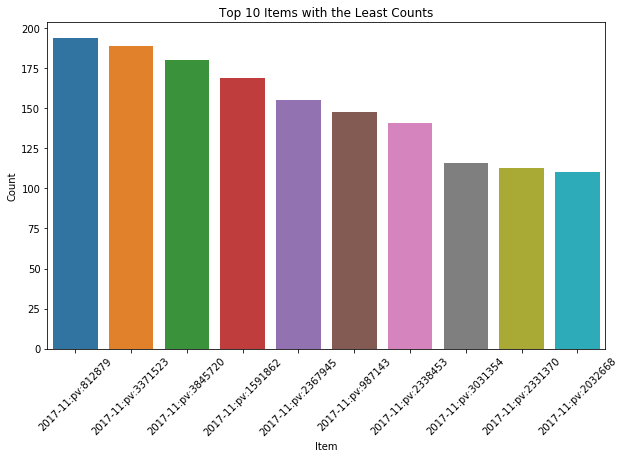

In [14]:
import redis
import matplotlib.pyplot as plt
import seaborn as sns

r = redis.StrictRedis(host='localhost', port=6379, db=0)

keys = r.keys("*:*:*")  

# 用来存储每个键和对应的 'count' 值
keys_list = []
counts_list = []

# 遍历每个键，获取对应的 'count' 值
for key in keys:
    item_counts = r.hgetall(key)  # 获取哈希表
    count = int(item_counts.get(b'count', 0))  # 获取 'count' 字段，并转换为整数
    keys_list.append(key.decode('utf-8'))  # 将键解码为字符串并存储
    counts_list.append(count)  # 存储购买数量

# 将键和值按 'count' 值排序，升序排列
sorted_items = sorted(zip(keys_list, counts_list), key=lambda x: x[1], reverse=True)

# 获取前 10 个最少的键和计数
top_10_items = sorted_items[:10]
top_10_keys = [item[0] for item in top_10_items]
top_10_counts = [item[1] for item in top_10_items]

# 绘制条形图
plt.figure(figsize=(10, 6))
sns.barplot(x=top_10_keys, y=top_10_counts)

# 图表标题和标签
plt.title("Top 10 Items with the Least Counts")
plt.xlabel("Item")
plt.ylabel("Count")
plt.xticks(rotation=45)  # 让 x 轴标签倾斜，避免重叠
plt.show()

In [11]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier


pdf = pd.read_csv(r"/root/桌面/UserBehavior_new.csv")


X = pdf[['user_id', 'item_id', 'category_id', 'time_stamp']]
y = pdf['behavior_type']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

dt = RandomForestClassifier(random_state=42)
dt.fit(X_train, y_train)


X_try=np.array([[208201,2116955,982926,1512108033]])

y_pred = dt.predict(X_try)
print('预测的用户行为可能是',y_pred)


预测的用户行为可能是 ['fav']
